# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



Running this project require the following imports 

In [2]:
!pip install kneed
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
from sklearn.cluster import AgglomerativeClustering
from kneed import KneeLocator
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
!pip install graphlab-create
import numpy as np
import matplotlib.pyplot as plt 
import copy
from scipy.stats import multivariate_normal

%matplotlib inline

'''Check GraphLab Create version'''
from distutils.version import StrictVersion
#assert (StrictVersion(gl.version) >= StrictVersion('1.8.5')), 'GraphLab Create must be version 1.8.5 or later.'
from plotnine import *

%matplotlib inline

ERROR: Could not find a version that satisfies the requirement graphlab-create (from versions: none)
ERROR: No matching distribution found for graphlab-create


In [ ]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    P=list(range(0,num_clusters+1))
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[:,0],X[:,1],c =km.labels_,alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c ='r', marker = 'x', s = 100)
        plt.show()

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



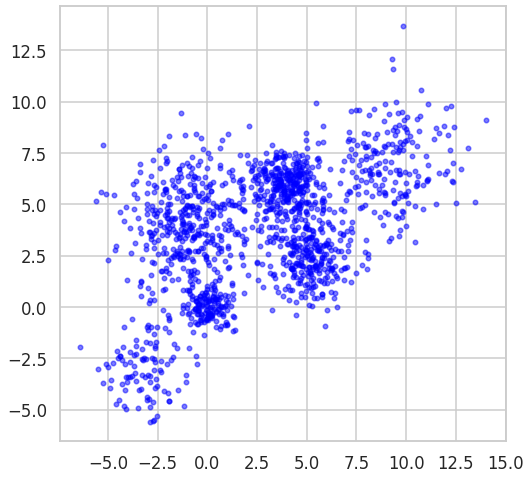

In [ ]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

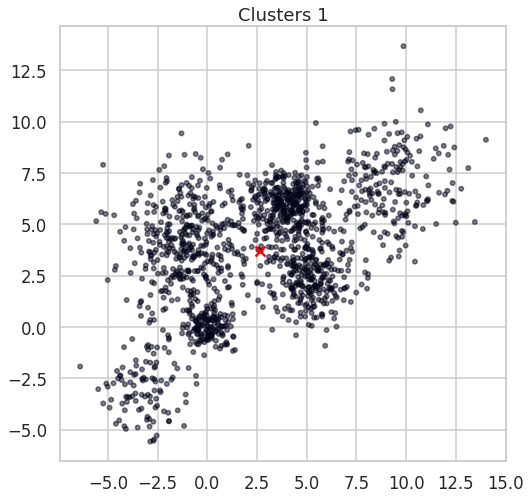

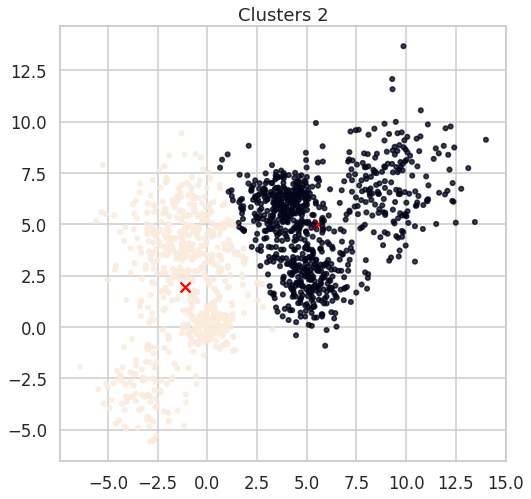

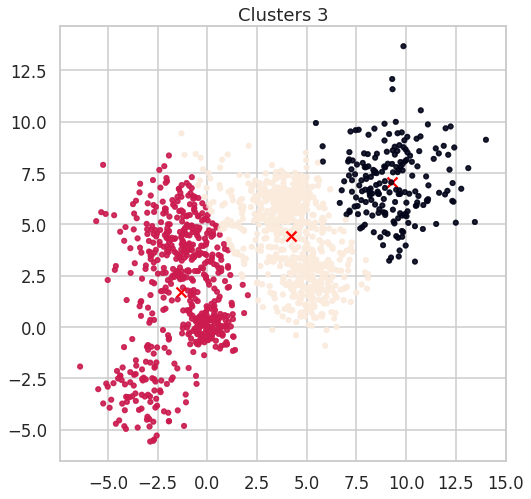

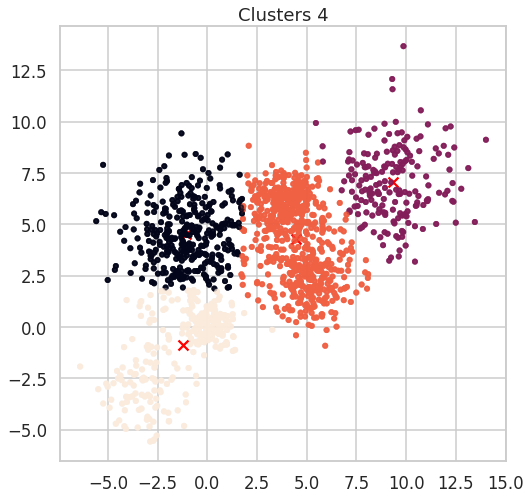

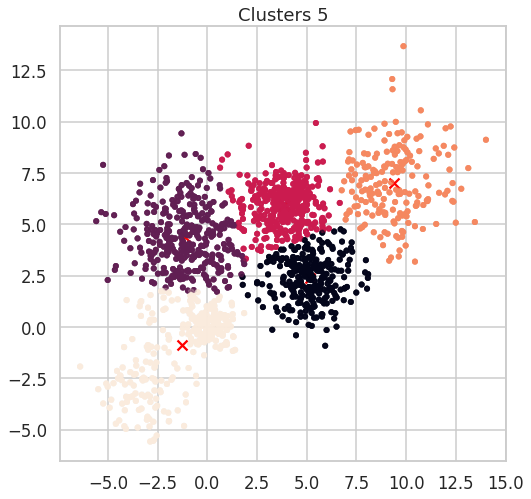

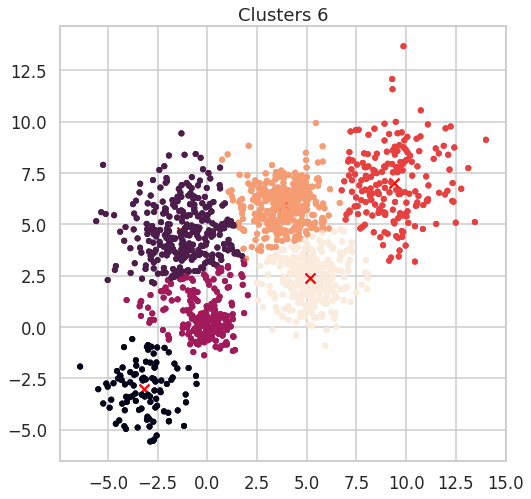

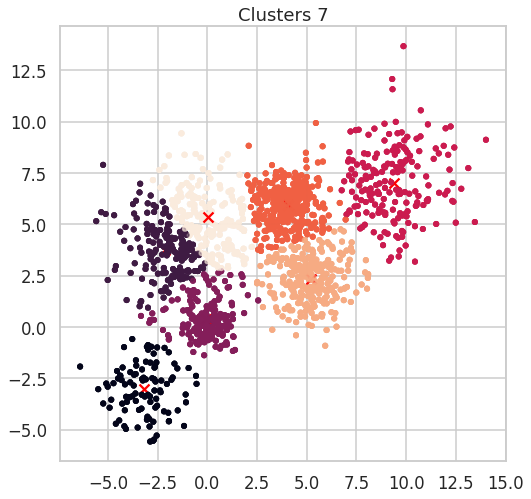

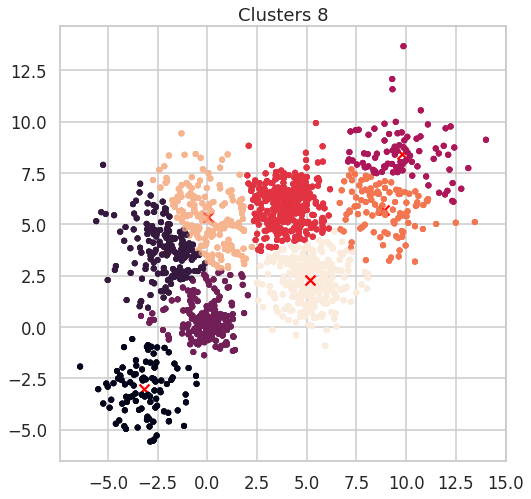

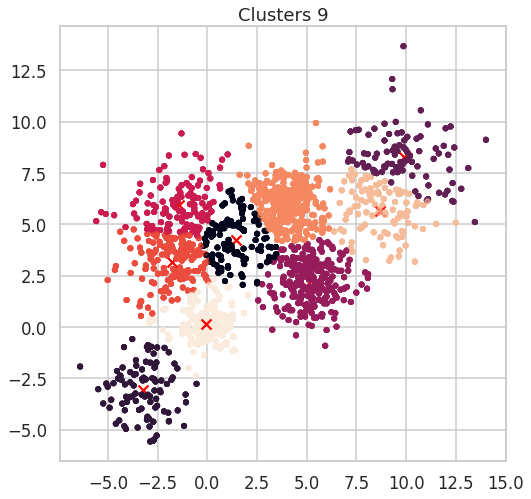

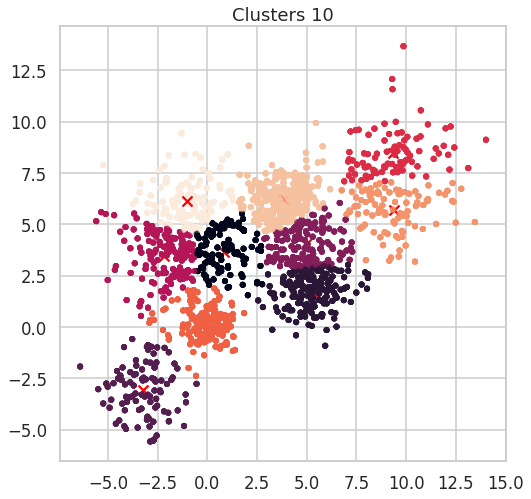

In [ ]:
sum_of_the_squared_error = []
listofrange=len(range(1,11,1))
i = 1
while listofrange >= i :
 Kmeans = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
 Kmeans.fit(Multi_blob_Data)
 plt.title("Clusters "+str(i))
 display_cluster(Multi_blob_Data, km=Kmeans, num_clusters= i)
 sum_of_the_squared_error.append(Kmeans.inertia_)
 i+=1
 



#Elow Method

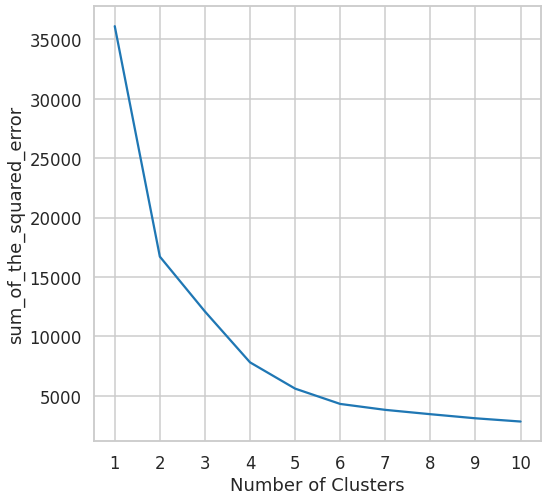

4

In [ ]:
xrange=range(1,11,1)
plt.plot(xrange, sum_of_the_squared_error)
plt.xticks(xrange)
plt.xlabel("Number of Clusters")
plt.ylabel("sum_of_the_squared_error")
plt.show()
kneelocator_elbow = KneeLocator(xrange, sum_of_the_squared_error, curve="convex", direction="decreasing")
kneelocator_elbow.elbow

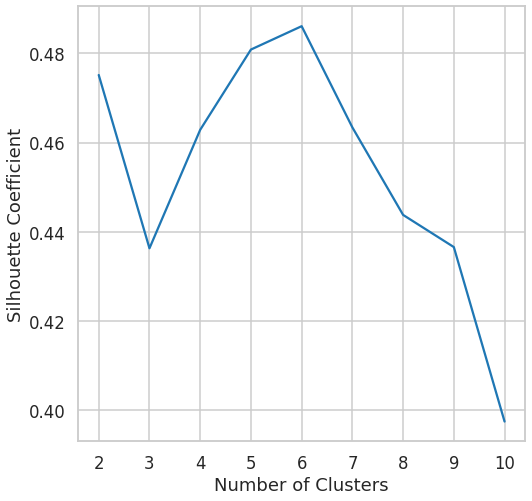

The best silhouette_coefficient is with 6 number of clusters


In [ ]:
silhouette_coefficients = []
list_sil_range=len(range(2, 12, 1))
i = 2
while list_sil_range>= i :
 Kmeans = KMeans(n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42})
 Kmeans.fit(Multi_blob_Data)
 score = silhouette_score(Multi_blob_Data, Kmeans.labels_)
 silhouette_coefficients.append(score)
 i+=1
best_silhouette_coefficient = silhouette_coefficients.index(max(silhouette_coefficients))
best_silhouette_coefficient+=2
x2range=range(2,11,1)
plt.xticks(x2range)
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.plot(x2range, silhouette_coefficients)
plt.show()
print("The best silhouette_coefficient is with", best_silhouette_coefficient , "number of clusters")

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

cityblock
single
0.2
['0.15880107790291045', 'cityblock', 'single', '0.2']


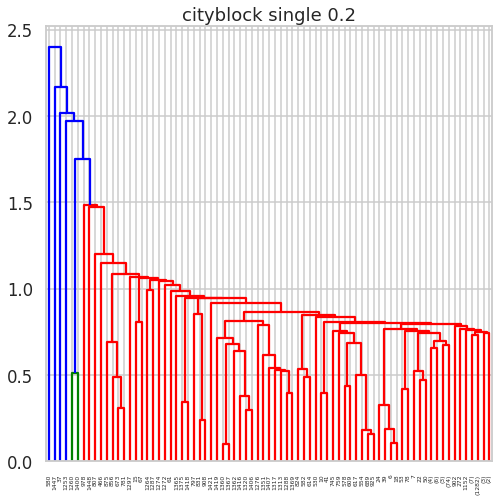

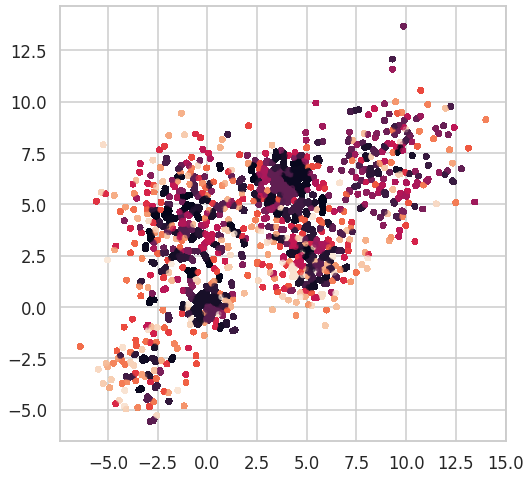

0.4


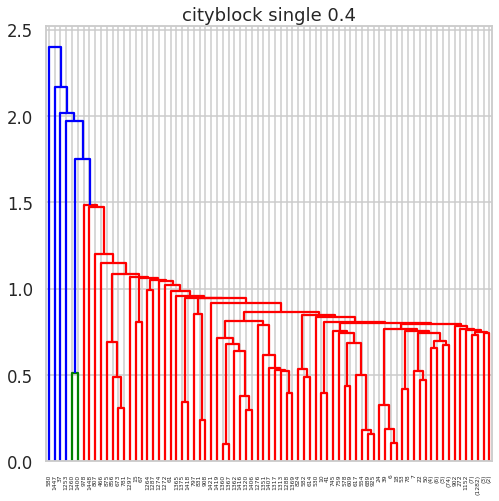

KeyboardInterrupt: ignored

In [ ]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

def display_hierarchal_cluster(X,km=[],num_clusters=0):
    alpha = 0.5  
    s = 20
    P=list(range(0,num_clusters+1))
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = 'r',alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[:,0],X[:,1],c =km.labels_,alpha = alpha,s=s)
        plt.show()


Affinity_list=['cityblock','euclidean','cosine']
Linkage_list=['single','average']
distance_range=np.arange(0.2, 2, 0.2)
best_silote_trails=['0.0','0.0','0.0','0.0']


a=0
while len(Affinity_list) -1 >= a :
  print(Affinity_list[a])
  l=0
  while len(Linkage_list) -1 >= l :
    print(Linkage_list[l])
    d=0
    while len(distance_range) -1 >= d :
      print(distance_range[d])
      HIC = AgglomerativeClustering(distance_threshold=distance_range[d], n_clusters=None,affinity=Affinity_list[a],linkage=Linkage_list[l])
      HIC.fit(Multi_blob_Data)
      temp=len(np.unique(HIC.labels_))
      if(temp!=1):
        single_iteration=silhouette_score(Multi_blob_Data, HIC.labels_)
        if(float(best_silote_trails[0])<single_iteration):
          best_silote_trails[0]=str(single_iteration)
          best_silote_trails[1]=Affinity_list[a]
          best_silote_trails[2]=Linkage_list[l]
          best_silote_trails[3]=str(distance_range[d].round(2))
          print(best_silote_trails)
        linkage_type = linkage(Multi_blob_Data, Linkage_list[l],metric=Affinity_list[a])
        plt.title(Affinity_list[a] +" "+Linkage_list[l]+" "+str(distance_range[d]))
        displaycl = dendrogram(linkage_type,truncate_mode='level')
        plt.show()
        display_hierarchal_cluster(Multi_blob_Data,km=HIC,num_clusters=HIC.n_clusters_)
      d+=1
    l+=1
  a+=1
 
print("The max Silhouette Score is" + best_silote_trails[0] + "with affinity equal to"  + best_silote_trails[1] +  "and linkage equal to" + best_silote_trails[2] + "with distance_threshold"+ best_silote_trails[3] )


In [ ]:
print("The max Silhouette Score is " + str(best_silote_trails[0]) + " with affinity equal to "  + str(best_silote_trails[1]) +  " and linkage equal to " + str(best_silote_trails[2]) + " with distance_threshold "+ str(best_silote_trails[3]) )


The max Silhouette Score is 0.34505677564613907 with affinity equal to cityblock and linkage equal to average with distance_threshold 0.3


### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

loop1
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.1 with range 5
loop2
invalid eps 2.2 with range 5
loop2
invalid eps 2.3000000000000003 with range 5
loop2
invalid eps 2.4000000000000004 with range 5
loop2
invalid eps 2.5000000000000004 with range 5
loop2
invalid eps 2.6 with range 5
loop2
invalid eps 2.7 with range 5
loop2
invalid eps 2.8000000000000003 with range 5
loop2
invalid eps 2.9000000000000004 with range 5


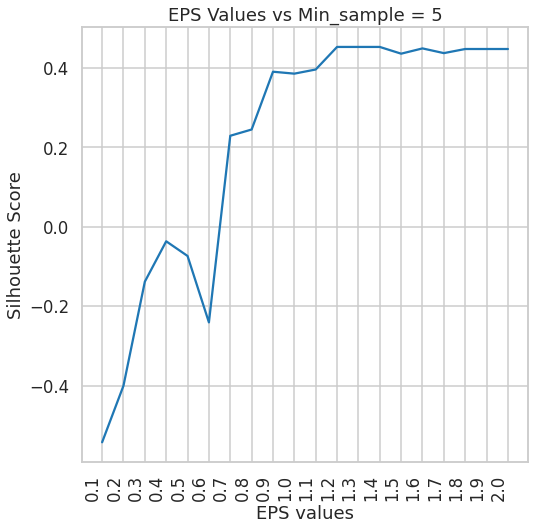

loop1
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.2 with range 6
loop2
invalid eps 2.3000000000000003 with range 6
loop2
invalid eps 2.4000000000000004 with range 6
loop2
invalid eps 2.5000000000000004 with range 6
loop2
invalid eps 2.6 with range 6
loop2
invalid eps 2.7 with range 6
loop2
invalid eps 2.8000000000000003 with range 6
loop2
invalid eps 2.9000000000000004 with range 6


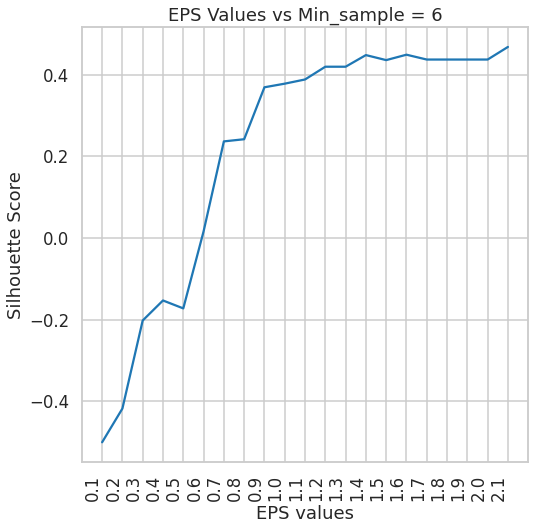

loop1
loop2
invalid eps 0.1 with range 7
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.2 with range 7
loop2
invalid eps 2.3000000000000003 with range 7
loop2
invalid eps 2.4000000000000004 with range 7
loop2
invalid eps 2.5000000000000004 with range 7
loop2
invalid eps 2.6 with range 7
loop2
invalid eps 2.7 with range 7
loop2
invalid eps 2.8000000000000003 with range 7
loop2
invalid eps 2.9000000000000004 with range 7


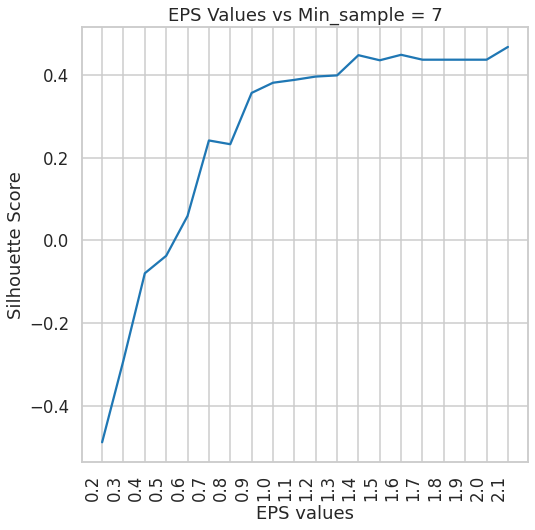

loop1
loop2
invalid eps 0.1 with range 8
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.2 with range 8
loop2
invalid eps 2.3000000000000003 with range 8
loop2
invalid eps 2.4000000000000004 with range 8
loop2
invalid eps 2.5000000000000004 with range 8
loop2
invalid eps 2.6 with range 8
loop2
invalid eps 2.7 with range 8
loop2
invalid eps 2.8000000000000003 with range 8
loop2
invalid eps 2.9000000000000004 with range 8


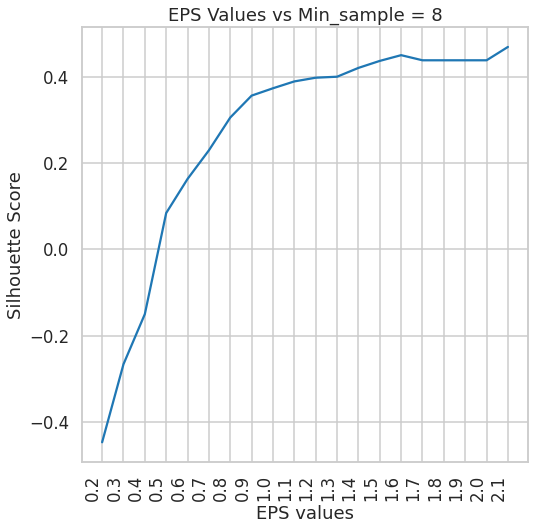

loop1
loop2
invalid eps 0.1 with range 9
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.2 with range 9
loop2
invalid eps 2.3000000000000003 with range 9
loop2
invalid eps 2.4000000000000004 with range 9
loop2
invalid eps 2.5000000000000004 with range 9
loop2
invalid eps 2.6 with range 9
loop2
invalid eps 2.7 with range 9
loop2
invalid eps 2.8000000000000003 with range 9
loop2
invalid eps 2.9000000000000004 with range 9


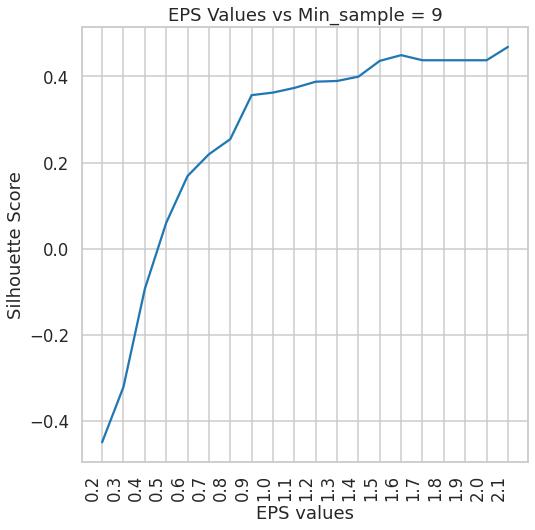

loop1
loop2
invalid eps 0.1 with range 10
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.2 with range 10
loop2
invalid eps 2.3000000000000003 with range 10
loop2
invalid eps 2.4000000000000004 with range 10
loop2
invalid eps 2.5000000000000004 with range 10
loop2
invalid eps 2.6 with range 10
loop2
invalid eps 2.7 with range 10
loop2
invalid eps 2.8000000000000003 with range 10
loop2
invalid eps 2.9000000000000004 with range 10


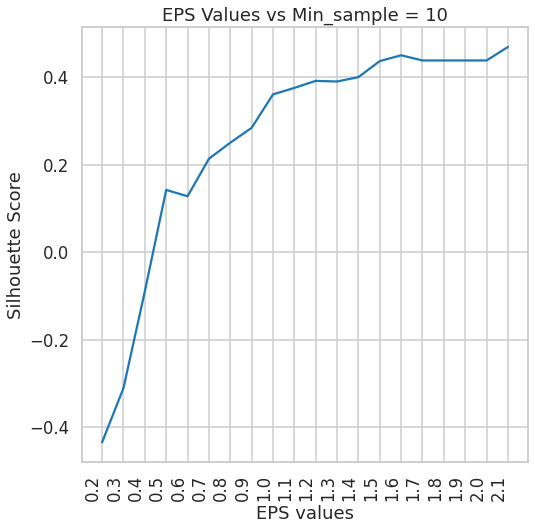

loop1
loop2
invalid eps 0.1 with range 11
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.5000000000000004 with range 11
loop2
invalid eps 2.6 with range 11
loop2
invalid eps 2.7 with range 11
loop2
invalid eps 2.8000000000000003 with range 11
loop2
invalid eps 2.9000000000000004 with range 11


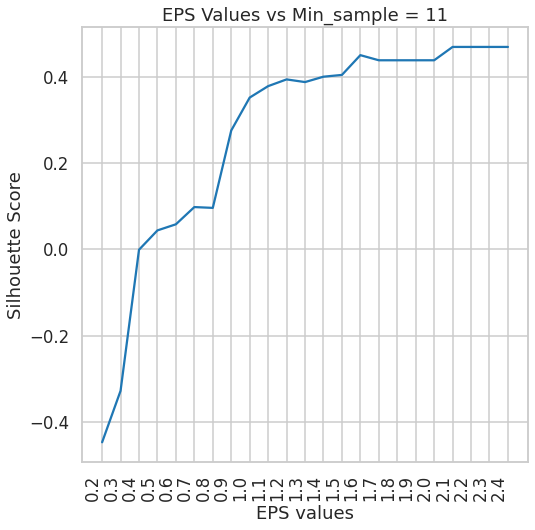

loop1
loop2
invalid eps 0.1 with range 12
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.5000000000000004 with range 12
loop2
invalid eps 2.6 with range 12
loop2
invalid eps 2.7 with range 12
loop2
invalid eps 2.8000000000000003 with range 12
loop2
invalid eps 2.9000000000000004 with range 12


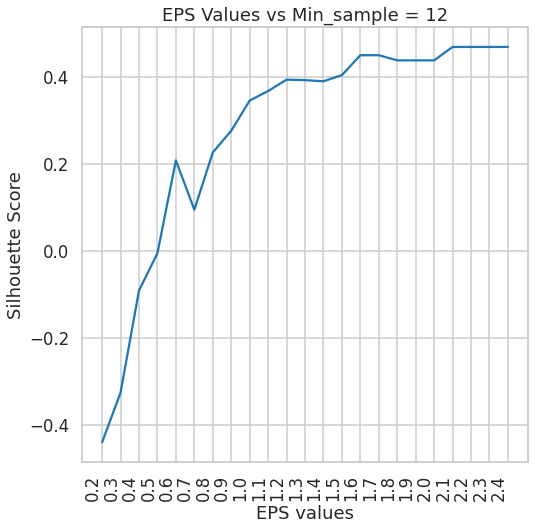

loop1
loop2
invalid eps 0.1 with range 13
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.6 with range 13
loop2
invalid eps 2.7 with range 13
loop2
invalid eps 2.8000000000000003 with range 13
loop2
invalid eps 2.9000000000000004 with range 13


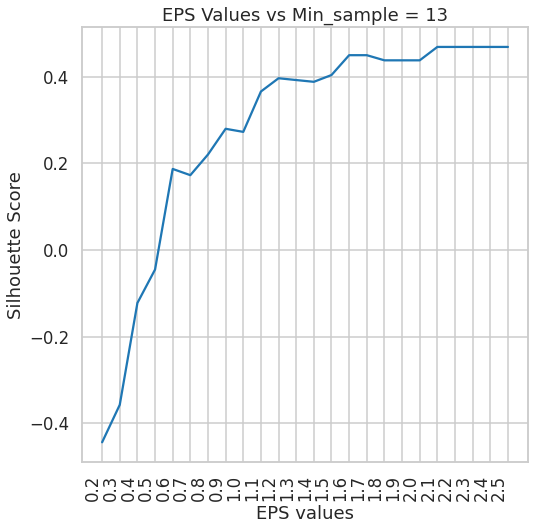

loop1
loop2
invalid eps 0.1 with range 14
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.6 with range 14
loop2
invalid eps 2.7 with range 14
loop2
invalid eps 2.8000000000000003 with range 14
loop2
invalid eps 2.9000000000000004 with range 14


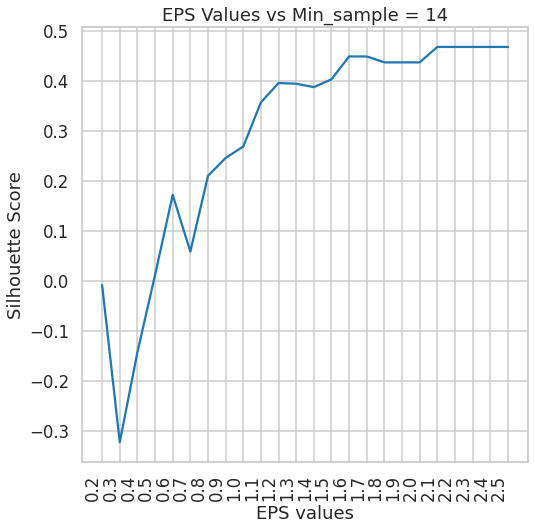

loop1
loop2
invalid eps 0.1 with range 15
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.6 with range 15
loop2
invalid eps 2.7 with range 15
loop2
invalid eps 2.8000000000000003 with range 15
loop2
invalid eps 2.9000000000000004 with range 15


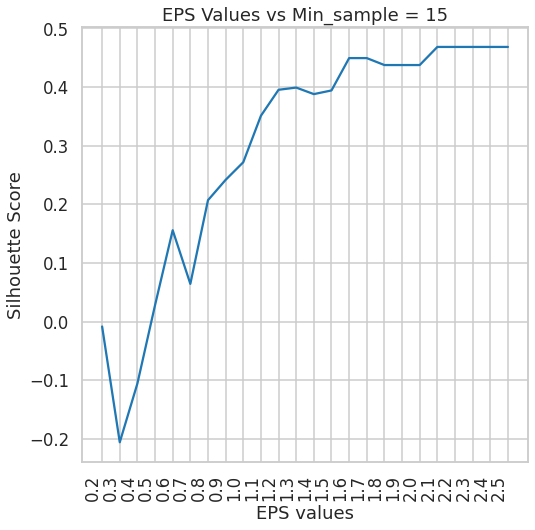

loop1
loop2
invalid eps 0.1 with range 16
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.7 with range 16
loop2
invalid eps 2.8000000000000003 with range 16
loop2
invalid eps 2.9000000000000004 with range 16


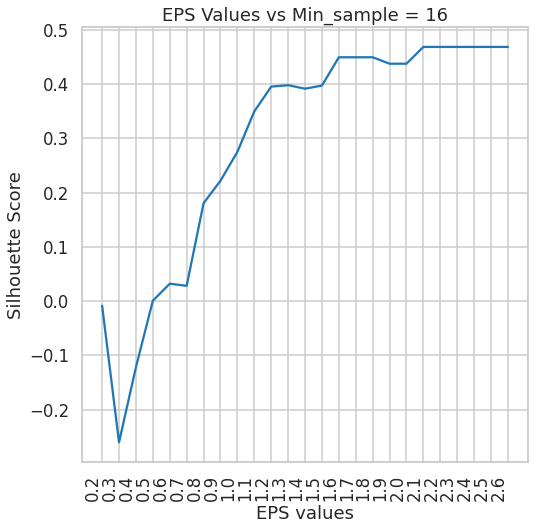

loop1
loop2
invalid eps 0.1 with range 17
loop2
invalid eps 0.2 with range 17
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.7 with range 17
loop2
invalid eps 2.8000000000000003 with range 17
loop2
invalid eps 2.9000000000000004 with range 17


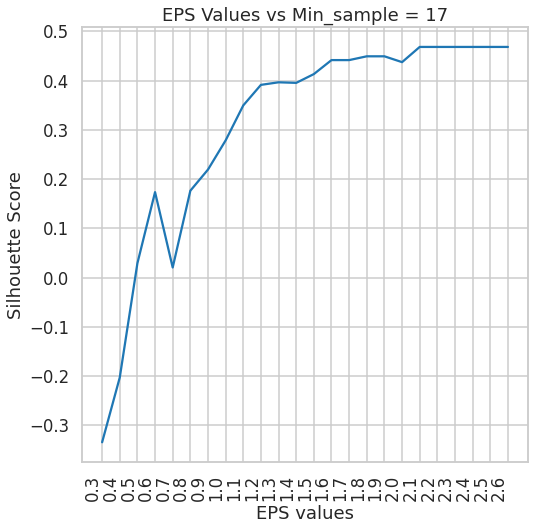

loop1
loop2
invalid eps 0.1 with range 18
loop2
invalid eps 0.2 with range 18
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.7 with range 18
loop2
invalid eps 2.8000000000000003 with range 18
loop2
invalid eps 2.9000000000000004 with range 18


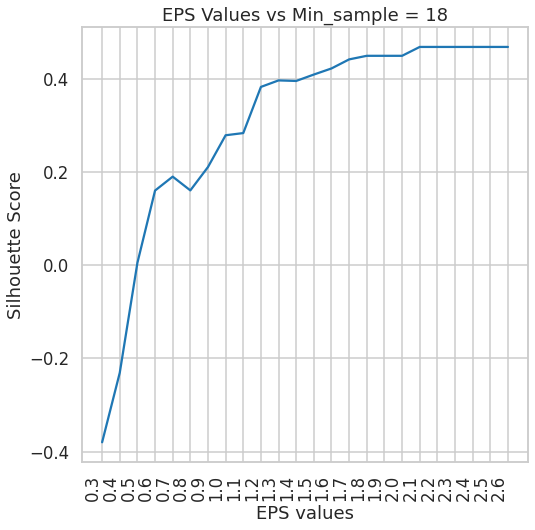

loop1
loop2
invalid eps 0.1 with range 19
loop2
invalid eps 0.2 with range 19
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.8000000000000003 with range 19
loop2
invalid eps 2.9000000000000004 with range 19


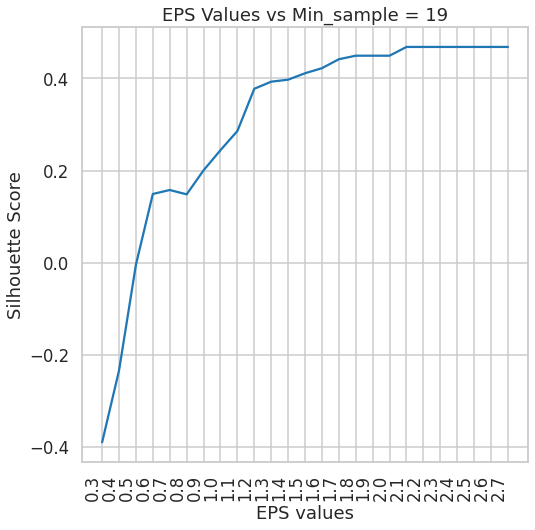

loop1
loop2
invalid eps 0.1 with range 20
loop2
invalid eps 0.2 with range 20
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.8000000000000003 with range 20
loop2
invalid eps 2.9000000000000004 with range 20


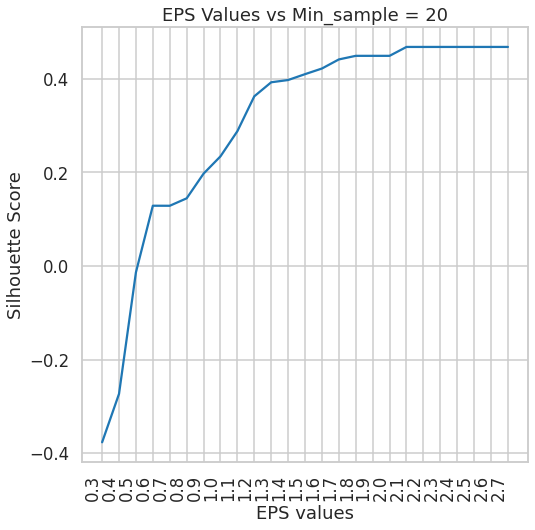

loop1
loop2
invalid eps 0.1 with range 21
loop2
invalid eps 0.2 with range 21
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.9000000000000004 with range 21


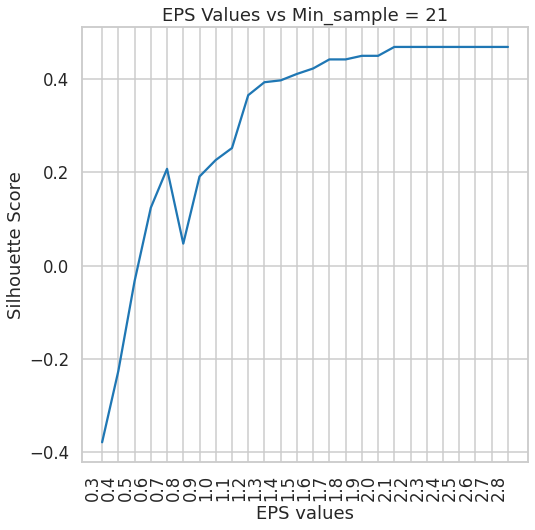

loop1
loop2
invalid eps 0.1 with range 22
loop2
invalid eps 0.2 with range 22
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
invalid eps 2.9000000000000004 with range 22


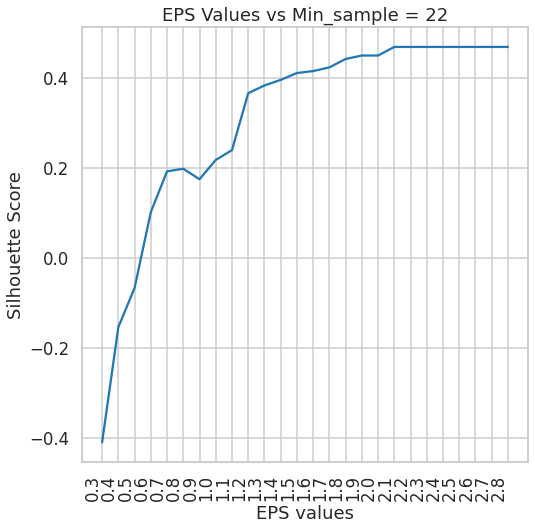

loop1
loop2
invalid eps 0.1 with range 23
loop2
invalid eps 0.2 with range 23
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2


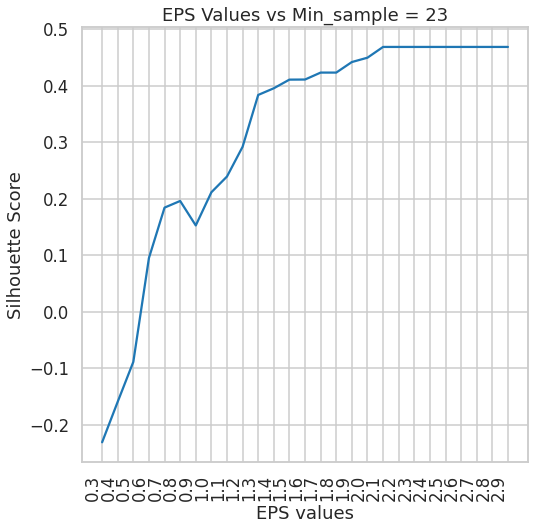

loop1
loop2
invalid eps 0.1 with range 24
loop2
invalid eps 0.2 with range 24
loop2
invalid eps 0.30000000000000004 with range 24
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2


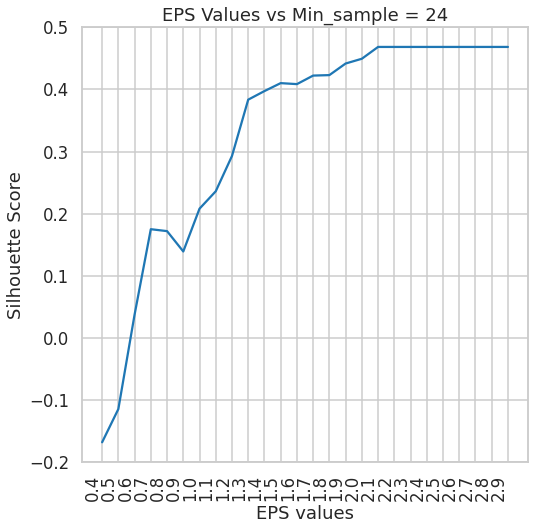

loop1
loop2
invalid eps 0.1 with range 25
loop2
invalid eps 0.2 with range 25
loop2
invalid eps 0.30000000000000004 with range 25
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2
loop2


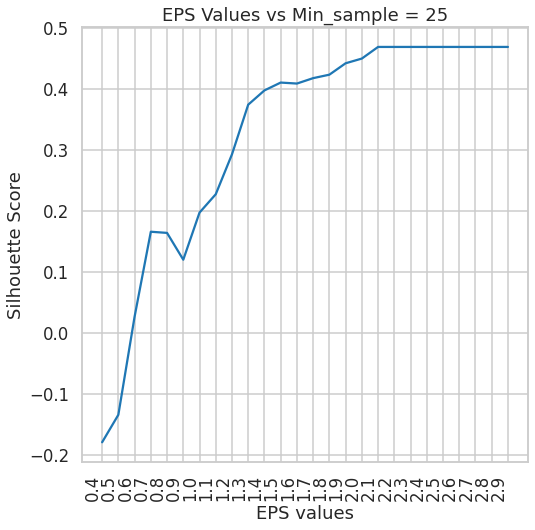

The max Silhouette Score is 0.4685207355522043 with eps equal to (2.9000000000000004,) and min_samples equal to 25


In [ ]:
min_samples_list=range(5,26,1)
min_samples_range= len(range(5,26,1))
epsss=np.arange(0.1, 3.1, 0.1)
eps_range=len(np.arange(0.1, 3.1, 0.1))
best_silhouette_score =0
best_ep=0
best_min_sample=0

i=0
while min_samples_range - 1 >= i:
  silhouette_scores = []
  valid_eps=[]
  j=0
  while eps_range - 1 >= j: 
    dbscan = DBSCAN(eps=epsss[j], min_samples=min_samples_list[i])
    dbscan.fit(Multi_blob_Data)

    if (len(np.unique(dbscan.labels_)) <= 1):
      print("invalid eps",epsss[j],"with range",min_samples_list[i])
      j+=1
      continue

    valid_eps.append(epsss[j])
    sil_dbscan = silhouette_score(Multi_blob_Data, dbscan.labels_)
    silhouette_scores.append(sil_dbscan)

    if (best_silhouette_score <= sil_dbscan): 
     best_silhouette_score =sil_dbscan
     best_min_sample=min_samples_list[i]
     best_ep=epsss[j],
    
    j+=1
 
  plt.plot(valid_eps, silhouette_scores)
  plt.xticks(valid_eps)
  graph_helper= plt.subplot()   
  plt.setp(graph_helper.get_xticklabels(), rotation=90, ha='right')
  plt.title("EPS Values vs Min_sample = " + str(min_samples_list[i]))
  plt.xlabel("EPS values")
  plt.ylabel("Silhouette Score")
  plt.show() 
  i+=1

      

print("The max Silhouette Score is", best_silhouette_score ,"with eps equal to" ,best_ep, "and min_samples equal to",best_min_sample )

        

# Obeservations


*  **We can not test any eps value (which is the radius of the core point) with any min_sample (which is the number of points required to surround the point inorder to be a core point ). Doing so in some values could make the whole data be represented as an outlier or as one cluster which is false.**
*   **To get the best best_silhouette_score it is needed to get the maximum silhouette from each trail or graph, but it was observed that the maximum number is the same in most of the graphs.**




### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

In [ ]:
types_of_covar=['tied','diag','full']
i=0
while len(types_of_covar) > i :
  EM=GaussianMixture(n_components =3,covariance_type=types_of_covar[i])
  EM.fit(Multi_blob_Data)
  print("Type",str(i))
  print(EM.predict_proba(Multi_blob_Data))
  i+=1



In [ ]:
import matplotlib.mlab as mlab

def bivariate_normal(X, Y, sigmax=1.0, sigmay=1.0,
                 mux=0.0, muy=0.0, sigmaxy=0.0):
    Xmu = X-mux
    Ymu = Y-muy

    rho = sigmaxy/(sigmax*sigmay)
    z = Xmu**2/sigmax**2 + Ymu**2/sigmay**2 - 2*rho*Xmu*Ymu/(sigmax*sigmay)
    denom = 2*np.pi*sigmax*sigmay*np.sqrt(1-rho**2)
    return np.exp(-z/(2*(1-rho**2))) / denom

def plot_contours(data, means, covs, title):
    plt.figure()
    plt.plot([x[0] for x in data], [y[1] for y in data],'ko') # data

    delta = 0.025
    k = len(means)
    x = np.arange(min(data[:, 0]), max(data[:, 0]), delta)
    y = np.arange(min(data[:, 1]), max(data[:, 1]), delta)
    X, Y = np.meshgrid(x, y)
    col = ['green', 'red', 'indigo']
    for i in range(k):
        mean = means[i]
        cov = covs[i]
        sigmax = np.sqrt(cov[0][0])
        sigmay = np.sqrt(cov[1][1])
        sigmaxy = cov[0][1]/(sigmax*sigmay)
        Z = bivariate_normal(X, Y, sigmax, sigmay, mean[0], mean[1], sigmaxy)
        plt.contour(X, Y, Z, colors = col[i])
        plt.title(title)
    plt.rcParams.update({'font.size':16})
    plt.tight_layout()


plot_contours(Multi_blob_Data,EM.means_,EM.covariances_,'Final clusters')


## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [ ]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']

['setosa', 'versicolor', 'virginica']

In [ ]:
x= iris_data.data
target = iris_data.target 
names = iris_data.target_names
df = pd.DataFrame(iris_data, columns=iris_data.feature_names)
df['sepal length (cm)']=iris_data.data[:,0]
df['sepal width (cm)']=iris_data.data[:,1]
df['petal length (cm)']=iris_data.data[:,2]
df['petal width (cm)']=iris_data.data[:,3]
df.head(10)

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2
5,5.4,3.9,1.7,0.4
6,4.6,3.4,1.4,0.3
7,5.0,3.4,1.5,0.2
8,4.4,2.9,1.4,0.2
9,4.9,3.1,1.5,0.1


##KMEANs

CLuster2


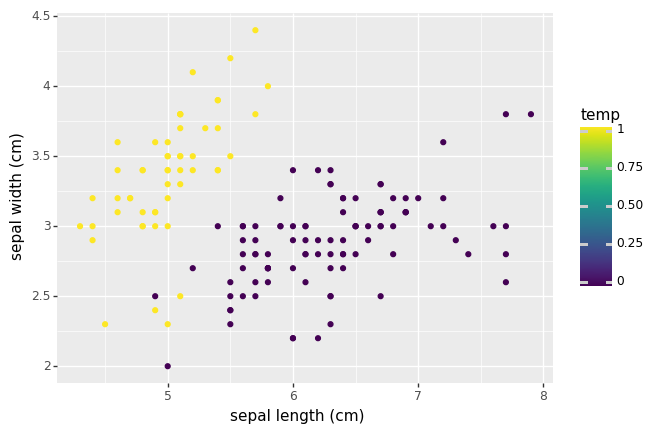

<ggplot: (8757736769769)>
CLuster2


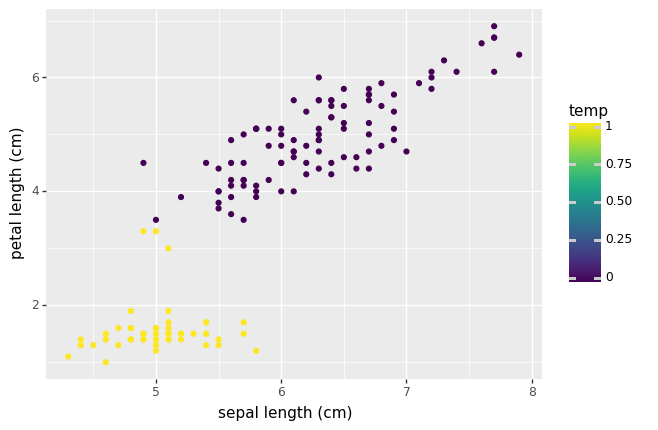

<ggplot: (8757737550661)>
CLuster2


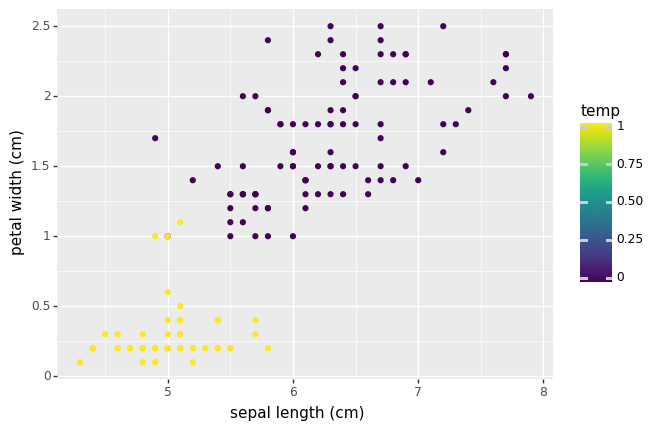

<ggplot: (8757737327605)>
CLuster2


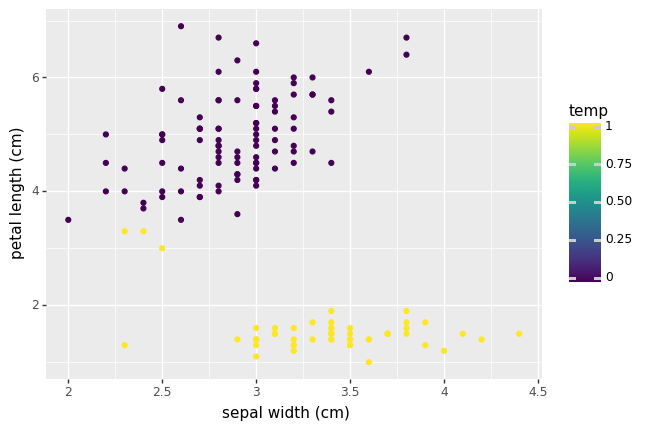

<ggplot: (8757737332509)>
CLuster2


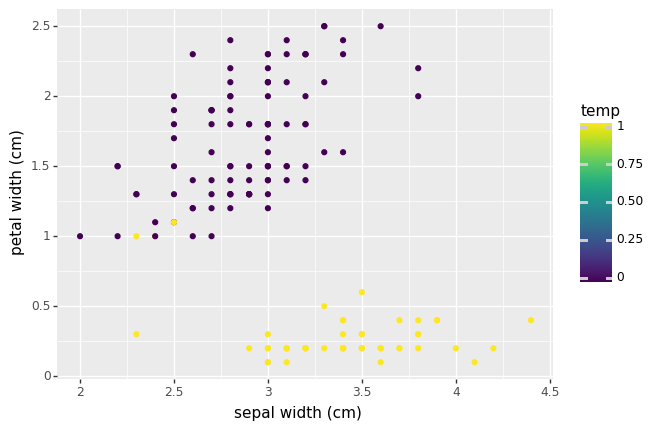

<ggplot: (8757736828249)>
CLuster2


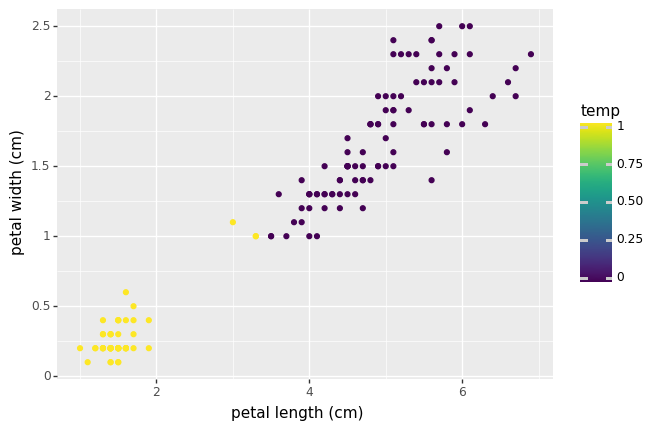

<ggplot: (8757736736097)>
CLuster3


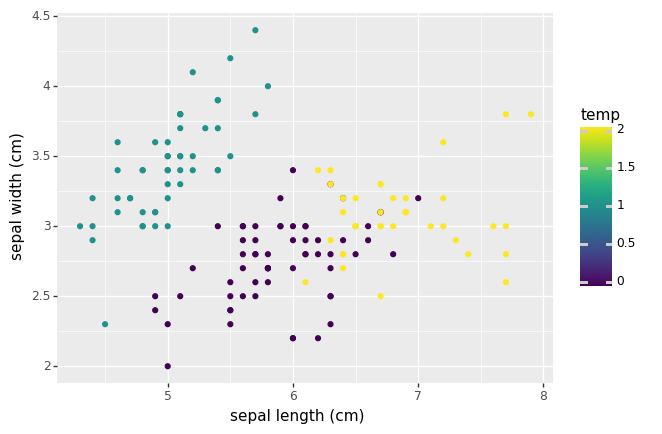

<ggplot: (8757737405913)>
CLuster3


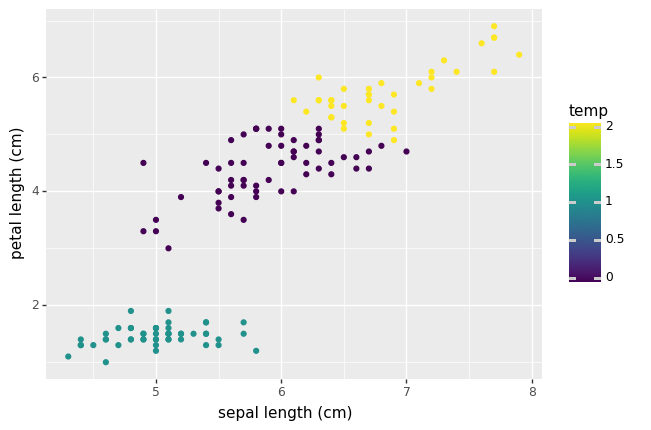

<ggplot: (8757739597409)>
CLuster3


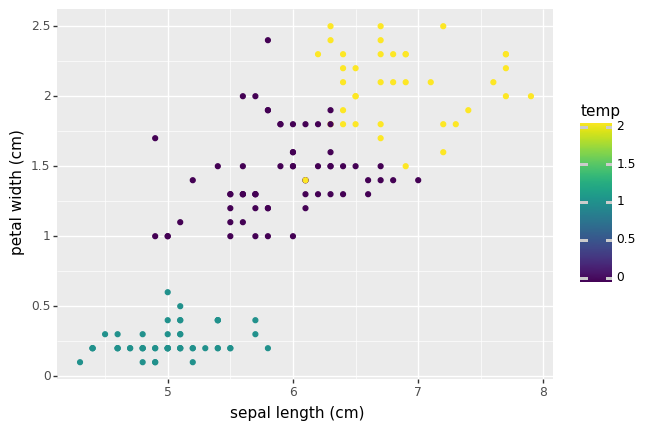

<ggplot: (8757737490869)>
CLuster3


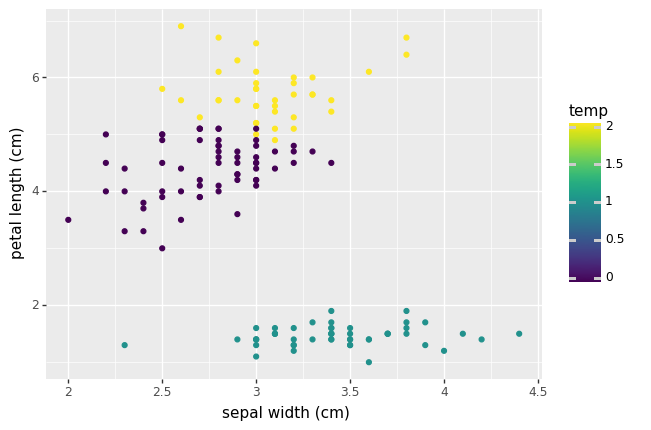

<ggplot: (8757737160089)>
CLuster3


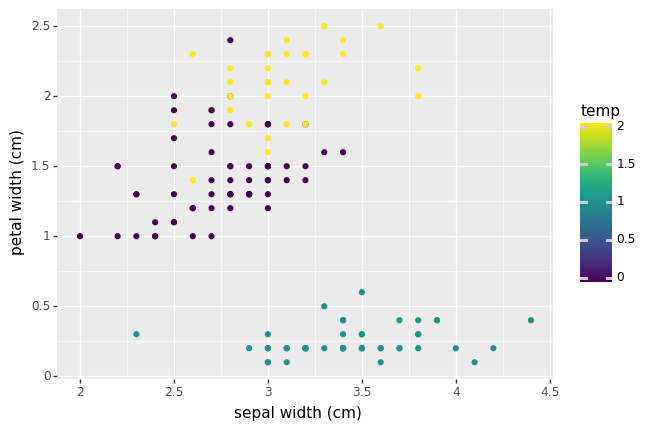

<ggplot: (8757736986205)>
CLuster3


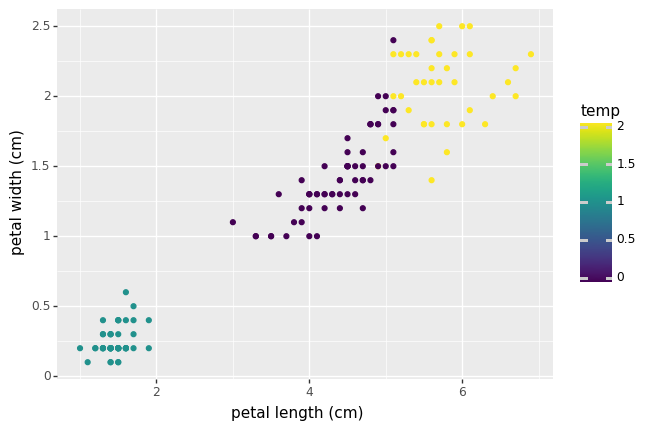

<ggplot: (8757737440365)>
CLuster4


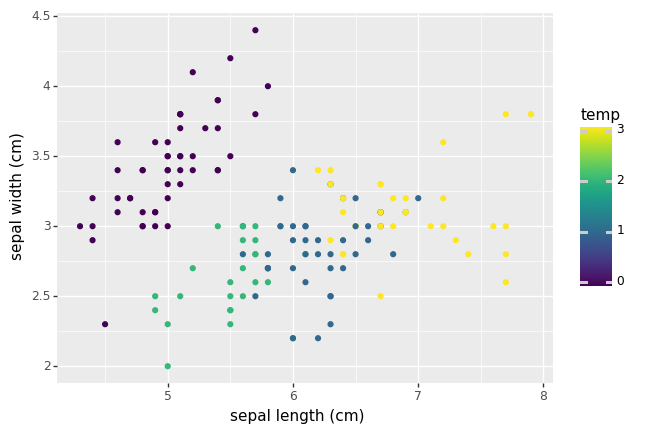

<ggplot: (8757737137765)>
CLuster4


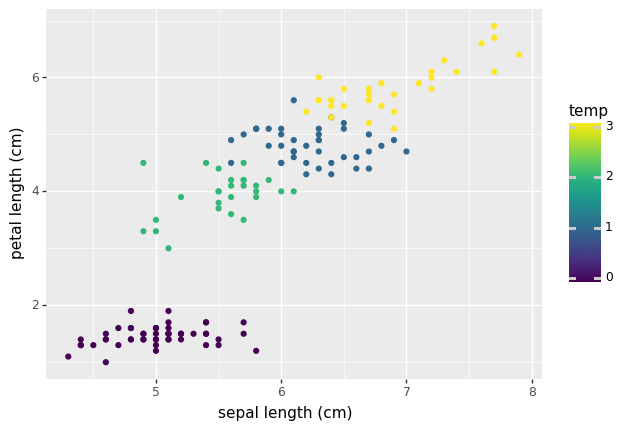

<ggplot: (8757739310257)>
CLuster4


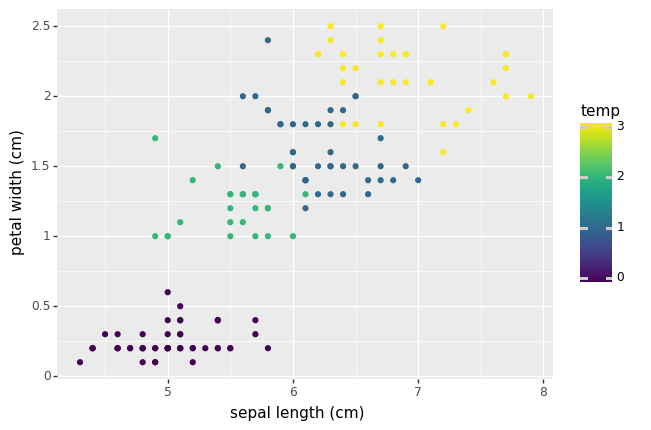

<ggplot: (8757739664713)>
CLuster4


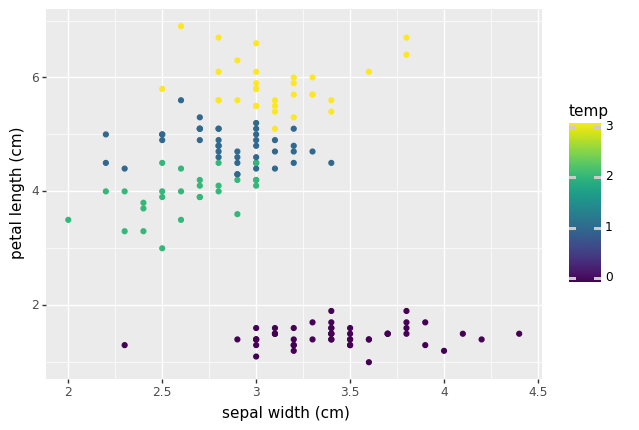

<ggplot: (8757737219345)>
CLuster4


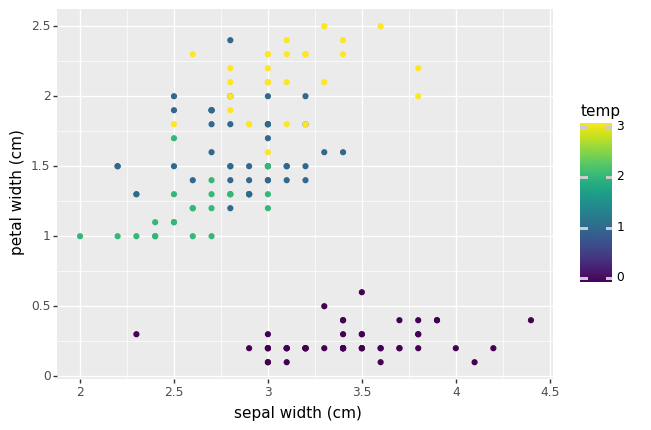

<ggplot: (8757736770433)>
CLuster4


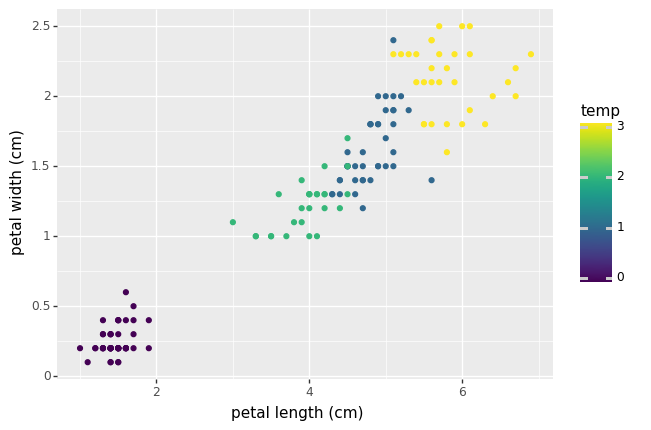

<ggplot: (8757737251589)>
CLuster5


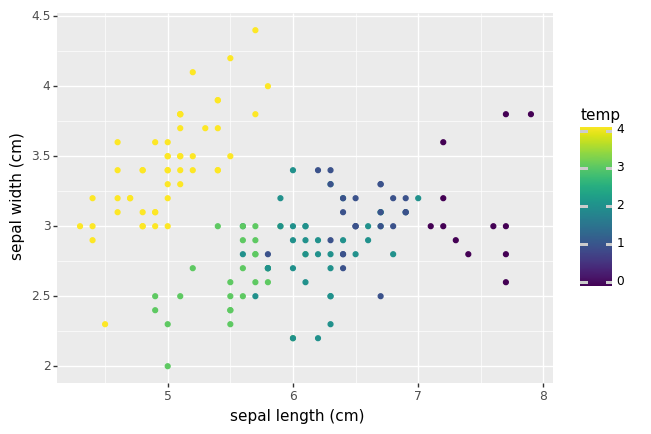

<ggplot: (8757736884089)>
CLuster5


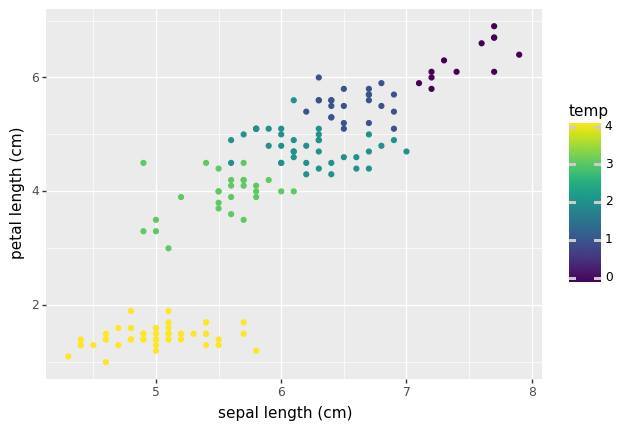

<ggplot: (8757736958437)>
CLuster5


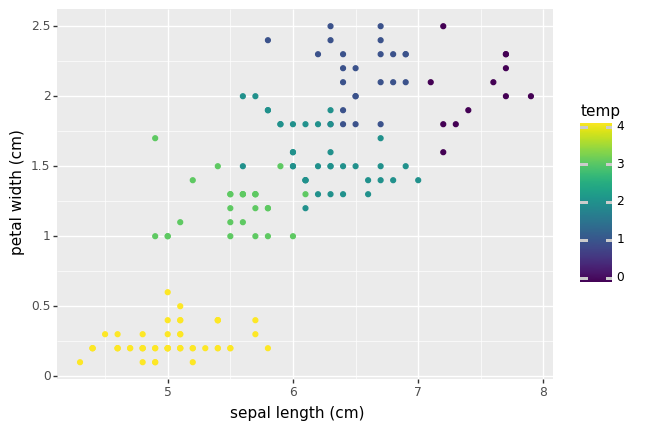

<ggplot: (8757736666721)>
CLuster5


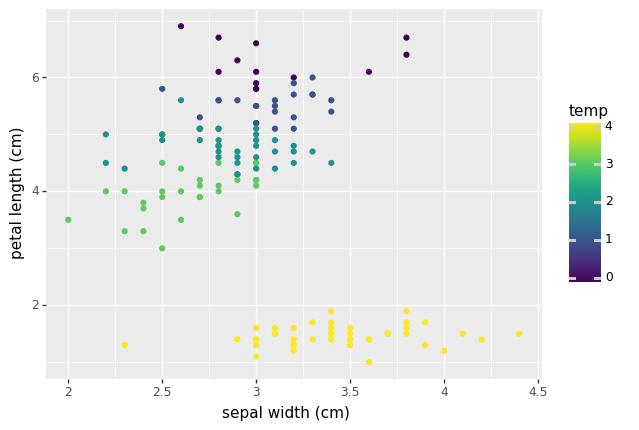

<ggplot: (8757737293889)>
CLuster5


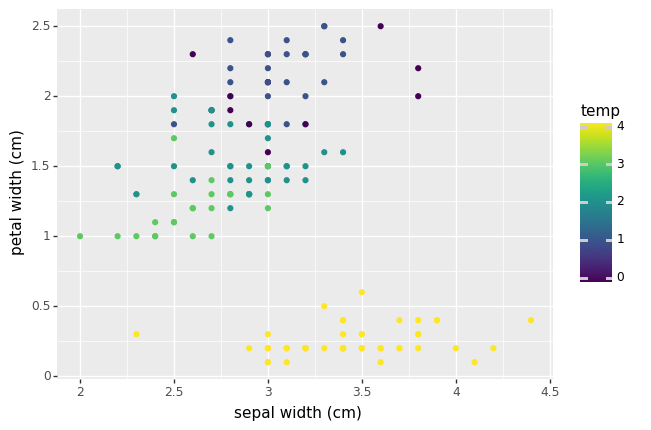

<ggplot: (8757737037005)>
CLuster5


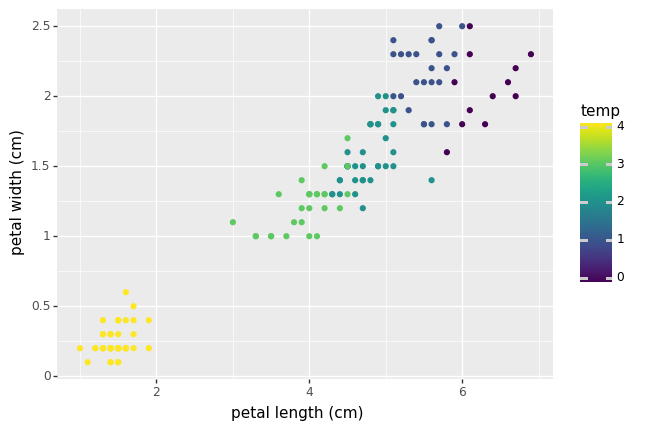

<ggplot: (8757736957029)>
CLuster6


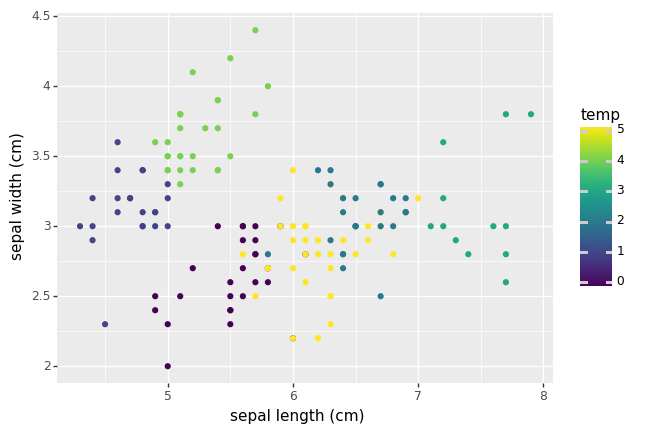

<ggplot: (8757737484553)>
CLuster6


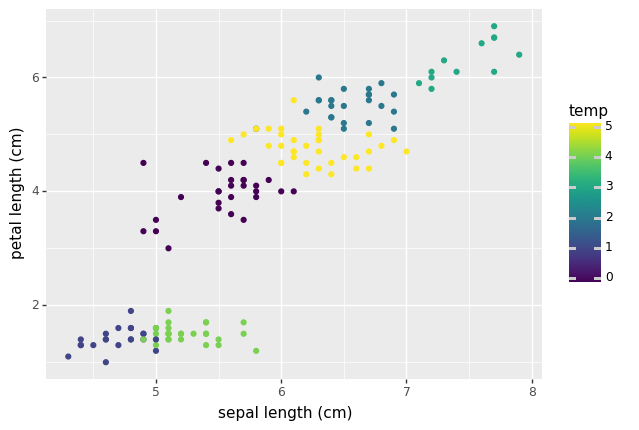

<ggplot: (8757736956945)>
CLuster6


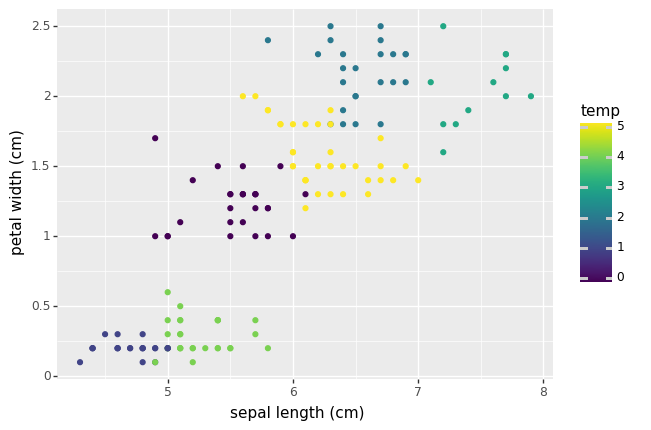

<ggplot: (8757737169381)>
CLuster6


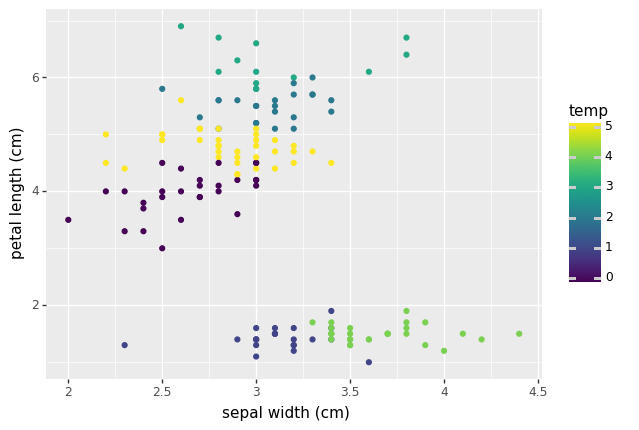

<ggplot: (8757739657337)>
CLuster6


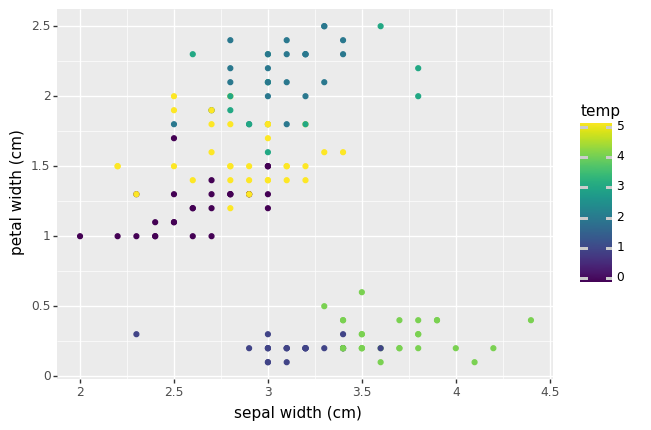

<ggplot: (8757736864125)>
CLuster6


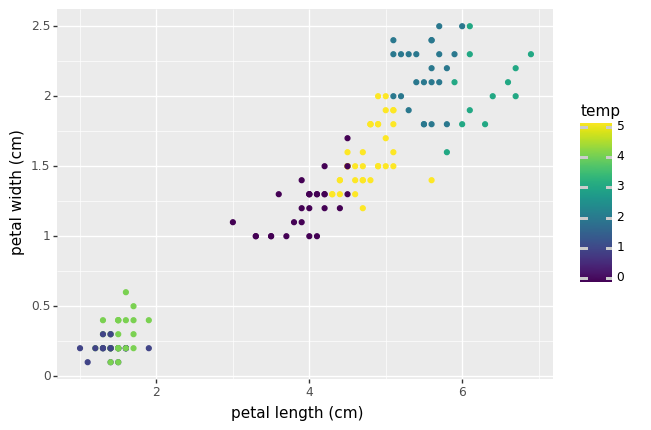

<ggplot: (8757739524821)>
CLuster7


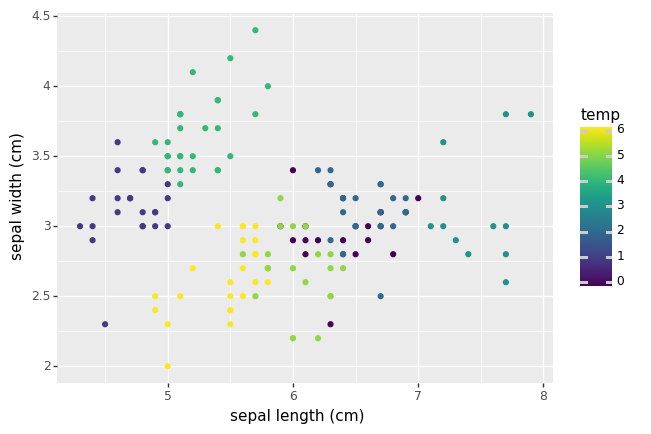

<ggplot: (8757736705561)>
CLuster7


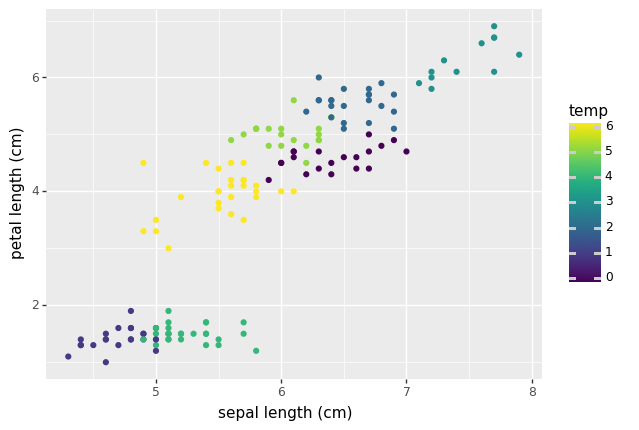

<ggplot: (8757739571993)>
CLuster7


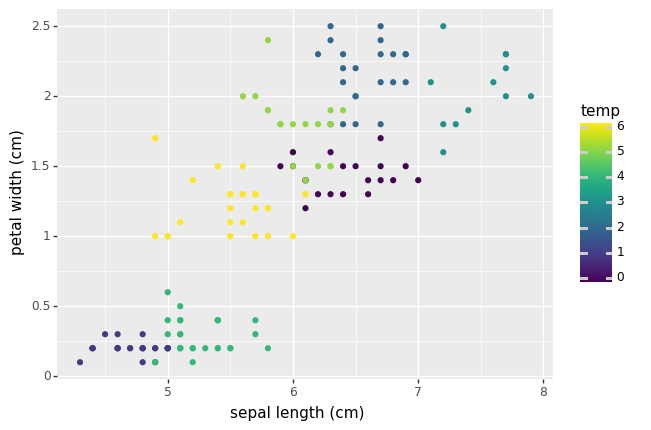

<ggplot: (8757736854349)>
CLuster7


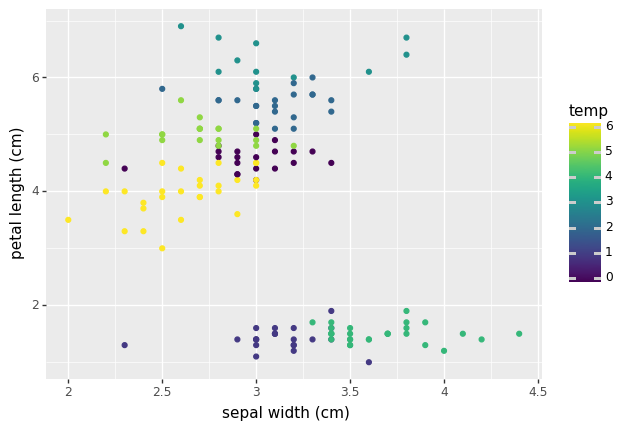

<ggplot: (8757737100265)>
CLuster7


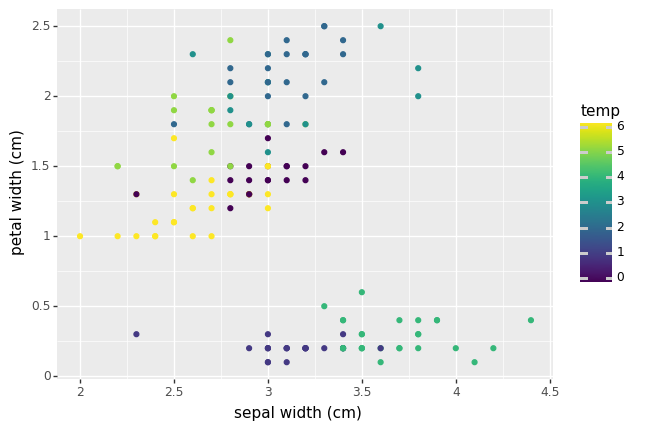

<ggplot: (8757736923305)>
CLuster7


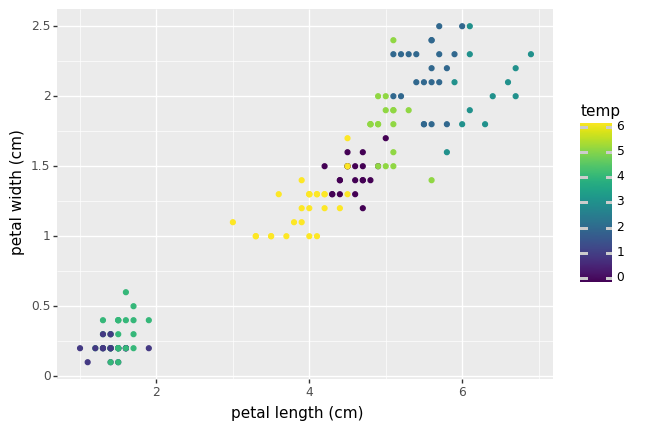

<ggplot: (8757736652509)>
CLuster8


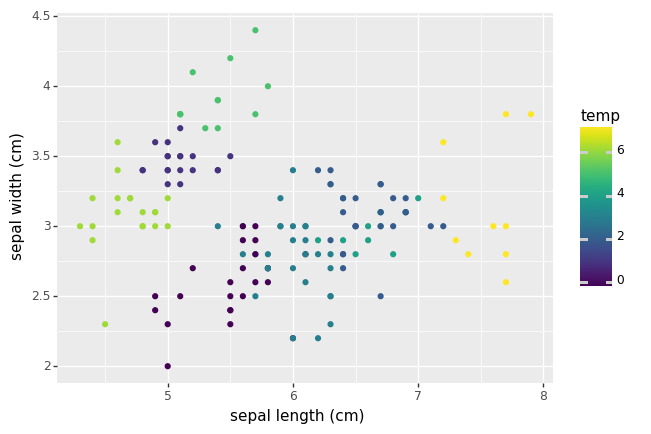

<ggplot: (8757737307737)>
CLuster8


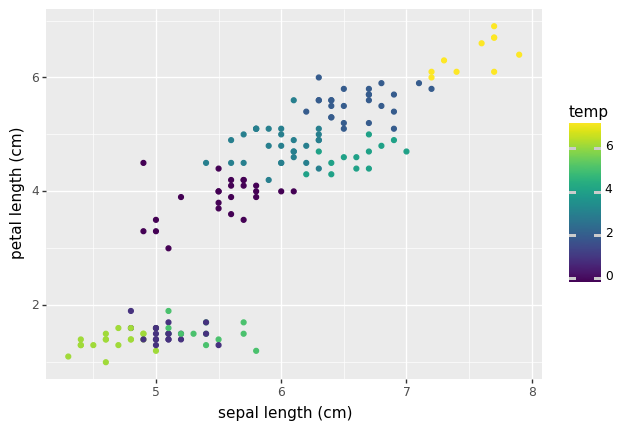

<ggplot: (8757737111761)>
CLuster8


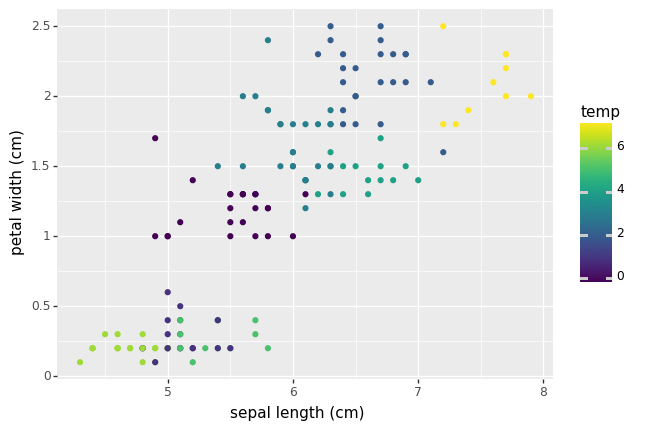

<ggplot: (8757736854173)>
CLuster8


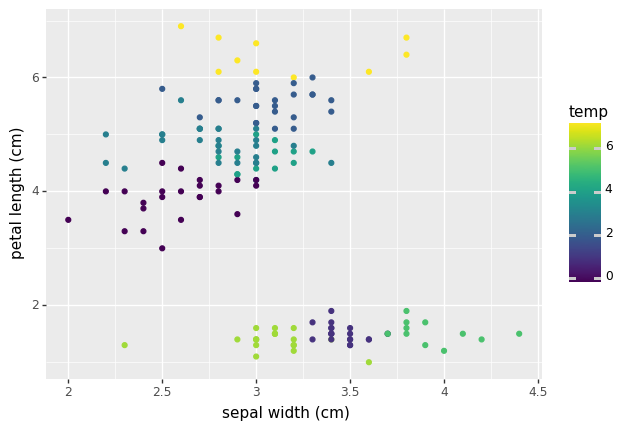

<ggplot: (8757736854189)>
CLuster8


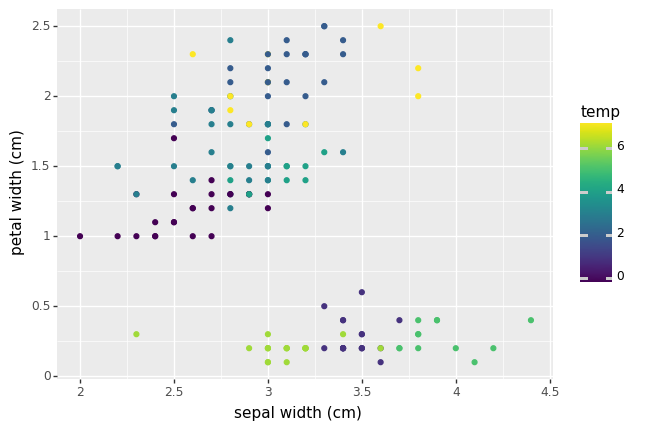

<ggplot: (8757737160041)>
CLuster8


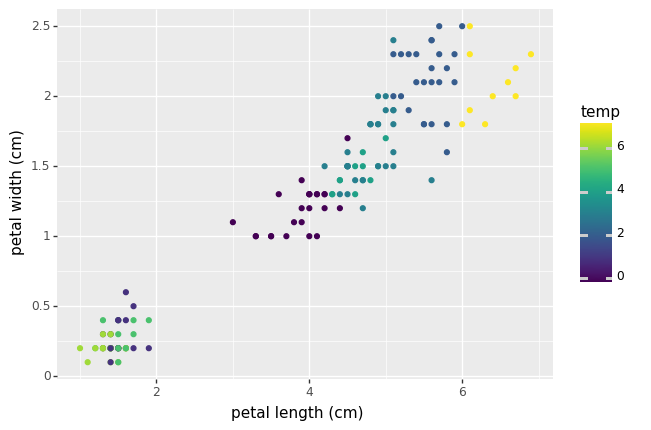

<ggplot: (8757737215693)>
CLuster9


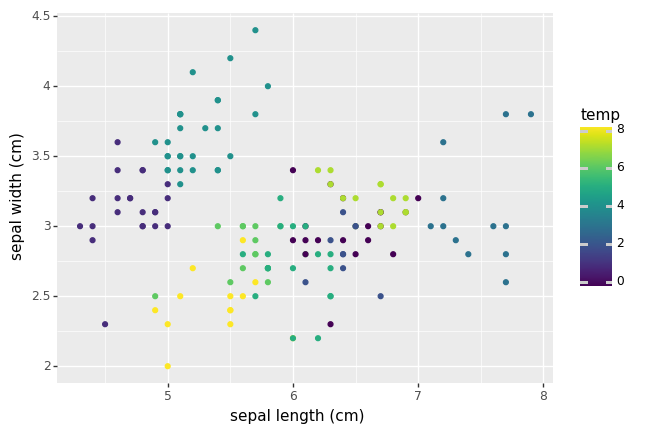

<ggplot: (8757739114681)>
CLuster9


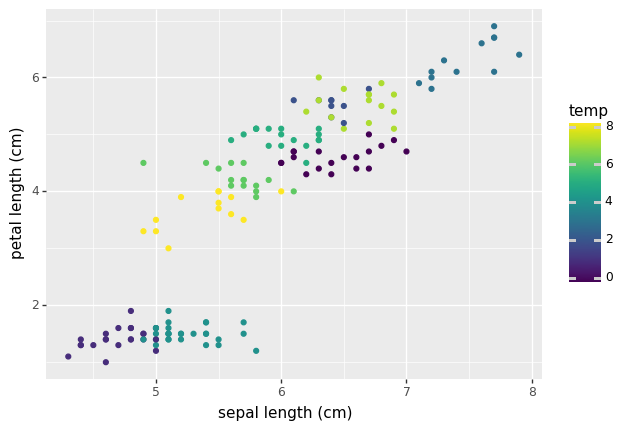

<ggplot: (8757737081045)>
CLuster9


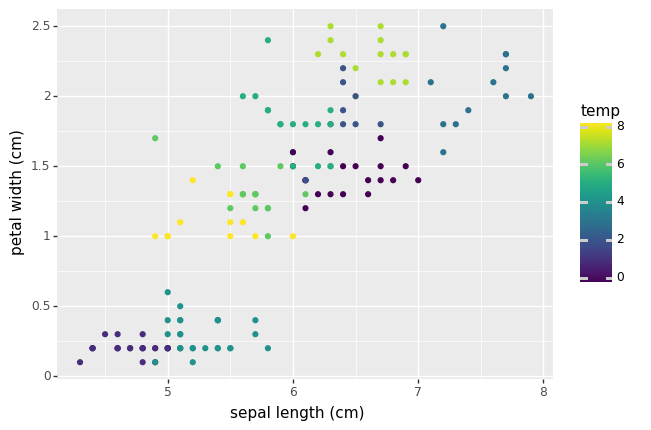

<ggplot: (8757737228789)>
CLuster9


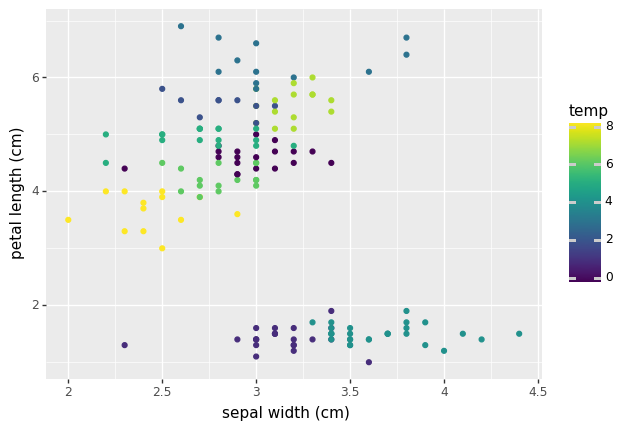

<ggplot: (8757736909801)>
CLuster9


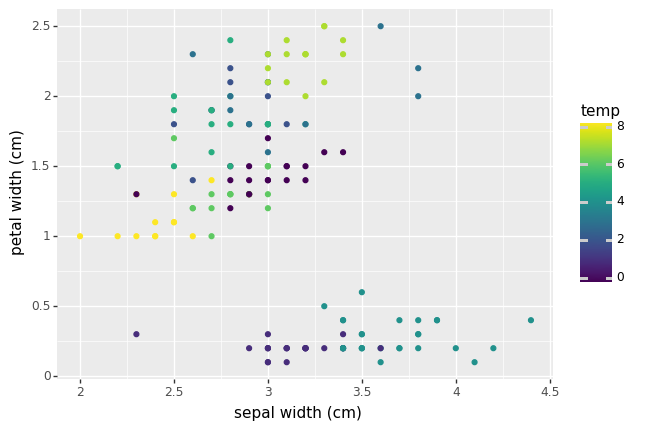

<ggplot: (8757736804373)>
CLuster9


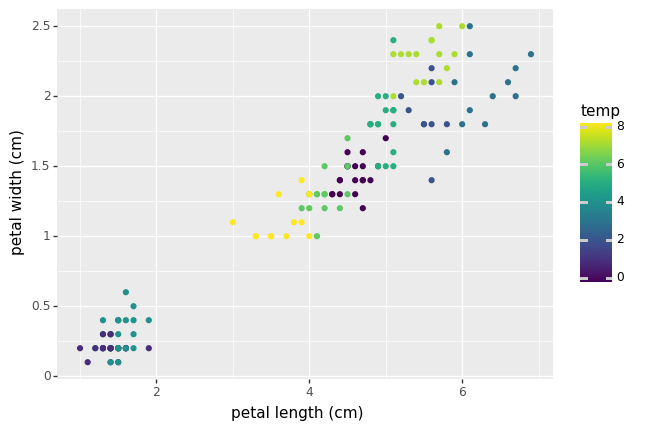

<ggplot: (8757738970097)>
CLuster10


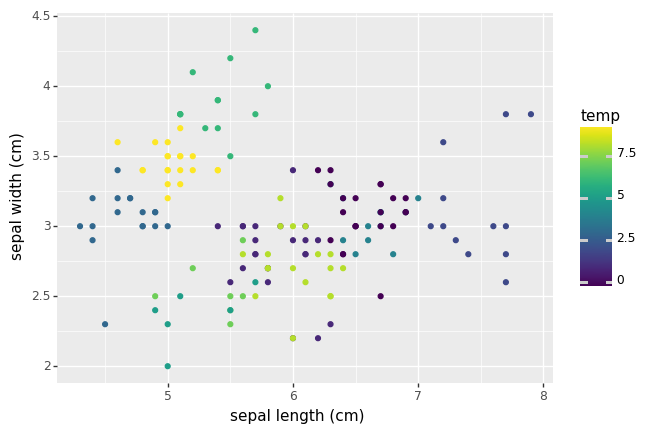

<ggplot: (8757739114613)>
CLuster10


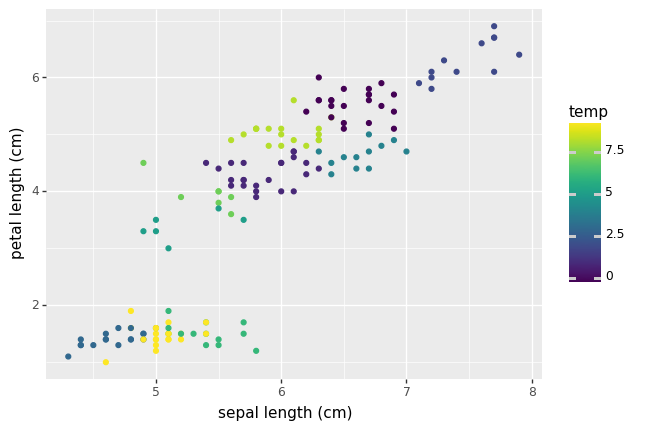

<ggplot: (8757736777953)>
CLuster10


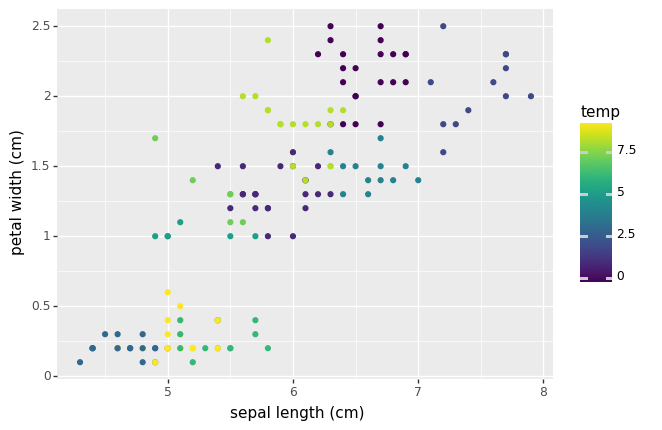

<ggplot: (8757736794937)>
CLuster10


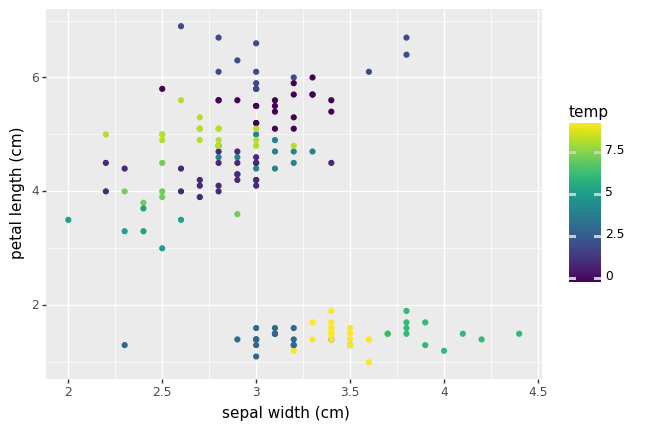

<ggplot: (8757737403573)>
CLuster10


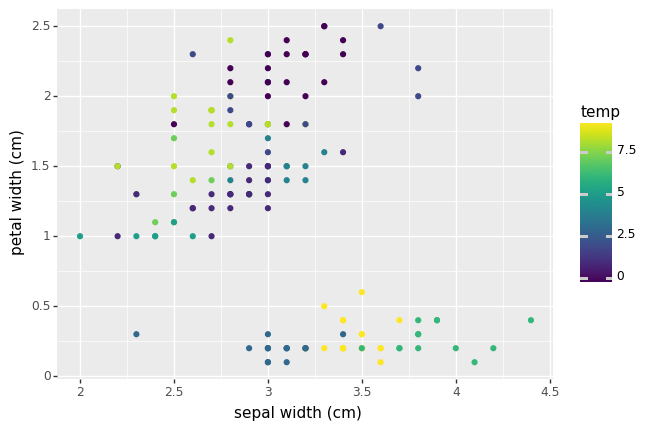

<ggplot: (8757737297957)>
CLuster10


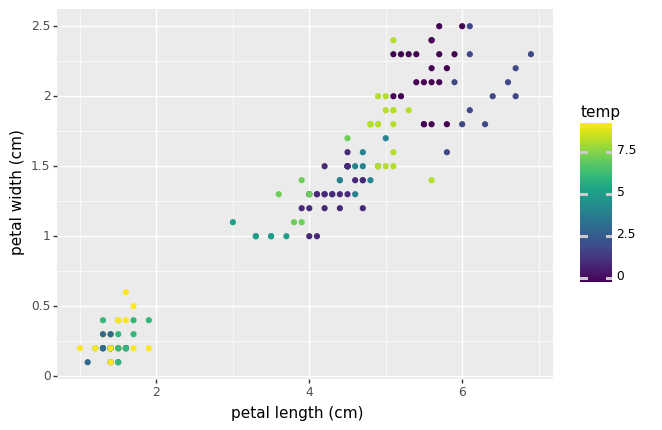

<ggplot: (8757736664913)>


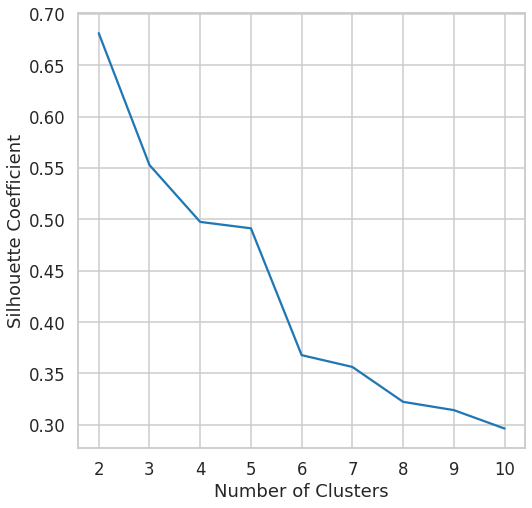

The best silhouette_coefficient is with 2 number of clusters
  


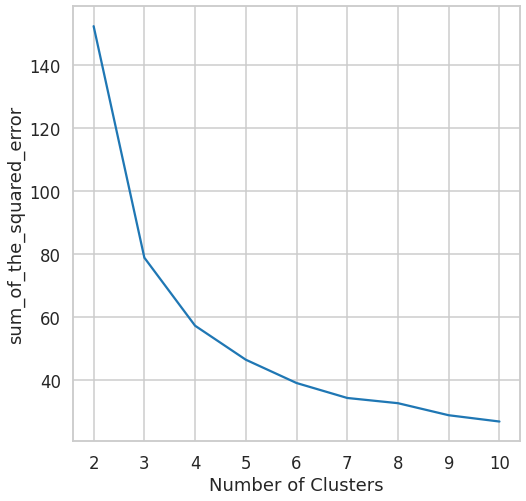

In [ ]:
from plotnine import *
from plotnine.data import mpg
from plotnine import ggplot, aes, facet_grid, labs, geom_point, theme_dark

sum_of_the_squared_error = []
listofrange=len(range(2,12,1))
i = 2
while listofrange >= i :
 if 'temp' in df.columns:
  df.drop('temp', axis=1, inplace=True)
 Kmeans = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
 Kmeans.fit(df)
 df['temp']=Kmeans.labels_
 sum_of_the_squared_error.append(Kmeans.inertia_)
 df_col=len(range(len(df.columns)-1))
 c=len(df.columns)-1
 rangeofinnerloop=range(c-1)
 j=0
 while df_col >j:
    for u in range(c-1):
      u+=1
      u+=j
      print("CLuster" + str(i))
      print(ggplot(df,aes(x=df.columns[j],y=df.columns[u],color='temp'))+geom_point())
    c-=1
    j+=1
 i+=1

silhouette_coefficients2=[]
i=2
while listofrange >= i :
  if 'temp' in df.columns:
   df.drop('temp', axis=1, inplace=True)
  Kmeans2 = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
  Kmeans2.fit(df)
  silhouette_coefficients2.append(silhouette_score(df, Kmeans2.labels_))
  i+=1


x2range=range(2,11,1)
plt.xticks(x2range)
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.plot(x2range, silhouette_coefficients2)
plt.show()
print("The best silhouette_coefficient is with", (silhouette_coefficients2.index(max(silhouette_coefficients2)))+2 , "number of clusters")
print('  ')
xrange=range(2,11,1)
plt.plot(xrange, sum_of_the_squared_error)
plt.xticks(xrange)
plt.xlabel("Number of Clusters")
plt.ylabel("sum_of_the_squared_error")
plt.show()



##DBSCAN

invalid eps 0.1 with range 5
invalid eps 1.7000000000000002 with range 5
invalid eps 1.8000000000000003 with range 5
invalid eps 1.9000000000000001 with range 5
invalid eps 2.0 with range 5
invalid eps 2.1 with range 5
invalid eps 2.2 with range 5
invalid eps 2.3000000000000003 with range 5
invalid eps 2.4000000000000004 with range 5
invalid eps 2.5000000000000004 with range 5
invalid eps 2.6 with range 5
invalid eps 2.7 with range 5
invalid eps 2.8000000000000003 with range 5
invalid eps 2.9000000000000004 with range 5
invalid eps 3.0000000000000004 with range 5


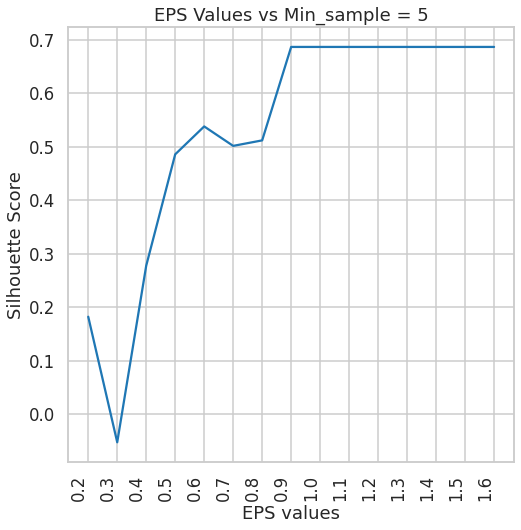

invalid eps 0.1 with range 6
invalid eps 1.7000000000000002 with range 6
invalid eps 1.8000000000000003 with range 6
invalid eps 1.9000000000000001 with range 6
invalid eps 2.0 with range 6
invalid eps 2.1 with range 6
invalid eps 2.2 with range 6
invalid eps 2.3000000000000003 with range 6
invalid eps 2.4000000000000004 with range 6
invalid eps 2.5000000000000004 with range 6
invalid eps 2.6 with range 6
invalid eps 2.7 with range 6
invalid eps 2.8000000000000003 with range 6
invalid eps 2.9000000000000004 with range 6
invalid eps 3.0000000000000004 with range 6


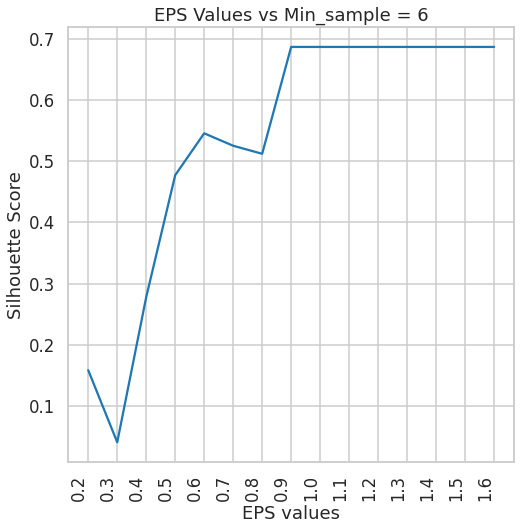

invalid eps 0.1 with range 7
invalid eps 1.7000000000000002 with range 7
invalid eps 1.8000000000000003 with range 7
invalid eps 1.9000000000000001 with range 7
invalid eps 2.0 with range 7
invalid eps 2.1 with range 7
invalid eps 2.2 with range 7
invalid eps 2.3000000000000003 with range 7
invalid eps 2.4000000000000004 with range 7
invalid eps 2.5000000000000004 with range 7
invalid eps 2.6 with range 7
invalid eps 2.7 with range 7
invalid eps 2.8000000000000003 with range 7
invalid eps 2.9000000000000004 with range 7
invalid eps 3.0000000000000004 with range 7


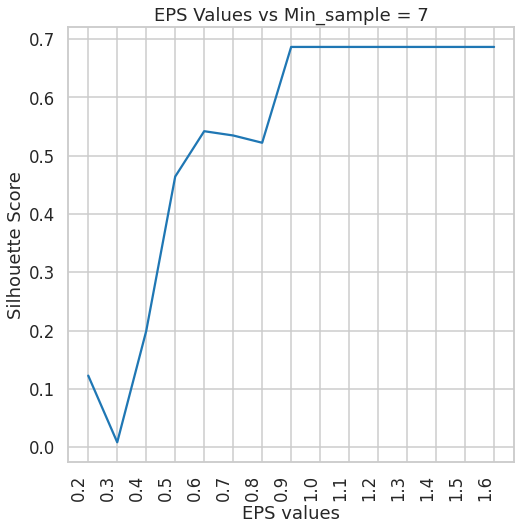

invalid eps 0.1 with range 8
invalid eps 1.7000000000000002 with range 8
invalid eps 1.8000000000000003 with range 8
invalid eps 1.9000000000000001 with range 8
invalid eps 2.0 with range 8
invalid eps 2.1 with range 8
invalid eps 2.2 with range 8
invalid eps 2.3000000000000003 with range 8
invalid eps 2.4000000000000004 with range 8
invalid eps 2.5000000000000004 with range 8
invalid eps 2.6 with range 8
invalid eps 2.7 with range 8
invalid eps 2.8000000000000003 with range 8
invalid eps 2.9000000000000004 with range 8
invalid eps 3.0000000000000004 with range 8


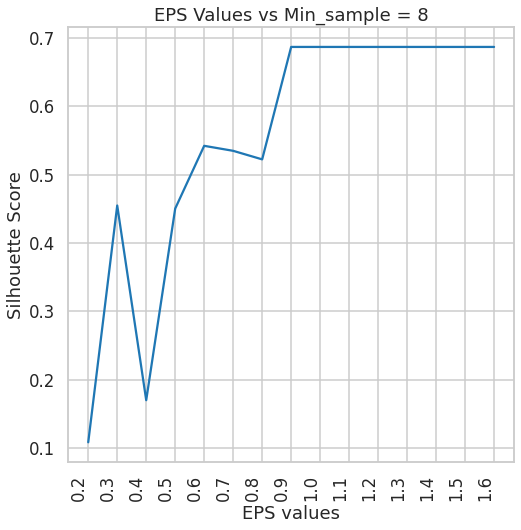

invalid eps 0.1 with range 9
invalid eps 0.2 with range 9
invalid eps 1.7000000000000002 with range 9
invalid eps 1.8000000000000003 with range 9
invalid eps 1.9000000000000001 with range 9
invalid eps 2.0 with range 9
invalid eps 2.1 with range 9
invalid eps 2.2 with range 9
invalid eps 2.3000000000000003 with range 9
invalid eps 2.4000000000000004 with range 9
invalid eps 2.5000000000000004 with range 9
invalid eps 2.6 with range 9
invalid eps 2.7 with range 9
invalid eps 2.8000000000000003 with range 9
invalid eps 2.9000000000000004 with range 9
invalid eps 3.0000000000000004 with range 9


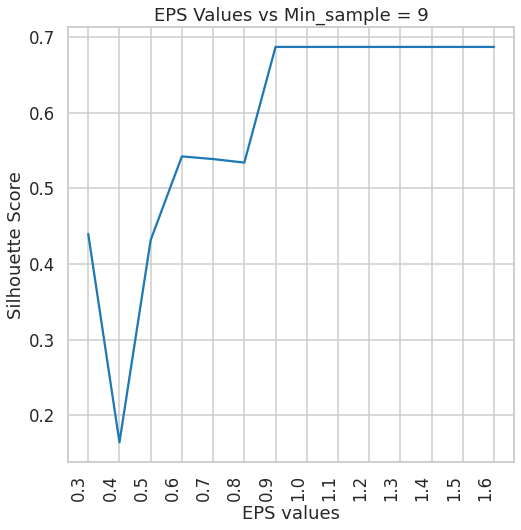

invalid eps 0.1 with range 10
invalid eps 0.2 with range 10
invalid eps 1.7000000000000002 with range 10
invalid eps 1.8000000000000003 with range 10
invalid eps 1.9000000000000001 with range 10
invalid eps 2.0 with range 10
invalid eps 2.1 with range 10
invalid eps 2.2 with range 10
invalid eps 2.3000000000000003 with range 10
invalid eps 2.4000000000000004 with range 10
invalid eps 2.5000000000000004 with range 10
invalid eps 2.6 with range 10
invalid eps 2.7 with range 10
invalid eps 2.8000000000000003 with range 10
invalid eps 2.9000000000000004 with range 10
invalid eps 3.0000000000000004 with range 10


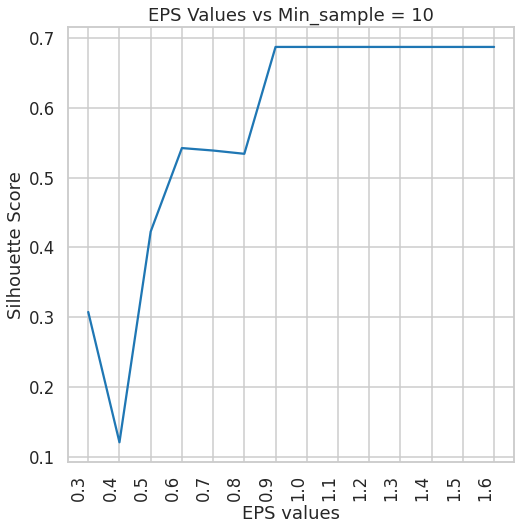

invalid eps 0.1 with range 11
invalid eps 0.2 with range 11
invalid eps 1.7000000000000002 with range 11
invalid eps 1.8000000000000003 with range 11
invalid eps 1.9000000000000001 with range 11
invalid eps 2.0 with range 11
invalid eps 2.1 with range 11
invalid eps 2.2 with range 11
invalid eps 2.3000000000000003 with range 11
invalid eps 2.4000000000000004 with range 11
invalid eps 2.5000000000000004 with range 11
invalid eps 2.6 with range 11
invalid eps 2.7 with range 11
invalid eps 2.8000000000000003 with range 11
invalid eps 2.9000000000000004 with range 11
invalid eps 3.0000000000000004 with range 11


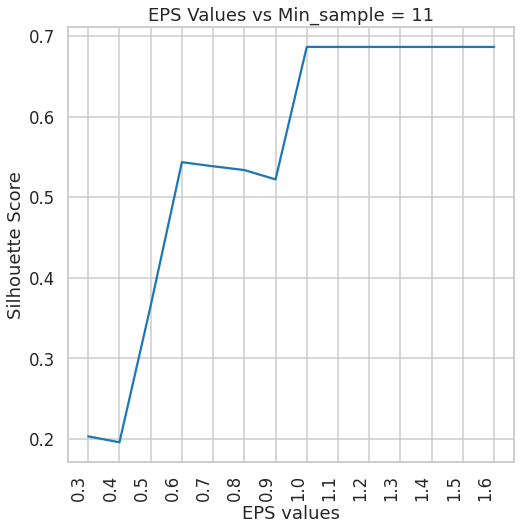

invalid eps 0.1 with range 12
invalid eps 0.2 with range 12
invalid eps 1.7000000000000002 with range 12
invalid eps 1.8000000000000003 with range 12
invalid eps 1.9000000000000001 with range 12
invalid eps 2.0 with range 12
invalid eps 2.1 with range 12
invalid eps 2.2 with range 12
invalid eps 2.3000000000000003 with range 12
invalid eps 2.4000000000000004 with range 12
invalid eps 2.5000000000000004 with range 12
invalid eps 2.6 with range 12
invalid eps 2.7 with range 12
invalid eps 2.8000000000000003 with range 12
invalid eps 2.9000000000000004 with range 12
invalid eps 3.0000000000000004 with range 12


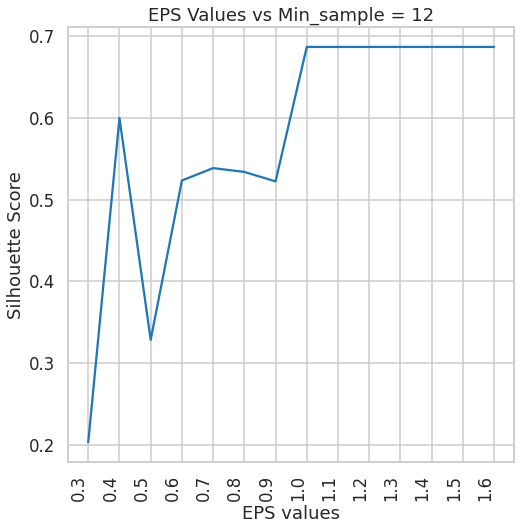

invalid eps 0.1 with range 13
invalid eps 0.2 with range 13
invalid eps 0.30000000000000004 with range 13
invalid eps 1.7000000000000002 with range 13
invalid eps 1.8000000000000003 with range 13
invalid eps 1.9000000000000001 with range 13
invalid eps 2.0 with range 13
invalid eps 2.1 with range 13
invalid eps 2.2 with range 13
invalid eps 2.3000000000000003 with range 13
invalid eps 2.4000000000000004 with range 13
invalid eps 2.5000000000000004 with range 13
invalid eps 2.6 with range 13
invalid eps 2.7 with range 13
invalid eps 2.8000000000000003 with range 13
invalid eps 2.9000000000000004 with range 13
invalid eps 3.0000000000000004 with range 13


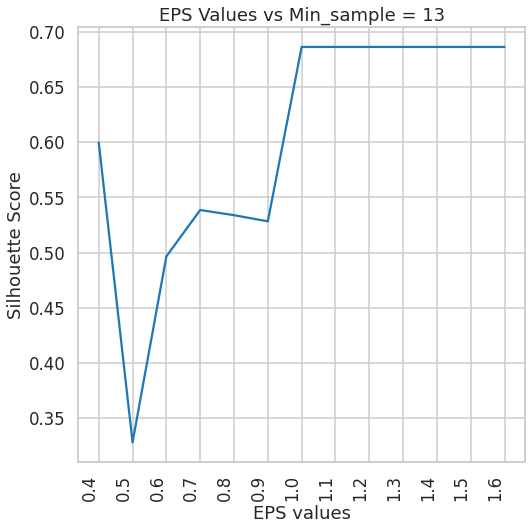

invalid eps 0.1 with range 14
invalid eps 0.2 with range 14
invalid eps 0.30000000000000004 with range 14


KeyboardInterrupt: ignored

In [ ]:
min_samples_list=range(5,26,1)
min_samples_range= len(range(5,26,1))
epsss=np.arange(0.1, 3.1, 0.1)
eps_range=len(np.arange(0.1, 3.1, 0.1))
best_silhouette_score =0
best_ep=0
best_min_sample=0



if 'temp' in df.columns:
 df.drop('temp', axis=1, inplace=True)
i=0



while min_samples_range - 1 >= i:

  silhouette_scores = []
  valid_eps=[]
  
  j=0
  while eps_range - 1 >= j: 
    dbscan = DBSCAN(eps=epsss[j], min_samples=min_samples_list[i])
    dbscan.fit(df)

    if (len(np.unique(dbscan.labels_)) <= 1):
      print("invalid eps",epsss[j],"with range",min_samples_list[i])
      j+=1
      continue

    valid_eps.append(epsss[j])
    sil_dbscan = silhouette_score(df, dbscan.labels_)
    silhouette_scores.append(sil_dbscan)

    if (best_silhouette_score <= sil_dbscan): 
     best_silhouette_score =sil_dbscan
     best_min_sample=min_samples_list[i]
     best_ep=epsss[j],
    j+=1
 
  plt.plot(valid_eps, silhouette_scores)
  plt.xticks(valid_eps)
  graph_helper= plt.subplot()   
  plt.setp(graph_helper.get_xticklabels(), rotation=90, ha='right')
  plt.title("EPS Values vs Min_sample = " + str(min_samples_list[i]))
  plt.xlabel("EPS values")
  plt.ylabel("Silhouette Score")
  plt.show() 
  i+=1

      

print("The max Silhouette Score is", best_silhouette_score ,"with eps equal to" , best_ep , "and min_samples equal to", best_min_sample )

        

##Hirichal Clustering

cityblock
average
0.3
['0.33327598004547765', 'cityblock', 'average', '0.3']


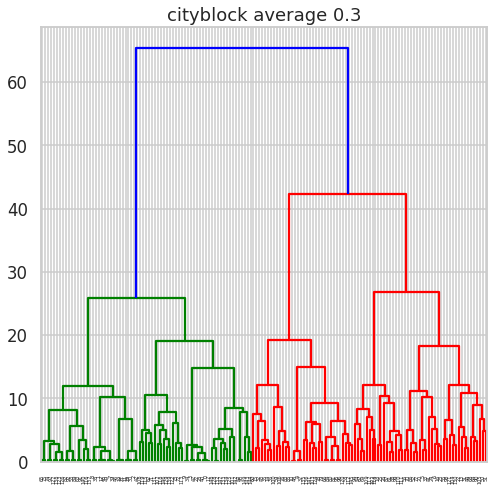

CLuster9


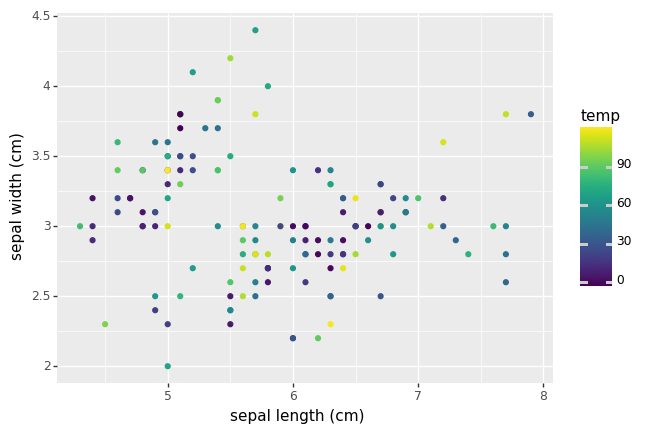

<ggplot: (8757737228873)>
CLuster9


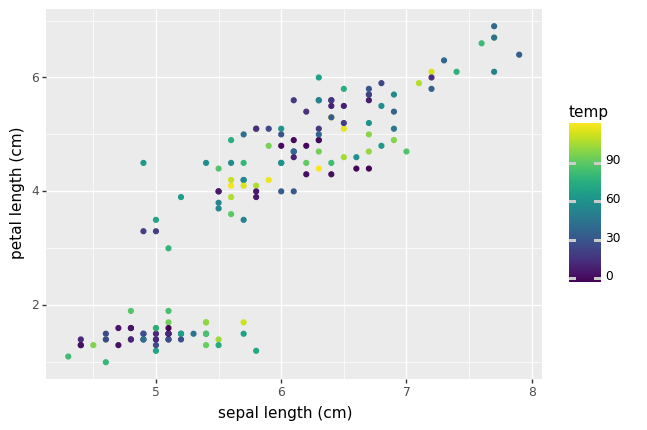

<ggplot: (8757736735301)>
CLuster9


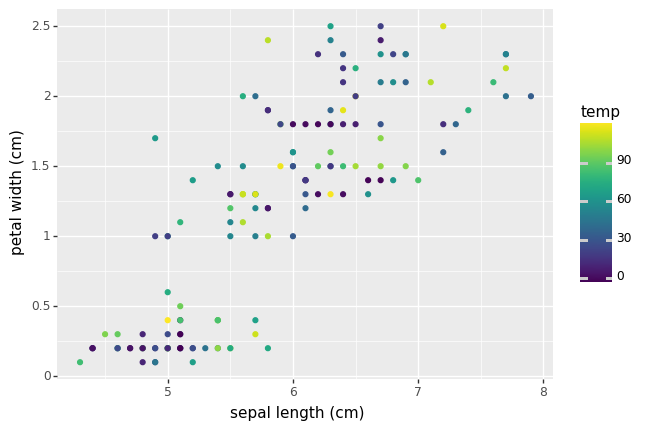

<ggplot: (8757736690005)>
CLuster9


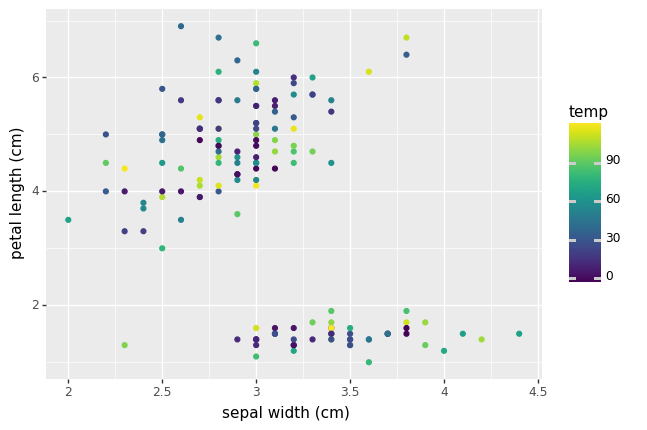

<ggplot: (8757736056553)>
CLuster9


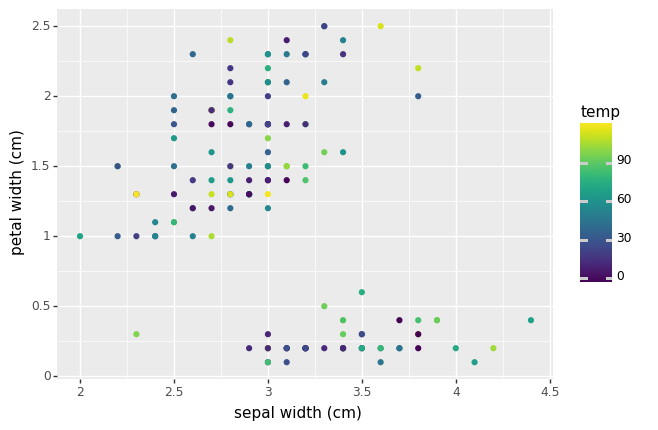

<ggplot: (8757736056449)>
CLuster9


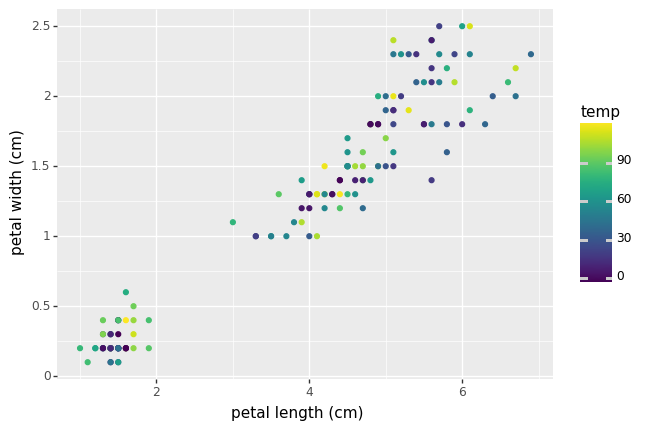

<ggplot: (8757736266633)>
0.5
['0.5567820794322877', 'cityblock', 'average', '0.5']


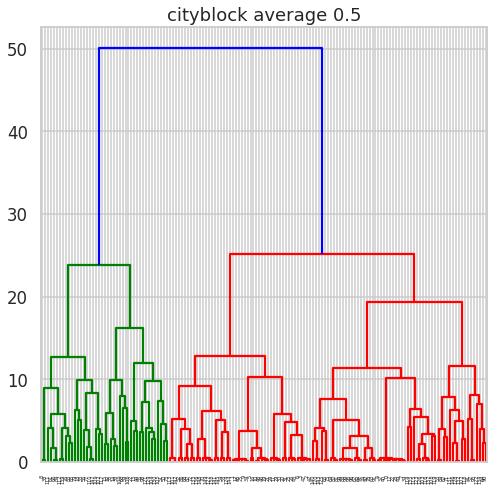

CLuster9


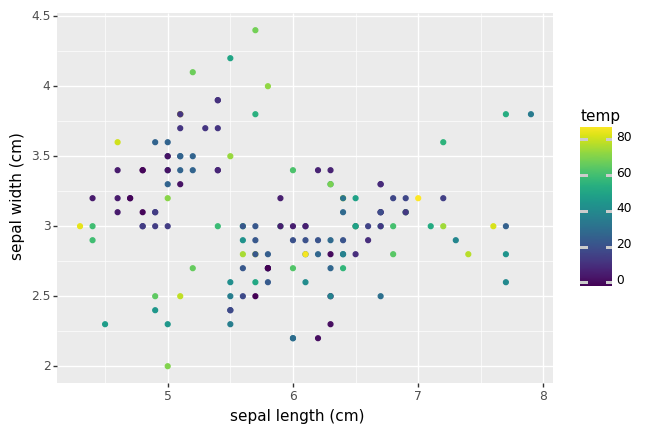

<ggplot: (8757736604789)>
CLuster9


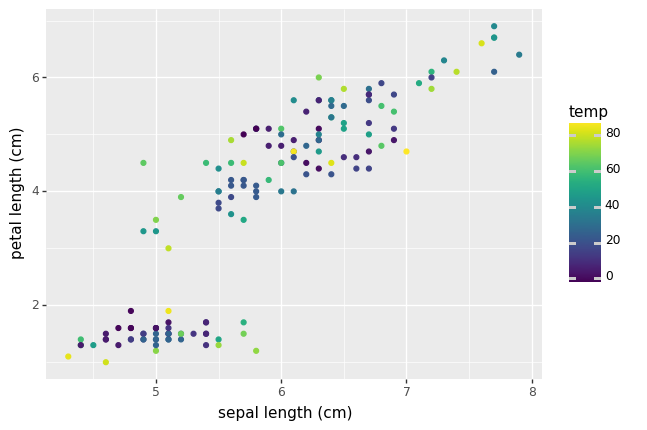

<ggplot: (8757739579841)>
CLuster9


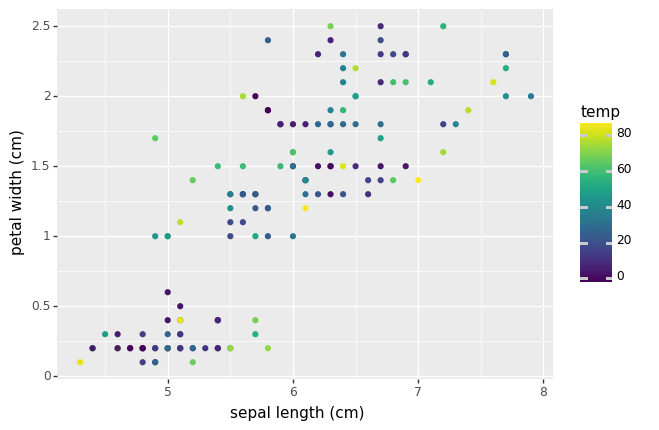

<ggplot: (8757737175781)>
CLuster9


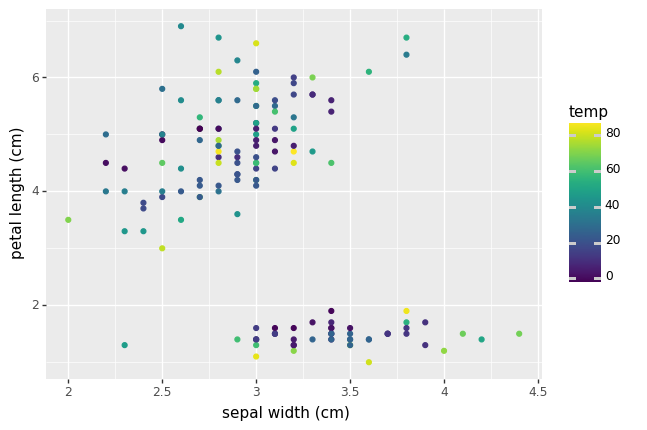

<ggplot: (8757736881965)>
CLuster9


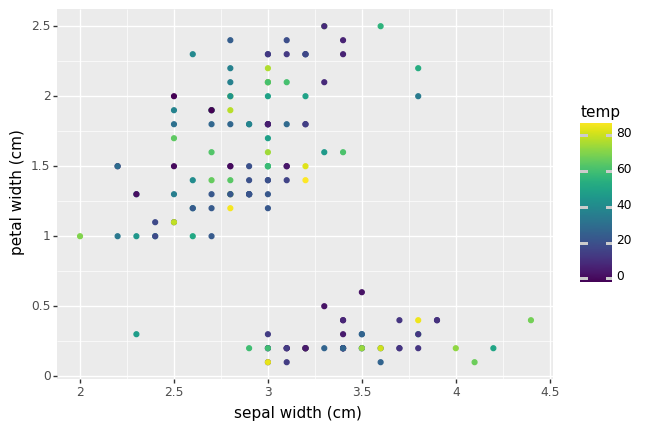

<ggplot: (8757736823177)>
CLuster9


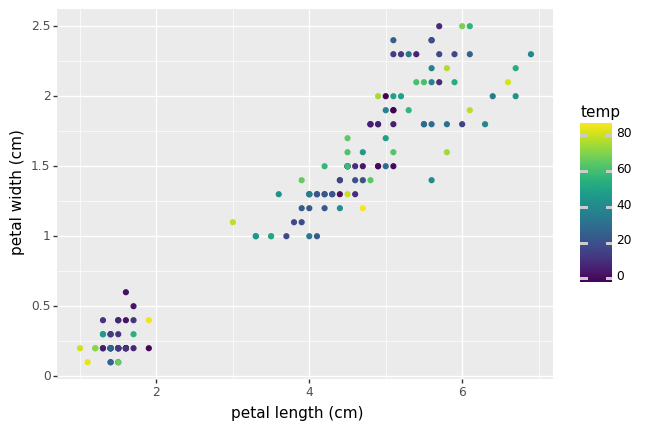

<ggplot: (8757737484089)>
0.7
['0.6896722681433408', 'cityblock', 'average', '0.7']


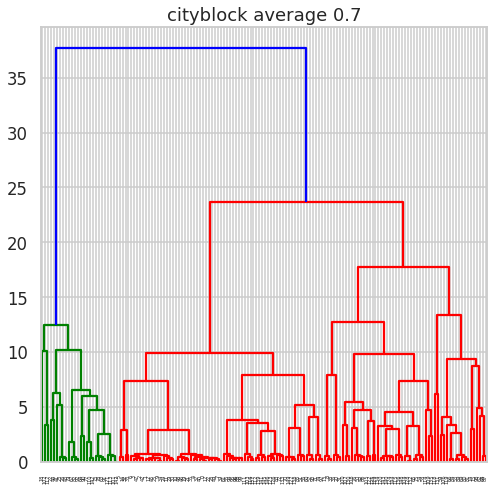

CLuster9


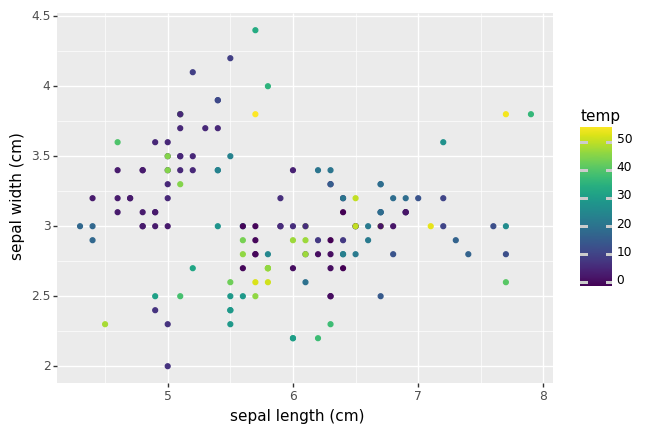

<ggplot: (8757736525545)>
CLuster9


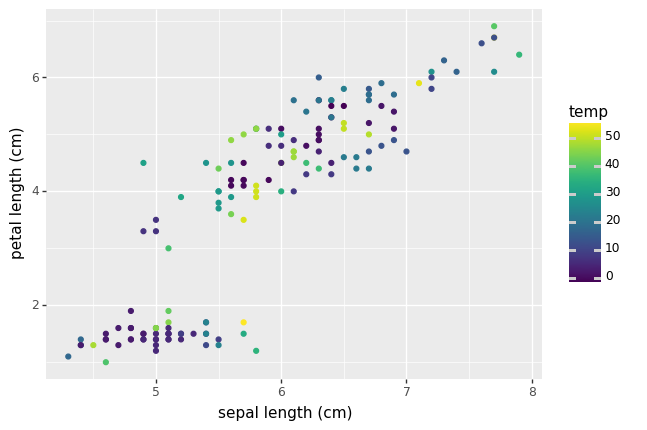

<ggplot: (8757736555921)>
CLuster9


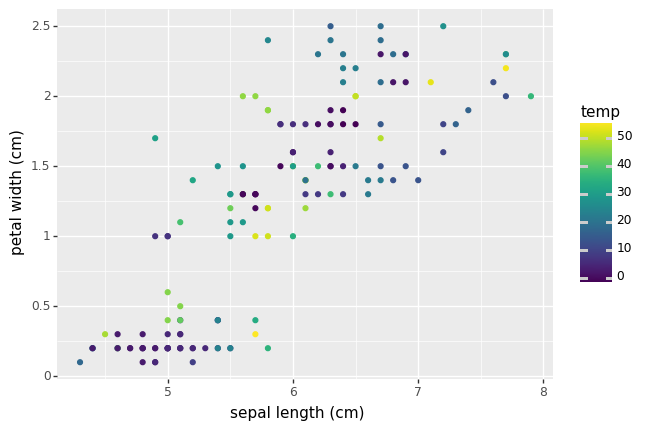

<ggplot: (8757736057861)>
CLuster9


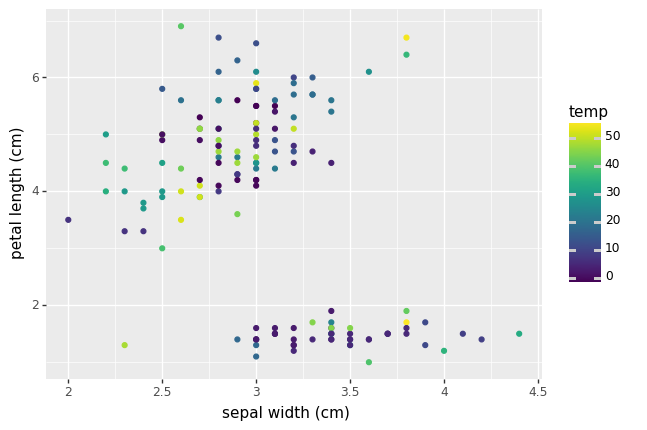

<ggplot: (8757736663233)>
CLuster9


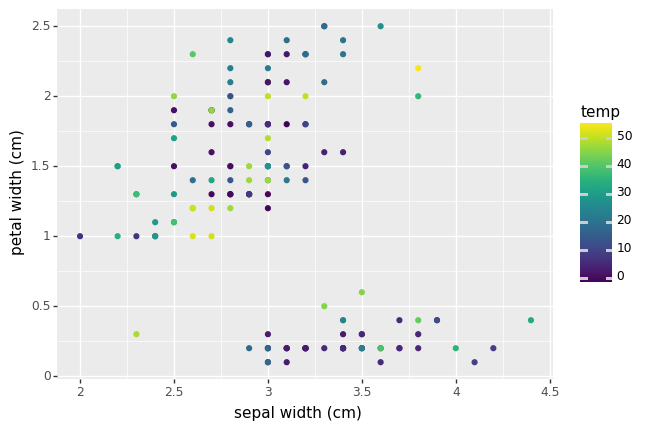

<ggplot: (8757736115305)>
CLuster9


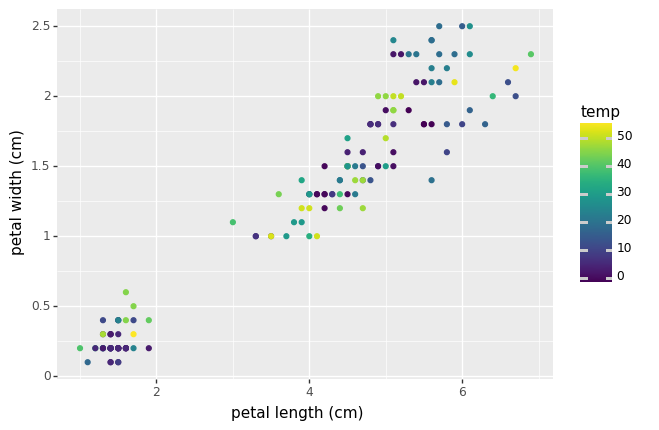

<ggplot: (8757736365089)>
0.9000000000000001


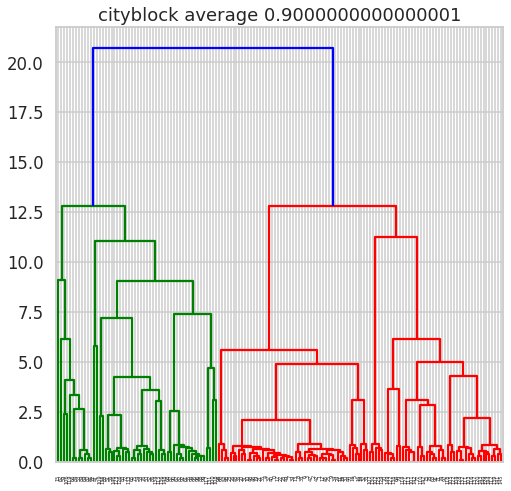

CLuster9


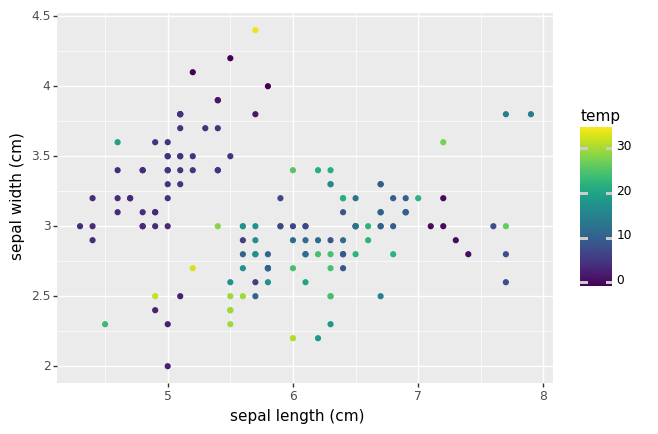

<ggplot: (8757739067365)>
CLuster9


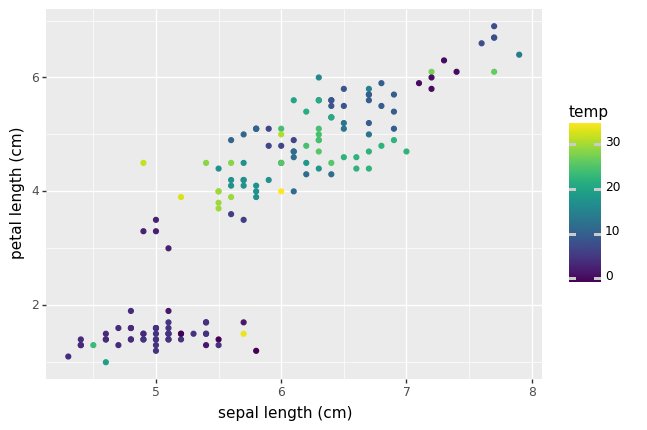

<ggplot: (8757739067185)>
CLuster9


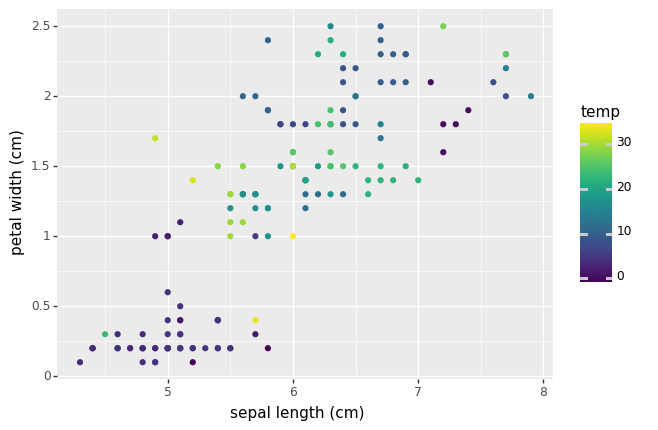

<ggplot: (8757737215709)>
CLuster9


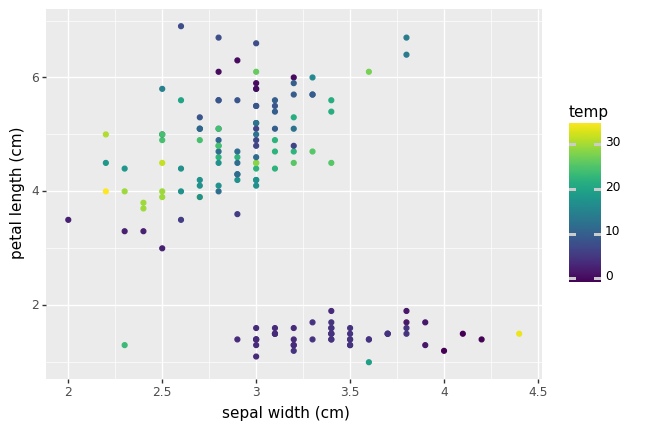

<ggplot: (8757739550645)>
CLuster9


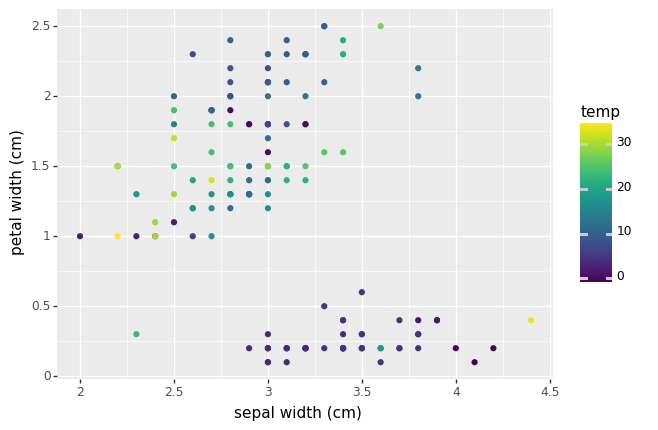

<ggplot: (8757739263417)>
CLuster9


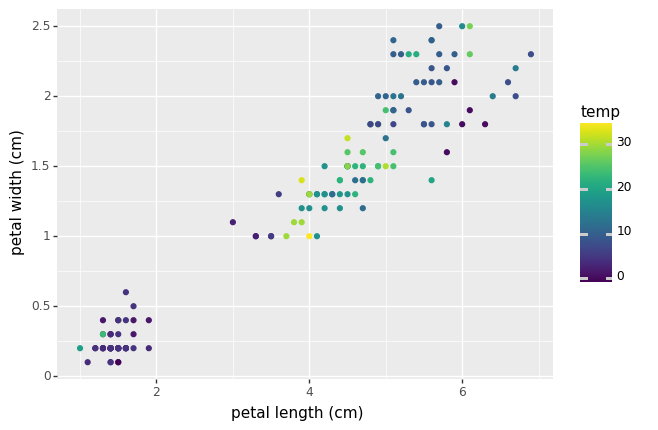

<ggplot: (8757739263369)>
1.1
['0.6978086688094964', 'cityblock', 'average', '1.1']


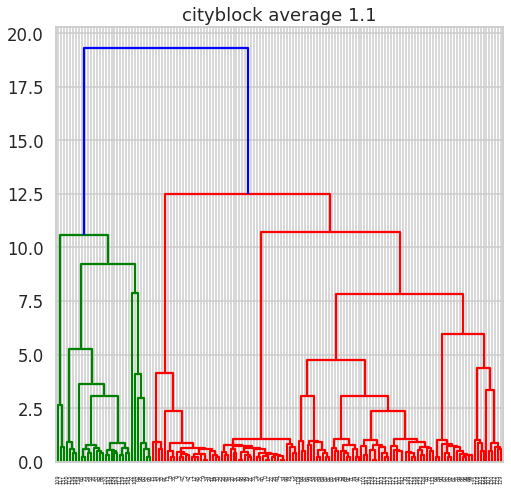

CLuster9


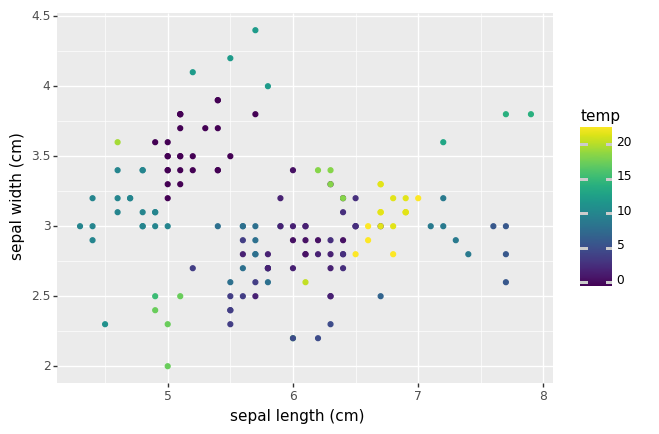

<ggplot: (8757737349401)>
CLuster9


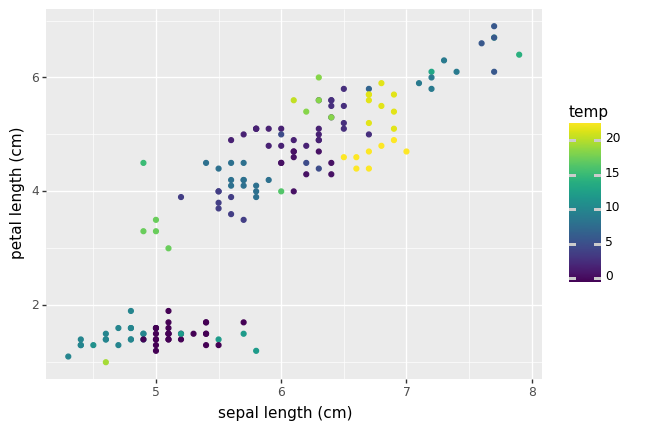

<ggplot: (8757736118477)>
CLuster9


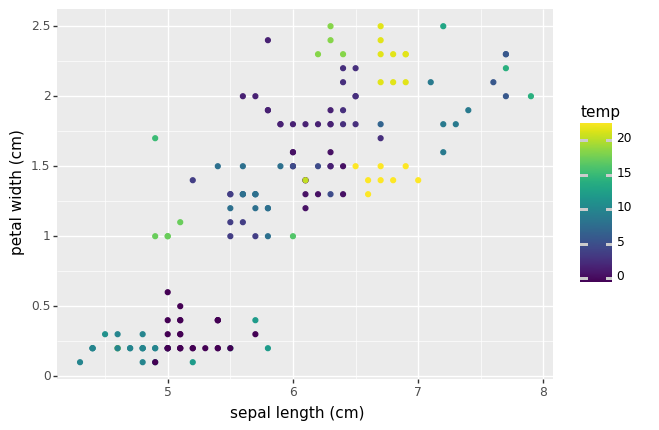

<ggplot: (8757736504297)>
CLuster9


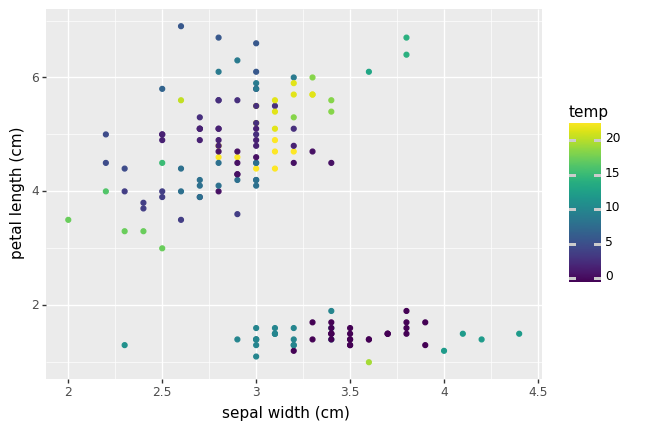

<ggplot: (8757736252949)>
CLuster9


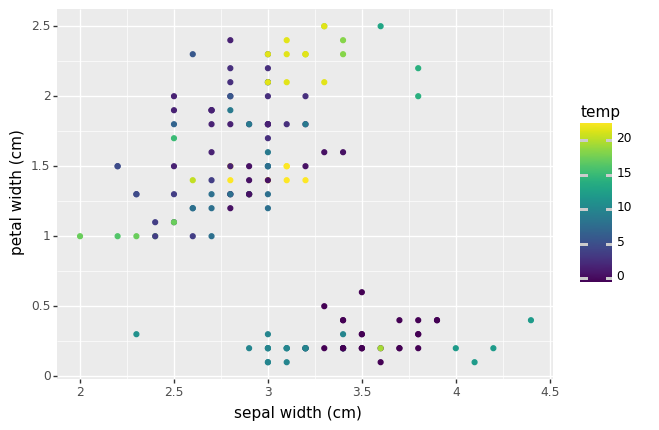

<ggplot: (8757735997217)>
CLuster9


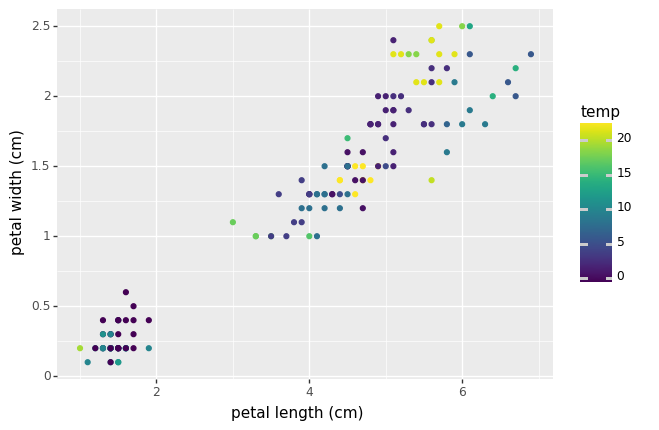

<ggplot: (8757736266405)>
1.3


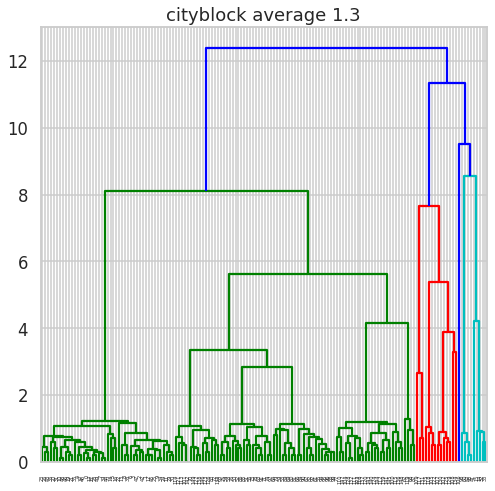

CLuster9


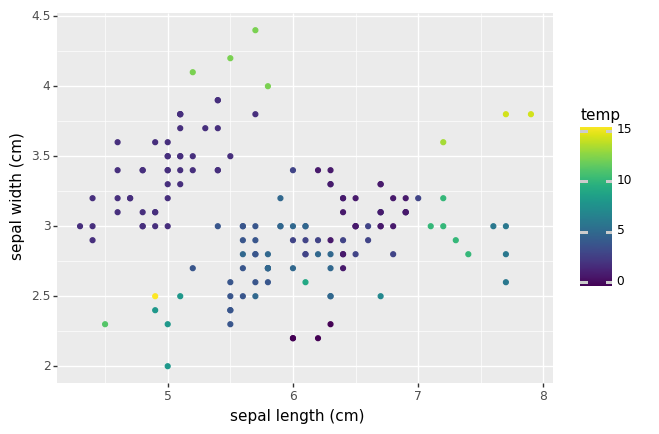

<ggplot: (8757736575821)>
CLuster9


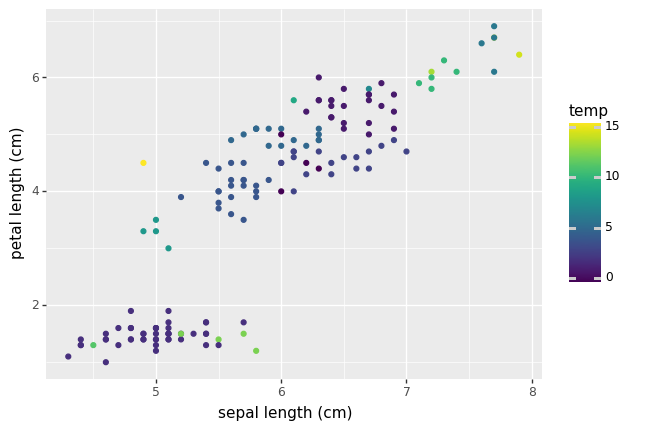

<ggplot: (8757735422057)>
CLuster9


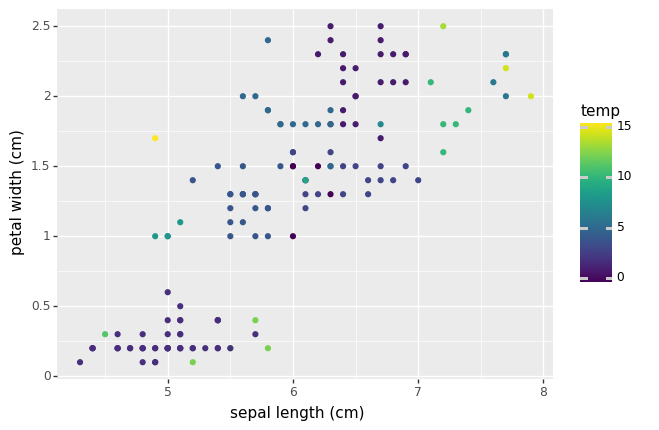

<ggplot: (8757736346149)>
CLuster9


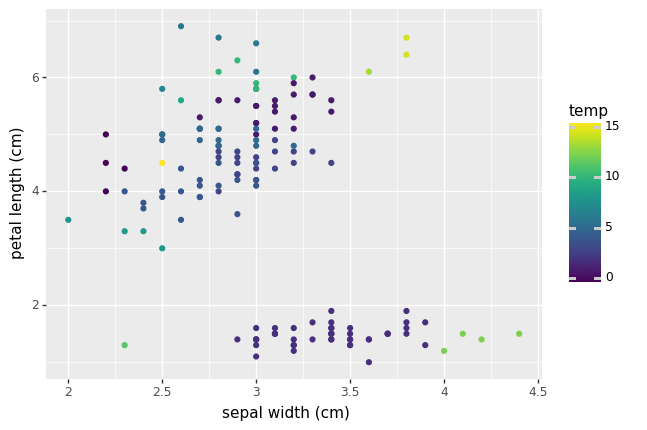

<ggplot: (8757736318065)>
CLuster9


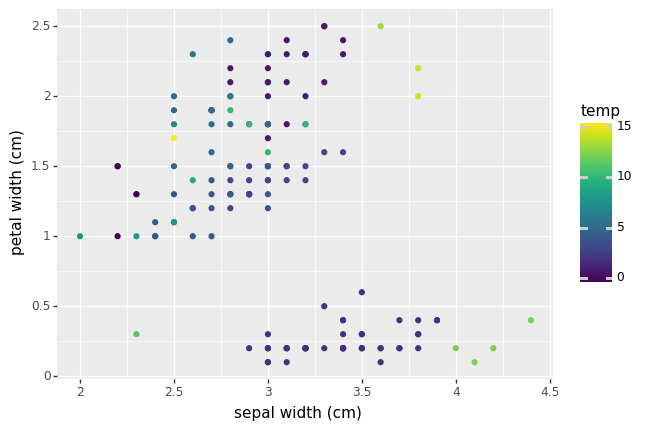

<ggplot: (8757737563217)>
CLuster9


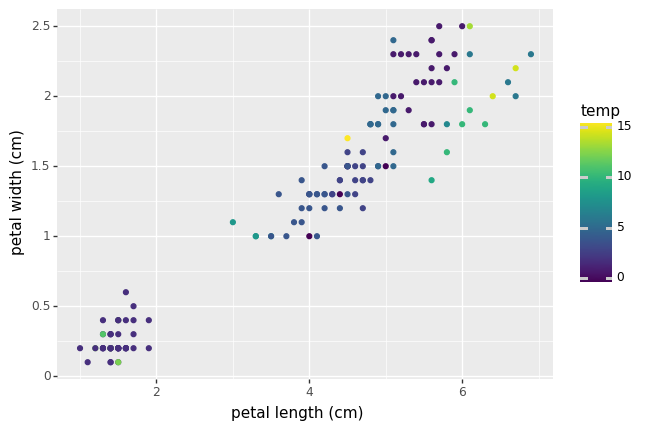

<ggplot: (8757736890441)>
1.5000000000000002


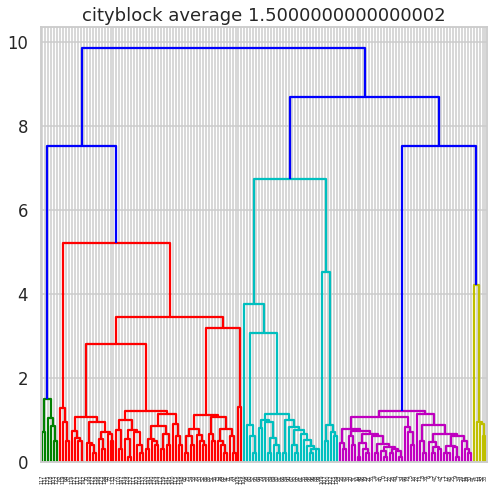

CLuster9


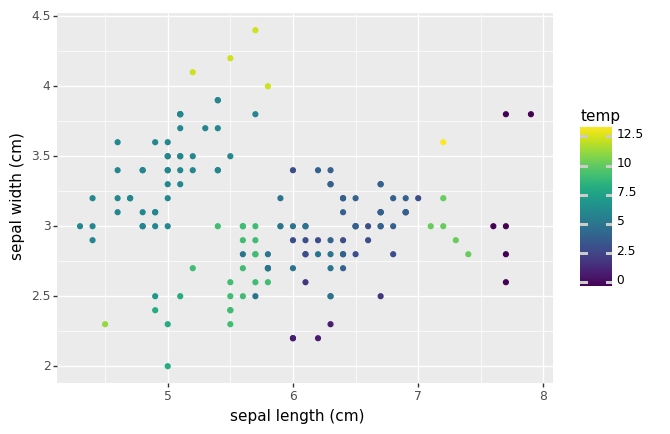

<ggplot: (8757735465765)>
CLuster9


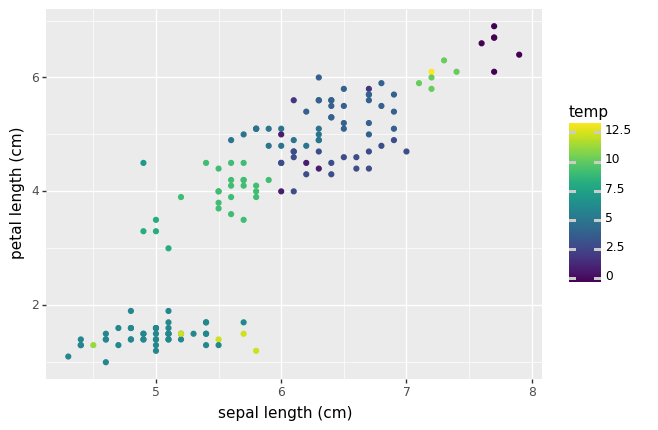

<ggplot: (8757736340721)>
CLuster9


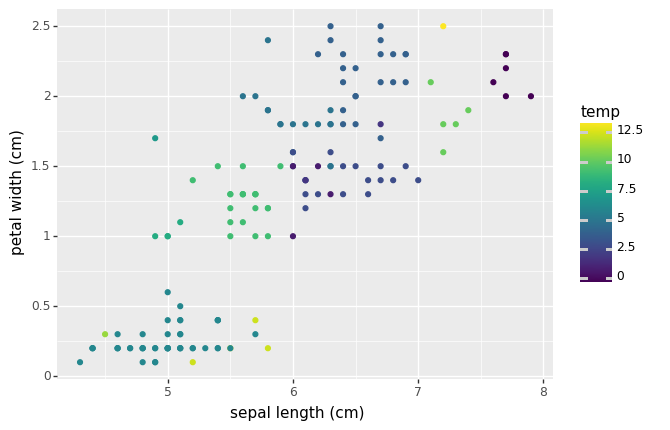

<ggplot: (8757736483337)>
CLuster9


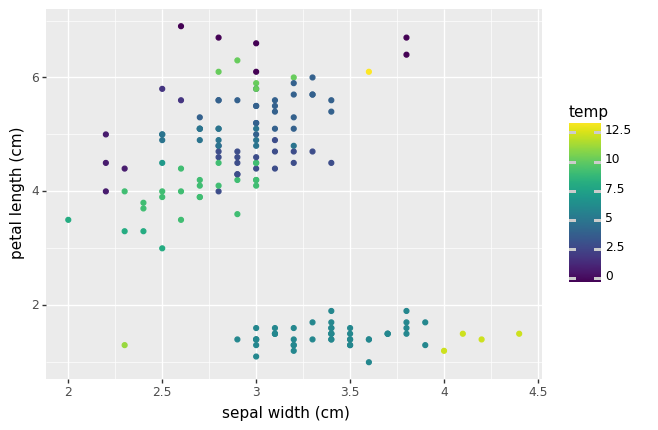

<ggplot: (8757736485461)>
CLuster9


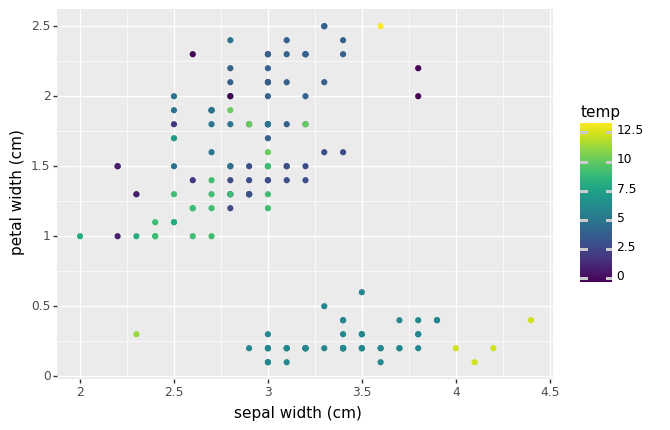

<ggplot: (8757736287989)>
CLuster9


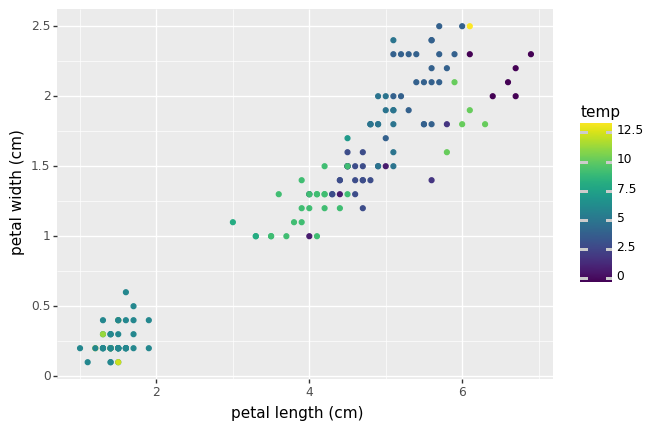

<ggplot: (8757737314329)>
1.7000000000000002
['0.7170449411350971', 'cityblock', 'average', '1.7']


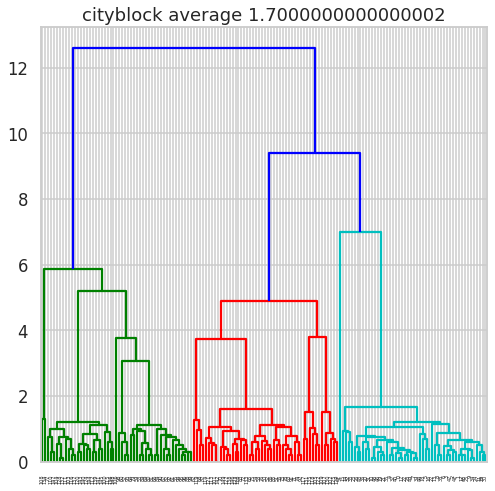

CLuster9


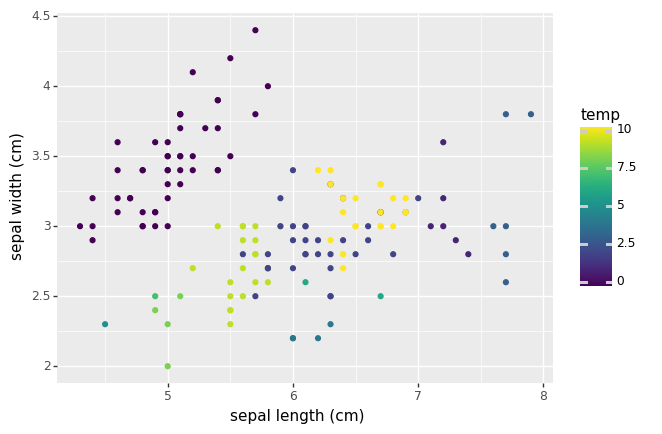

<ggplot: (8757736682513)>
CLuster9


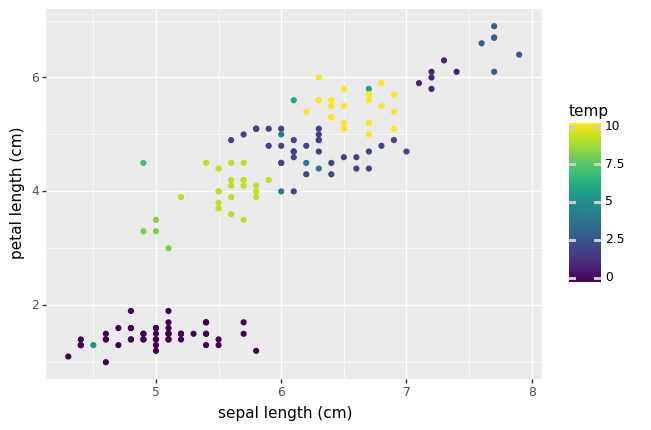

<ggplot: (8757736521873)>
CLuster9


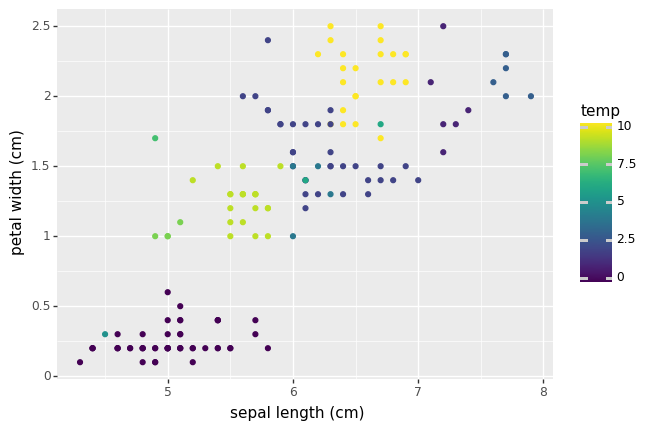

<ggplot: (8757737145161)>
CLuster9


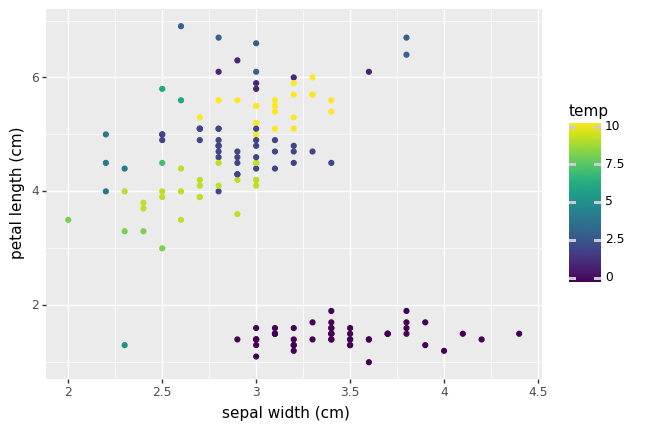

<ggplot: (8757737335389)>
CLuster9


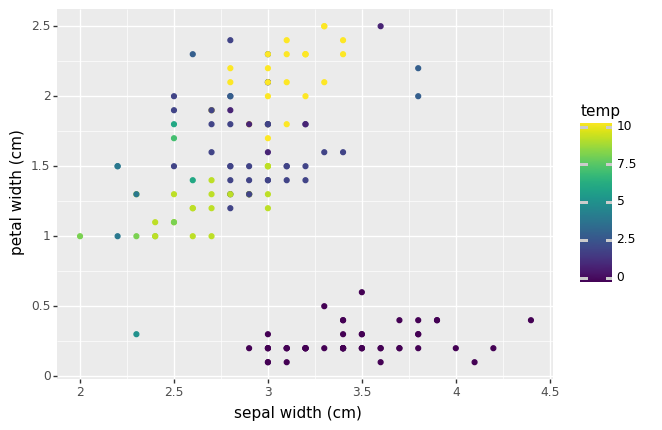

<ggplot: (8757735431129)>
CLuster9


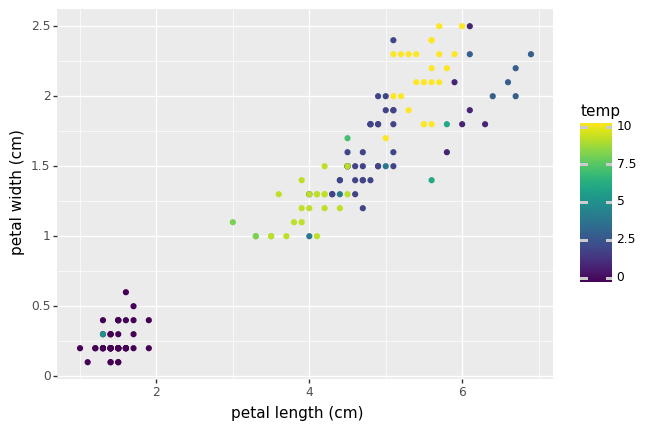

<ggplot: (8757736189237)>
1.9000000000000001


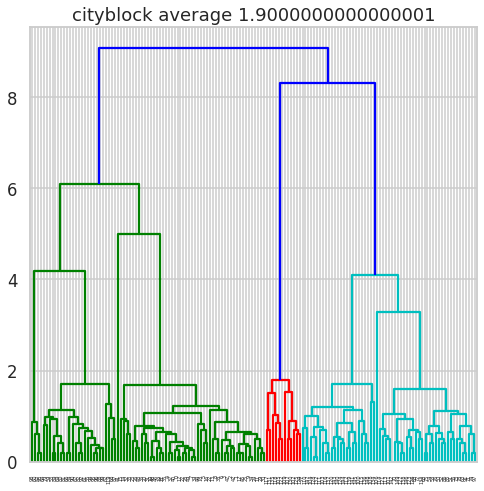

CLuster9


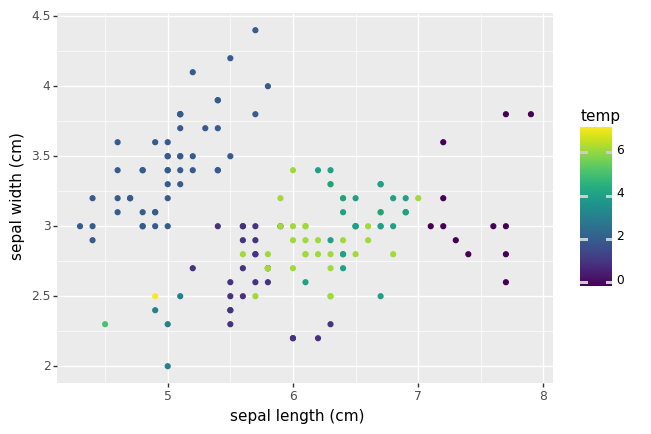

<ggplot: (8757736666141)>
CLuster9


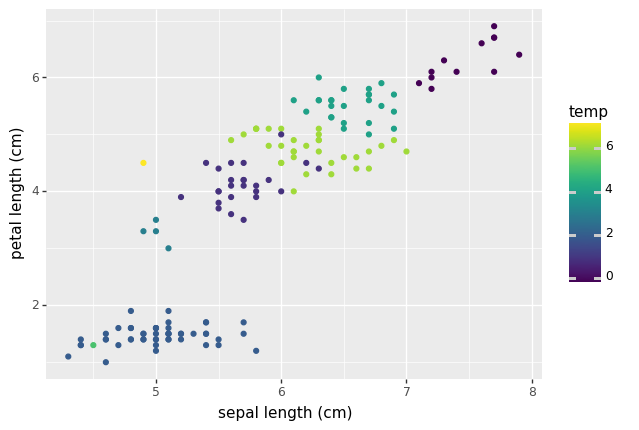

<ggplot: (8757736980257)>
CLuster9


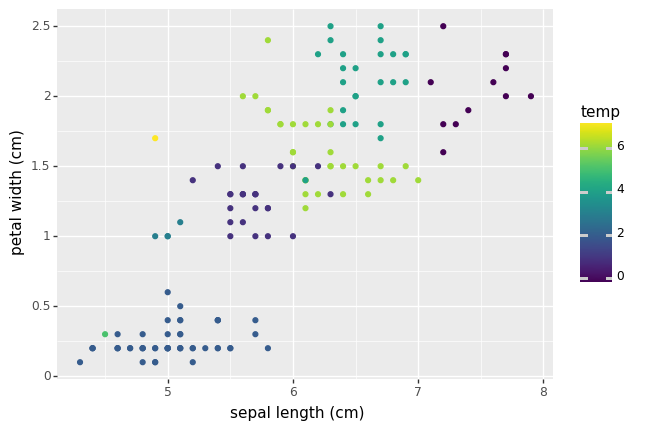

<ggplot: (8757736173965)>
CLuster9


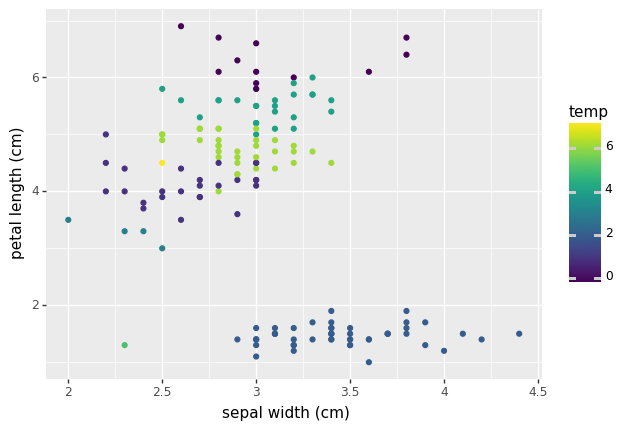

<ggplot: (8757735792357)>
CLuster9


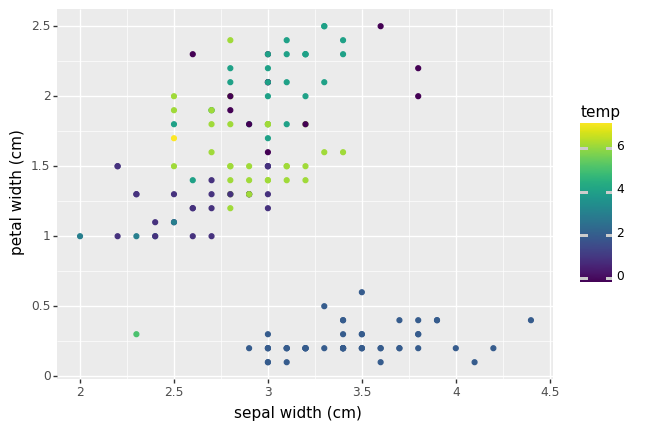

<ggplot: (8757736646829)>
CLuster9


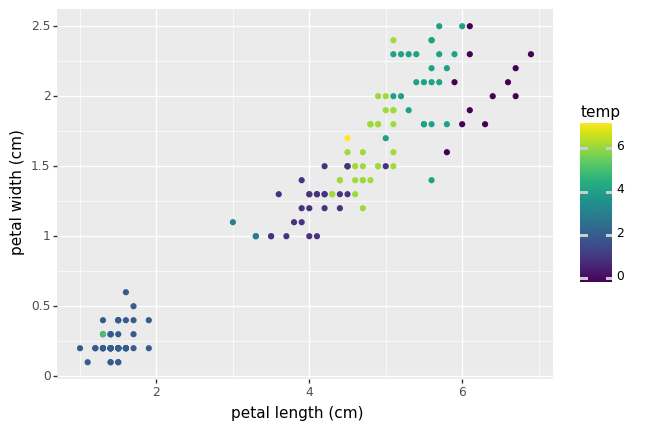

<ggplot: (8757736904285)>
single
0.3


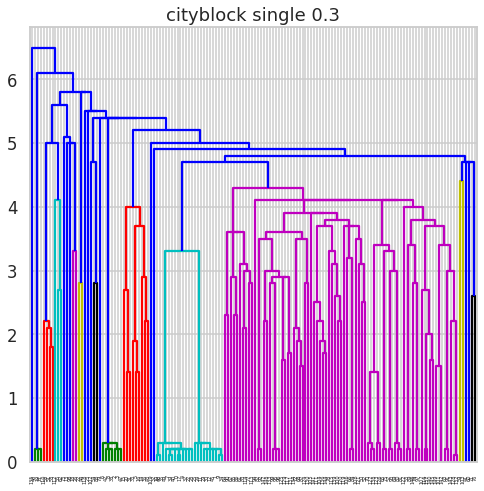

CLuster9


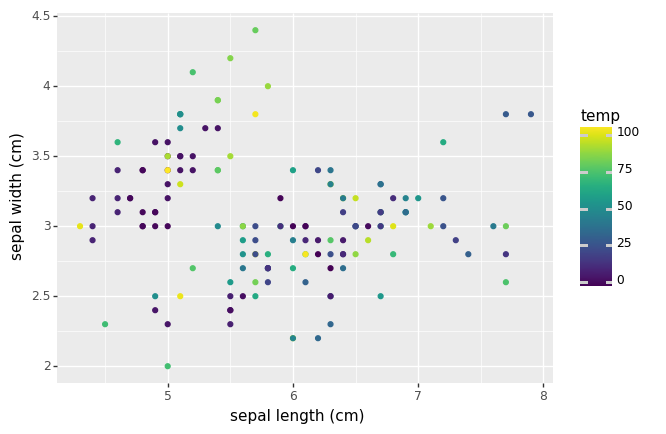

<ggplot: (8757736643709)>
CLuster9


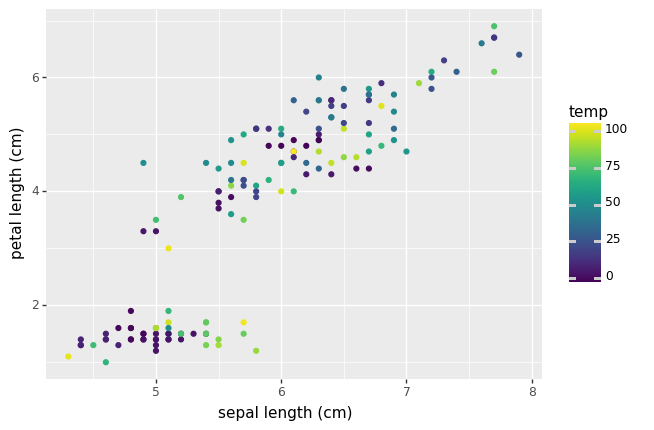

<ggplot: (8757736901801)>
CLuster9


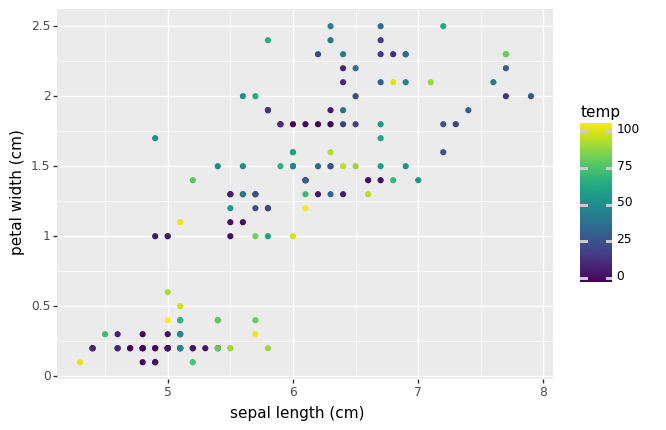

<ggplot: (8757736775617)>
CLuster9


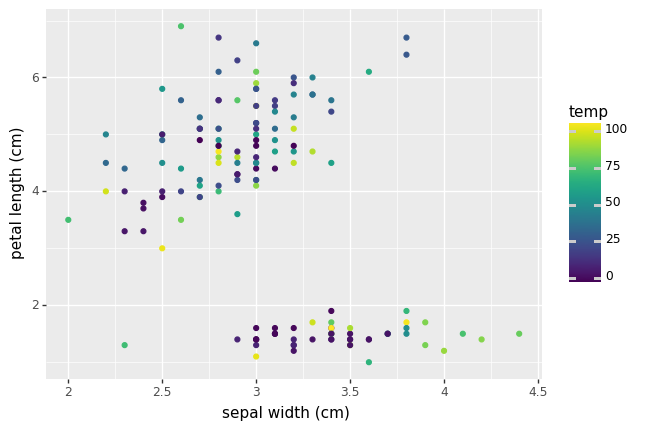

<ggplot: (8757739073365)>
CLuster9


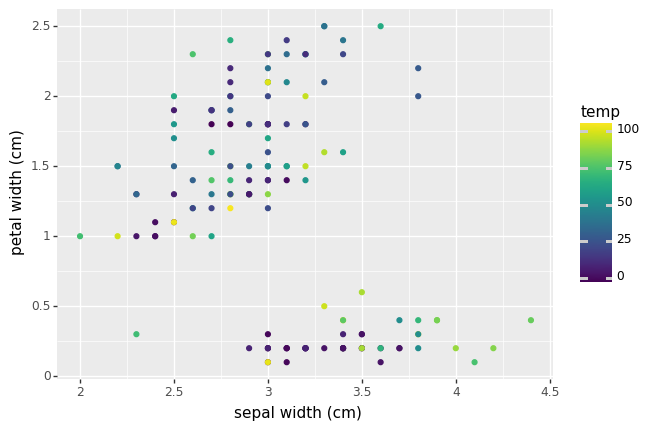

<ggplot: (8757737308541)>
CLuster9


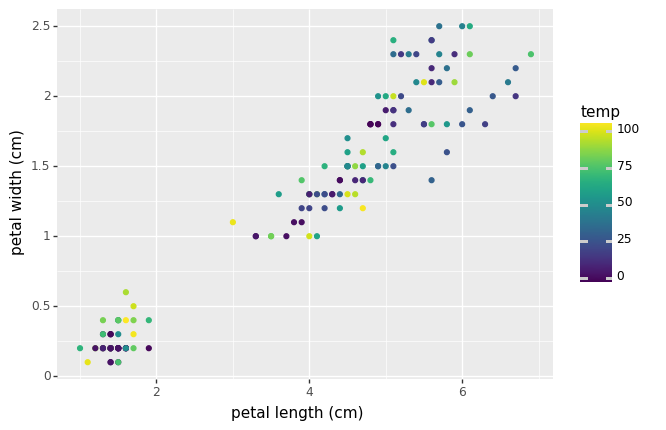

<ggplot: (8757736670049)>
0.5


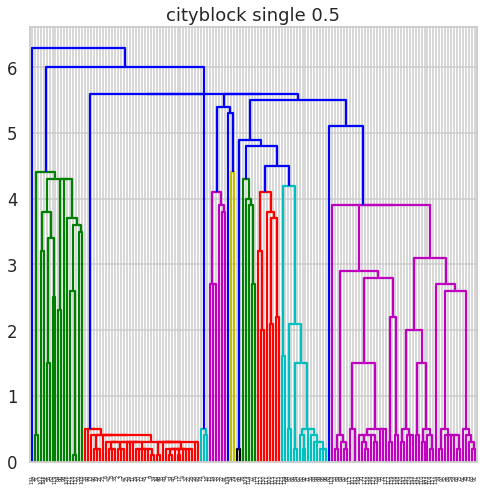

CLuster9


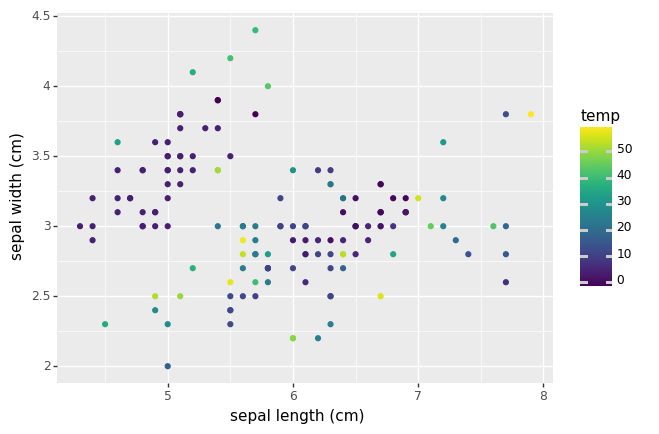

<ggplot: (8757736000229)>
CLuster9


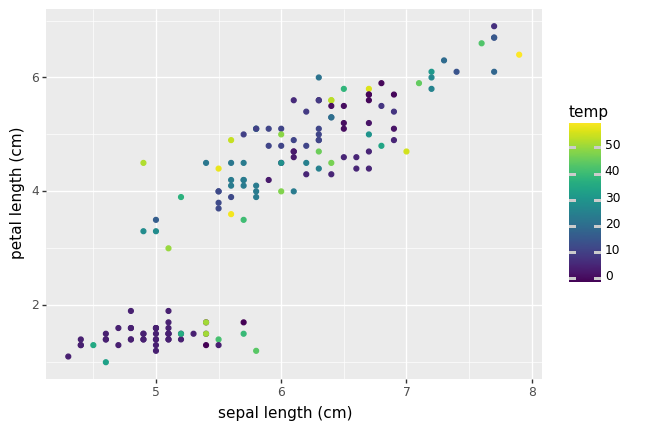

<ggplot: (8757736382609)>
CLuster9


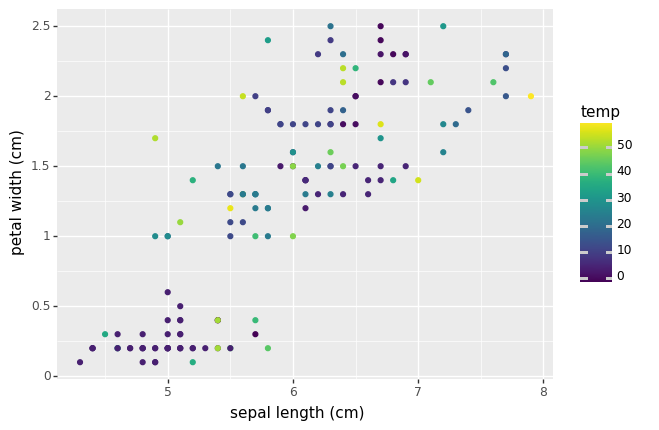

<ggplot: (8757736567381)>
CLuster9


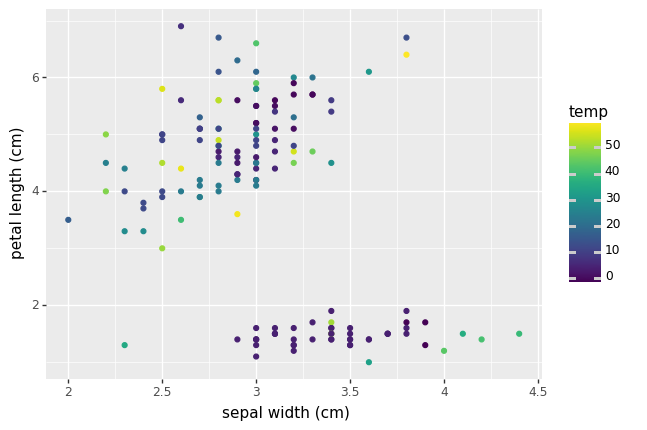

<ggplot: (8757736182765)>
CLuster9


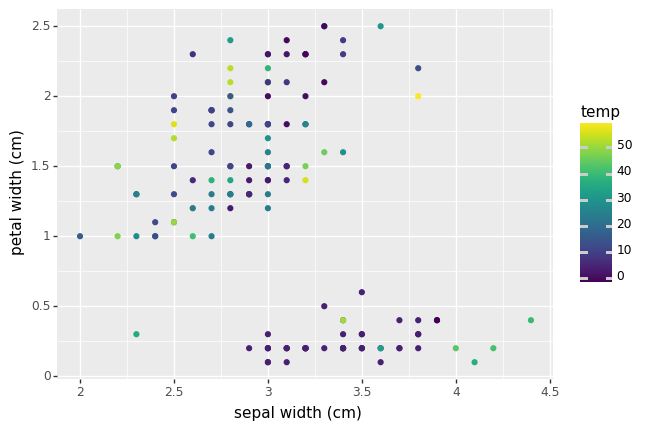

<ggplot: (8757736525329)>
CLuster9


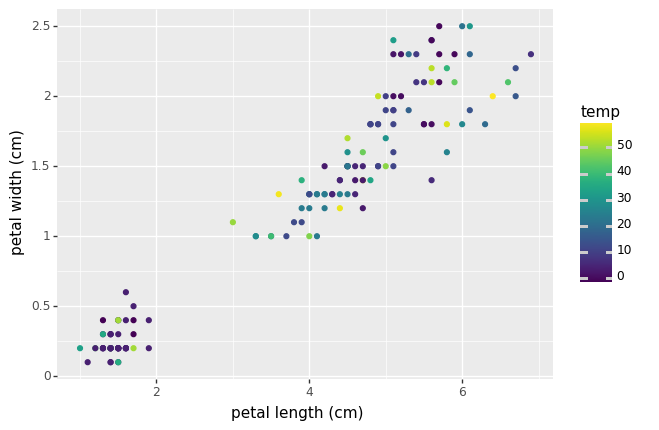

<ggplot: (8757736571613)>
0.7


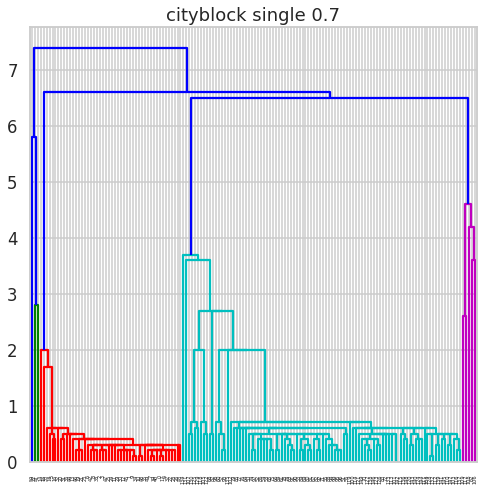

CLuster9


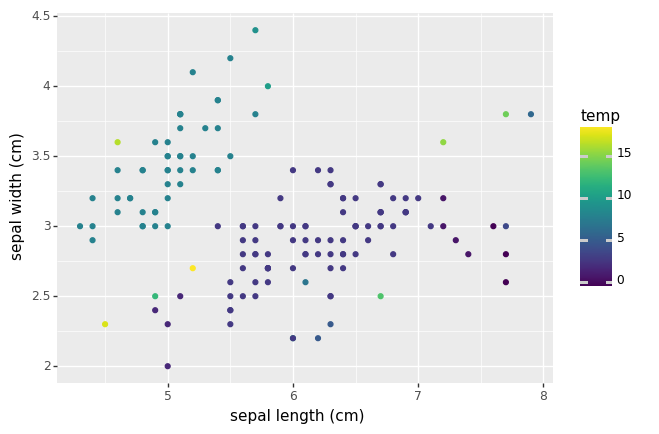

<ggplot: (8757736316821)>
CLuster9


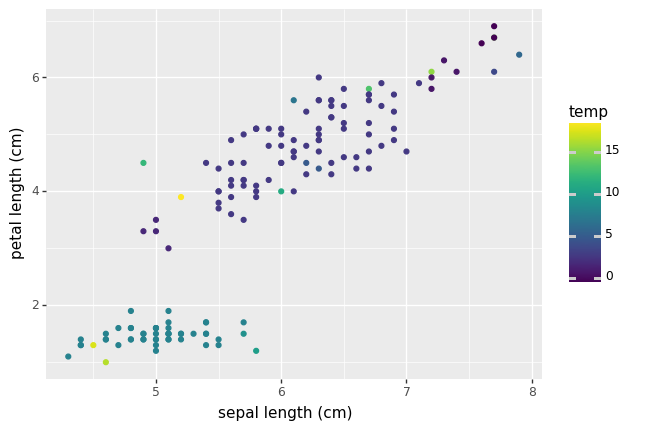

<ggplot: (8757736533885)>
CLuster9


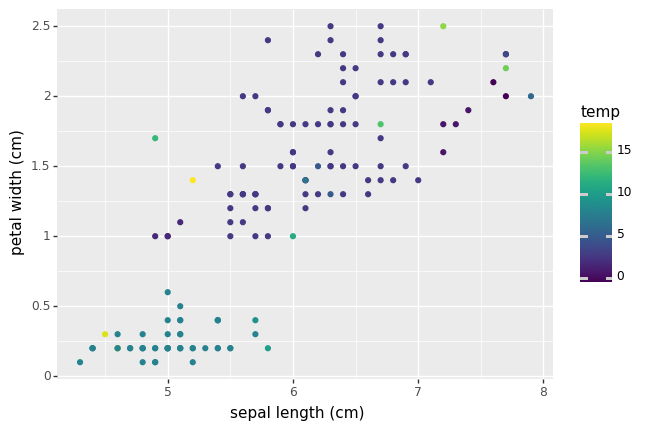

<ggplot: (8757737564801)>
CLuster9


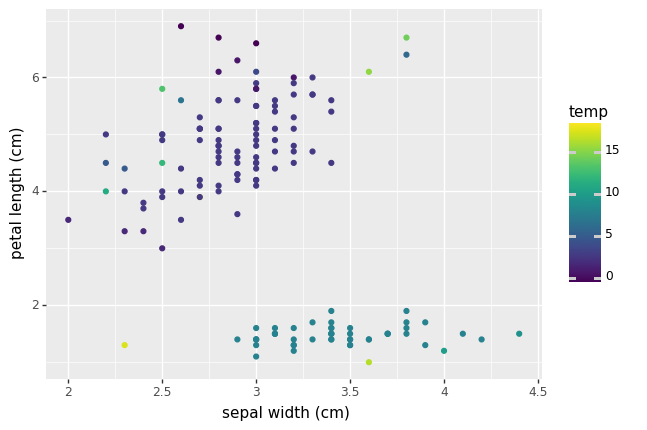

<ggplot: (8757736684261)>
CLuster9


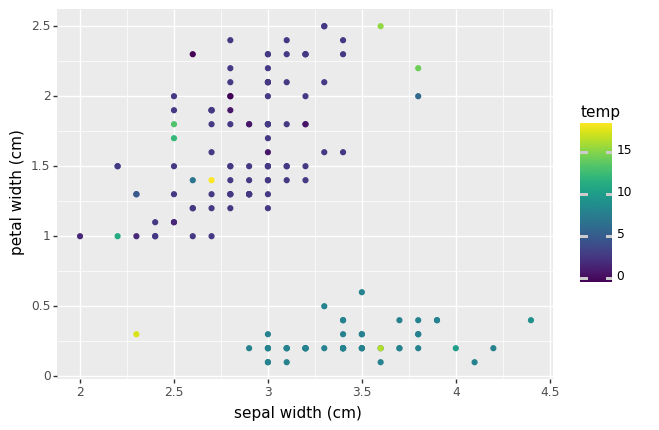

<ggplot: (8757737500349)>
CLuster9


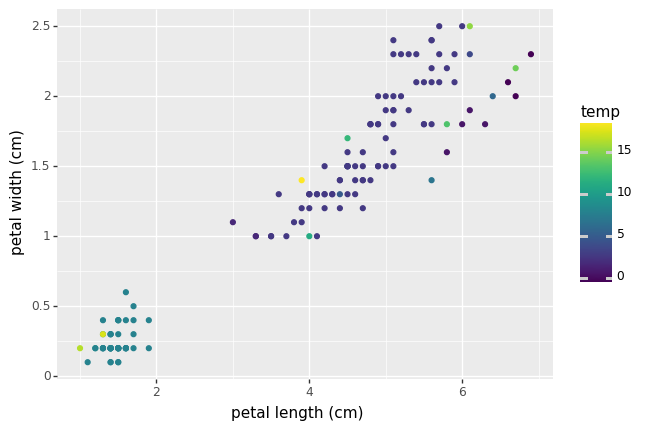

<ggplot: (8757735479729)>
0.9000000000000001


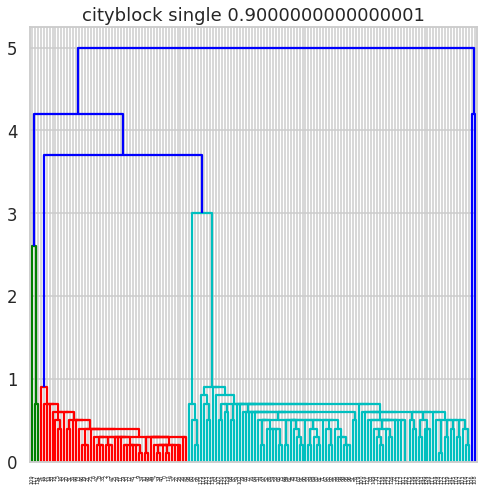

CLuster9


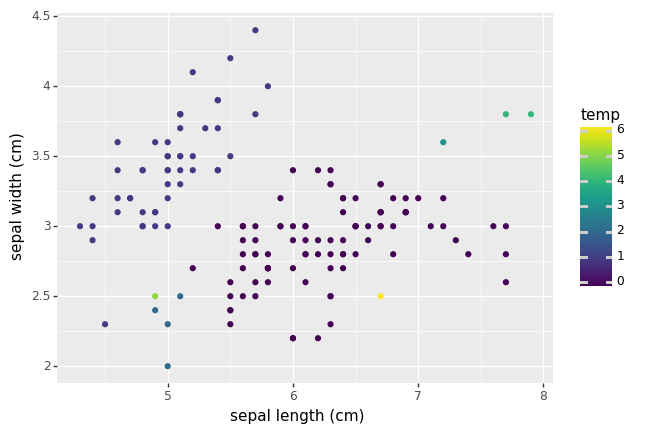

<ggplot: (8757736502797)>
CLuster9


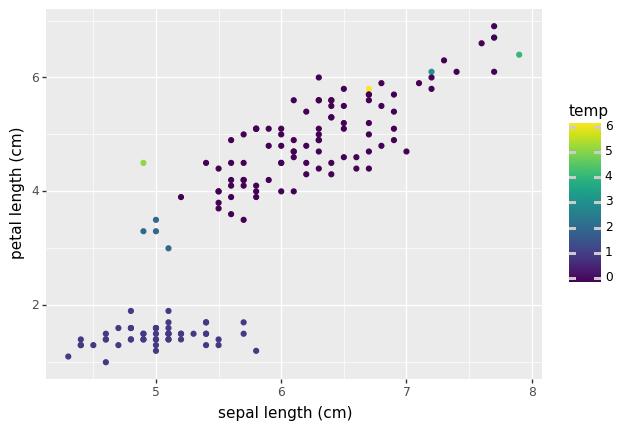

<ggplot: (8757736462085)>
CLuster9


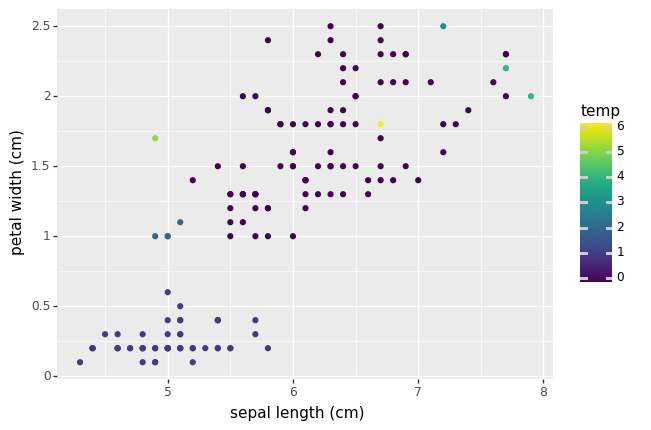

<ggplot: (8757736112117)>
CLuster9


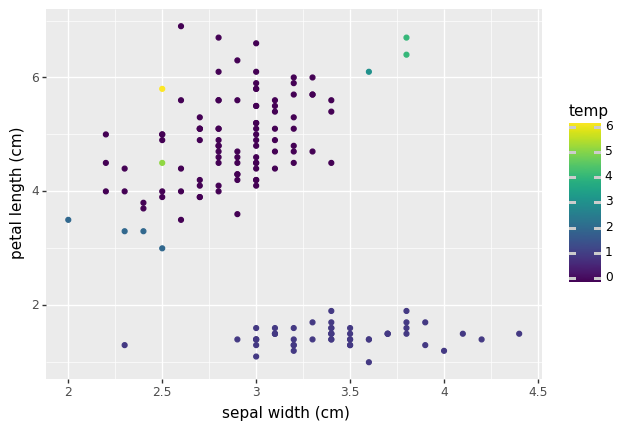

<ggplot: (8757736738105)>
CLuster9


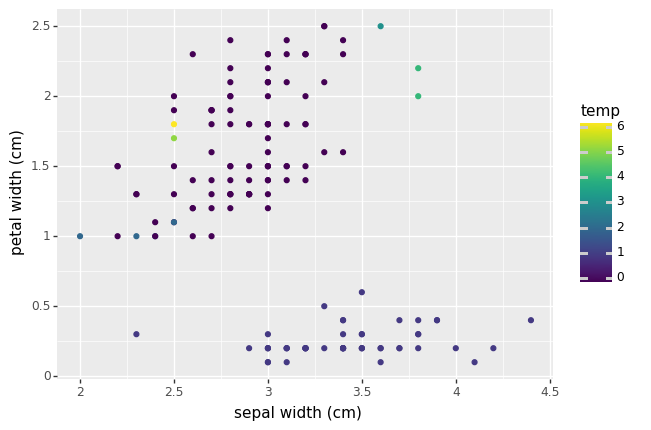

<ggplot: (8757736521829)>
CLuster9


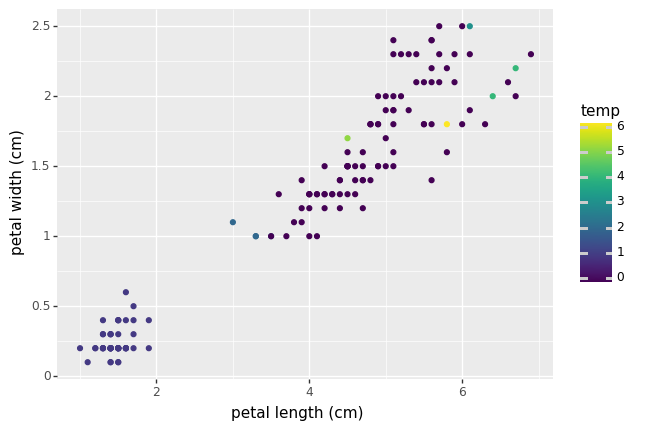

<ggplot: (8757737349657)>
1.1


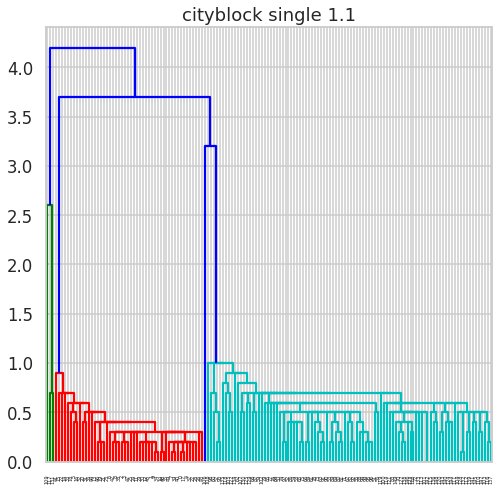

CLuster9


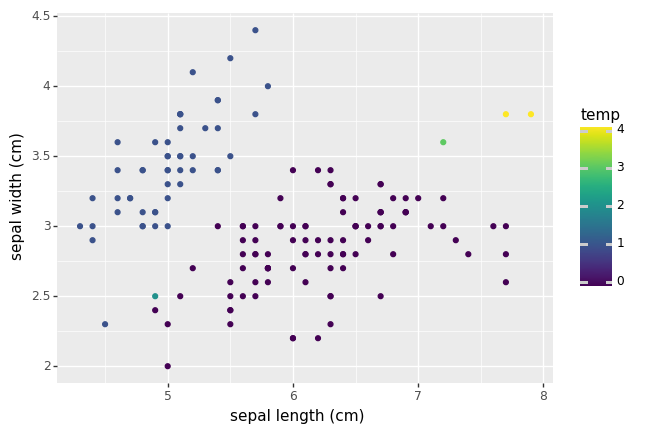

<ggplot: (8757737132557)>
CLuster9


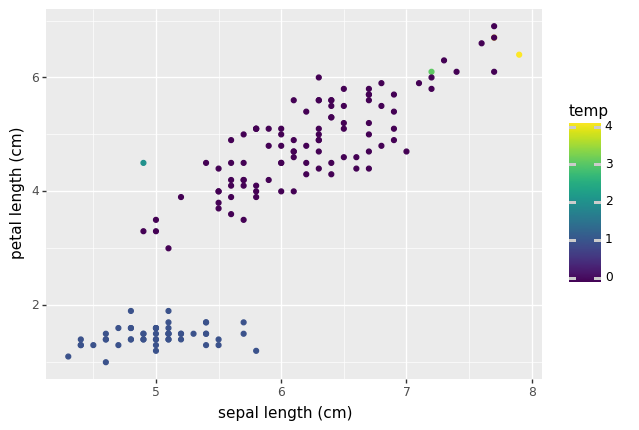

<ggplot: (8757737345933)>
CLuster9


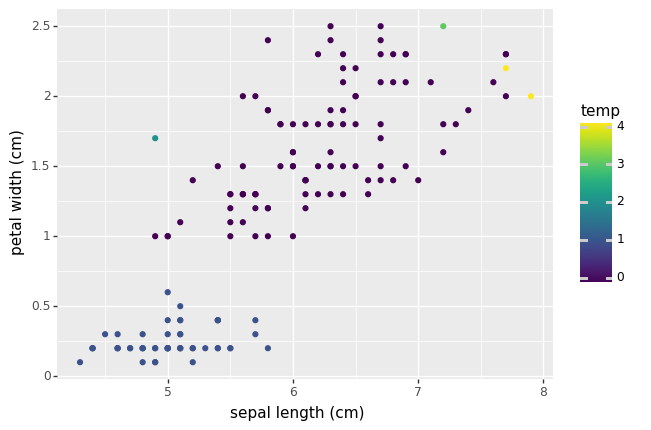

<ggplot: (8757736253985)>
CLuster9


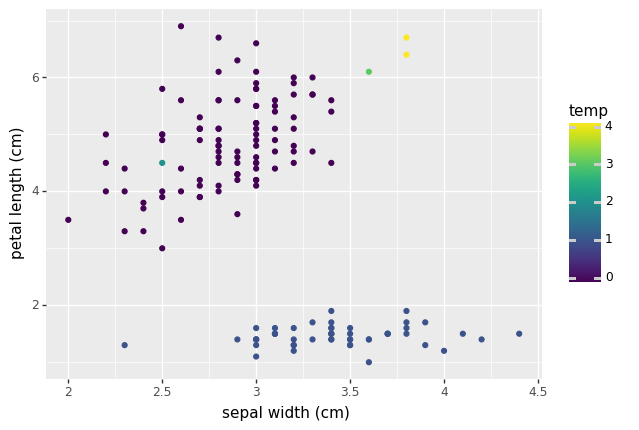

<ggplot: (8757739132457)>
CLuster9


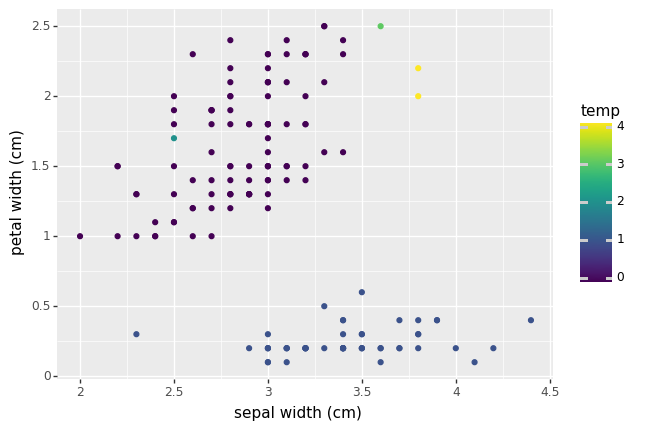

<ggplot: (8757736501713)>
CLuster9


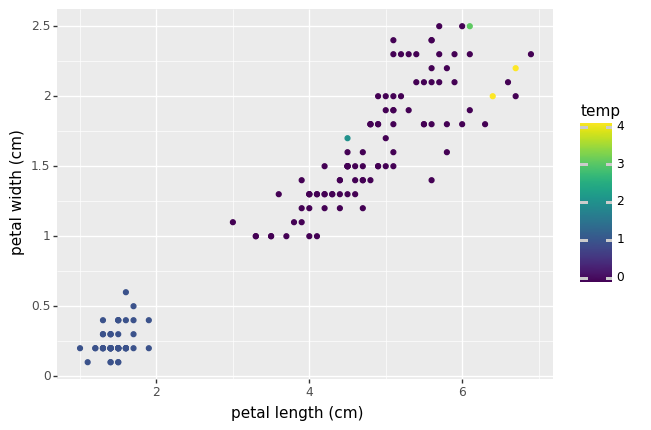

<ggplot: (8757736736113)>
1.3


KeyboardInterrupt: ignored

In [ ]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering


def display_hierarchal_cluster(X,km=[],num_clusters=0):
    alpha = 0.5  
    s = 20
    P=list(range(0,num_clusters+1))
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = 'r',alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[:,0],X[:,1],c =km.labels_,alpha = alpha,s=s)
        plt.show()

Affinity_list=['cityblock','euclidean','cosine']
Linkage_list=['average','single']
distance_range=np.arange(0.3, 2, 0.2)
best_silote_trails=['0.0','0.0','0.0','0.0']

a=0
while len(Affinity_list) -1 >= a :
  print(Affinity_list[a])
  l=0

  while len(Linkage_list) -1 >= l :
    print(Linkage_list[l])
    d=0

    while len(distance_range) -1 >= d :
      print(distance_range[d])
      if 'temp' in df.columns:
        df.drop('temp', axis=1, inplace=True)
      HIC = AgglomerativeClustering(distance_threshold=distance_range[d], n_clusters=None,affinity=Affinity_list[a],linkage=Linkage_list[l])
      HIC.fit(df)
      df['temp']=HIC.labels_
      temp=len(np.unique(HIC.labels_))
      if(temp!=1):
        single_iteration=silhouette_score(df, HIC.labels_)
        if(float(best_silote_trails[0])<single_iteration):
          best_silote_trails=[str(single_iteration),Affinity_list[a],Linkage_list[l],str(distance_range[d].round(2))]
          print(best_silote_trails)
        linkage_type = linkage(df, Linkage_list[l],metric=Affinity_list[a])
        plt.title(Affinity_list[a] +" "+Linkage_list[l]+" "+str(distance_range[d]))
        displaycl = dendrogram(linkage_type,truncate_mode='level')
        plt.show()
        df_col=len(range(len(df.columns)-1))
        c=len(df.columns)-1
        j=0
        while df_col >j:
          for u in range(c-1):
            u+=1
            u+=j
            print("CLuster" + str(i))
            print(ggplot(df,aes(x=df.columns[j],y=df.columns[u],color='temp')) + geom_point() )
          c-=1
          j+=1
      d+=1
    l+=1
  a+=1
 
print("The max Silhouette Score is" + best_silote_trails[0] + "with affinity equal to"  + best_silote_trails[1] +  "and linkage equal to" + best_silote_trails[2] + "with distance_threshold"+ best_silote_trails[3] )


* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

In [ ]:
types_of_covar=['tied','diag','full']
i=0
while len(types_of_covar) > i :
  EM=GaussianMixture(n_components =3,covariance_type=types_of_covar[i])
  EM.fit(df)
  print("Type",str(i))
  print(EM.predict_proba(df))
  i+=1


## Normalized Iris Dataset





In [ ]:
if 'temp' in df.columns:
 df.drop('temp', axis=1, inplace=True)
scaler = StandardScaler()
scaler.fit(df)
scaled_features = scaler.transform(df)
mydf_feat = pd.DataFrame(scaled_features,columns=df.columns[::])
mydf_feat.head(5)


,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,-0.900681,1.019004,-1.340227,-1.315444
1,-1.143017,-0.131979,-1.340227,-1.315444
2,-1.385353,0.328414,-1.397064,-1.315444
3,-1.506521,0.098217,-1.283389,-1.315444
4,-1.021849,1.249201,-1.340227,-1.315444


##KMEANS

CLuster2


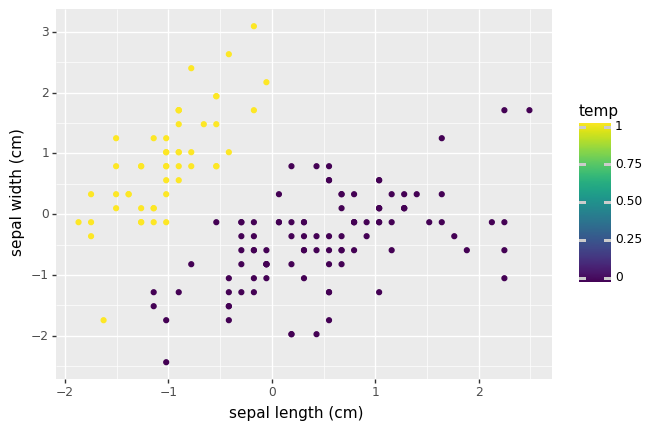

<ggplot: (8757735788353)>
CLuster2


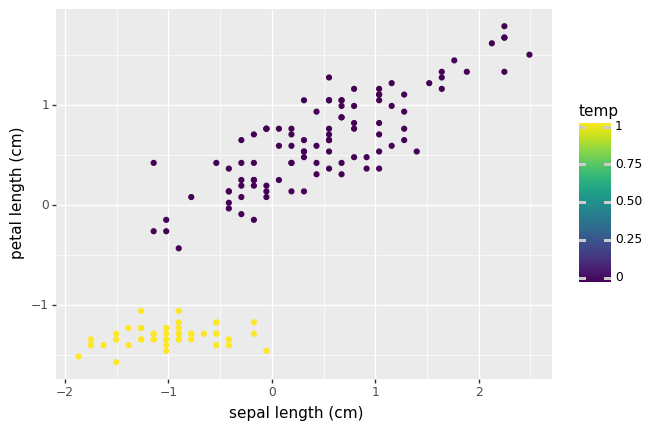

<ggplot: (8757737314497)>
CLuster2


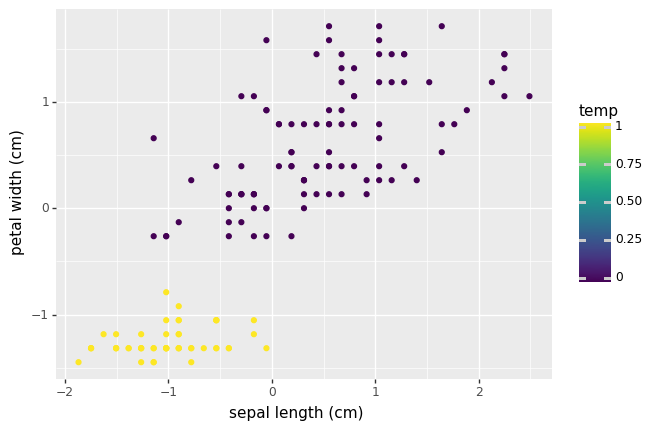

<ggplot: (8757736178093)>
CLuster2


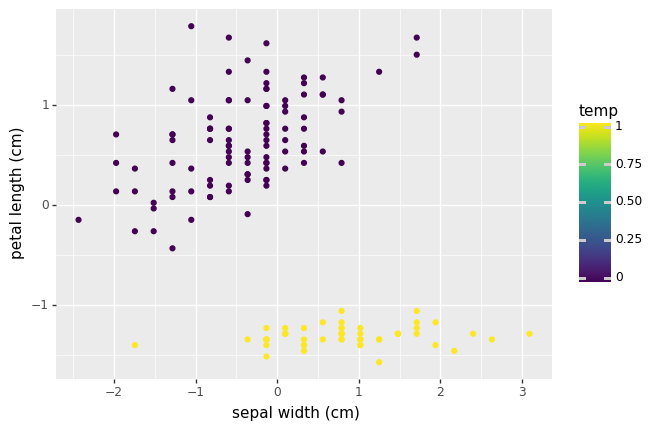

<ggplot: (8757737527205)>
CLuster2


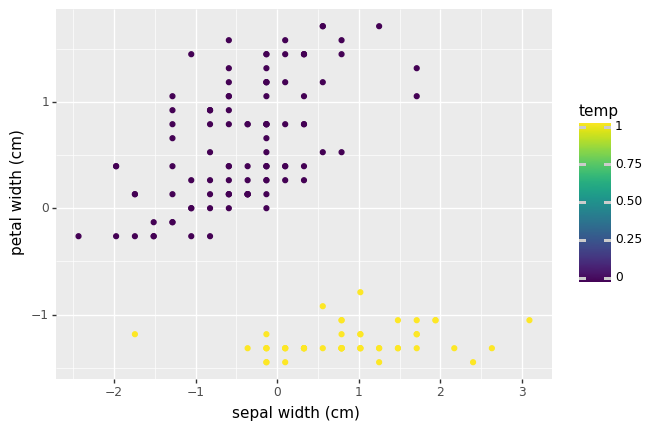

<ggplot: (8757736937481)>
CLuster2


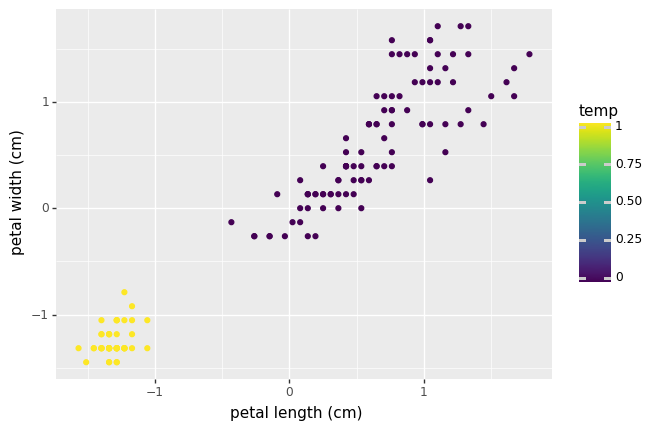

<ggplot: (8757736525489)>
CLuster3


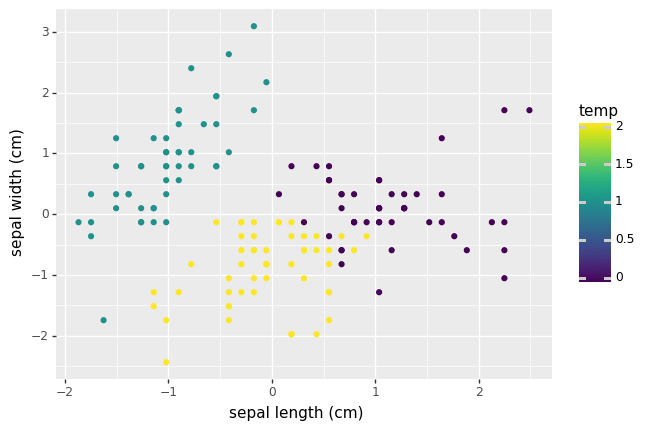

<ggplot: (8757736927581)>
CLuster3


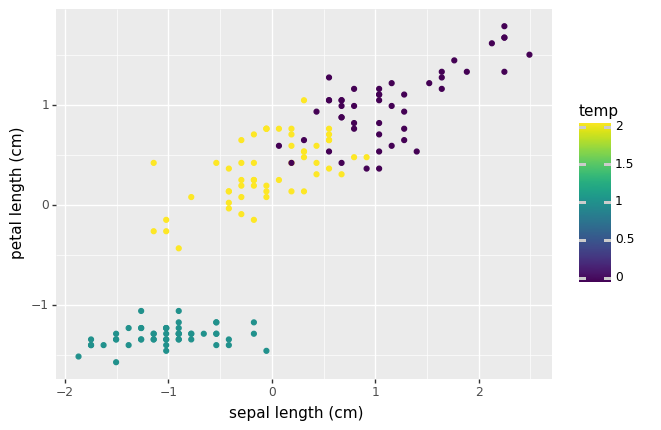

<ggplot: (8757736900605)>
CLuster3


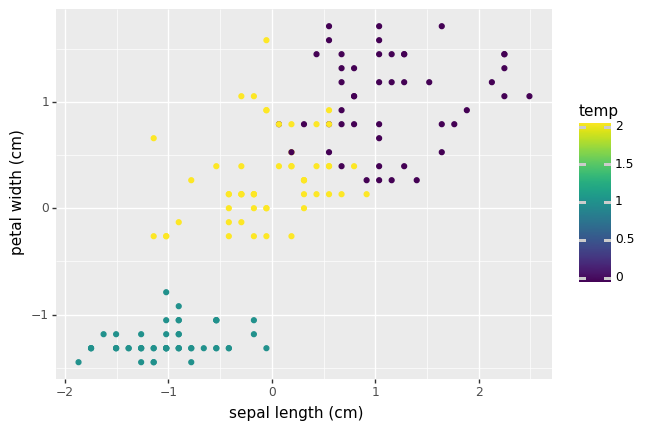

<ggplot: (8757735421121)>
CLuster3


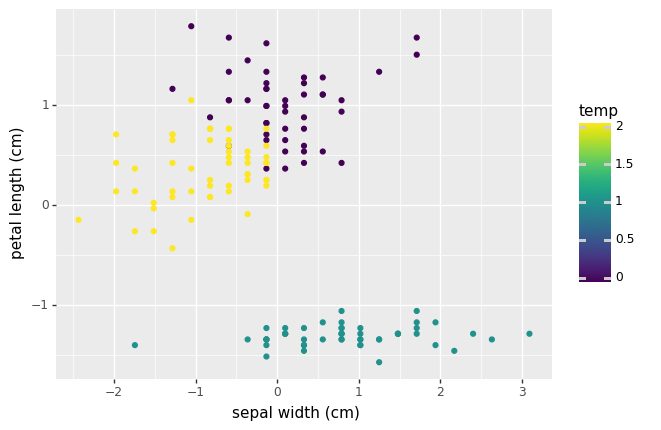

<ggplot: (8757736981713)>
CLuster3


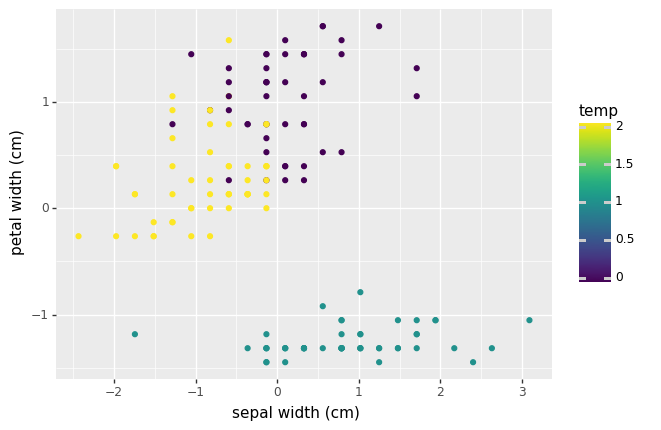

<ggplot: (8757736845029)>
CLuster3


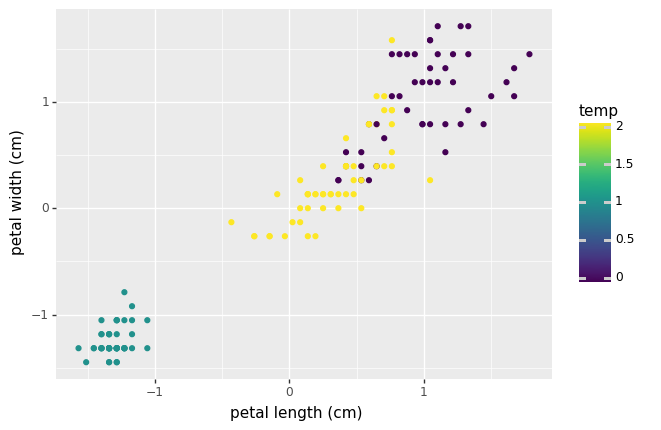

<ggplot: (8757736573545)>
CLuster4


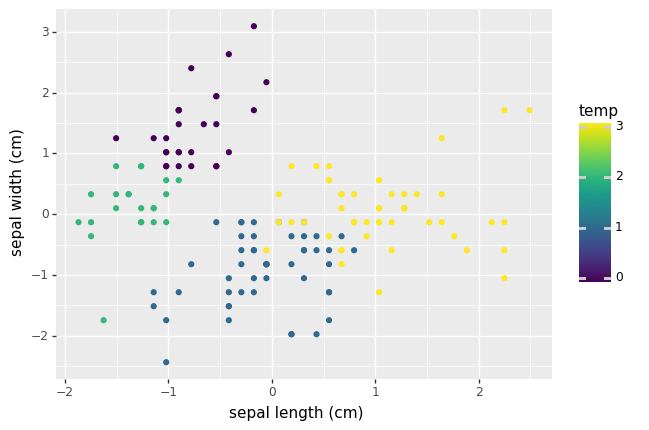

<ggplot: (8757736900393)>
CLuster4


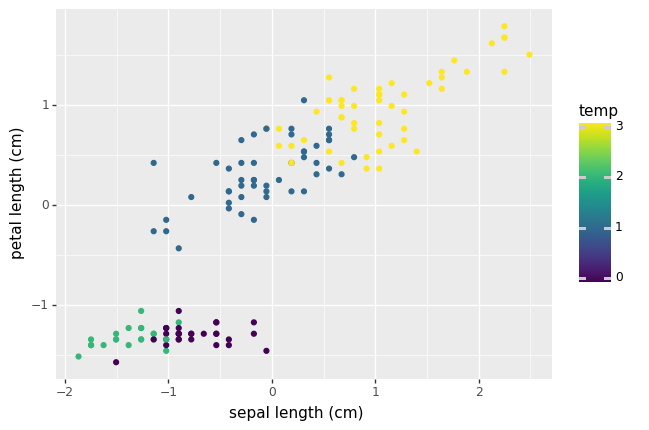

<ggplot: (8757737251229)>
CLuster4


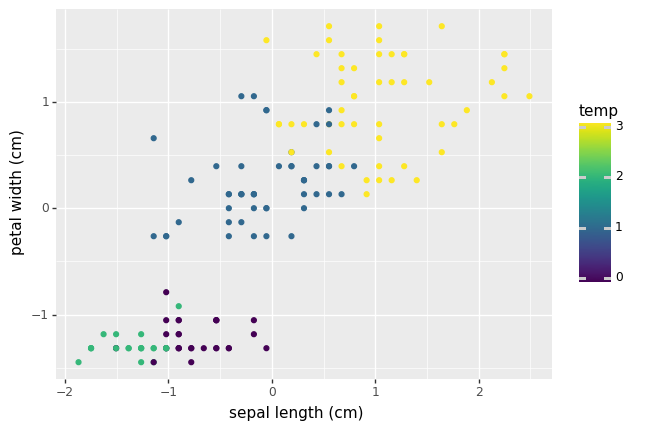

<ggplot: (8757736601349)>
CLuster4


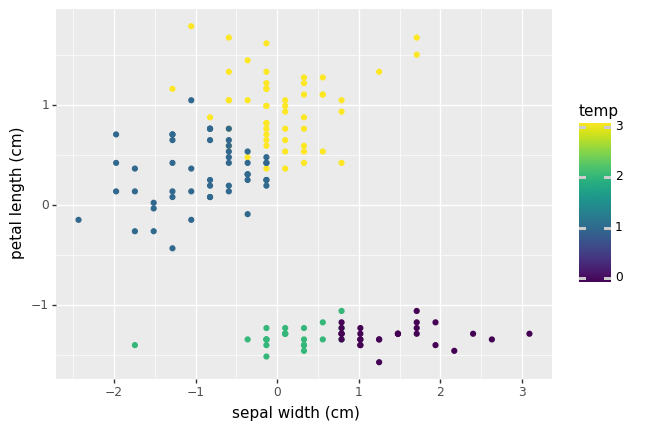

<ggplot: (8757735506425)>
CLuster4


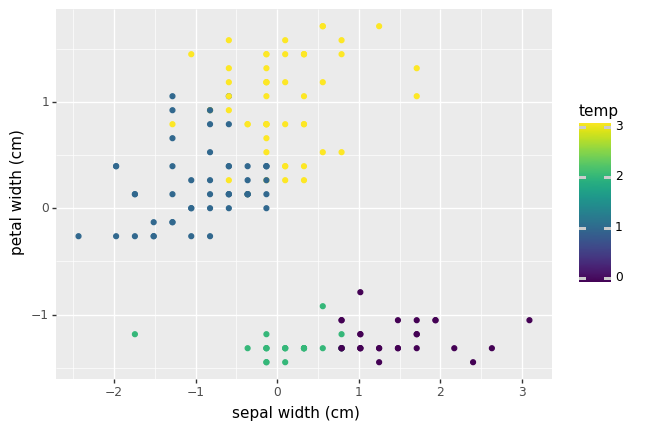

<ggplot: (8757736971145)>
CLuster4


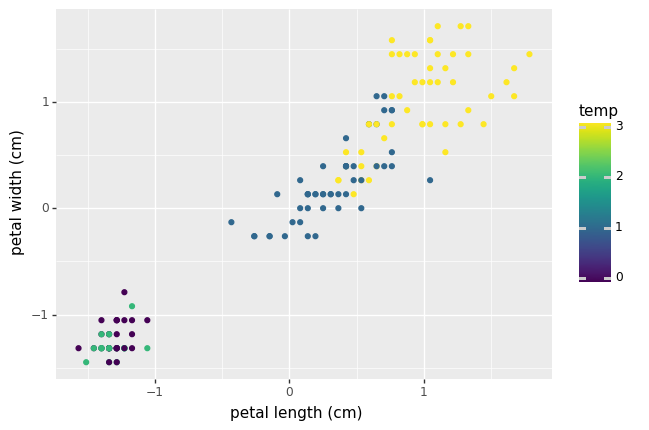

<ggplot: (8757736904265)>
CLuster5


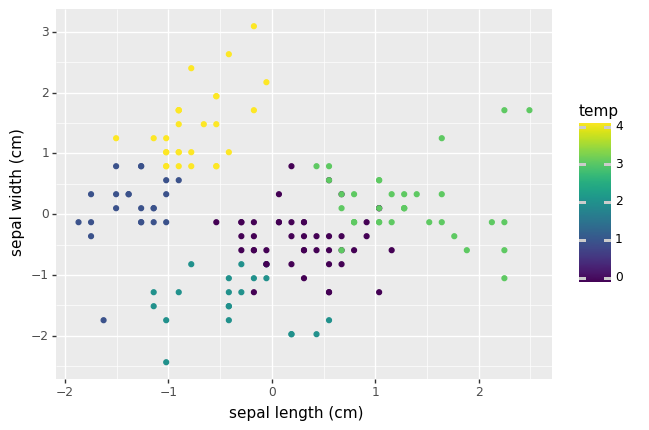

<ggplot: (8757737598233)>
CLuster5


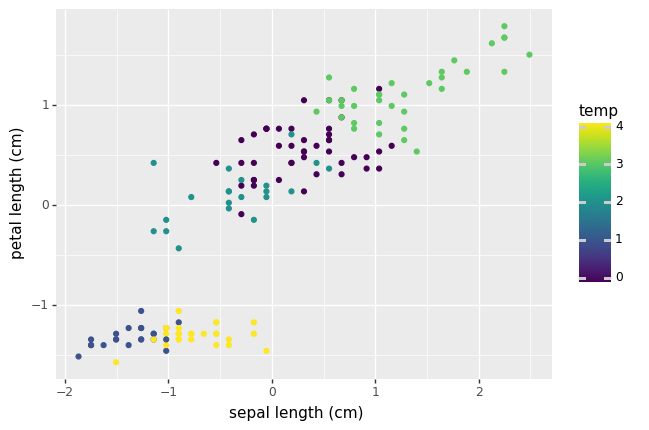

<ggplot: (8757736374493)>
CLuster5


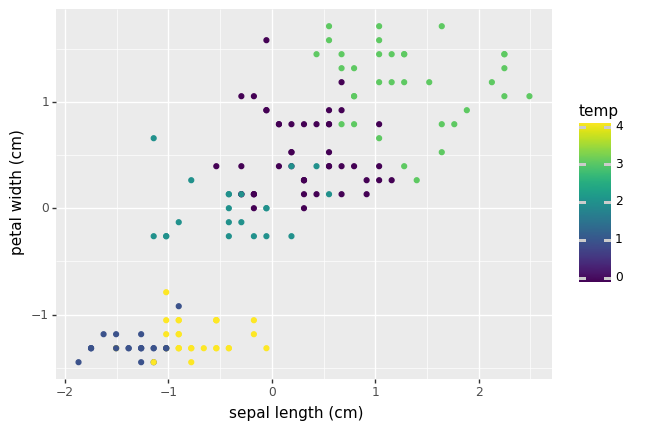

<ggplot: (8757736625445)>
CLuster5


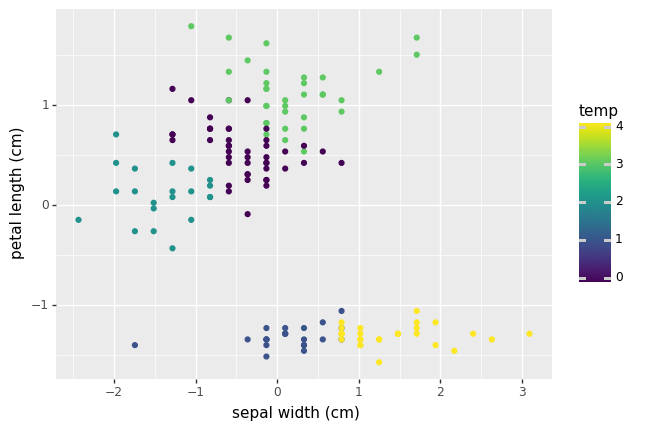

<ggplot: (8757736053321)>
CLuster5


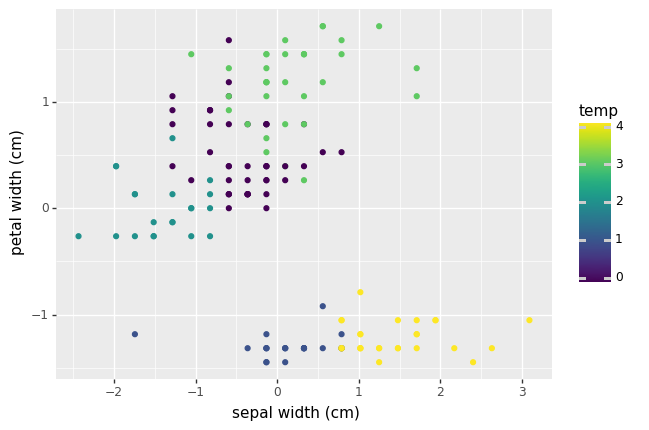

<ggplot: (8757737220113)>
CLuster5


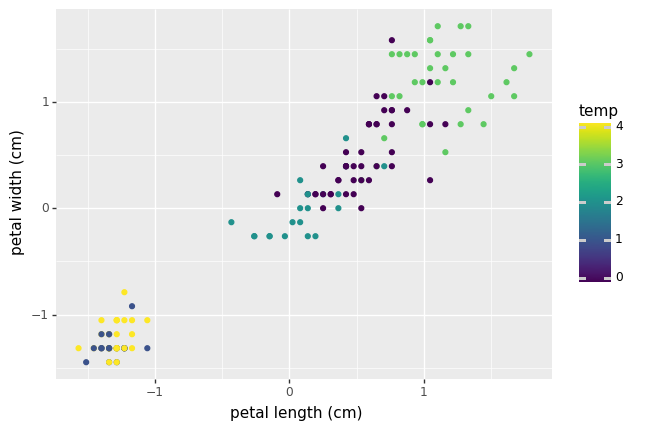

<ggplot: (8757736986265)>
CLuster6


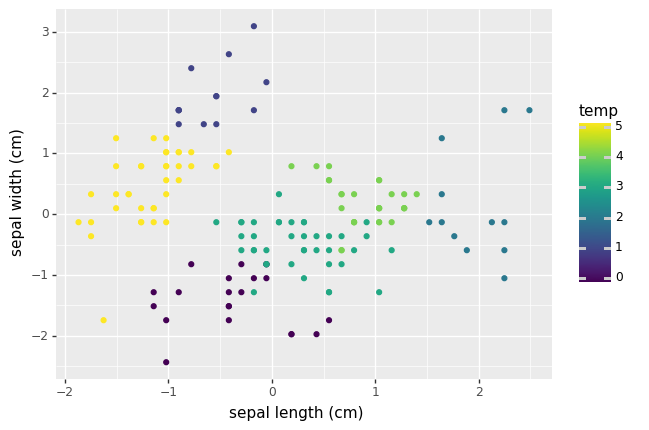

<ggplot: (8757737118525)>
CLuster6


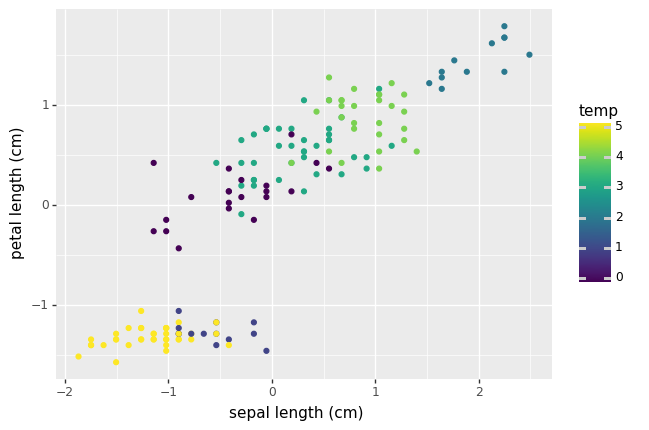

<ggplot: (8757739683897)>
CLuster6


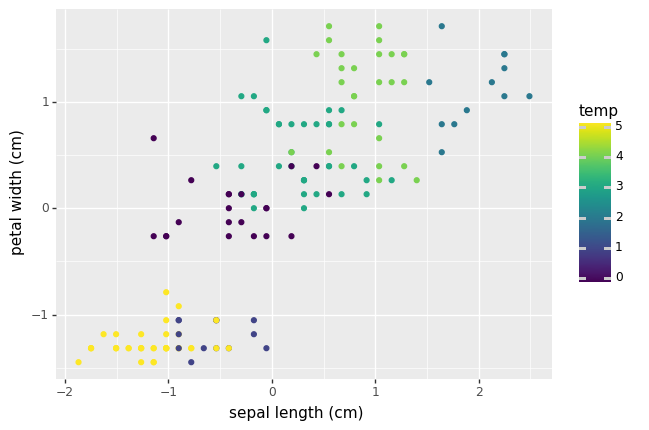

<ggplot: (8757737320029)>
CLuster6


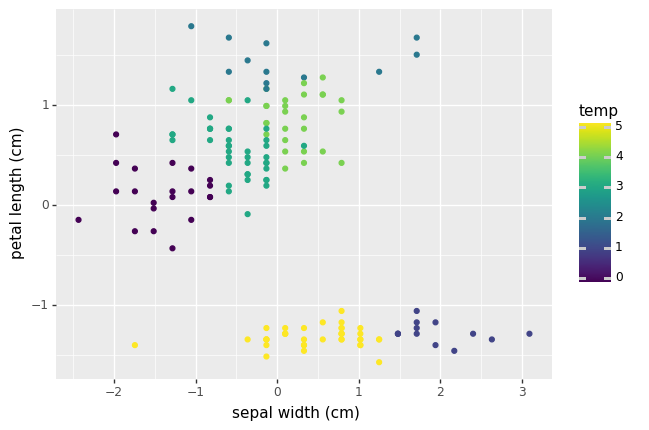

<ggplot: (8757737320097)>
CLuster6


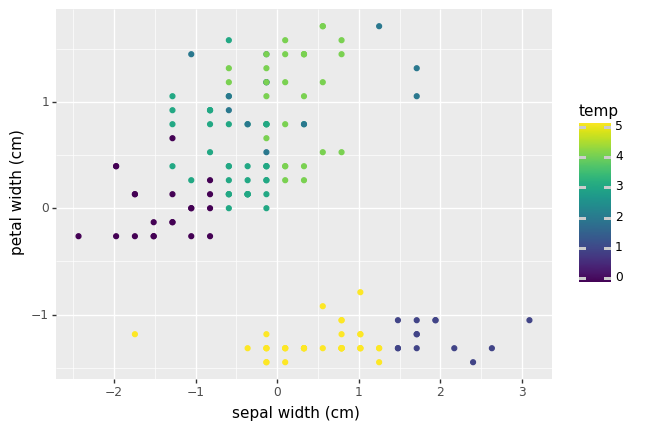

<ggplot: (8757737353665)>
CLuster6


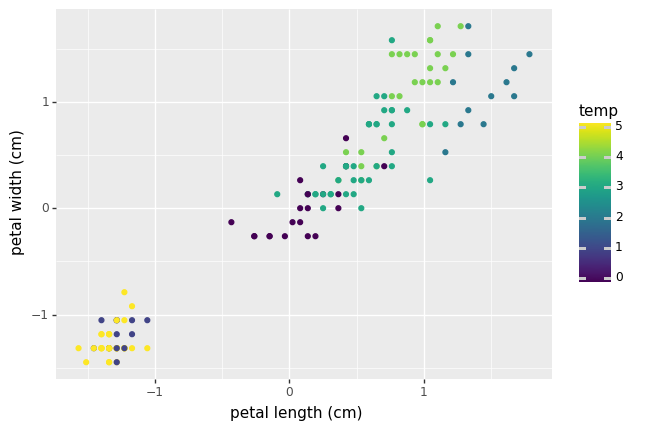

<ggplot: (8757739784101)>
CLuster7


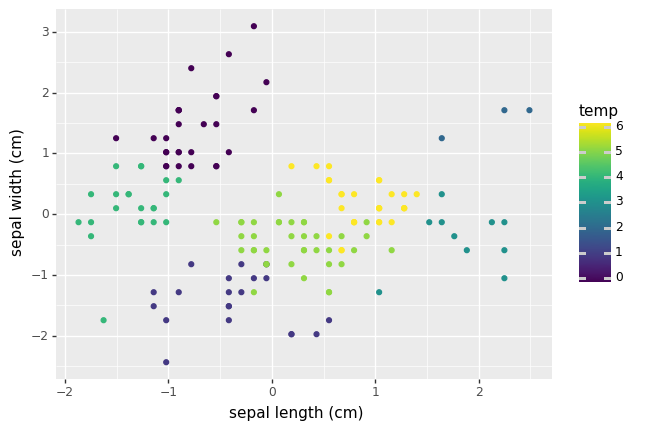

<ggplot: (8757736048353)>
CLuster7


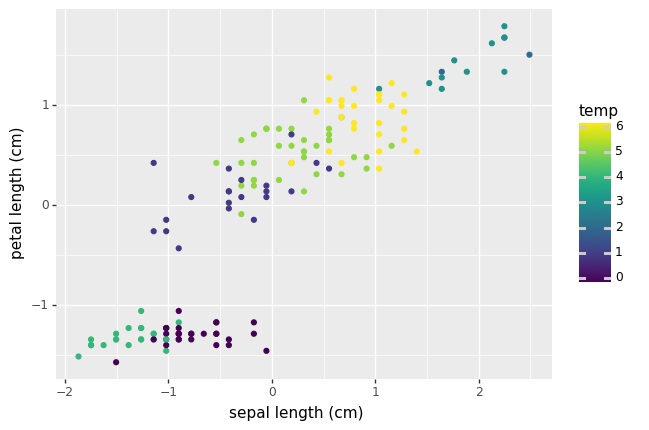

<ggplot: (8757736386921)>
CLuster7


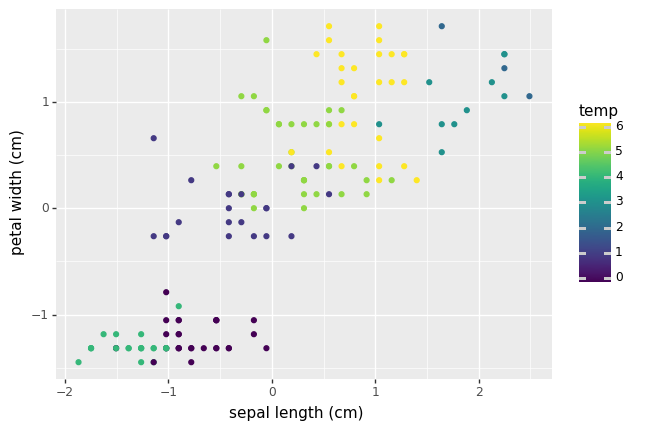

<ggplot: (8757739297941)>
CLuster7


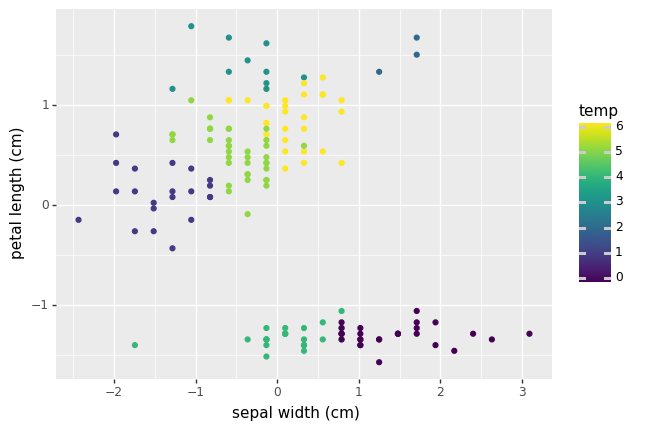

<ggplot: (8757737365289)>
CLuster7


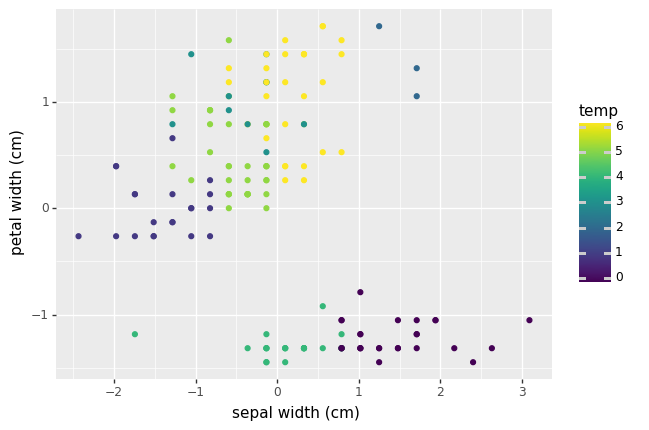

<ggplot: (8757736406317)>
CLuster7


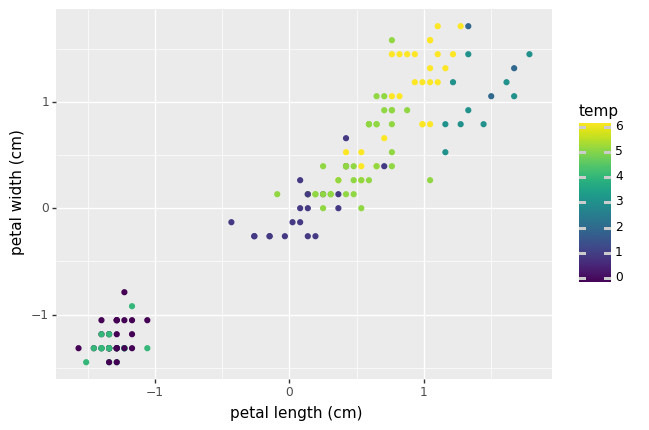

<ggplot: (8757737455973)>
CLuster8


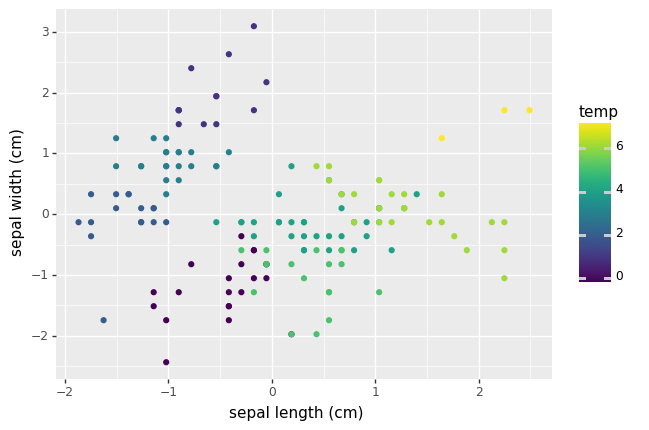

<ggplot: (8757736431945)>
CLuster8


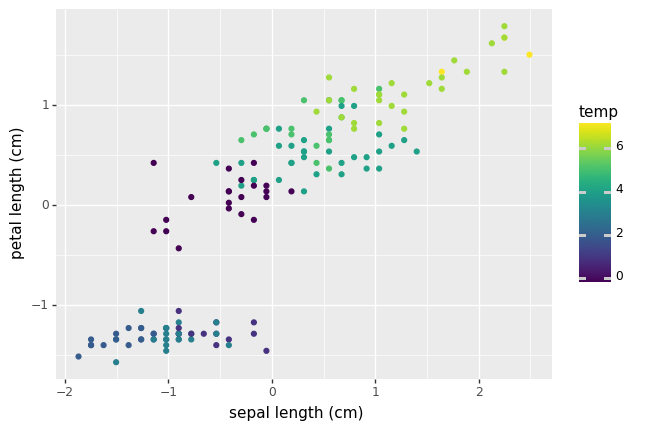

<ggplot: (8757737455929)>
CLuster8


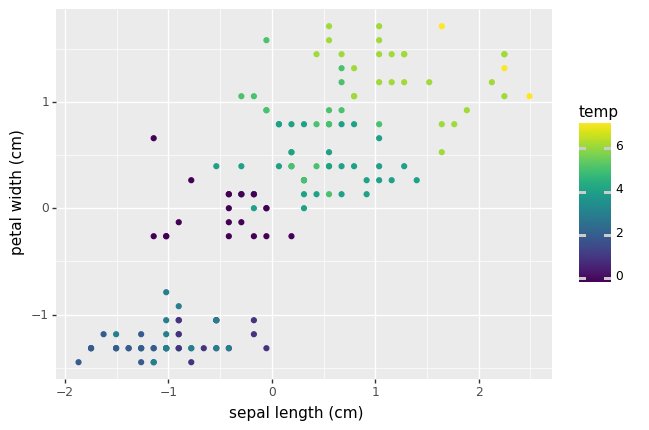

<ggplot: (8757737106329)>
CLuster8


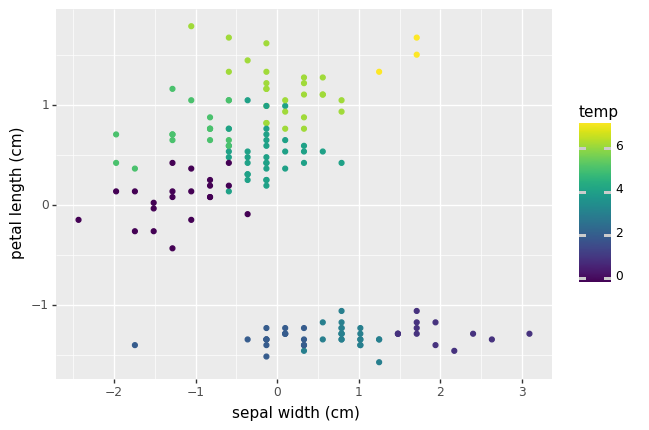

<ggplot: (8757736404009)>
CLuster8


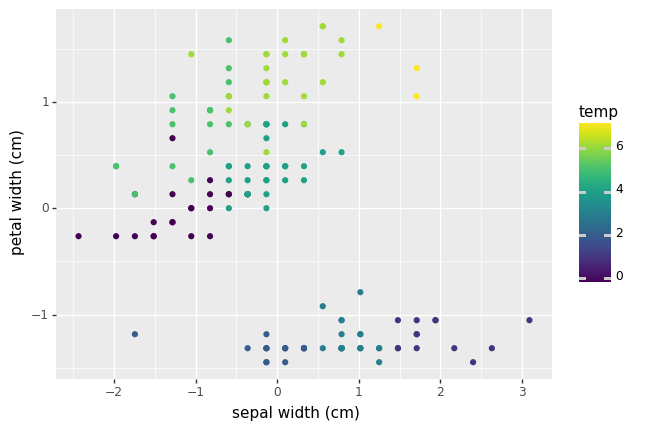

<ggplot: (8757735531221)>
CLuster8


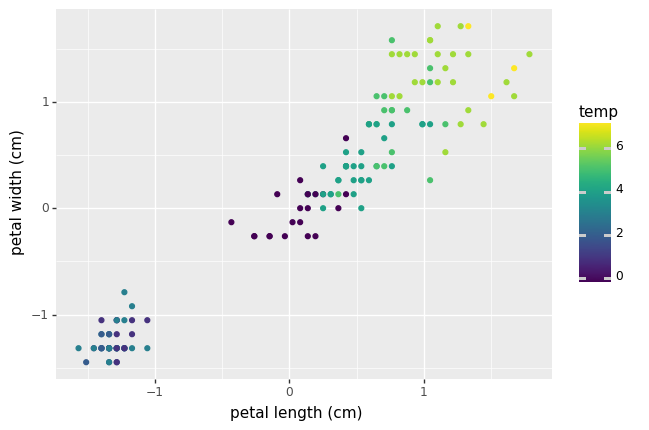

<ggplot: (8757735781817)>
CLuster9


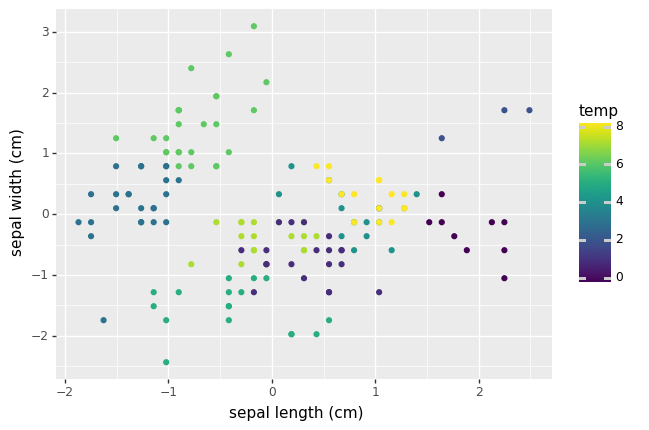

<ggplot: (8757736937633)>
CLuster9


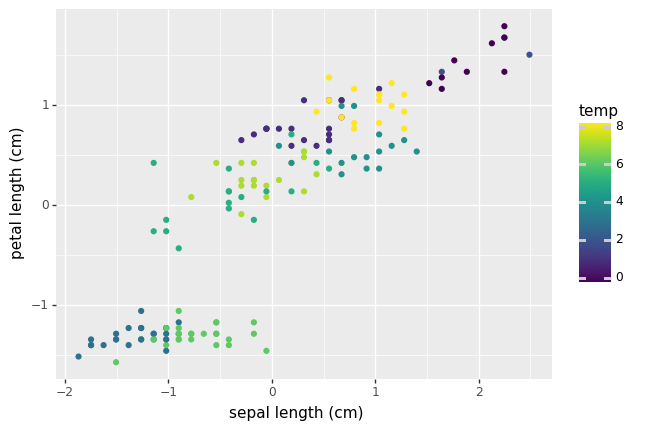

<ggplot: (8757736927325)>
CLuster9


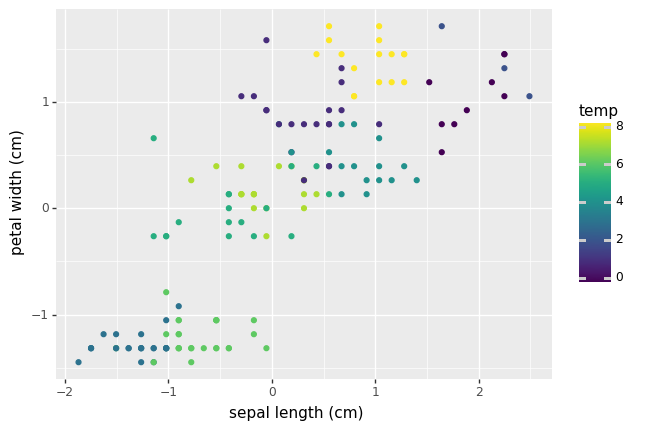

<ggplot: (8757739297925)>
CLuster9


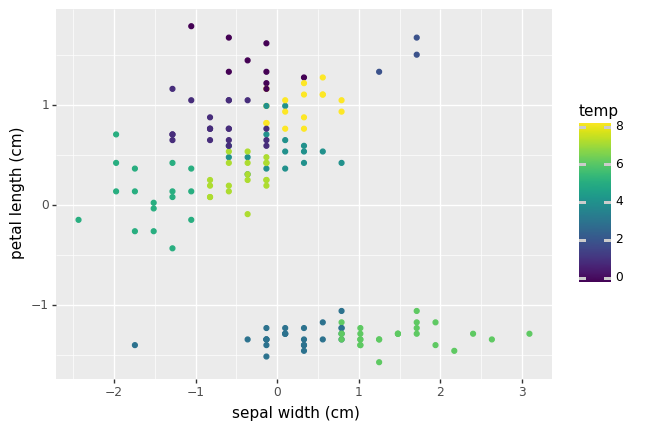

<ggplot: (8757737569361)>
CLuster9


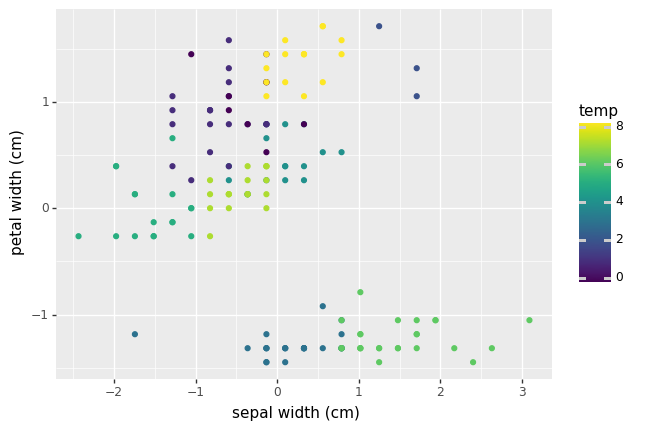

<ggplot: (8757736986405)>
CLuster9


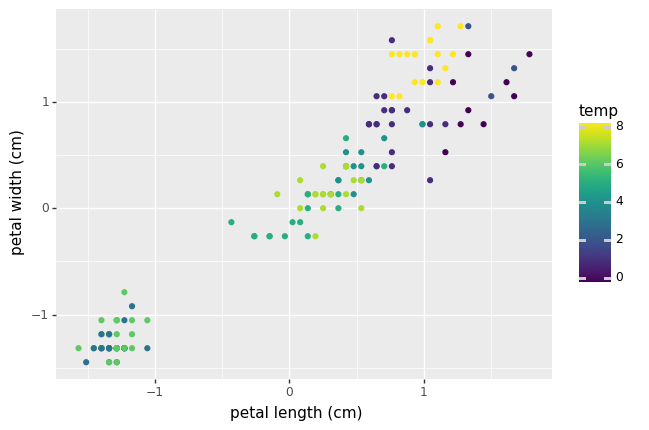

<ggplot: (8757739124309)>
CLuster10


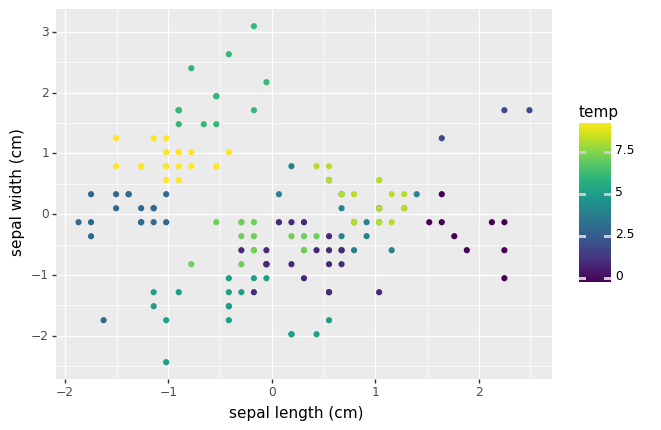

<ggplot: (8757737378121)>
CLuster10


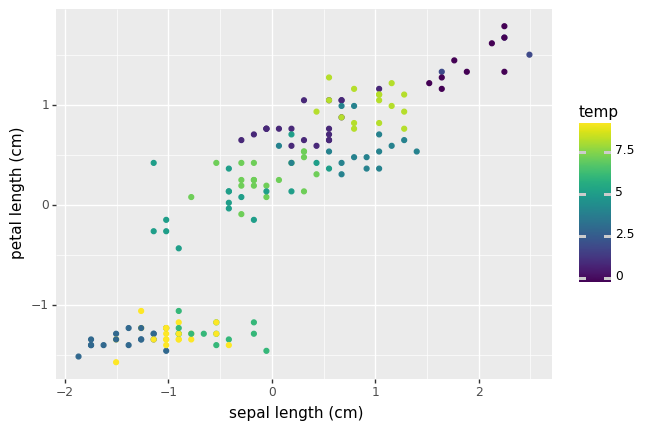

<ggplot: (8757736706465)>
CLuster10


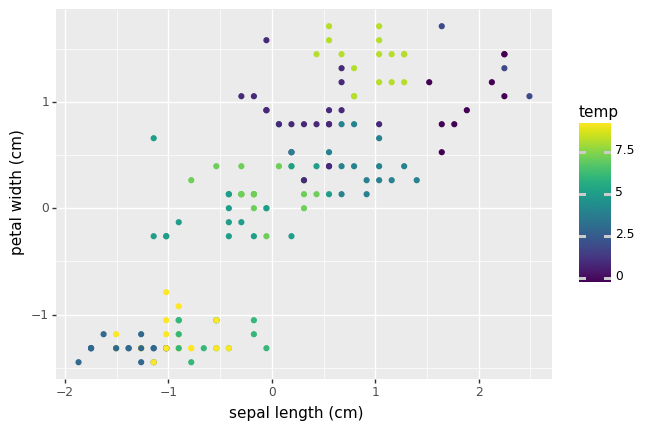

<ggplot: (8757739581489)>
CLuster10


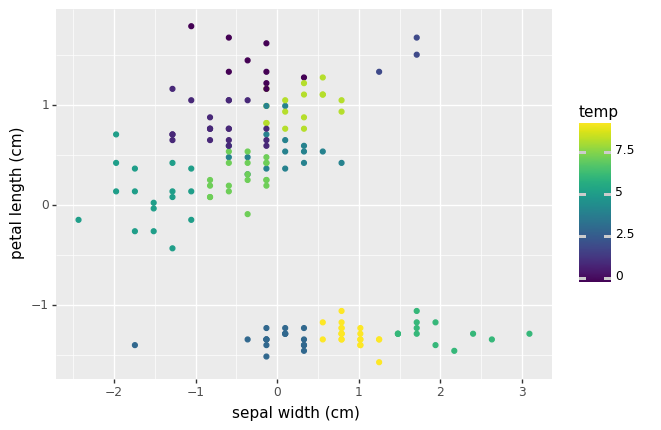

<ggplot: (8757737083517)>
CLuster10


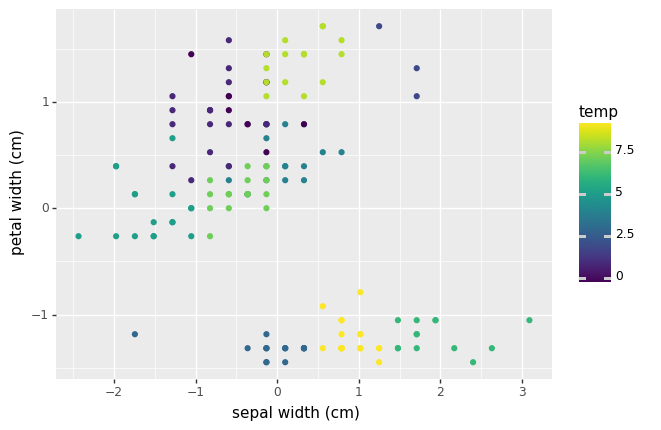

<ggplot: (8757736379017)>
CLuster10


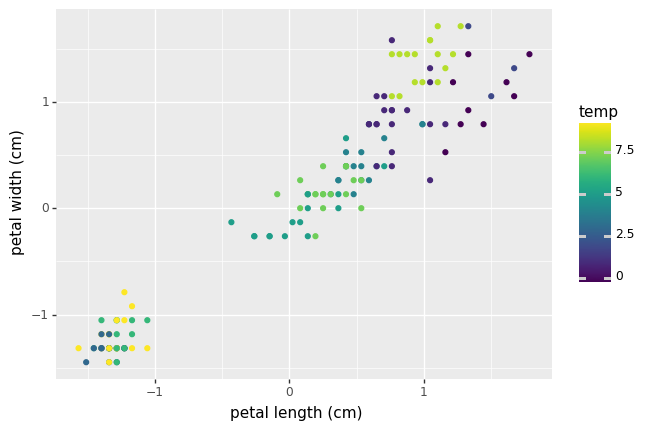

<ggplot: (8757738973549)>


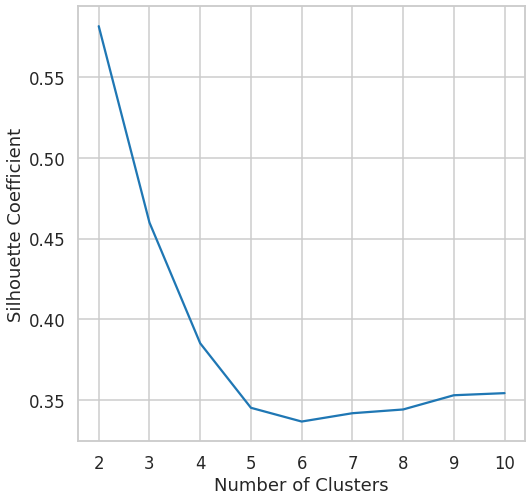

The best silhouette_coefficient is with 2 number of clusters
  


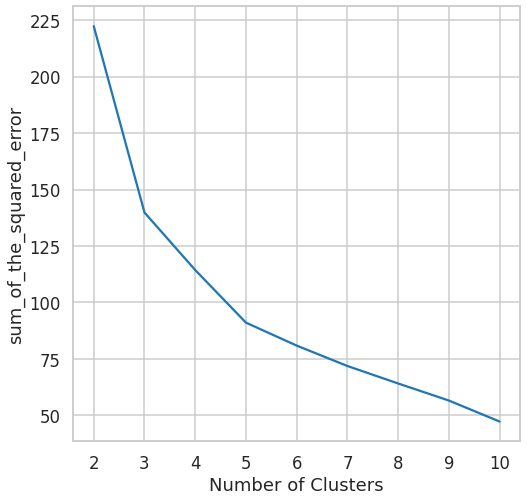

In [ ]:
from plotnine import *
from plotnine.data import mpg
from plotnine import ggplot, aes, facet_grid, labs, geom_point, theme_dark

sum_of_the_squared_error = []
listofrange=len(range(2,12,1))
i = 2
while listofrange >= i :
 if 'temp' in mydf_feat.columns:
  mydf_feat.drop('temp', axis=1, inplace=True)
 Kmeans = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
 Kmeans.fit(mydf_feat)
 mydf_feat['temp']=Kmeans.labels_
 sum_of_the_squared_error.append(Kmeans.inertia_)
 mydf_feat_col=len(range(len(mydf_feat.columns)-1))
 c=len(mydf_feat.columns)-1
 rangeofinnerloop=range(c-1)
 j=0
 while mydf_feat_col >j:
    for u in range(c-1):
      u+=1
      u+=j
      print("CLuster" + str(i))
      print(ggplot(mydf_feat,aes(x=mydf_feat.columns[j],y=mydf_feat.columns[u],color='temp'))+geom_point())
    c-=1
    j+=1
 i+=1

silhouette_coefficients2=[]
i=2
while listofrange >= i :
  if 'temp' in mydf_feat.columns:
   mydf_feat.drop('temp', axis=1, inplace=True)
  Kmeans2 = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
  Kmeans2.fit(mydf_feat)
  silhouette_coefficients2.append(silhouette_score(mydf_feat, Kmeans2.labels_))
  i+=1


x2range=range(2,11,1)
plt.xticks(x2range)
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.plot(x2range, silhouette_coefficients2)
plt.show()
print("The best silhouette_coefficient is with", (silhouette_coefficients2.index(max(silhouette_coefficients2)))+2 , "number of clusters")
print('  ')
xrange=range(2,11,1)
plt.plot(xrange, sum_of_the_squared_error)
plt.xticks(xrange)
plt.xlabel("Number of Clusters")
plt.ylabel("sum_of_the_squared_error")
plt.show()



##DBSCAN

invalid eps 0.1 with range 5
invalid eps 0.2 with range 5
invalid eps 1.7000000000000002 with range 5
invalid eps 1.8000000000000003 with range 5
invalid eps 1.9000000000000001 with range 5
invalid eps 2.0 with range 5
invalid eps 2.1 with range 5
invalid eps 2.2 with range 5
invalid eps 2.3000000000000003 with range 5
invalid eps 2.4000000000000004 with range 5
invalid eps 2.5000000000000004 with range 5
invalid eps 2.6 with range 5
invalid eps 2.7 with range 5
invalid eps 2.8000000000000003 with range 5
invalid eps 2.9000000000000004 with range 5
invalid eps 3.0000000000000004 with range 5


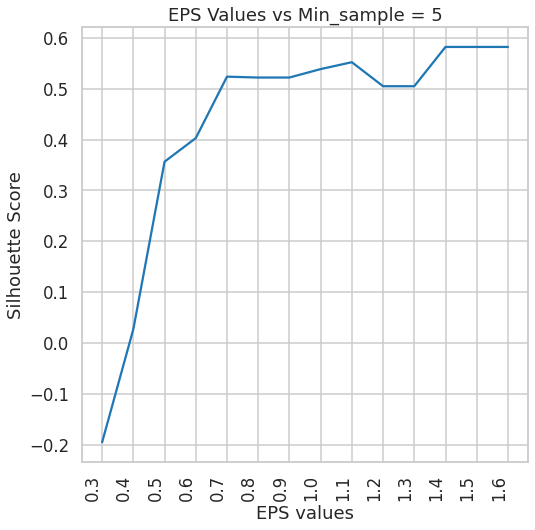

invalid eps 0.1 with range 6
invalid eps 0.2 with range 6
invalid eps 1.7000000000000002 with range 6
invalid eps 1.8000000000000003 with range 6
invalid eps 1.9000000000000001 with range 6
invalid eps 2.0 with range 6
invalid eps 2.1 with range 6
invalid eps 2.2 with range 6
invalid eps 2.3000000000000003 with range 6
invalid eps 2.4000000000000004 with range 6
invalid eps 2.5000000000000004 with range 6
invalid eps 2.6 with range 6
invalid eps 2.7 with range 6
invalid eps 2.8000000000000003 with range 6
invalid eps 2.9000000000000004 with range 6
invalid eps 3.0000000000000004 with range 6


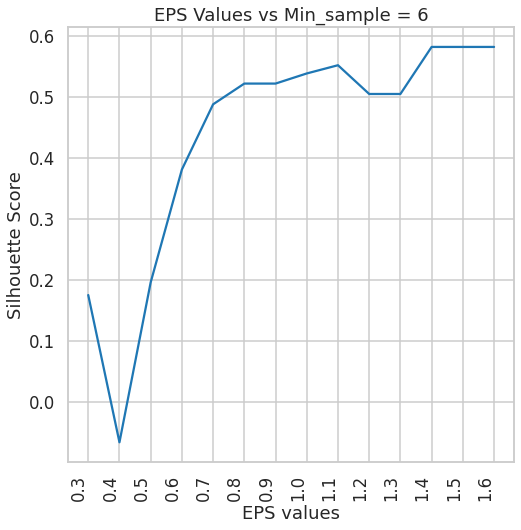

invalid eps 0.1 with range 7
invalid eps 0.2 with range 7
invalid eps 1.7000000000000002 with range 7
invalid eps 1.8000000000000003 with range 7
invalid eps 1.9000000000000001 with range 7
invalid eps 2.0 with range 7
invalid eps 2.1 with range 7
invalid eps 2.2 with range 7
invalid eps 2.3000000000000003 with range 7
invalid eps 2.4000000000000004 with range 7
invalid eps 2.5000000000000004 with range 7
invalid eps 2.6 with range 7
invalid eps 2.7 with range 7
invalid eps 2.8000000000000003 with range 7
invalid eps 2.9000000000000004 with range 7
invalid eps 3.0000000000000004 with range 7


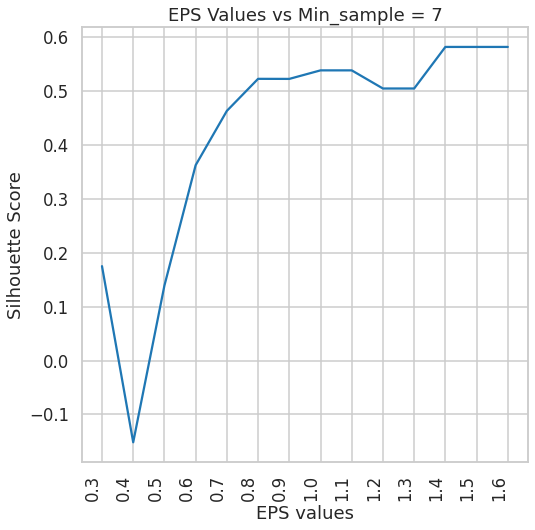

invalid eps 0.1 with range 8
invalid eps 0.2 with range 8
invalid eps 1.7000000000000002 with range 8
invalid eps 1.8000000000000003 with range 8
invalid eps 1.9000000000000001 with range 8
invalid eps 2.0 with range 8
invalid eps 2.1 with range 8
invalid eps 2.2 with range 8
invalid eps 2.3000000000000003 with range 8
invalid eps 2.4000000000000004 with range 8
invalid eps 2.5000000000000004 with range 8
invalid eps 2.6 with range 8
invalid eps 2.7 with range 8
invalid eps 2.8000000000000003 with range 8
invalid eps 2.9000000000000004 with range 8
invalid eps 3.0000000000000004 with range 8


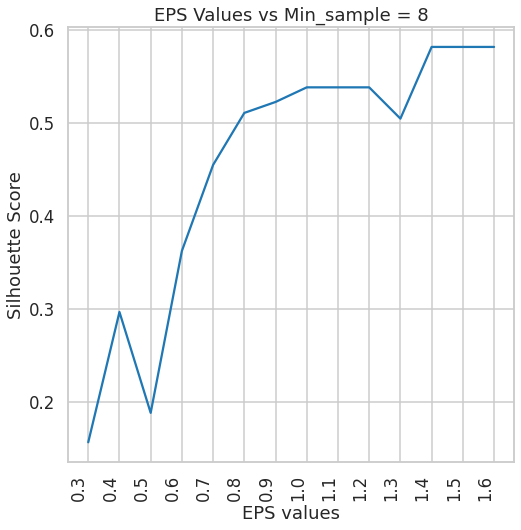

invalid eps 0.1 with range 9
invalid eps 0.2 with range 9
invalid eps 1.7000000000000002 with range 9
invalid eps 1.8000000000000003 with range 9
invalid eps 1.9000000000000001 with range 9
invalid eps 2.0 with range 9
invalid eps 2.1 with range 9
invalid eps 2.2 with range 9
invalid eps 2.3000000000000003 with range 9
invalid eps 2.4000000000000004 with range 9
invalid eps 2.5000000000000004 with range 9
invalid eps 2.6 with range 9
invalid eps 2.7 with range 9
invalid eps 2.8000000000000003 with range 9
invalid eps 2.9000000000000004 with range 9
invalid eps 3.0000000000000004 with range 9


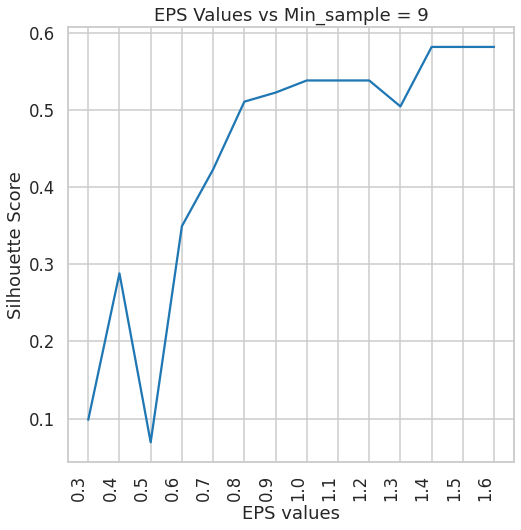

invalid eps 0.1 with range 10
invalid eps 0.2 with range 10
invalid eps 0.30000000000000004 with range 10
invalid eps 1.7000000000000002 with range 10
invalid eps 1.8000000000000003 with range 10
invalid eps 1.9000000000000001 with range 10
invalid eps 2.0 with range 10
invalid eps 2.1 with range 10
invalid eps 2.2 with range 10
invalid eps 2.3000000000000003 with range 10
invalid eps 2.4000000000000004 with range 10
invalid eps 2.5000000000000004 with range 10
invalid eps 2.6 with range 10
invalid eps 2.7 with range 10
invalid eps 2.8000000000000003 with range 10
invalid eps 2.9000000000000004 with range 10
invalid eps 3.0000000000000004 with range 10


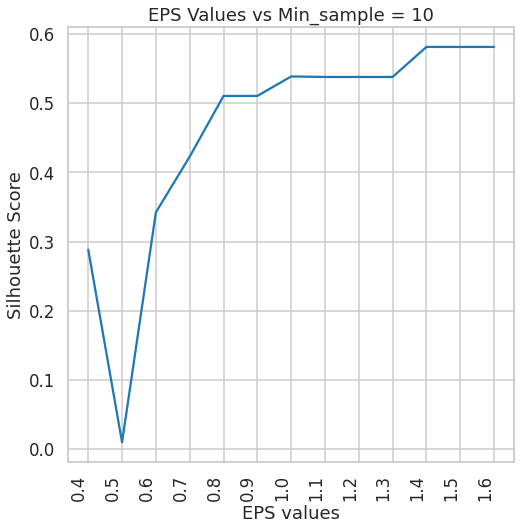

invalid eps 0.1 with range 11
invalid eps 0.2 with range 11
invalid eps 0.30000000000000004 with range 11
invalid eps 1.8000000000000003 with range 11
invalid eps 1.9000000000000001 with range 11
invalid eps 2.0 with range 11
invalid eps 2.1 with range 11
invalid eps 2.2 with range 11
invalid eps 2.3000000000000003 with range 11
invalid eps 2.4000000000000004 with range 11
invalid eps 2.5000000000000004 with range 11
invalid eps 2.6 with range 11
invalid eps 2.7 with range 11
invalid eps 2.8000000000000003 with range 11
invalid eps 2.9000000000000004 with range 11
invalid eps 3.0000000000000004 with range 11


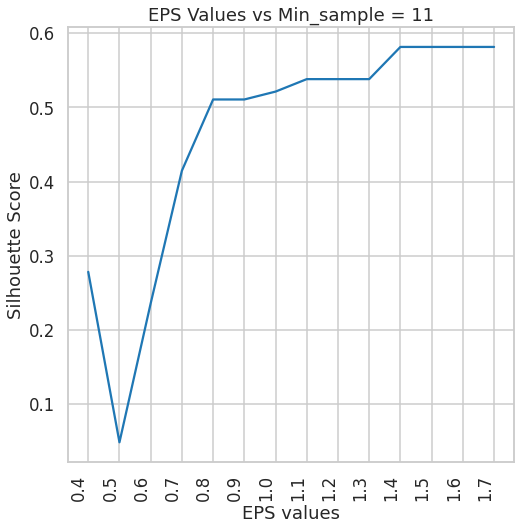

invalid eps 0.1 with range 12
invalid eps 0.2 with range 12
invalid eps 0.30000000000000004 with range 12
invalid eps 1.9000000000000001 with range 12
invalid eps 2.0 with range 12
invalid eps 2.1 with range 12
invalid eps 2.2 with range 12
invalid eps 2.3000000000000003 with range 12
invalid eps 2.4000000000000004 with range 12
invalid eps 2.5000000000000004 with range 12
invalid eps 2.6 with range 12
invalid eps 2.7 with range 12
invalid eps 2.8000000000000003 with range 12
invalid eps 2.9000000000000004 with range 12
invalid eps 3.0000000000000004 with range 12


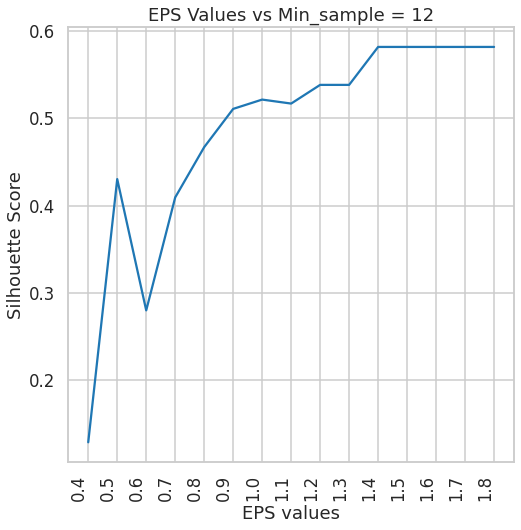

invalid eps 0.1 with range 13
invalid eps 0.2 with range 13
invalid eps 0.30000000000000004 with range 13
invalid eps 0.4 with range 13
invalid eps 1.9000000000000001 with range 13
invalid eps 2.0 with range 13
invalid eps 2.1 with range 13
invalid eps 2.2 with range 13
invalid eps 2.3000000000000003 with range 13
invalid eps 2.4000000000000004 with range 13
invalid eps 2.5000000000000004 with range 13
invalid eps 2.6 with range 13
invalid eps 2.7 with range 13
invalid eps 2.8000000000000003 with range 13
invalid eps 2.9000000000000004 with range 13
invalid eps 3.0000000000000004 with range 13


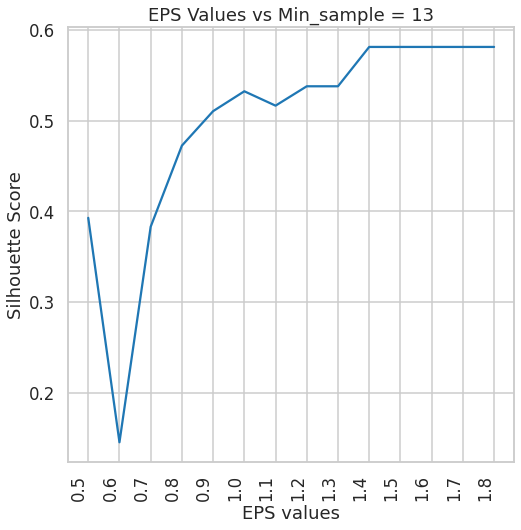

invalid eps 0.1 with range 14
invalid eps 0.2 with range 14
invalid eps 0.30000000000000004 with range 14
invalid eps 0.4 with range 14
invalid eps 1.9000000000000001 with range 14
invalid eps 2.0 with range 14
invalid eps 2.1 with range 14
invalid eps 2.2 with range 14
invalid eps 2.3000000000000003 with range 14
invalid eps 2.4000000000000004 with range 14
invalid eps 2.5000000000000004 with range 14
invalid eps 2.6 with range 14
invalid eps 2.7 with range 14
invalid eps 2.8000000000000003 with range 14
invalid eps 2.9000000000000004 with range 14
invalid eps 3.0000000000000004 with range 14


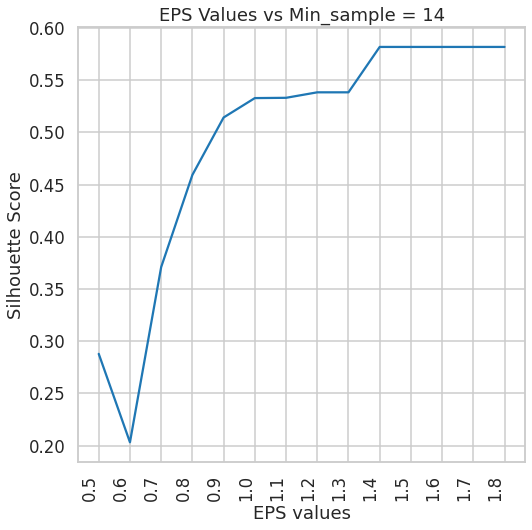

invalid eps 0.1 with range 15
invalid eps 0.2 with range 15
invalid eps 0.30000000000000004 with range 15
invalid eps 0.4 with range 15
invalid eps 1.9000000000000001 with range 15
invalid eps 2.0 with range 15
invalid eps 2.1 with range 15
invalid eps 2.2 with range 15
invalid eps 2.3000000000000003 with range 15
invalid eps 2.4000000000000004 with range 15
invalid eps 2.5000000000000004 with range 15
invalid eps 2.6 with range 15
invalid eps 2.7 with range 15
invalid eps 2.8000000000000003 with range 15
invalid eps 2.9000000000000004 with range 15
invalid eps 3.0000000000000004 with range 15


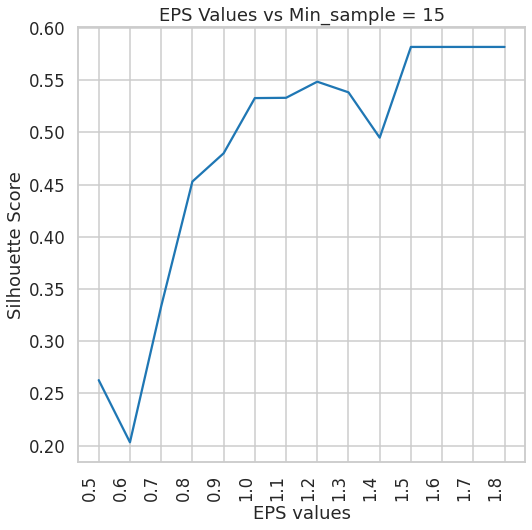

invalid eps 0.1 with range 16
invalid eps 0.2 with range 16
invalid eps 0.30000000000000004 with range 16
invalid eps 0.4 with range 16
invalid eps 1.9000000000000001 with range 16
invalid eps 2.0 with range 16
invalid eps 2.1 with range 16
invalid eps 2.2 with range 16
invalid eps 2.3000000000000003 with range 16
invalid eps 2.4000000000000004 with range 16
invalid eps 2.5000000000000004 with range 16
invalid eps 2.6 with range 16
invalid eps 2.7 with range 16
invalid eps 2.8000000000000003 with range 16
invalid eps 2.9000000000000004 with range 16
invalid eps 3.0000000000000004 with range 16


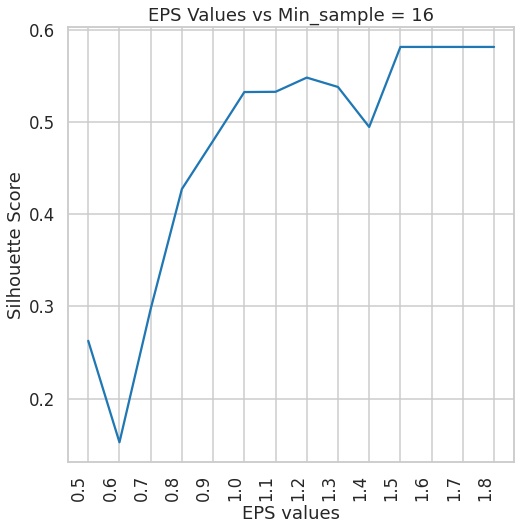

invalid eps 0.1 with range 17
invalid eps 0.2 with range 17
invalid eps 0.30000000000000004 with range 17
invalid eps 0.4 with range 17
invalid eps 0.5 with range 17
invalid eps 1.9000000000000001 with range 17
invalid eps 2.0 with range 17
invalid eps 2.1 with range 17
invalid eps 2.2 with range 17
invalid eps 2.3000000000000003 with range 17
invalid eps 2.4000000000000004 with range 17
invalid eps 2.5000000000000004 with range 17
invalid eps 2.6 with range 17
invalid eps 2.7 with range 17
invalid eps 2.8000000000000003 with range 17
invalid eps 2.9000000000000004 with range 17
invalid eps 3.0000000000000004 with range 17


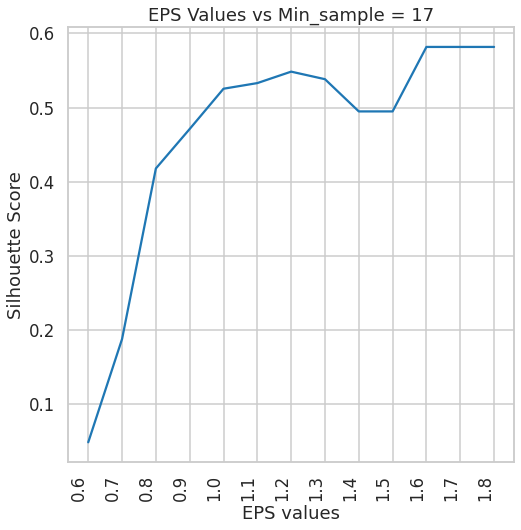

invalid eps 0.1 with range 18
invalid eps 0.2 with range 18
invalid eps 0.30000000000000004 with range 18
invalid eps 0.4 with range 18
invalid eps 0.5 with range 18
invalid eps 1.9000000000000001 with range 18
invalid eps 2.0 with range 18
invalid eps 2.1 with range 18
invalid eps 2.2 with range 18
invalid eps 2.3000000000000003 with range 18
invalid eps 2.4000000000000004 with range 18
invalid eps 2.5000000000000004 with range 18
invalid eps 2.6 with range 18
invalid eps 2.7 with range 18
invalid eps 2.8000000000000003 with range 18
invalid eps 2.9000000000000004 with range 18
invalid eps 3.0000000000000004 with range 18


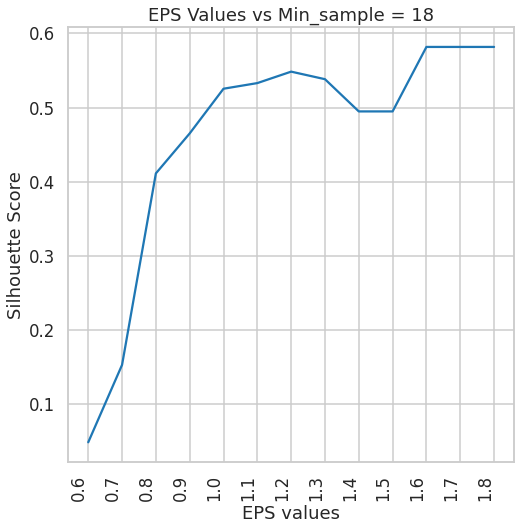

invalid eps 0.1 with range 19
invalid eps 0.2 with range 19
invalid eps 0.30000000000000004 with range 19
invalid eps 0.4 with range 19
invalid eps 0.5 with range 19
invalid eps 1.9000000000000001 with range 19
invalid eps 2.0 with range 19
invalid eps 2.1 with range 19
invalid eps 2.2 with range 19
invalid eps 2.3000000000000003 with range 19
invalid eps 2.4000000000000004 with range 19
invalid eps 2.5000000000000004 with range 19
invalid eps 2.6 with range 19
invalid eps 2.7 with range 19
invalid eps 2.8000000000000003 with range 19
invalid eps 2.9000000000000004 with range 19
invalid eps 3.0000000000000004 with range 19


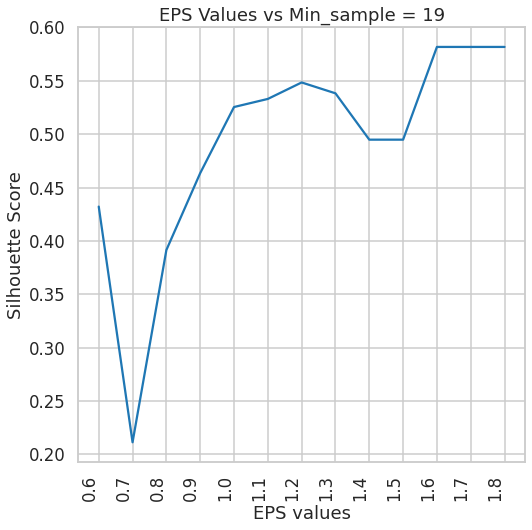

invalid eps 0.1 with range 20
invalid eps 0.2 with range 20
invalid eps 0.30000000000000004 with range 20
invalid eps 0.4 with range 20
invalid eps 0.5 with range 20
invalid eps 1.9000000000000001 with range 20
invalid eps 2.0 with range 20
invalid eps 2.1 with range 20
invalid eps 2.2 with range 20
invalid eps 2.3000000000000003 with range 20
invalid eps 2.4000000000000004 with range 20
invalid eps 2.5000000000000004 with range 20
invalid eps 2.6 with range 20
invalid eps 2.7 with range 20
invalid eps 2.8000000000000003 with range 20
invalid eps 2.9000000000000004 with range 20
invalid eps 3.0000000000000004 with range 20


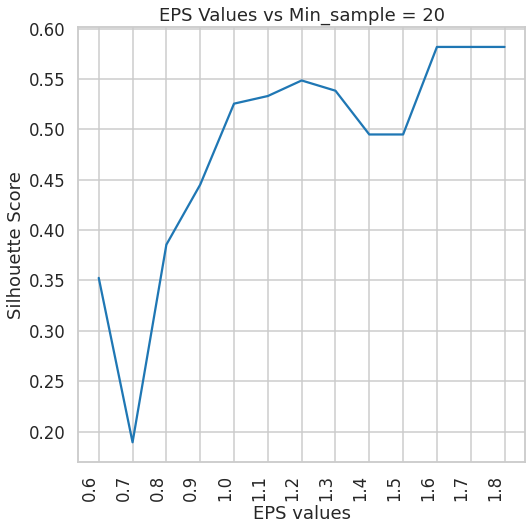

invalid eps 0.1 with range 21
invalid eps 0.2 with range 21
invalid eps 0.30000000000000004 with range 21
invalid eps 0.4 with range 21
invalid eps 0.5 with range 21
invalid eps 1.9000000000000001 with range 21
invalid eps 2.0 with range 21
invalid eps 2.1 with range 21
invalid eps 2.2 with range 21
invalid eps 2.3000000000000003 with range 21
invalid eps 2.4000000000000004 with range 21
invalid eps 2.5000000000000004 with range 21
invalid eps 2.6 with range 21
invalid eps 2.7 with range 21
invalid eps 2.8000000000000003 with range 21
invalid eps 2.9000000000000004 with range 21
invalid eps 3.0000000000000004 with range 21


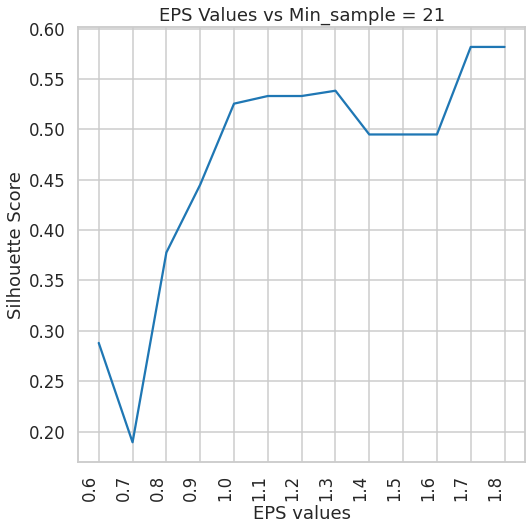

invalid eps 0.1 with range 22
invalid eps 0.2 with range 22
invalid eps 0.30000000000000004 with range 22
invalid eps 0.4 with range 22
invalid eps 0.5 with range 22
invalid eps 0.6 with range 22
invalid eps 1.9000000000000001 with range 22
invalid eps 2.0 with range 22
invalid eps 2.1 with range 22
invalid eps 2.2 with range 22
invalid eps 2.3000000000000003 with range 22
invalid eps 2.4000000000000004 with range 22
invalid eps 2.5000000000000004 with range 22
invalid eps 2.6 with range 22
invalid eps 2.7 with range 22
invalid eps 2.8000000000000003 with range 22
invalid eps 2.9000000000000004 with range 22
invalid eps 3.0000000000000004 with range 22


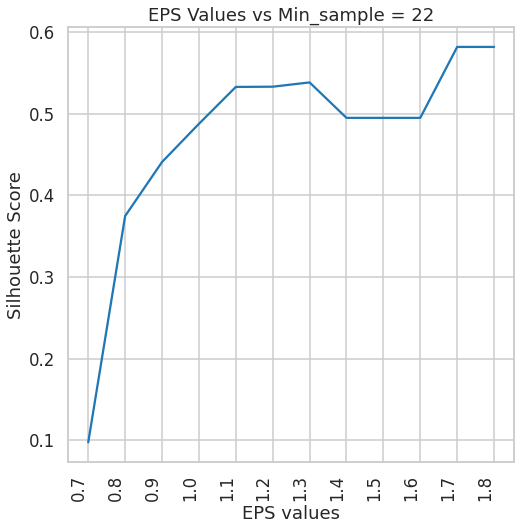

invalid eps 0.1 with range 23
invalid eps 0.2 with range 23
invalid eps 0.30000000000000004 with range 23
invalid eps 0.4 with range 23
invalid eps 0.5 with range 23
invalid eps 0.6 with range 23
invalid eps 1.9000000000000001 with range 23
invalid eps 2.0 with range 23
invalid eps 2.1 with range 23
invalid eps 2.2 with range 23
invalid eps 2.3000000000000003 with range 23
invalid eps 2.4000000000000004 with range 23
invalid eps 2.5000000000000004 with range 23
invalid eps 2.6 with range 23
invalid eps 2.7 with range 23
invalid eps 2.8000000000000003 with range 23
invalid eps 2.9000000000000004 with range 23
invalid eps 3.0000000000000004 with range 23


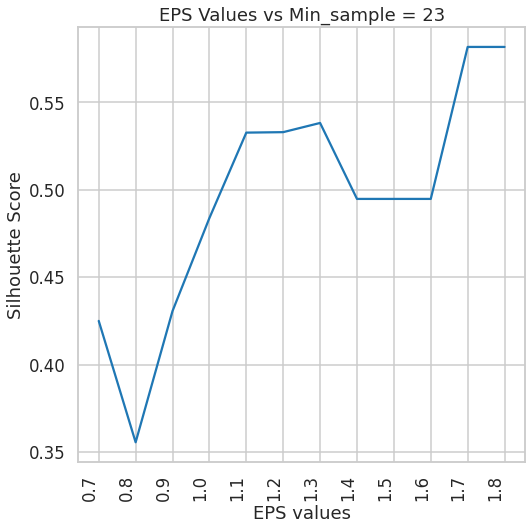

invalid eps 0.1 with range 24
invalid eps 0.2 with range 24
invalid eps 0.30000000000000004 with range 24
invalid eps 0.4 with range 24
invalid eps 0.5 with range 24
invalid eps 0.6 with range 24
invalid eps 1.9000000000000001 with range 24
invalid eps 2.0 with range 24
invalid eps 2.1 with range 24
invalid eps 2.2 with range 24
invalid eps 2.3000000000000003 with range 24
invalid eps 2.4000000000000004 with range 24
invalid eps 2.5000000000000004 with range 24
invalid eps 2.6 with range 24
invalid eps 2.7 with range 24
invalid eps 2.8000000000000003 with range 24
invalid eps 2.9000000000000004 with range 24
invalid eps 3.0000000000000004 with range 24


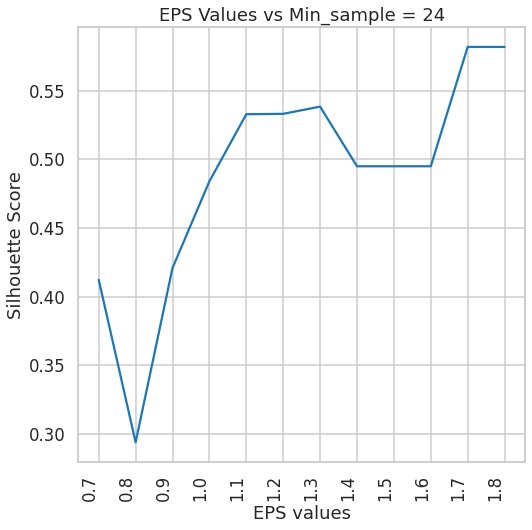

invalid eps 0.1 with range 25
invalid eps 0.2 with range 25
invalid eps 0.30000000000000004 with range 25
invalid eps 0.4 with range 25
invalid eps 0.5 with range 25
invalid eps 0.6 with range 25
invalid eps 1.9000000000000001 with range 25
invalid eps 2.0 with range 25
invalid eps 2.1 with range 25
invalid eps 2.2 with range 25
invalid eps 2.3000000000000003 with range 25
invalid eps 2.4000000000000004 with range 25
invalid eps 2.5000000000000004 with range 25
invalid eps 2.6 with range 25
invalid eps 2.7 with range 25
invalid eps 2.8000000000000003 with range 25
invalid eps 2.9000000000000004 with range 25
invalid eps 3.0000000000000004 with range 25


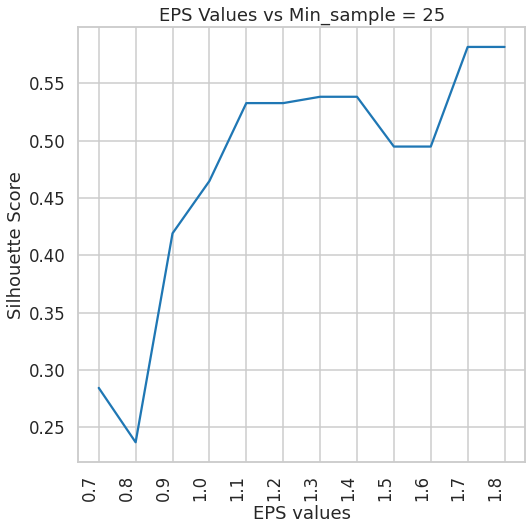

The max Silhouette Score is 0.5817500491982808 with eps equal to (1.8000000000000003,) and min_samples equal to 25


In [ ]:
min_samples_list=range(5,26,1)
min_samples_range= len(range(5,26,1))
epsss=np.arange(0.1, 3.1, 0.1)
eps_range=len(np.arange(0.1, 3.1, 0.1))
best_silhouette_score =0
best_ep=0
best_min_sample=0



if 'temp' in mydf_feat.columns:
 mydf_feat.drop('temp', axis=1, inplace=True)
i=0



while min_samples_range - 1 >= i:

  silhouette_scores = []
  valid_eps=[]
  
  j=0
  while eps_range - 1 >= j: 
    dbscan = DBSCAN(eps=epsss[j], min_samples=min_samples_list[i])
    dbscan.fit(mydf_feat)

    if (len(np.unique(dbscan.labels_)) <= 1):
      print("invalid eps",epsss[j],"with range",min_samples_list[i])
      j+=1
      continue

    valid_eps.append(epsss[j])
    sil_dbscan = silhouette_score(mydf_feat, dbscan.labels_)
    silhouette_scores.append(sil_dbscan)

    if (best_silhouette_score <= sil_dbscan): 
     best_silhouette_score =sil_dbscan
     best_min_sample=min_samples_list[i]
     best_ep=epsss[j],
    j+=1
 
  plt.plot(valid_eps, silhouette_scores)
  plt.xticks(valid_eps)
  graph_helper= plt.subplot()   
  plt.setp(graph_helper.get_xticklabels(), rotation=90, ha='right')
  plt.title("EPS Values vs Min_sample = " + str(min_samples_list[i]))
  plt.xlabel("EPS values")
  plt.ylabel("Silhouette Score")
  plt.show() 
  i+=1

      

print("The max Silhouette Score is", best_silhouette_score ,"with eps equal to" , best_ep , "and min_samples equal to", best_min_sample )

        

##HIRI CLUSTERING

cityblock
average
0.3
['0.33327598004547765', 'cityblock', 'average', '0.3']


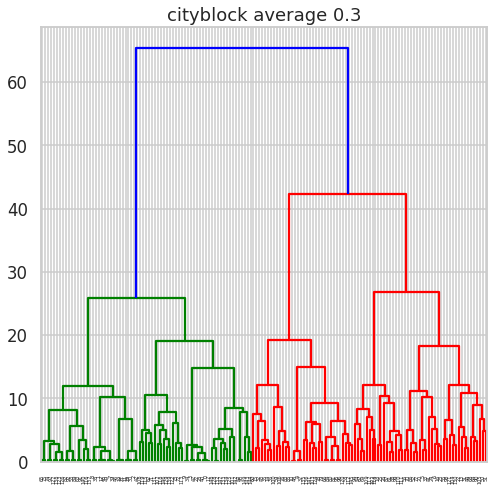

CLuster9


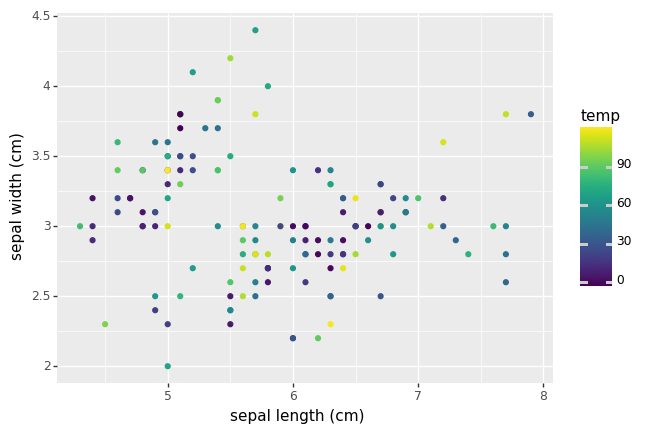

<ggplot: (8757737228873)>
CLuster9


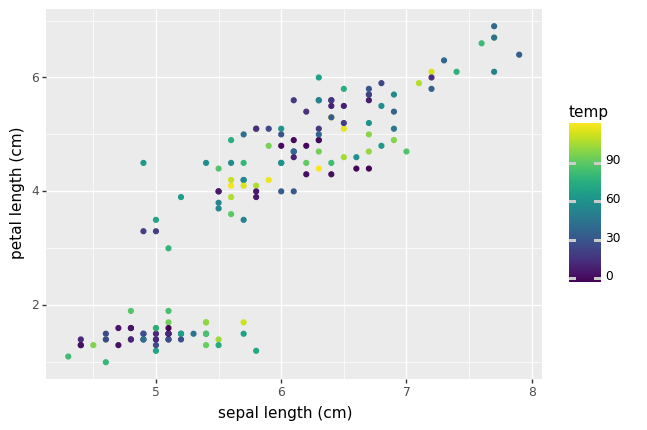

<ggplot: (8757736735301)>
CLuster9


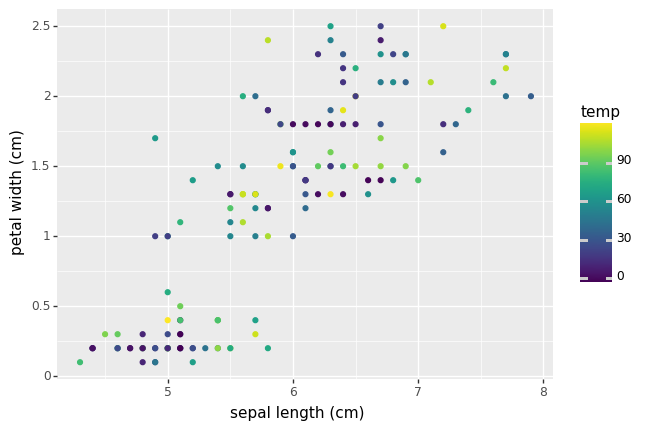

<ggplot: (8757736690005)>
CLuster9


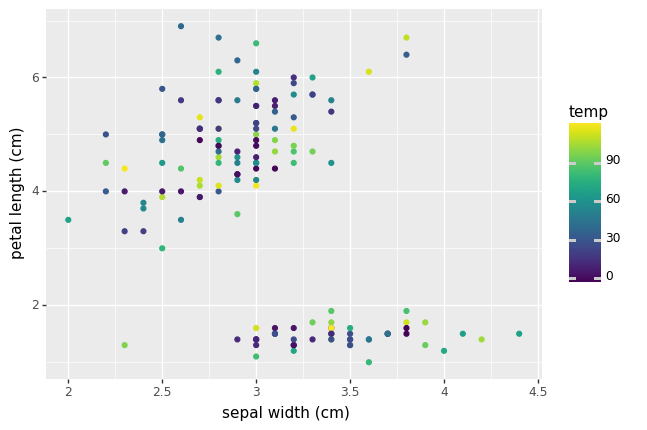

<ggplot: (8757736056553)>
CLuster9


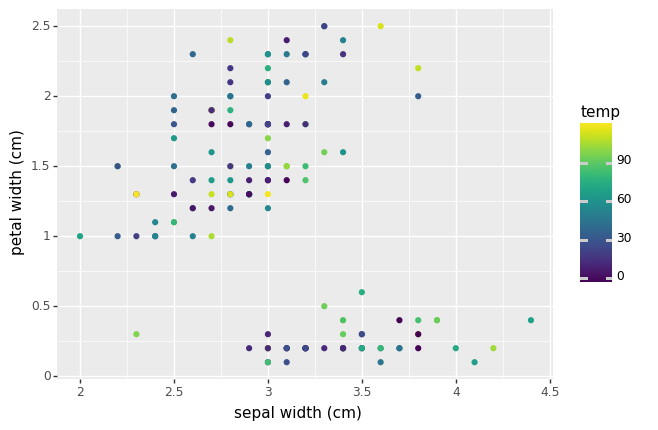

<ggplot: (8757736056449)>
CLuster9


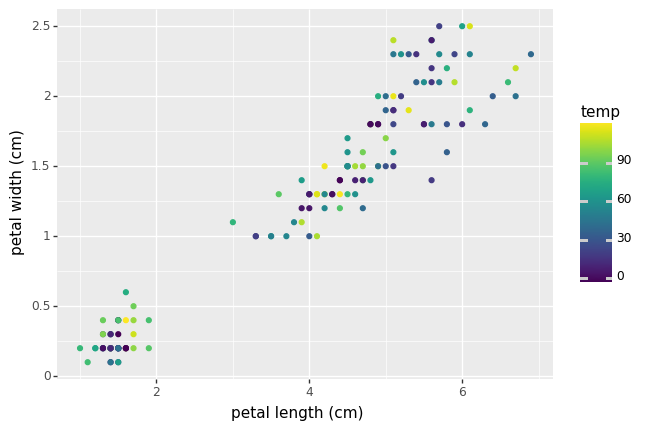

<ggplot: (8757736266633)>
0.5
['0.5567820794322877', 'cityblock', 'average', '0.5']


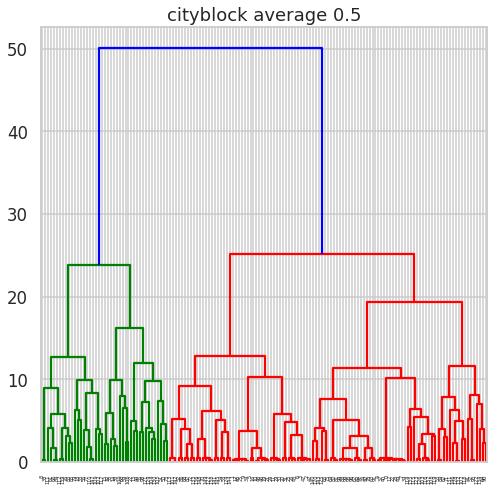

CLuster9


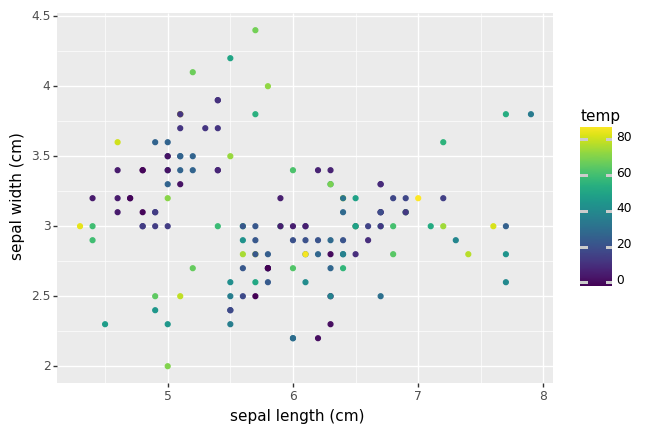

<ggplot: (8757736604789)>
CLuster9


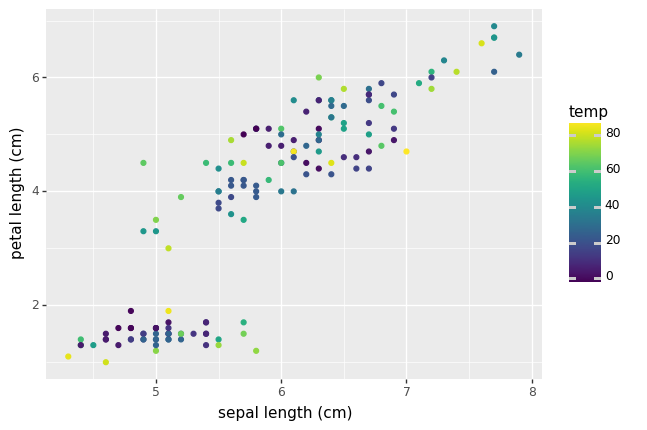

<ggplot: (8757739579841)>
CLuster9


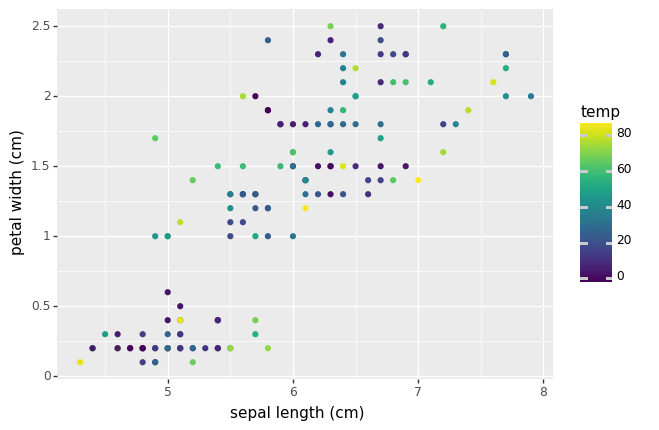

<ggplot: (8757737175781)>
CLuster9


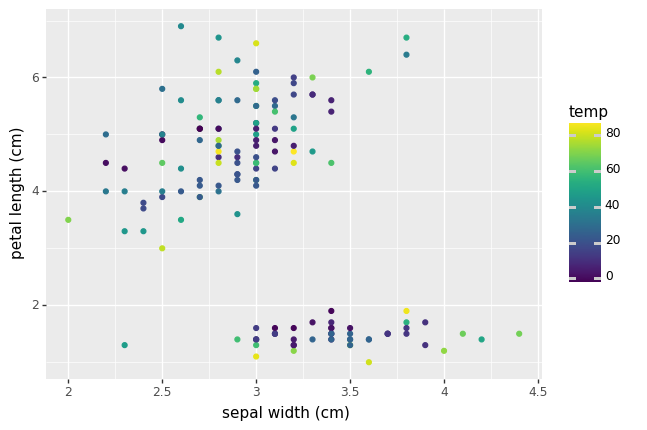

<ggplot: (8757736881965)>
CLuster9


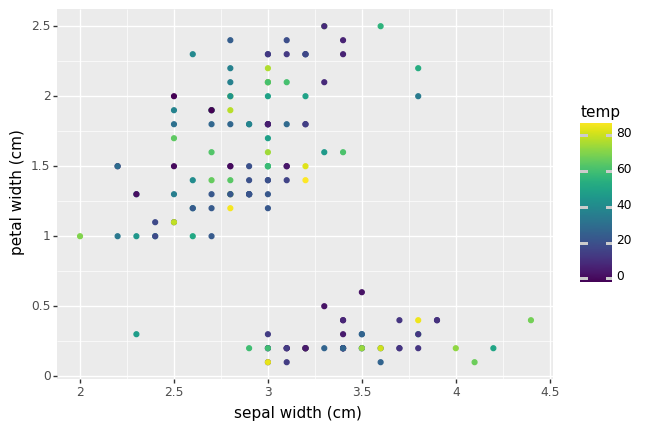

<ggplot: (8757736823177)>
CLuster9


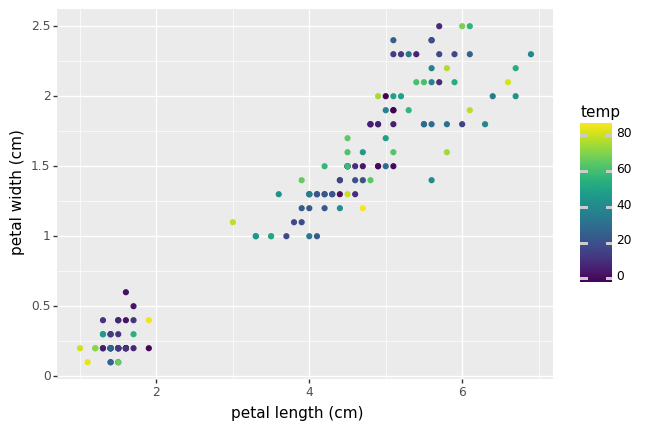

<ggplot: (8757737484089)>
0.7
['0.6896722681433408', 'cityblock', 'average', '0.7']


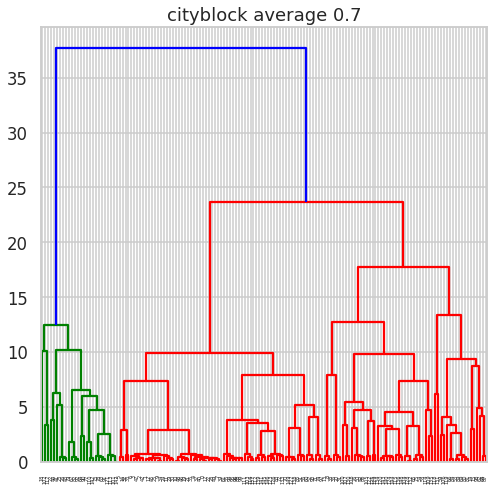

CLuster9


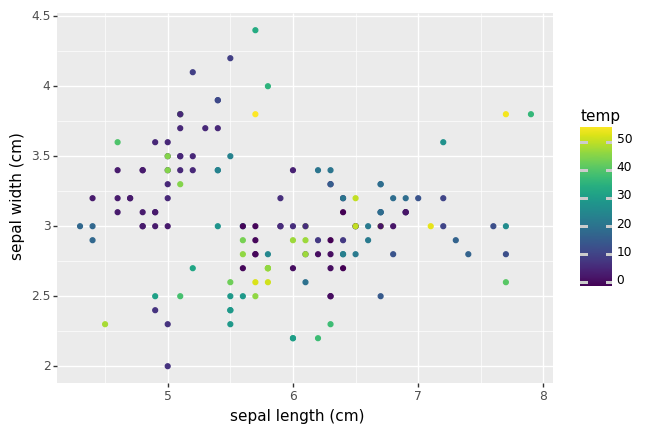

<ggplot: (8757736525545)>
CLuster9


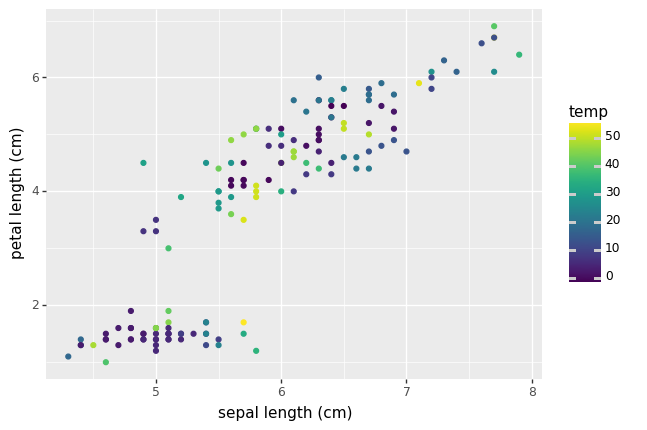

<ggplot: (8757736555921)>
CLuster9


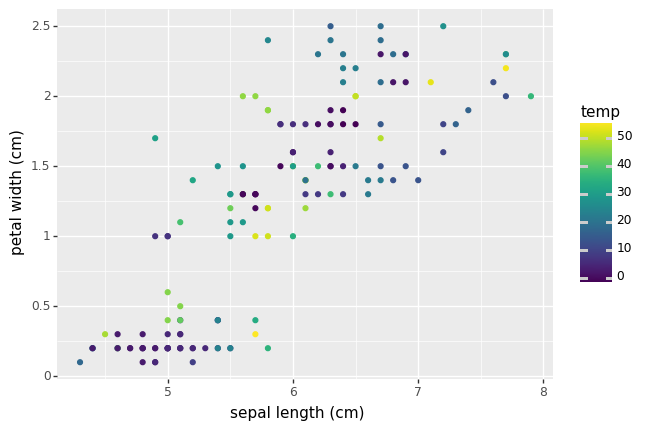

<ggplot: (8757736057861)>
CLuster9


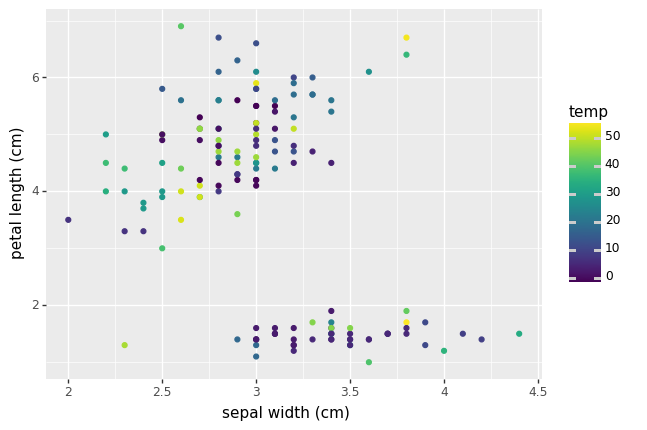

<ggplot: (8757736663233)>
CLuster9


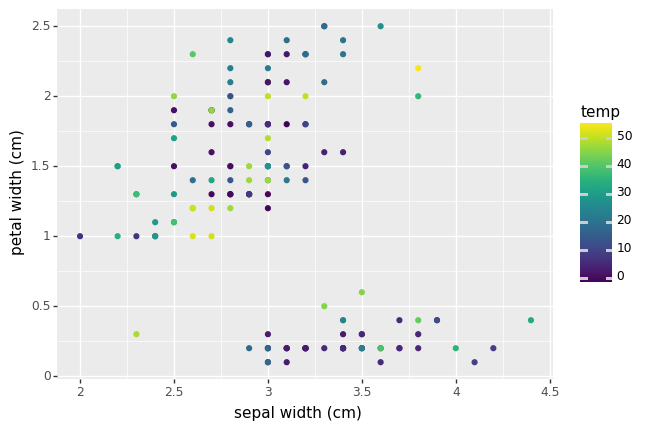

<ggplot: (8757736115305)>
CLuster9


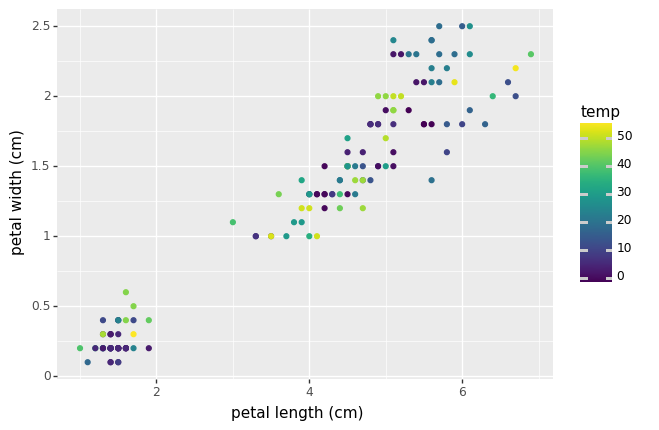

<ggplot: (8757736365089)>
0.9000000000000001


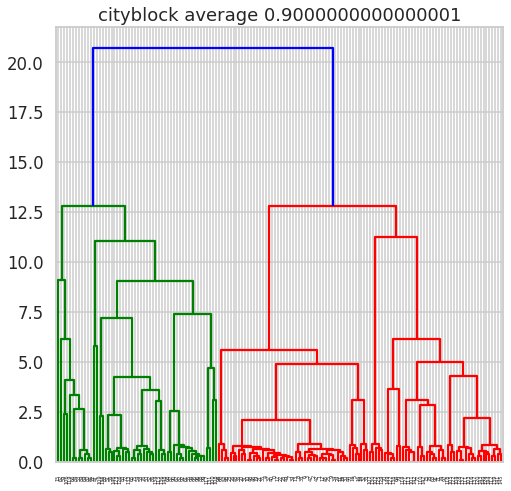

CLuster9


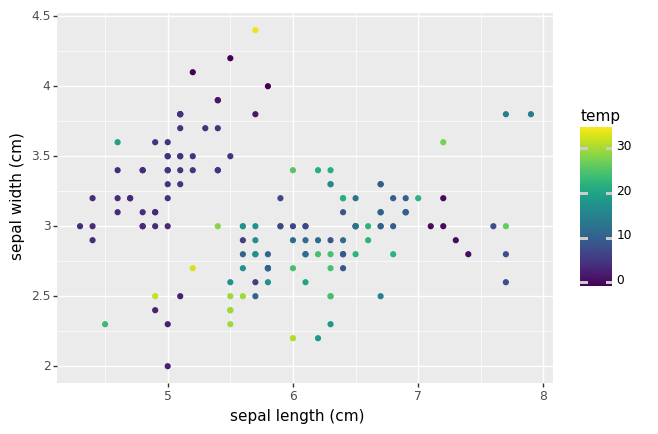

<ggplot: (8757739067365)>
CLuster9


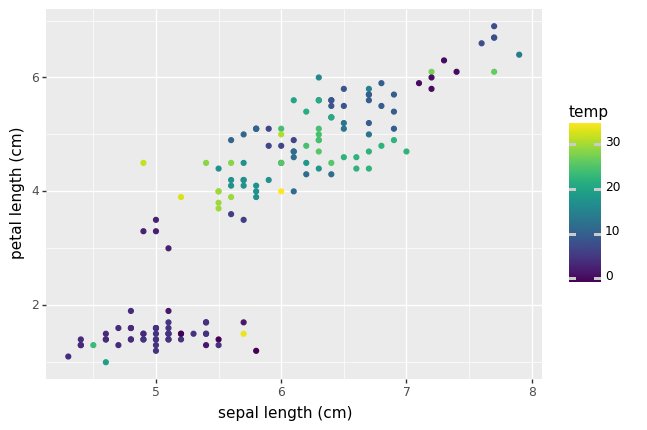

<ggplot: (8757739067185)>
CLuster9


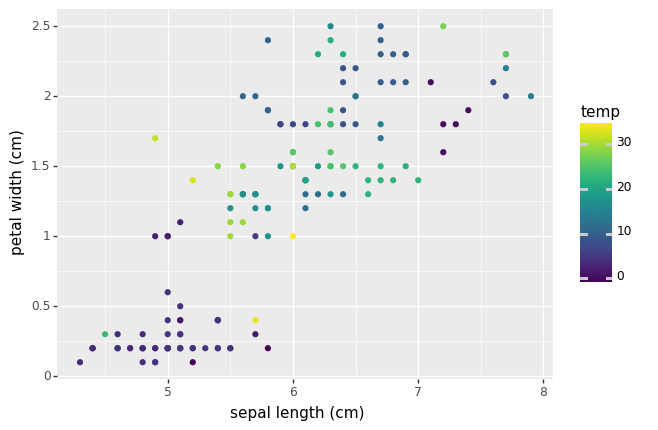

<ggplot: (8757737215709)>
CLuster9


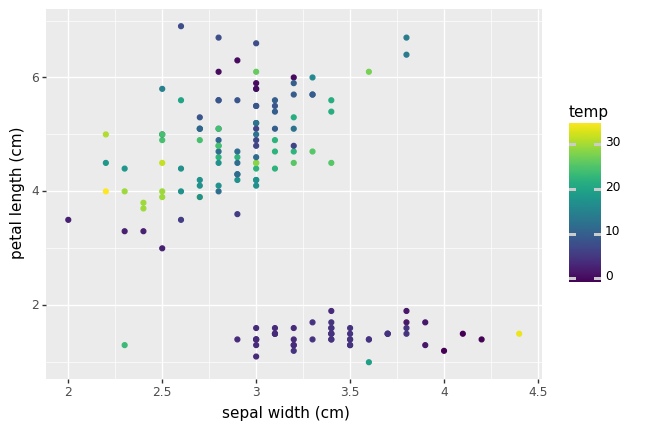

<ggplot: (8757739550645)>
CLuster9


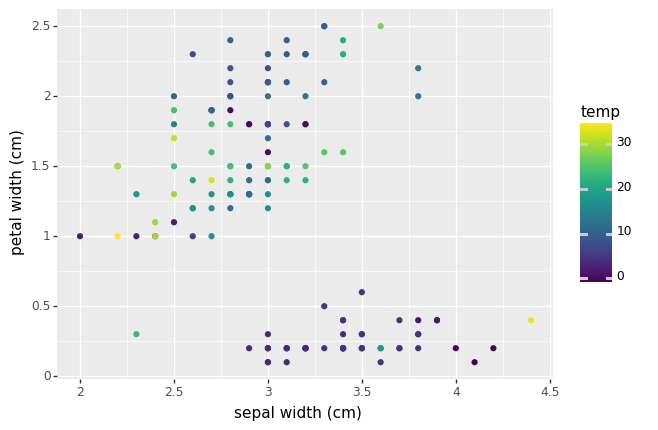

<ggplot: (8757739263417)>
CLuster9


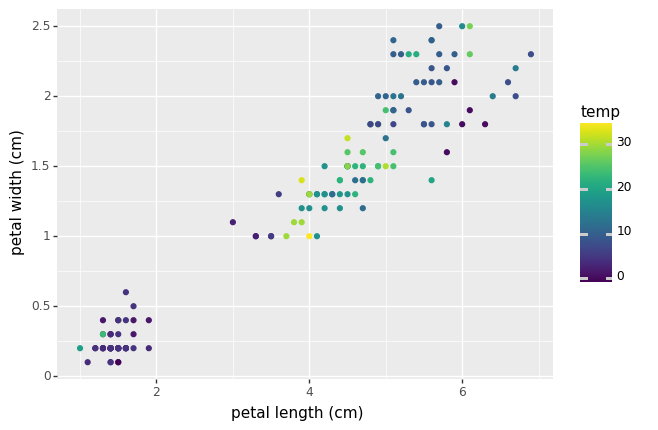

<ggplot: (8757739263369)>
1.1
['0.6978086688094964', 'cityblock', 'average', '1.1']


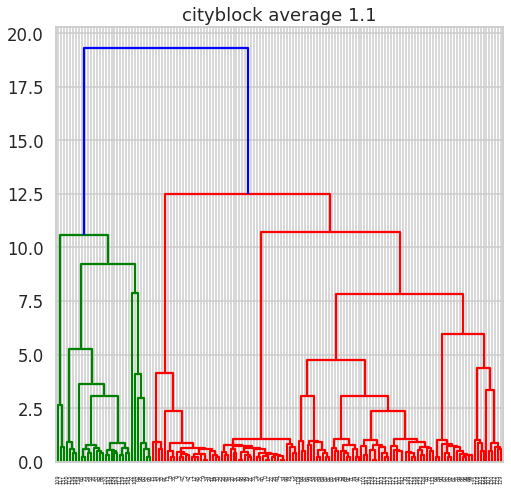

CLuster9


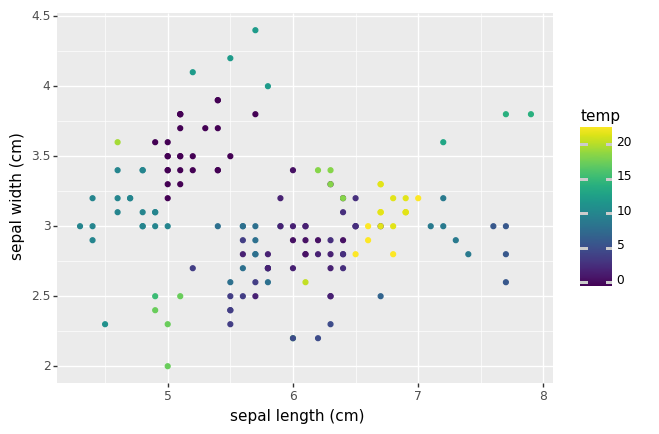

<ggplot: (8757737349401)>
CLuster9


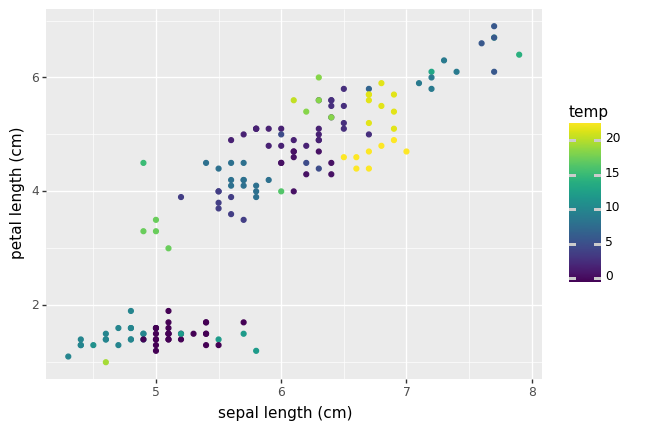

<ggplot: (8757736118477)>
CLuster9


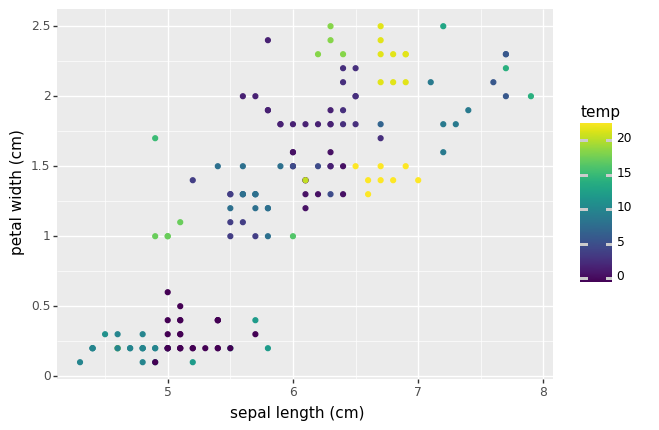

<ggplot: (8757736504297)>
CLuster9


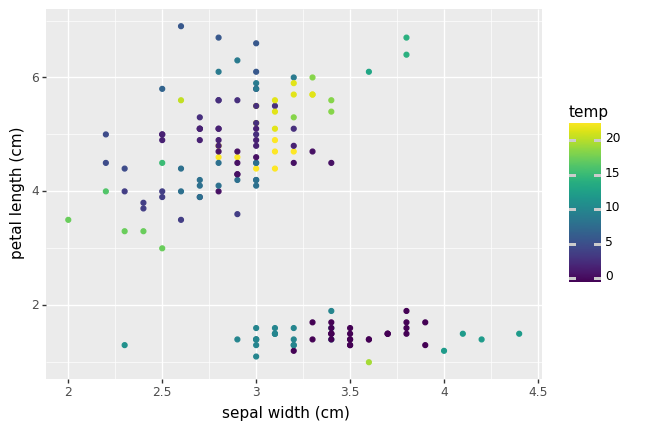

<ggplot: (8757736252949)>
CLuster9


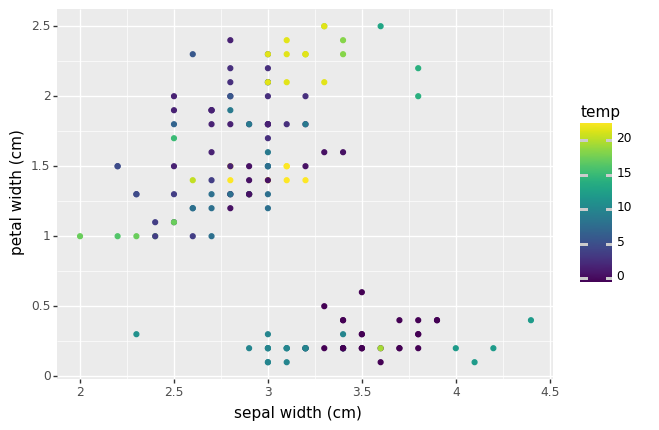

<ggplot: (8757735997217)>
CLuster9


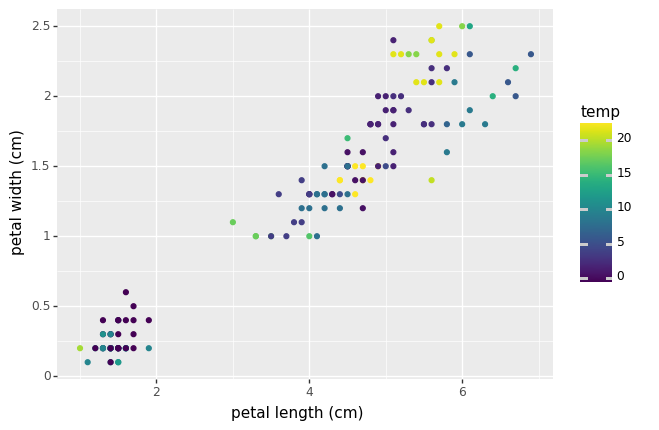

<ggplot: (8757736266405)>
1.3


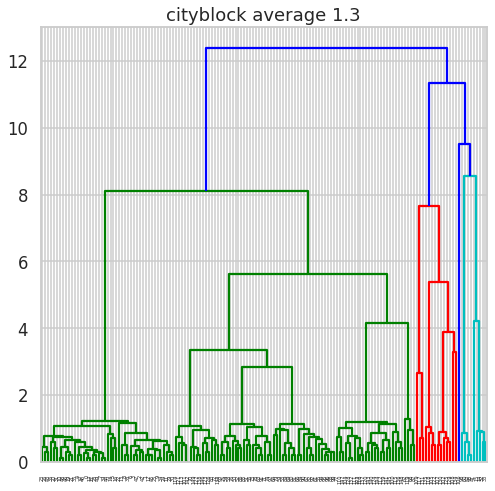

CLuster9


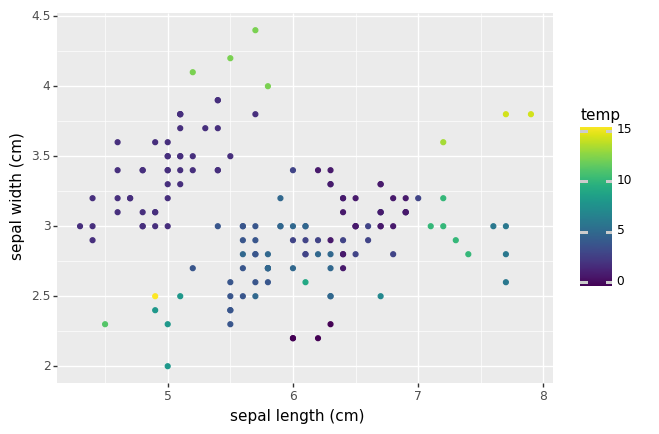

<ggplot: (8757736575821)>
CLuster9


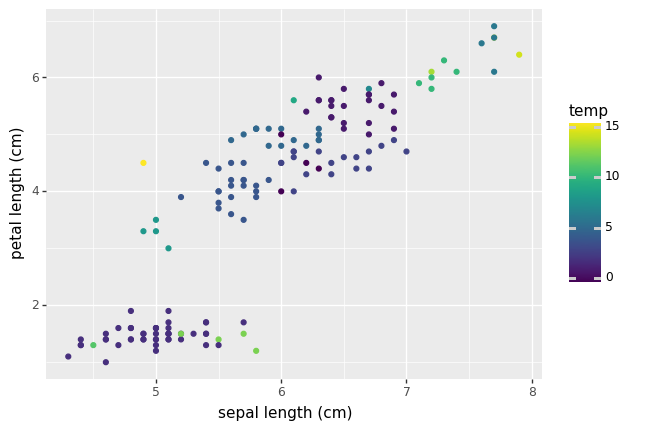

<ggplot: (8757735422057)>
CLuster9


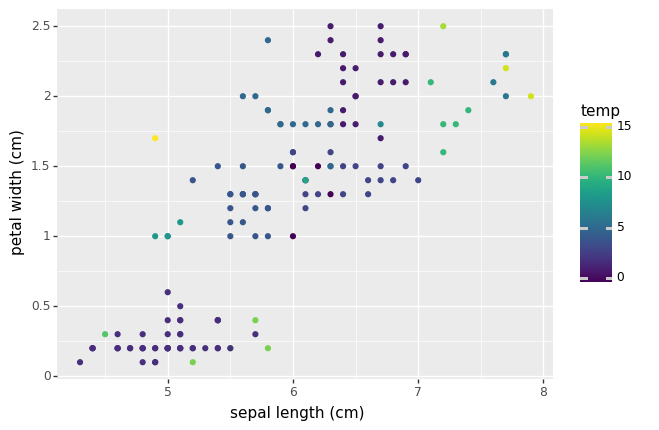

<ggplot: (8757736346149)>
CLuster9


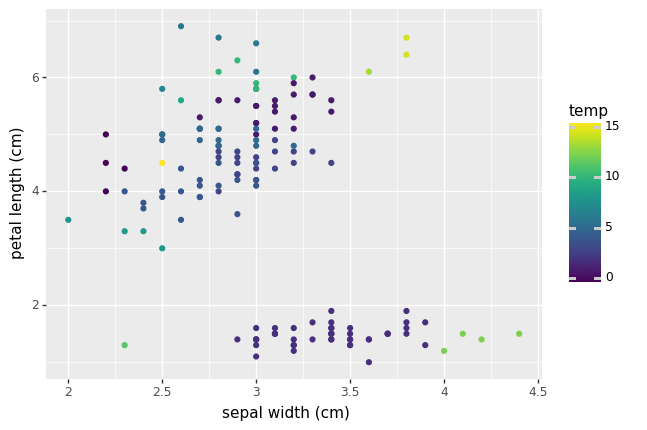

<ggplot: (8757736318065)>
CLuster9


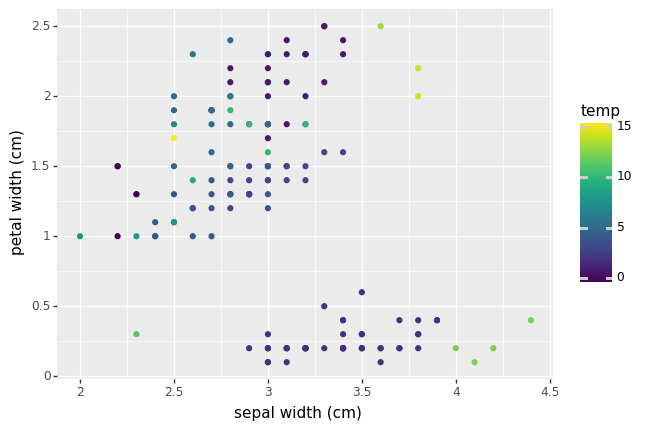

<ggplot: (8757737563217)>
CLuster9


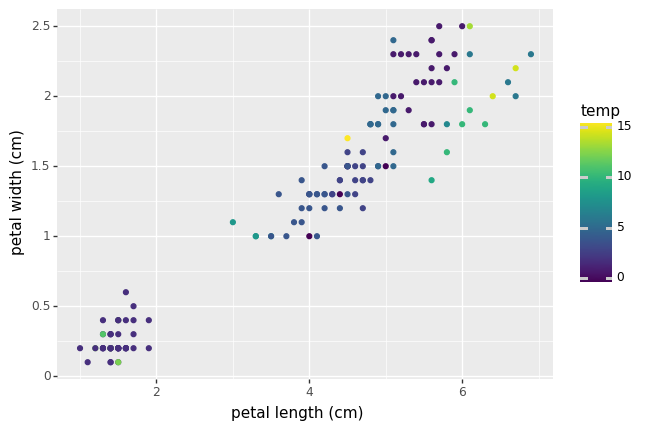

<ggplot: (8757736890441)>
1.5000000000000002


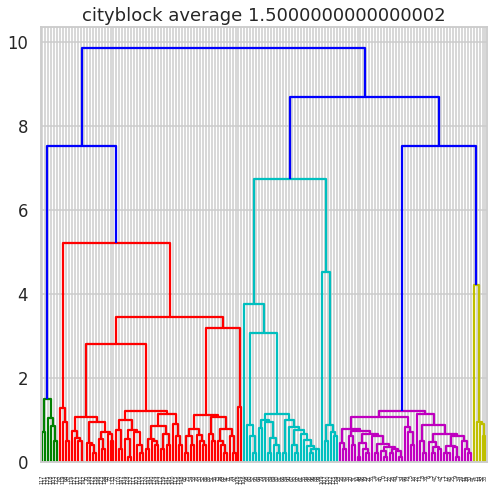

CLuster9


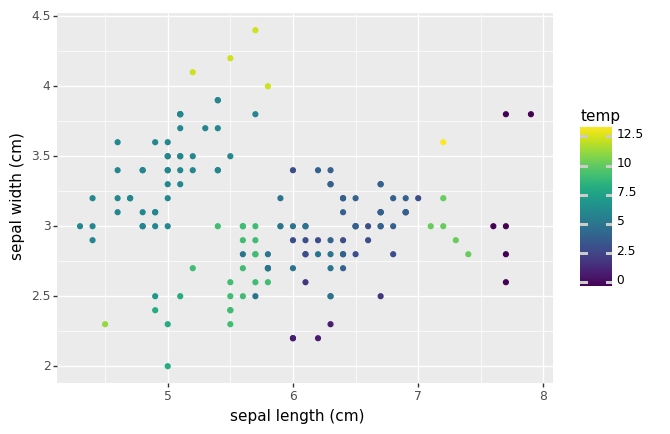

<ggplot: (8757735465765)>
CLuster9


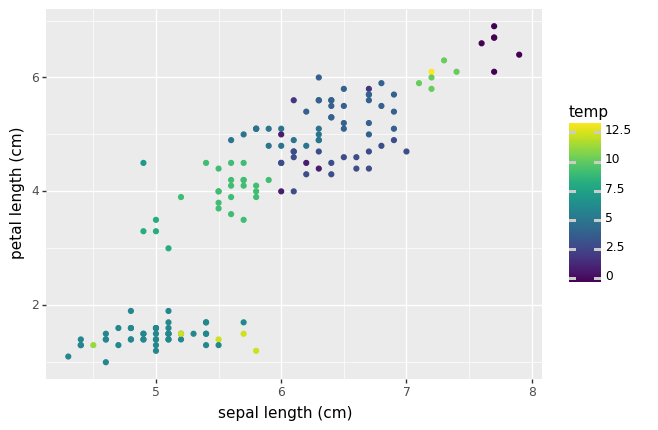

<ggplot: (8757736340721)>
CLuster9


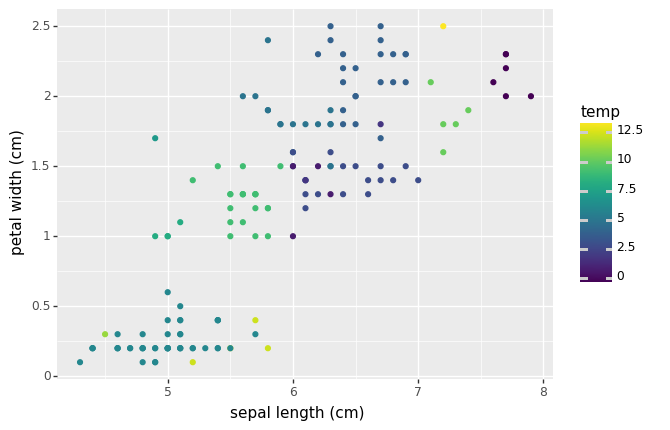

<ggplot: (8757736483337)>
CLuster9


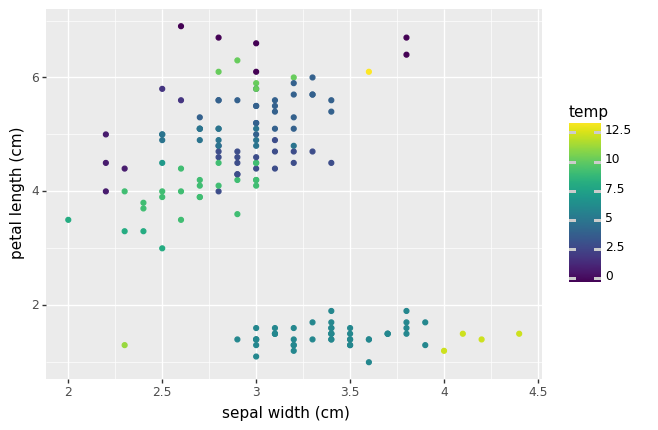

<ggplot: (8757736485461)>
CLuster9


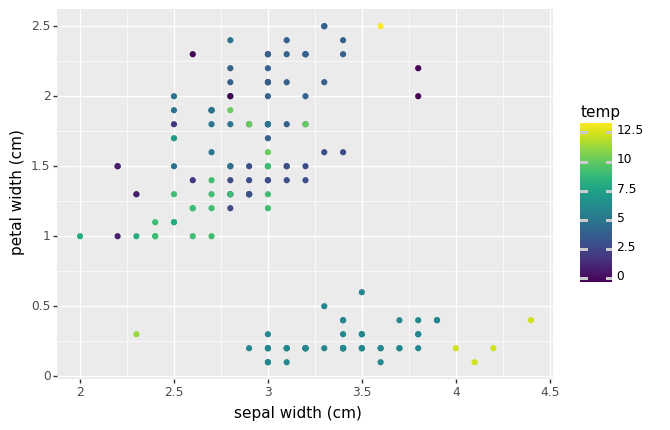

<ggplot: (8757736287989)>
CLuster9


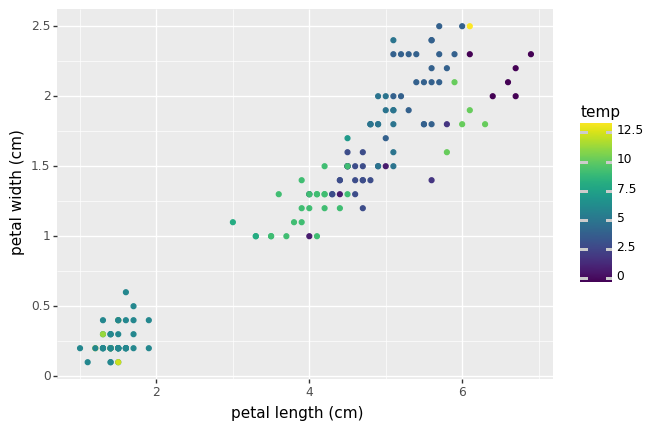

<ggplot: (8757737314329)>
1.7000000000000002
['0.7170449411350971', 'cityblock', 'average', '1.7']


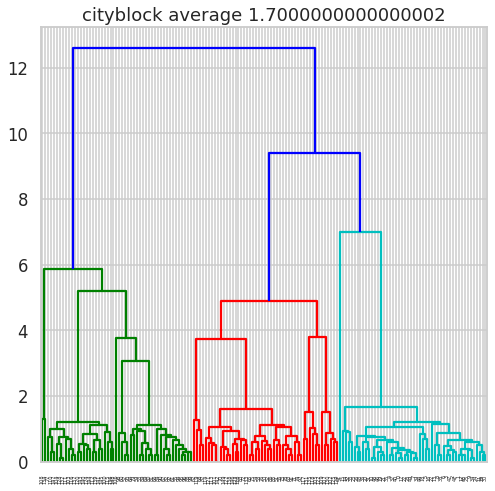

CLuster9


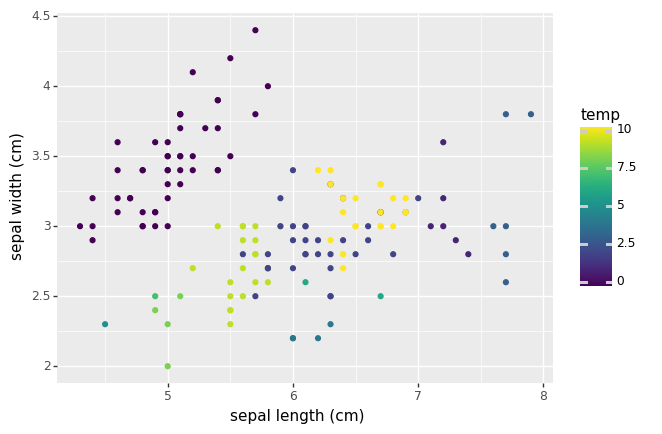

<ggplot: (8757736682513)>
CLuster9


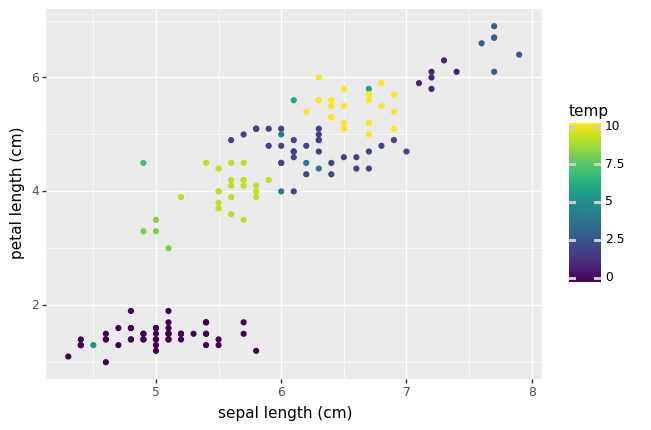

<ggplot: (8757736521873)>
CLuster9


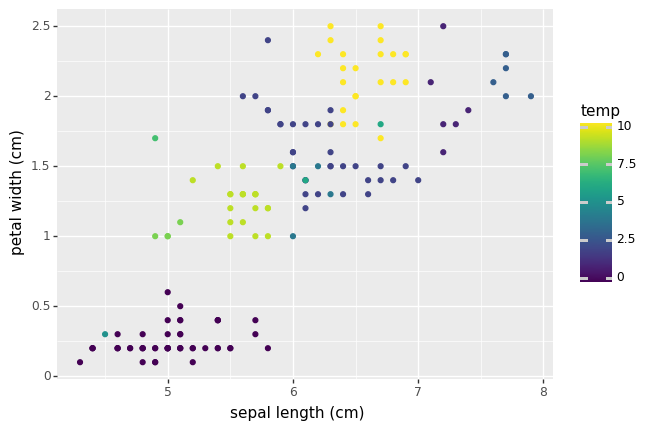

<ggplot: (8757737145161)>
CLuster9


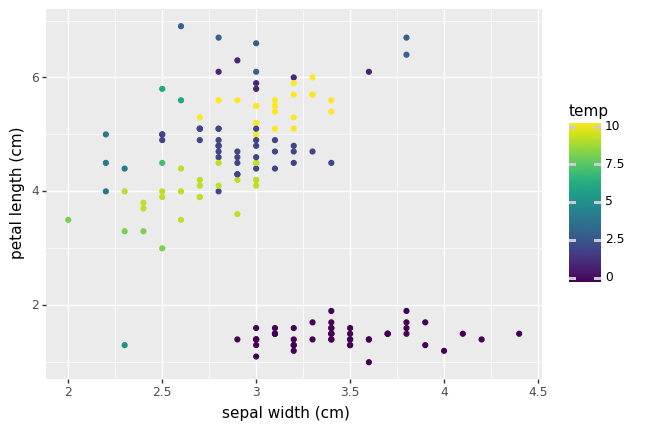

<ggplot: (8757737335389)>
CLuster9


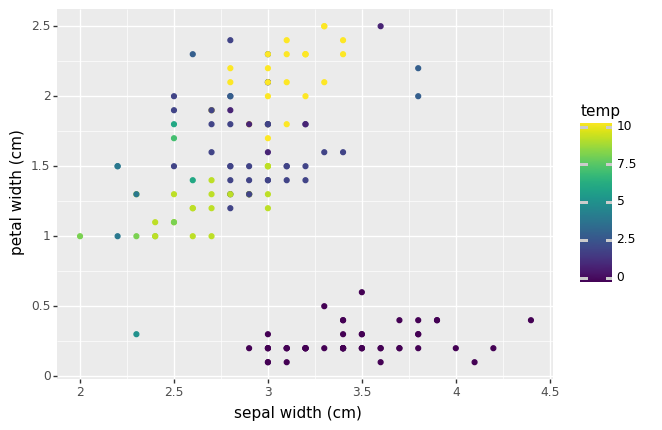

<ggplot: (8757735431129)>
CLuster9


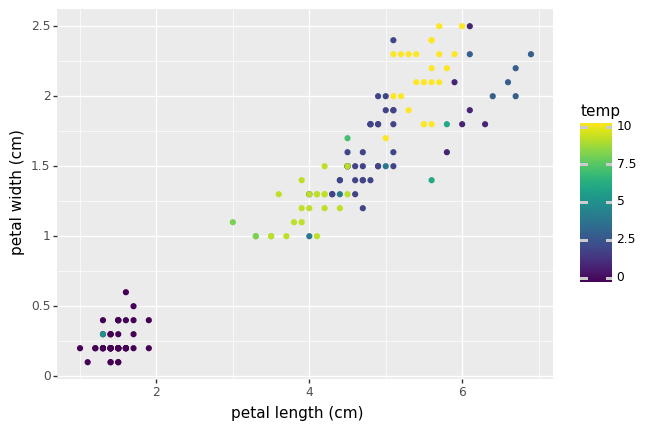

<ggplot: (8757736189237)>
1.9000000000000001


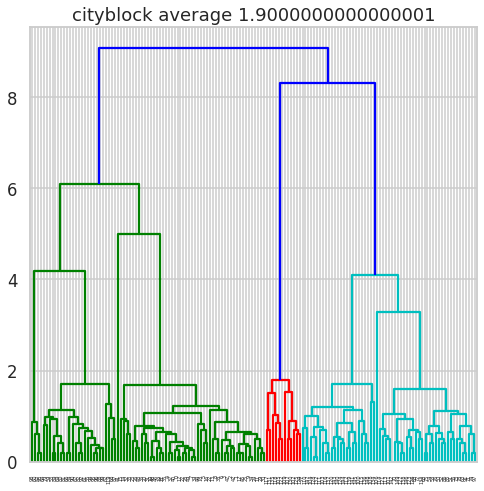

CLuster9


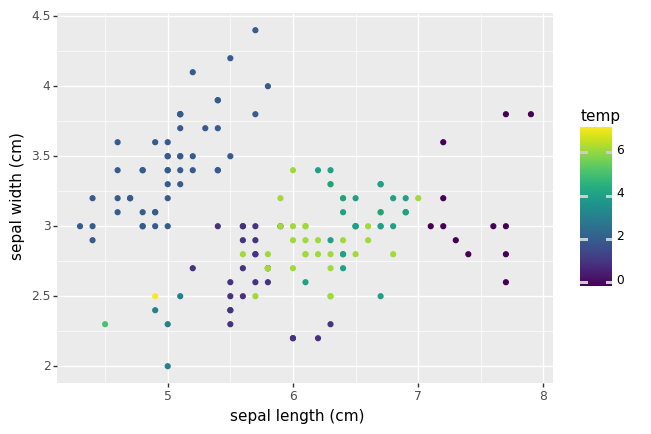

<ggplot: (8757736666141)>
CLuster9


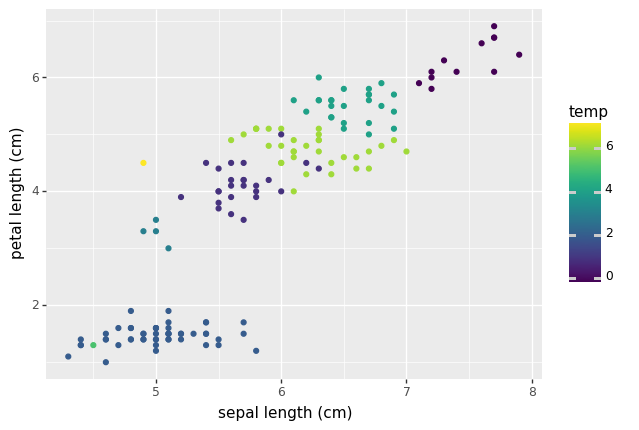

<ggplot: (8757736980257)>
CLuster9


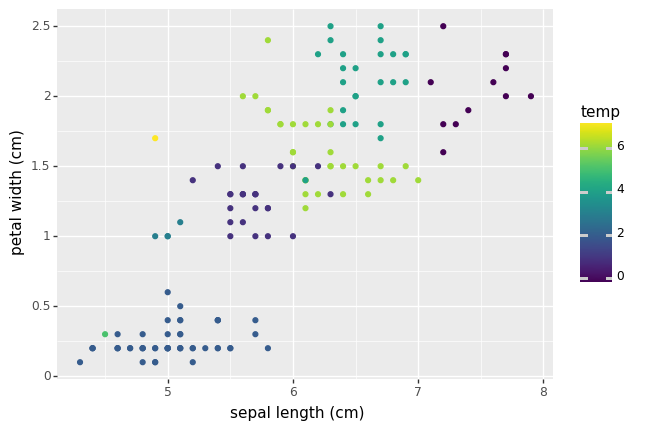

<ggplot: (8757736173965)>
CLuster9


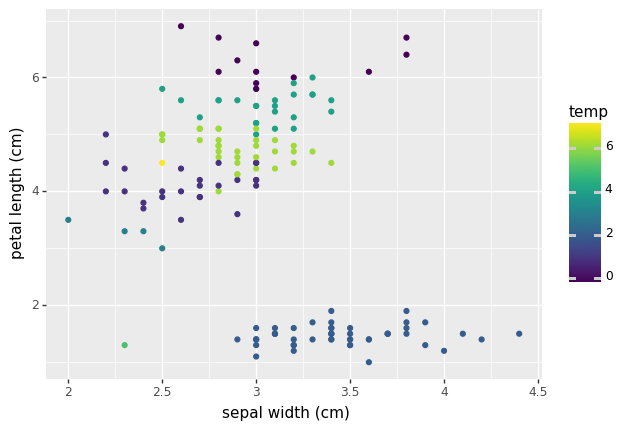

<ggplot: (8757735792357)>
CLuster9


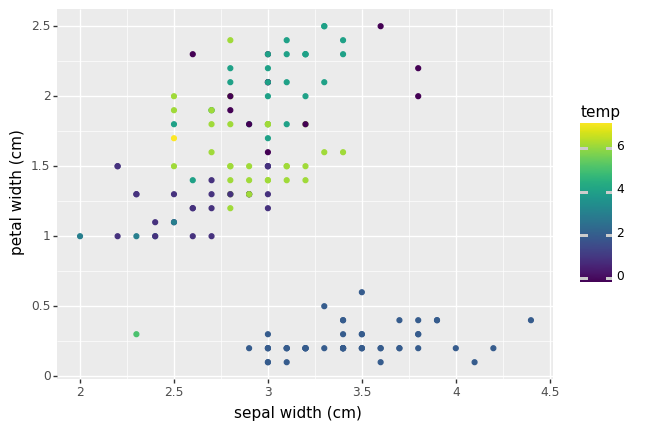

<ggplot: (8757736646829)>
CLuster9


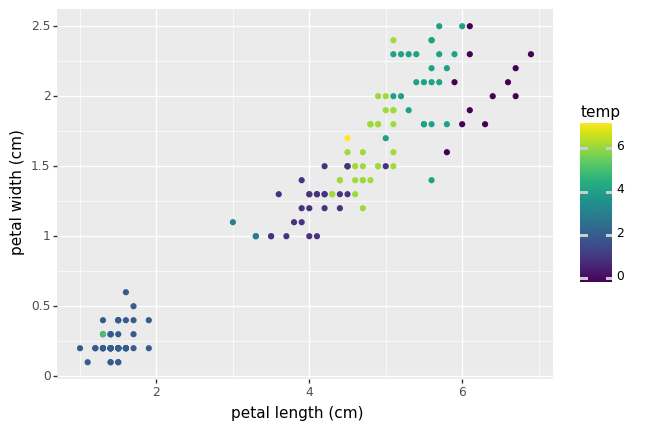

<ggplot: (8757736904285)>
single
0.3


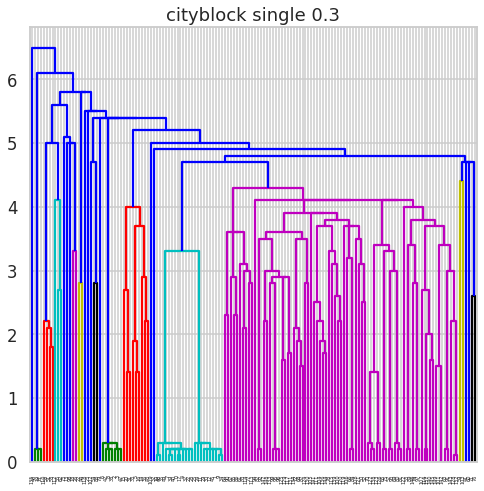

CLuster9


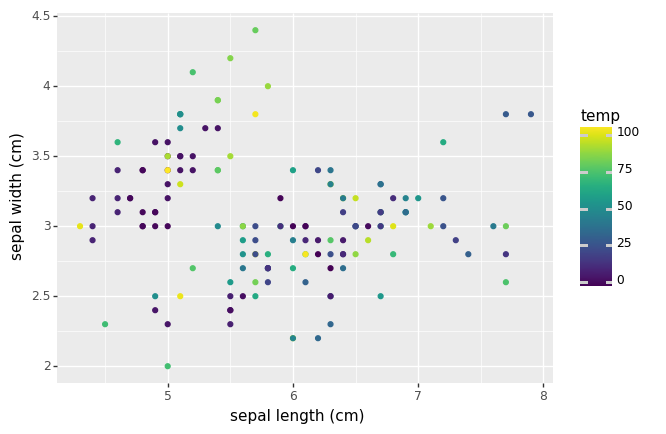

<ggplot: (8757736643709)>
CLuster9


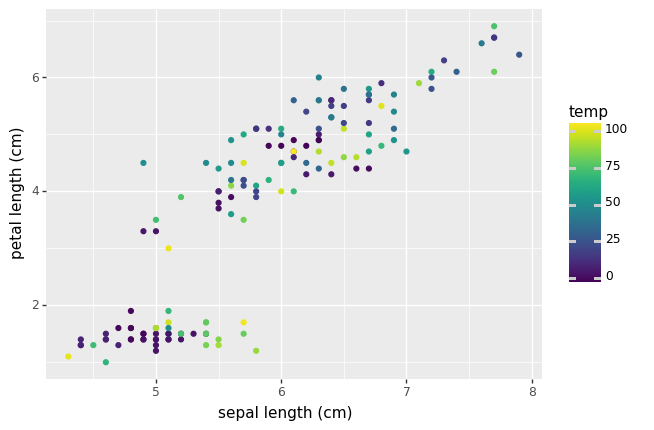

<ggplot: (8757736901801)>
CLuster9


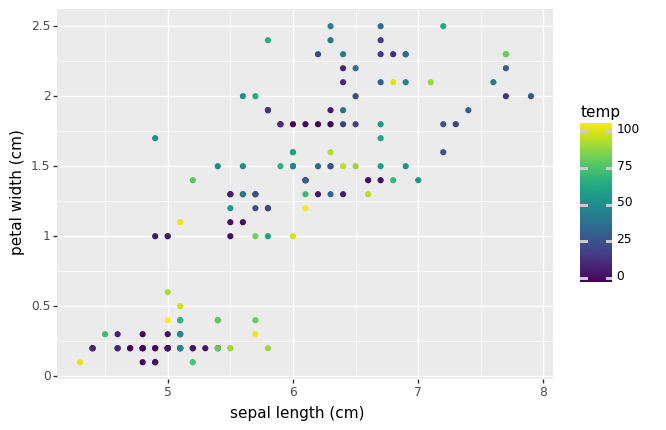

<ggplot: (8757736775617)>
CLuster9


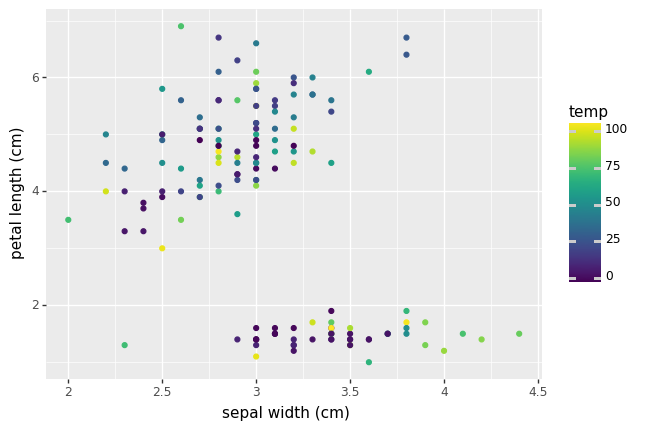

<ggplot: (8757739073365)>
CLuster9


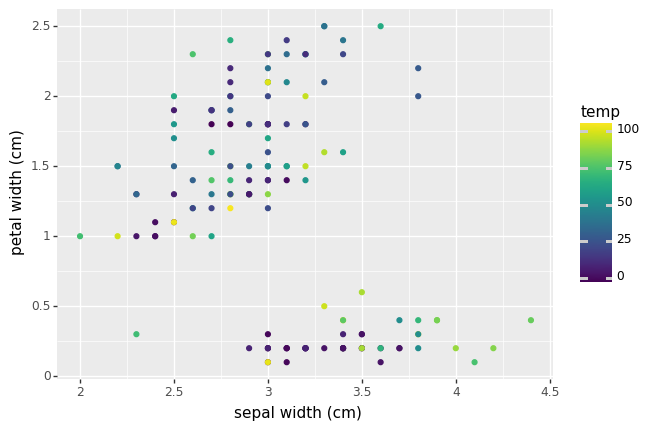

<ggplot: (8757737308541)>
CLuster9


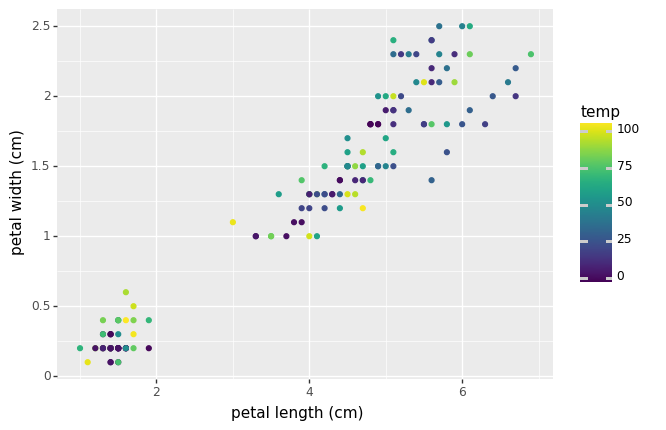

<ggplot: (8757736670049)>
0.5


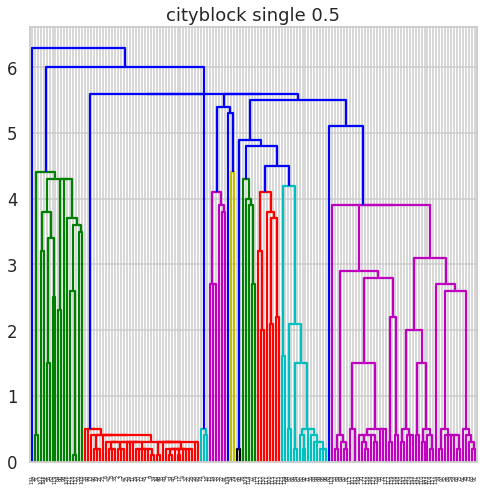

CLuster9


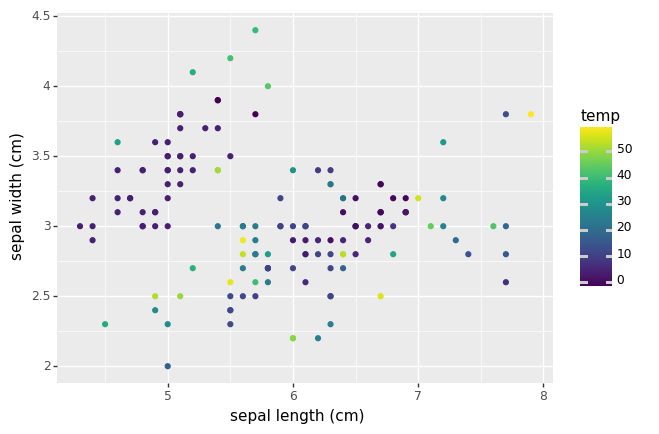

<ggplot: (8757736000229)>
CLuster9


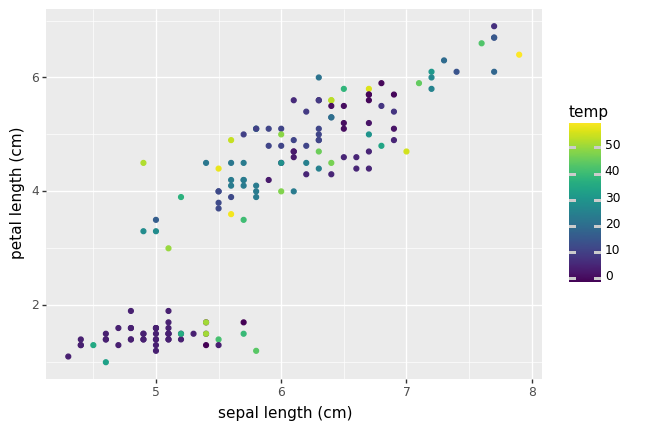

<ggplot: (8757736382609)>
CLuster9


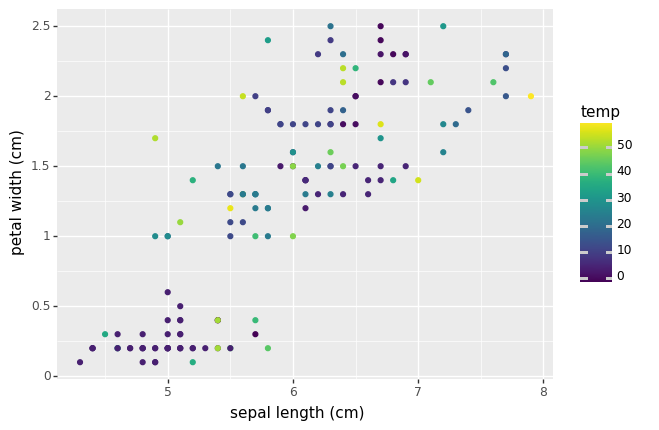

<ggplot: (8757736567381)>
CLuster9


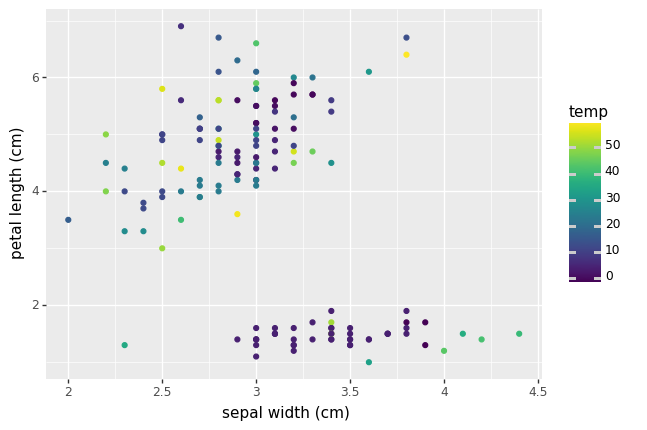

<ggplot: (8757736182765)>
CLuster9


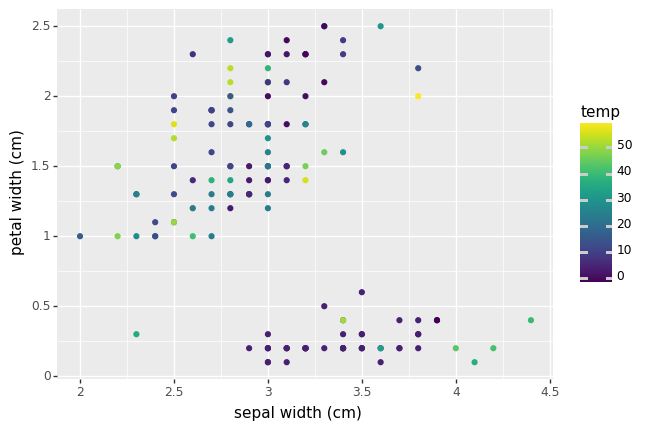

<ggplot: (8757736525329)>
CLuster9


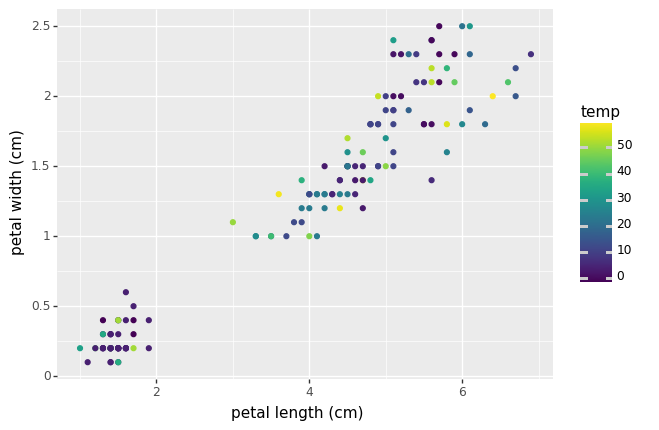

<ggplot: (8757736571613)>
0.7


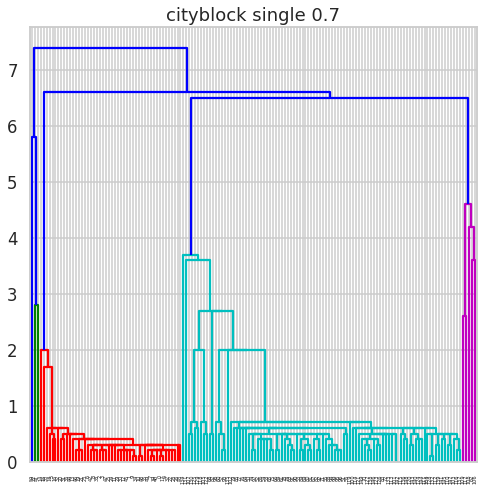

CLuster9


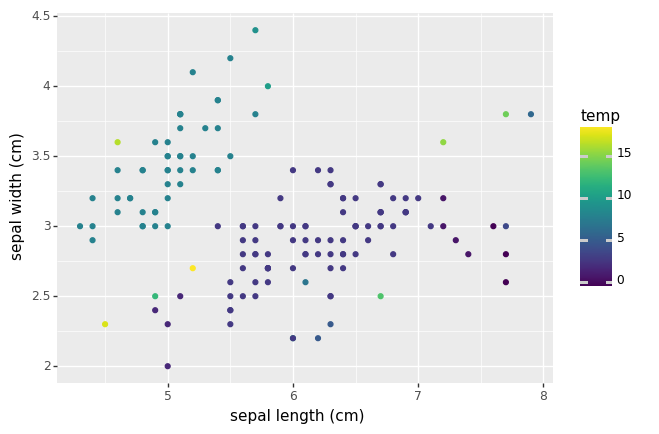

<ggplot: (8757736316821)>
CLuster9


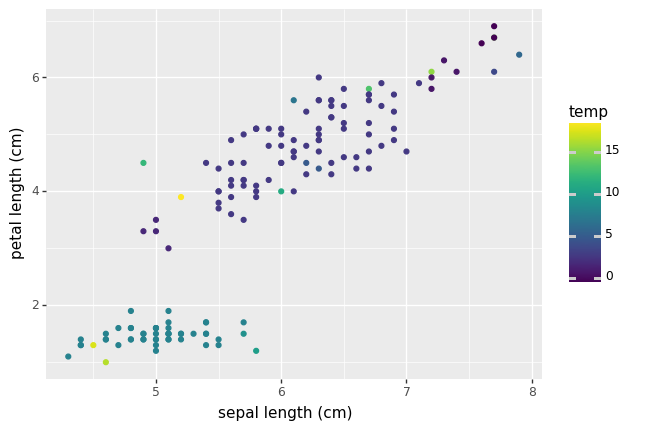

<ggplot: (8757736533885)>
CLuster9


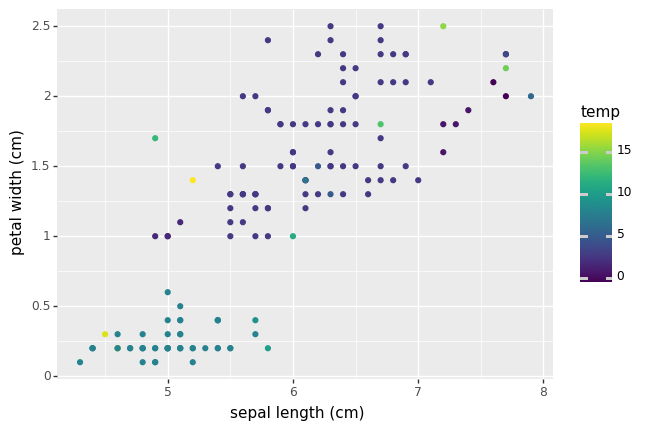

<ggplot: (8757737564801)>
CLuster9


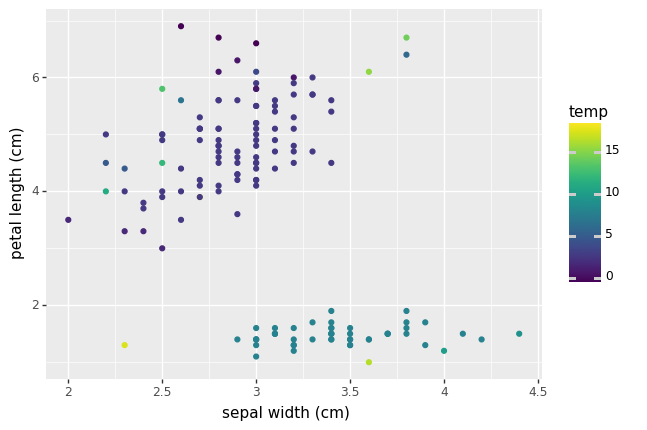

<ggplot: (8757736684261)>
CLuster9


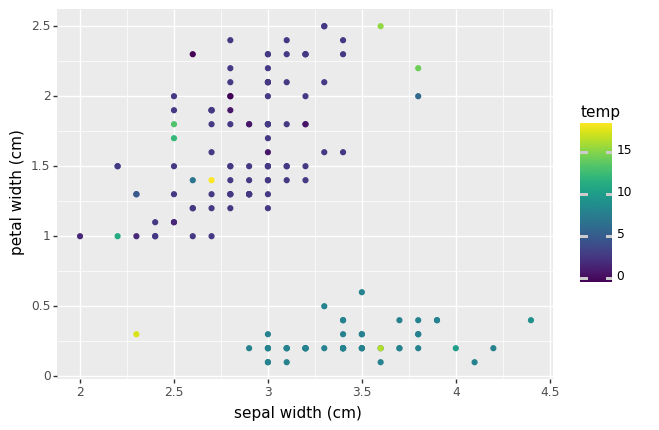

<ggplot: (8757737500349)>
CLuster9


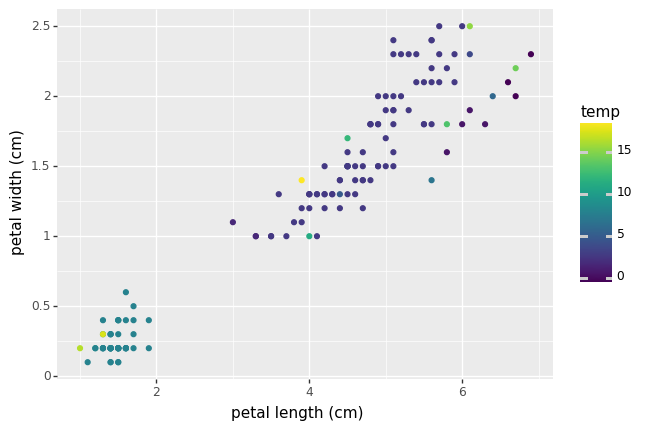

<ggplot: (8757735479729)>
0.9000000000000001


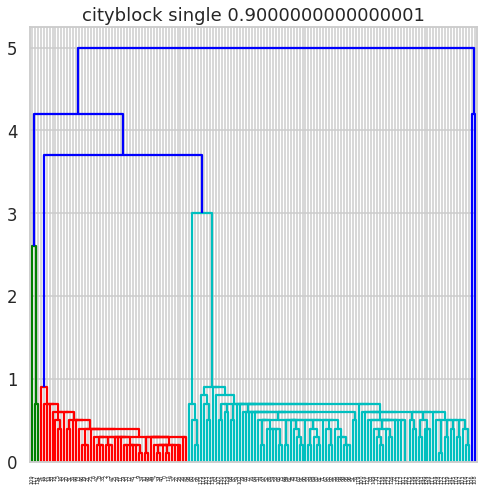

CLuster9


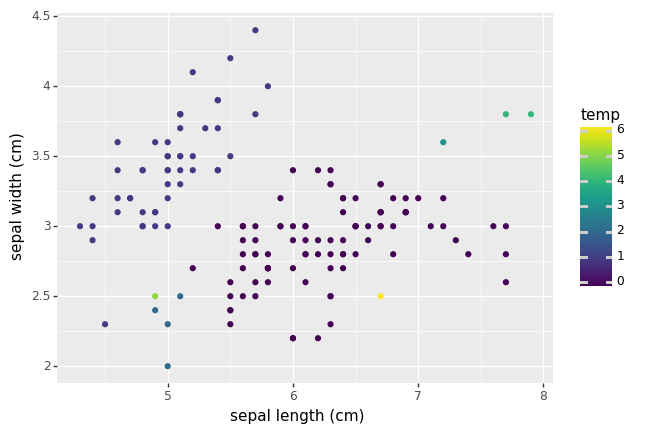

<ggplot: (8757736502797)>
CLuster9


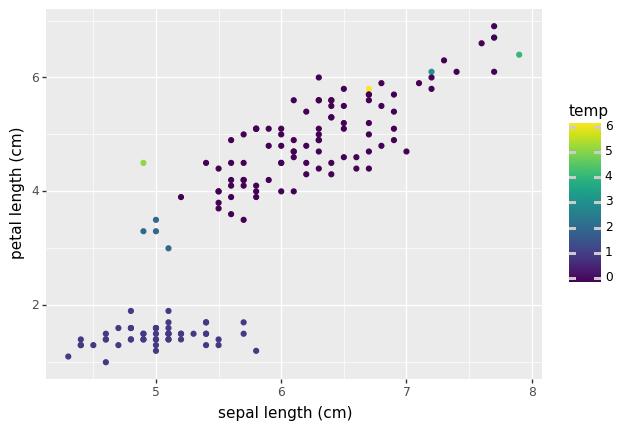

<ggplot: (8757736462085)>
CLuster9


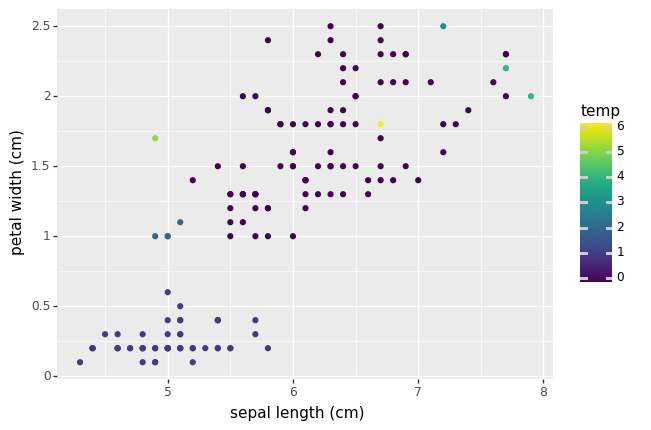

<ggplot: (8757736112117)>
CLuster9


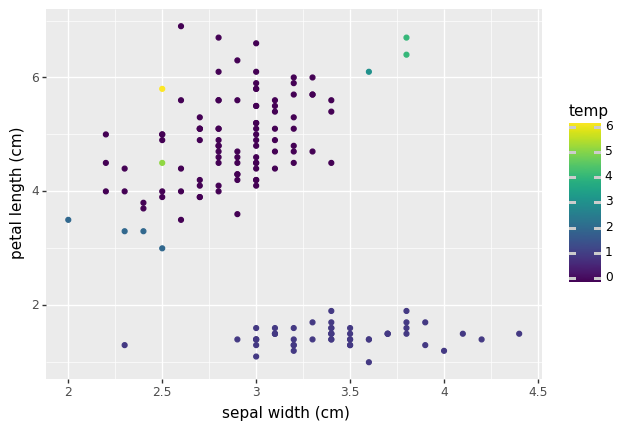

<ggplot: (8757736738105)>
CLuster9


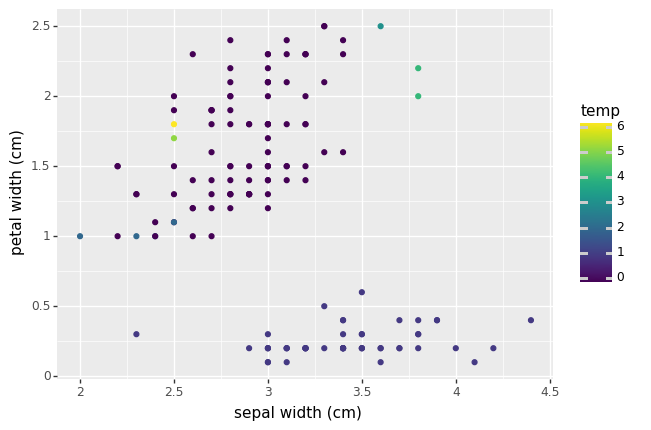

<ggplot: (8757736521829)>
CLuster9


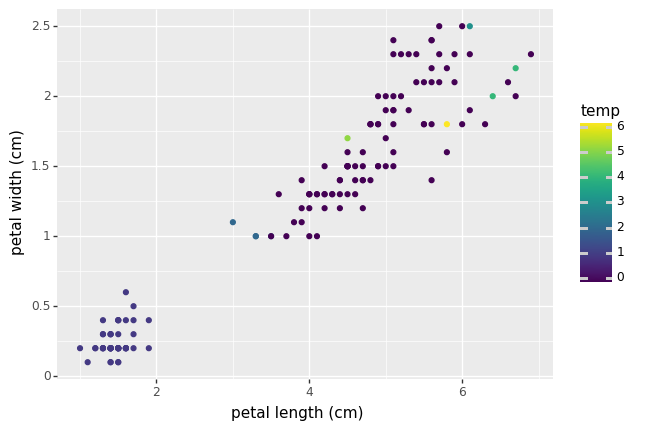

<ggplot: (8757737349657)>
1.1


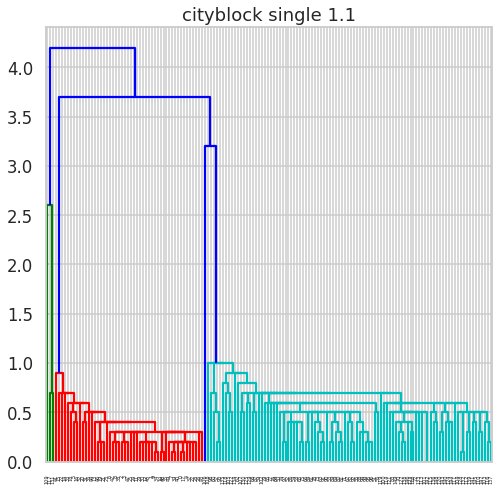

CLuster9


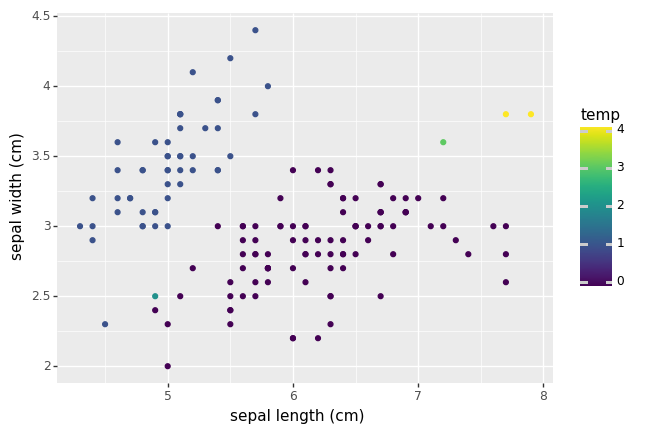

<ggplot: (8757737132557)>
CLuster9


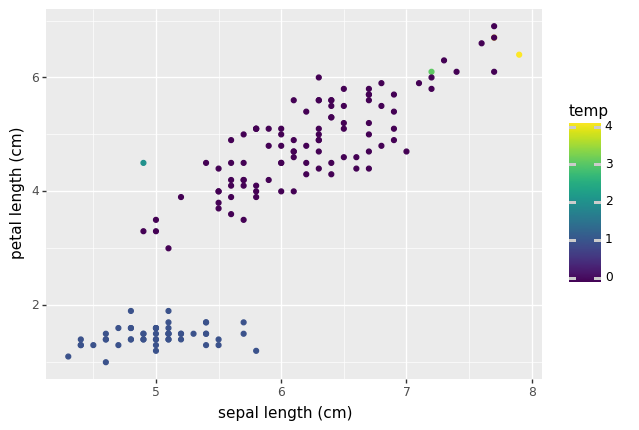

<ggplot: (8757737345933)>
CLuster9


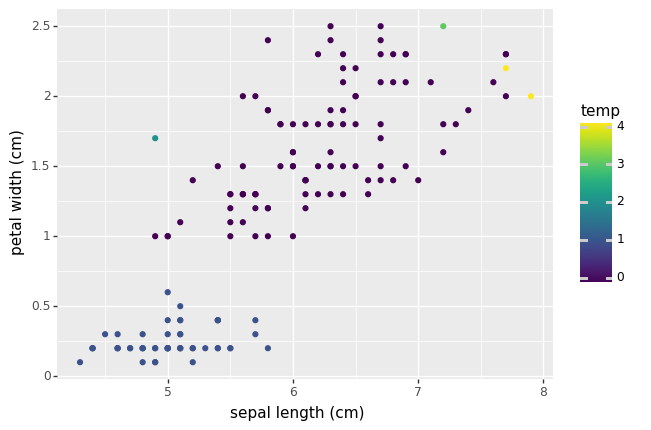

<ggplot: (8757736253985)>
CLuster9


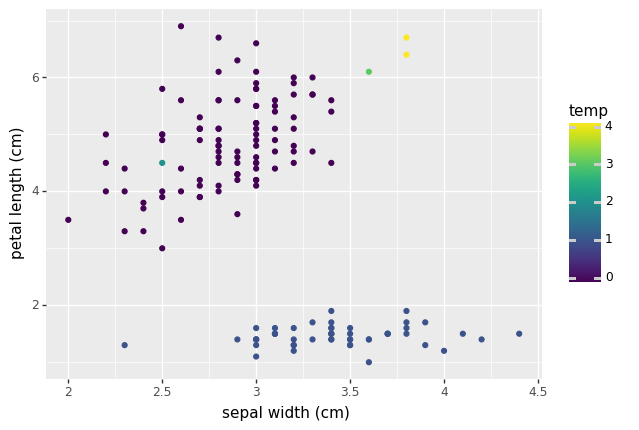

<ggplot: (8757739132457)>
CLuster9


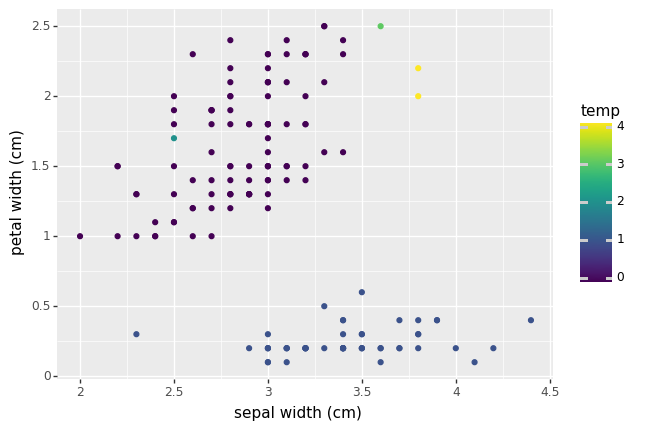

<ggplot: (8757736501713)>
CLuster9


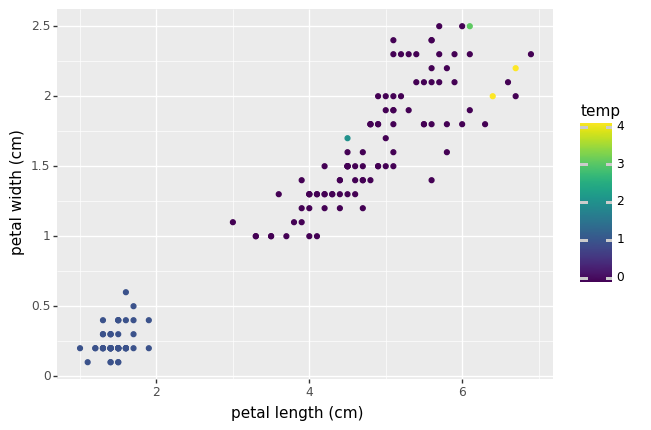

<ggplot: (8757736736113)>
1.3


KeyboardInterrupt: ignored

In [ ]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering


def display_hierarchal_cluster(X,km=[],num_clusters=0):
    alpha = 0.5  
    s = 20
    P=list(range(0,num_clusters+1))
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = 'r',alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[:,0],X[:,1],c =km.labels_,alpha = alpha,s=s)
        plt.show()

Affinity_list=['cityblock','euclidean','cosine']
Linkage_list=['average','single']
distance_range=np.arange(0.3, 2, 0.2)
best_silote_trails=['0.0','0.0','0.0','0.0']

a=0
while len(Affinity_list) -1 >= a :
  print(Affinity_list[a])
  l=0

  while len(Linkage_list) -1 >= l :
    print(Linkage_list[l])
    d=0

    while len(distance_range) -1 >= d :
      print(distance_range[d])
      if 'temp' in mydf_feat.columns:
        mydf_feat.drop('temp', axis=1, inplace=True)
      HIC = AgglomerativeClustering(distance_threshold=distance_range[d], n_clusters=None,affinity=Affinity_list[a],linkage=Linkage_list[l])
      HIC.fit(mydf_feat)
      mydf_feat['temp']=HIC.labels_
      temp=len(np.unique(HIC.labels_))
      if(temp!=1):
        single_iteration=silhouette_score(mydf_feat, HIC.labels_)
        if(float(best_silote_trails[0])<single_iteration):
          best_silote_trails=[str(single_iteration),Affinity_list[a],Linkage_list[l],str(distance_range[d].round(2))]
          print(best_silote_trails)
        linkage_type = linkage(mydf_feat, Linkage_list[l],metric=Affinity_list[a])
        plt.title(Affinity_list[a] +" "+Linkage_list[l]+" "+str(distance_range[d]))
        displaycl = dendrogram(linkage_type,truncate_mode='level')
        plt.show()
        mydf_feat_col=len(range(len(mydf_feat.columns)-1))
        c=len(mydf_feat.columns)-1
        j=0
        while mydf_feat_col >j:
          for u in range(c-1):
            u+=1
            u+=j
            print("CLuster" + str(i))
            print(ggplot(mydf_feat,aes(x=mydf_feat.columns[j],y=mydf_feat.columns[u],color='temp')) + geom_point() )
          c-=1
          j+=1
      d+=1
    l+=1
  a+=1
 
print("The max Silhouette Score is" + best_silote_trails[0] + "with affinity equal to"  + best_silote_trails[1] +  "and linkage equal to" + best_silote_trails[2] + "with distance_threshold"+ best_silote_trails[3] )


##GAUSSIAN

In [ ]:
types_of_covar=['tied','diag','full']
i=0
while len(types_of_covar) > i :
  EM=GaussianMixture(n_components =3,covariance_type=types_of_covar[i])
  EM.fit(mydf_feat)
  print("Type",str(i))
  print(EM.predict_proba(mydf_feat))
  i+=1



## Customer dataset
Repeat all the above on the customer data set 

In [4]:
df_customer= pd.read_csv("/Customer data.csv")
df_customer = df_customer.drop('ID', 1)
# X=df.values
# sc=StandardScaler()
# sc.fit(X)
# X=sc.transform(X)
df_customer.head(5)

,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,0,0,67,2,124670,1,2
1,1,1,22,1,150773,1,2
2,0,0,49,1,89210,0,0
3,0,0,45,1,171565,1,1
4,0,0,53,1,149031,1,1


##KMEANS Customer dataset

CLuster2


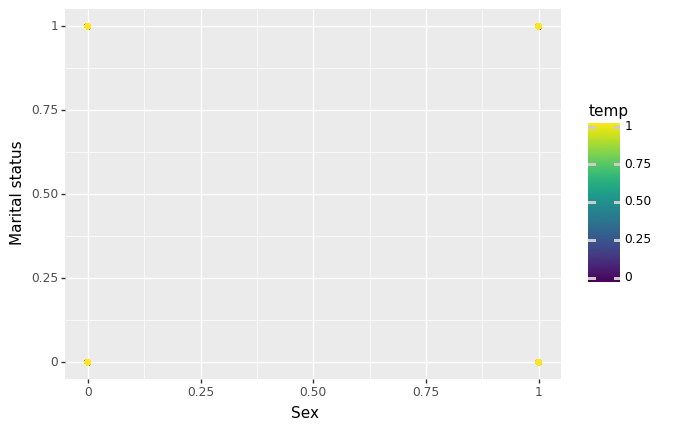

<ggplot: (8766039730021)>
CLuster2


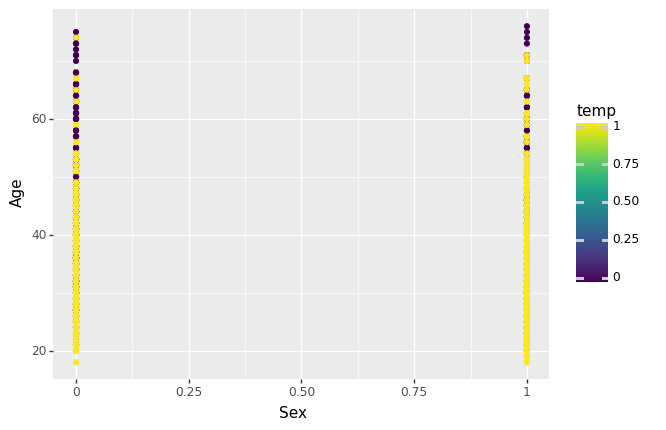

<ggplot: (8766039705557)>
CLuster2


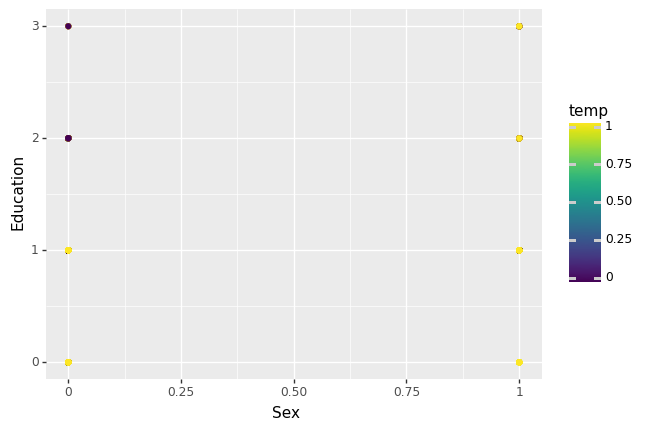

<ggplot: (8766039311861)>
CLuster2


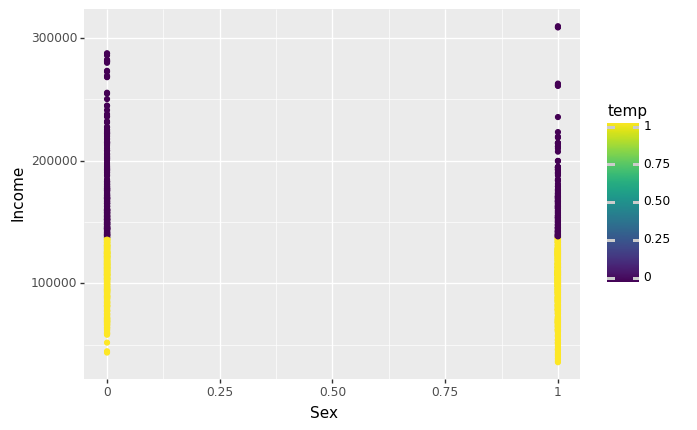

<ggplot: (8766039260557)>
CLuster2


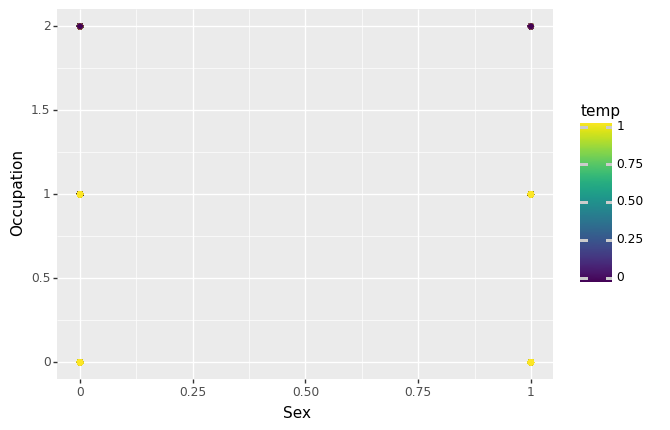

<ggplot: (8766039657221)>
CLuster2


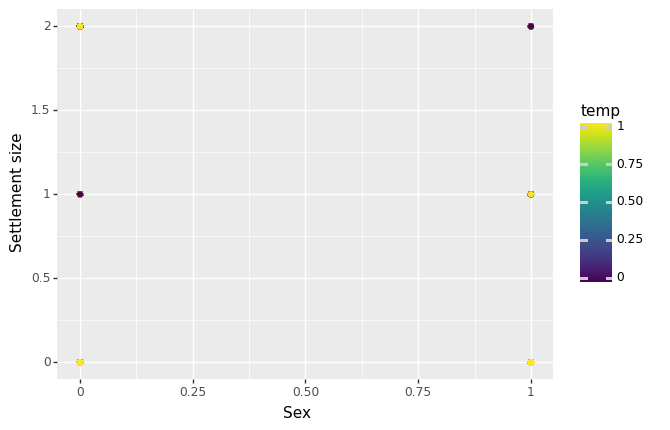

<ggplot: (8766039164289)>
CLuster2


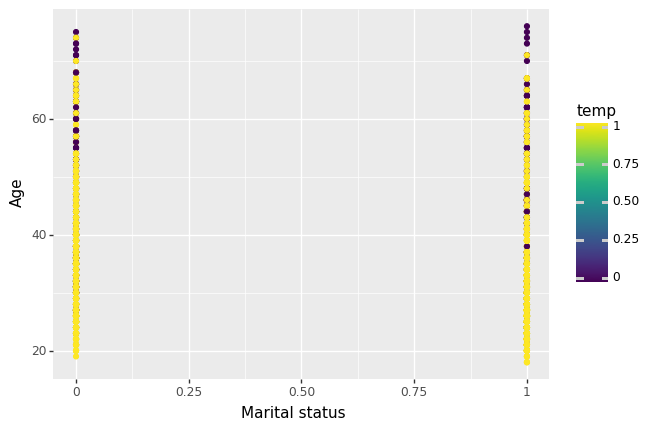

<ggplot: (8766039117477)>
CLuster2


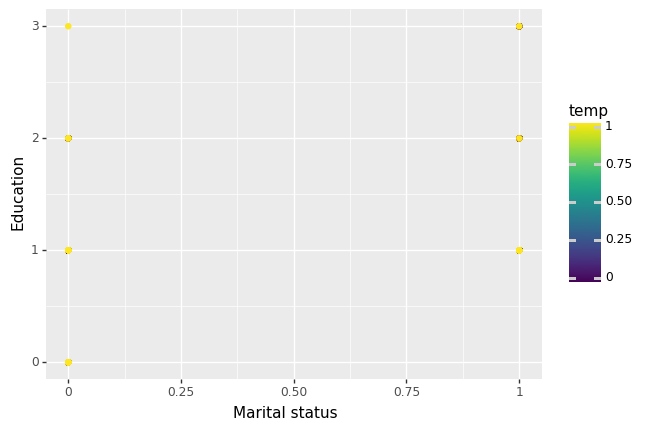

<ggplot: (8766039164373)>
CLuster2


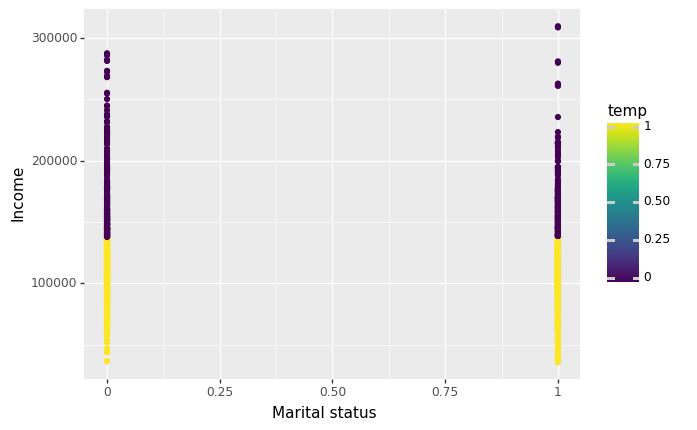

<ggplot: (8766039030213)>
CLuster2


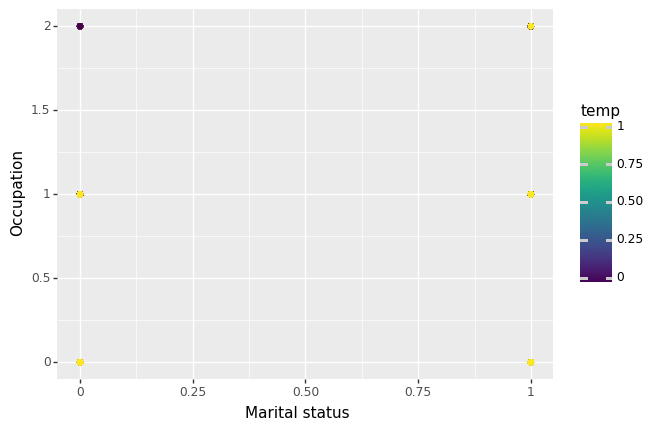

<ggplot: (8766038978557)>
CLuster2


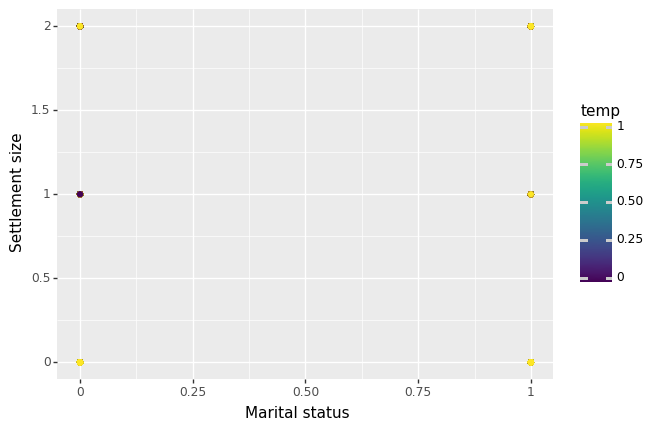

<ggplot: (8766039043817)>
CLuster2


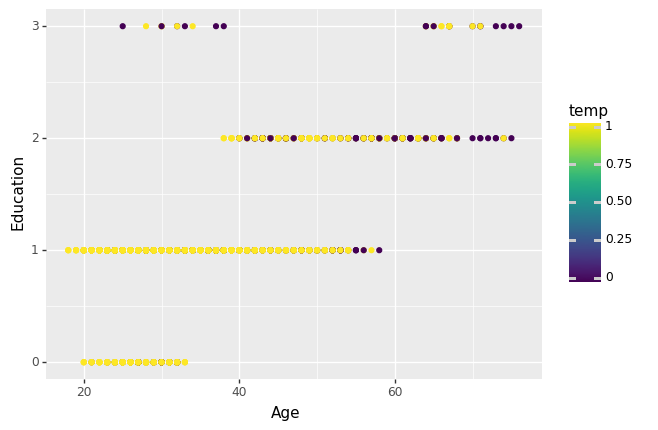

<ggplot: (8766038871125)>
CLuster2


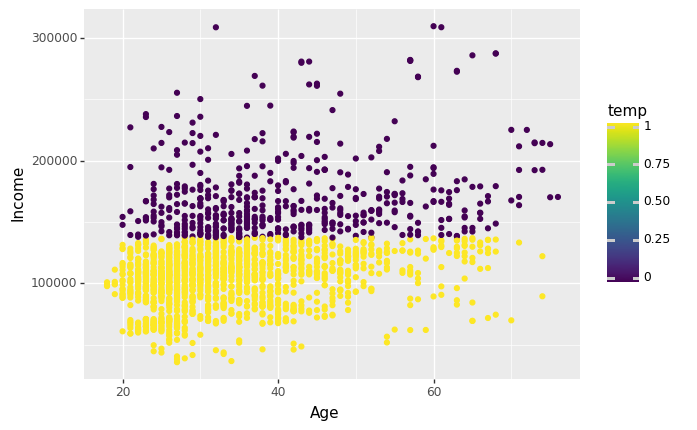

<ggplot: (8766038815613)>
CLuster2


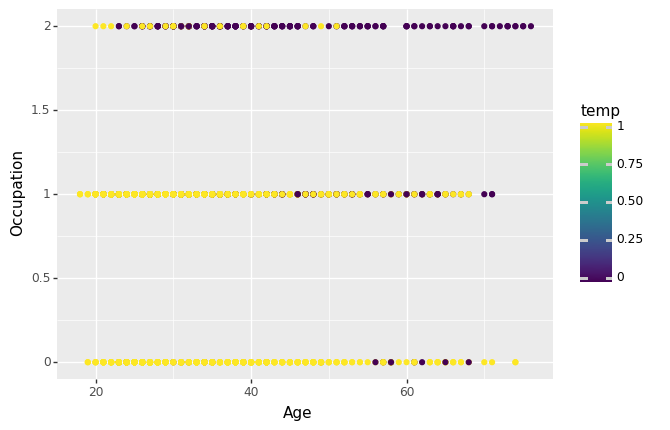

<ggplot: (8766039319445)>
CLuster2


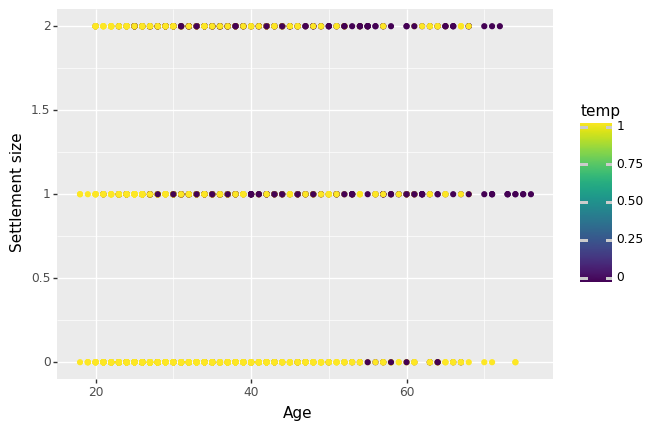

<ggplot: (8766057308985)>
CLuster2


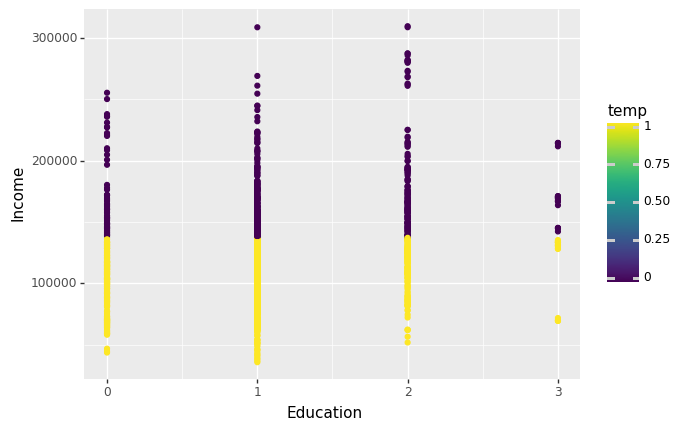

<ggplot: (8766038919365)>
CLuster2


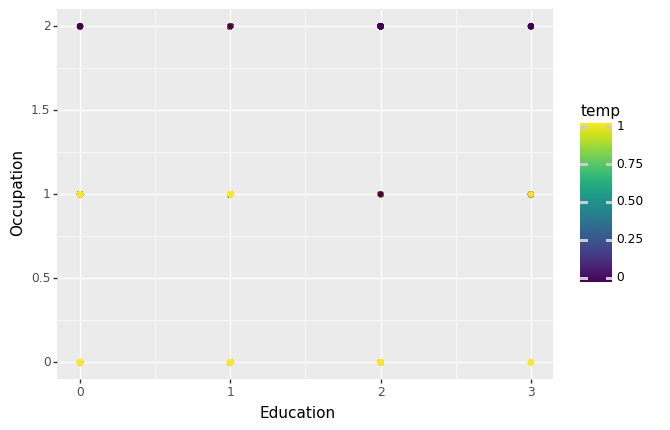

<ggplot: (8766038854581)>
CLuster2


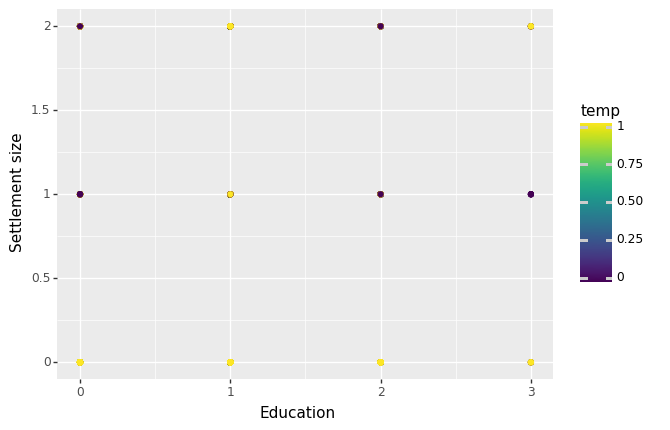

<ggplot: (8766038924169)>
CLuster2


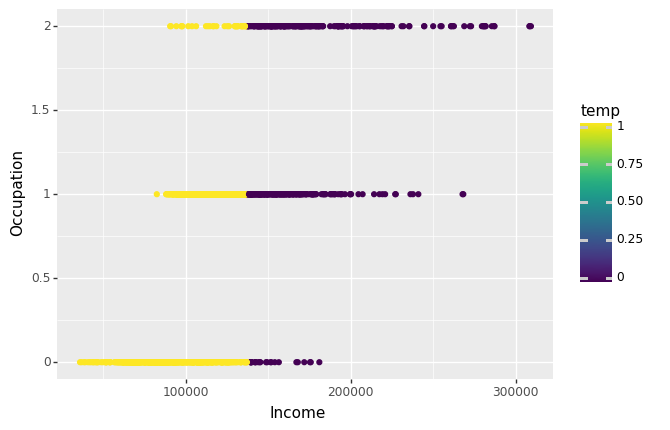

<ggplot: (8766038982277)>
CLuster2


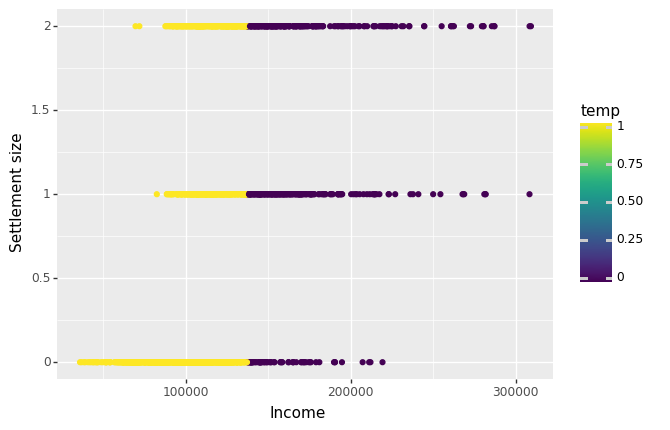

<ggplot: (8766038827589)>
CLuster2


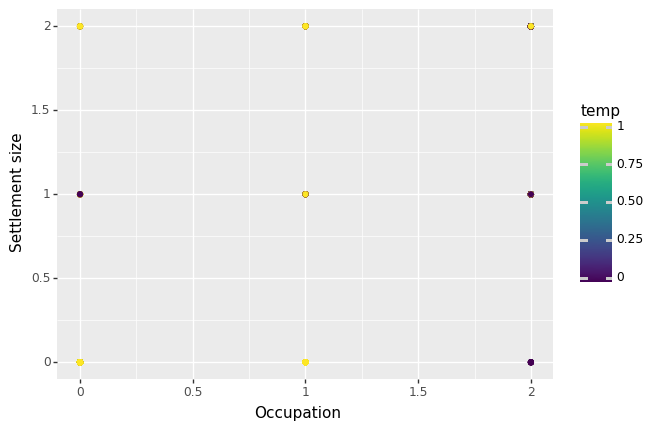

<ggplot: (8766038913317)>
CLuster3


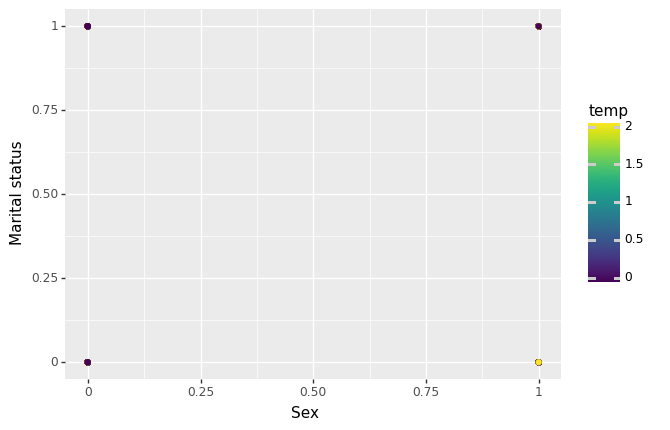

<ggplot: (8766039082185)>
CLuster3


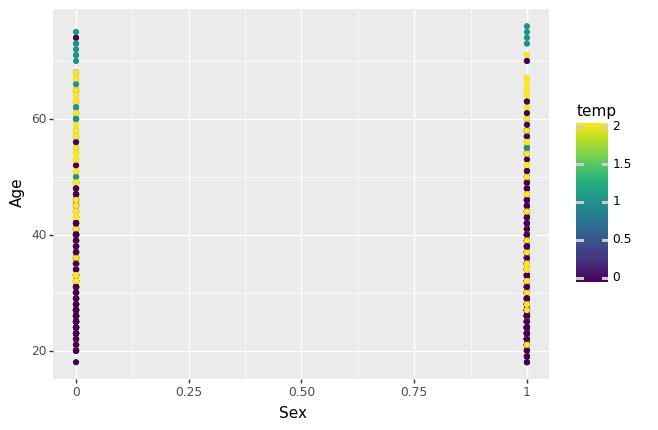

<ggplot: (8766039218305)>
CLuster3


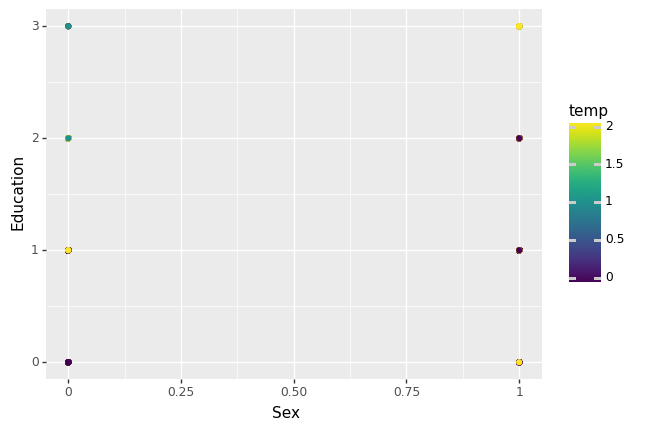

<ggplot: (8766039261893)>
CLuster3


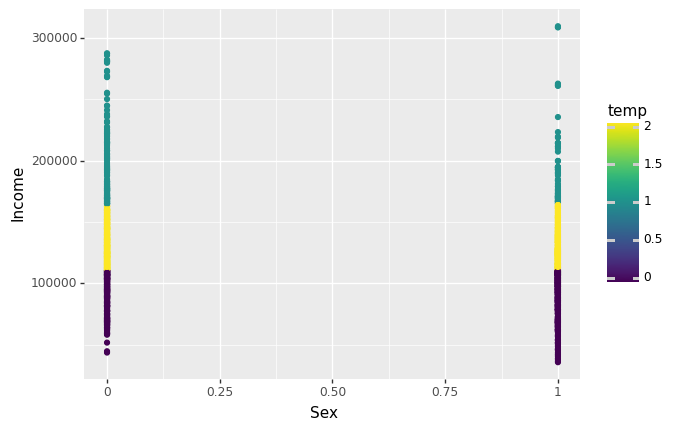

<ggplot: (8766038981293)>
CLuster3


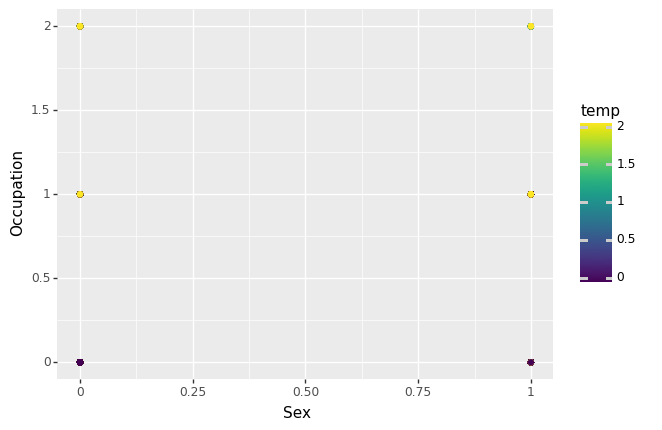

<ggplot: (8766037719221)>
CLuster3


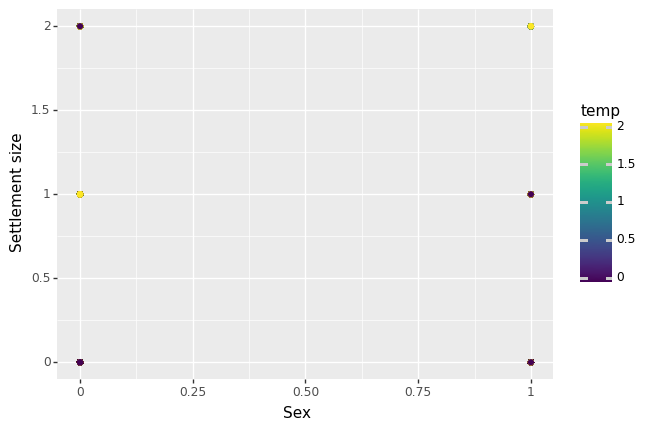

<ggplot: (8766039140621)>
CLuster3


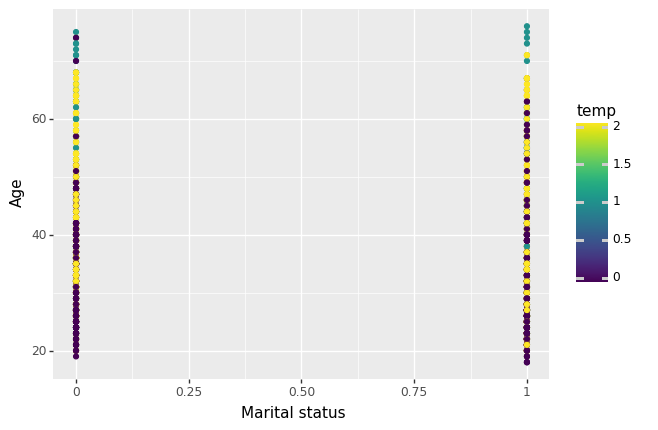

<ggplot: (8766037650745)>
CLuster3


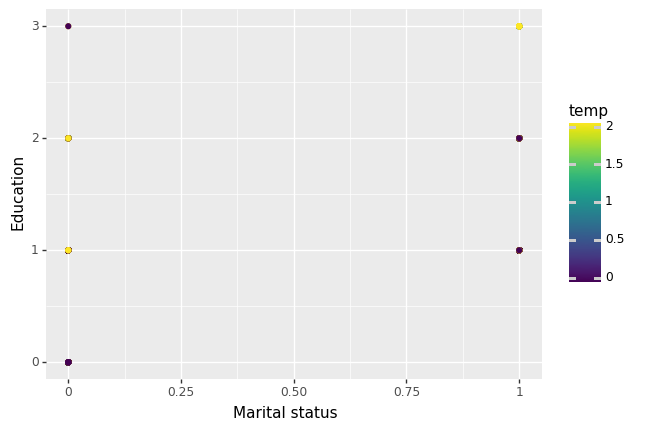

<ggplot: (8766039143485)>
CLuster3


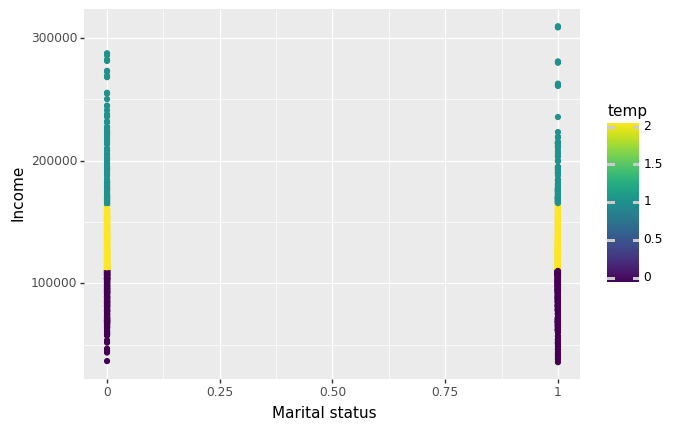

<ggplot: (8766037471289)>
CLuster3


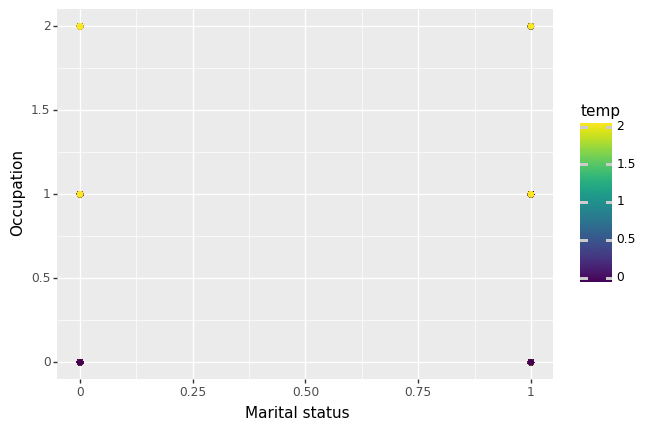

<ggplot: (8766037457489)>
CLuster3


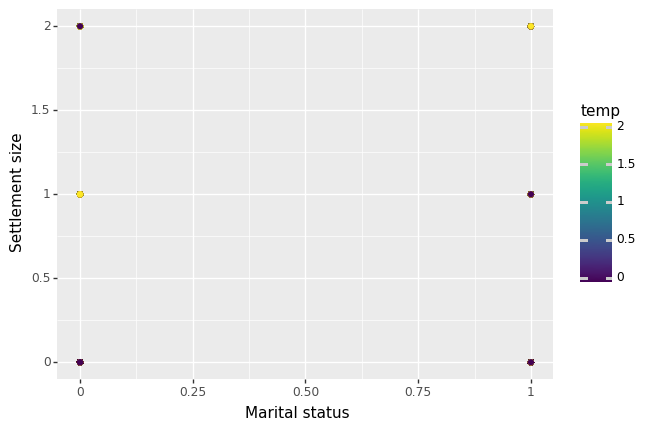

<ggplot: (8766038815665)>
CLuster3


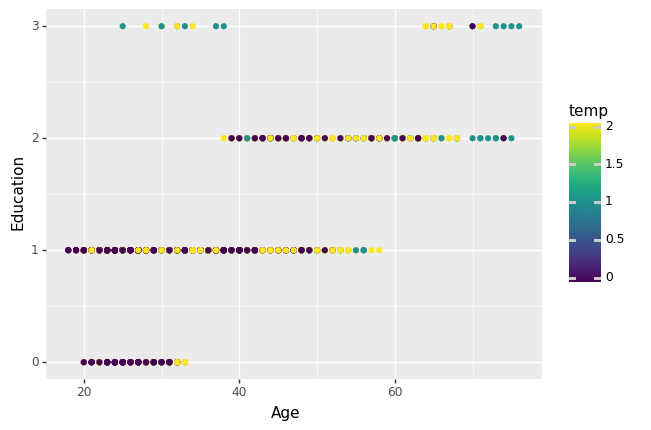

<ggplot: (8766039110037)>
CLuster3


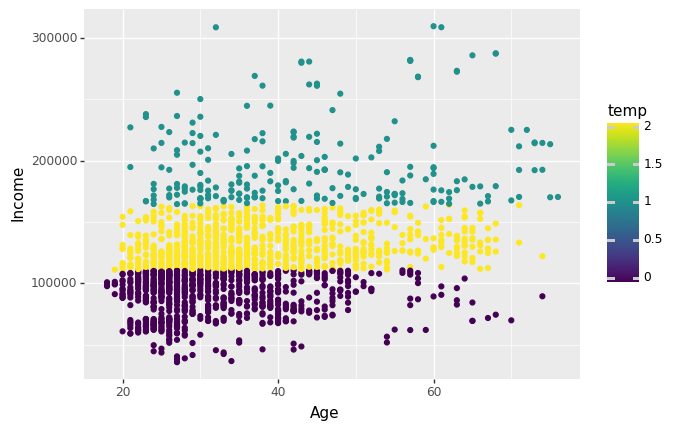

<ggplot: (8766038815721)>
CLuster3


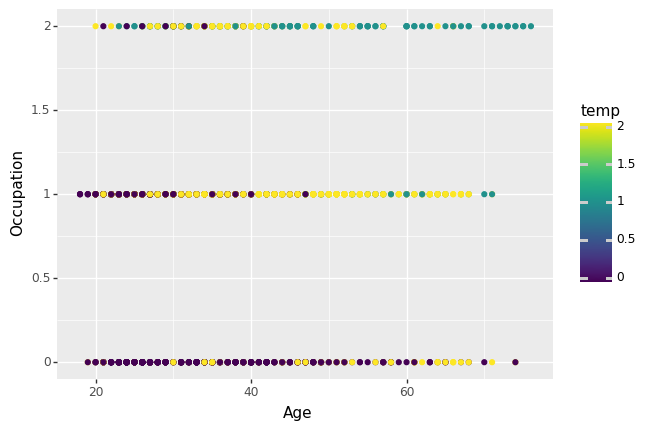

<ggplot: (8766038893673)>
CLuster3


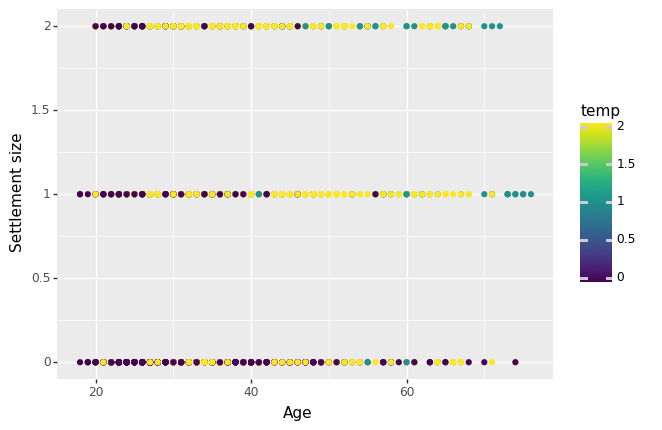

<ggplot: (8766037473517)>
CLuster3


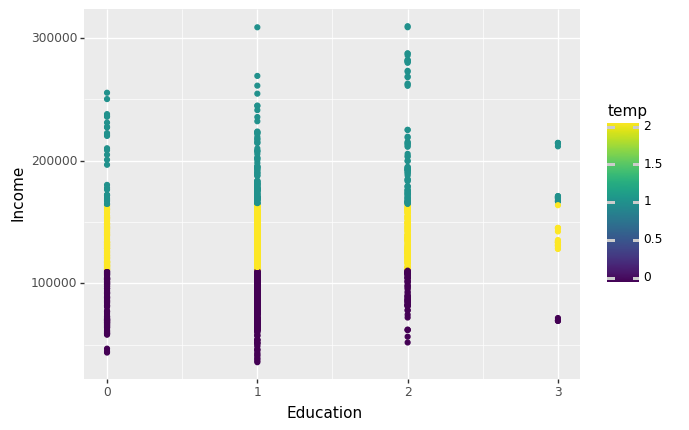

<ggplot: (8766039639049)>
CLuster3


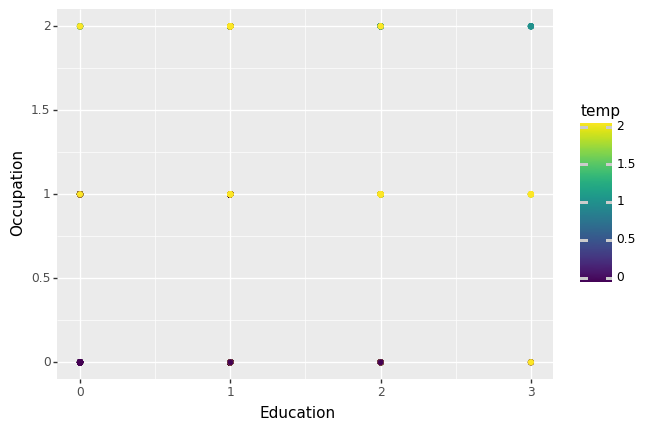

<ggplot: (8766039273445)>
CLuster3


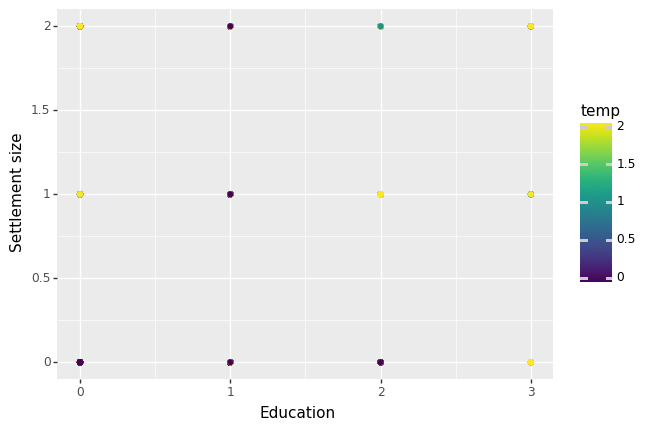

<ggplot: (8766039034849)>
CLuster3


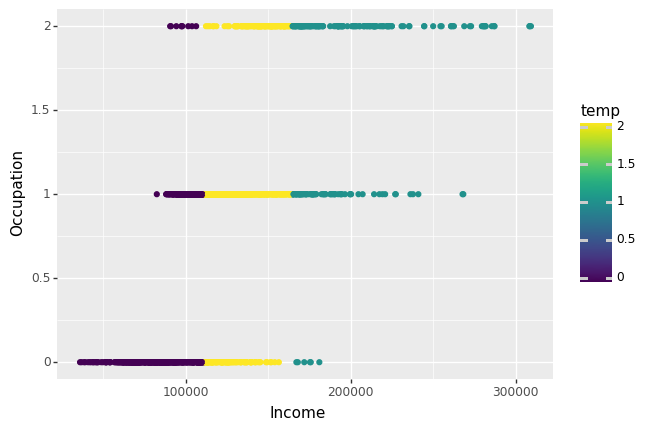

<ggplot: (8766037513813)>
CLuster3


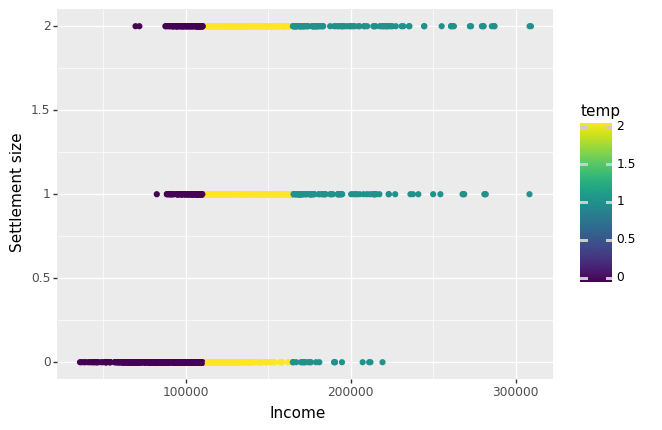

<ggplot: (8766037626913)>
CLuster3


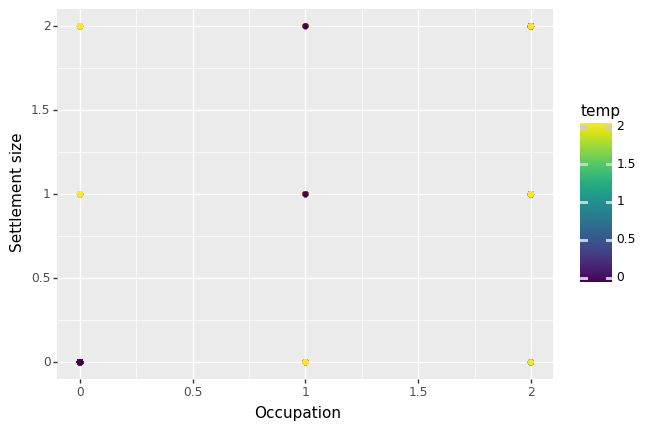

<ggplot: (8766039678025)>
CLuster4


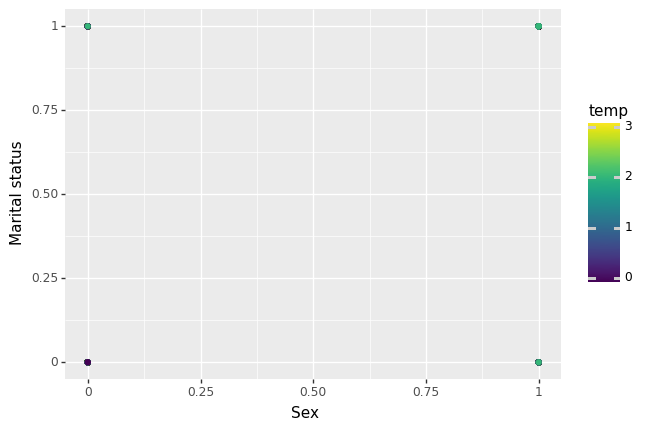

<ggplot: (8766039056109)>
CLuster4


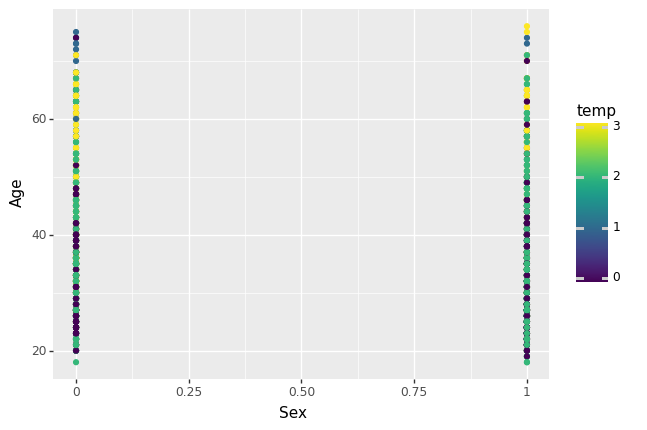

<ggplot: (8766039307213)>
CLuster4


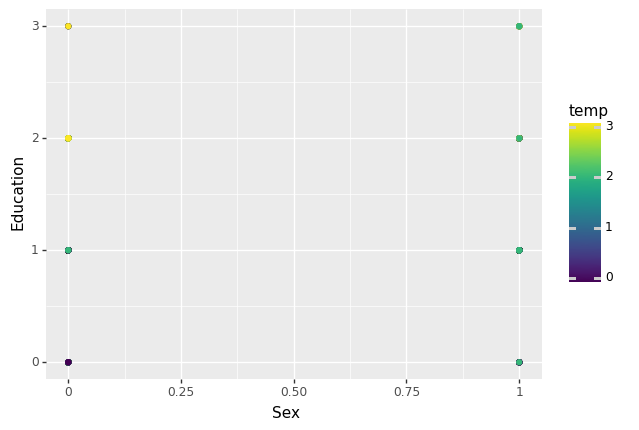

<ggplot: (8766037702829)>
CLuster4


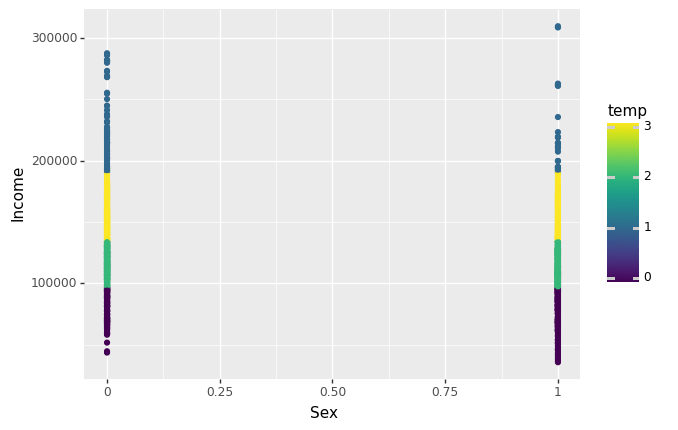

<ggplot: (8766039045765)>
CLuster4


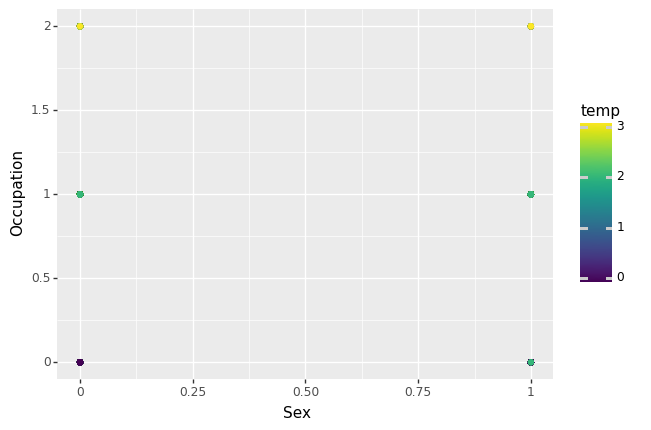

<ggplot: (8766037680225)>
CLuster4


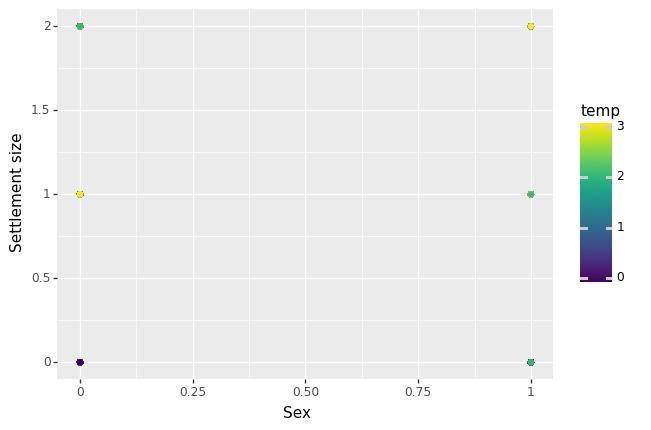

<ggplot: (8766039675745)>
CLuster4


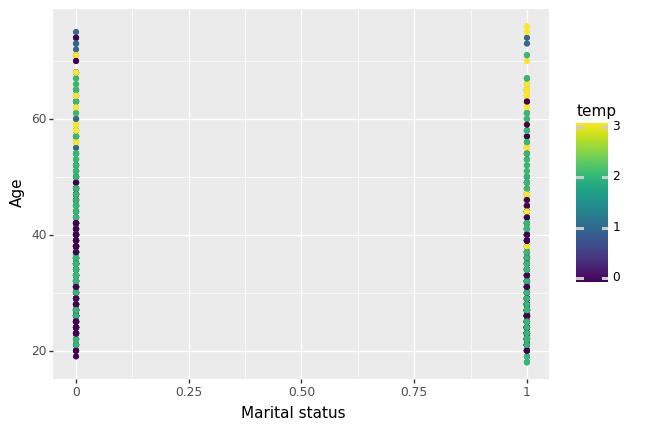

<ggplot: (8766037680221)>
CLuster4


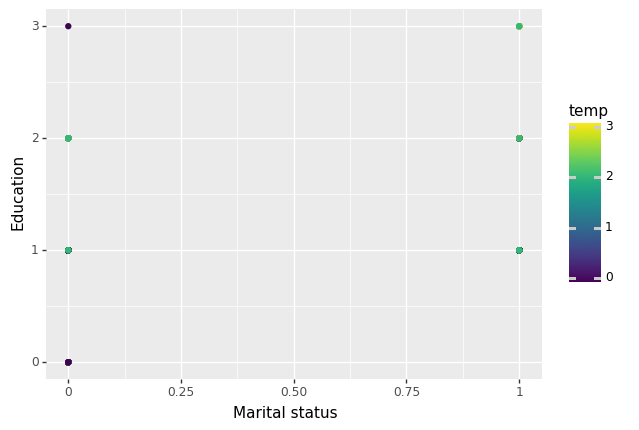

<ggplot: (8766037484593)>
CLuster4


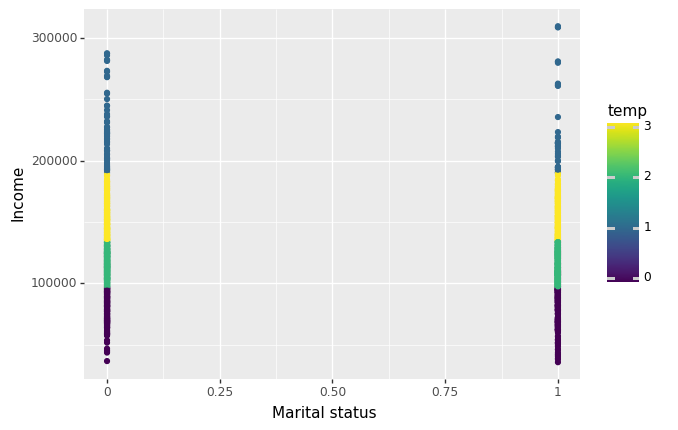

<ggplot: (8766037721845)>
CLuster4


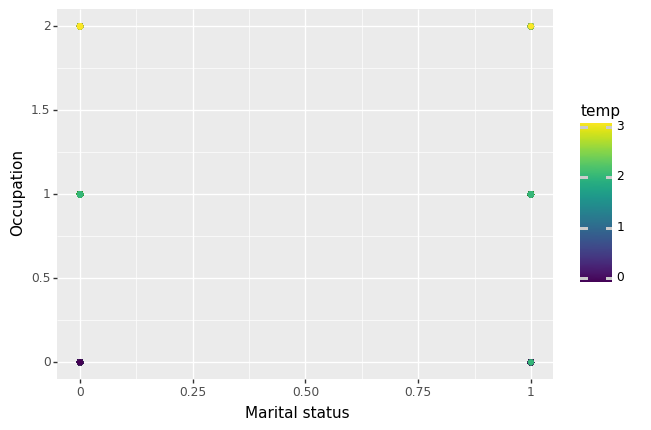

<ggplot: (8766039329813)>
CLuster4


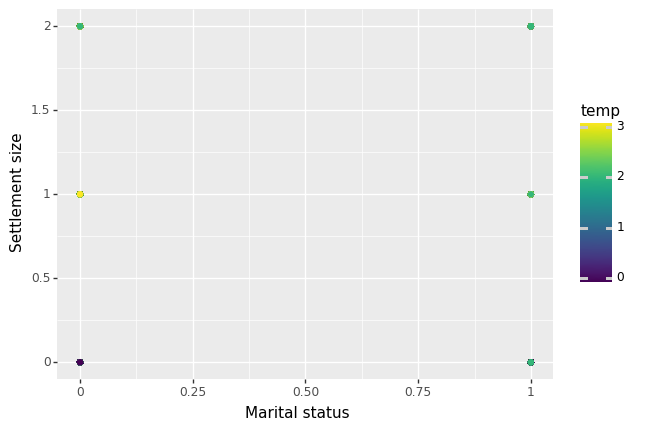

<ggplot: (8766039718265)>
CLuster4


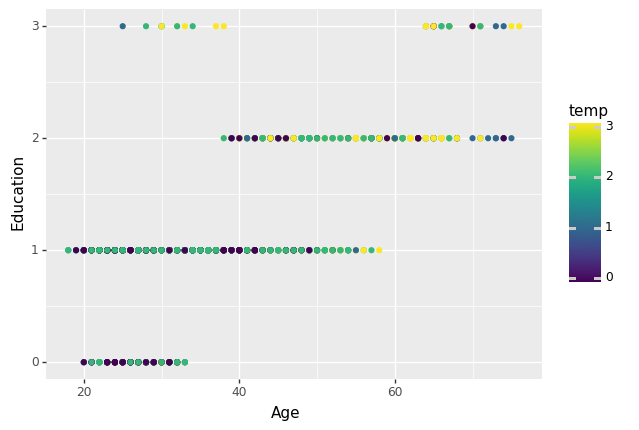

<ggplot: (8766039236093)>
CLuster4


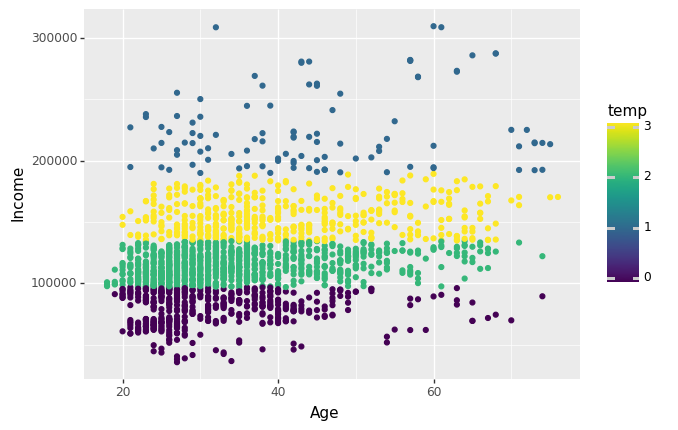

<ggplot: (8766039284453)>
CLuster4


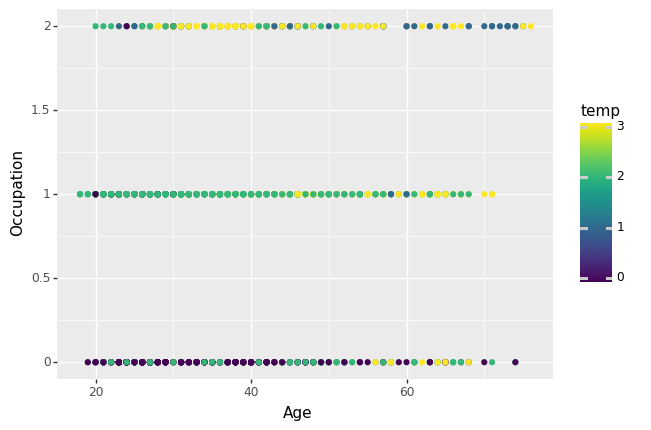

<ggplot: (8766038941633)>
CLuster4


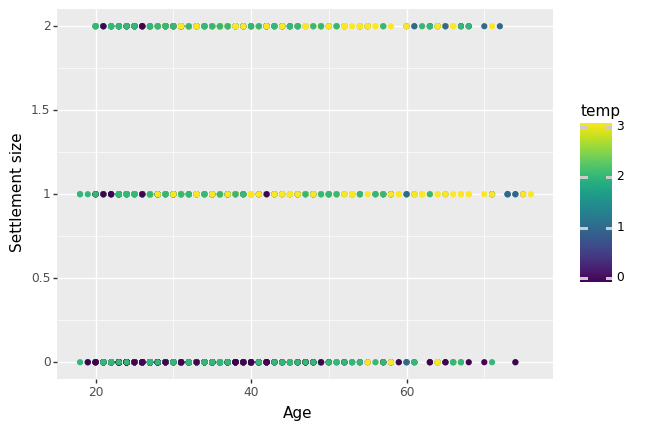

<ggplot: (8766037484353)>
CLuster4


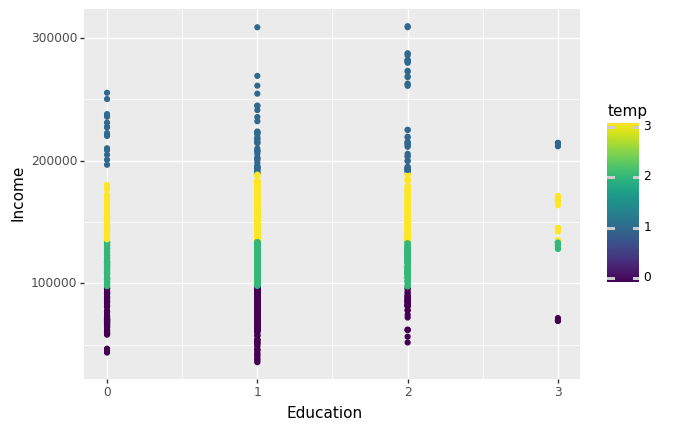

<ggplot: (8766037645817)>
CLuster4


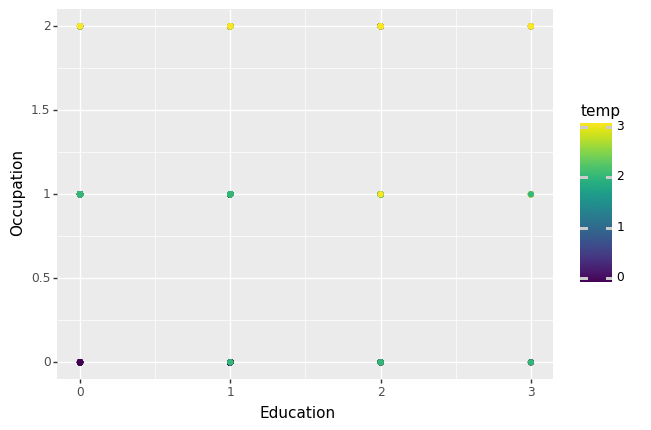

<ggplot: (8766037596273)>
CLuster4


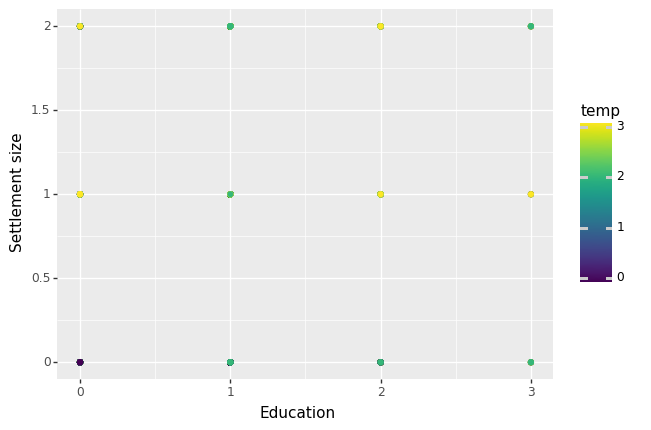

<ggplot: (8766037528429)>
CLuster4


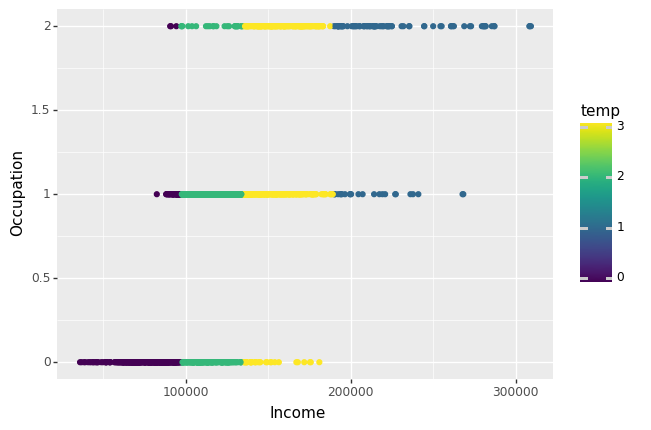

<ggplot: (8766038865857)>
CLuster4


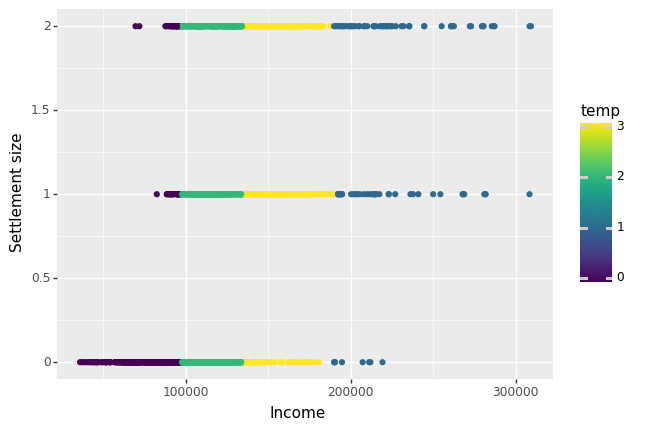

<ggplot: (8766038919381)>
CLuster4


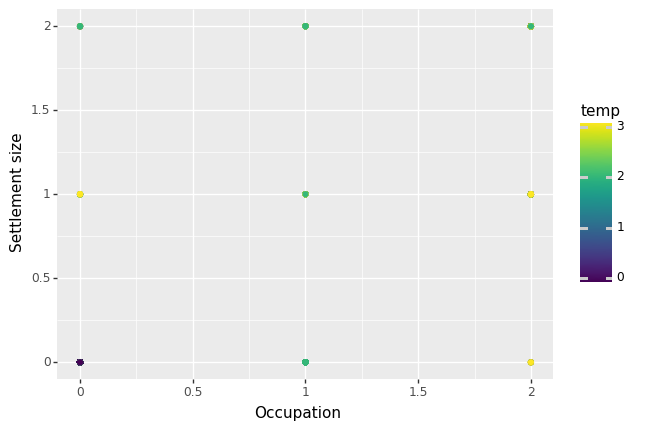

<ggplot: (8766039022737)>
CLuster5


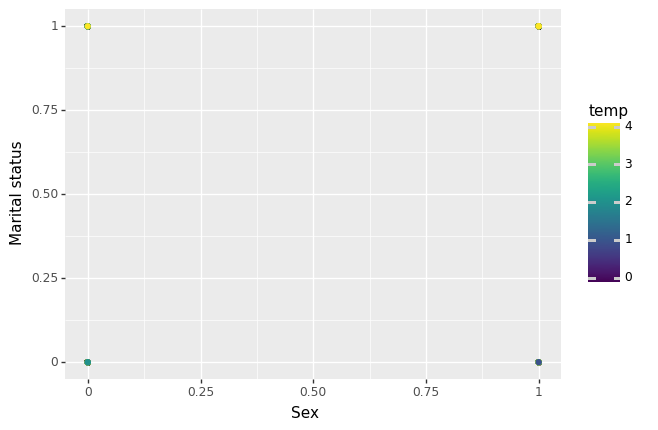

<ggplot: (8766038802897)>
CLuster5


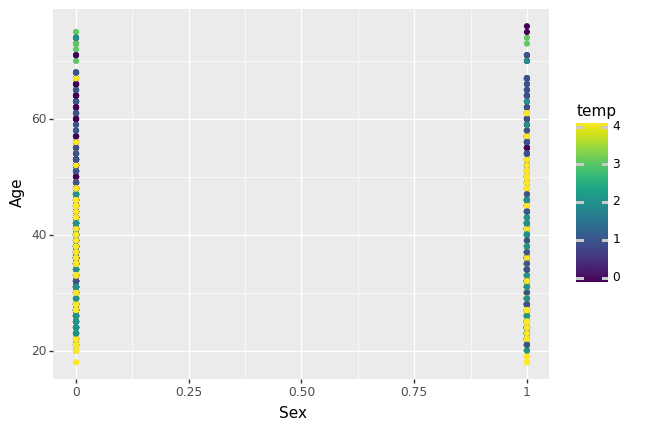

<ggplot: (8766037577181)>
CLuster5


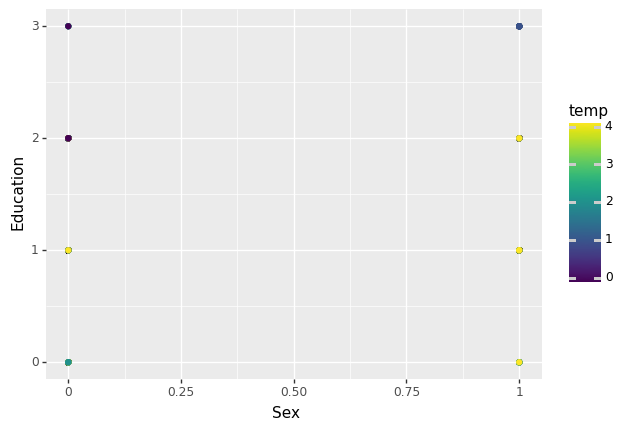

<ggplot: (8766039718185)>
CLuster5


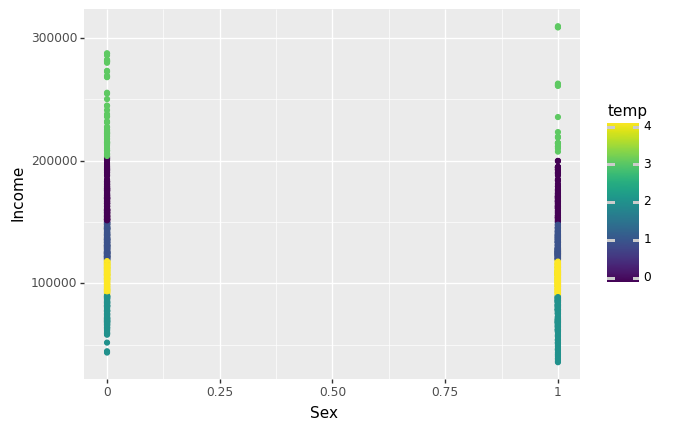

<ggplot: (8766039305893)>
CLuster5


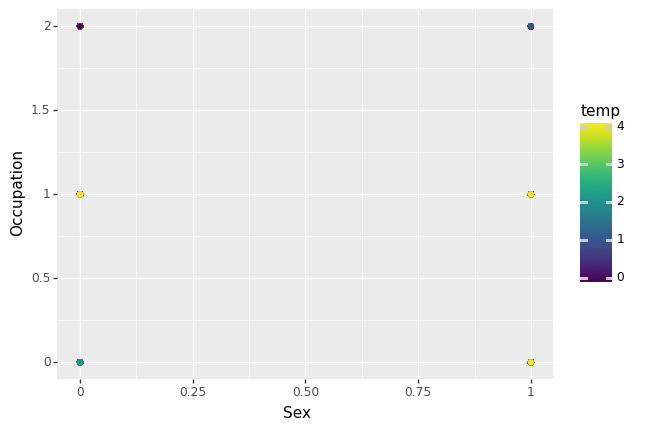

<ggplot: (8766039014637)>
CLuster5


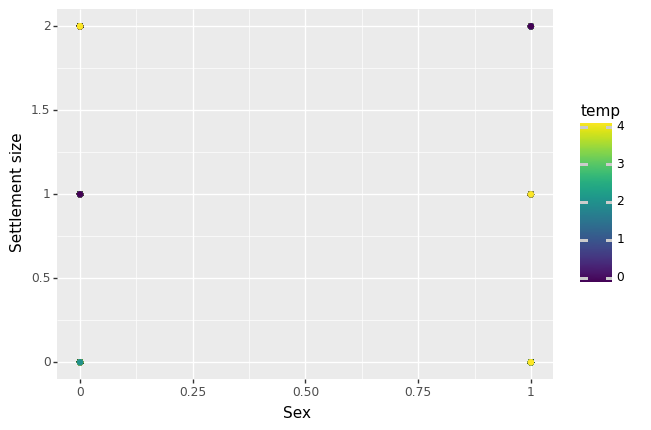

<ggplot: (8766038827653)>
CLuster5


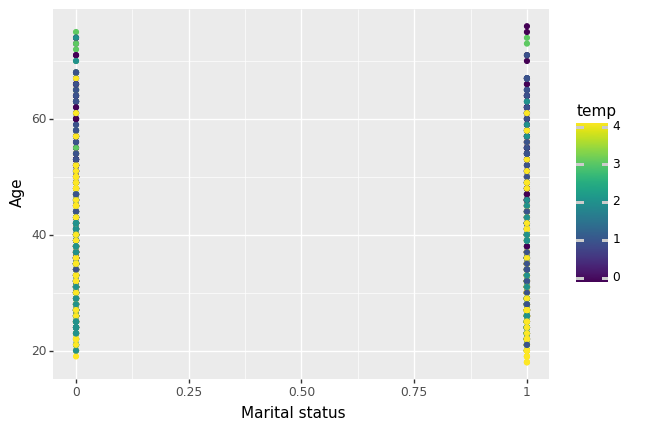

<ggplot: (8766039196157)>
CLuster5


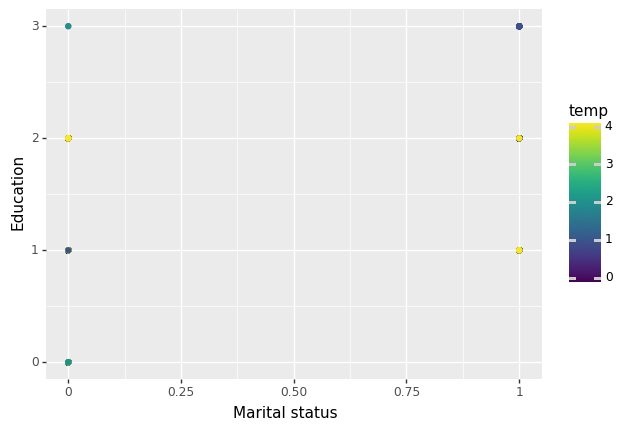

<ggplot: (8766039049713)>
CLuster5


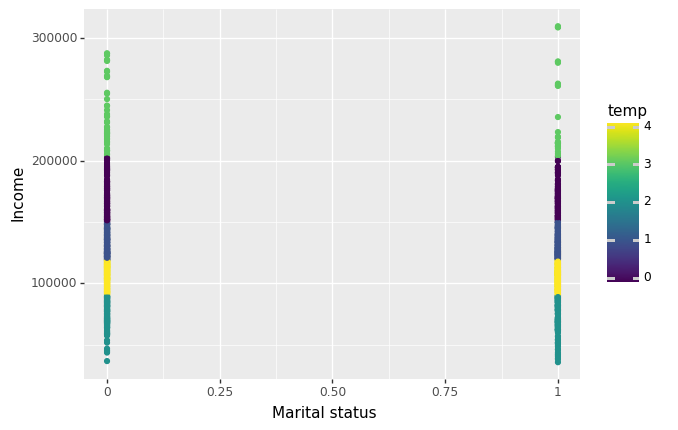

<ggplot: (8766039172045)>
CLuster5


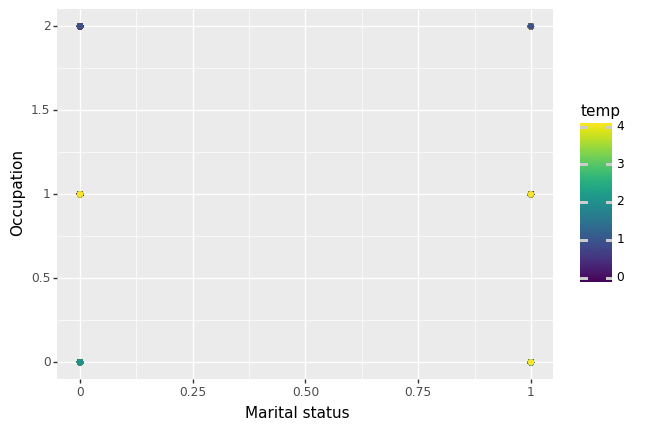

<ggplot: (8766039650465)>
CLuster5


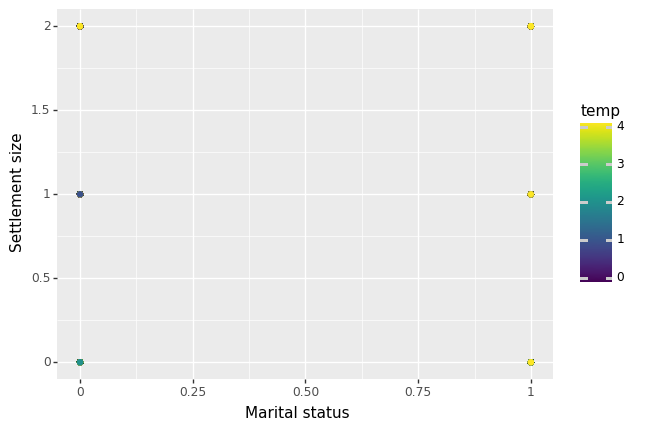

<ggplot: (8766039088573)>
CLuster5


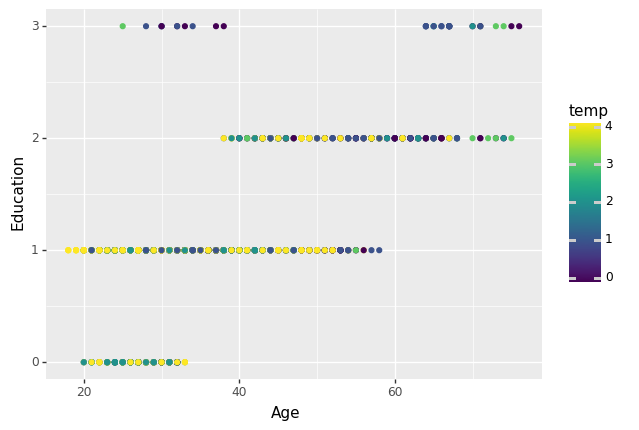

<ggplot: (8766039114481)>
CLuster5


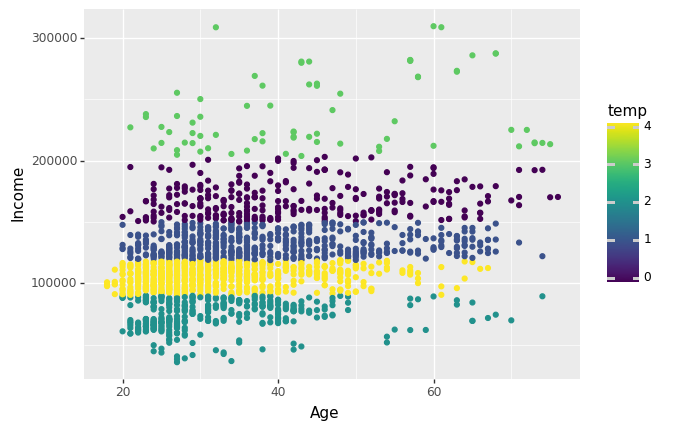

<ggplot: (8766039642589)>
CLuster5


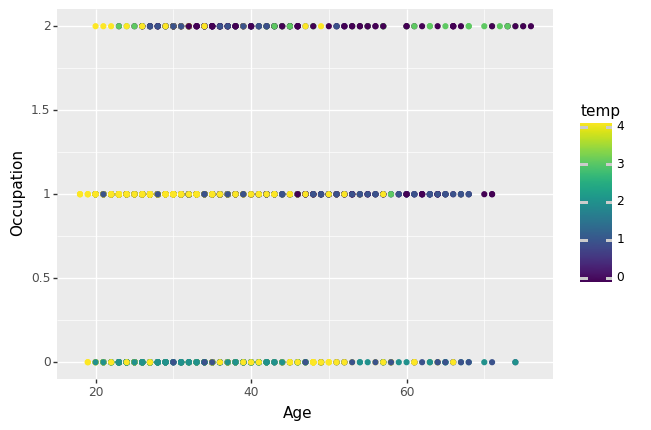

<ggplot: (8766039284405)>
CLuster5


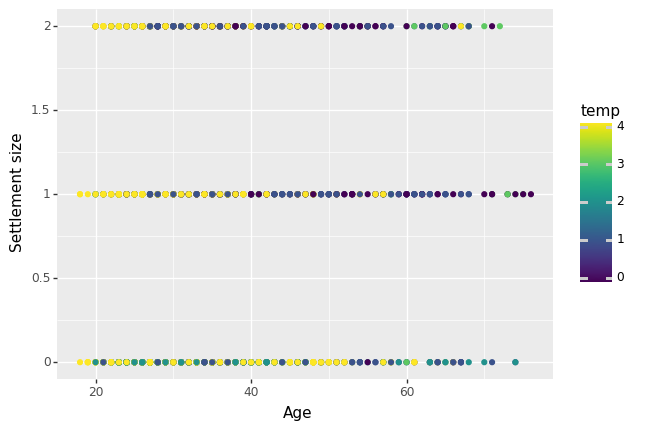

<ggplot: (8766039210213)>
CLuster5


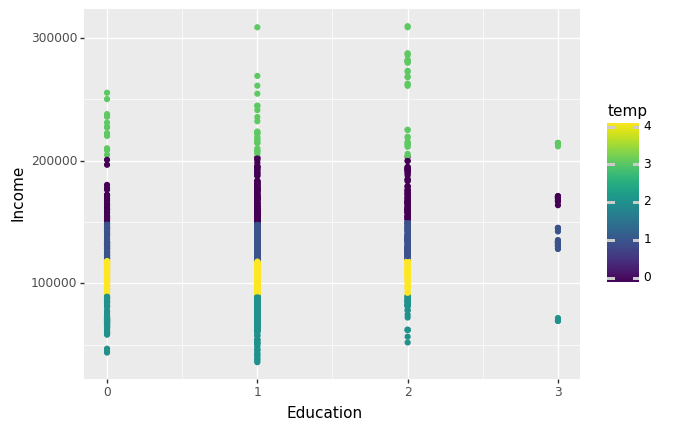

<ggplot: (8766037715689)>
CLuster5


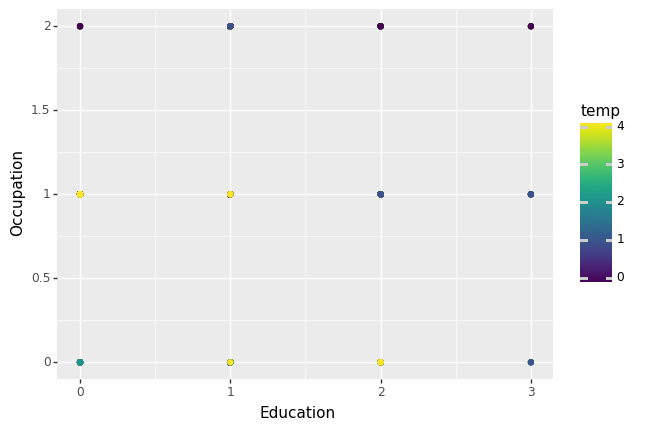

<ggplot: (8766037466473)>
CLuster5


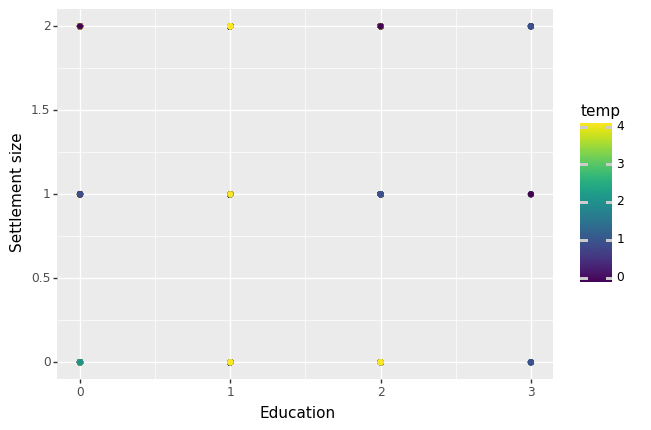

<ggplot: (8766037507905)>
CLuster5


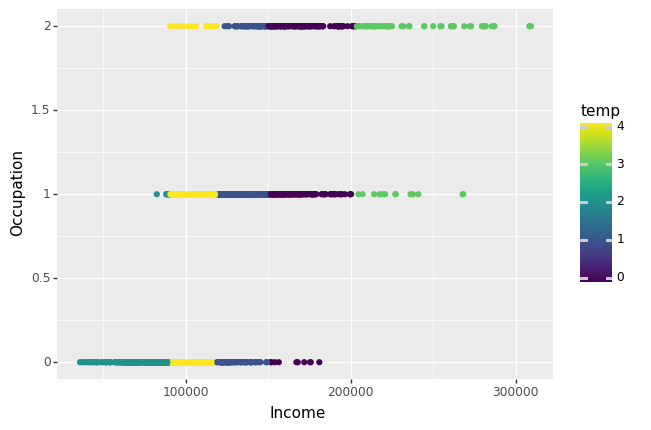

<ggplot: (8766039687177)>
CLuster5


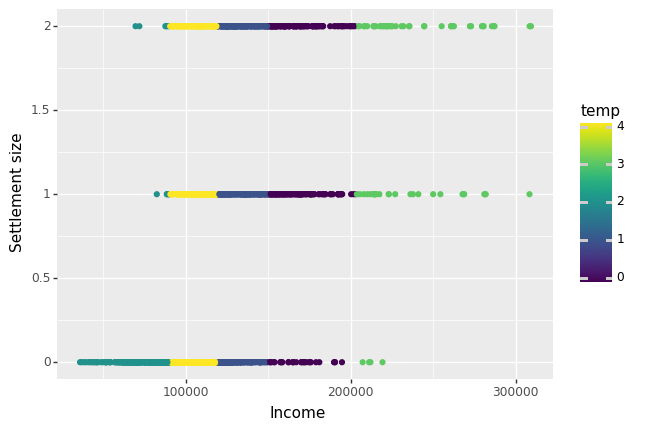

<ggplot: (8766039205301)>
CLuster5


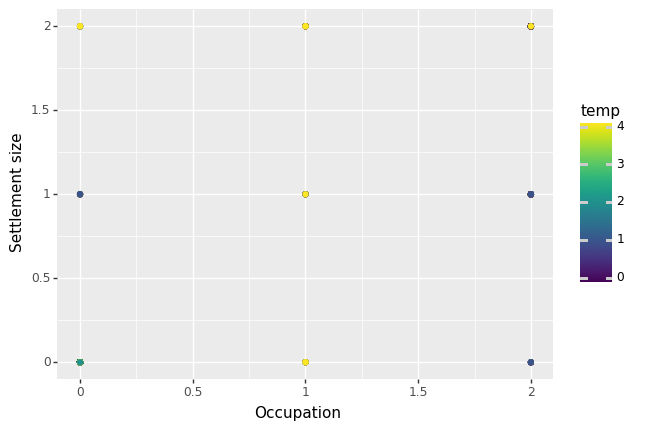

<ggplot: (8766038801361)>
CLuster6


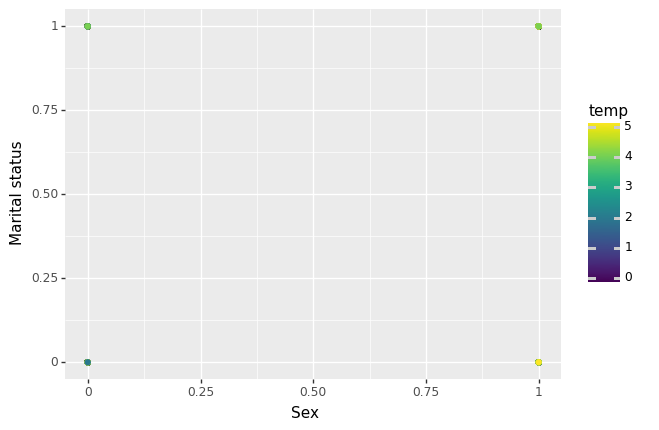

<ggplot: (8766039027221)>
CLuster6


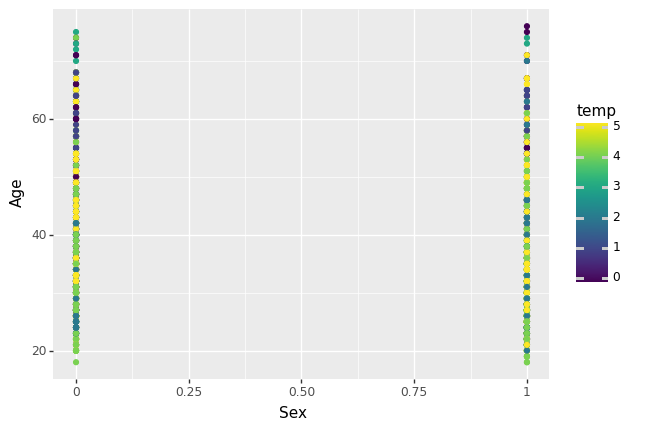

<ggplot: (8766039637077)>
CLuster6


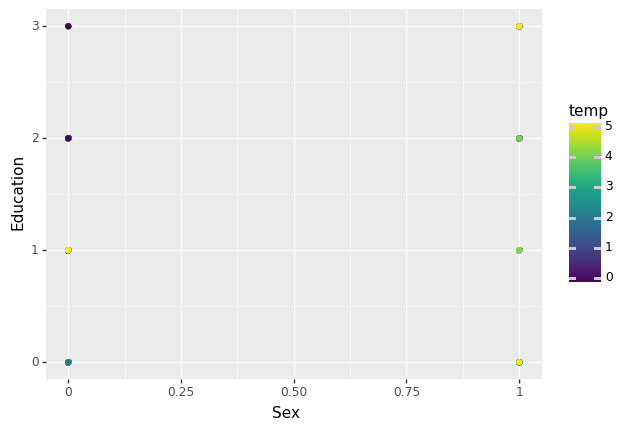

<ggplot: (8766039228145)>
CLuster6


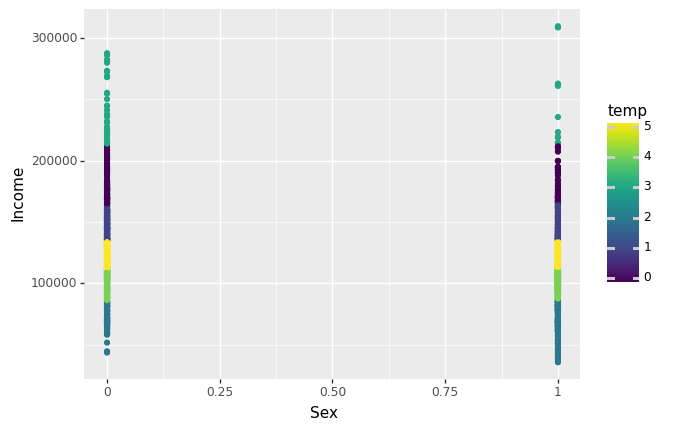

<ggplot: (8766038923149)>
CLuster6


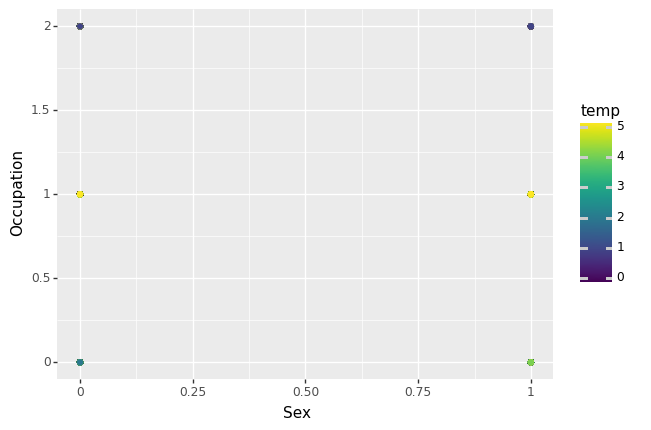

<ggplot: (8766037467909)>
CLuster6


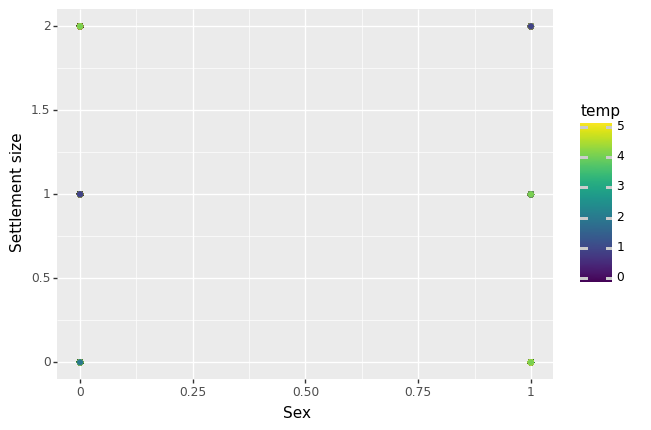

<ggplot: (8766037502421)>
CLuster6


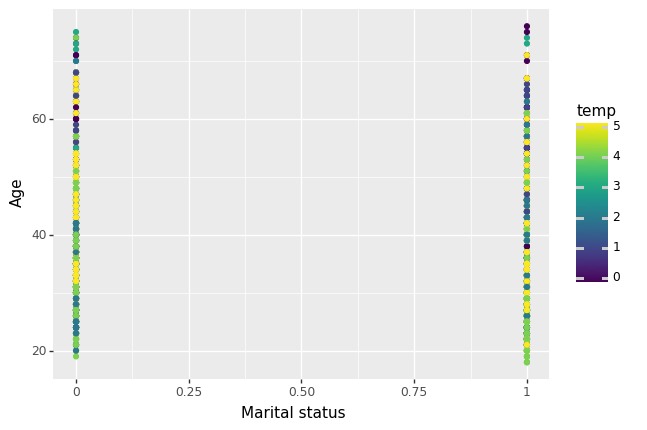

<ggplot: (8766039705397)>
CLuster6


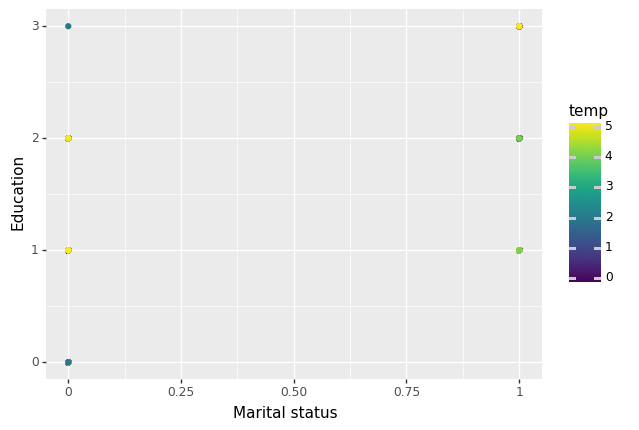

<ggplot: (8766037502313)>
CLuster6


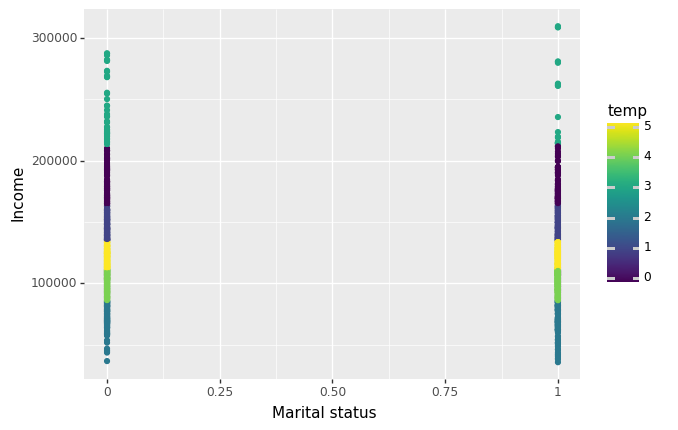

<ggplot: (8766039083293)>
CLuster6


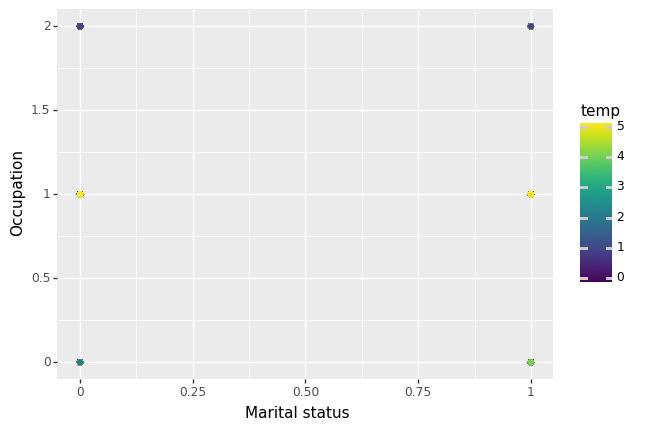

<ggplot: (8766037591033)>
CLuster6


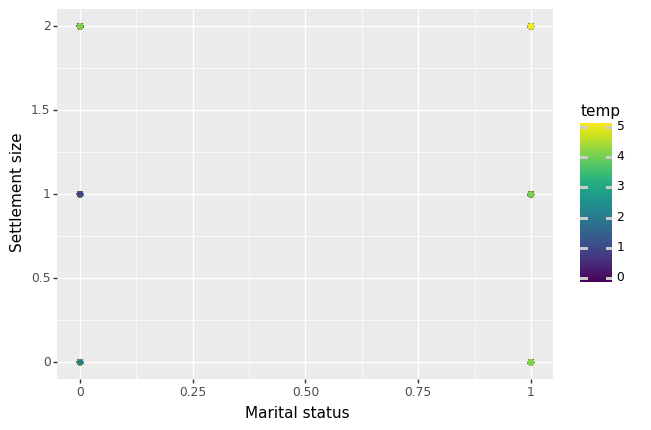

<ggplot: (8766037614433)>
CLuster6


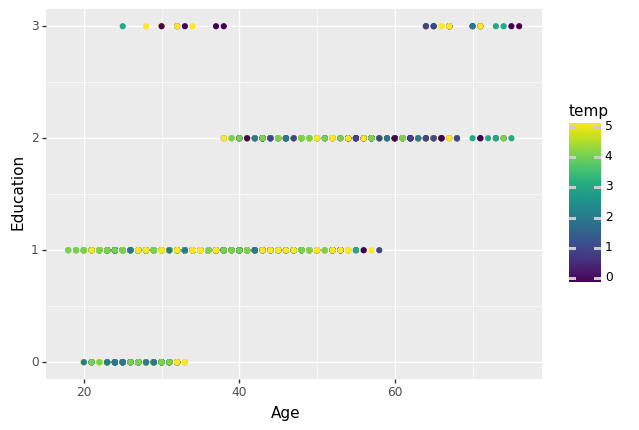

<ggplot: (8766039009125)>
CLuster6


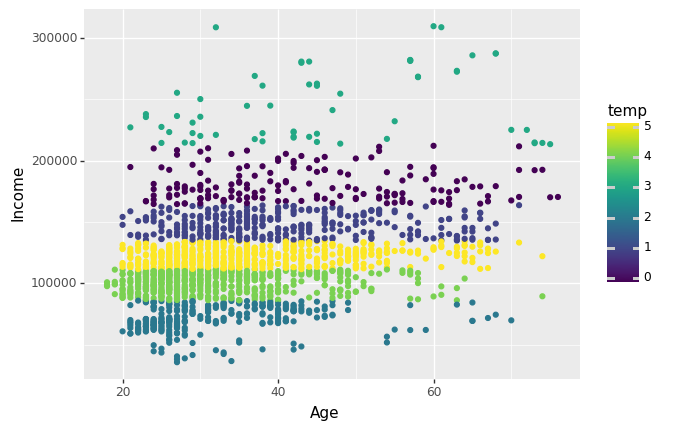

<ggplot: (8766083920849)>
CLuster6


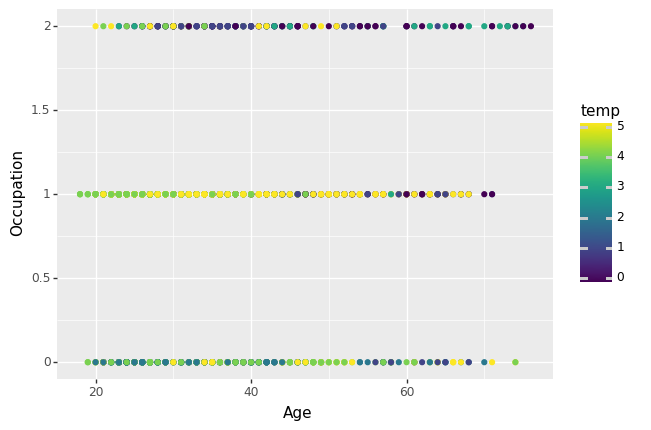

<ggplot: (8766038854625)>
CLuster6


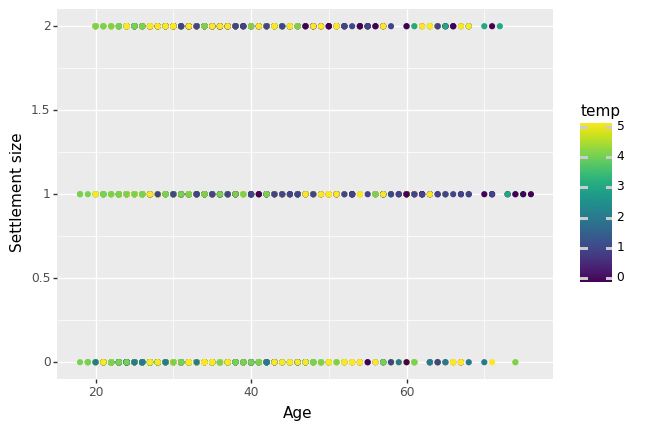

<ggplot: (8766039221693)>
CLuster6


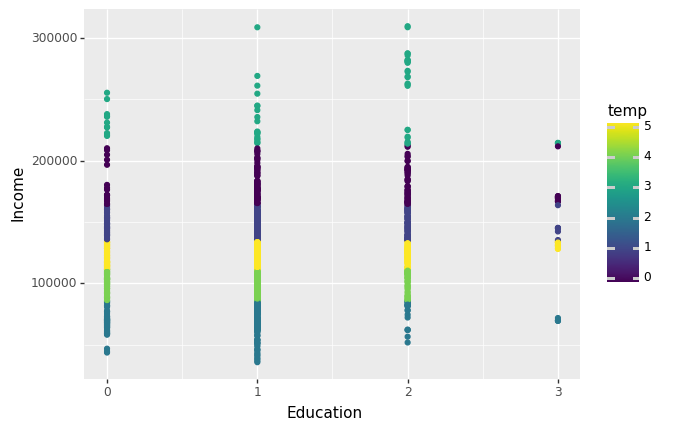

<ggplot: (8766039650549)>
CLuster6


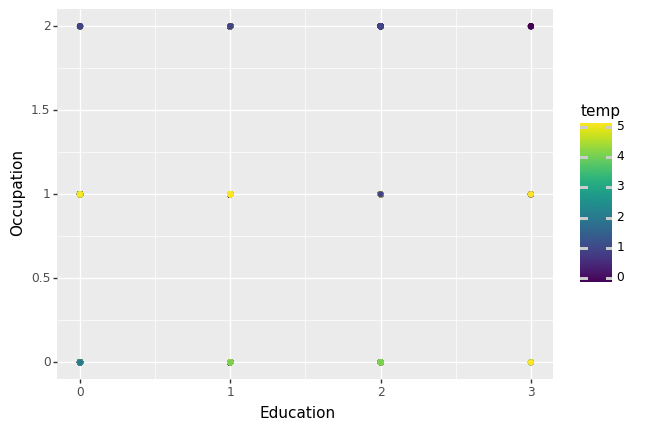

<ggplot: (8766039991157)>
CLuster6


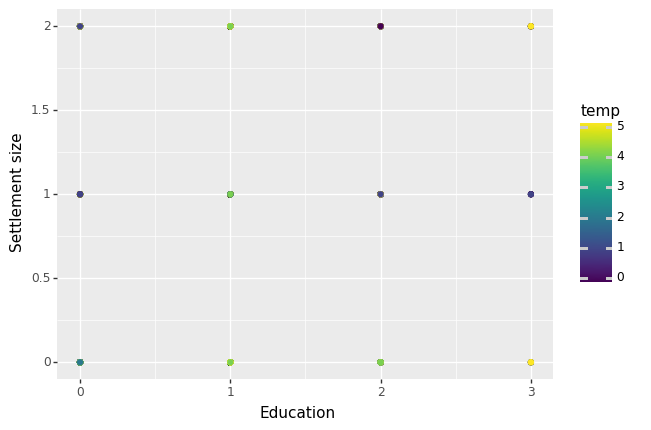

<ggplot: (8766038907185)>
CLuster6


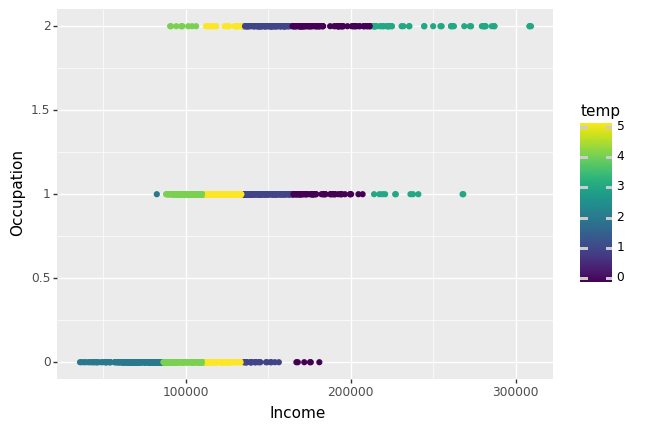

<ggplot: (8766039082009)>
CLuster6


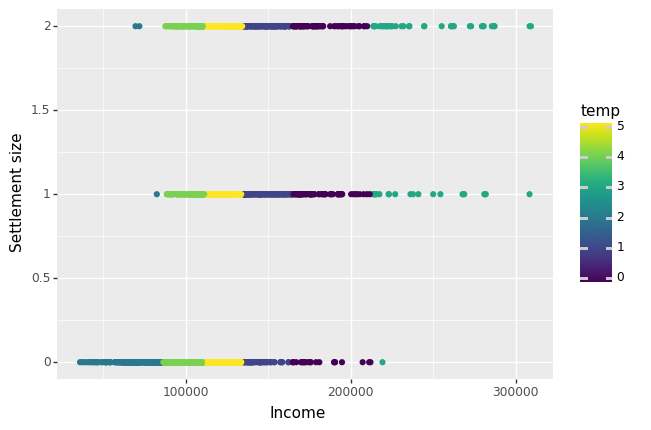

<ggplot: (8766037706581)>
CLuster6


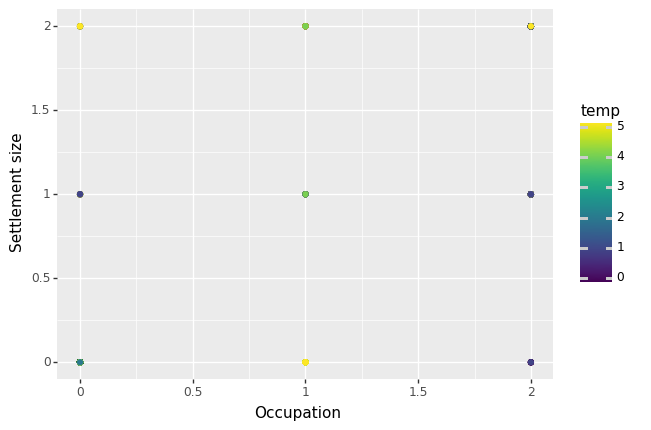

<ggplot: (8766037544277)>
CLuster7


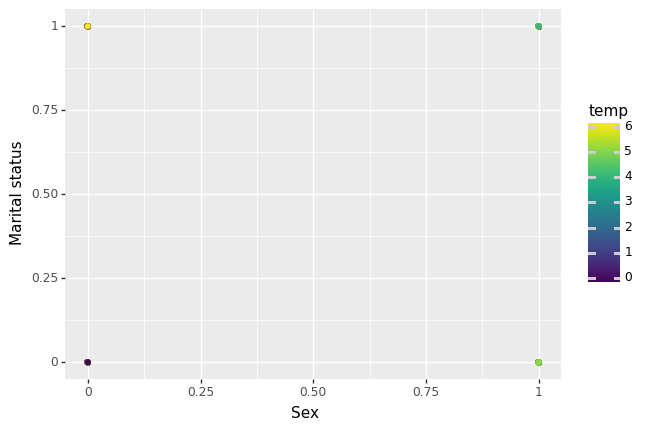

<ggplot: (8766037544349)>
CLuster7


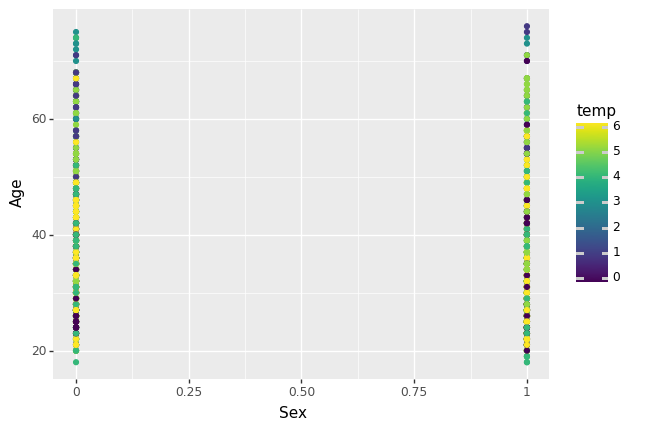

<ggplot: (8766039082009)>
CLuster7


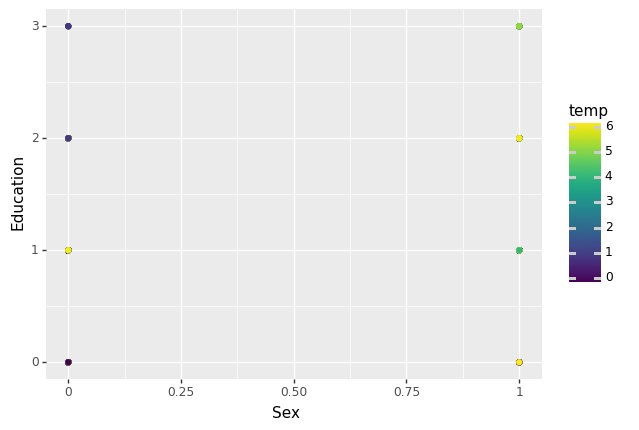

<ggplot: (8766039117077)>
CLuster7


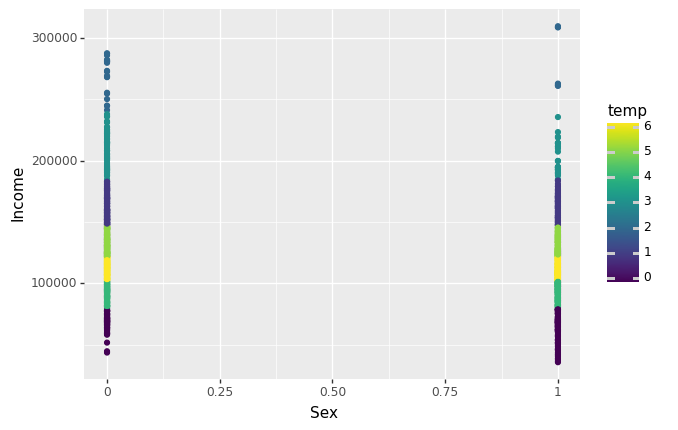

<ggplot: (8766039649873)>
CLuster7


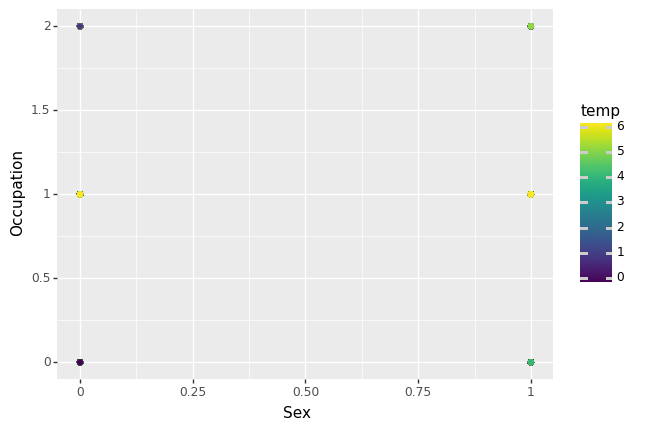

<ggplot: (8766037719365)>
CLuster7


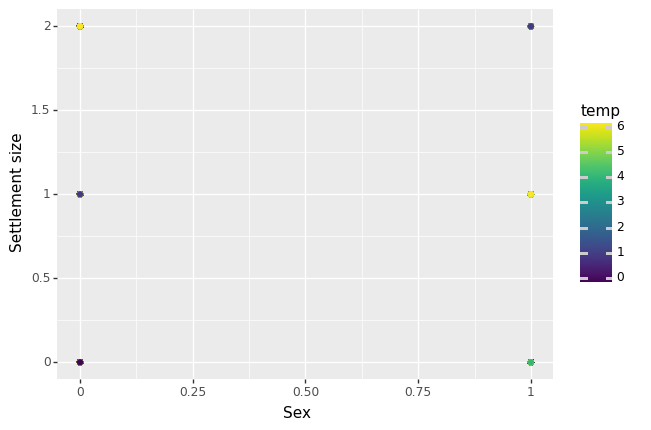

<ggplot: (8766038840953)>
CLuster7


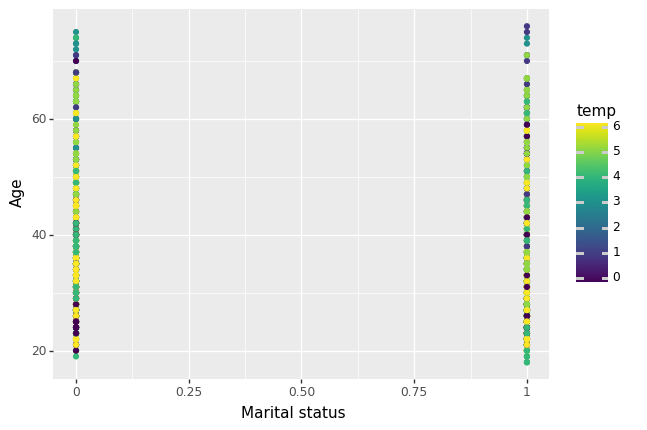

<ggplot: (8766037556281)>
CLuster7


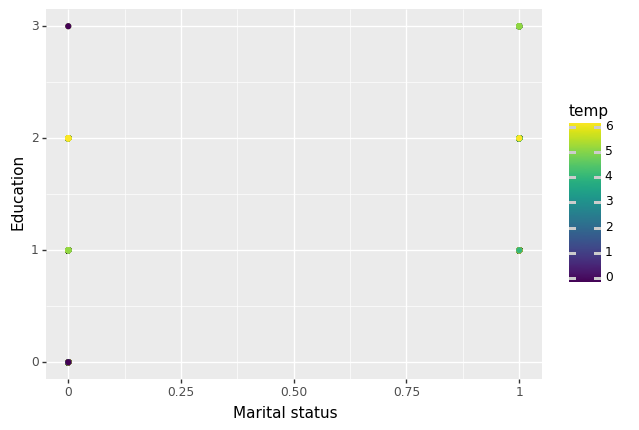

<ggplot: (8766039705385)>
CLuster7


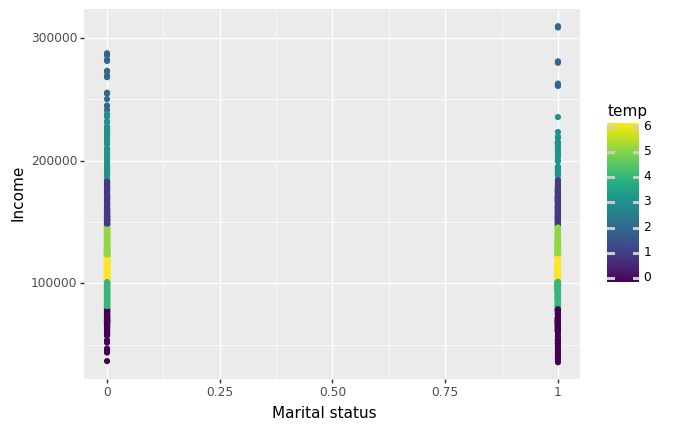

<ggplot: (8766039329885)>
CLuster7


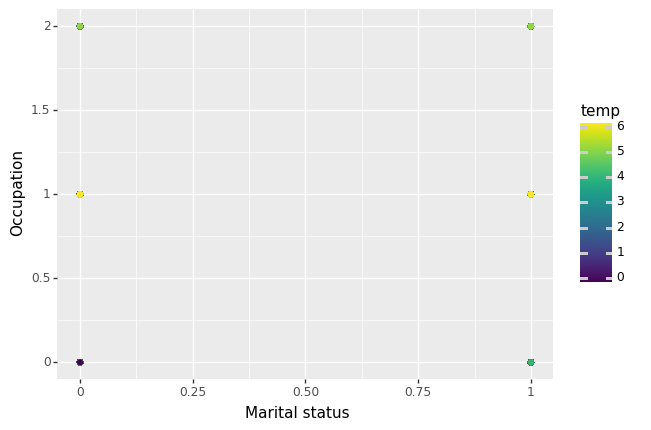

<ggplot: (8766039229141)>
CLuster7


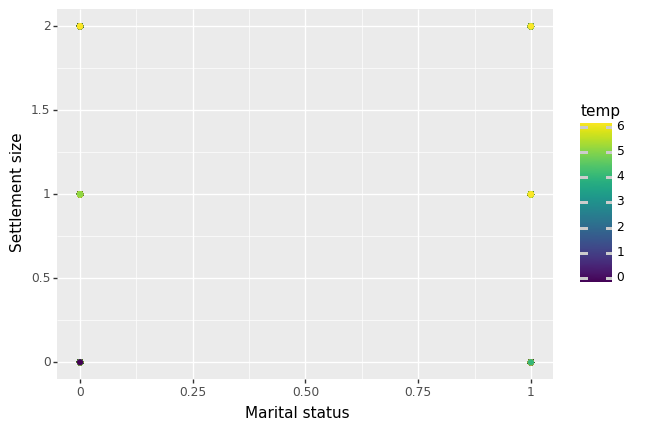

<ggplot: (8766039147737)>
CLuster7


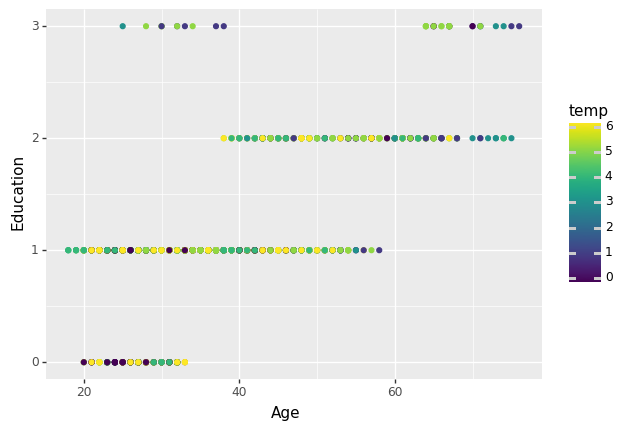

<ggplot: (8766039302105)>
CLuster7


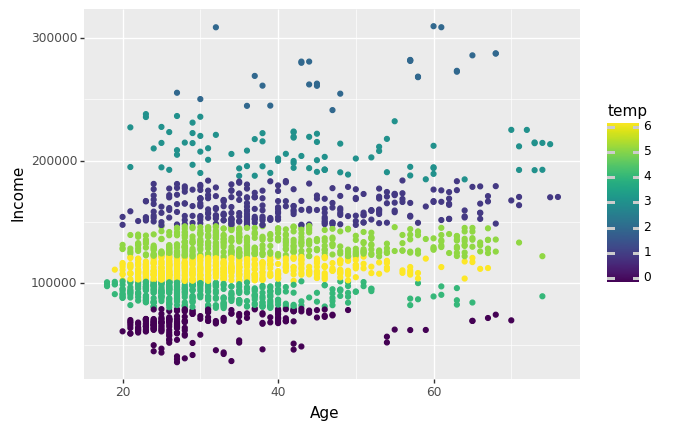

<ggplot: (8766039057673)>
CLuster7


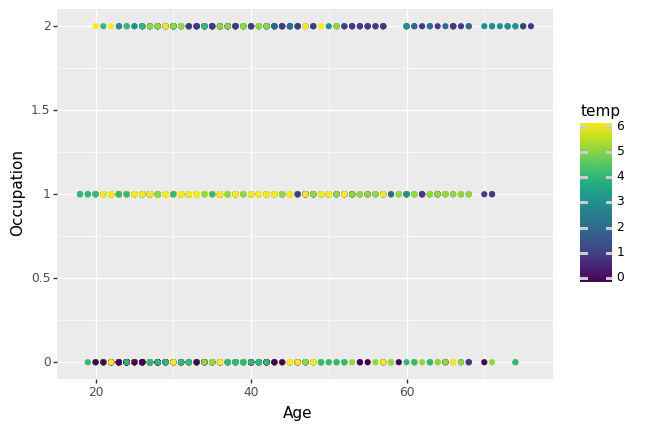

<ggplot: (8766039147525)>
CLuster7


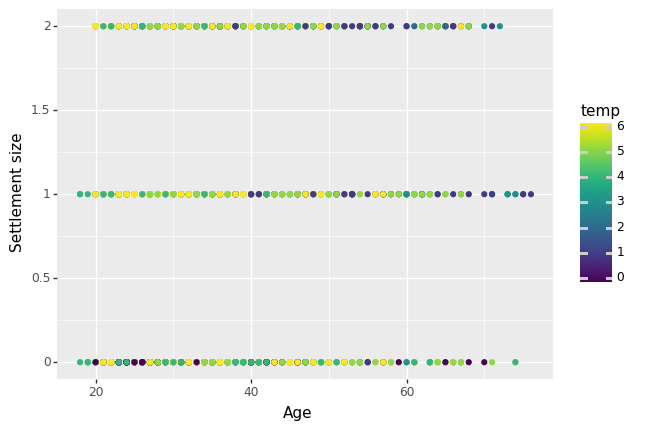

<ggplot: (8766039219669)>
CLuster7


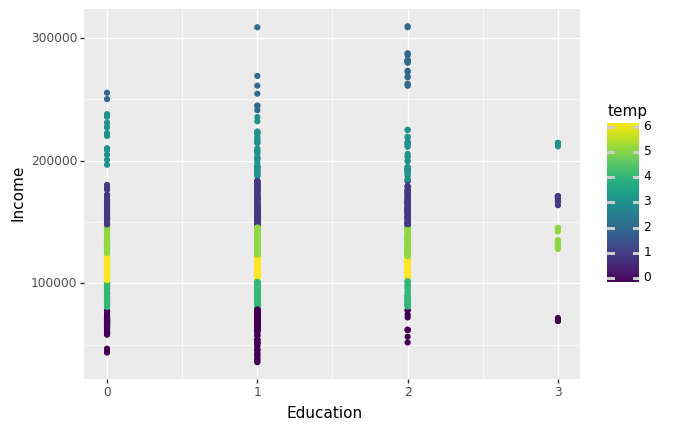

<ggplot: (8766037679085)>
CLuster7


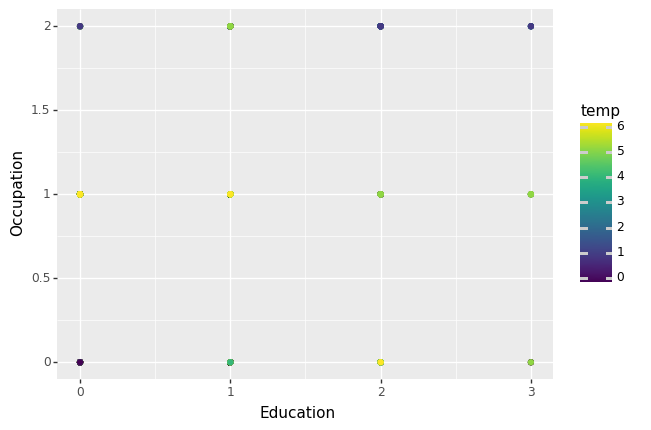

<ggplot: (8766038812801)>
CLuster7


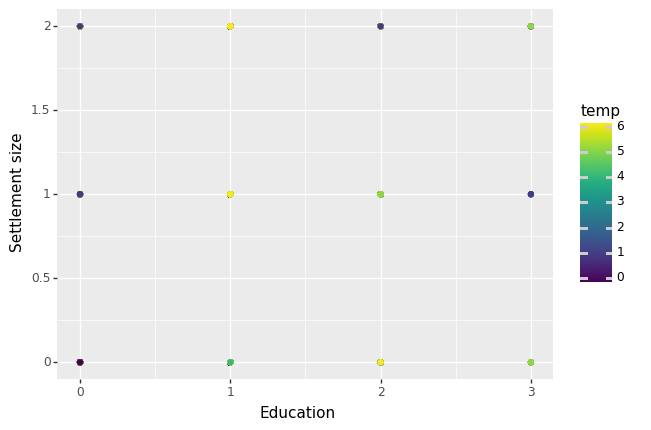

<ggplot: (8766039053405)>
CLuster7


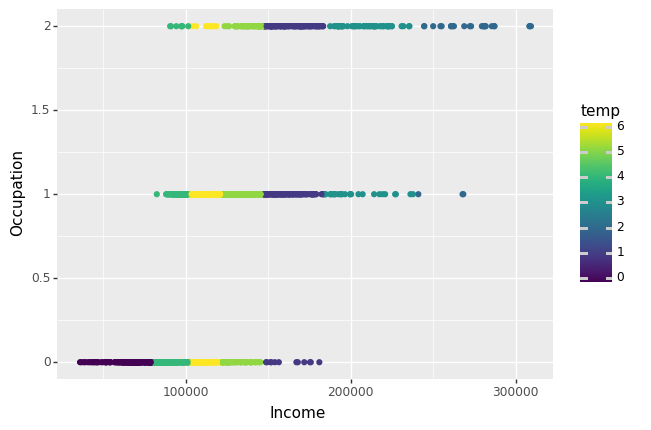

<ggplot: (8766038976281)>
CLuster7


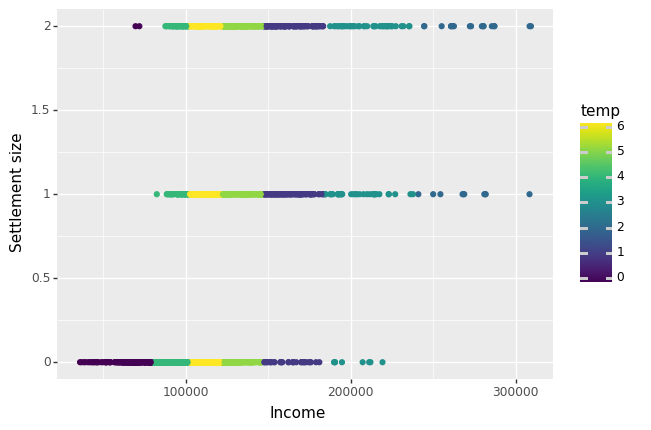

<ggplot: (8766037659069)>
CLuster7


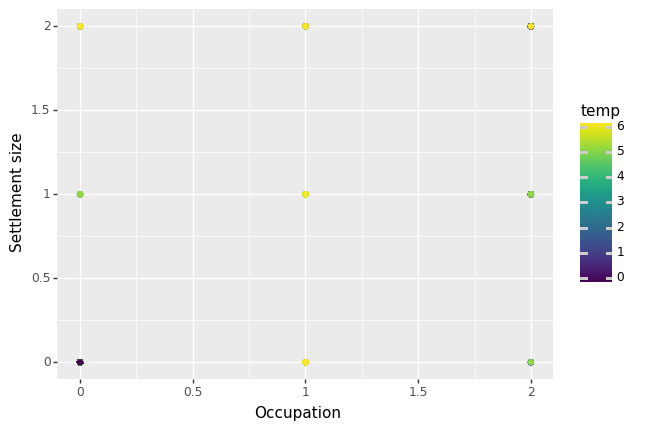

<ggplot: (8766037699797)>
CLuster8


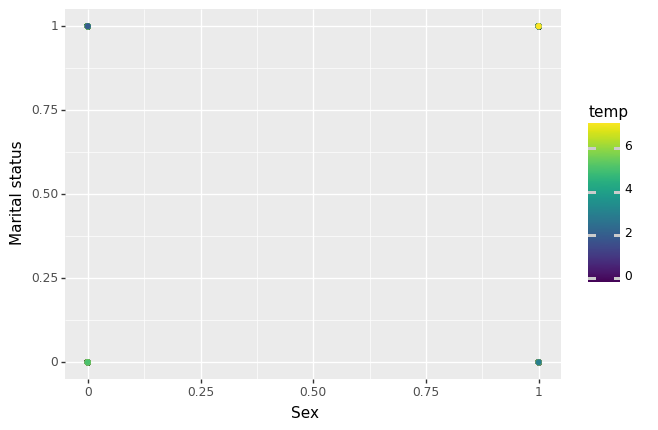

<ggplot: (8766037703517)>
CLuster8


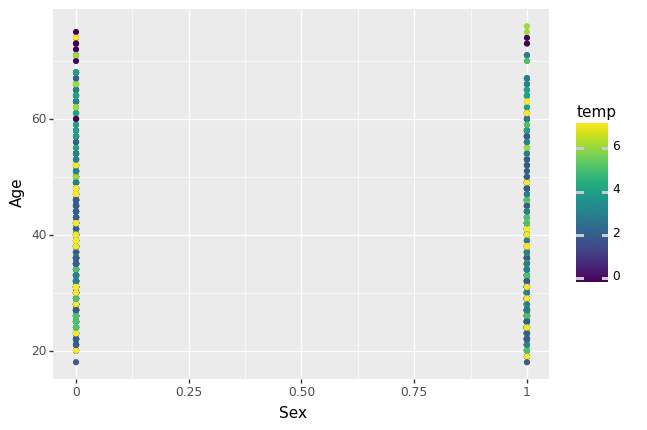

<ggplot: (8766037501349)>
CLuster8


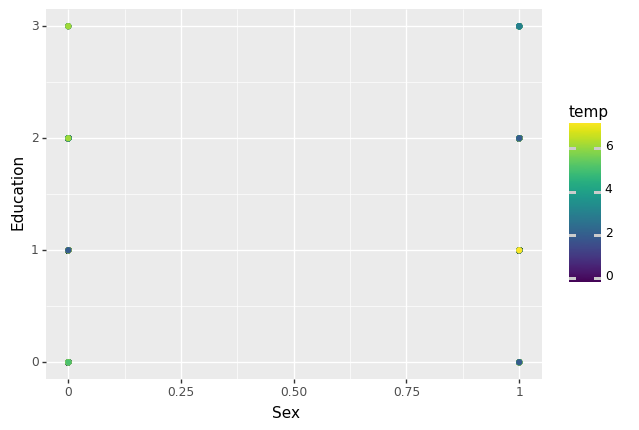

<ggplot: (8766037603305)>
CLuster8


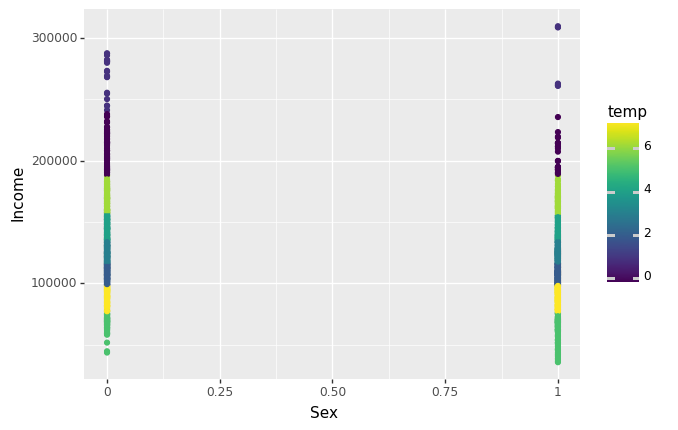

<ggplot: (8766037491349)>
CLuster8


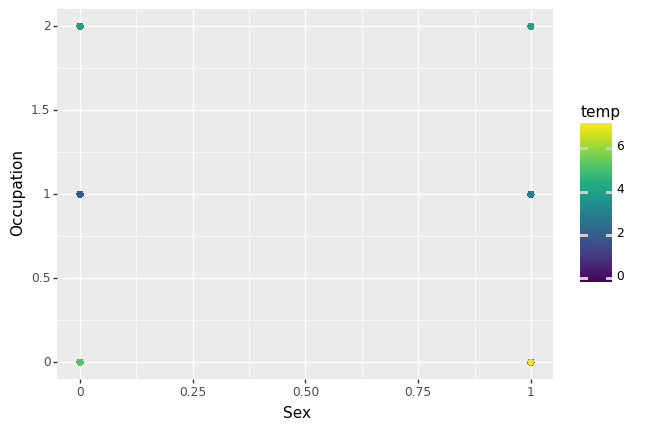

<ggplot: (8766039650393)>
CLuster8


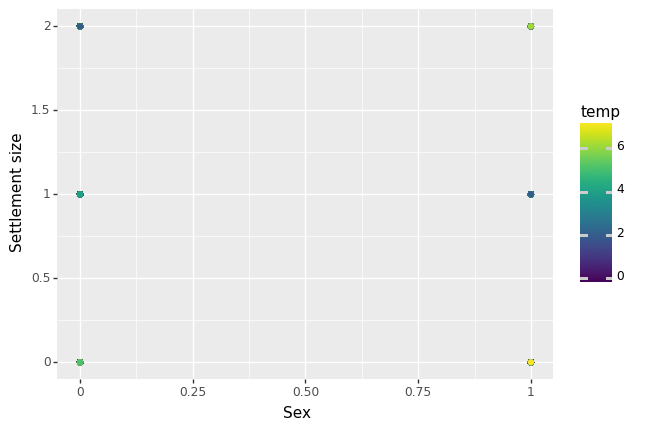

<ggplot: (8766039157777)>
CLuster8


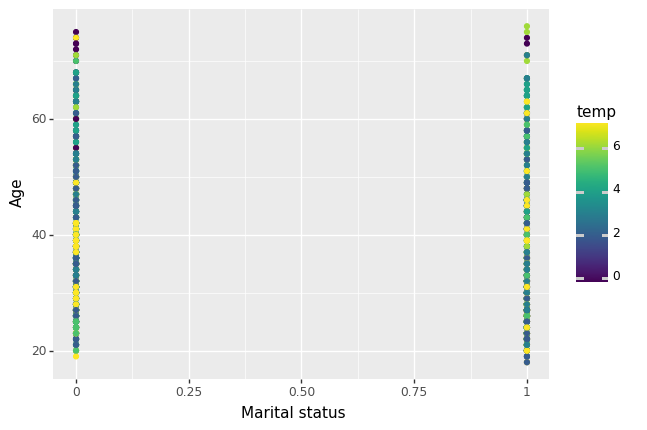

<ggplot: (8766039101053)>
CLuster8


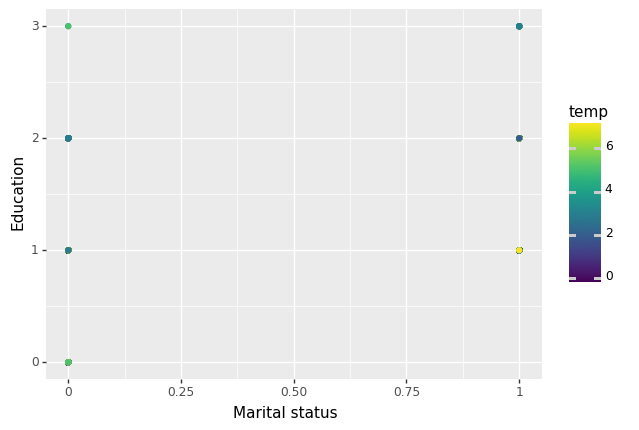

<ggplot: (8766063420361)>
CLuster8


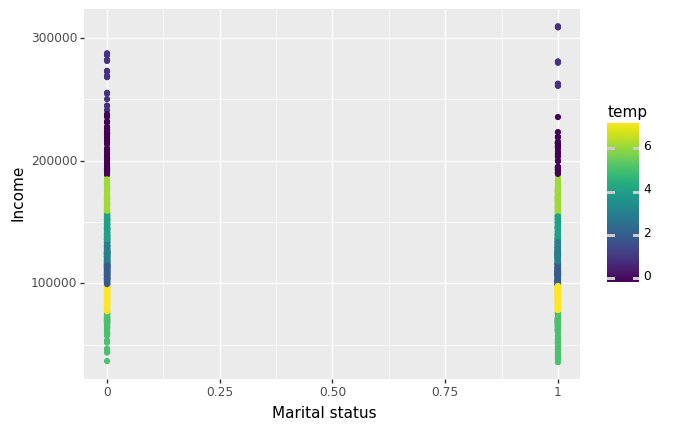

<ggplot: (8766037466817)>
CLuster8


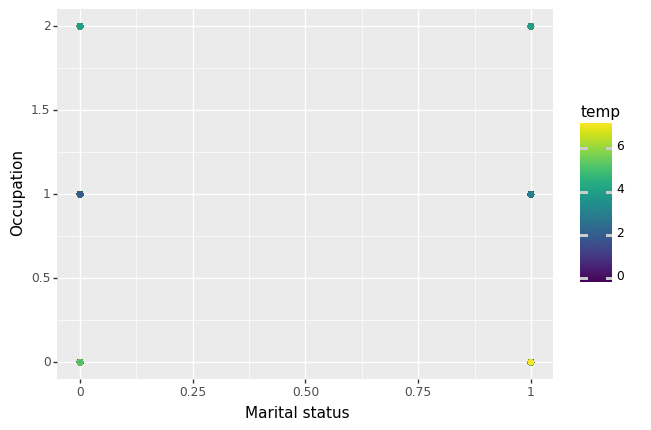

<ggplot: (8766040693705)>
CLuster8


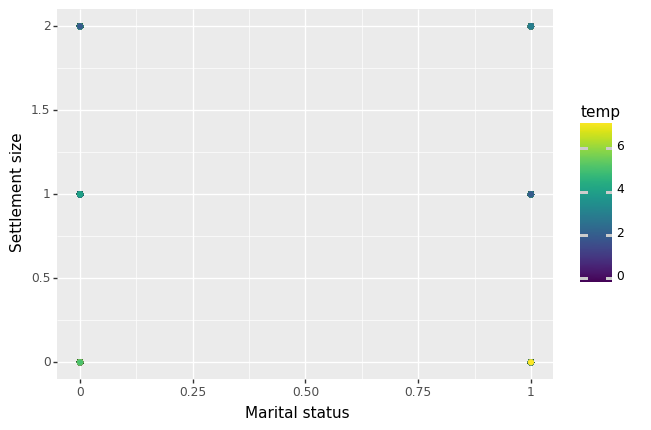

<ggplot: (8766039669977)>
CLuster8


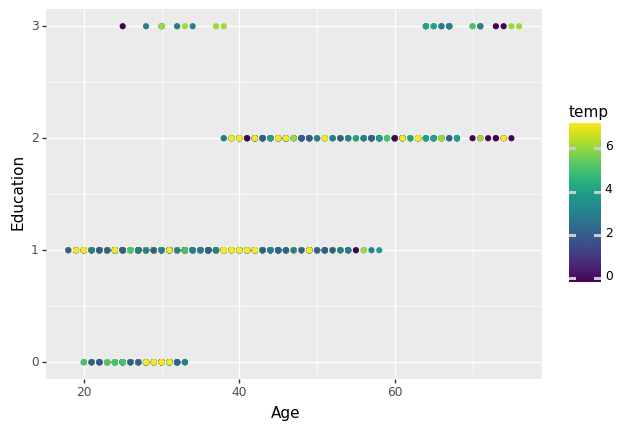

<ggplot: (8766037641277)>
CLuster8


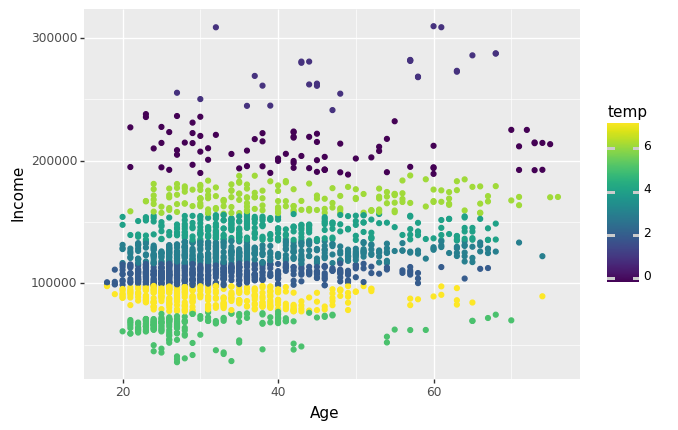

<ggplot: (8766039117113)>
CLuster8


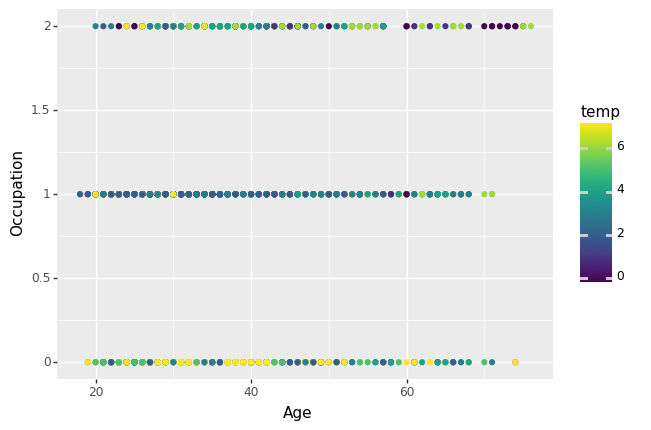

<ggplot: (8766038923433)>
CLuster8


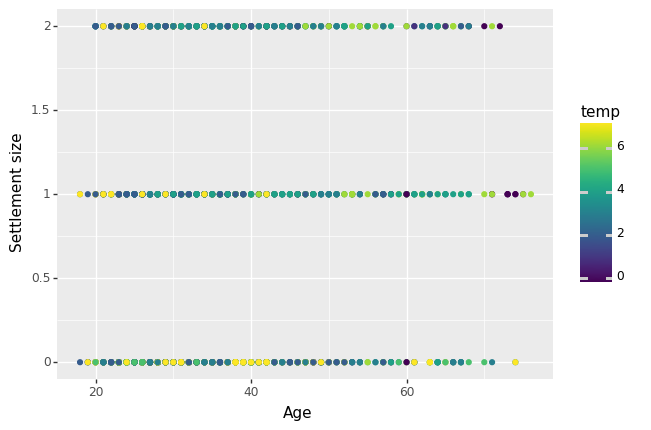

<ggplot: (8766039045473)>
CLuster8


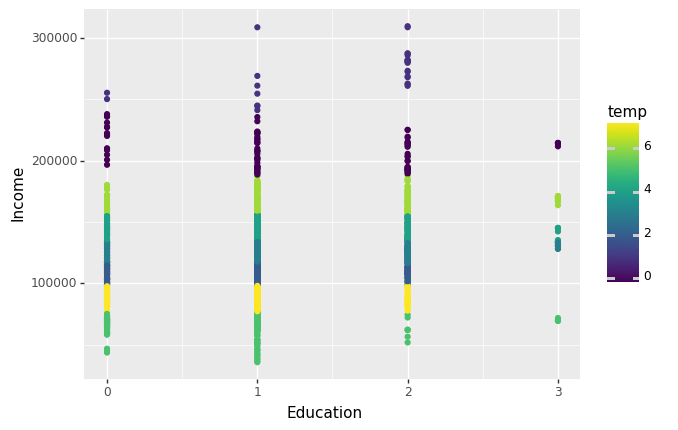

<ggplot: (8766038956489)>
CLuster8


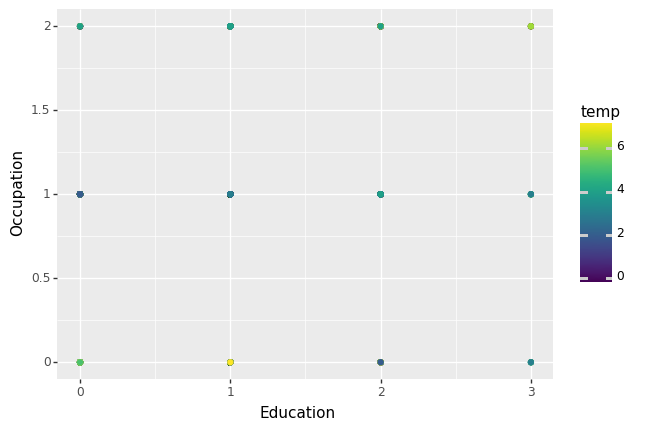

<ggplot: (8766038809661)>
CLuster8


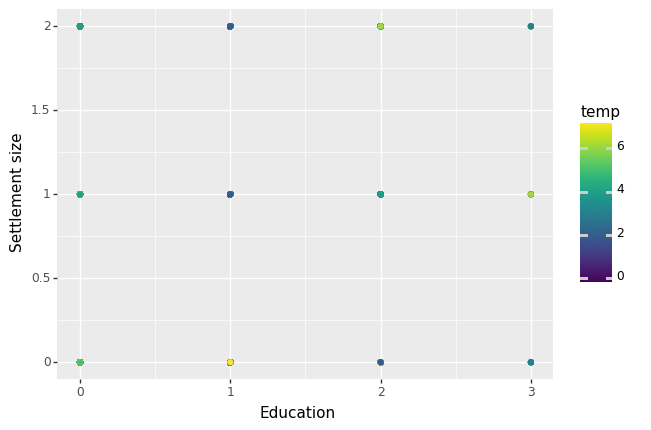

<ggplot: (8766038923377)>
CLuster8


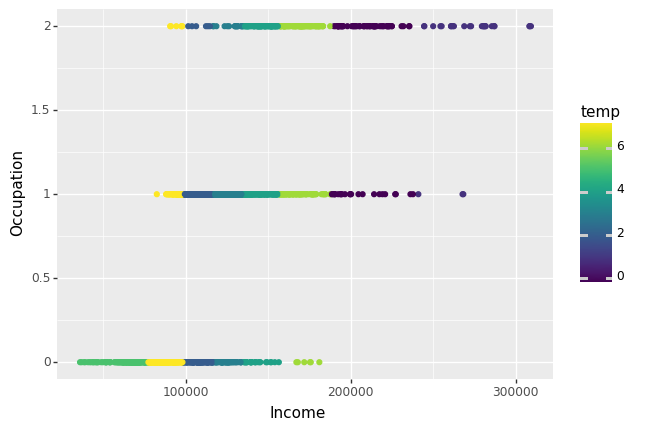

<ggplot: (8766039090705)>
CLuster8


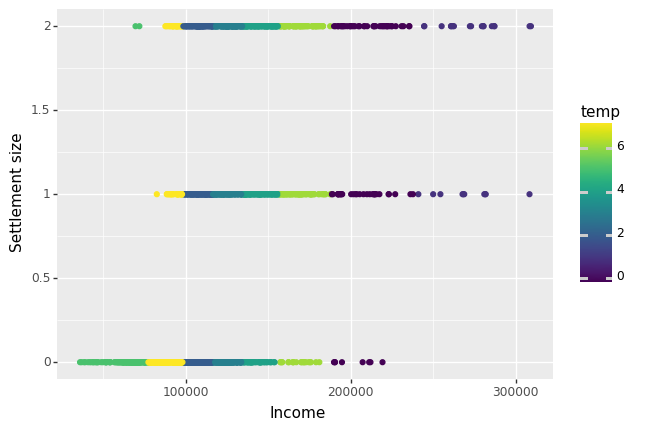

<ggplot: (8766039305853)>
CLuster8


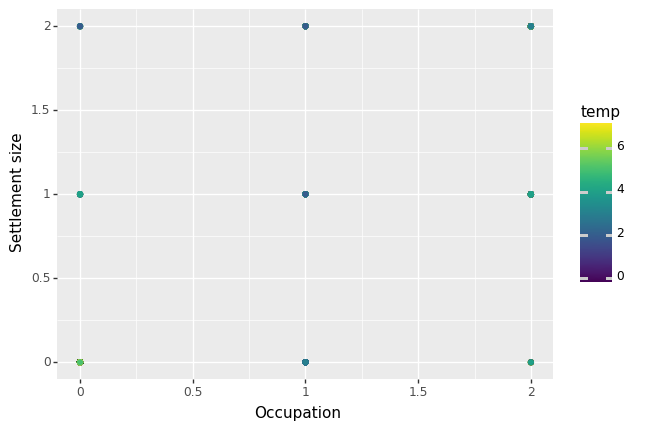

<ggplot: (8766039016261)>
CLuster9


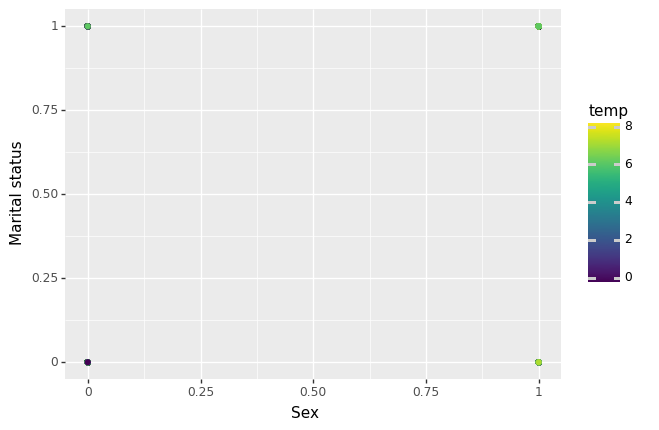

<ggplot: (8766037560757)>
CLuster9


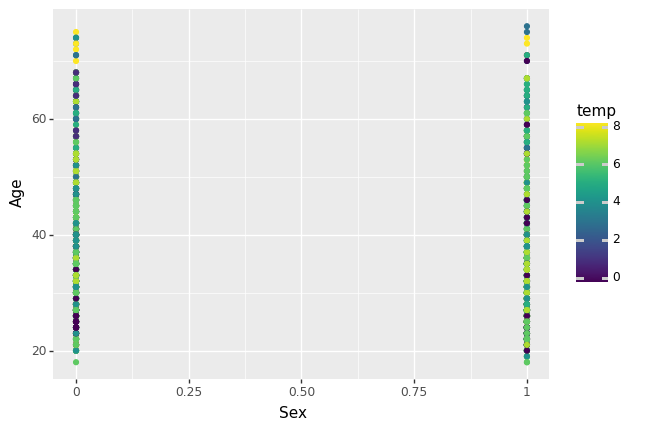

<ggplot: (8766038893593)>
CLuster9


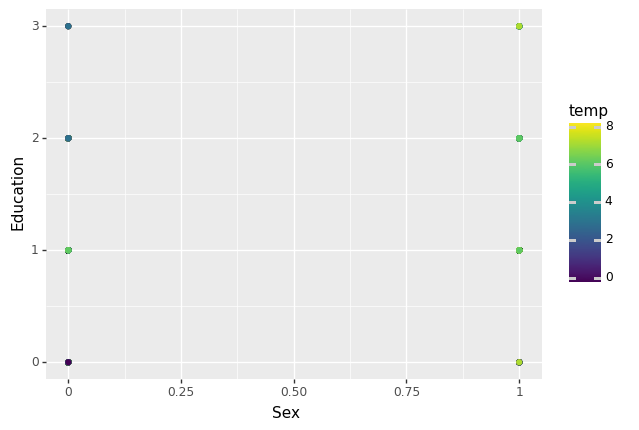

<ggplot: (8766039221545)>
CLuster9


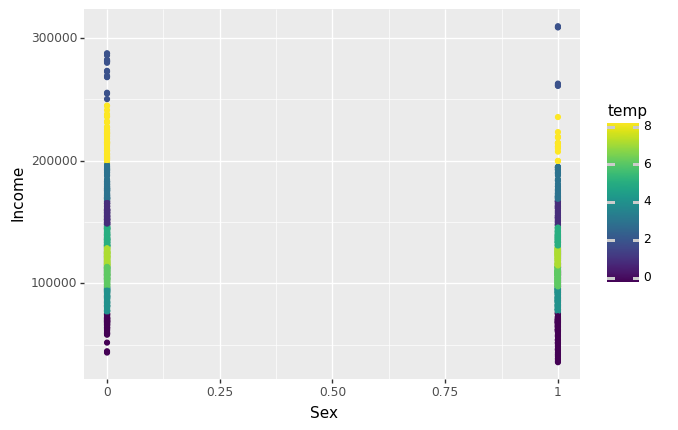

<ggplot: (8766037501189)>
CLuster9


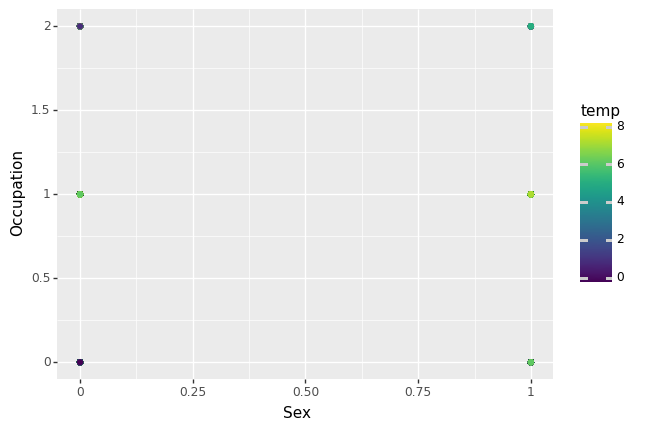

<ggplot: (8766038874493)>
CLuster9


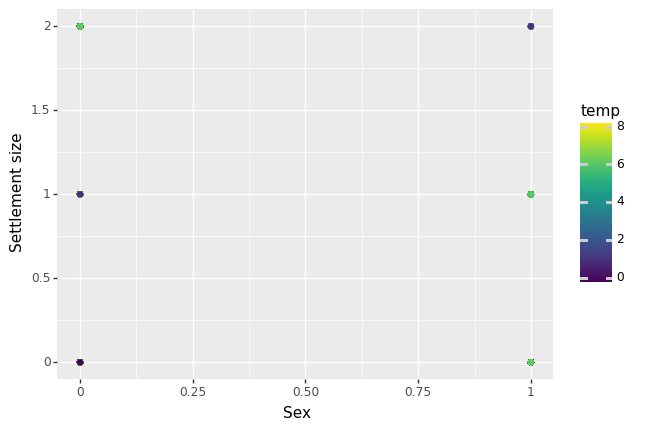

<ggplot: (8766037470077)>
CLuster9


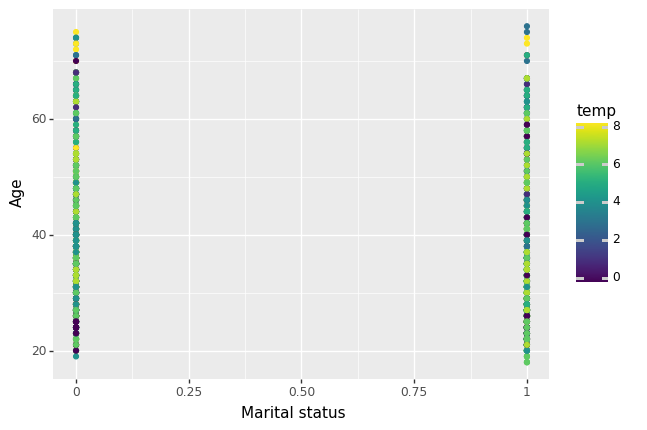

<ggplot: (8766038870681)>
CLuster9


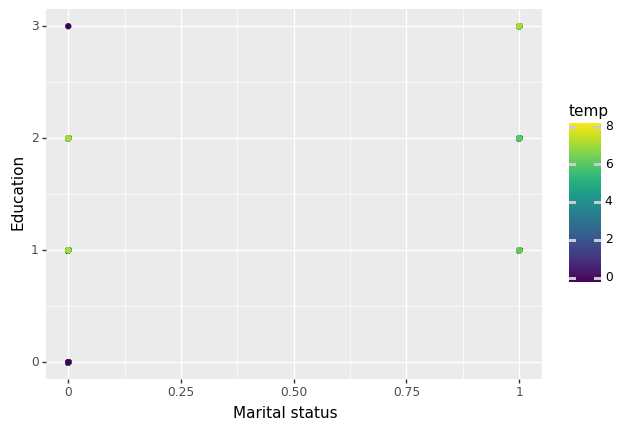

<ggplot: (8766037633897)>
CLuster9


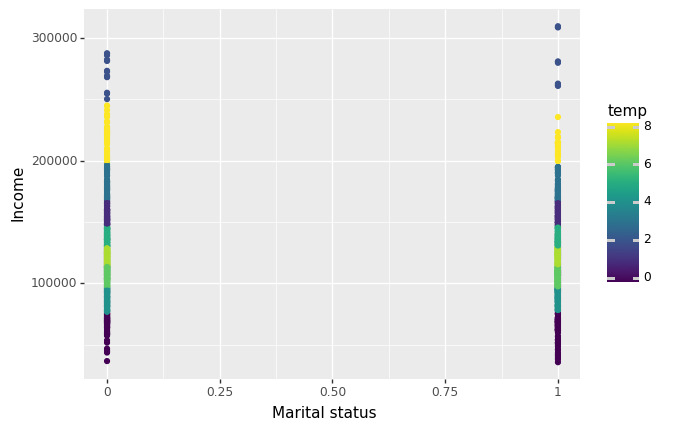

<ggplot: (8766057308985)>
CLuster9


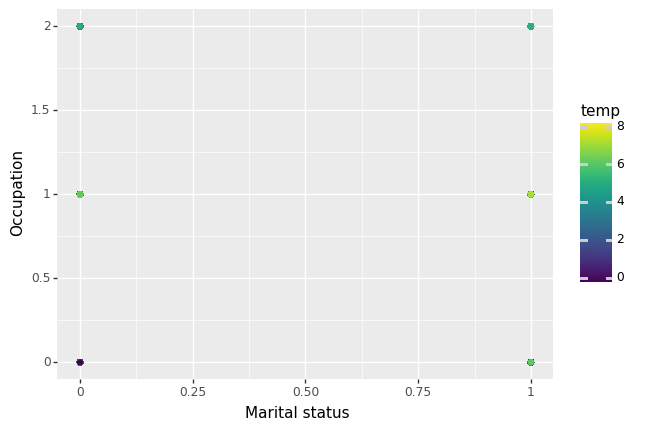

<ggplot: (8766039066385)>
CLuster9


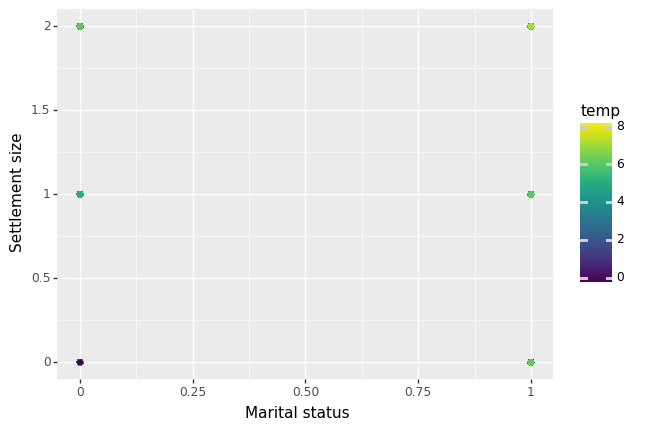

<ggplot: (8766038900705)>
CLuster9


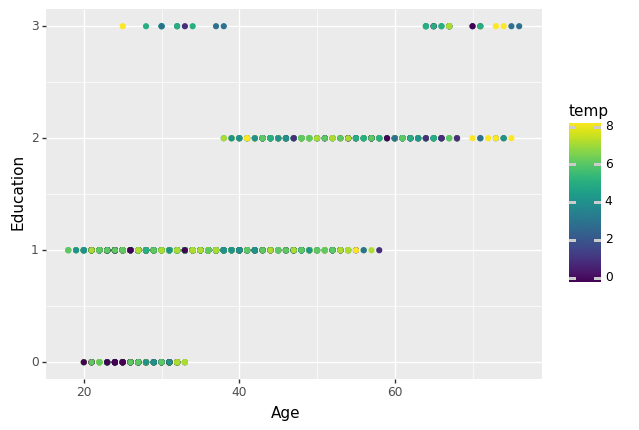

<ggplot: (8766038879533)>
CLuster9


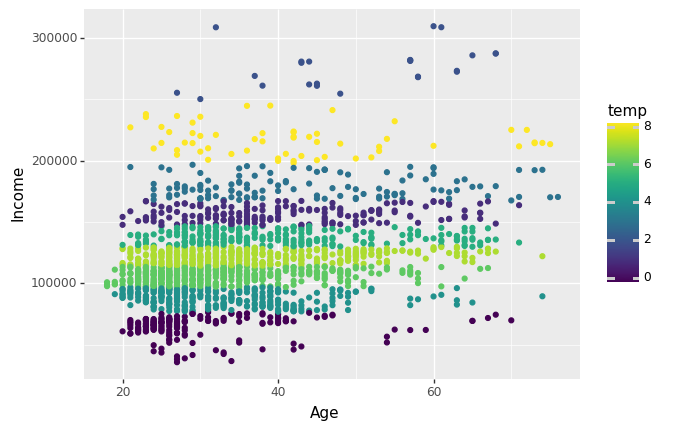

<ggplot: (8766037602873)>
CLuster9


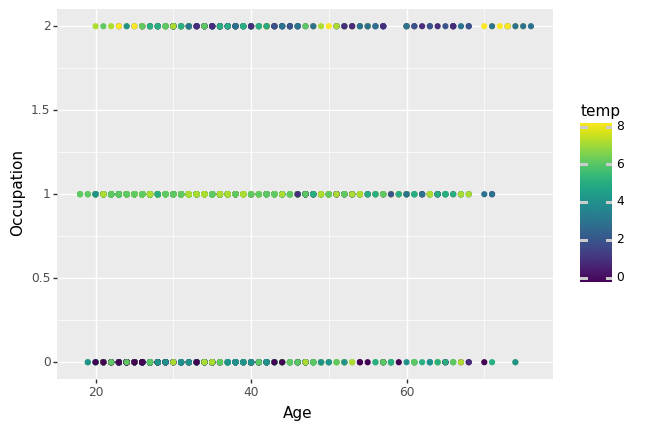

<ggplot: (8766038939501)>
CLuster9


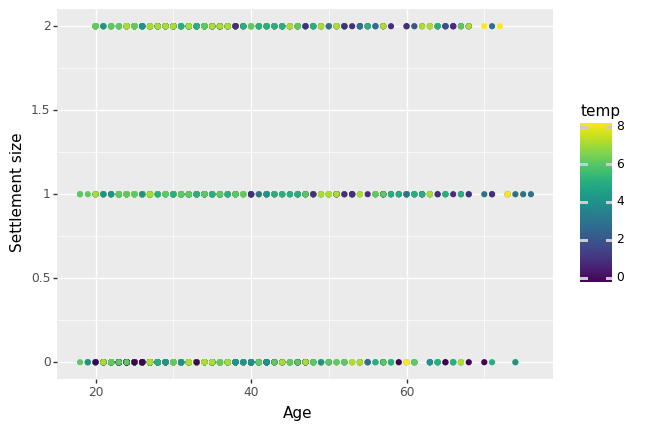

<ggplot: (8766037635121)>
CLuster9


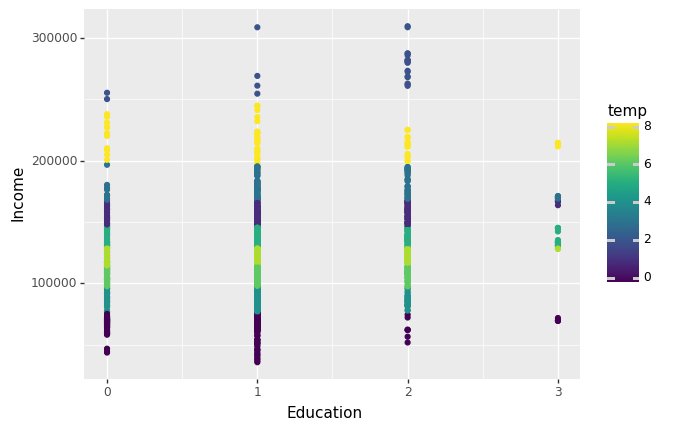

<ggplot: (8766038937565)>
CLuster9


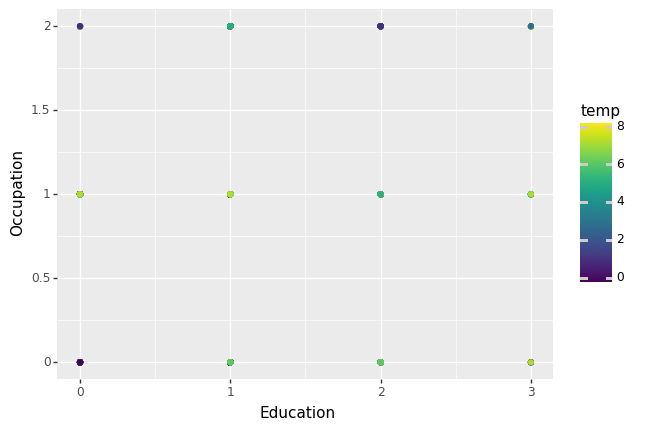

<ggplot: (8766039718261)>
CLuster9


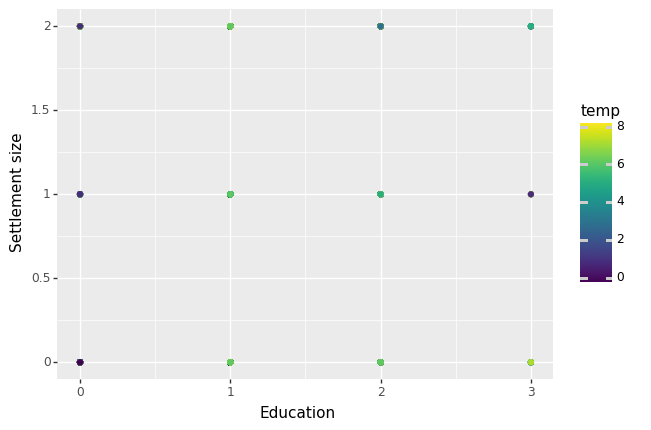

<ggplot: (8766038874581)>
CLuster9


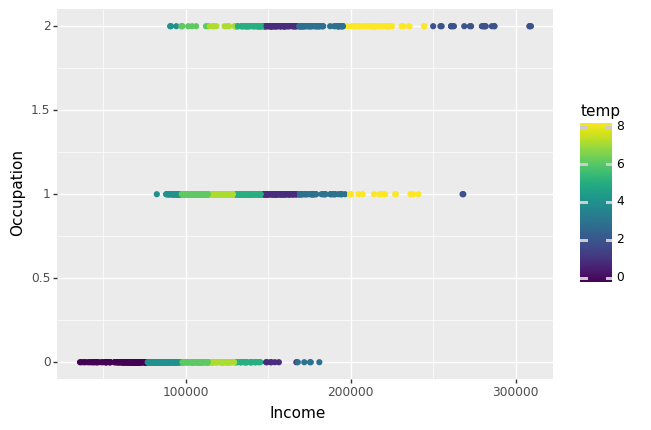

<ggplot: (8766039090741)>
CLuster9


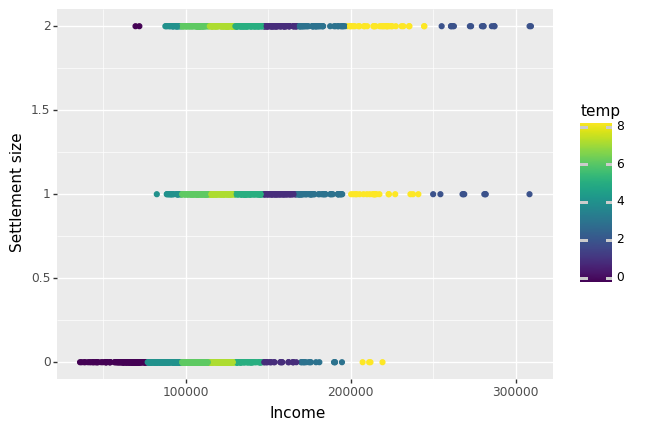

<ggplot: (8766039090749)>
CLuster9


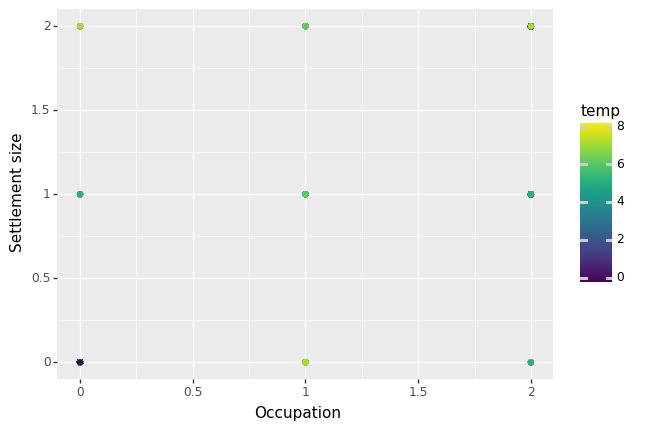

<ggplot: (8766037642901)>
CLuster10


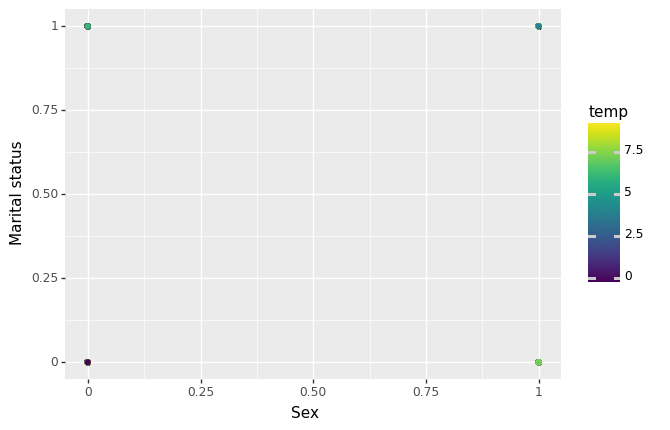

<ggplot: (8766037471777)>
CLuster10


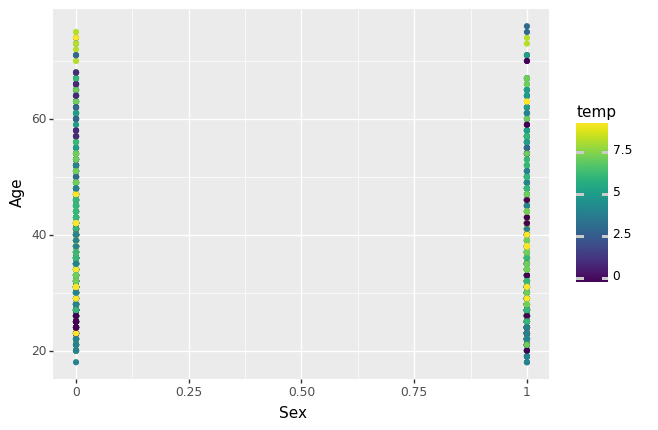

<ggplot: (8766037498193)>
CLuster10


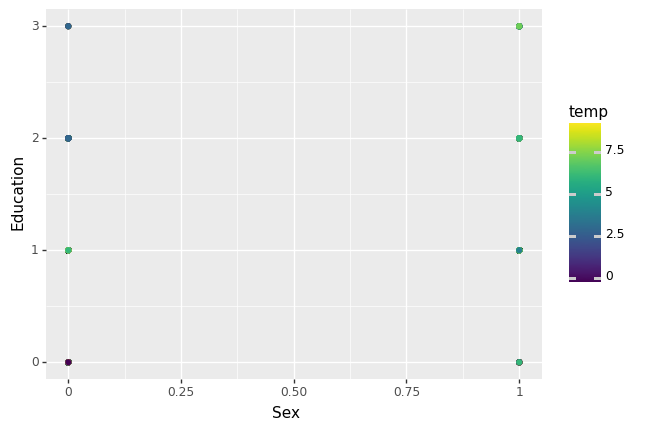

<ggplot: (8766039721181)>
CLuster10


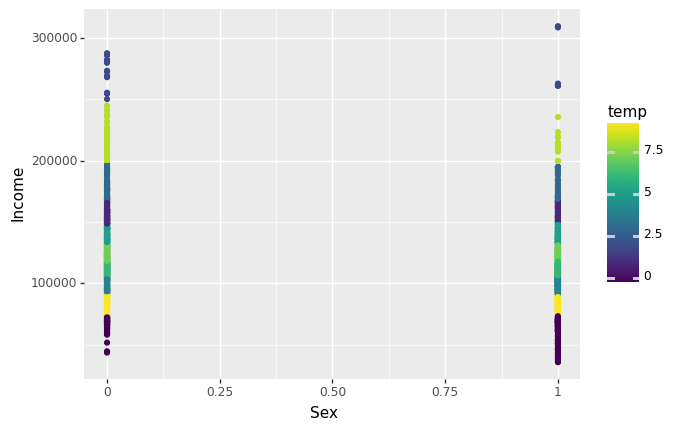

<ggplot: (8766039161437)>
CLuster10


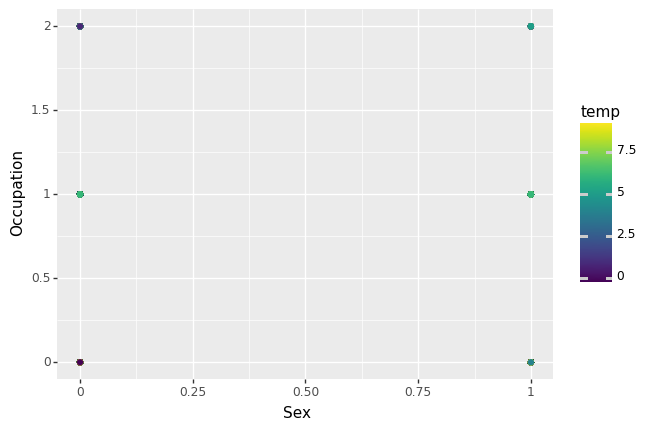

<ggplot: (8766039186577)>
CLuster10


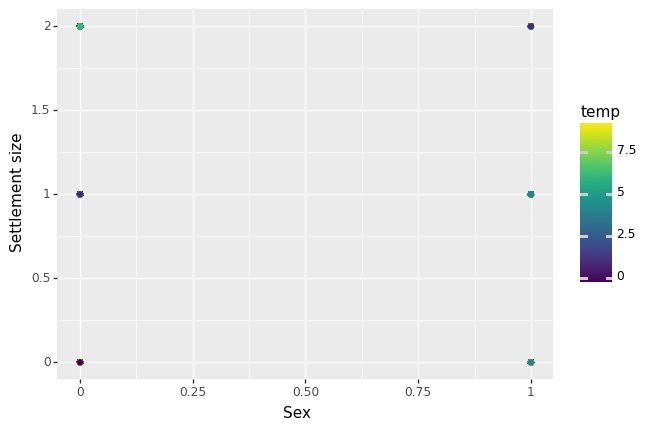

<ggplot: (8766039234701)>
CLuster10


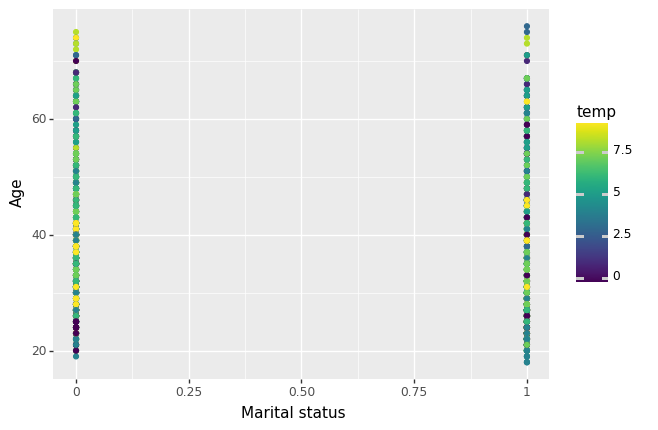

<ggplot: (8766037611917)>
CLuster10


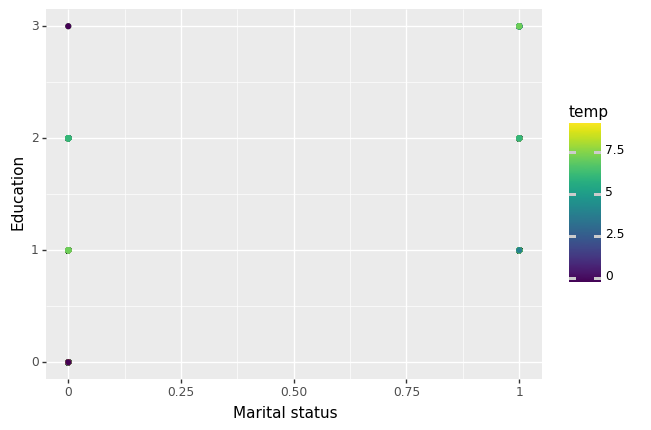

<ggplot: (8766037644313)>
CLuster10


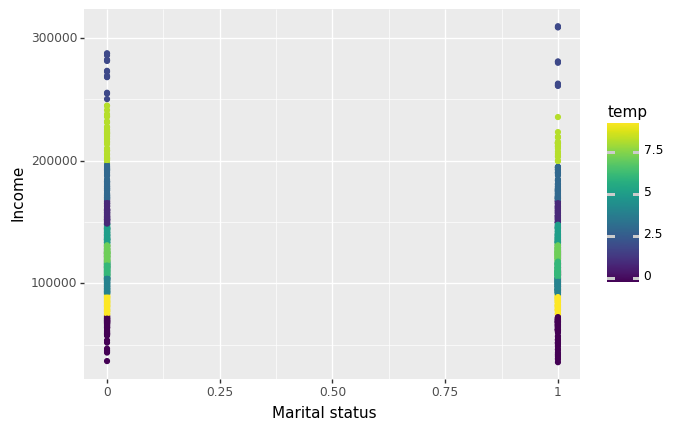

<ggplot: (8766037509301)>
CLuster10


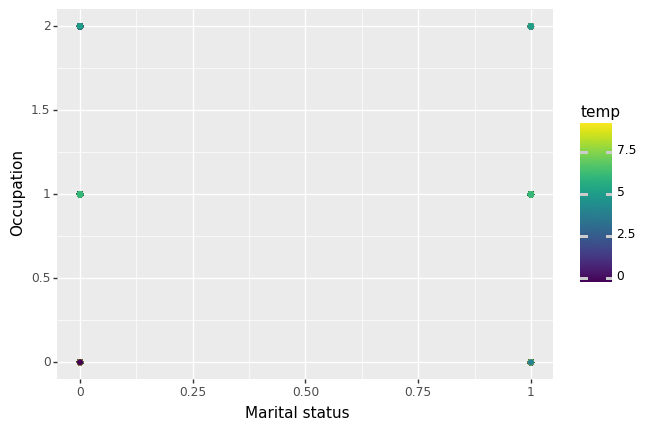

<ggplot: (8766037460305)>
CLuster10


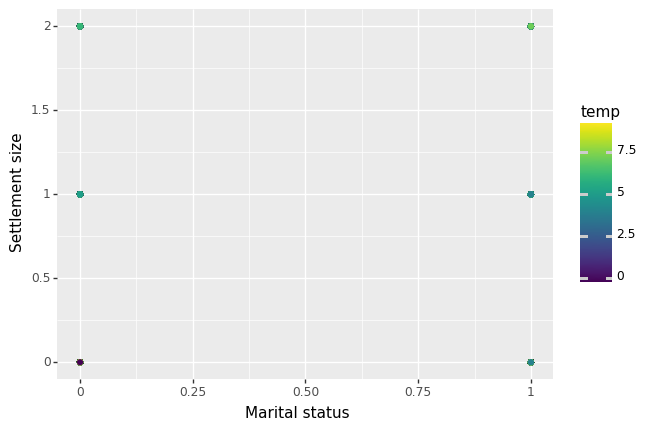

<ggplot: (8766038961277)>
CLuster10


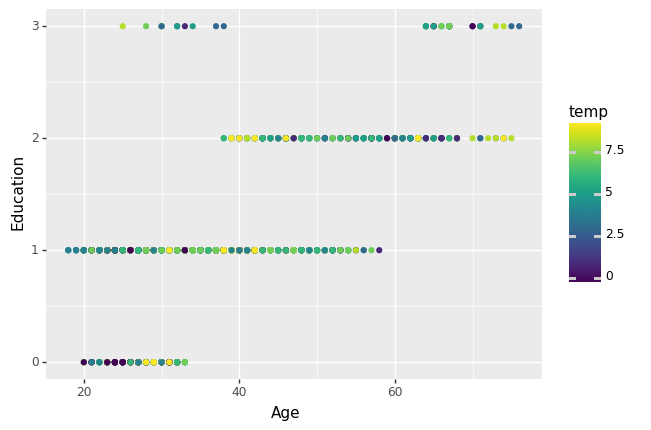

<ggplot: (8766038961261)>
CLuster10


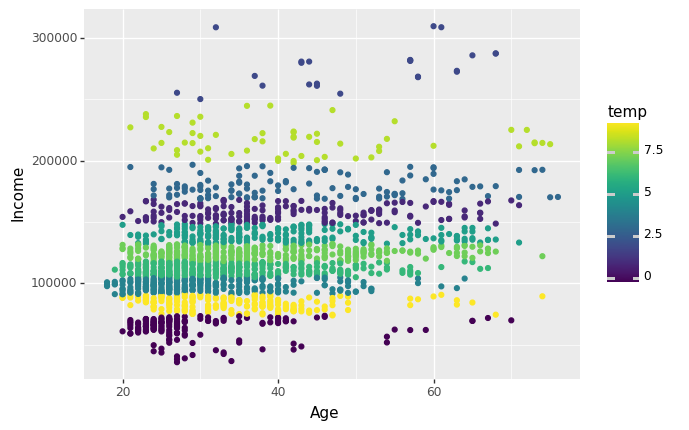

<ggplot: (8766037526197)>
CLuster10


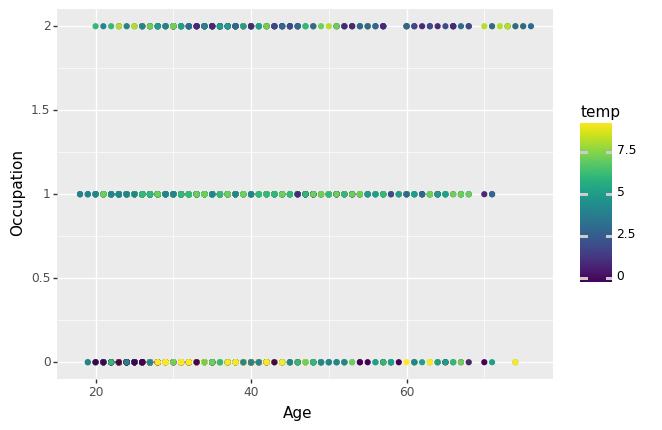

<ggplot: (8766039328525)>
CLuster10


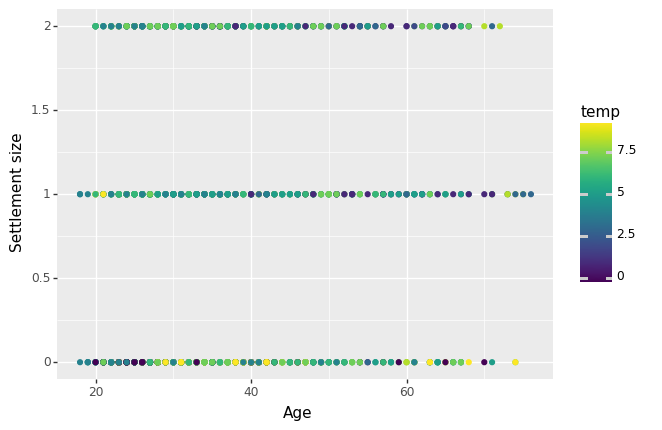

<ggplot: (8766038961225)>
CLuster10


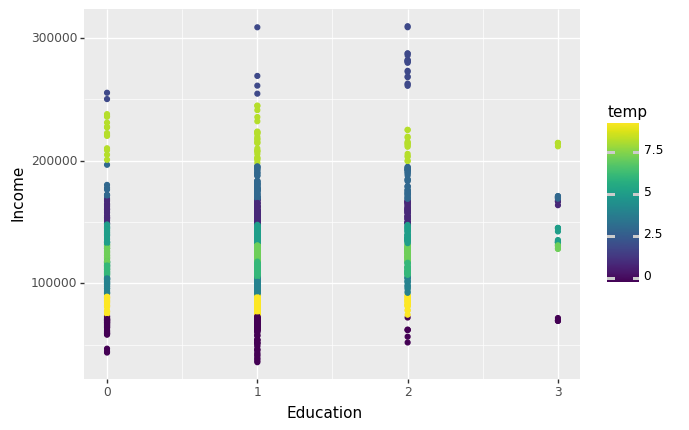

<ggplot: (8766039330017)>
CLuster10


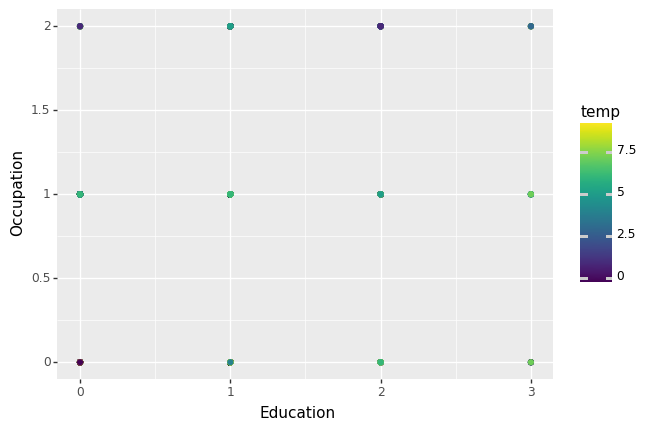

<ggplot: (8766037469929)>
CLuster10


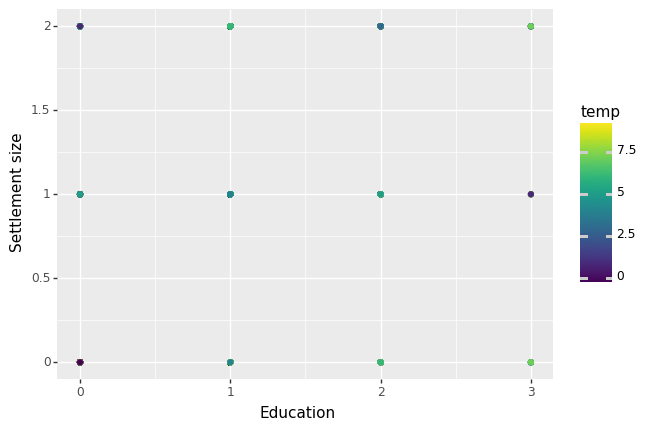

<ggplot: (8766037457477)>
CLuster10


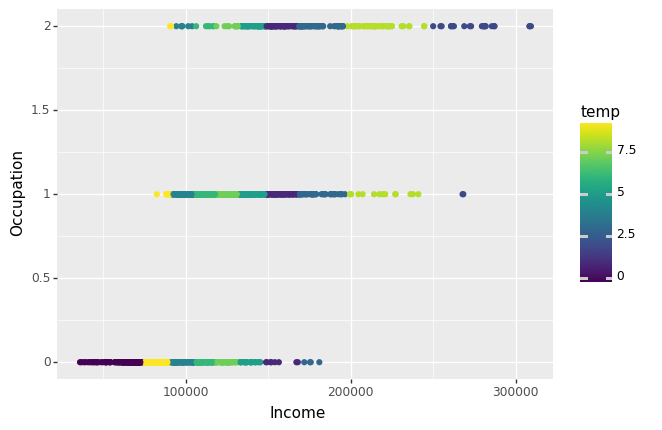

<ggplot: (8766037559401)>
CLuster10


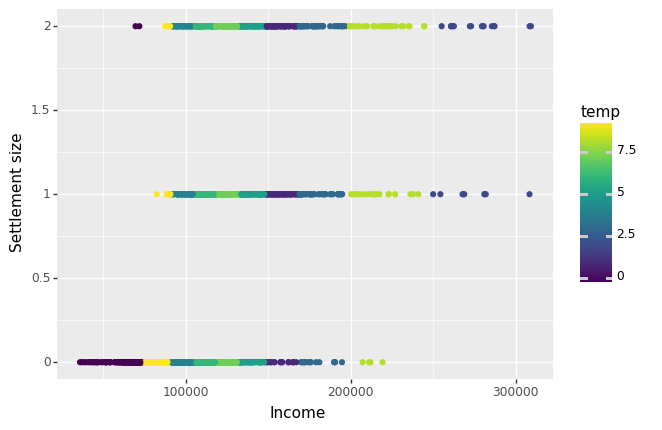

<ggplot: (8766037616045)>
CLuster10


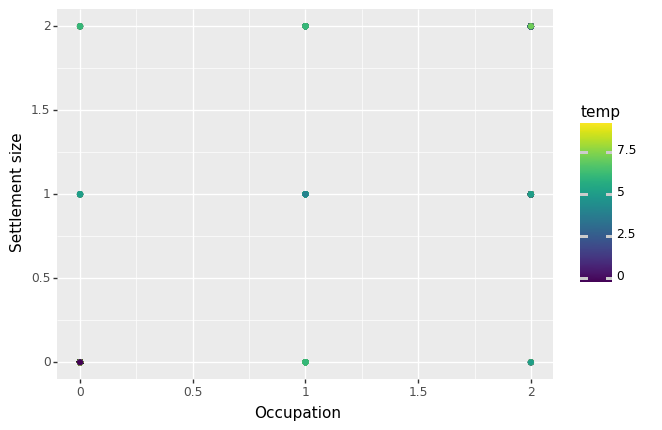

<ggplot: (8766038832861)>


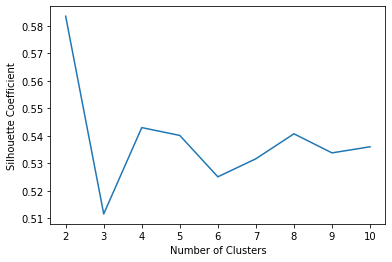

The best silhouette_coefficient is with 2 number of clusters
  


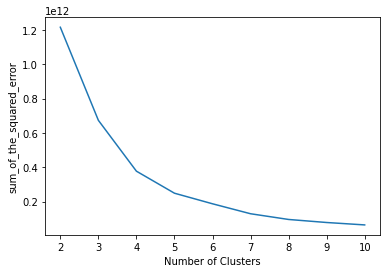

In [5]:
from plotnine import *
from plotnine.data import mpg
from plotnine import ggplot, aes, facet_grid, labs, geom_point, theme_dark

sum_of_the_squared_error = []
listofrange=len(range(2,12,1))
i = 2
while listofrange >= i :
 if 'temp' in df_customer.columns:
  df_customer.drop('temp', axis=1, inplace=True)
 Kmeans = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
 Kmeans.fit(df_customer)
 df_customer['temp']=Kmeans.labels_
 sum_of_the_squared_error.append(Kmeans.inertia_)
 df_customer_col=len(range(len(df_customer.columns)-1))
 c=len(df_customer.columns)-1
 rangeofinnerloop=range(c-1)
 j=0
 while df_customer_col >j:
    for u in range(c-1):
      u+=1
      u+=j
      print("CLuster" + str(i))
      print(ggplot(df_customer,aes(x=df_customer.columns[j],y=df_customer.columns[u],color='temp'))+geom_point())
    c-=1
    j+=1
 i+=1

silhouette_coefficients2=[]
i=2
while listofrange >= i :
  if 'temp' in df_customer.columns:
   df_customer.drop('temp', axis=1, inplace=True)
  Kmeans2 = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
  Kmeans2.fit(df_customer)
  silhouette_coefficients2.append(silhouette_score(df_customer, Kmeans2.labels_))
  i+=1


x2range=range(2,11,1)
plt.xticks(x2range)
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.plot(x2range, silhouette_coefficients2)
plt.show()
print("The best silhouette_coefficient is with", (silhouette_coefficients2.index(max(silhouette_coefficients2)))+2 , "number of clusters")
print('  ')
xrange=range(2,11,1)
plt.plot(xrange, sum_of_the_squared_error)
plt.xticks(xrange)
plt.xlabel("Number of Clusters")
plt.ylabel("sum_of_the_squared_error")
plt.show()



#DBSCAN Customer dataset

invalid eps 0.1 with range 5
invalid eps 0.2 with range 5
invalid eps 0.30000000000000004 with range 5
invalid eps 0.4 with range 5
invalid eps 0.5 with range 5
invalid eps 0.6 with range 5
invalid eps 0.7000000000000001 with range 5
invalid eps 0.8 with range 5
invalid eps 0.9 with range 5
invalid eps 1.0 with range 5
invalid eps 1.1 with range 5
invalid eps 1.2000000000000002 with range 5
invalid eps 1.3000000000000003 with range 5
invalid eps 1.4000000000000001 with range 5
invalid eps 1.5000000000000002 with range 5
invalid eps 1.6 with range 5
invalid eps 1.7000000000000002 with range 5
invalid eps 1.8000000000000003 with range 5
invalid eps 1.9000000000000001 with range 5
invalid eps 2.0 with range 5
invalid eps 2.1 with range 5
invalid eps 2.2 with range 5
invalid eps 2.3000000000000003 with range 5
invalid eps 2.4000000000000004 with range 5
invalid eps 2.5000000000000004 with range 5
invalid eps 2.6 with range 5
invalid eps 2.7 with range 5
invalid eps 2.8000000000000003 with 

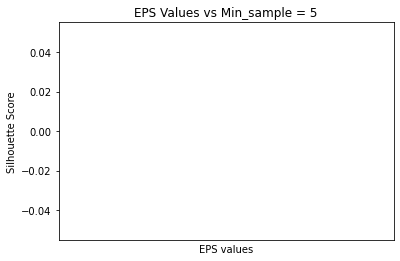

invalid eps 0.1 with range 6
invalid eps 0.2 with range 6
invalid eps 0.30000000000000004 with range 6
invalid eps 0.4 with range 6
invalid eps 0.5 with range 6
invalid eps 0.6 with range 6
invalid eps 0.7000000000000001 with range 6
invalid eps 0.8 with range 6
invalid eps 0.9 with range 6
invalid eps 1.0 with range 6
invalid eps 1.1 with range 6
invalid eps 1.2000000000000002 with range 6
invalid eps 1.3000000000000003 with range 6
invalid eps 1.4000000000000001 with range 6
invalid eps 1.5000000000000002 with range 6
invalid eps 1.6 with range 6
invalid eps 1.7000000000000002 with range 6
invalid eps 1.8000000000000003 with range 6
invalid eps 1.9000000000000001 with range 6
invalid eps 2.0 with range 6
invalid eps 2.1 with range 6
invalid eps 2.2 with range 6
invalid eps 2.3000000000000003 with range 6
invalid eps 2.4000000000000004 with range 6
invalid eps 2.5000000000000004 with range 6
invalid eps 2.6 with range 6
invalid eps 2.7 with range 6
invalid eps 2.8000000000000003 with 

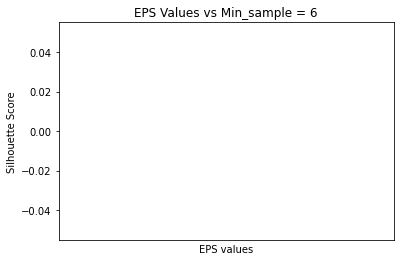

invalid eps 0.1 with range 7
invalid eps 0.2 with range 7
invalid eps 0.30000000000000004 with range 7
invalid eps 0.4 with range 7
invalid eps 0.5 with range 7
invalid eps 0.6 with range 7
invalid eps 0.7000000000000001 with range 7
invalid eps 0.8 with range 7
invalid eps 0.9 with range 7
invalid eps 1.0 with range 7
invalid eps 1.1 with range 7
invalid eps 1.2000000000000002 with range 7
invalid eps 1.3000000000000003 with range 7
invalid eps 1.4000000000000001 with range 7
invalid eps 1.5000000000000002 with range 7
invalid eps 1.6 with range 7
invalid eps 1.7000000000000002 with range 7
invalid eps 1.8000000000000003 with range 7
invalid eps 1.9000000000000001 with range 7
invalid eps 2.0 with range 7
invalid eps 2.1 with range 7
invalid eps 2.2 with range 7
invalid eps 2.3000000000000003 with range 7
invalid eps 2.4000000000000004 with range 7
invalid eps 2.5000000000000004 with range 7
invalid eps 2.6 with range 7
invalid eps 2.7 with range 7
invalid eps 2.8000000000000003 with 

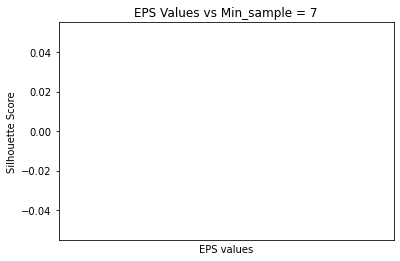

invalid eps 0.1 with range 8
invalid eps 0.2 with range 8
invalid eps 0.30000000000000004 with range 8
invalid eps 0.4 with range 8
invalid eps 0.5 with range 8
invalid eps 0.6 with range 8
invalid eps 0.7000000000000001 with range 8
invalid eps 0.8 with range 8
invalid eps 0.9 with range 8
invalid eps 1.0 with range 8
invalid eps 1.1 with range 8
invalid eps 1.2000000000000002 with range 8
invalid eps 1.3000000000000003 with range 8
invalid eps 1.4000000000000001 with range 8
invalid eps 1.5000000000000002 with range 8
invalid eps 1.6 with range 8
invalid eps 1.7000000000000002 with range 8
invalid eps 1.8000000000000003 with range 8
invalid eps 1.9000000000000001 with range 8
invalid eps 2.0 with range 8
invalid eps 2.1 with range 8
invalid eps 2.2 with range 8
invalid eps 2.3000000000000003 with range 8
invalid eps 2.4000000000000004 with range 8
invalid eps 2.5000000000000004 with range 8
invalid eps 2.6 with range 8
invalid eps 2.7 with range 8
invalid eps 2.8000000000000003 with 

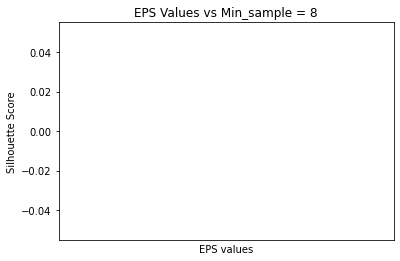

invalid eps 0.1 with range 9
invalid eps 0.2 with range 9
invalid eps 0.30000000000000004 with range 9
invalid eps 0.4 with range 9
invalid eps 0.5 with range 9
invalid eps 0.6 with range 9
invalid eps 0.7000000000000001 with range 9
invalid eps 0.8 with range 9
invalid eps 0.9 with range 9
invalid eps 1.0 with range 9
invalid eps 1.1 with range 9
invalid eps 1.2000000000000002 with range 9
invalid eps 1.3000000000000003 with range 9
invalid eps 1.4000000000000001 with range 9
invalid eps 1.5000000000000002 with range 9
invalid eps 1.6 with range 9
invalid eps 1.7000000000000002 with range 9
invalid eps 1.8000000000000003 with range 9
invalid eps 1.9000000000000001 with range 9
invalid eps 2.0 with range 9
invalid eps 2.1 with range 9
invalid eps 2.2 with range 9
invalid eps 2.3000000000000003 with range 9
invalid eps 2.4000000000000004 with range 9
invalid eps 2.5000000000000004 with range 9
invalid eps 2.6 with range 9
invalid eps 2.7 with range 9
invalid eps 2.8000000000000003 with 

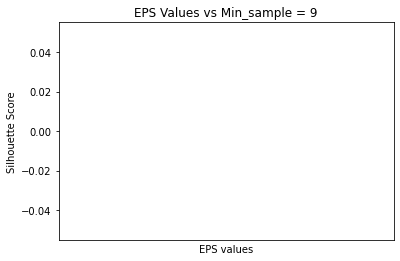

invalid eps 0.1 with range 10
invalid eps 0.2 with range 10
invalid eps 0.30000000000000004 with range 10
invalid eps 0.4 with range 10
invalid eps 0.5 with range 10
invalid eps 0.6 with range 10
invalid eps 0.7000000000000001 with range 10
invalid eps 0.8 with range 10
invalid eps 0.9 with range 10
invalid eps 1.0 with range 10
invalid eps 1.1 with range 10
invalid eps 1.2000000000000002 with range 10
invalid eps 1.3000000000000003 with range 10
invalid eps 1.4000000000000001 with range 10
invalid eps 1.5000000000000002 with range 10
invalid eps 1.6 with range 10
invalid eps 1.7000000000000002 with range 10
invalid eps 1.8000000000000003 with range 10
invalid eps 1.9000000000000001 with range 10
invalid eps 2.0 with range 10
invalid eps 2.1 with range 10
invalid eps 2.2 with range 10
invalid eps 2.3000000000000003 with range 10
invalid eps 2.4000000000000004 with range 10
invalid eps 2.5000000000000004 with range 10
invalid eps 2.6 with range 10
invalid eps 2.7 with range 10
invalid e

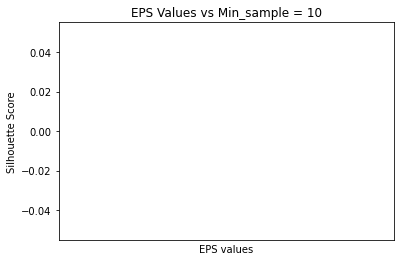

invalid eps 0.1 with range 11
invalid eps 0.2 with range 11
invalid eps 0.30000000000000004 with range 11
invalid eps 0.4 with range 11
invalid eps 0.5 with range 11
invalid eps 0.6 with range 11
invalid eps 0.7000000000000001 with range 11
invalid eps 0.8 with range 11
invalid eps 0.9 with range 11
invalid eps 1.0 with range 11
invalid eps 1.1 with range 11
invalid eps 1.2000000000000002 with range 11
invalid eps 1.3000000000000003 with range 11
invalid eps 1.4000000000000001 with range 11
invalid eps 1.5000000000000002 with range 11
invalid eps 1.6 with range 11
invalid eps 1.7000000000000002 with range 11
invalid eps 1.8000000000000003 with range 11
invalid eps 1.9000000000000001 with range 11
invalid eps 2.0 with range 11
invalid eps 2.1 with range 11
invalid eps 2.2 with range 11
invalid eps 2.3000000000000003 with range 11
invalid eps 2.4000000000000004 with range 11
invalid eps 2.5000000000000004 with range 11
invalid eps 2.6 with range 11
invalid eps 2.7 with range 11
invalid e

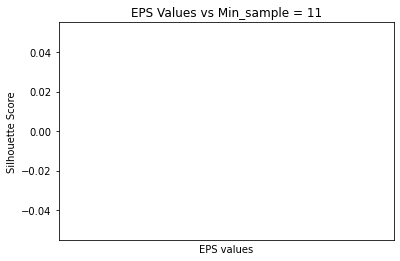

invalid eps 0.1 with range 12
invalid eps 0.2 with range 12
invalid eps 0.30000000000000004 with range 12
invalid eps 0.4 with range 12
invalid eps 0.5 with range 12
invalid eps 0.6 with range 12
invalid eps 0.7000000000000001 with range 12
invalid eps 0.8 with range 12
invalid eps 0.9 with range 12
invalid eps 1.0 with range 12
invalid eps 1.1 with range 12
invalid eps 1.2000000000000002 with range 12
invalid eps 1.3000000000000003 with range 12
invalid eps 1.4000000000000001 with range 12
invalid eps 1.5000000000000002 with range 12
invalid eps 1.6 with range 12
invalid eps 1.7000000000000002 with range 12
invalid eps 1.8000000000000003 with range 12
invalid eps 1.9000000000000001 with range 12
invalid eps 2.0 with range 12
invalid eps 2.1 with range 12
invalid eps 2.2 with range 12
invalid eps 2.3000000000000003 with range 12
invalid eps 2.4000000000000004 with range 12
invalid eps 2.5000000000000004 with range 12
invalid eps 2.6 with range 12
invalid eps 2.7 with range 12
invalid e

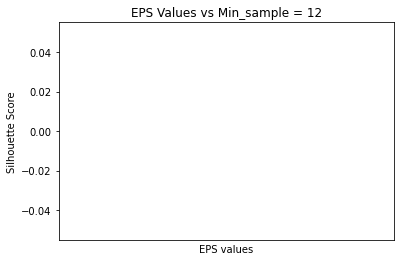

invalid eps 0.1 with range 13
invalid eps 0.2 with range 13
invalid eps 0.30000000000000004 with range 13
invalid eps 0.4 with range 13
invalid eps 0.5 with range 13
invalid eps 0.6 with range 13
invalid eps 0.7000000000000001 with range 13
invalid eps 0.8 with range 13
invalid eps 0.9 with range 13
invalid eps 1.0 with range 13
invalid eps 1.1 with range 13
invalid eps 1.2000000000000002 with range 13
invalid eps 1.3000000000000003 with range 13
invalid eps 1.4000000000000001 with range 13
invalid eps 1.5000000000000002 with range 13
invalid eps 1.6 with range 13
invalid eps 1.7000000000000002 with range 13
invalid eps 1.8000000000000003 with range 13
invalid eps 1.9000000000000001 with range 13
invalid eps 2.0 with range 13
invalid eps 2.1 with range 13
invalid eps 2.2 with range 13
invalid eps 2.3000000000000003 with range 13
invalid eps 2.4000000000000004 with range 13
invalid eps 2.5000000000000004 with range 13
invalid eps 2.6 with range 13
invalid eps 2.7 with range 13
invalid e

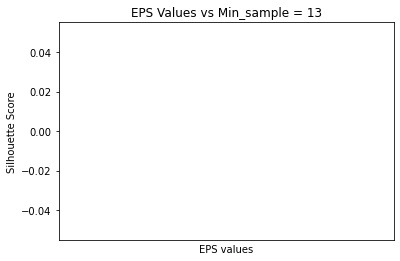

invalid eps 0.1 with range 14
invalid eps 0.2 with range 14
invalid eps 0.30000000000000004 with range 14
invalid eps 0.4 with range 14
invalid eps 0.5 with range 14
invalid eps 0.6 with range 14
invalid eps 0.7000000000000001 with range 14
invalid eps 0.8 with range 14
invalid eps 0.9 with range 14
invalid eps 1.0 with range 14
invalid eps 1.1 with range 14
invalid eps 1.2000000000000002 with range 14
invalid eps 1.3000000000000003 with range 14
invalid eps 1.4000000000000001 with range 14
invalid eps 1.5000000000000002 with range 14
invalid eps 1.6 with range 14
invalid eps 1.7000000000000002 with range 14
invalid eps 1.8000000000000003 with range 14
invalid eps 1.9000000000000001 with range 14
invalid eps 2.0 with range 14
invalid eps 2.1 with range 14
invalid eps 2.2 with range 14
invalid eps 2.3000000000000003 with range 14
invalid eps 2.4000000000000004 with range 14
invalid eps 2.5000000000000004 with range 14
invalid eps 2.6 with range 14
invalid eps 2.7 with range 14
invalid e

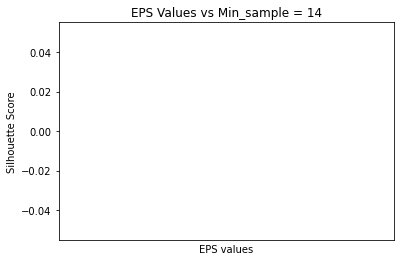

invalid eps 0.1 with range 15
invalid eps 0.2 with range 15
invalid eps 0.30000000000000004 with range 15
invalid eps 0.4 with range 15
invalid eps 0.5 with range 15
invalid eps 0.6 with range 15
invalid eps 0.7000000000000001 with range 15
invalid eps 0.8 with range 15
invalid eps 0.9 with range 15
invalid eps 1.0 with range 15
invalid eps 1.1 with range 15
invalid eps 1.2000000000000002 with range 15
invalid eps 1.3000000000000003 with range 15
invalid eps 1.4000000000000001 with range 15
invalid eps 1.5000000000000002 with range 15
invalid eps 1.6 with range 15
invalid eps 1.7000000000000002 with range 15
invalid eps 1.8000000000000003 with range 15
invalid eps 1.9000000000000001 with range 15
invalid eps 2.0 with range 15
invalid eps 2.1 with range 15
invalid eps 2.2 with range 15
invalid eps 2.3000000000000003 with range 15
invalid eps 2.4000000000000004 with range 15
invalid eps 2.5000000000000004 with range 15
invalid eps 2.6 with range 15
invalid eps 2.7 with range 15
invalid e

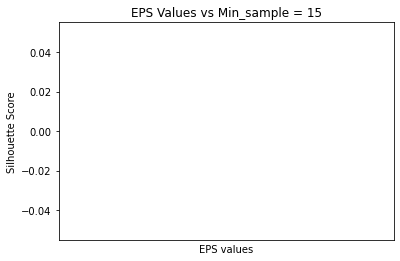

invalid eps 0.1 with range 16
invalid eps 0.2 with range 16
invalid eps 0.30000000000000004 with range 16
invalid eps 0.4 with range 16
invalid eps 0.5 with range 16
invalid eps 0.6 with range 16
invalid eps 0.7000000000000001 with range 16
invalid eps 0.8 with range 16
invalid eps 0.9 with range 16
invalid eps 1.0 with range 16
invalid eps 1.1 with range 16
invalid eps 1.2000000000000002 with range 16
invalid eps 1.3000000000000003 with range 16
invalid eps 1.4000000000000001 with range 16
invalid eps 1.5000000000000002 with range 16
invalid eps 1.6 with range 16
invalid eps 1.7000000000000002 with range 16
invalid eps 1.8000000000000003 with range 16
invalid eps 1.9000000000000001 with range 16
invalid eps 2.0 with range 16
invalid eps 2.1 with range 16
invalid eps 2.2 with range 16
invalid eps 2.3000000000000003 with range 16
invalid eps 2.4000000000000004 with range 16
invalid eps 2.5000000000000004 with range 16
invalid eps 2.6 with range 16
invalid eps 2.7 with range 16
invalid e

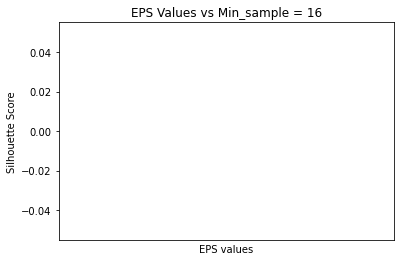

invalid eps 0.1 with range 17
invalid eps 0.2 with range 17
invalid eps 0.30000000000000004 with range 17
invalid eps 0.4 with range 17
invalid eps 0.5 with range 17
invalid eps 0.6 with range 17
invalid eps 0.7000000000000001 with range 17
invalid eps 0.8 with range 17
invalid eps 0.9 with range 17
invalid eps 1.0 with range 17
invalid eps 1.1 with range 17
invalid eps 1.2000000000000002 with range 17
invalid eps 1.3000000000000003 with range 17
invalid eps 1.4000000000000001 with range 17
invalid eps 1.5000000000000002 with range 17
invalid eps 1.6 with range 17
invalid eps 1.7000000000000002 with range 17
invalid eps 1.8000000000000003 with range 17
invalid eps 1.9000000000000001 with range 17
invalid eps 2.0 with range 17
invalid eps 2.1 with range 17
invalid eps 2.2 with range 17
invalid eps 2.3000000000000003 with range 17
invalid eps 2.4000000000000004 with range 17
invalid eps 2.5000000000000004 with range 17
invalid eps 2.6 with range 17
invalid eps 2.7 with range 17
invalid e

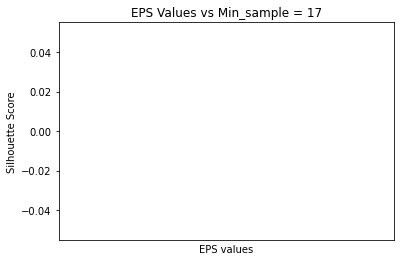

invalid eps 0.1 with range 18
invalid eps 0.2 with range 18
invalid eps 0.30000000000000004 with range 18
invalid eps 0.4 with range 18
invalid eps 0.5 with range 18
invalid eps 0.6 with range 18
invalid eps 0.7000000000000001 with range 18
invalid eps 0.8 with range 18
invalid eps 0.9 with range 18
invalid eps 1.0 with range 18
invalid eps 1.1 with range 18
invalid eps 1.2000000000000002 with range 18
invalid eps 1.3000000000000003 with range 18
invalid eps 1.4000000000000001 with range 18
invalid eps 1.5000000000000002 with range 18
invalid eps 1.6 with range 18
invalid eps 1.7000000000000002 with range 18
invalid eps 1.8000000000000003 with range 18
invalid eps 1.9000000000000001 with range 18
invalid eps 2.0 with range 18
invalid eps 2.1 with range 18
invalid eps 2.2 with range 18
invalid eps 2.3000000000000003 with range 18
invalid eps 2.4000000000000004 with range 18
invalid eps 2.5000000000000004 with range 18
invalid eps 2.6 with range 18
invalid eps 2.7 with range 18
invalid e

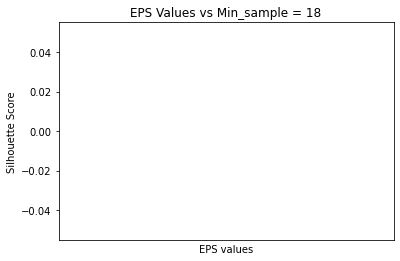

invalid eps 0.1 with range 19
invalid eps 0.2 with range 19
invalid eps 0.30000000000000004 with range 19
invalid eps 0.4 with range 19
invalid eps 0.5 with range 19
invalid eps 0.6 with range 19
invalid eps 0.7000000000000001 with range 19
invalid eps 0.8 with range 19
invalid eps 0.9 with range 19
invalid eps 1.0 with range 19
invalid eps 1.1 with range 19
invalid eps 1.2000000000000002 with range 19
invalid eps 1.3000000000000003 with range 19
invalid eps 1.4000000000000001 with range 19
invalid eps 1.5000000000000002 with range 19
invalid eps 1.6 with range 19
invalid eps 1.7000000000000002 with range 19
invalid eps 1.8000000000000003 with range 19
invalid eps 1.9000000000000001 with range 19
invalid eps 2.0 with range 19
invalid eps 2.1 with range 19
invalid eps 2.2 with range 19
invalid eps 2.3000000000000003 with range 19
invalid eps 2.4000000000000004 with range 19
invalid eps 2.5000000000000004 with range 19
invalid eps 2.6 with range 19
invalid eps 2.7 with range 19
invalid e

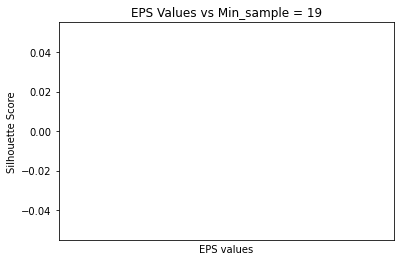

invalid eps 0.1 with range 20
invalid eps 0.2 with range 20
invalid eps 0.30000000000000004 with range 20
invalid eps 0.4 with range 20
invalid eps 0.5 with range 20
invalid eps 0.6 with range 20
invalid eps 0.7000000000000001 with range 20
invalid eps 0.8 with range 20
invalid eps 0.9 with range 20
invalid eps 1.0 with range 20
invalid eps 1.1 with range 20
invalid eps 1.2000000000000002 with range 20
invalid eps 1.3000000000000003 with range 20
invalid eps 1.4000000000000001 with range 20
invalid eps 1.5000000000000002 with range 20
invalid eps 1.6 with range 20
invalid eps 1.7000000000000002 with range 20
invalid eps 1.8000000000000003 with range 20
invalid eps 1.9000000000000001 with range 20
invalid eps 2.0 with range 20
invalid eps 2.1 with range 20
invalid eps 2.2 with range 20
invalid eps 2.3000000000000003 with range 20
invalid eps 2.4000000000000004 with range 20
invalid eps 2.5000000000000004 with range 20
invalid eps 2.6 with range 20
invalid eps 2.7 with range 20
invalid e

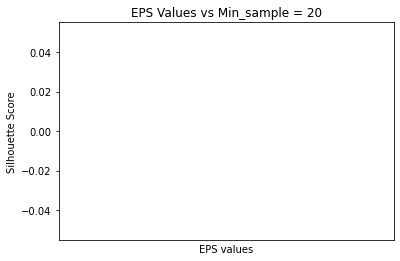

invalid eps 0.1 with range 21
invalid eps 0.2 with range 21
invalid eps 0.30000000000000004 with range 21
invalid eps 0.4 with range 21
invalid eps 0.5 with range 21
invalid eps 0.6 with range 21
invalid eps 0.7000000000000001 with range 21
invalid eps 0.8 with range 21
invalid eps 0.9 with range 21
invalid eps 1.0 with range 21
invalid eps 1.1 with range 21
invalid eps 1.2000000000000002 with range 21
invalid eps 1.3000000000000003 with range 21
invalid eps 1.4000000000000001 with range 21
invalid eps 1.5000000000000002 with range 21
invalid eps 1.6 with range 21
invalid eps 1.7000000000000002 with range 21
invalid eps 1.8000000000000003 with range 21
invalid eps 1.9000000000000001 with range 21
invalid eps 2.0 with range 21
invalid eps 2.1 with range 21
invalid eps 2.2 with range 21
invalid eps 2.3000000000000003 with range 21
invalid eps 2.4000000000000004 with range 21
invalid eps 2.5000000000000004 with range 21
invalid eps 2.6 with range 21
invalid eps 2.7 with range 21
invalid e

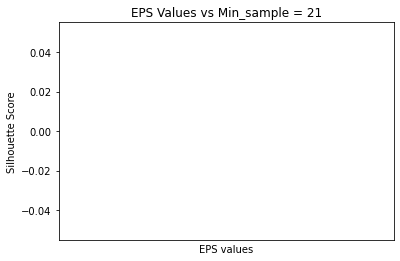

invalid eps 0.1 with range 22
invalid eps 0.2 with range 22
invalid eps 0.30000000000000004 with range 22
invalid eps 0.4 with range 22
invalid eps 0.5 with range 22
invalid eps 0.6 with range 22
invalid eps 0.7000000000000001 with range 22
invalid eps 0.8 with range 22
invalid eps 0.9 with range 22
invalid eps 1.0 with range 22
invalid eps 1.1 with range 22
invalid eps 1.2000000000000002 with range 22
invalid eps 1.3000000000000003 with range 22
invalid eps 1.4000000000000001 with range 22
invalid eps 1.5000000000000002 with range 22
invalid eps 1.6 with range 22
invalid eps 1.7000000000000002 with range 22
invalid eps 1.8000000000000003 with range 22
invalid eps 1.9000000000000001 with range 22
invalid eps 2.0 with range 22
invalid eps 2.1 with range 22
invalid eps 2.2 with range 22
invalid eps 2.3000000000000003 with range 22
invalid eps 2.4000000000000004 with range 22
invalid eps 2.5000000000000004 with range 22
invalid eps 2.6 with range 22
invalid eps 2.7 with range 22
invalid e

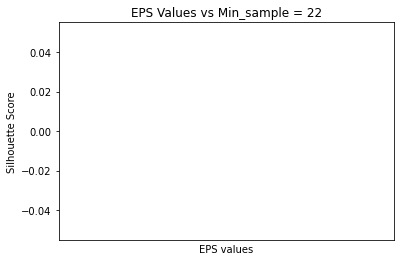

invalid eps 0.1 with range 23
invalid eps 0.2 with range 23
invalid eps 0.30000000000000004 with range 23
invalid eps 0.4 with range 23
invalid eps 0.5 with range 23
invalid eps 0.6 with range 23
invalid eps 0.7000000000000001 with range 23
invalid eps 0.8 with range 23
invalid eps 0.9 with range 23
invalid eps 1.0 with range 23
invalid eps 1.1 with range 23
invalid eps 1.2000000000000002 with range 23
invalid eps 1.3000000000000003 with range 23
invalid eps 1.4000000000000001 with range 23
invalid eps 1.5000000000000002 with range 23
invalid eps 1.6 with range 23
invalid eps 1.7000000000000002 with range 23
invalid eps 1.8000000000000003 with range 23
invalid eps 1.9000000000000001 with range 23
invalid eps 2.0 with range 23
invalid eps 2.1 with range 23
invalid eps 2.2 with range 23
invalid eps 2.3000000000000003 with range 23
invalid eps 2.4000000000000004 with range 23
invalid eps 2.5000000000000004 with range 23
invalid eps 2.6 with range 23
invalid eps 2.7 with range 23
invalid e

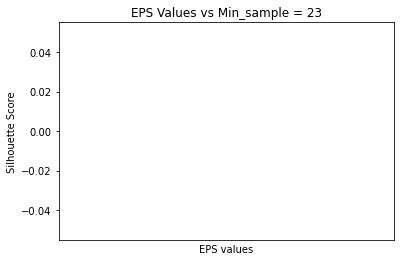

invalid eps 0.1 with range 24
invalid eps 0.2 with range 24
invalid eps 0.30000000000000004 with range 24
invalid eps 0.4 with range 24
invalid eps 0.5 with range 24
invalid eps 0.6 with range 24
invalid eps 0.7000000000000001 with range 24
invalid eps 0.8 with range 24
invalid eps 0.9 with range 24
invalid eps 1.0 with range 24
invalid eps 1.1 with range 24
invalid eps 1.2000000000000002 with range 24
invalid eps 1.3000000000000003 with range 24
invalid eps 1.4000000000000001 with range 24
invalid eps 1.5000000000000002 with range 24
invalid eps 1.6 with range 24
invalid eps 1.7000000000000002 with range 24
invalid eps 1.8000000000000003 with range 24
invalid eps 1.9000000000000001 with range 24
invalid eps 2.0 with range 24
invalid eps 2.1 with range 24
invalid eps 2.2 with range 24
invalid eps 2.3000000000000003 with range 24
invalid eps 2.4000000000000004 with range 24
invalid eps 2.5000000000000004 with range 24
invalid eps 2.6 with range 24
invalid eps 2.7 with range 24
invalid e

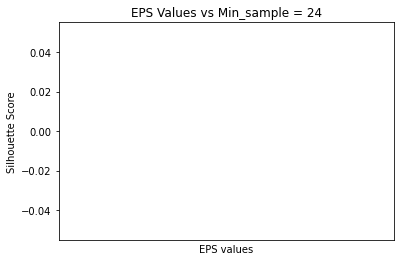

invalid eps 0.1 with range 25
invalid eps 0.2 with range 25
invalid eps 0.30000000000000004 with range 25
invalid eps 0.4 with range 25
invalid eps 0.5 with range 25
invalid eps 0.6 with range 25
invalid eps 0.7000000000000001 with range 25
invalid eps 0.8 with range 25
invalid eps 0.9 with range 25
invalid eps 1.0 with range 25
invalid eps 1.1 with range 25
invalid eps 1.2000000000000002 with range 25
invalid eps 1.3000000000000003 with range 25
invalid eps 1.4000000000000001 with range 25
invalid eps 1.5000000000000002 with range 25
invalid eps 1.6 with range 25
invalid eps 1.7000000000000002 with range 25
invalid eps 1.8000000000000003 with range 25
invalid eps 1.9000000000000001 with range 25
invalid eps 2.0 with range 25
invalid eps 2.1 with range 25
invalid eps 2.2 with range 25
invalid eps 2.3000000000000003 with range 25
invalid eps 2.4000000000000004 with range 25
invalid eps 2.5000000000000004 with range 25
invalid eps 2.6 with range 25
invalid eps 2.7 with range 25
invalid e

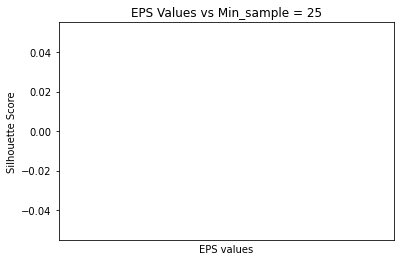

The max Silhouette Score is 0 with eps equal to 0 and min_samples equal to 0


In [6]:
min_samples_list=range(5,26,1)
min_samples_range= len(range(5,26,1))
epsss=np.arange(0.1, 3.1, 0.1)
eps_range=len(np.arange(0.1, 3.1, 0.1))
best_silhouette_score =0
best_ep=0
best_min_sample=0



if 'temp' in df_customer.columns:
 df_customer.drop('temp', axis=1, inplace=True)
i=0



while min_samples_range - 1 >= i:

  silhouette_scores = []
  valid_eps=[]
  
  j=0
  while eps_range - 1 >= j: 
    dbscan = DBSCAN(eps=epsss[j], min_samples=min_samples_list[i])
    dbscan.fit(df_customer)

    if (len(np.unique(dbscan.labels_)) <= 1):
      print("invalid eps",epsss[j],"with range",min_samples_list[i])
      j+=1
      continue

    valid_eps.append(epsss[j])
    sil_dbscan = silhouette_score(df_customer, dbscan.labels_)
    silhouette_scores.append(sil_dbscan)

    if (best_silhouette_score <= sil_dbscan): 
     best_silhouette_score =sil_dbscan
     best_min_sample=min_samples_list[i]
     best_ep=epsss[j],
    j+=1
 
  plt.plot(valid_eps, silhouette_scores)
  plt.xticks(valid_eps)
  graph_helper= plt.subplot()   
  plt.setp(graph_helper.get_xticklabels(), rotation=90, ha='right')
  plt.title("EPS Values vs Min_sample = " + str(min_samples_list[i]))
  plt.xlabel("EPS values")
  plt.ylabel("Silhouette Score")
  plt.show() 
  i+=1

      

print("The max Silhouette Score is", best_silhouette_score ,"with eps equal to" , best_ep , "and min_samples equal to", best_min_sample )

        

##HIRI Coustomer Data

cityblock
average
0.3
0.5
0.7
0.9000000000000001
1.1
['0.0009934837148196309', 'cityblock', 'average', '1.1']


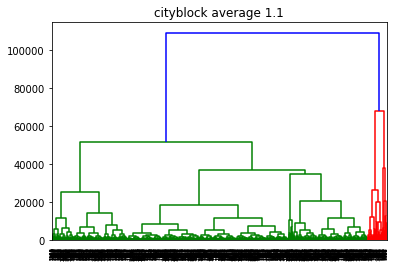

CLuster21


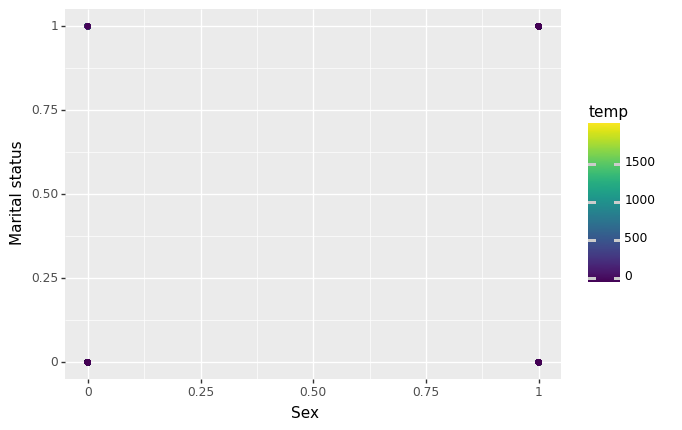

<ggplot: (8766038999173)>
CLuster21


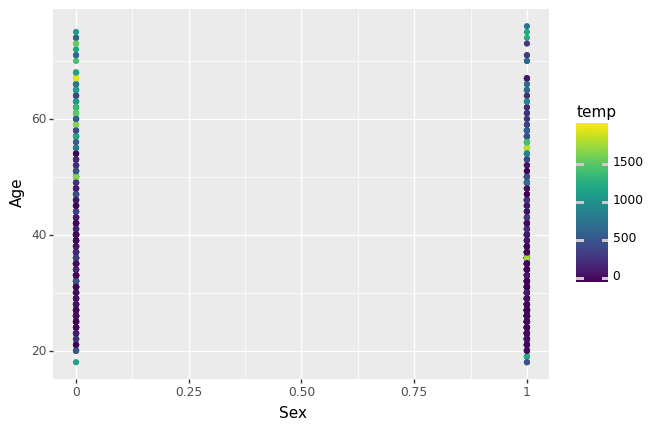

<ggplot: (8766034265493)>
CLuster21


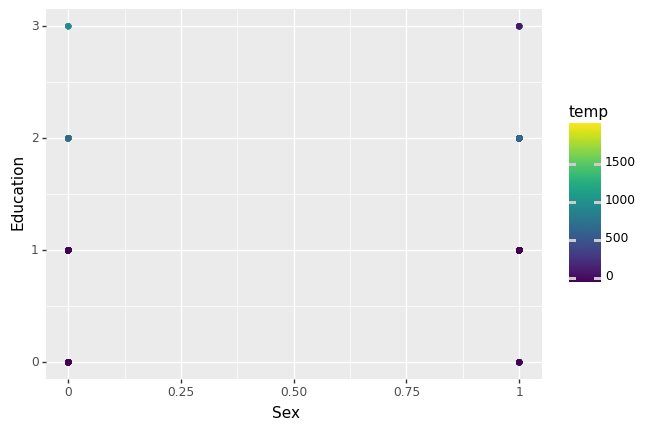

<ggplot: (8766034393933)>
CLuster21


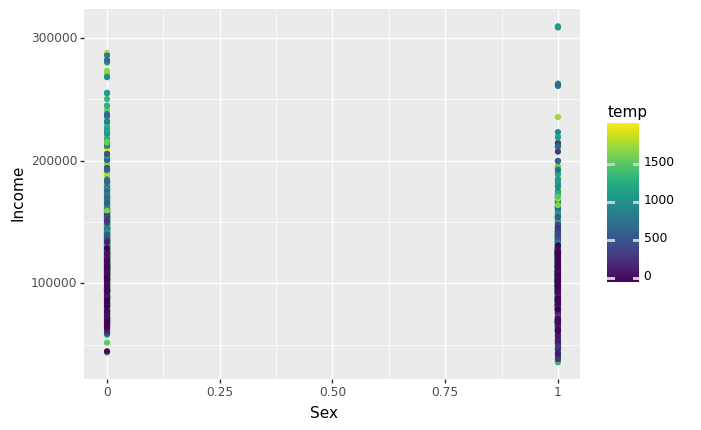

<ggplot: (8766034112253)>
CLuster21


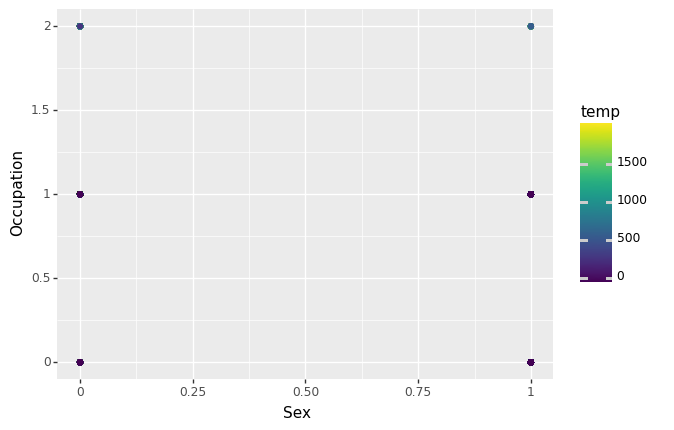

<ggplot: (8766034429325)>
CLuster21


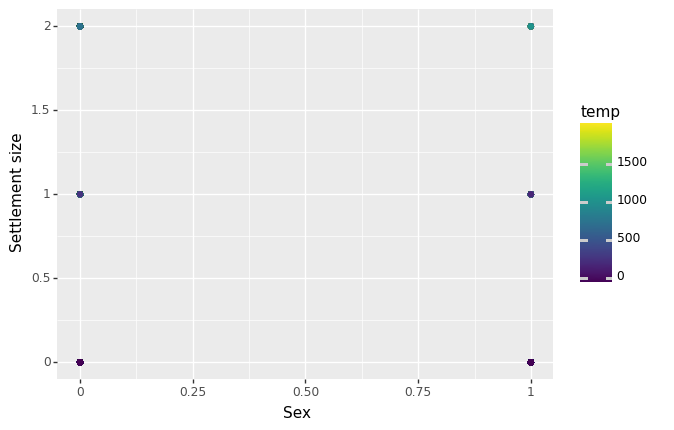

<ggplot: (8766034162617)>
CLuster21


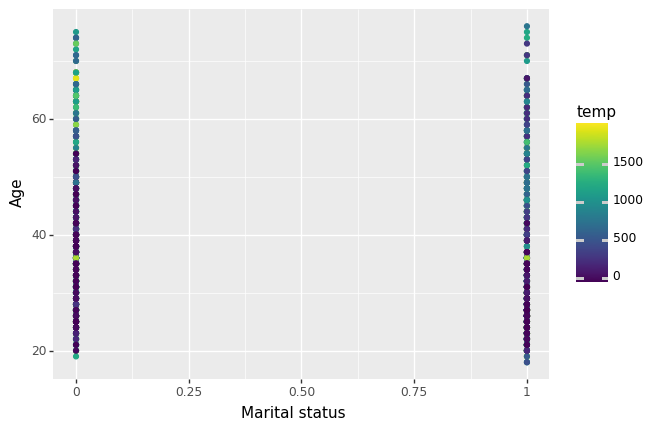

<ggplot: (8766034383637)>
CLuster21


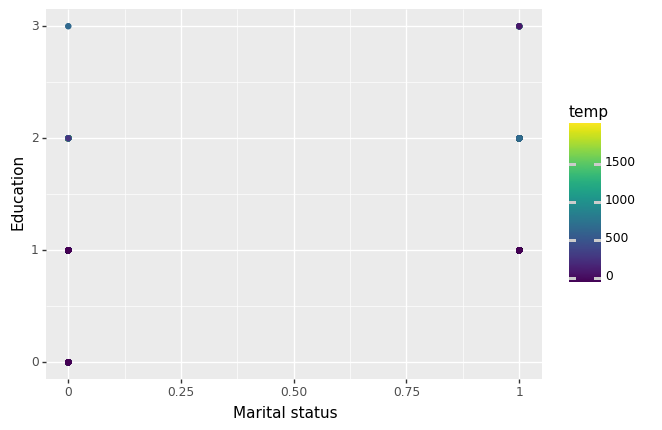

<ggplot: (8766034376609)>
CLuster21


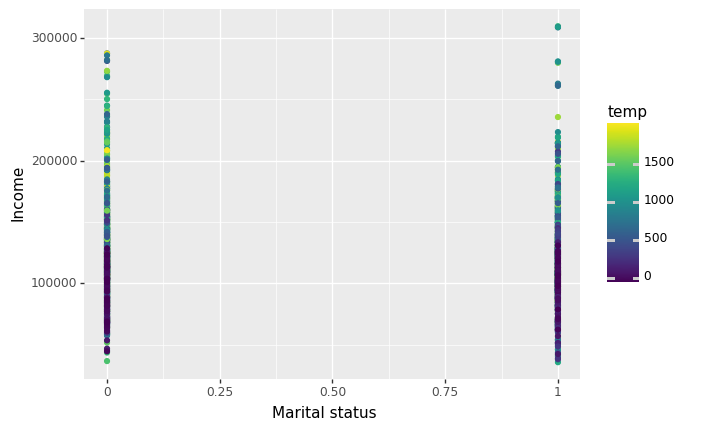

<ggplot: (8766034136917)>
CLuster21


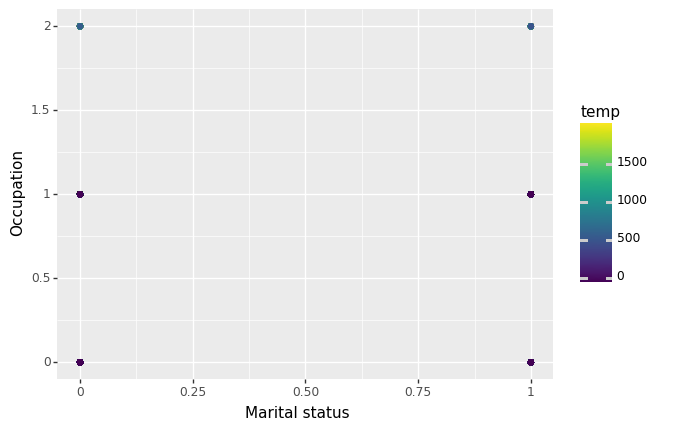

<ggplot: (8766033987709)>
CLuster21


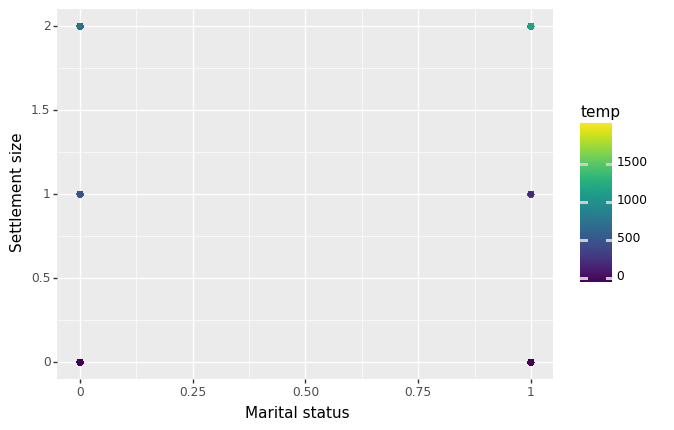

<ggplot: (8766034035429)>
CLuster21


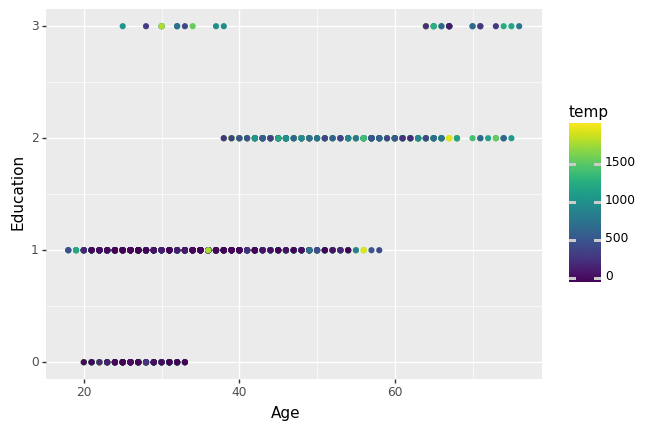

<ggplot: (8766033854733)>
CLuster21


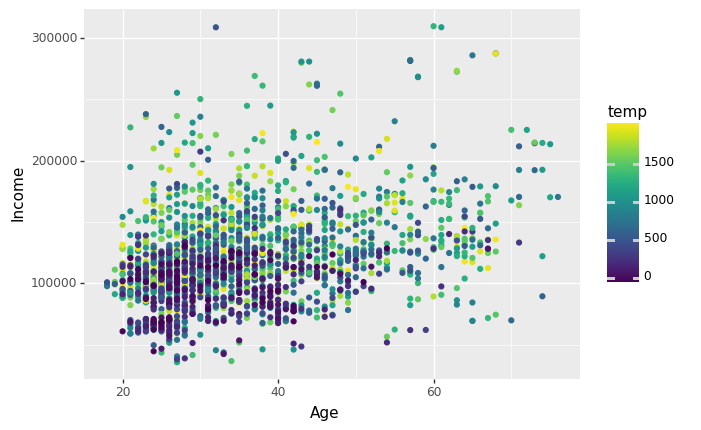

<ggplot: (8766033779157)>
CLuster21


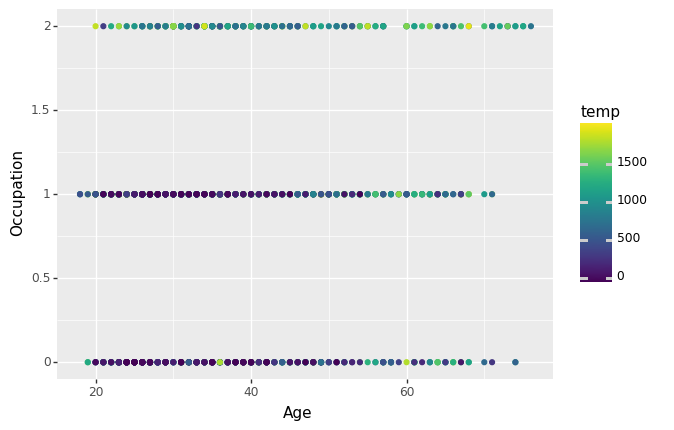

<ggplot: (8766034147621)>
CLuster21


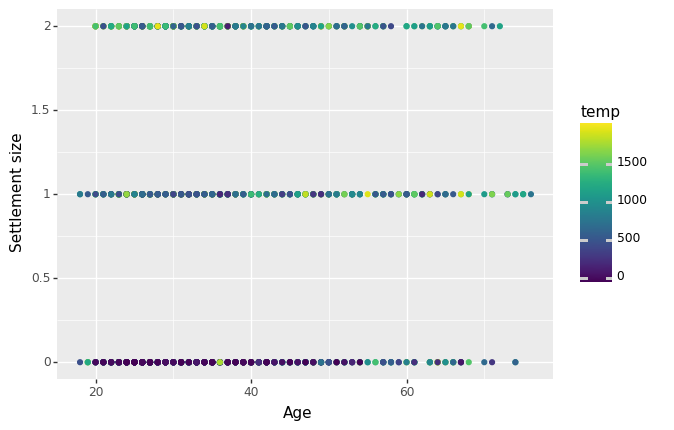

<ggplot: (8766033779101)>
CLuster21


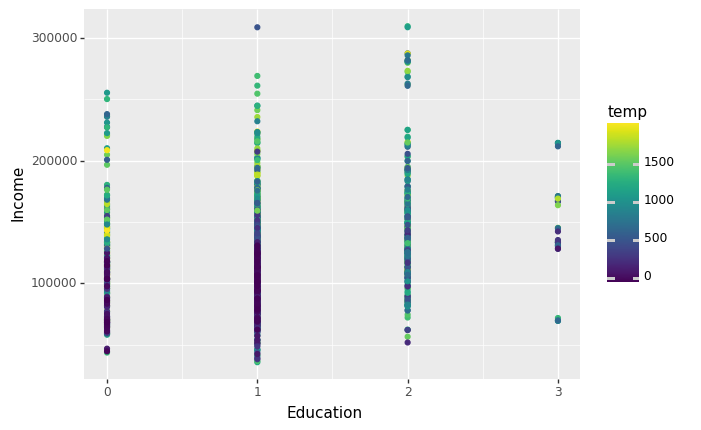

<ggplot: (8766034400469)>
CLuster21


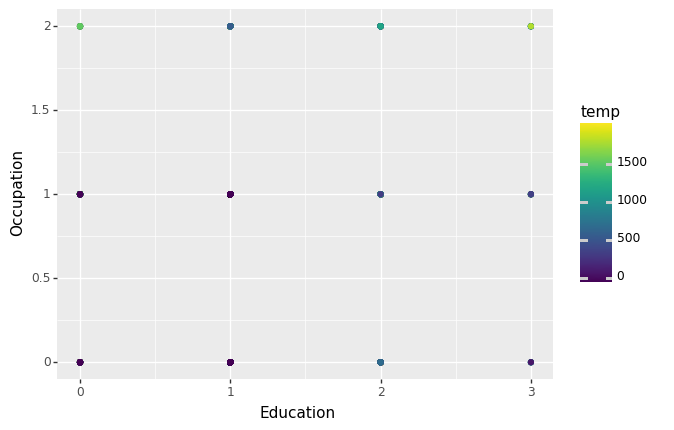

<ggplot: (8766034384517)>
CLuster21


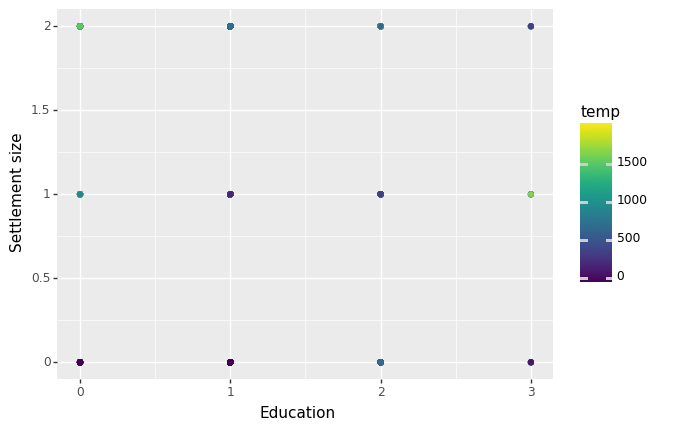

<ggplot: (8766034240673)>
CLuster21


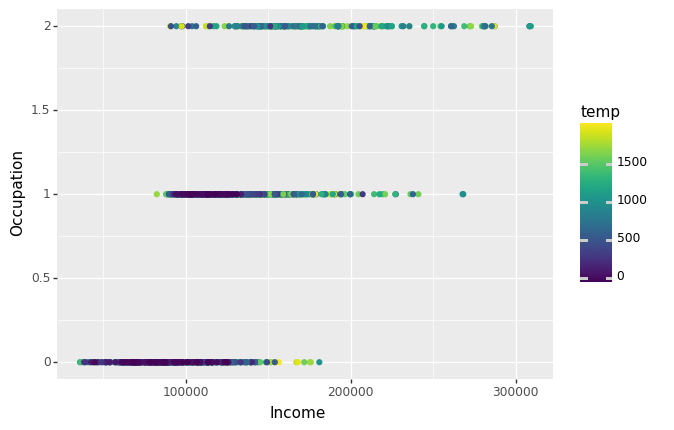

<ggplot: (8766034144469)>
CLuster21


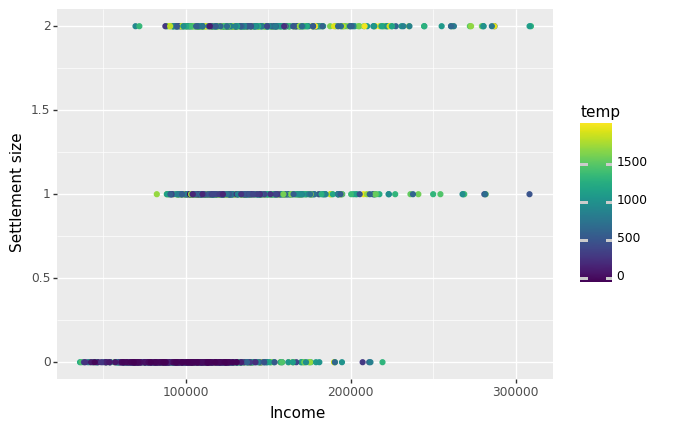

<ggplot: (8766033935345)>
CLuster21


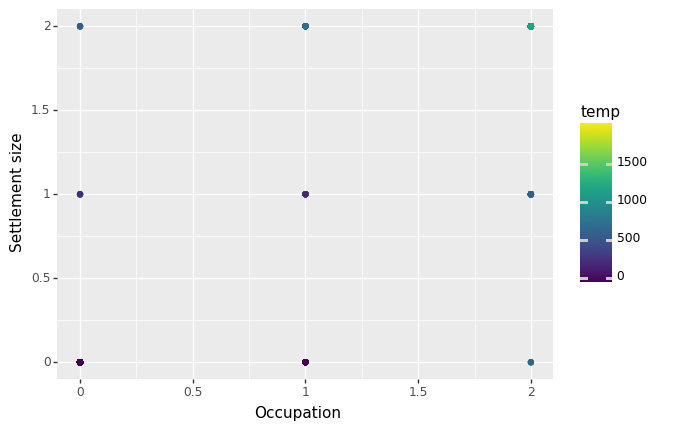

<ggplot: (8766033976897)>
1.3


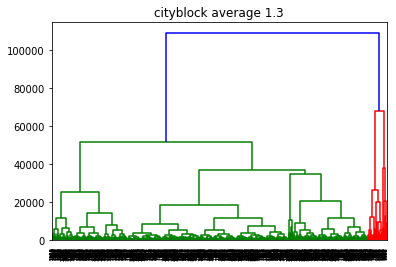

CLuster21


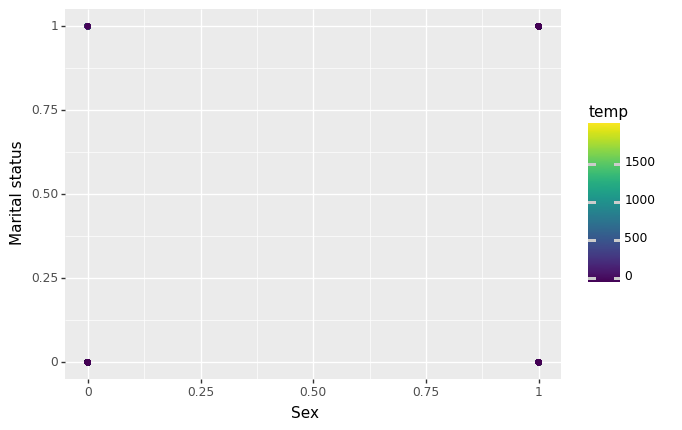

<ggplot: (8766038999105)>
CLuster21


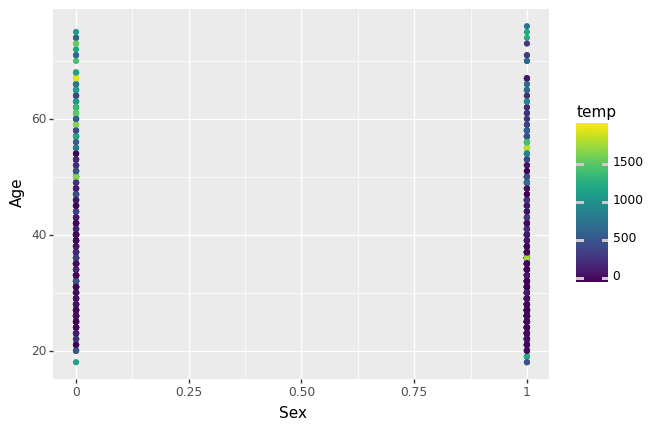

<ggplot: (8766039695501)>
CLuster21


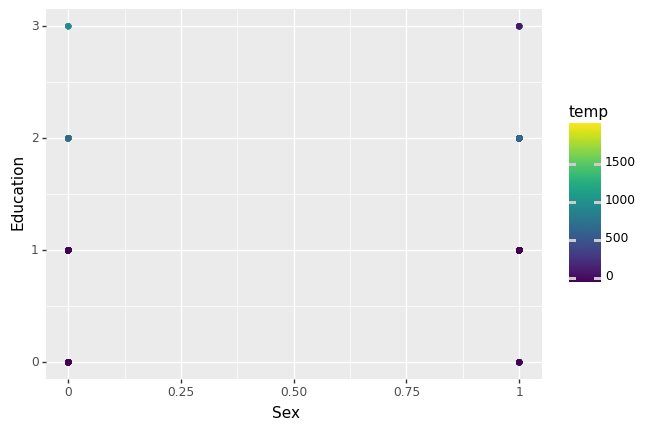

<ggplot: (8766034204869)>
CLuster21


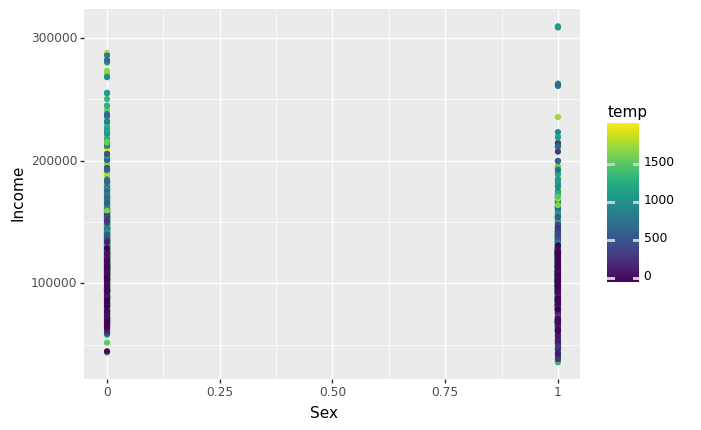

<ggplot: (8766085930221)>
CLuster21


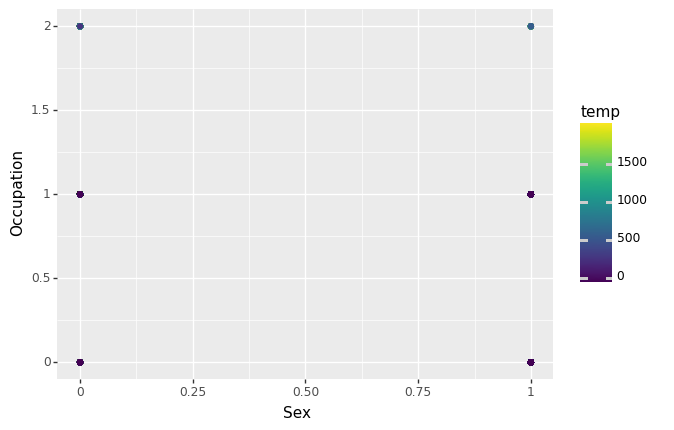

<ggplot: (8766037434365)>
CLuster21


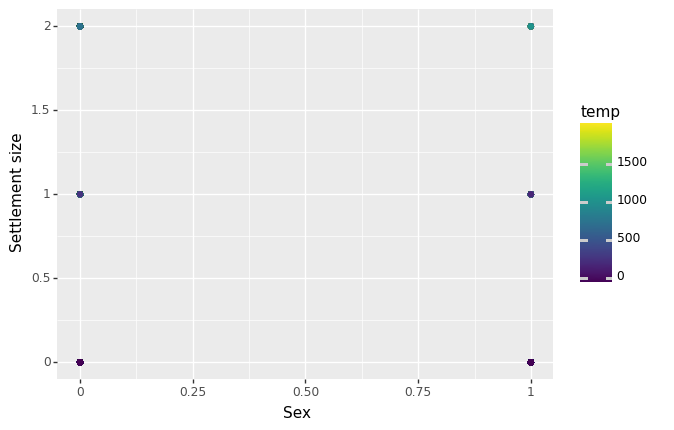

<ggplot: (8766039695501)>
CLuster21


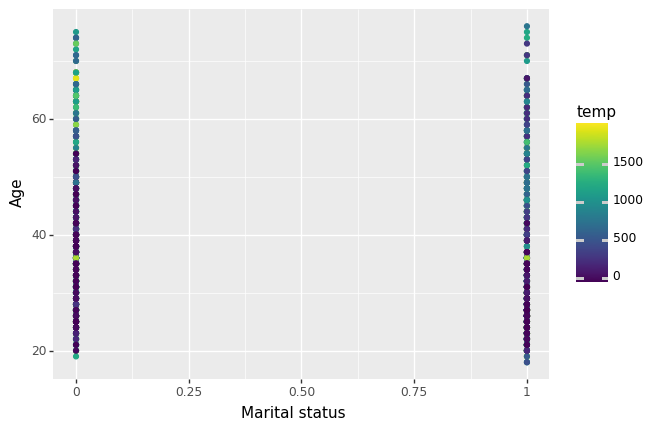

<ggplot: (8766037681309)>
CLuster21


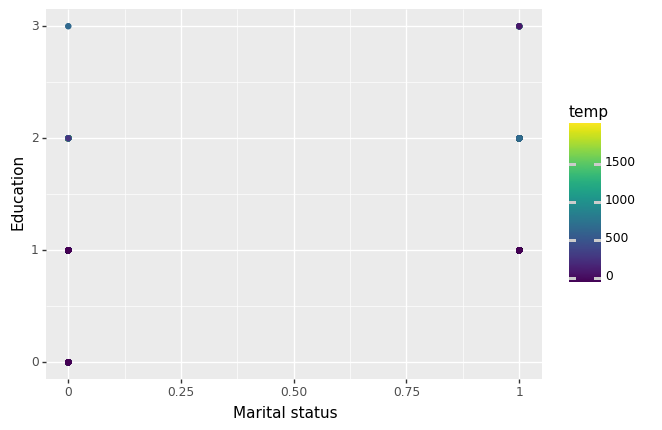

<ggplot: (8766034216633)>
CLuster21


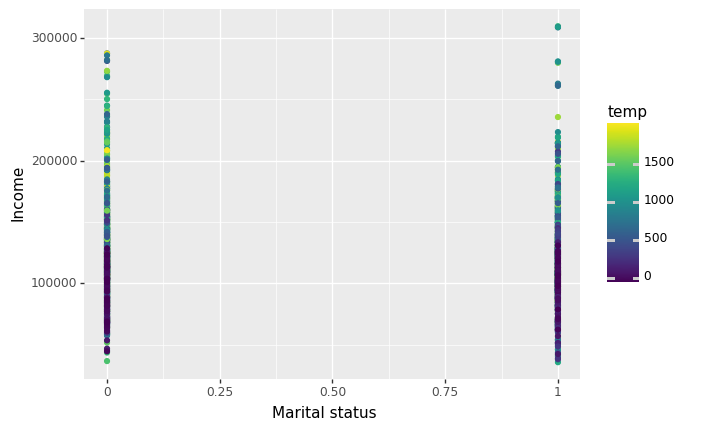

<ggplot: (8766040388489)>
CLuster21


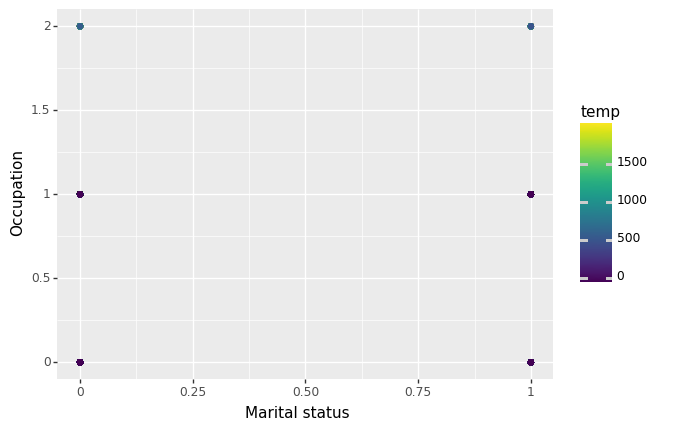

<ggplot: (8766034203857)>
CLuster21


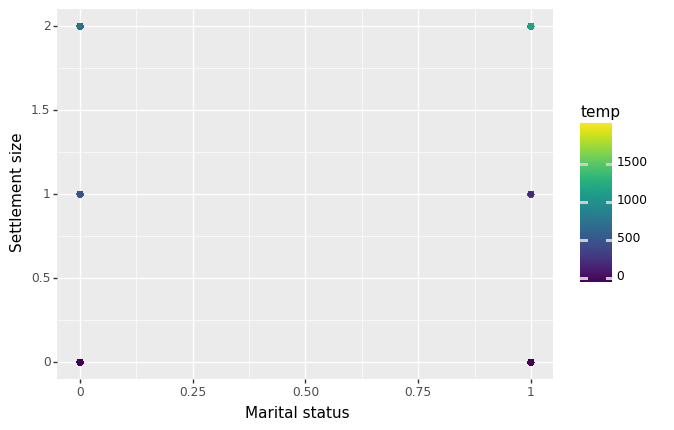

<ggplot: (8766034700477)>
CLuster21


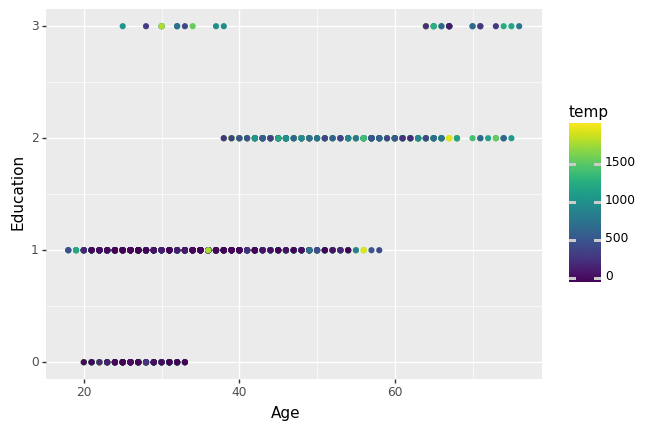

<ggplot: (8766034217869)>
CLuster21


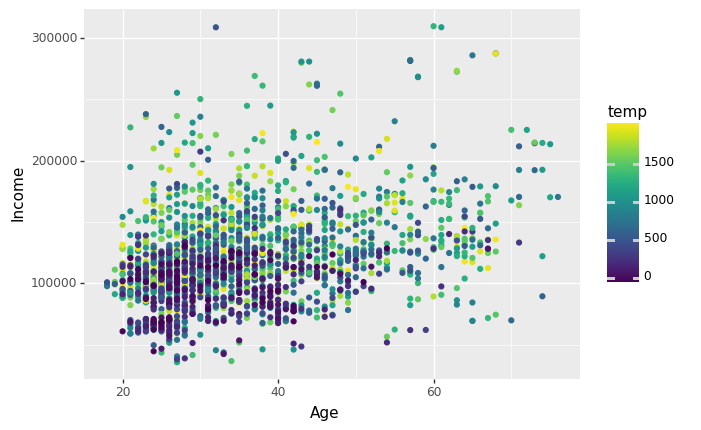

<ggplot: (8766034207573)>
CLuster21


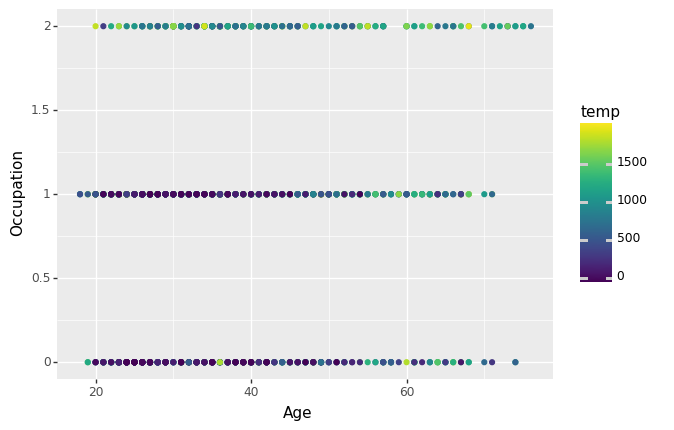

<ggplot: (8766034765065)>
CLuster21


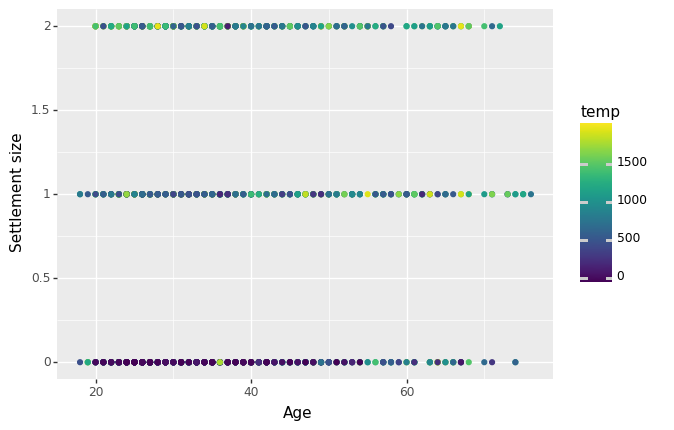

<ggplot: (8766034626253)>
CLuster21


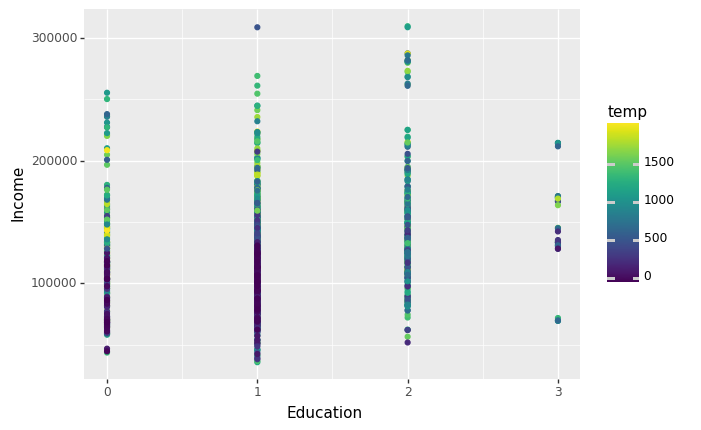

<ggplot: (8766034202621)>
CLuster21


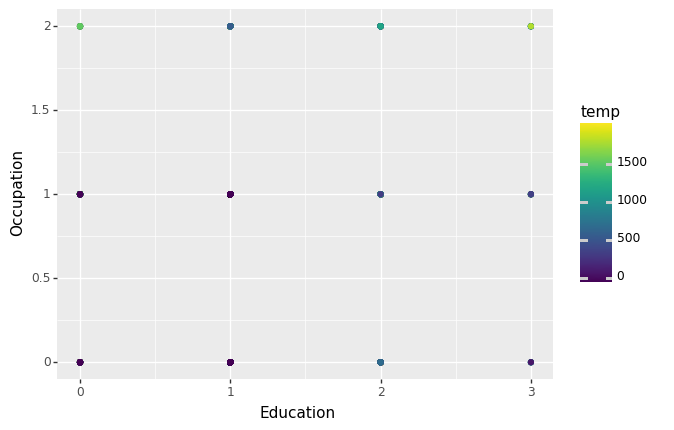

<ggplot: (8766033709801)>
CLuster21


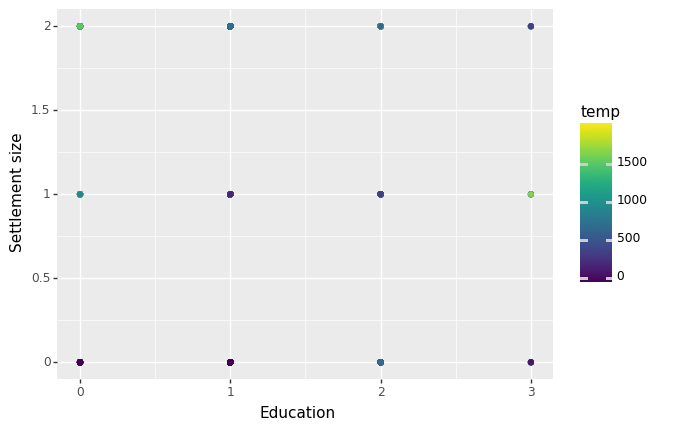

<ggplot: (8766033598509)>
CLuster21


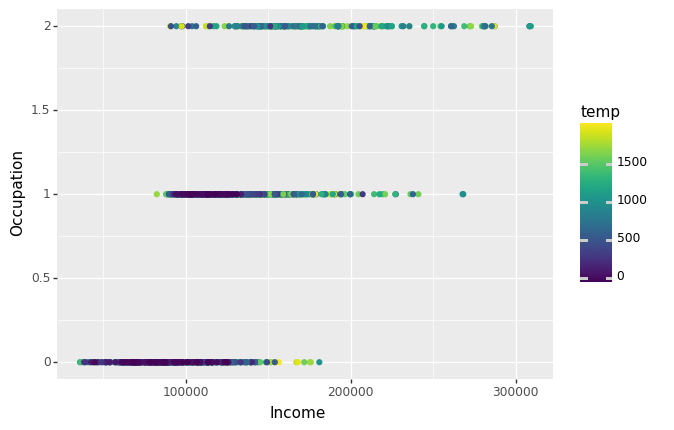

<ggplot: (8766033569301)>
CLuster21


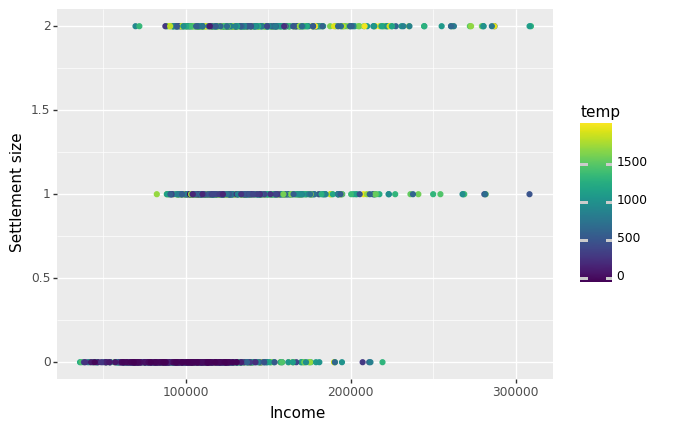

<ggplot: (8766037610481)>
CLuster21


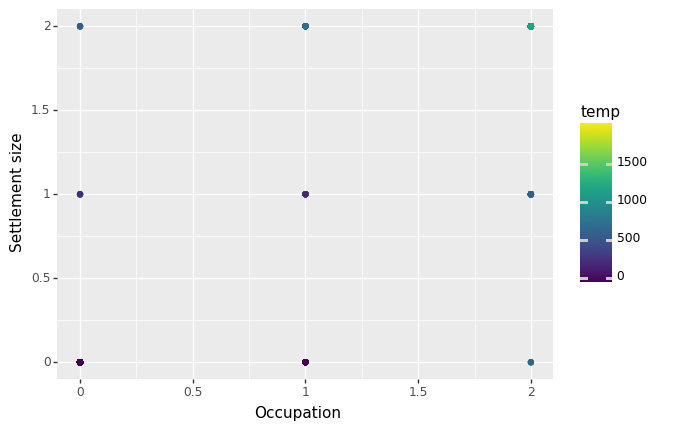

<ggplot: (8766033595001)>
1.5000000000000002


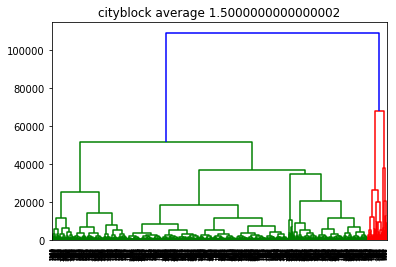

CLuster21


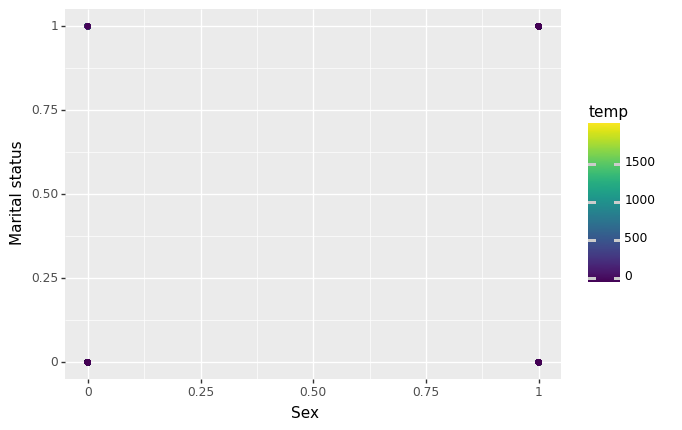

<ggplot: (8766034695269)>
CLuster21


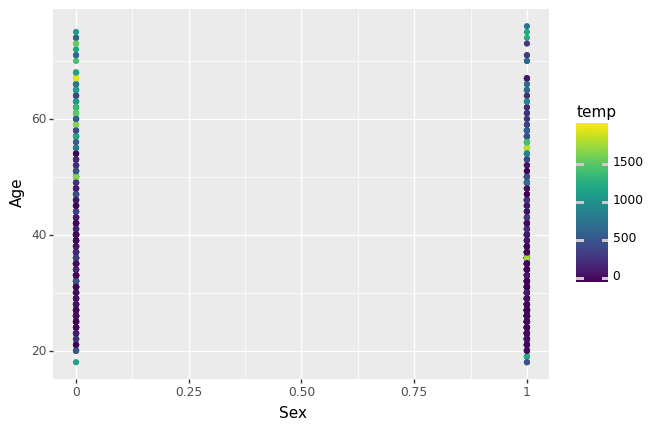

<ggplot: (8766039078153)>
CLuster21


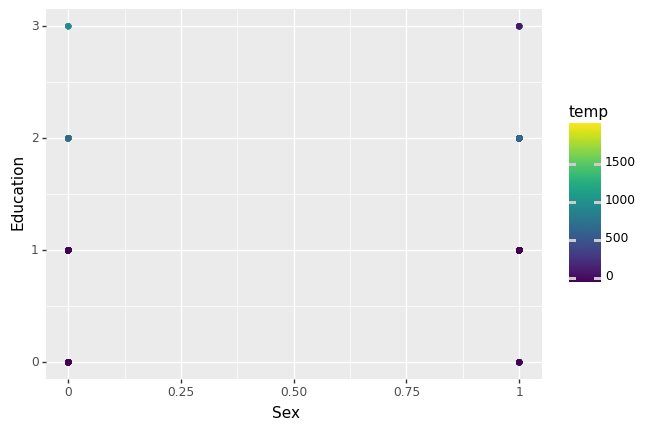

<ggplot: (8766039025917)>
CLuster21


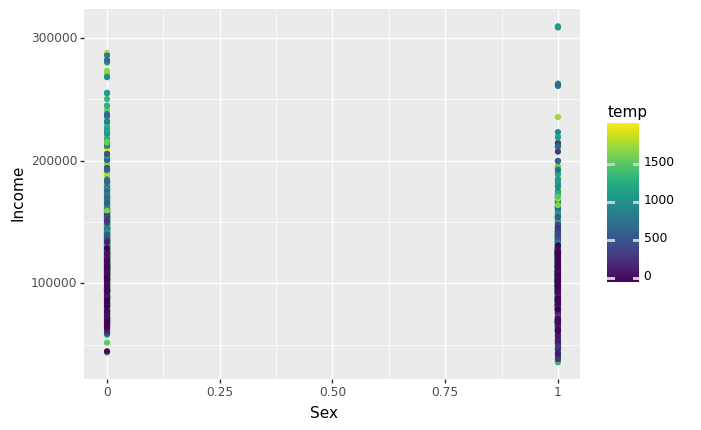

<ggplot: (8766034383709)>
CLuster21


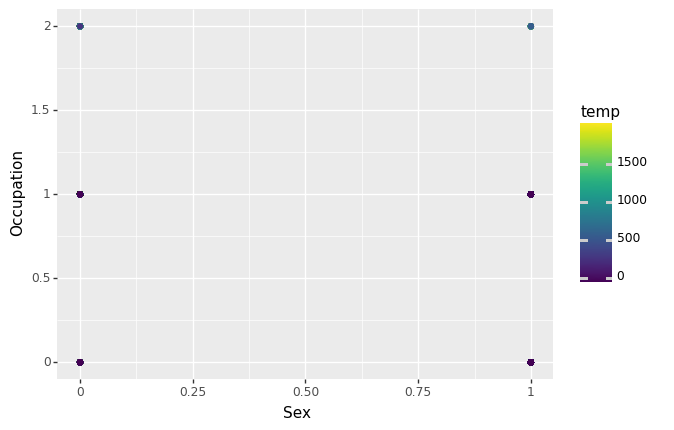

<ggplot: (8766034356233)>
CLuster21


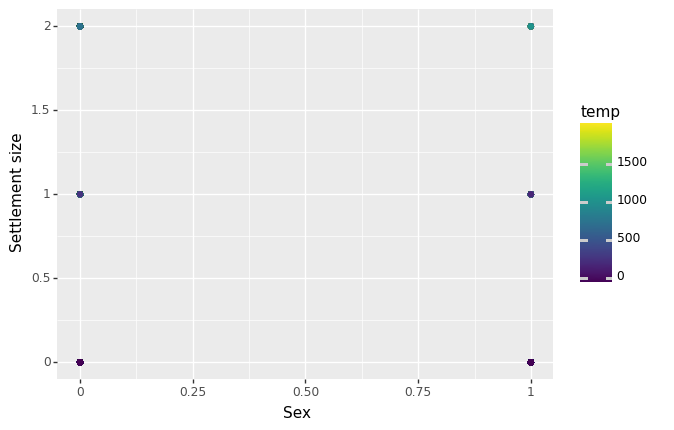

<ggplot: (8766034378313)>
CLuster21


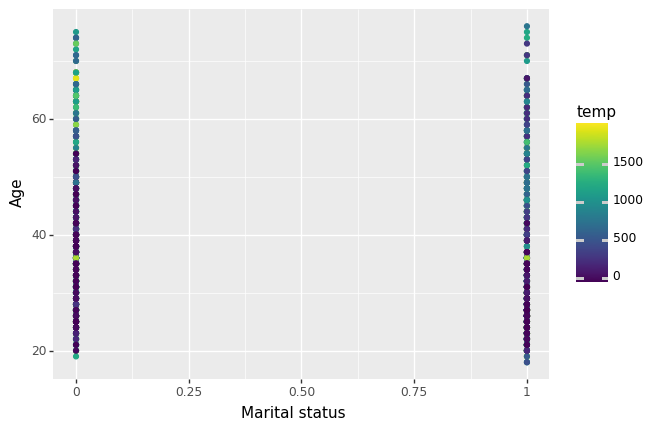

<ggplot: (8766034240525)>
CLuster21


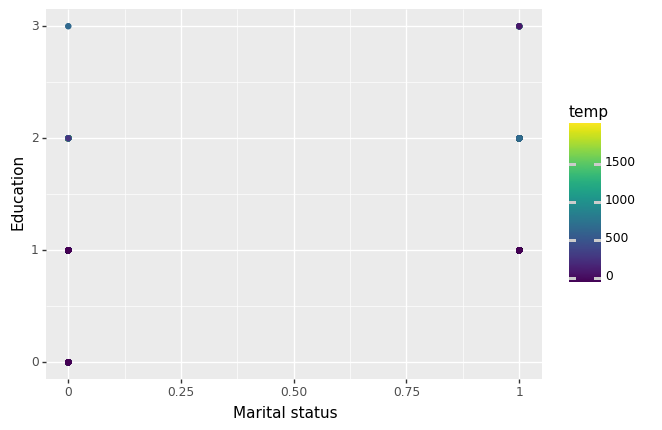

<ggplot: (8766040641169)>
CLuster21


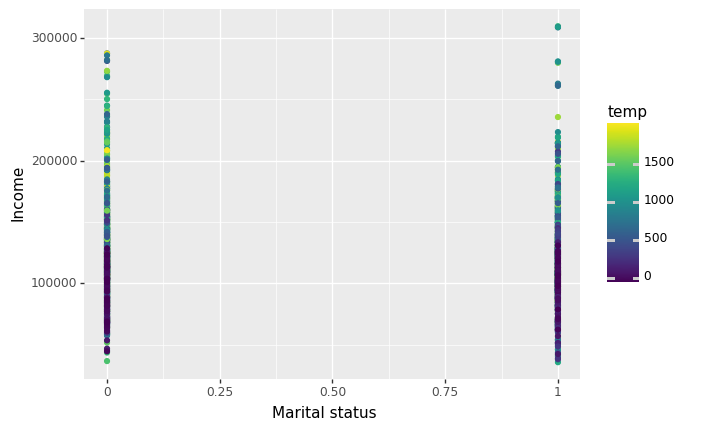

<ggplot: (8766038923093)>
CLuster21


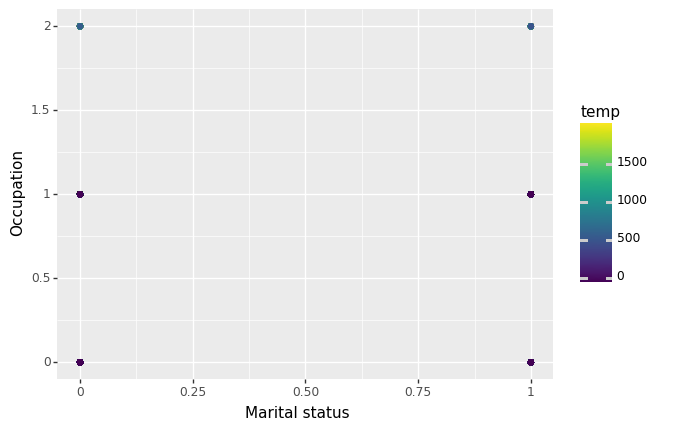

<ggplot: (8766038878373)>
CLuster21


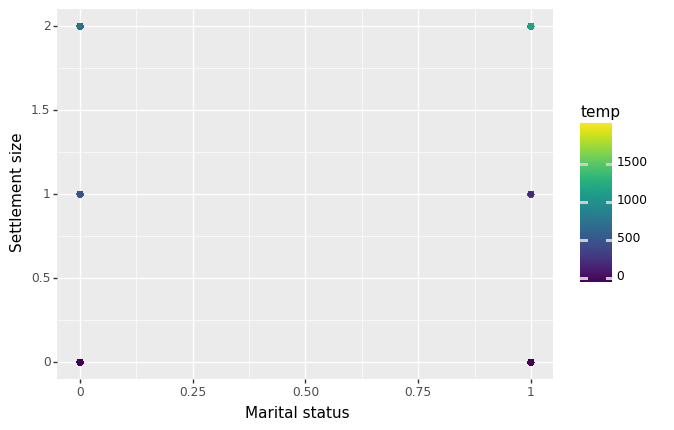

<ggplot: (8766038923093)>
CLuster21


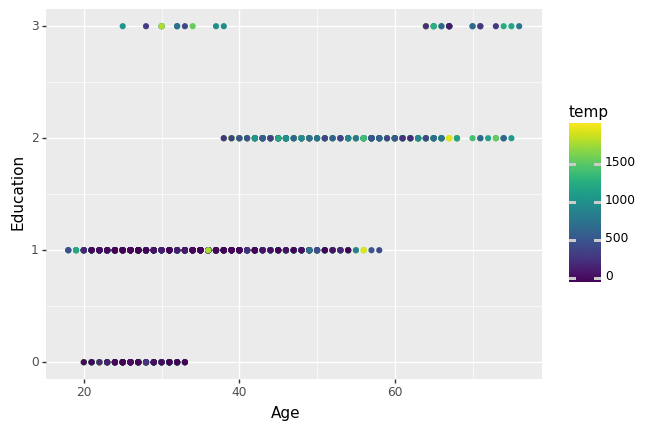

<ggplot: (8766038923233)>
CLuster21


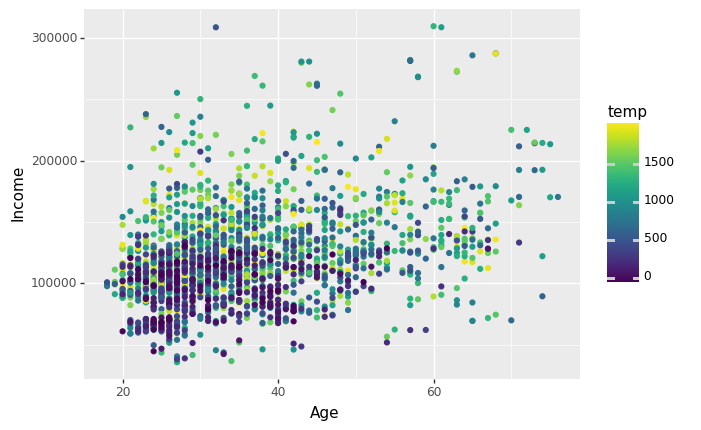

<ggplot: (8766033803825)>
CLuster21


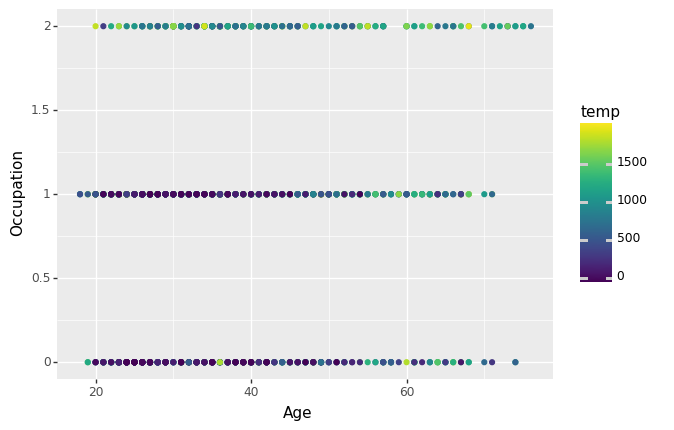

<ggplot: (8766037650265)>
CLuster21


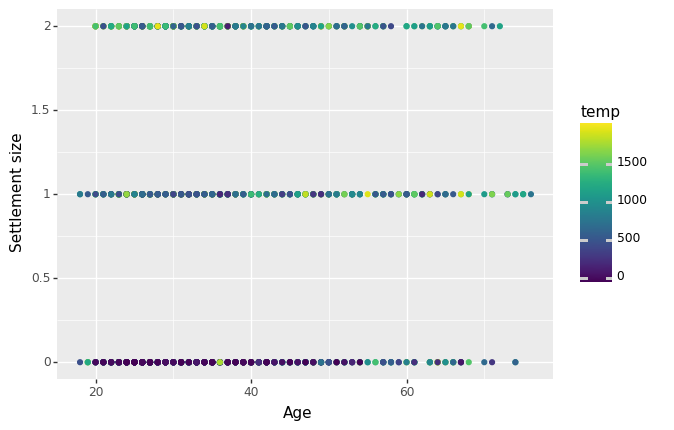

<ggplot: (8766039797185)>
CLuster21


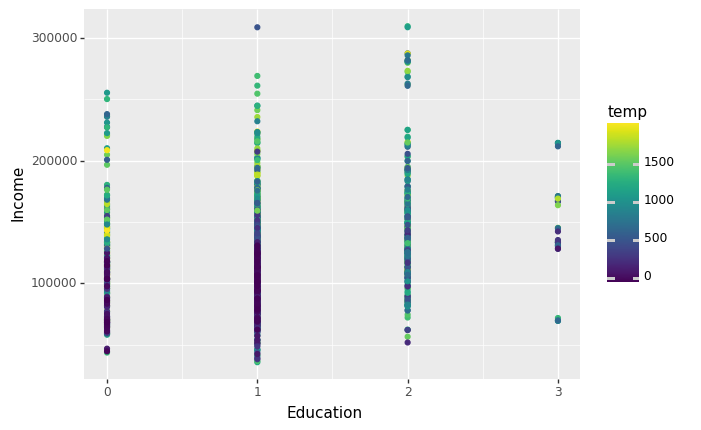

<ggplot: (8766033648013)>
CLuster21


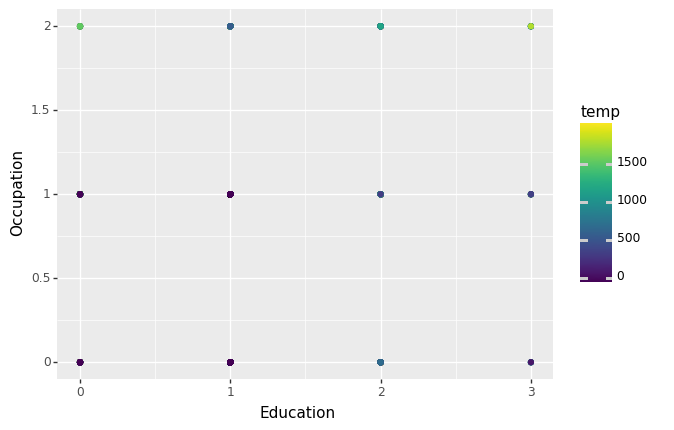

<ggplot: (8766033574573)>
CLuster21


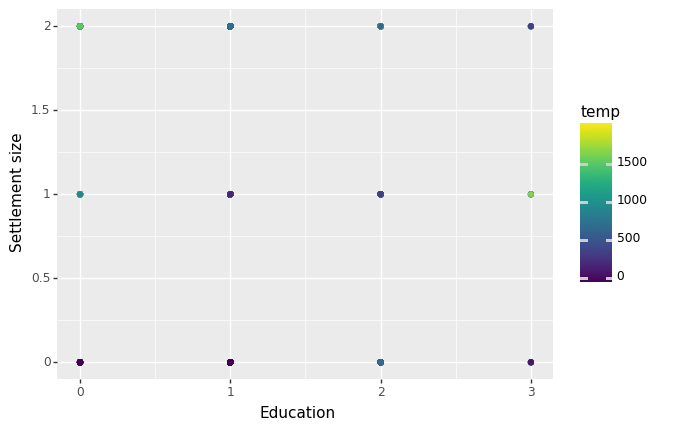

<ggplot: (8766034373617)>
CLuster21


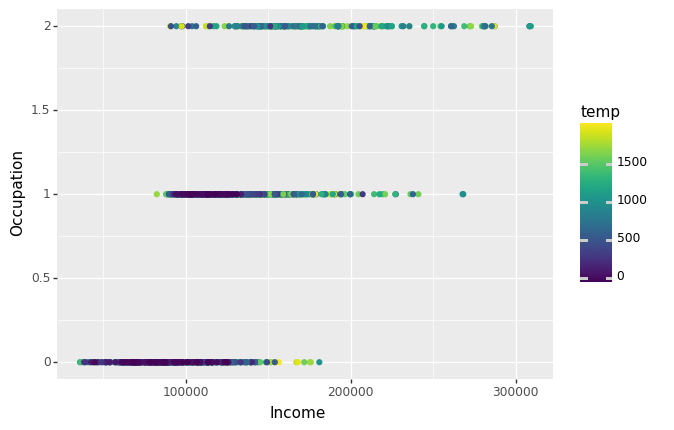

<ggplot: (8766037713729)>
CLuster21


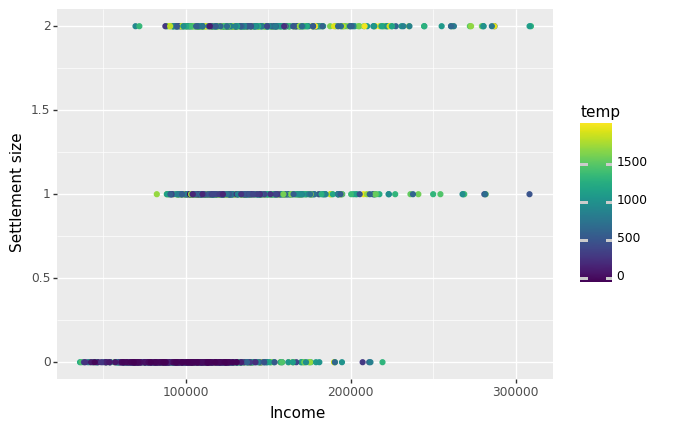

<ggplot: (8766034255701)>
CLuster21


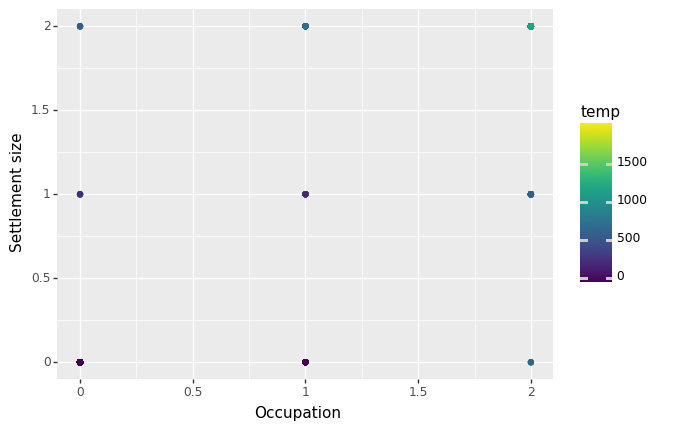

<ggplot: (8766039300421)>
1.7000000000000002


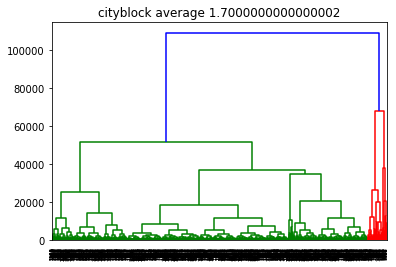

CLuster21


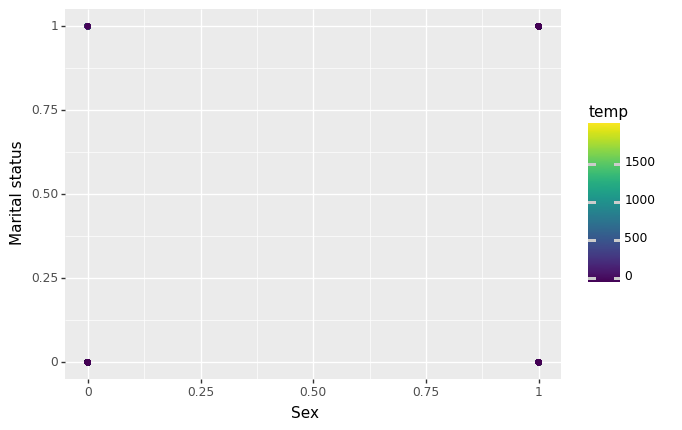

<ggplot: (8766039202517)>
CLuster21


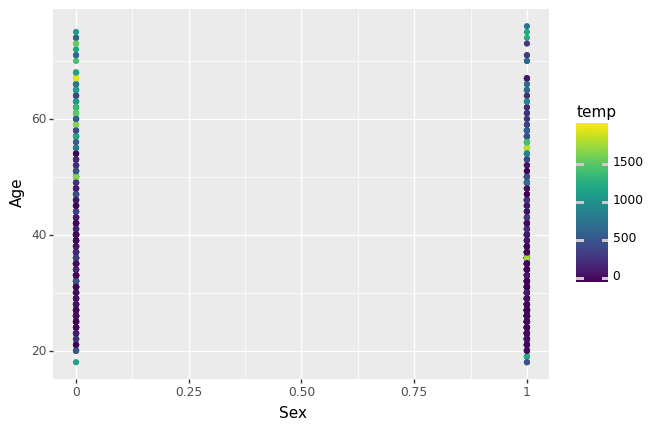

<ggplot: (8766038812073)>
CLuster21


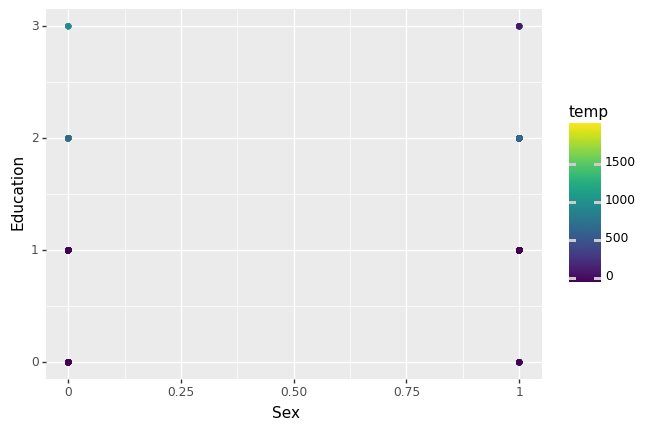

<ggplot: (8766038811933)>
CLuster21


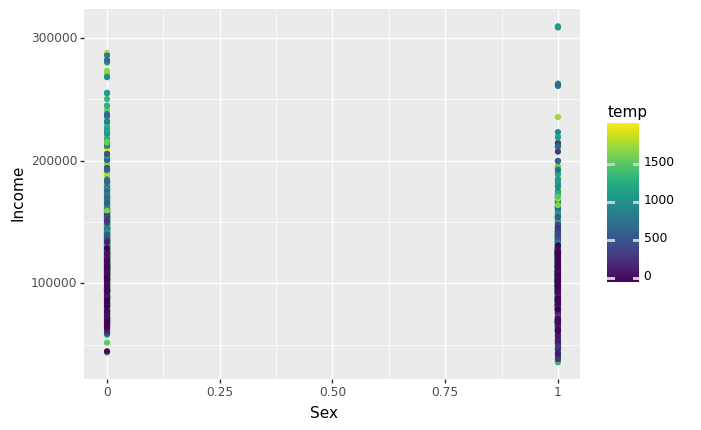

<ggplot: (8766033922025)>
CLuster21


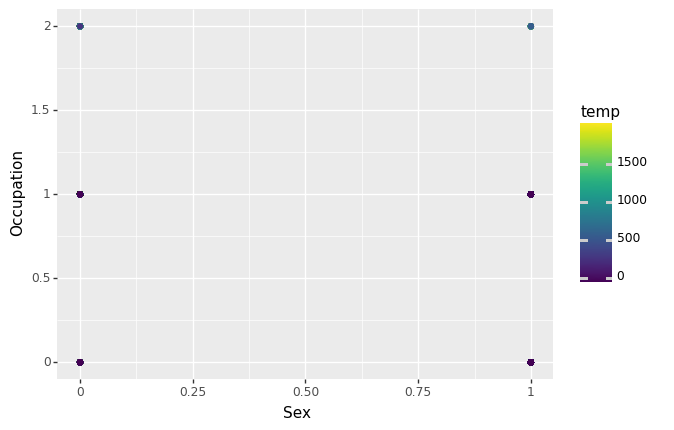

<ggplot: (8766033560569)>
CLuster21


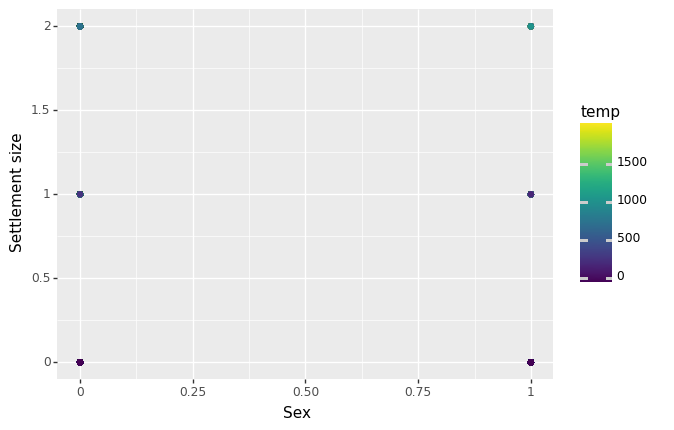

<ggplot: (8766033893389)>
CLuster21


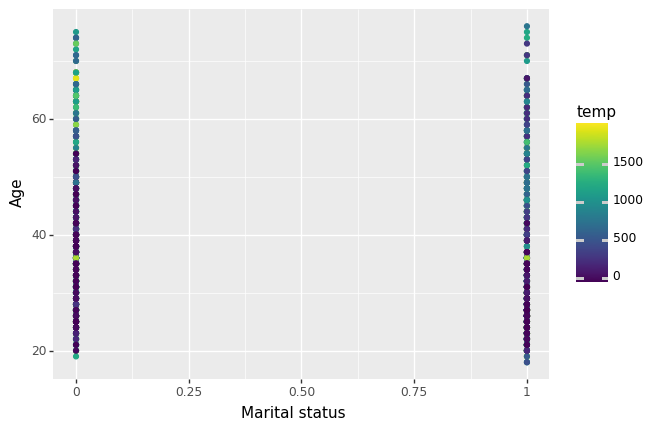

<ggplot: (8766037432341)>
CLuster21


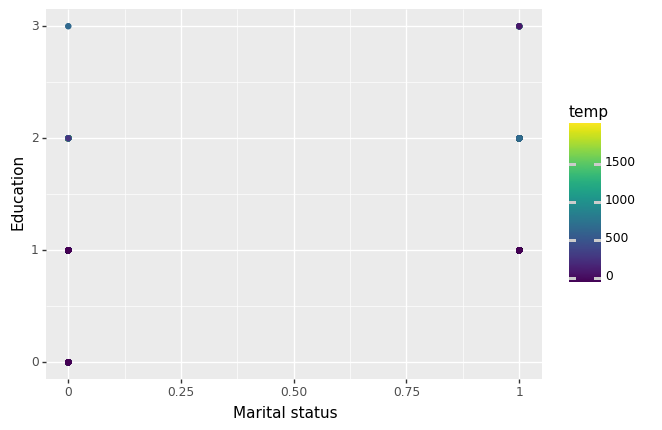

<ggplot: (8766038923141)>
CLuster21


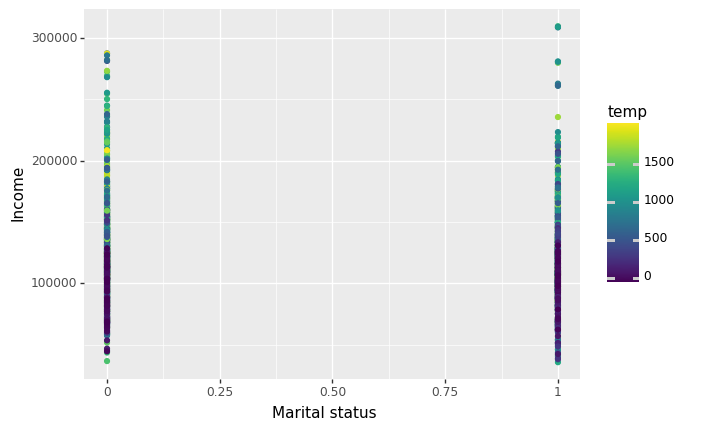

<ggplot: (8766034793957)>
CLuster21


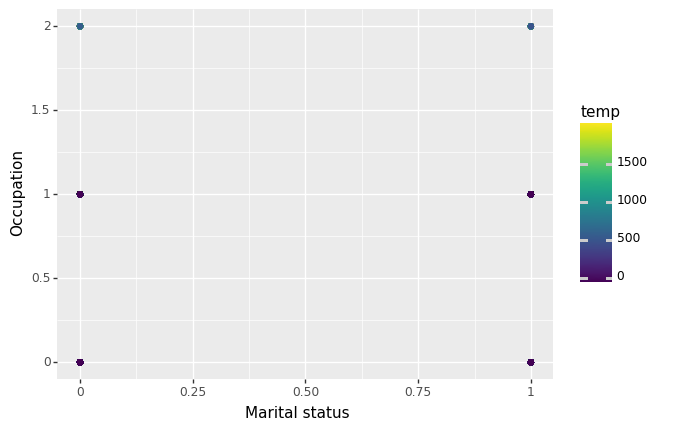

<ggplot: (8766033741297)>
CLuster21


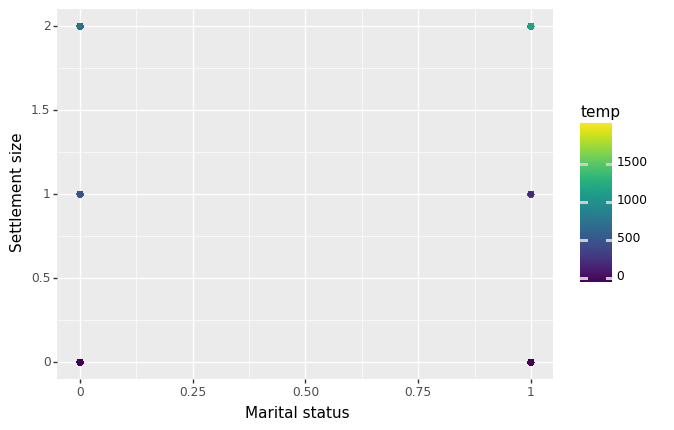

<ggplot: (8766033782013)>
CLuster21


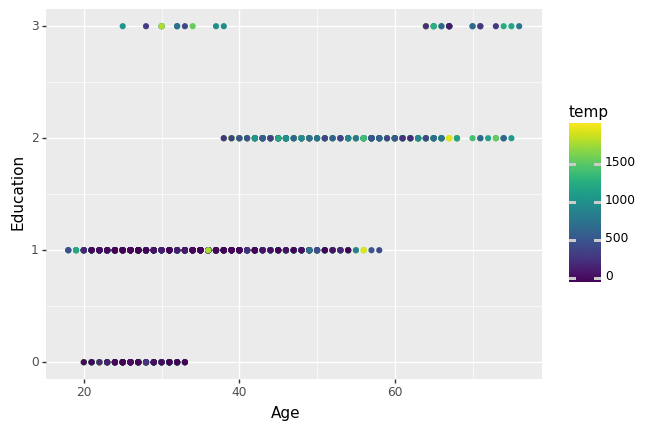

<ggplot: (8766033932133)>
CLuster21


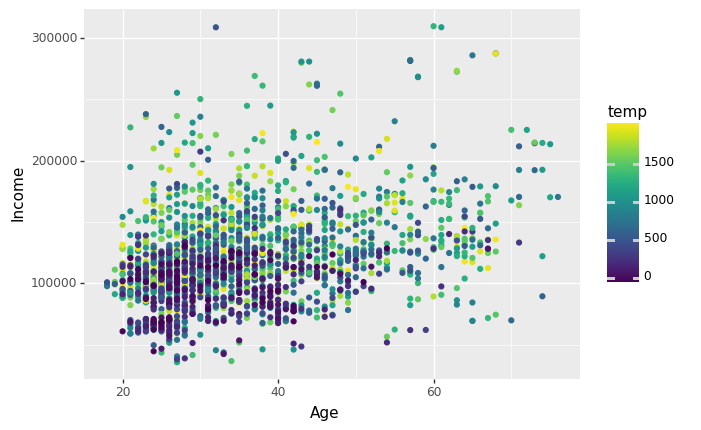

<ggplot: (8766033843141)>
CLuster21


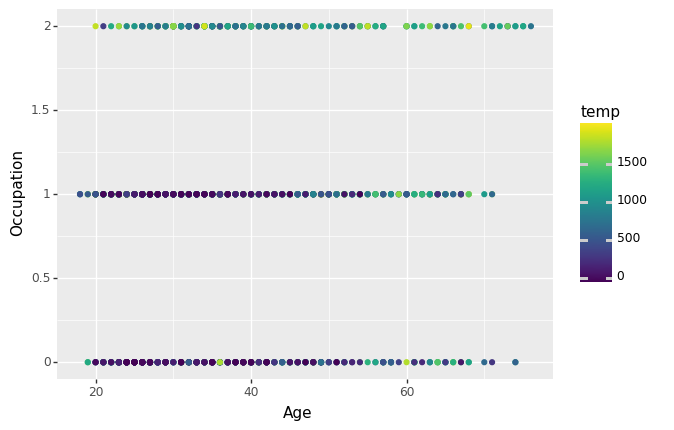

<ggplot: (8766034085821)>
CLuster21


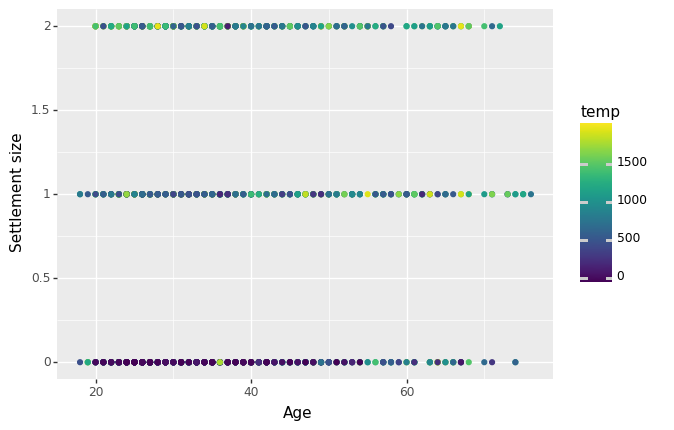

<ggplot: (8766034715161)>
CLuster21


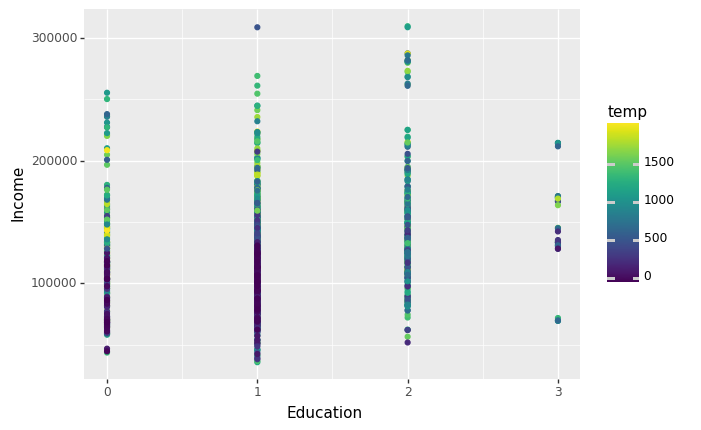

<ggplot: (8766033928041)>
CLuster21


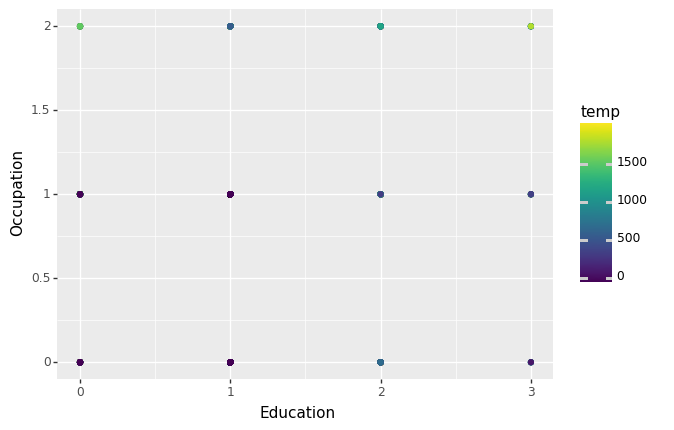

<ggplot: (8766034777653)>
CLuster21


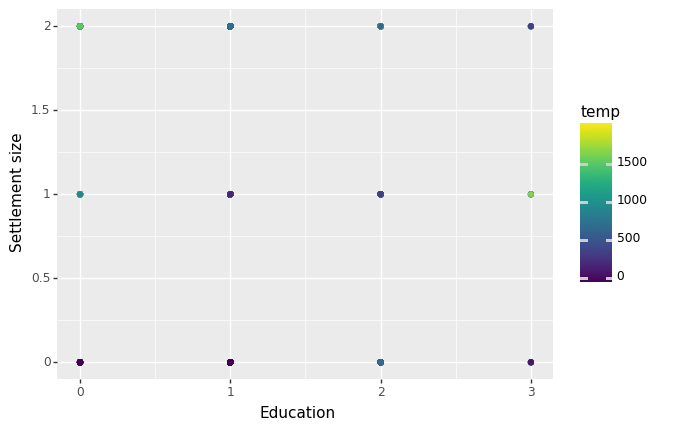

<ggplot: (8766034546453)>
CLuster21


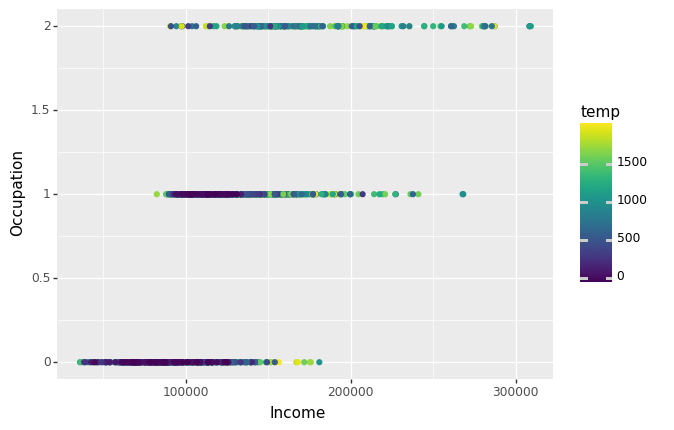

<ggplot: (8766034178885)>
CLuster21


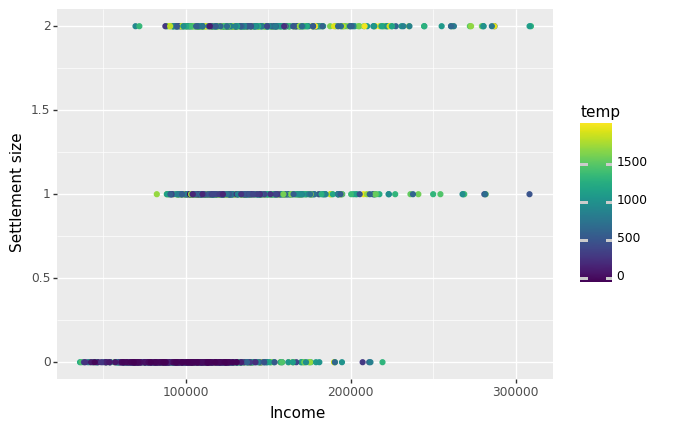

<ggplot: (8766033943137)>
CLuster21


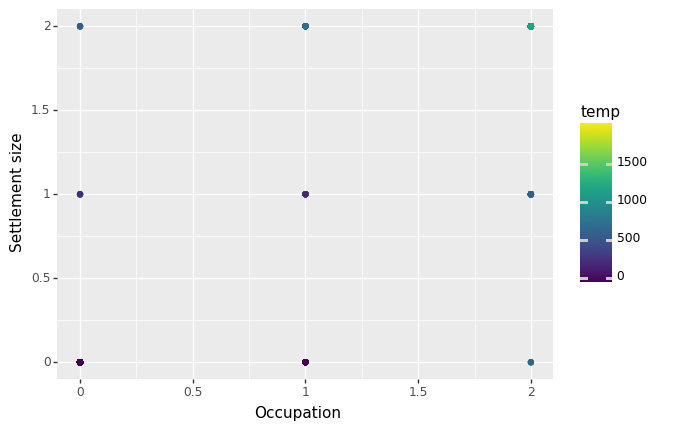

<ggplot: (8766034674273)>
1.9000000000000001


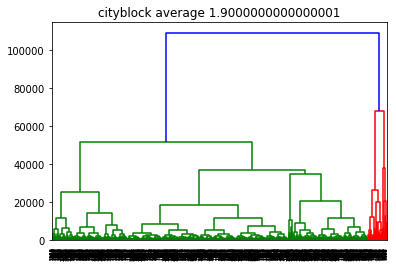

CLuster21


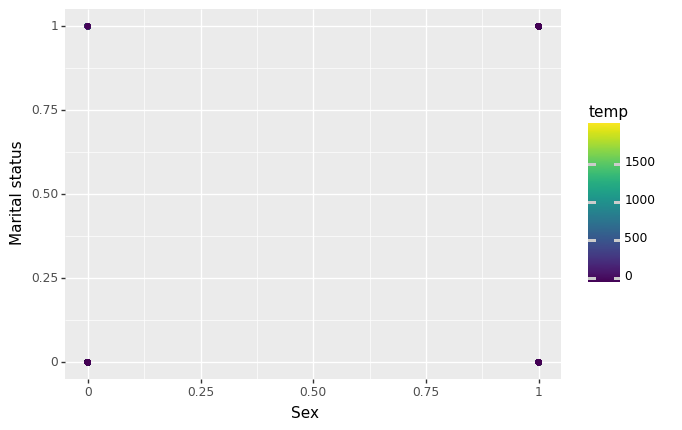

<ggplot: (8766033368717)>
CLuster21


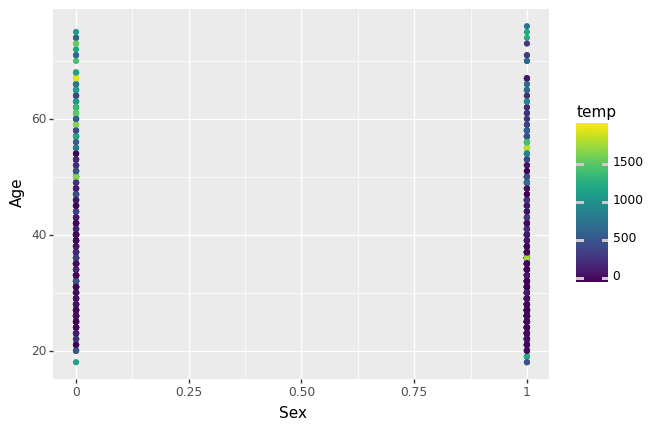

<ggplot: (8766037696953)>
CLuster21


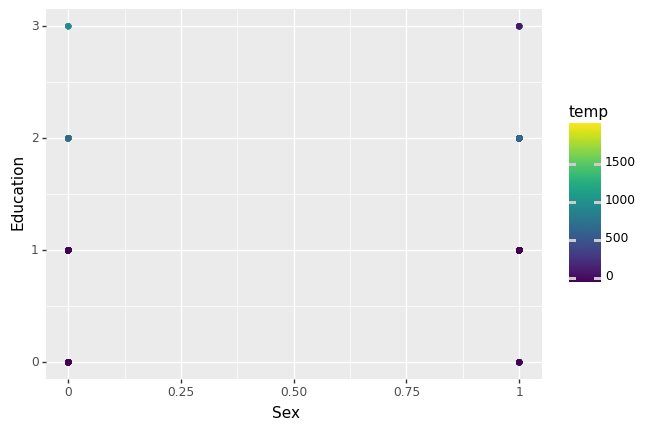

<ggplot: (8766040693705)>
CLuster21


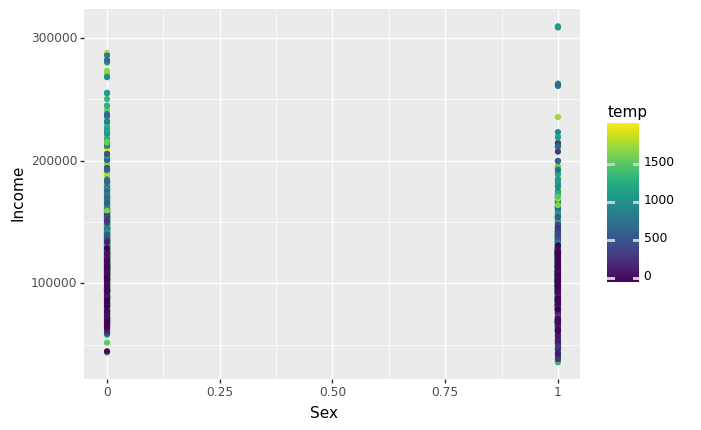

<ggplot: (8766034593645)>
CLuster21


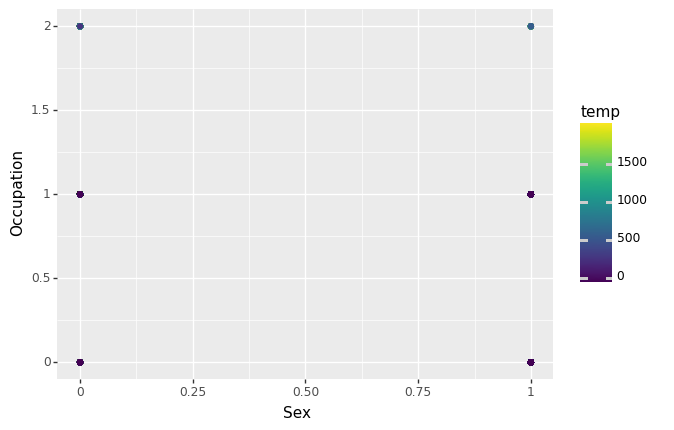

<ggplot: (8766033568685)>
CLuster21


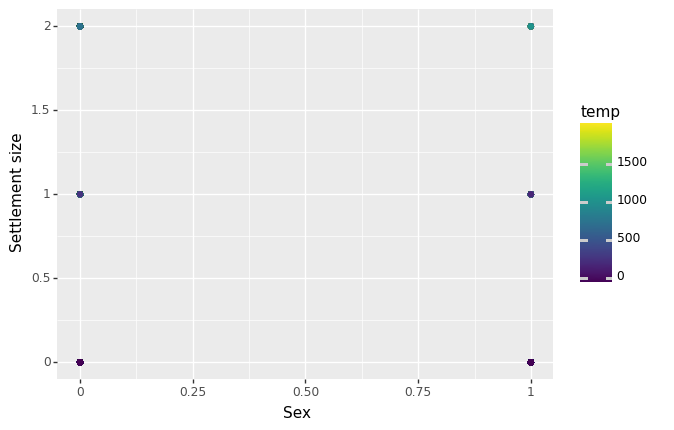

<ggplot: (8766033785277)>
CLuster21


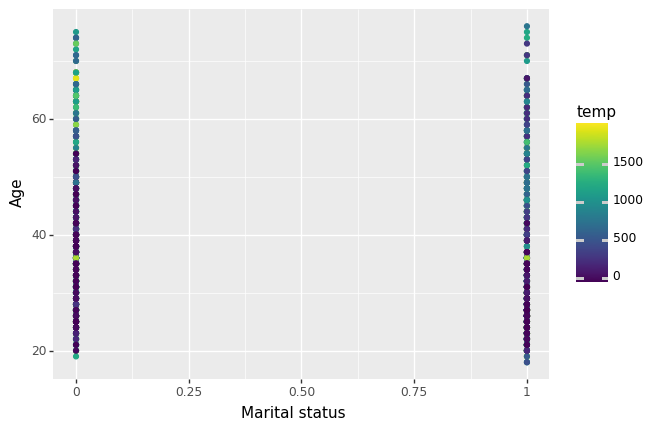

<ggplot: (8766037456817)>
CLuster21


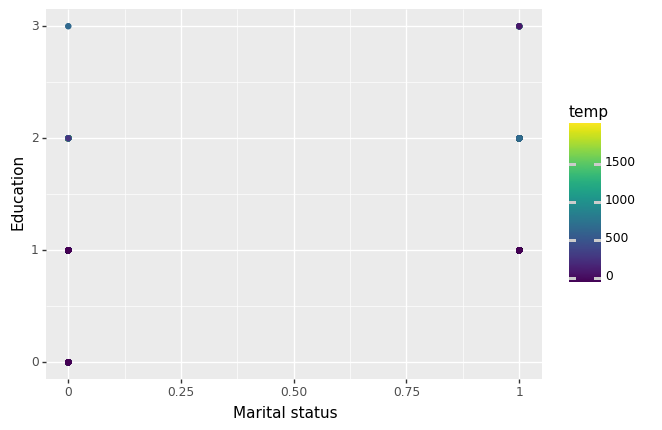

<ggplot: (8766038937393)>
CLuster21


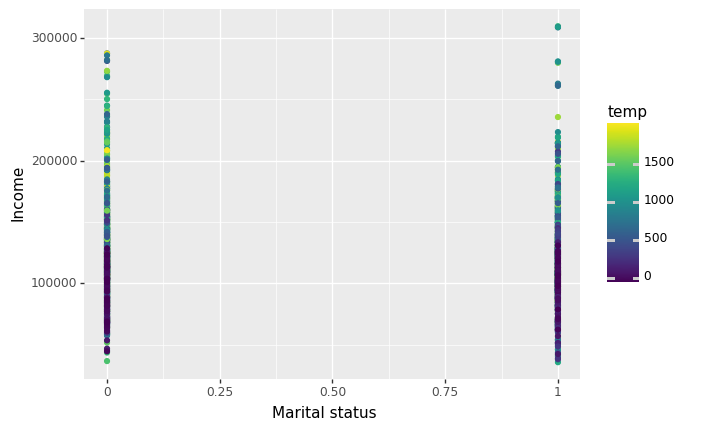

<ggplot: (8766034261461)>
CLuster21


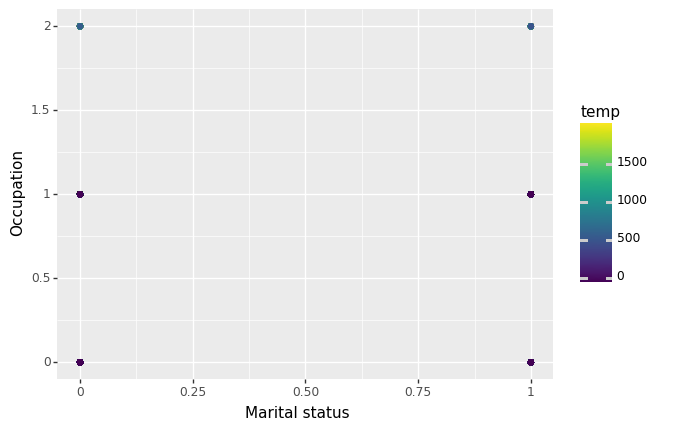

<ggplot: (8766037639577)>
CLuster21


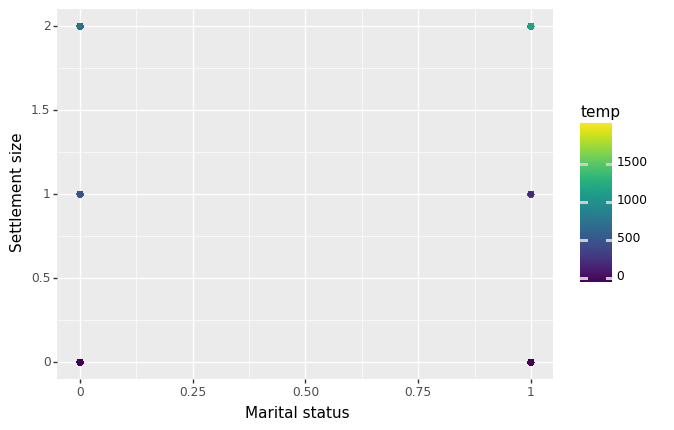

<ggplot: (8766034237321)>
CLuster21


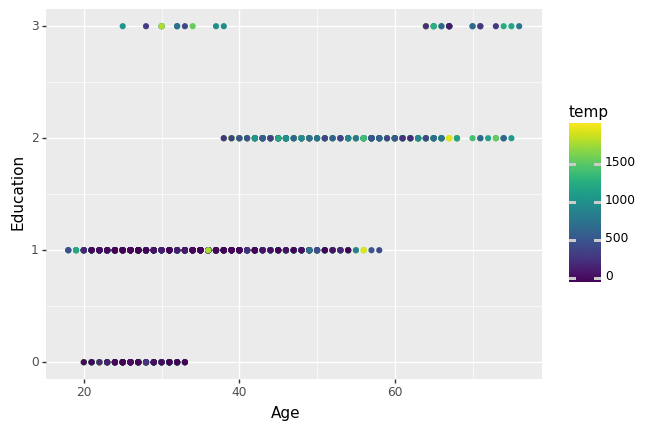

<ggplot: (8766038809261)>
CLuster21


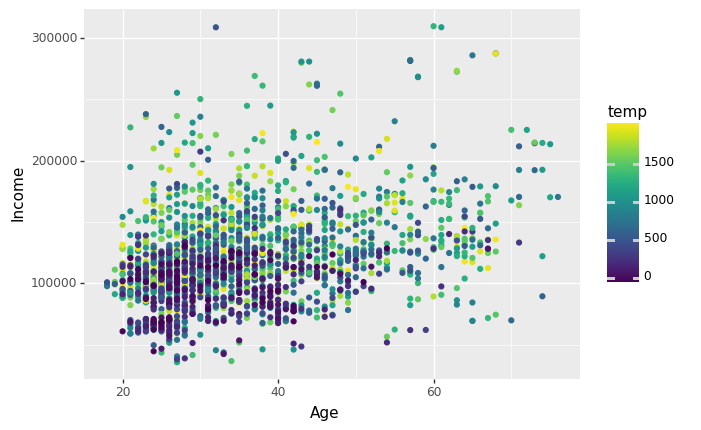

<ggplot: (8766038809337)>
CLuster21


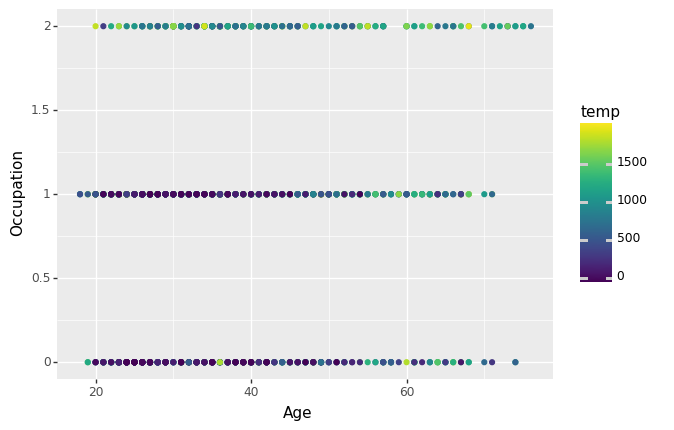

<ggplot: (8766033899709)>
CLuster21


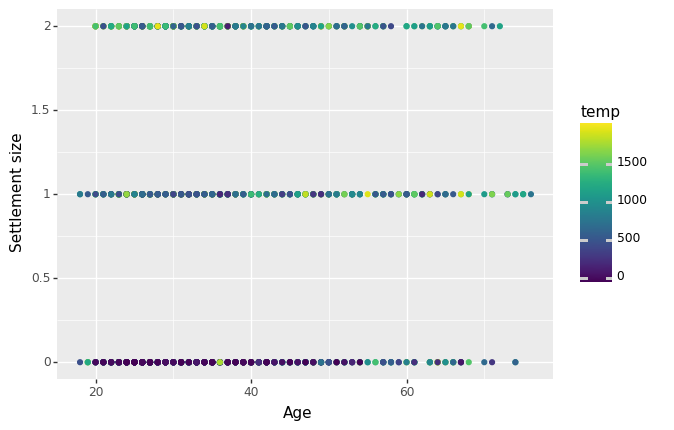

<ggplot: (8766033939565)>
CLuster21


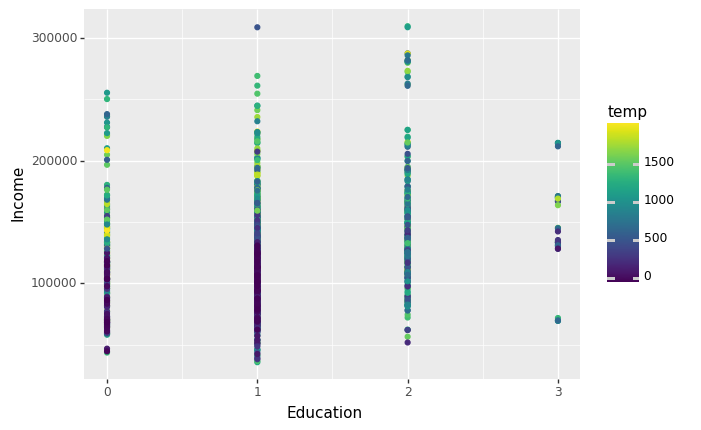

<ggplot: (8766034662853)>
CLuster21


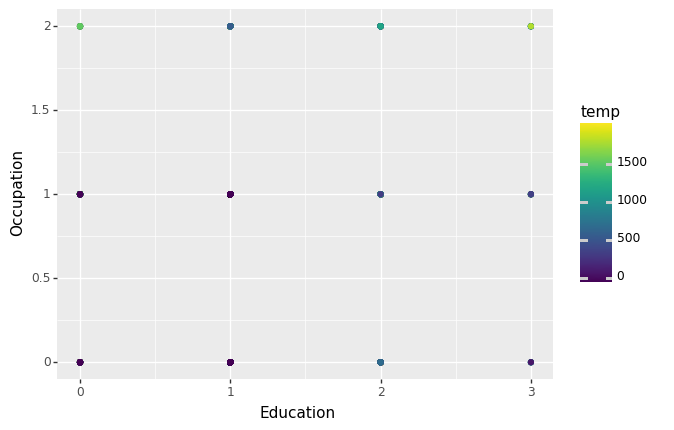

<ggplot: (8766033710173)>
CLuster21


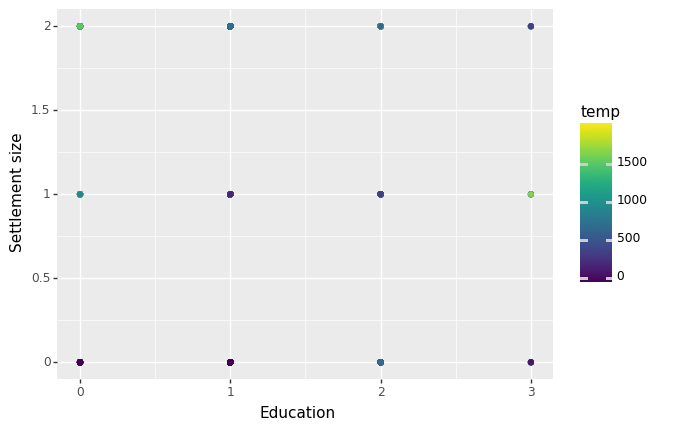

<ggplot: (8766037421349)>
CLuster21


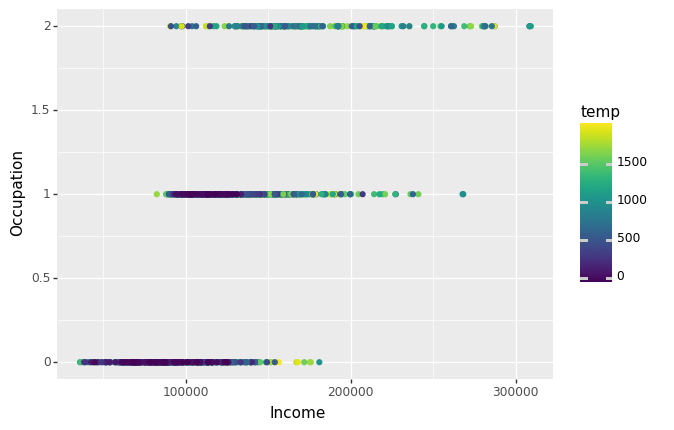

<ggplot: (8766034016501)>
CLuster21


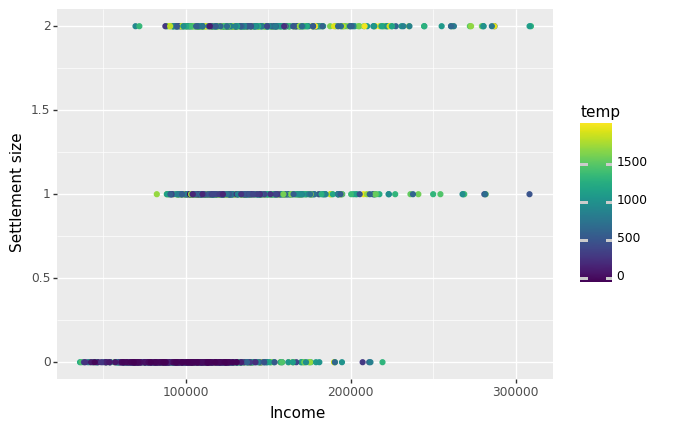

<ggplot: (8766033904873)>
CLuster21


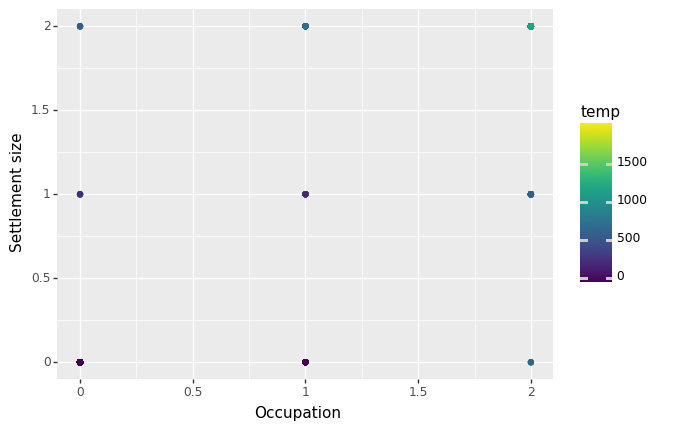

<ggplot: (8766034013401)>
single
0.3
0.5
0.7
0.9000000000000001
1.1
['0.0009959618120056314', 'cityblock', 'single', '1.1']


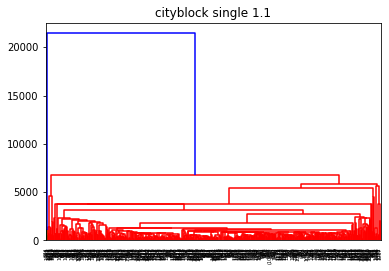

CLuster21


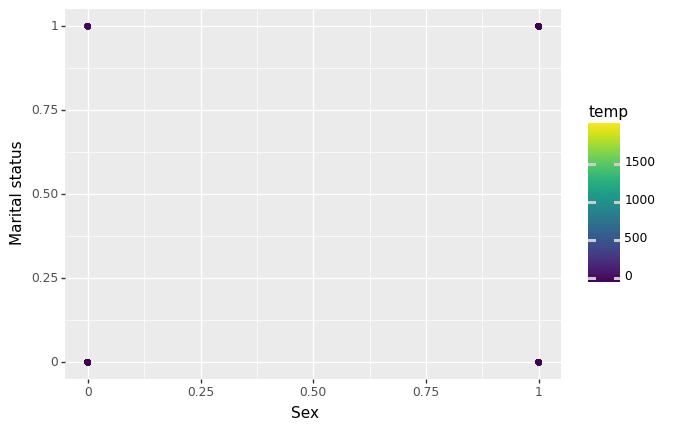

<ggplot: (8766033901221)>
CLuster21


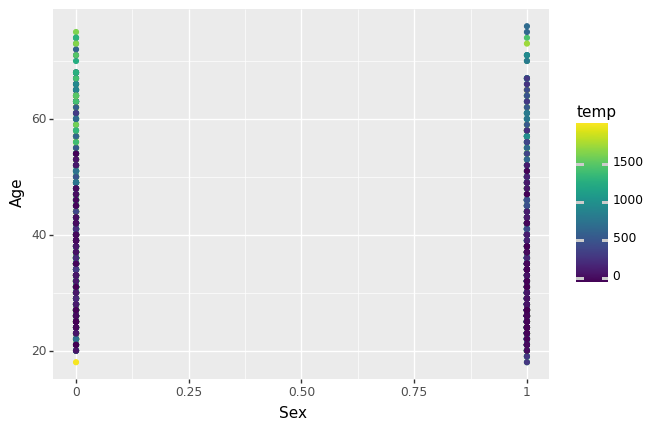

<ggplot: (8766037734233)>
CLuster21


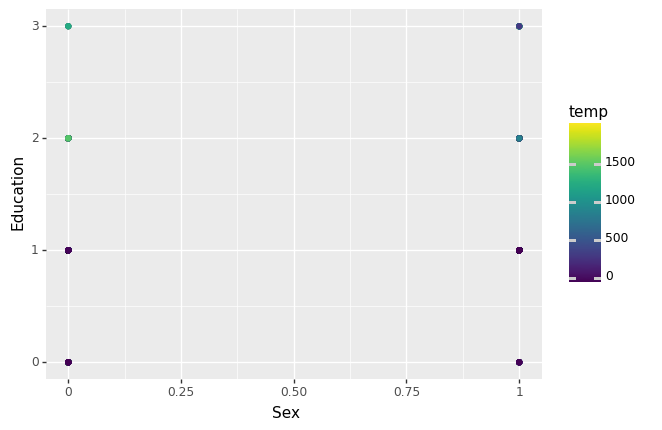

<ggplot: (8766034747713)>
CLuster21


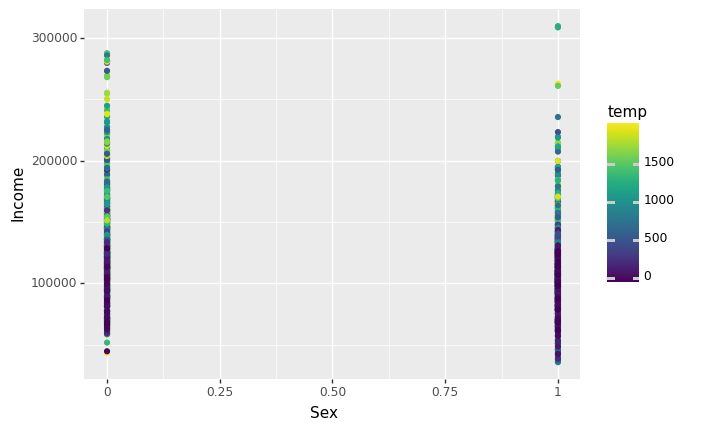

<ggplot: (8766034314229)>
CLuster21


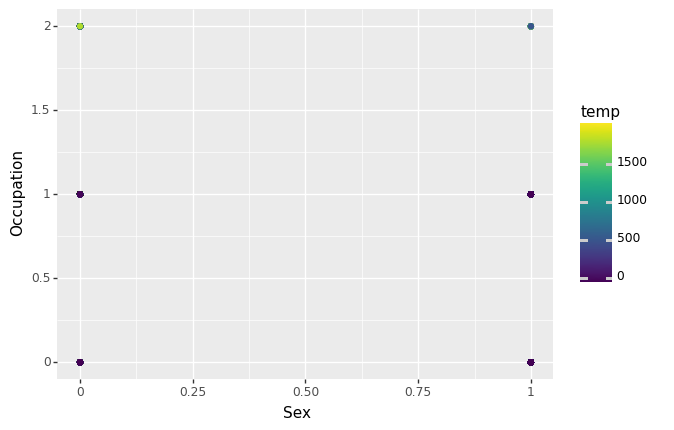

<ggplot: (8766034336241)>
CLuster21


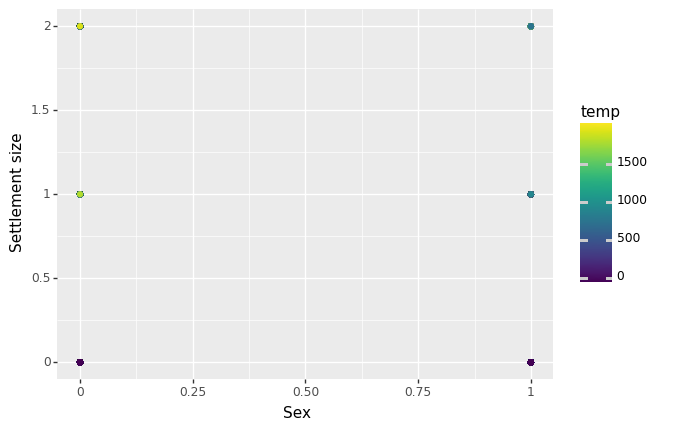

<ggplot: (8766033568537)>
CLuster21


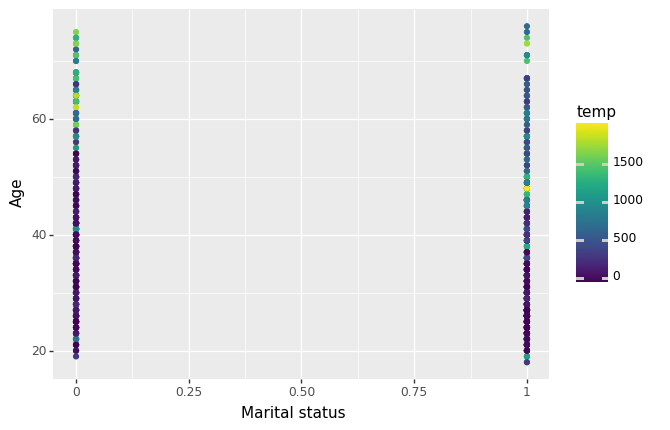

<ggplot: (8766038812057)>
CLuster21


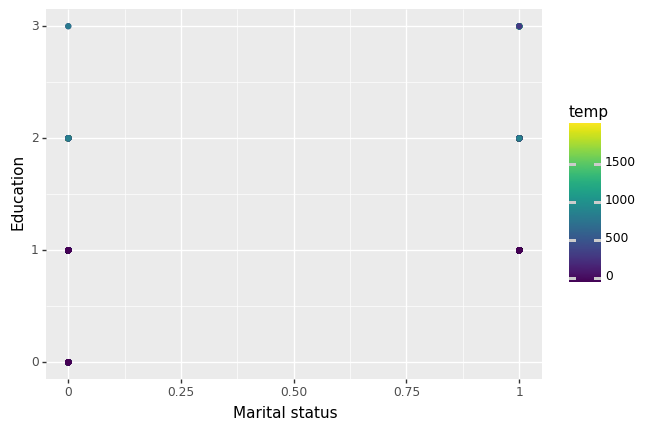

<ggplot: (8766034713593)>
CLuster21


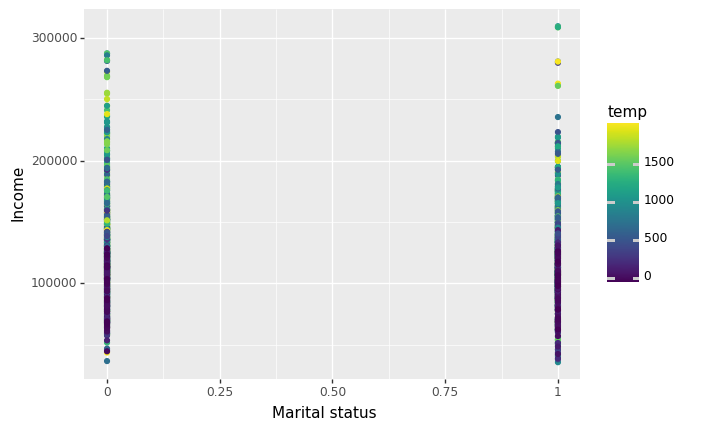

<ggplot: (8766039081441)>
CLuster21


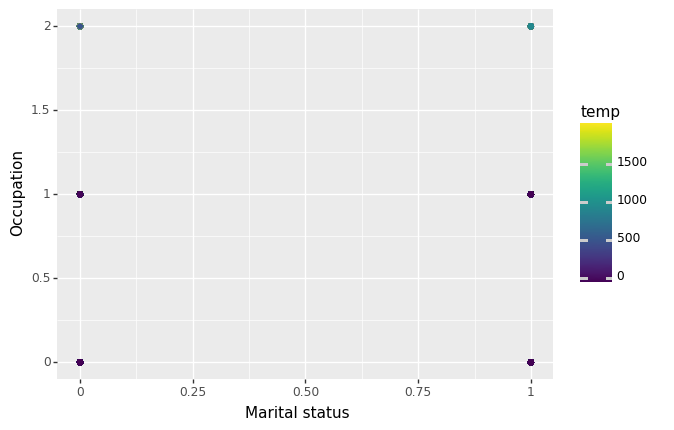

<ggplot: (8766033450325)>
CLuster21


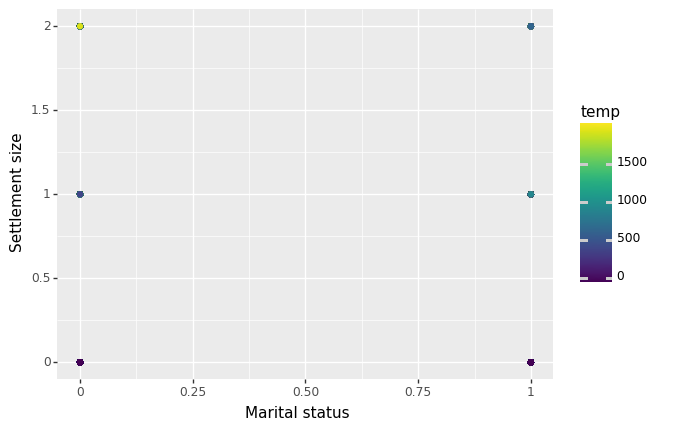

<ggplot: (8766033325729)>
CLuster21


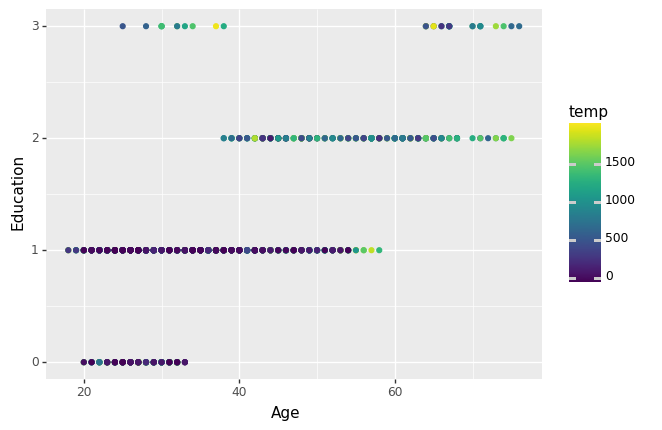

<ggplot: (8766039676917)>
CLuster21


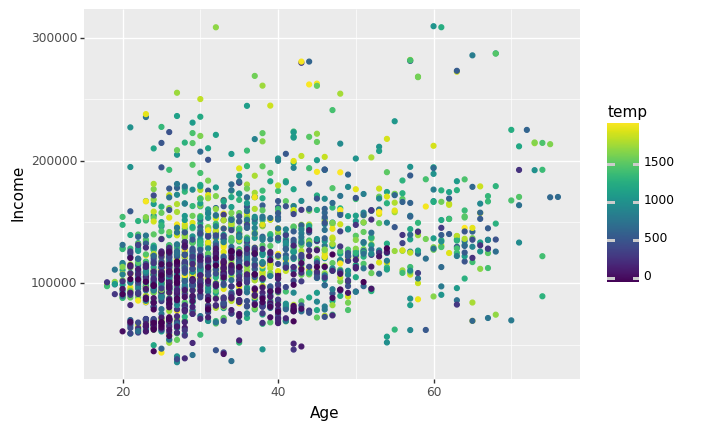

<ggplot: (8766034570361)>
CLuster21


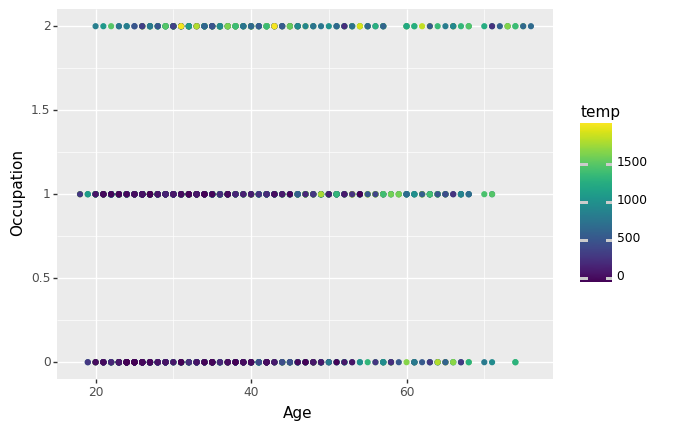

<ggplot: (8766034628377)>
CLuster21


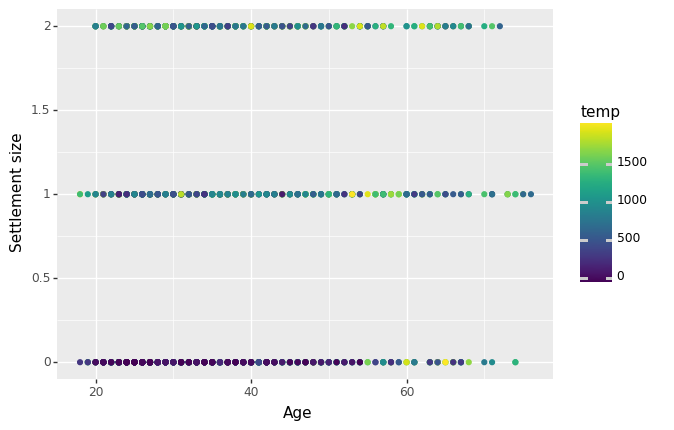

<ggplot: (8766034715213)>
CLuster21


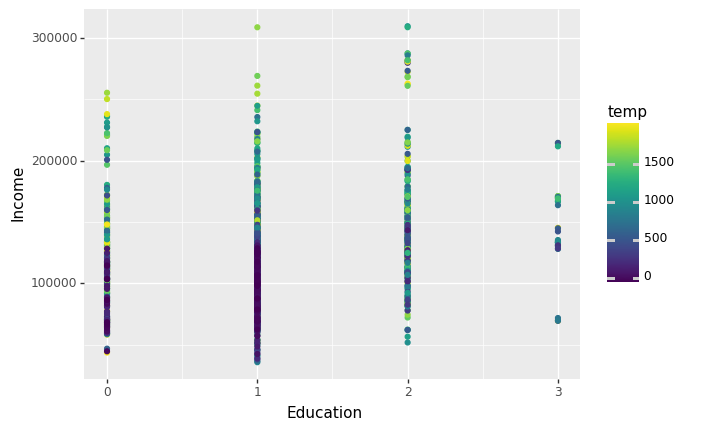

<ggplot: (8766039217117)>
CLuster21


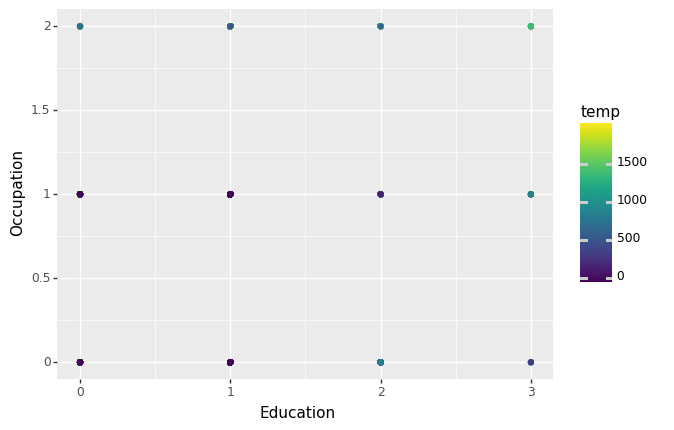

<ggplot: (8766037560569)>
CLuster21


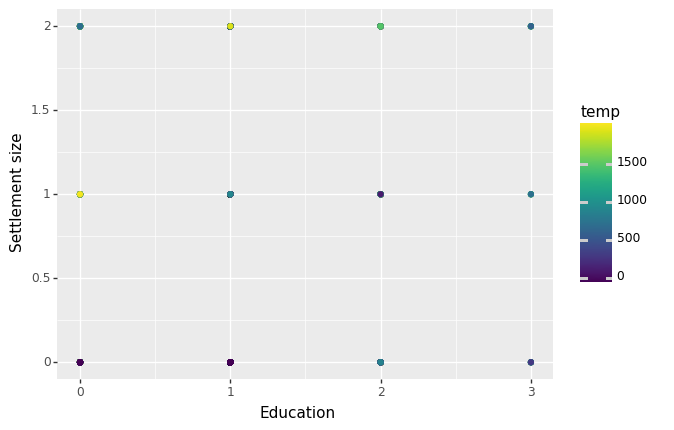

<ggplot: (8766034413853)>
CLuster21


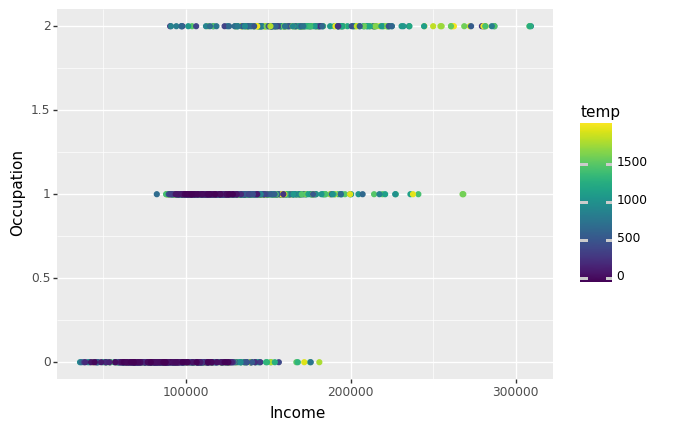

<ggplot: (8766039026613)>
CLuster21


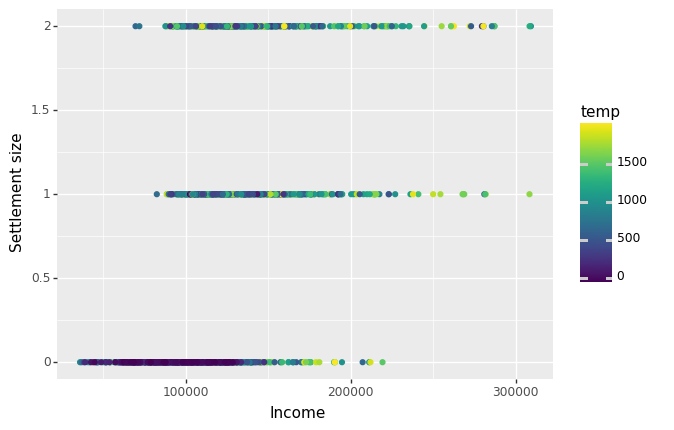

<ggplot: (8766033340429)>
CLuster21


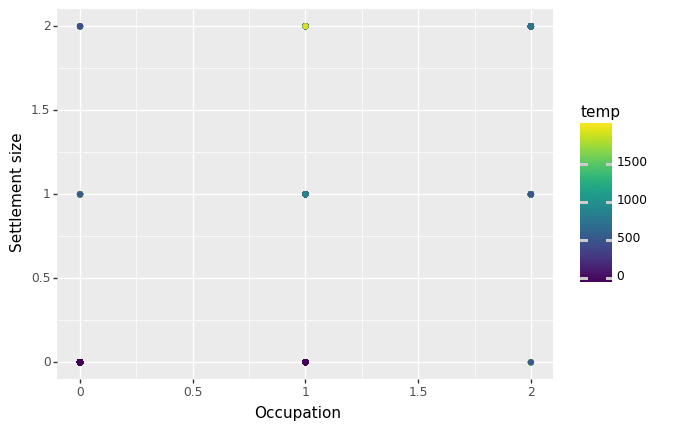

<ggplot: (8766037610453)>
1.3


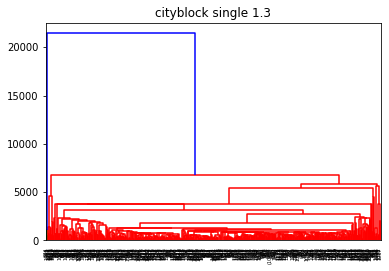

CLuster21


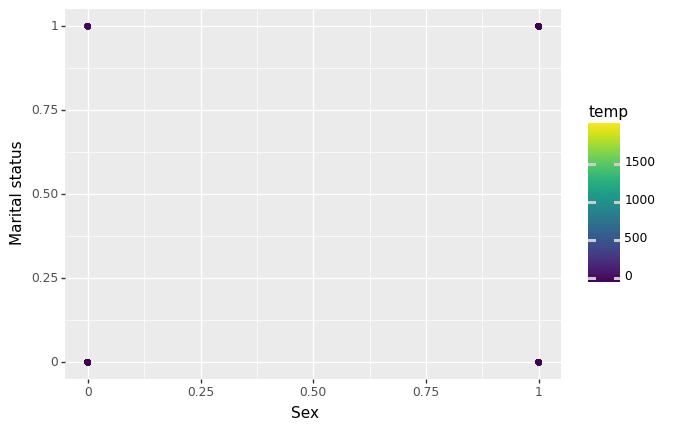

<ggplot: (8766039636077)>
CLuster21


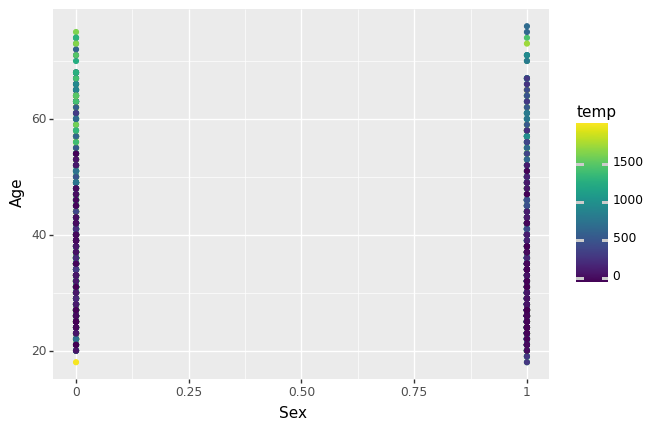

<ggplot: (8766034280765)>
CLuster21


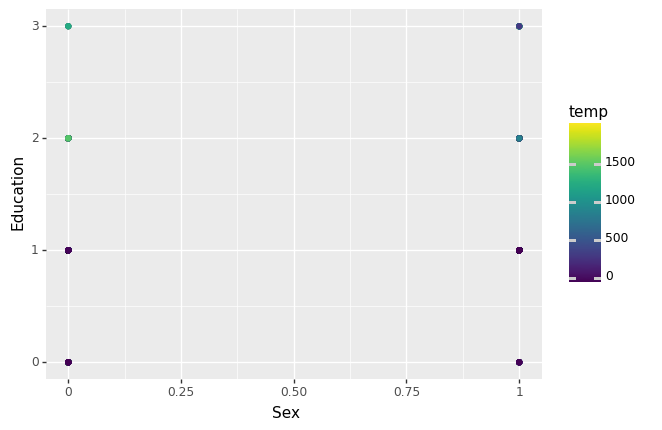

<ggplot: (8766039314333)>
CLuster21


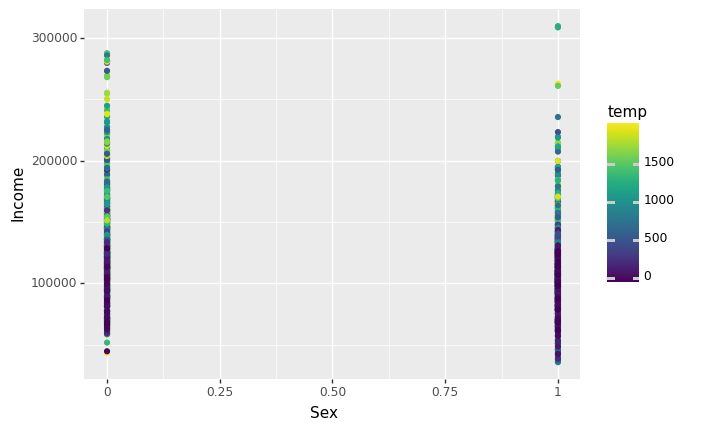

<ggplot: (8766034415749)>
CLuster21


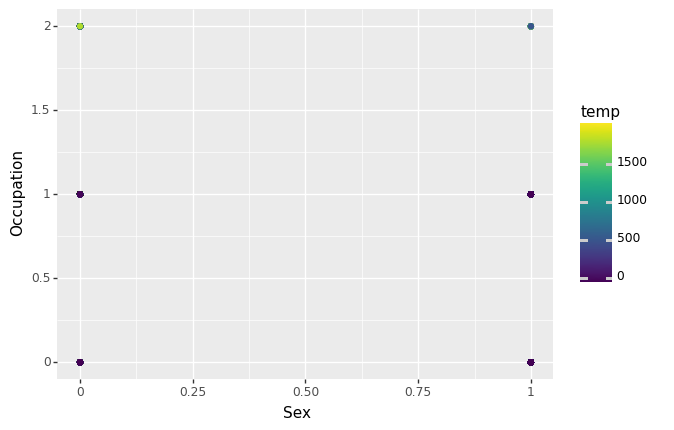

<ggplot: (8766039196085)>
CLuster21


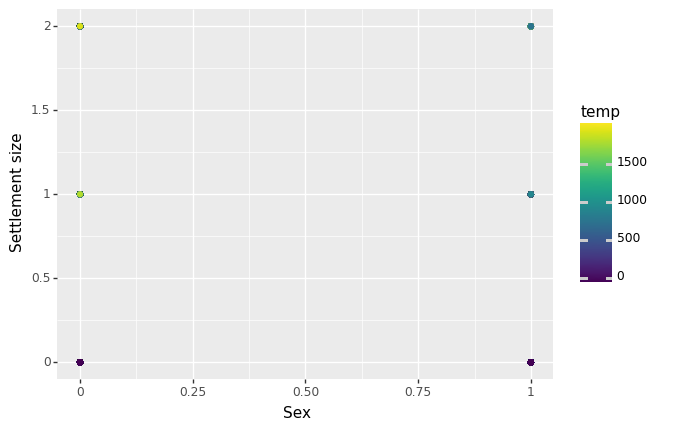

<ggplot: (8766038923097)>
CLuster21


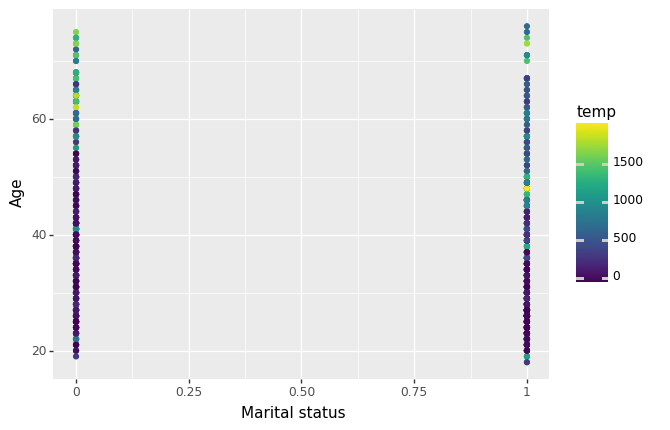

<ggplot: (8766039057677)>
CLuster21


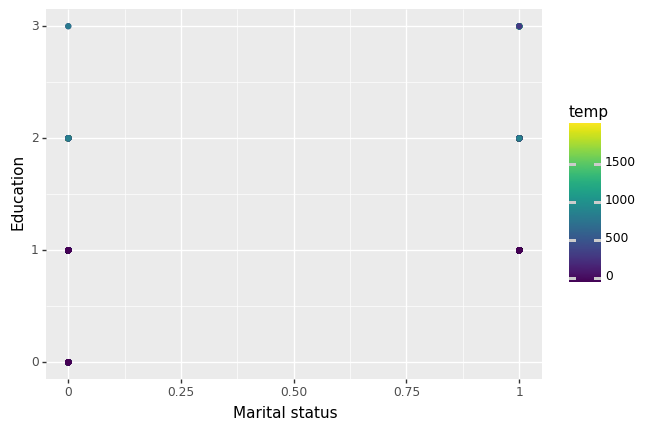

<ggplot: (8766034370721)>
CLuster21


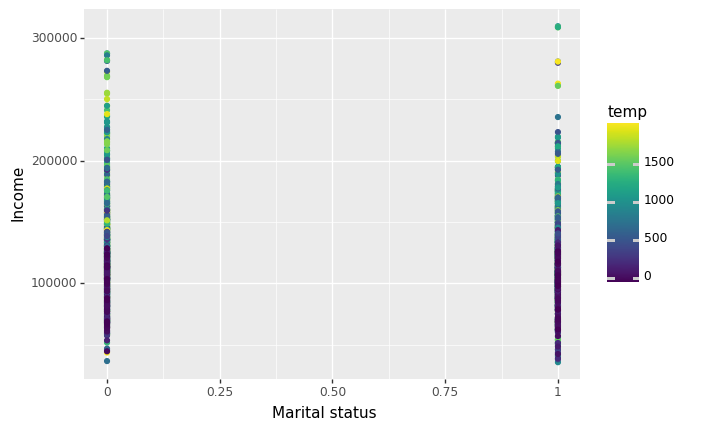

<ggplot: (8766034112105)>
CLuster21


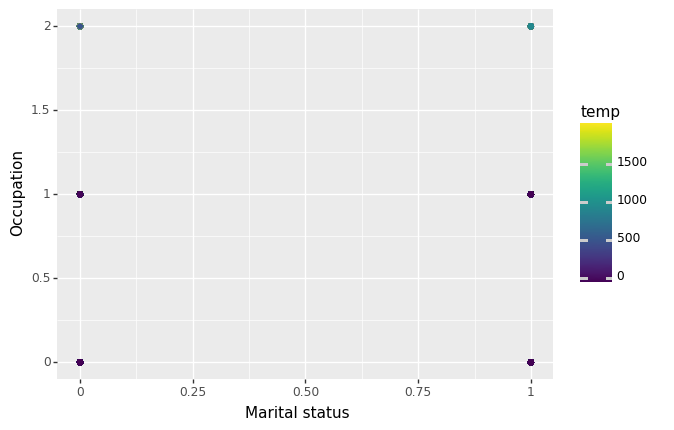

<ggplot: (8766039633713)>
CLuster21


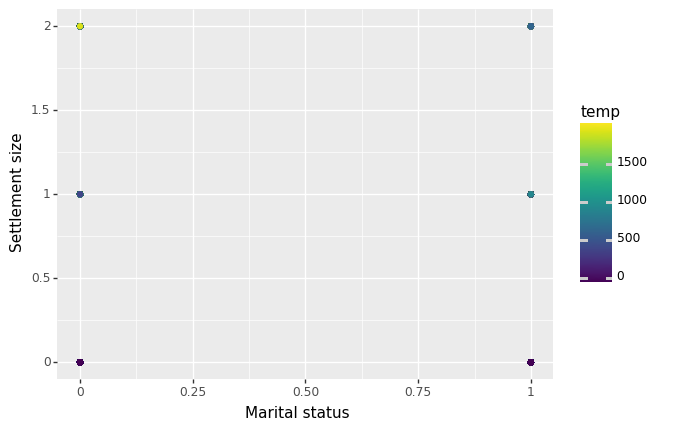

<ggplot: (8766039284261)>
CLuster21


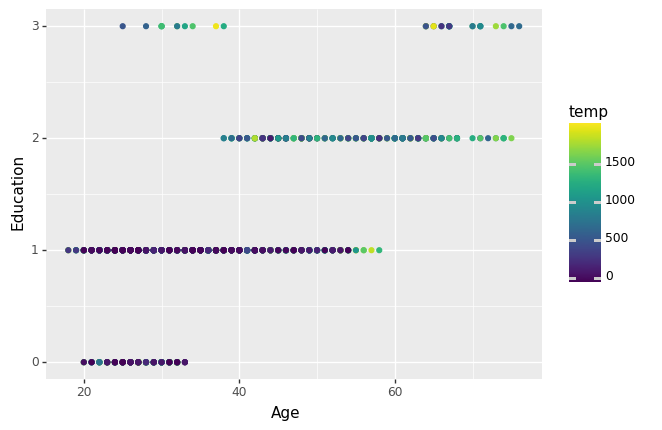

<ggplot: (8766034394201)>
CLuster21


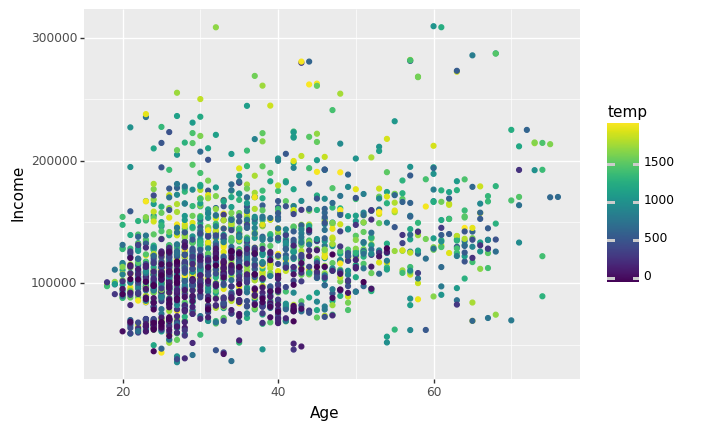

<ggplot: (8766037727957)>
CLuster21


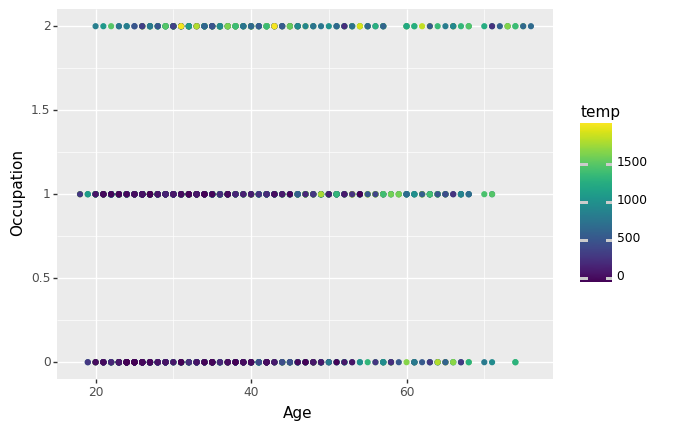

<ggplot: (8766038846309)>
CLuster21


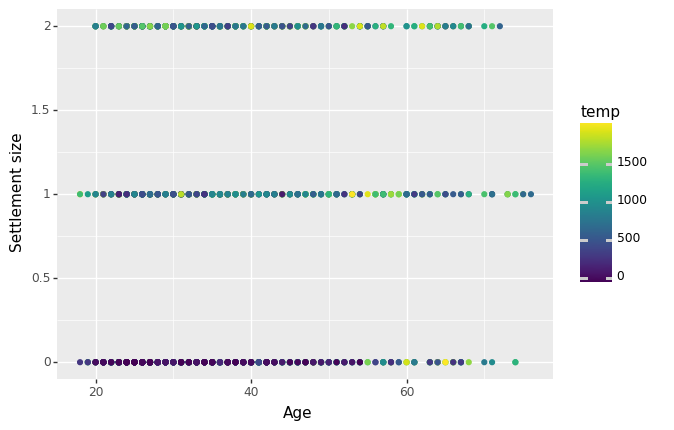

<ggplot: (8766039152717)>
CLuster21


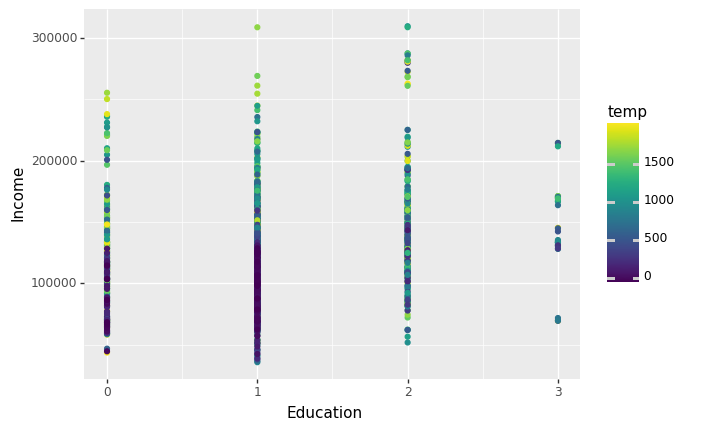

<ggplot: (8766039274265)>
CLuster21


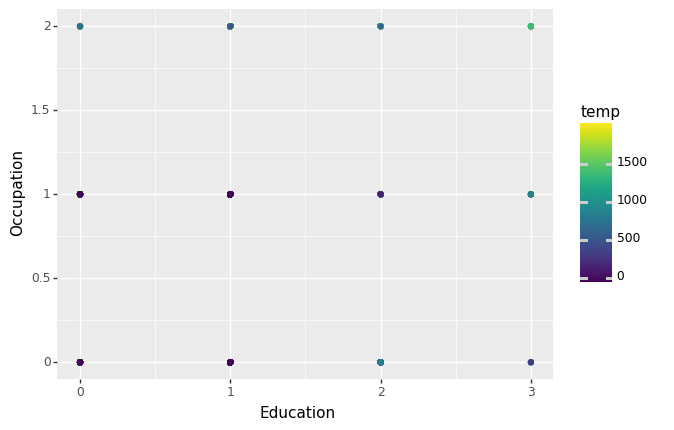

<ggplot: (8766034398037)>
CLuster21


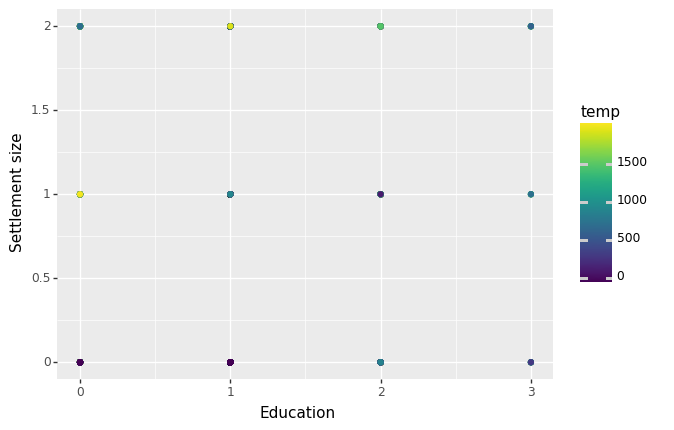

<ggplot: (8766034340641)>
CLuster21


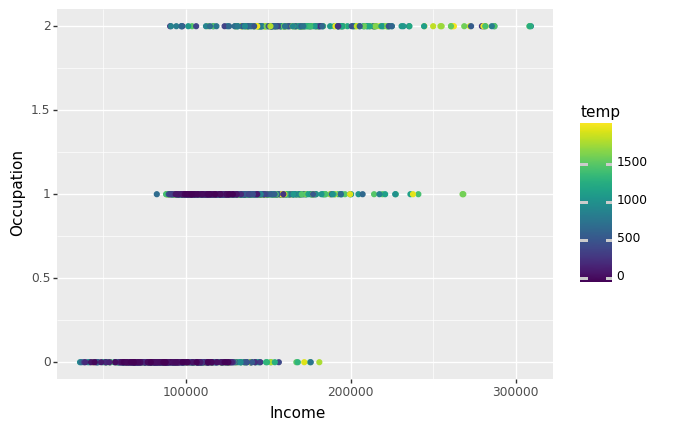

<ggplot: (8766039118445)>
CLuster21


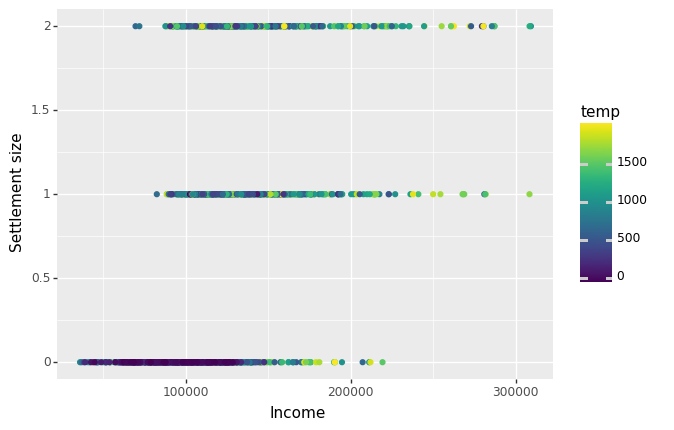

<ggplot: (8766039232013)>
CLuster21


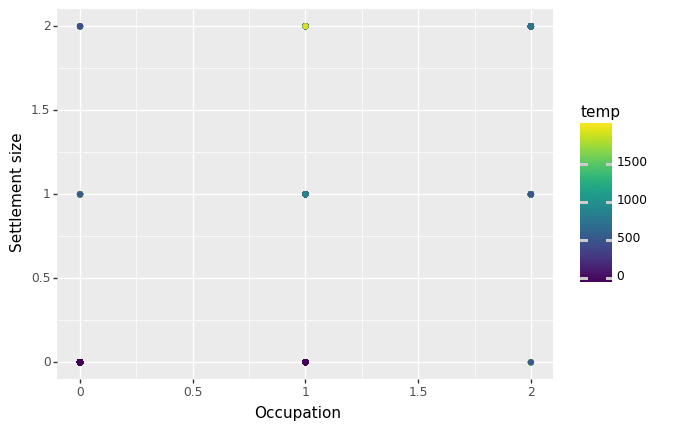

<ggplot: (8766039021001)>
1.5000000000000002


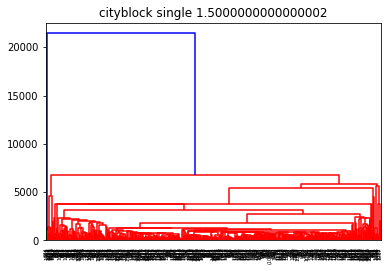

CLuster21


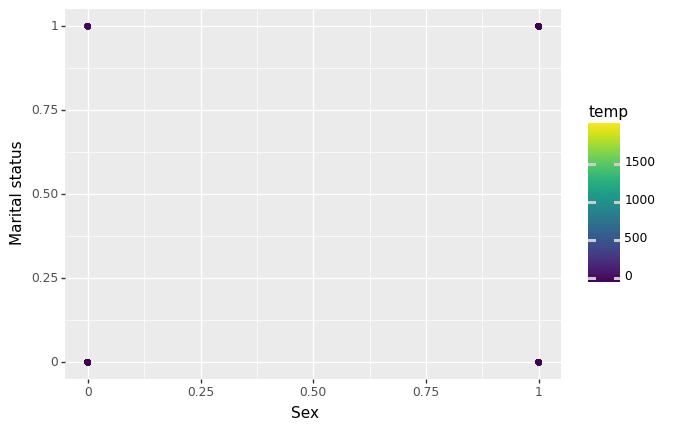

<ggplot: (8766037618421)>
CLuster21


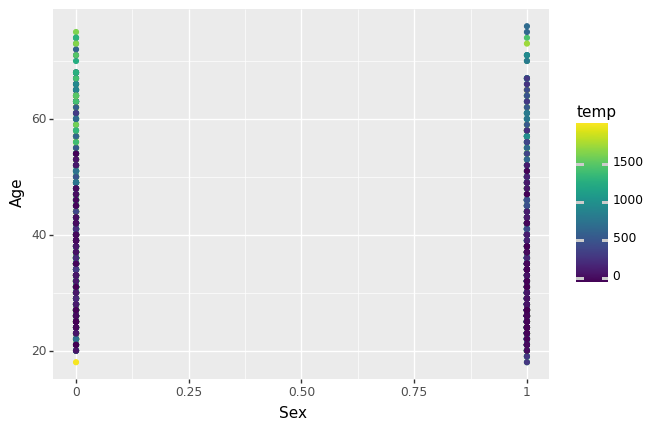

<ggplot: (8766039021049)>
CLuster21


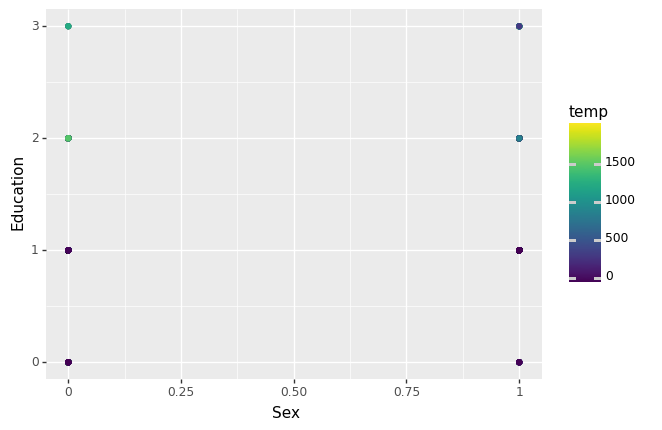

<ggplot: (8766037466653)>
CLuster21


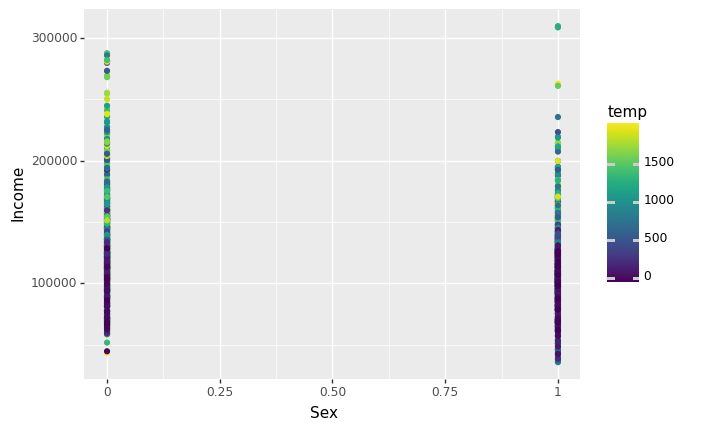

<ggplot: (8766034392325)>
CLuster21


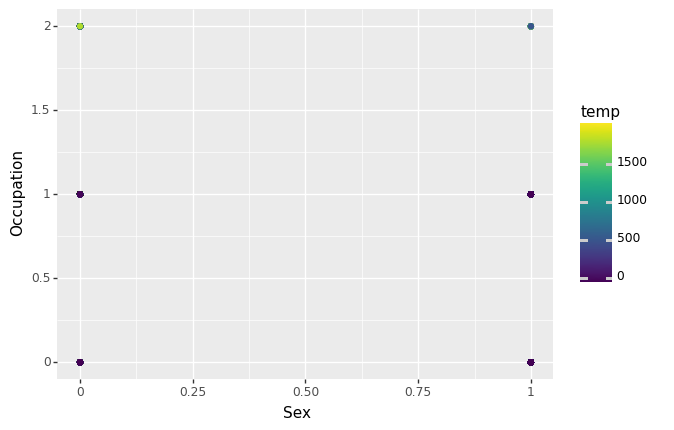

<ggplot: (8766039283277)>
CLuster21


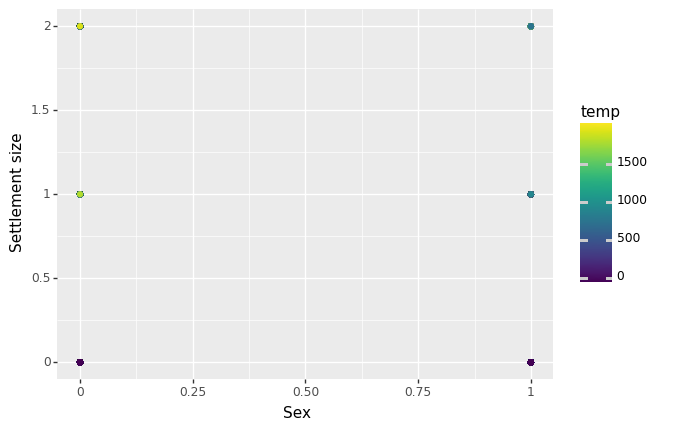

<ggplot: (8766039248445)>
CLuster21


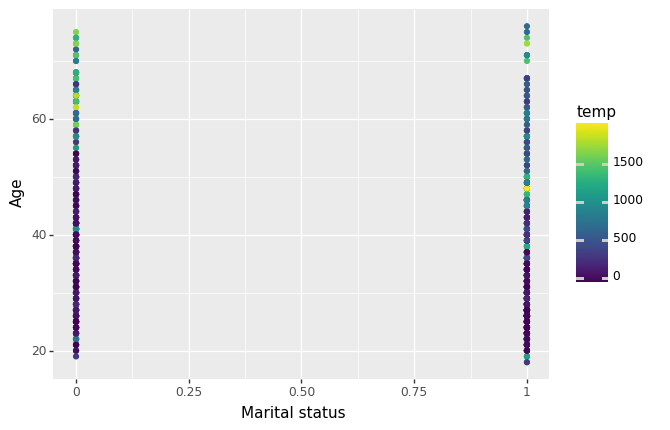

<ggplot: (8766034392429)>
CLuster21


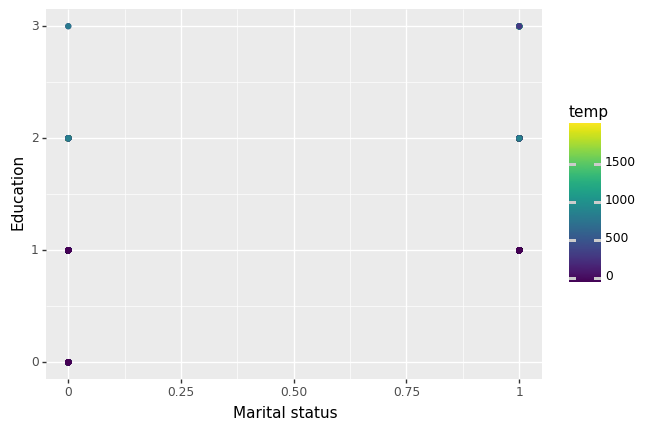

<ggplot: (8766039698633)>
CLuster21


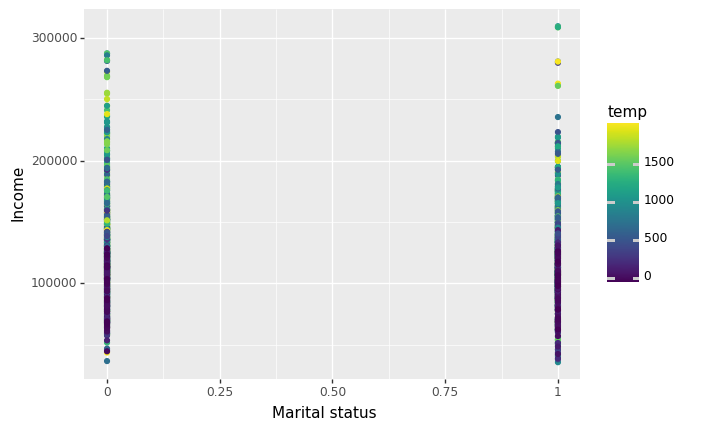

<ggplot: (8766034238801)>
CLuster21


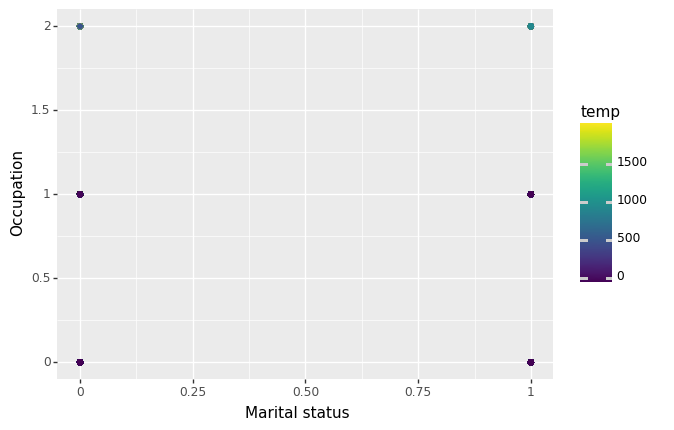

<ggplot: (8766039284465)>
CLuster21


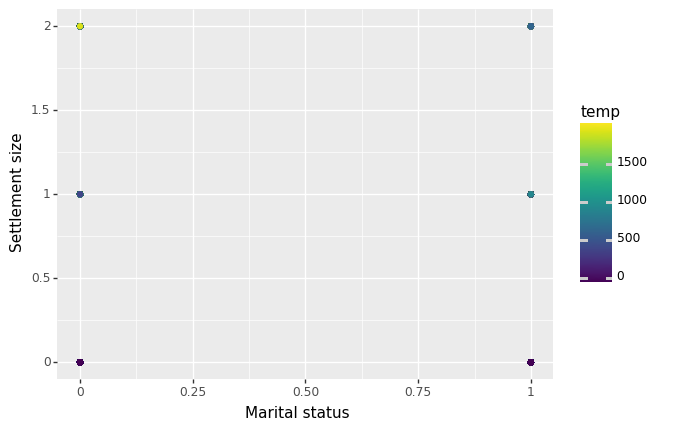

<ggplot: (8766034375049)>
CLuster21


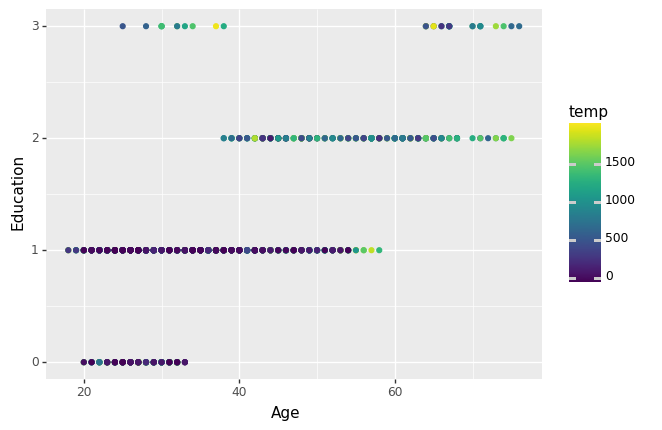

<ggplot: (8766039184357)>
CLuster21


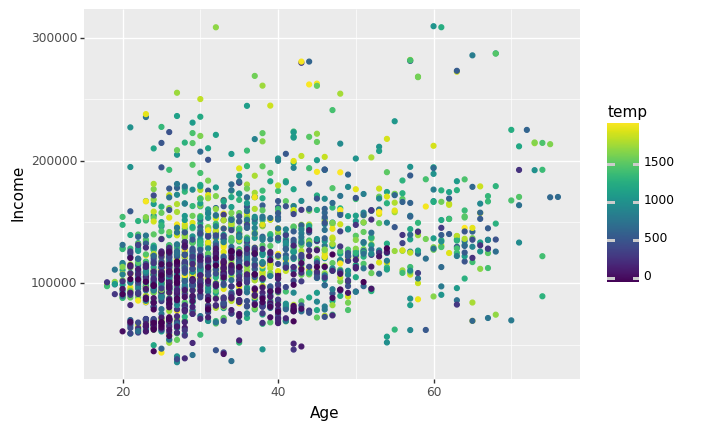

<ggplot: (8766037560813)>
CLuster21


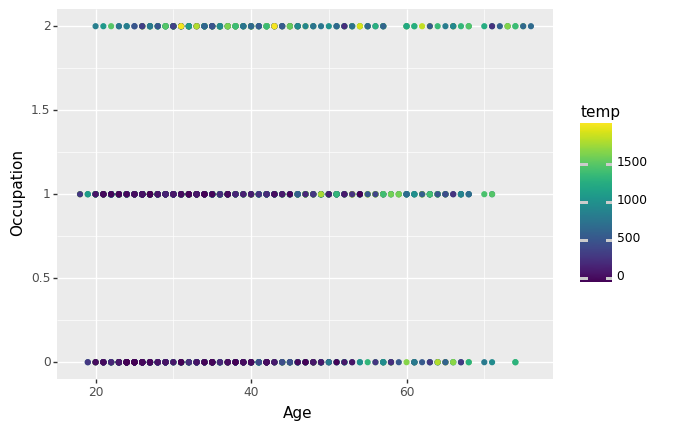

<ggplot: (8766037527689)>
CLuster21


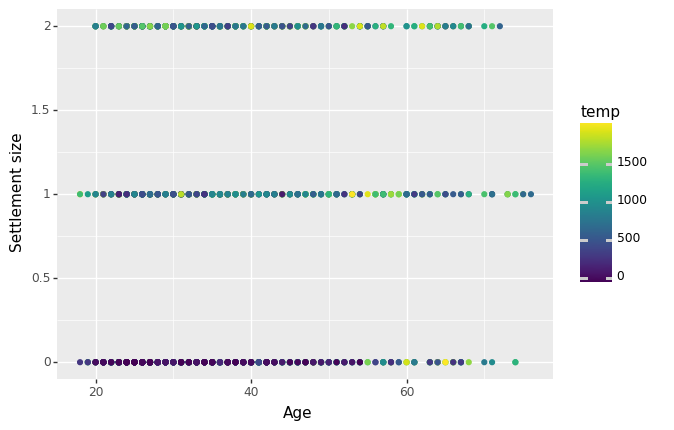

<ggplot: (8766034398109)>
CLuster21


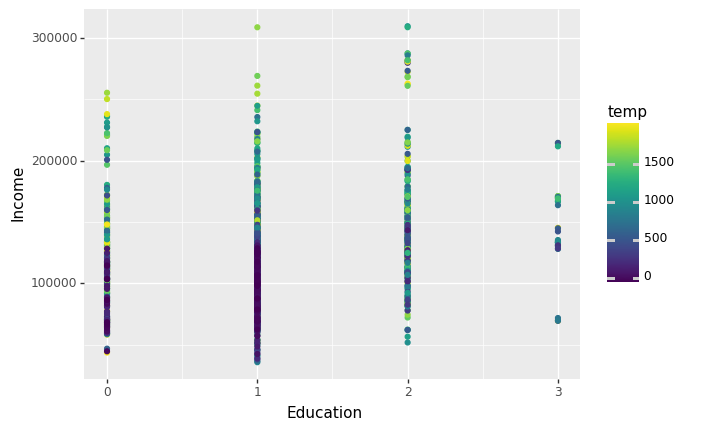

<ggplot: (8766037434365)>
CLuster21


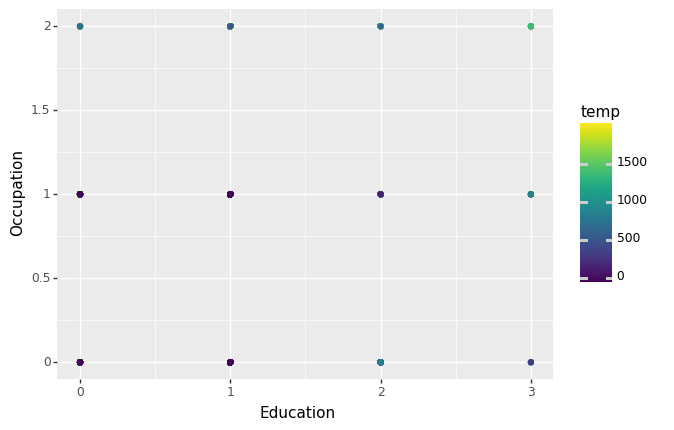

<ggplot: (8766039005469)>
CLuster21


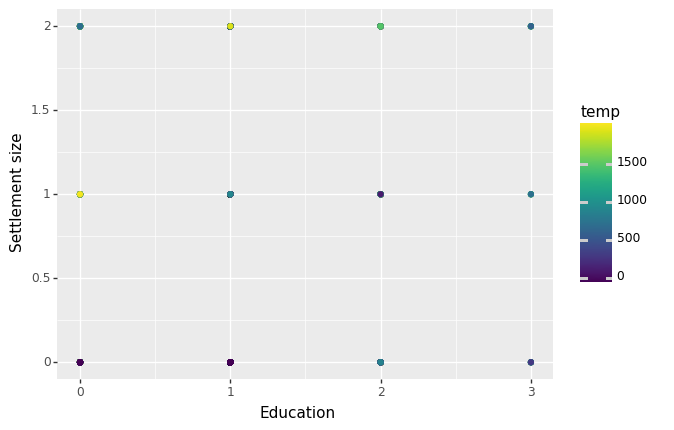

<ggplot: (8766037440565)>
CLuster21


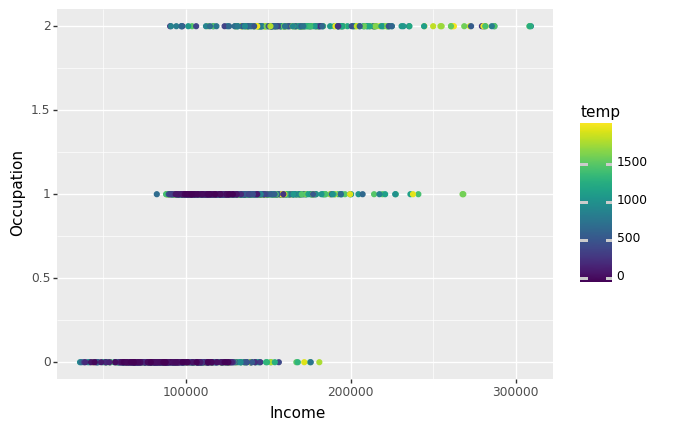

<ggplot: (8766039104361)>
CLuster21


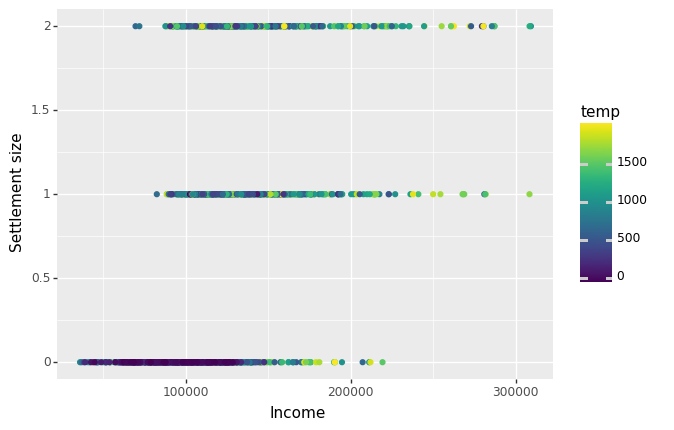

<ggplot: (8766038965349)>
CLuster21


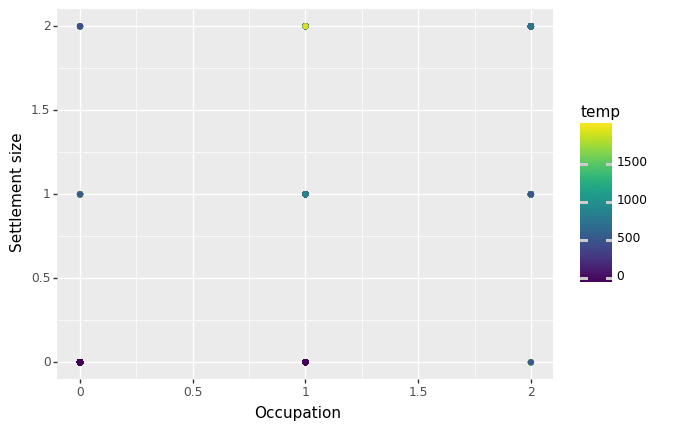

<ggplot: (8766037464333)>
1.7000000000000002


KeyboardInterrupt: ignored

In [9]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering


def display_hierarchal_cluster(X,km=[],num_clusters=0):
    alpha = 0.5  
    s = 20
    P=list(range(0,num_clusters+1))
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = 'r',alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[:,0],X[:,1],c =km.labels_,alpha = alpha,s=s)
        plt.show()

Affinity_list=['cityblock','euclidean','cosine']
Linkage_list=['average','single']
distance_range=np.arange(0.3, 2, 0.2)
best_silote_trails=['0.0','0.0','0.0','0.0']

a=0
while len(Affinity_list) -1 >= a :
  print(Affinity_list[a])
  l=0

  while len(Linkage_list) -1 >= l :
    print(Linkage_list[l])
    d=0

    while len(distance_range) -1 >= d :
      print(distance_range[d])
      if 'temp' in df_customer.columns:
        df_customer.drop('temp', axis=1, inplace=True)
      HIC = AgglomerativeClustering(distance_threshold=distance_range[d], n_clusters=None,affinity=Affinity_list[a],linkage=Linkage_list[l])
      HIC.fit(df_customer)
      df_customer['temp']=HIC.labels_
      temp=len(np.unique(HIC.labels_))
      if(temp!=1 and len(np.unique(HIC.labels_))!=len(df_customer)):
        single_iteration=silhouette_score(df_customer, HIC.labels_)
        if(float(best_silote_trails[0])<single_iteration):
          best_silote_trails=[str(single_iteration),Affinity_list[a],Linkage_list[l],str(distance_range[d].round(2))]
          print(best_silote_trails)
        linkage_type = linkage(df_customer, Linkage_list[l],metric=Affinity_list[a])
        plt.title(Affinity_list[a] +" "+Linkage_list[l]+" "+str(distance_range[d]))
        displaycl = dendrogram(linkage_type,truncate_mode='level')
        plt.show()
        df_customer_col=len(range(len(df_customer.columns)-1))
        c=len(df_customer.columns)-1
        j=0
        while df_customer_col >j:
          for u in range(c-1):
            u+=1
            u+=j
            print("CLuster" + str(i))
            print(ggplot(df_customer,aes(x=df_customer.columns[j],y=df_customer.columns[u],color='temp')) + geom_point() )
          c-=1
          j+=1
      d+=1
    l+=1
  a+=1
 
print("The max Silhouette Score is" + best_silote_trails[0] + "with affinity equal to"  + best_silote_trails[1] +  "and linkage equal to" + best_silote_trails[2] + "with distance_threshold"+ best_silote_trails[3] )


In [17]:
types_of_covar=['tied','diag','full']
i=0
while len(types_of_covar) > i :
  EM=GaussianMixture(n_components =3,covariance_type=types_of_covar[i])
  EM.fit(df_customer)
  print("Type",str(i))
  print(EM.predict_proba(df_customer))
  i+=1


Type 0
[[2.75151285e-07 0.00000000e+00 9.99999725e-01]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [1.79372809e-06 0.00000000e+00 9.99998206e-01]
 ...
 [1.66910943e-05 0.00000000e+00 9.99983309e-01]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [1.51690350e-06 0.00000000e+00 9.99998483e-01]]
Type 1
[[0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [9.99234616e-01 0.00000000e+00 7.65384316e-04]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [9.99978818e-01 0.00000000e+00 2.11816029e-05]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]]
Type 2
[[0. 1. 0.]
 [0. 0. 1.]
 [0. 1. 0.]
 ...
 [0. 1. 0.]
 [0. 0. 1.]
 [0. 1. 0.]]


##Normalizing the Customers data

In [12]:
if 'temp' in df_customer.columns:
 df_customer.drop('temp', axis=1, inplace=True)
scaler = StandardScaler()
scaler.fit(df_customer)
scaled_features = scaler.transform(df_customer)
df_customer_normalized = pd.DataFrame(scaled_features,columns=df.columns[::])
df_customer_normalized.head(5)

,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,-0.917399,-0.993024,2.653614,1.604323,0.097524,0.296823,1.552326
1,1.090038,1.007025,-1.187132,-0.063372,0.782654,0.296823,1.552326
2,-0.917399,-0.993024,1.117316,-0.063372,-0.833202,-1.269525,-0.909730
3,-0.917399,-0.993024,0.775916,-0.063372,1.328386,0.296823,0.321298
4,-0.917399,-0.993024,1.458716,-0.063372,0.736932,0.296823,0.321298


##KMEANS CLUSTERING

CLuster2


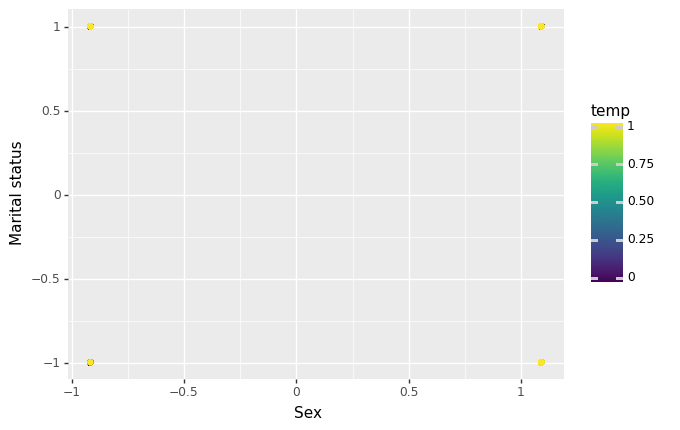

<ggplot: (8766081663505)>
CLuster2


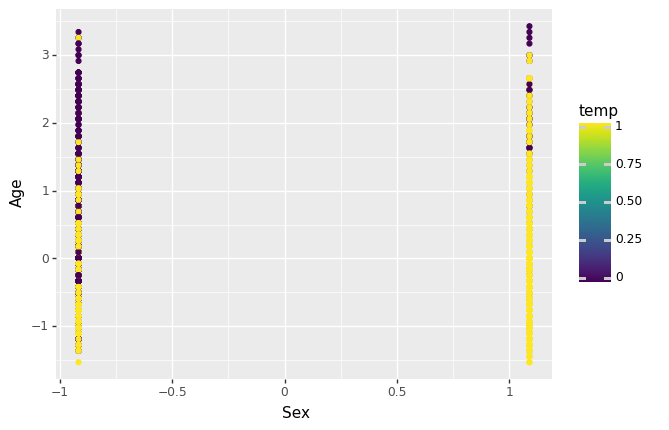

<ggplot: (8766039110741)>
CLuster2


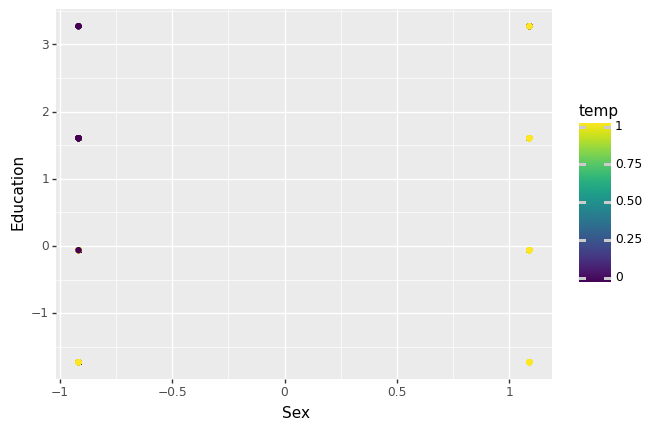

<ggplot: (8766039105789)>
CLuster2


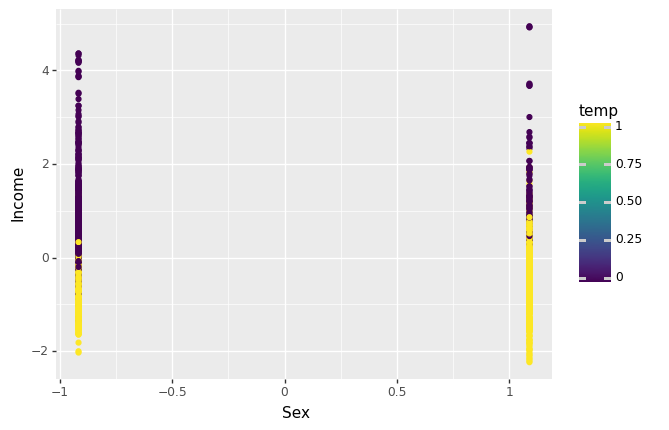

<ggplot: (8766039110773)>
CLuster2


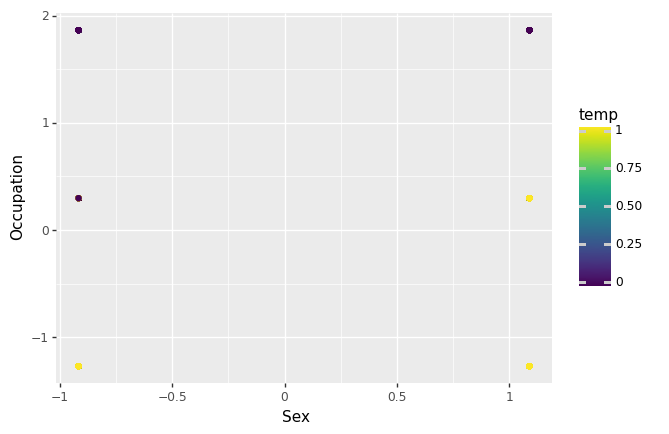

<ggplot: (8766037706125)>
CLuster2


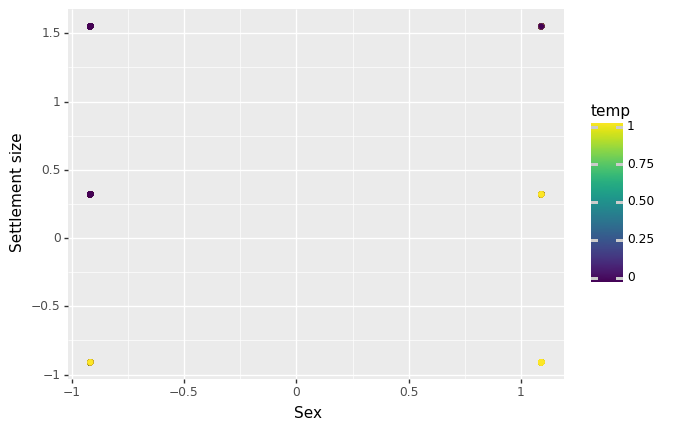

<ggplot: (8766034282877)>
CLuster2


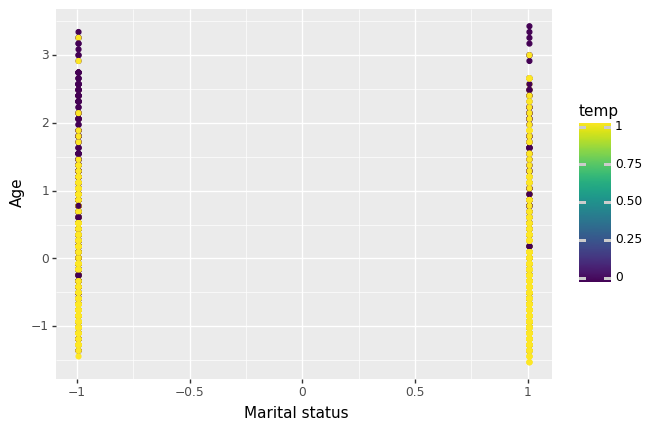

<ggplot: (8766039186549)>
CLuster2


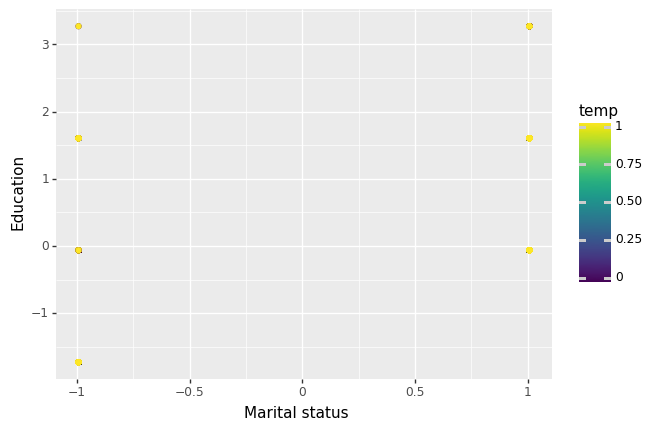

<ggplot: (8766037461425)>
CLuster2


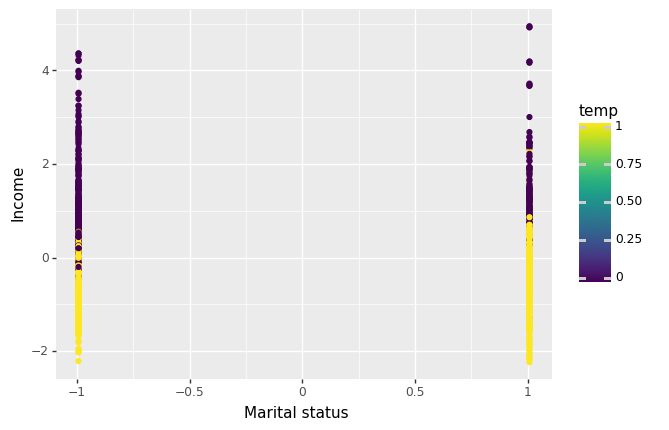

<ggplot: (8766034397969)>
CLuster2


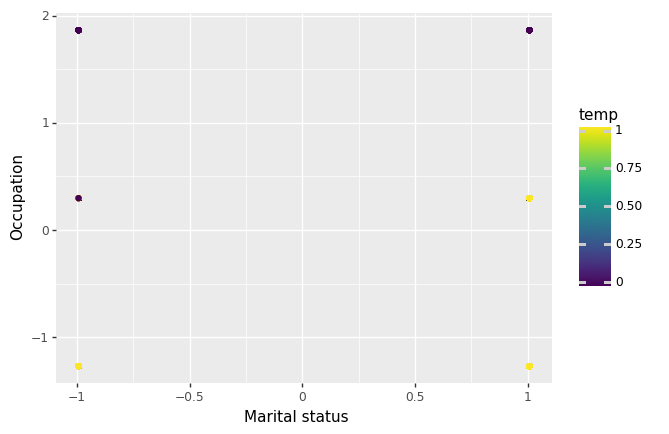

<ggplot: (8766033991657)>
CLuster2


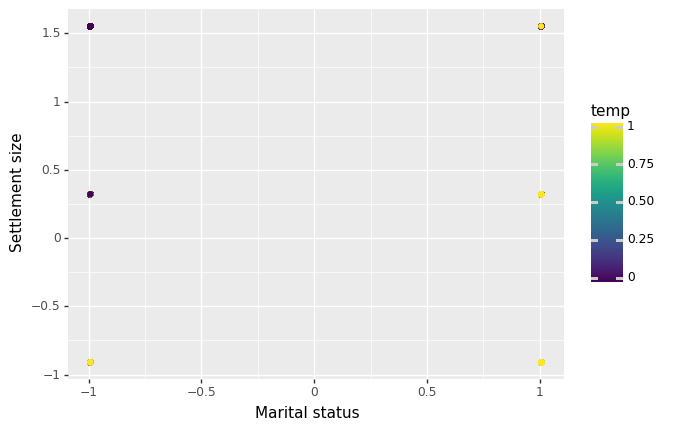

<ggplot: (8766034415781)>
CLuster2


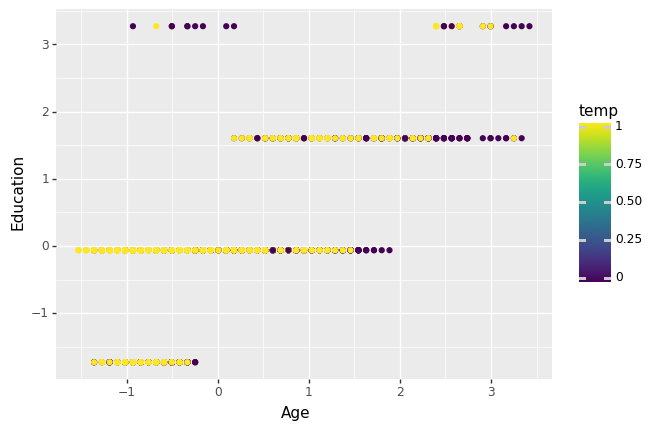

<ggplot: (8766037695313)>
CLuster2


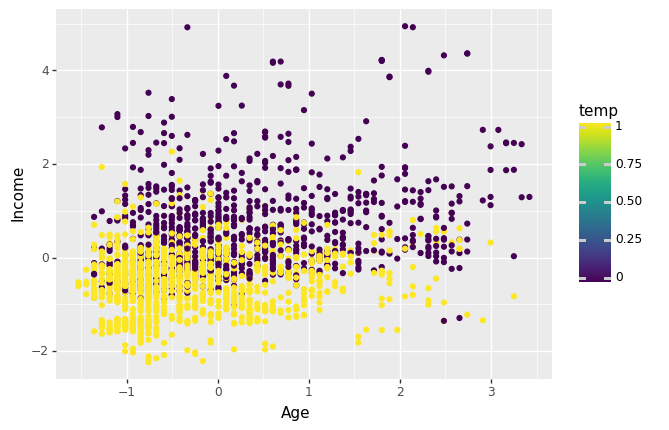

<ggplot: (8766039186121)>
CLuster2


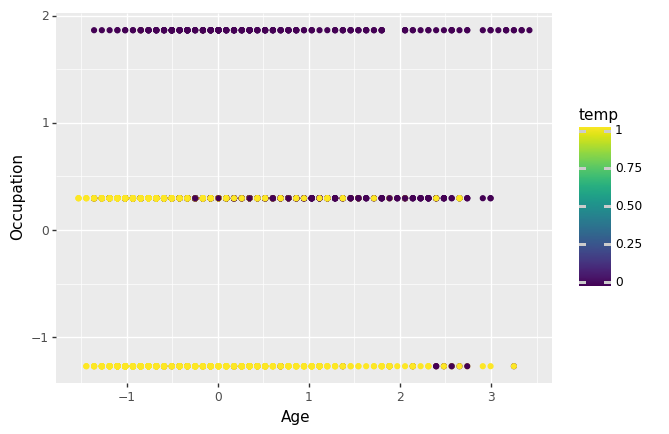

<ggplot: (8766039811561)>
CLuster2


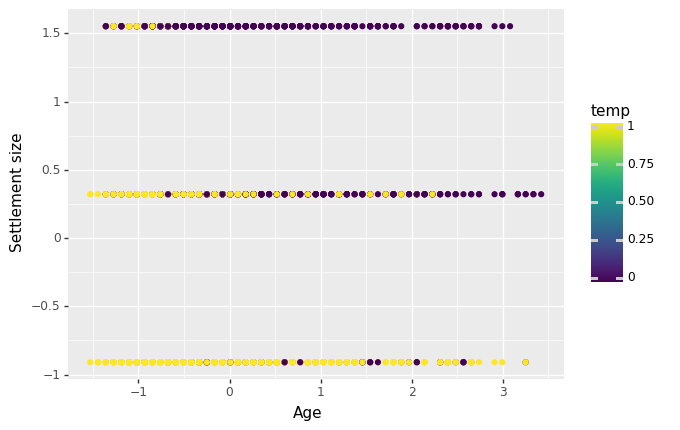

<ggplot: (8766037627865)>
CLuster2


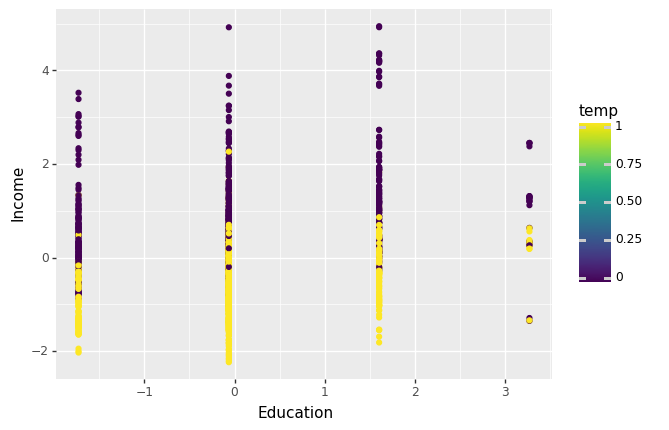

<ggplot: (8766038795985)>
CLuster2


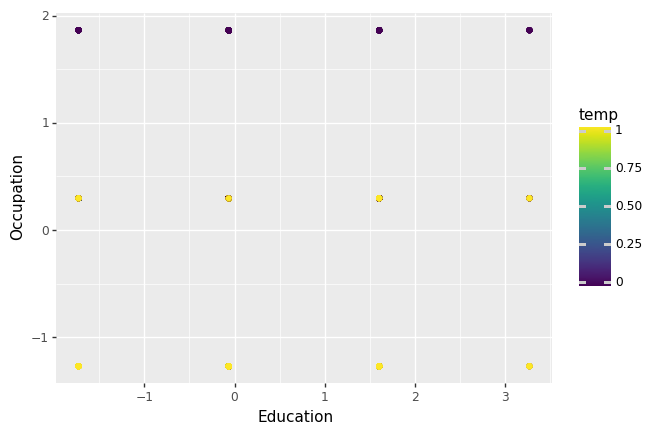

<ggplot: (8766037712309)>
CLuster2


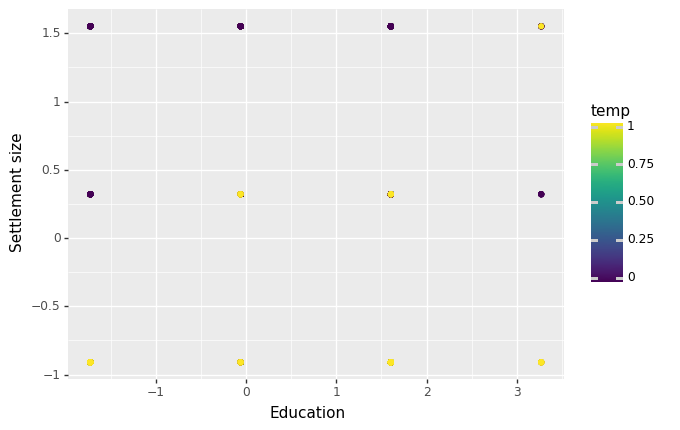

<ggplot: (8766038815517)>
CLuster2


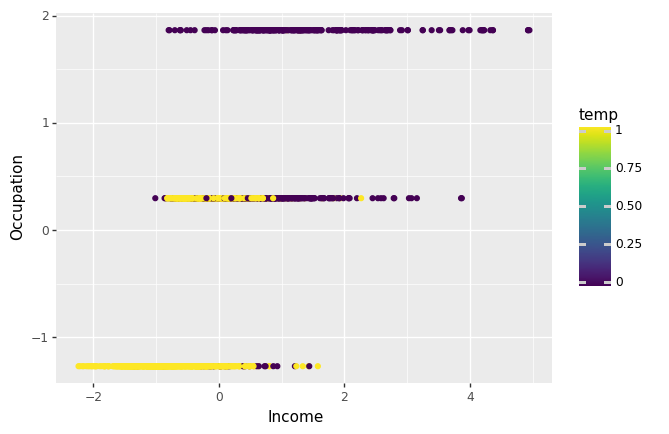

<ggplot: (8766033797165)>
CLuster2


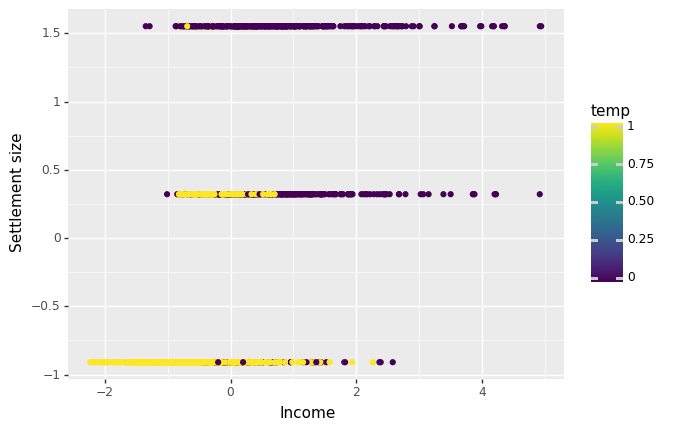

<ggplot: (8766034416625)>
CLuster2


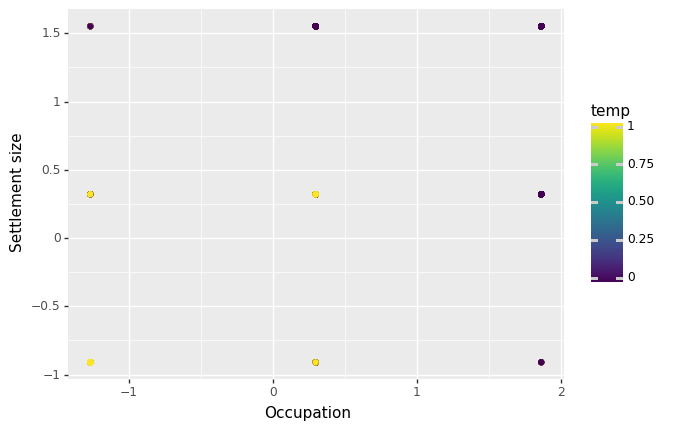

<ggplot: (8766033340637)>
CLuster3


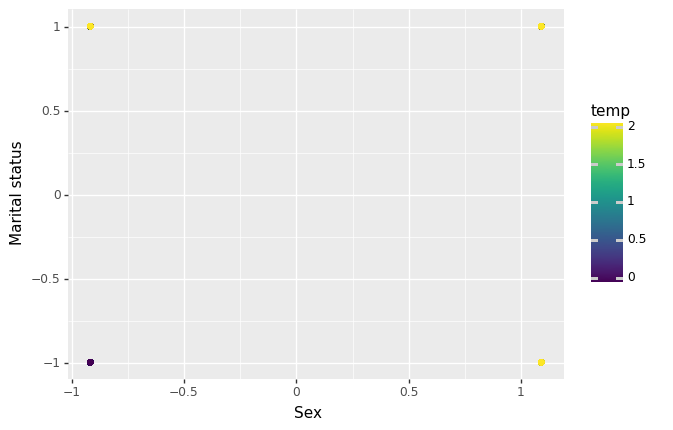

<ggplot: (8766033810561)>
CLuster3


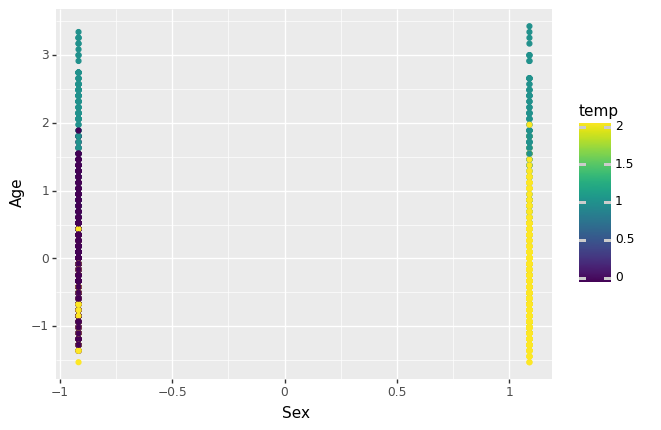

<ggplot: (8766033889305)>
CLuster3


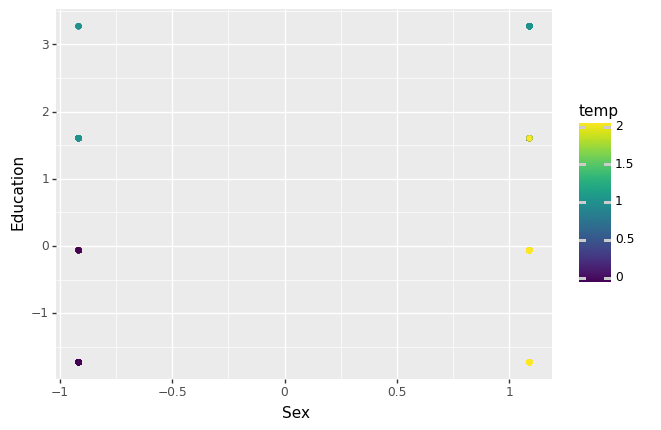

<ggplot: (8766034755865)>
CLuster3


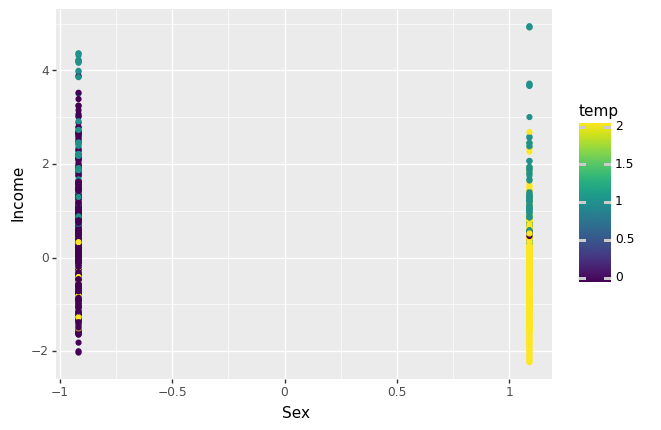

<ggplot: (8766034744645)>
CLuster3


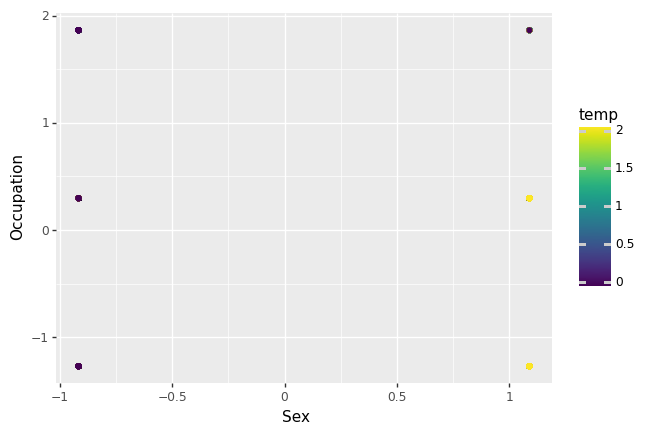

<ggplot: (8766034392469)>
CLuster3


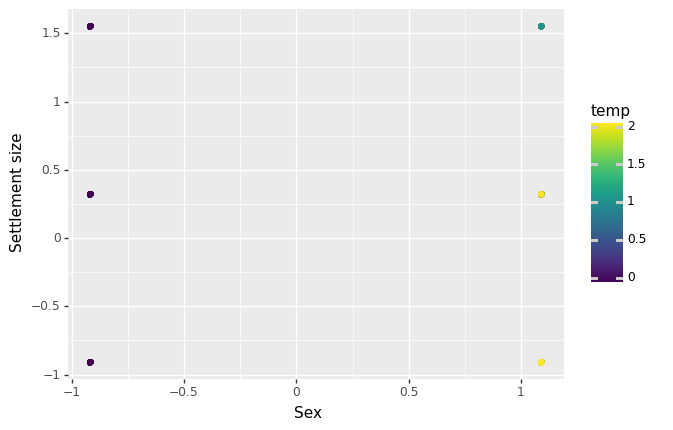

<ggplot: (8766034384241)>
CLuster3


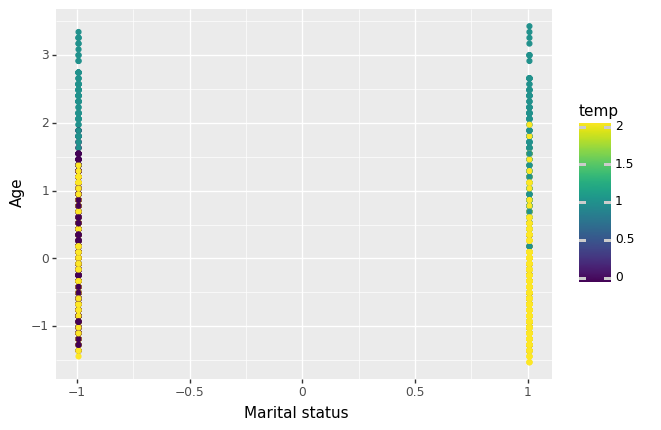

<ggplot: (8766034192809)>
CLuster3


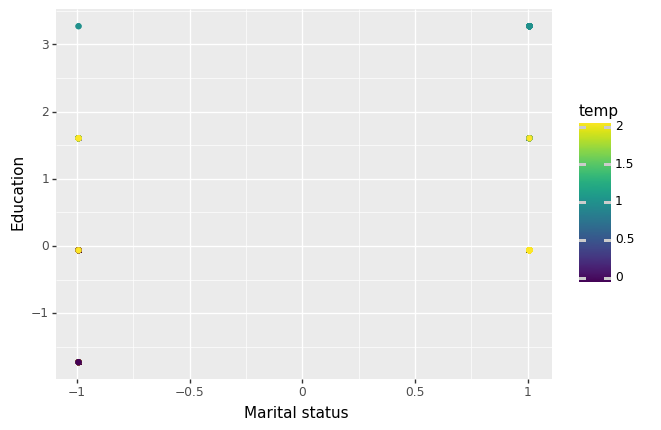

<ggplot: (8766034192673)>
CLuster3


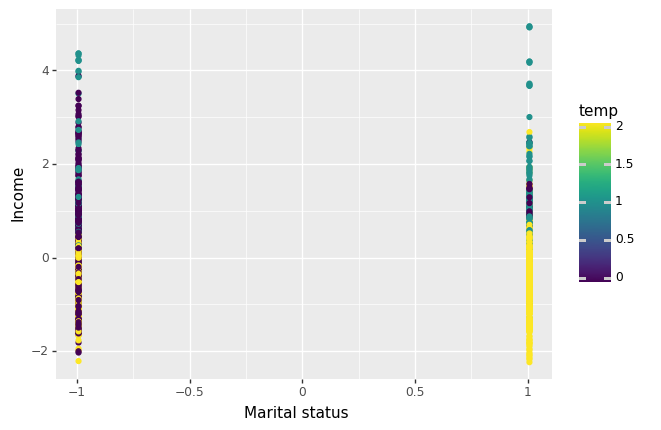

<ggplot: (8766039275473)>
CLuster3


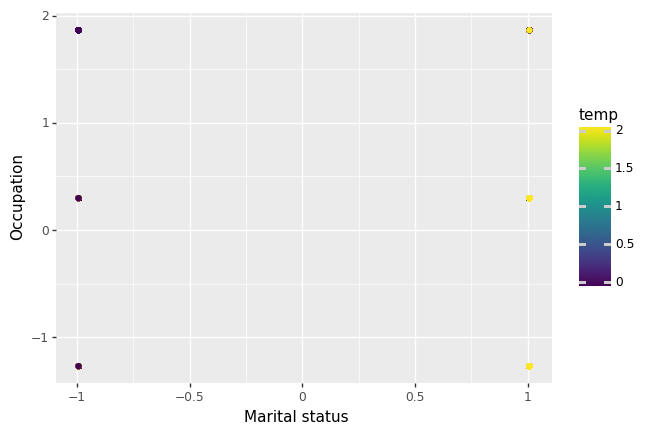

<ggplot: (8766038794829)>
CLuster3


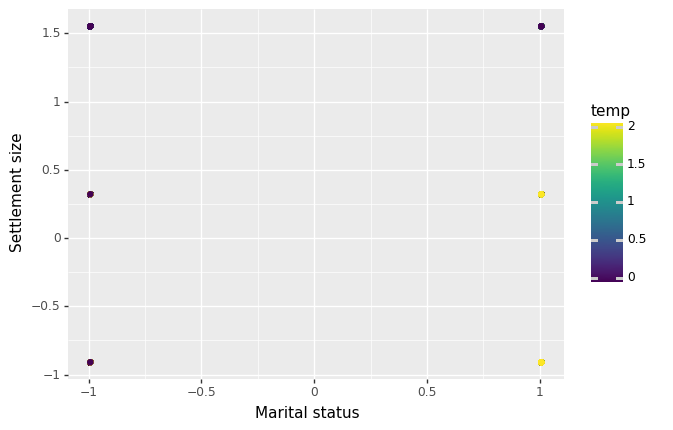

<ggplot: (8766034346205)>
CLuster3


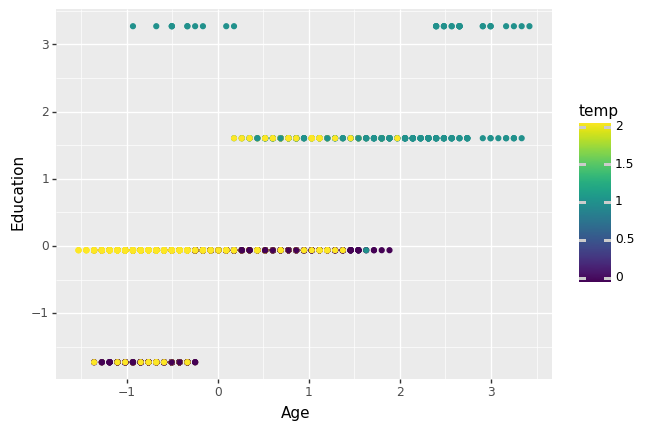

<ggplot: (8766037520733)>
CLuster3


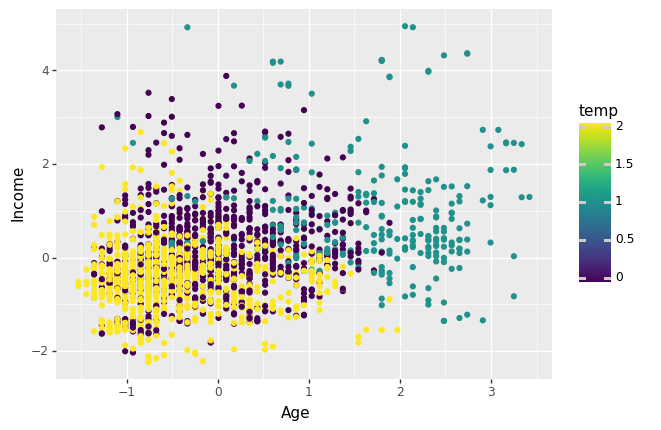

<ggplot: (8766033975909)>
CLuster3


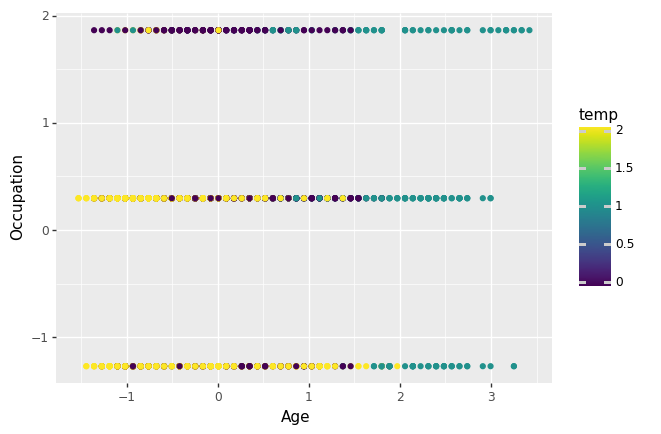

<ggplot: (8766037704929)>
CLuster3


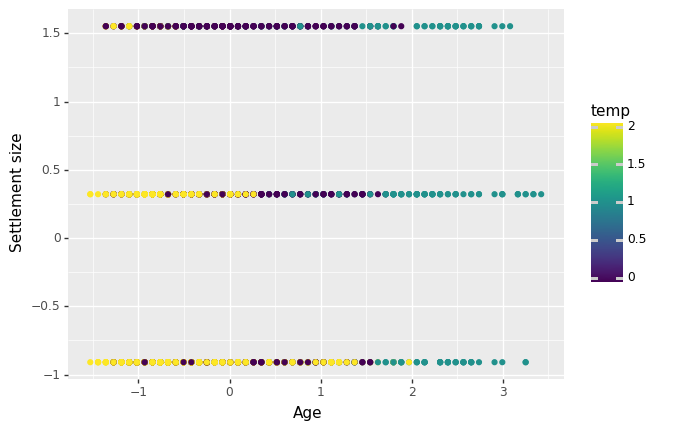

<ggplot: (8766034573017)>
CLuster3


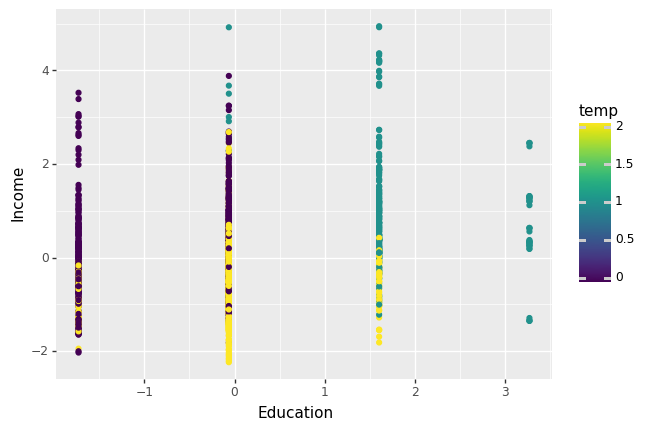

<ggplot: (8766037452761)>
CLuster3


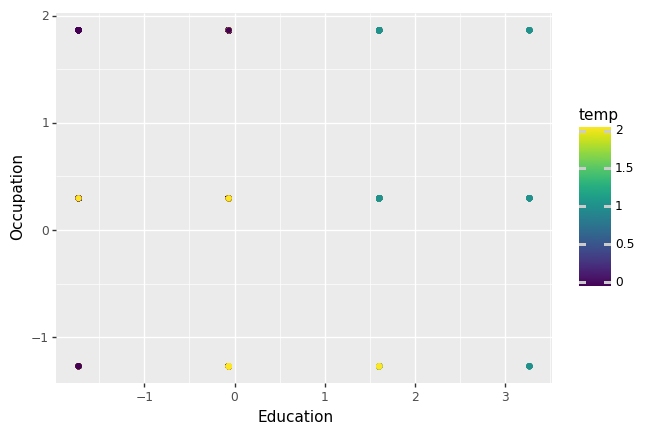

<ggplot: (8766033892617)>
CLuster3


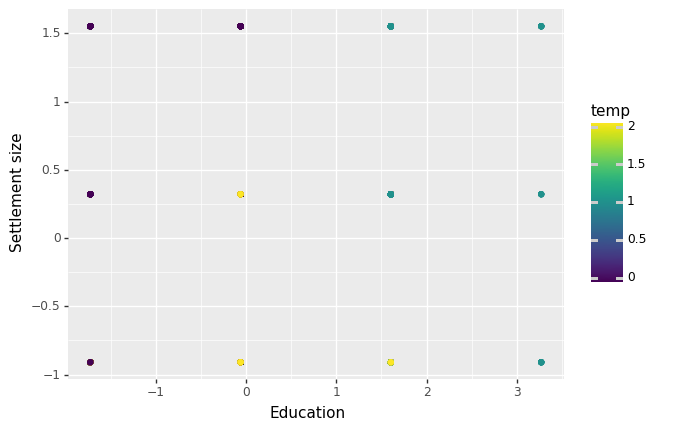

<ggplot: (8766037715357)>
CLuster3


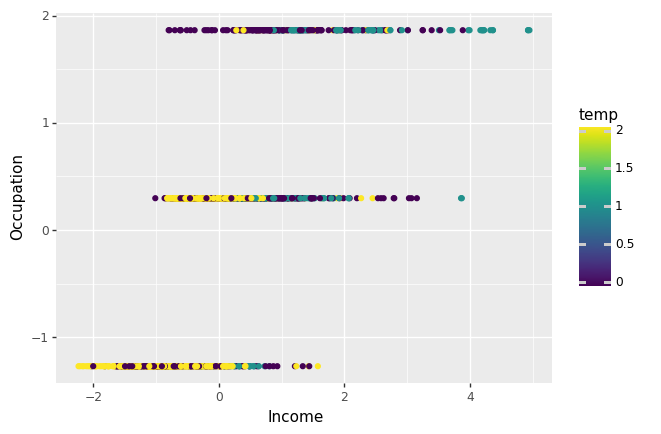

<ggplot: (8766033892381)>
CLuster3


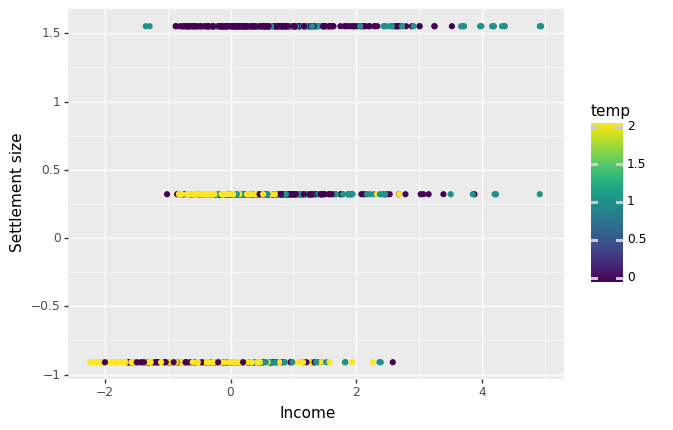

<ggplot: (8766033914749)>
CLuster3


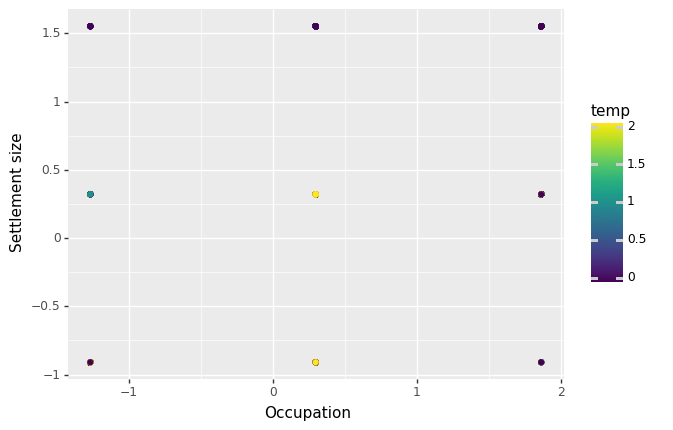

<ggplot: (8766034164157)>
CLuster4


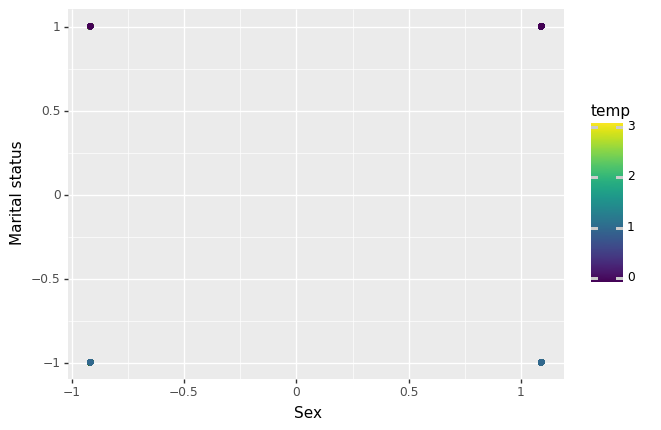

<ggplot: (8766034382681)>
CLuster4


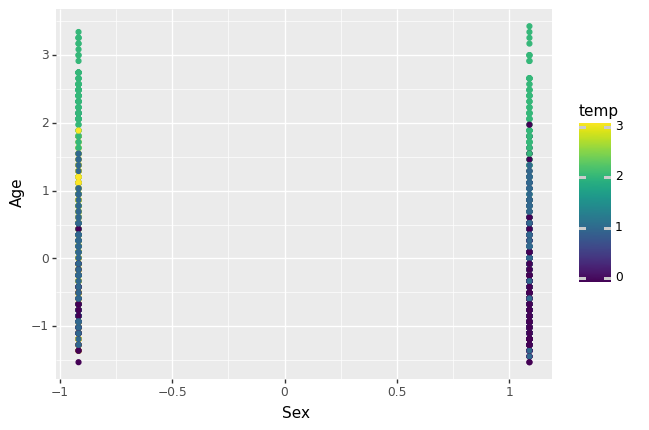

<ggplot: (8766033712405)>
CLuster4


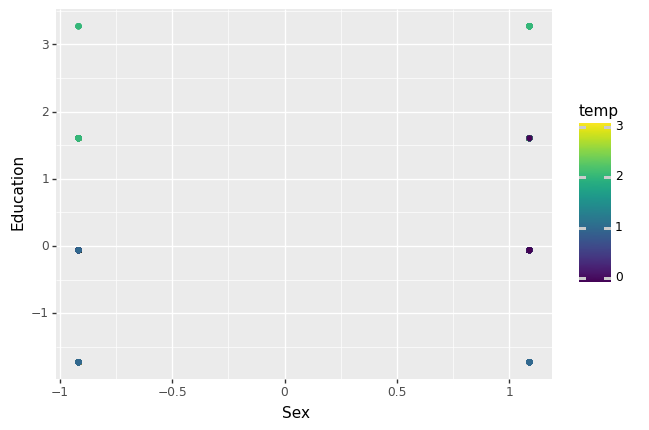

<ggplot: (8766033447745)>
CLuster4


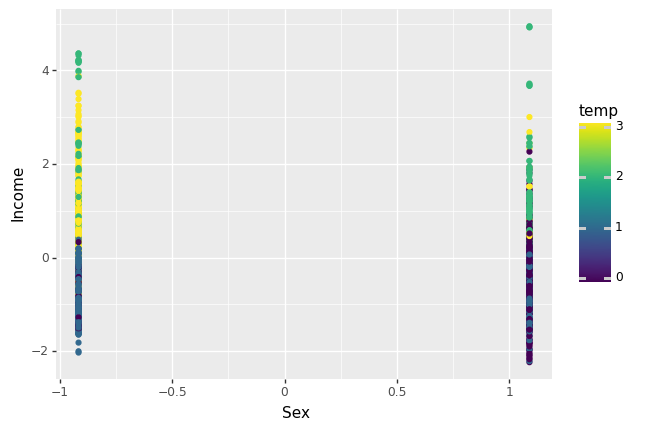

<ggplot: (8766033339625)>
CLuster4


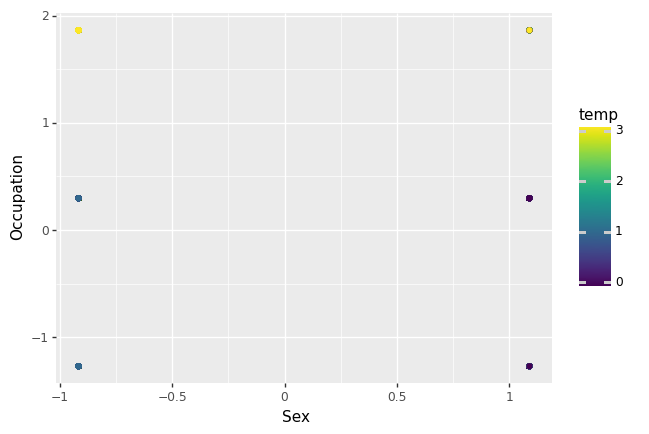

<ggplot: (8766033447745)>
CLuster4


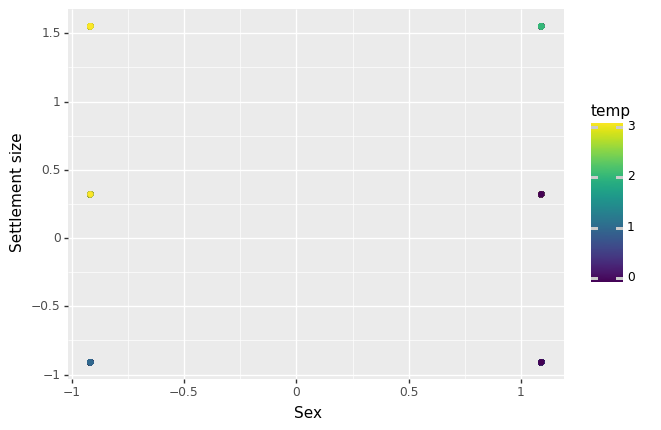

<ggplot: (8766034429389)>
CLuster4


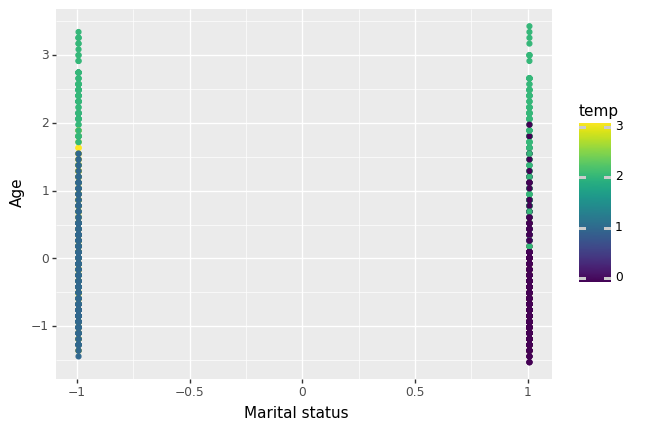

<ggplot: (8766033852413)>
CLuster4


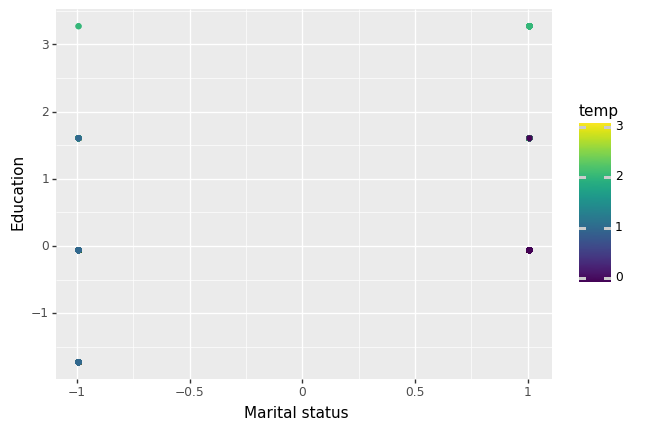

<ggplot: (8766033438445)>
CLuster4


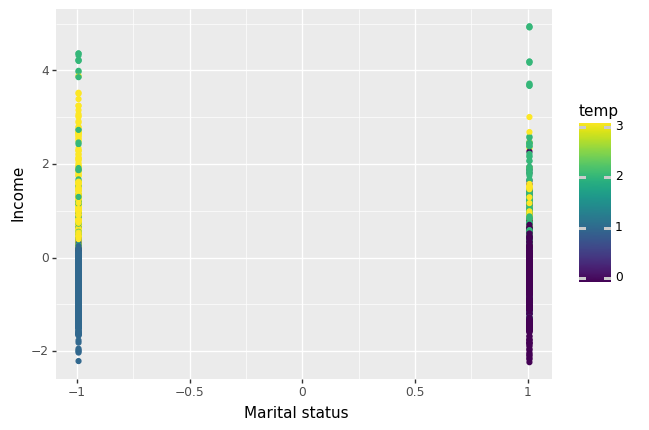

<ggplot: (8766033435749)>
CLuster4


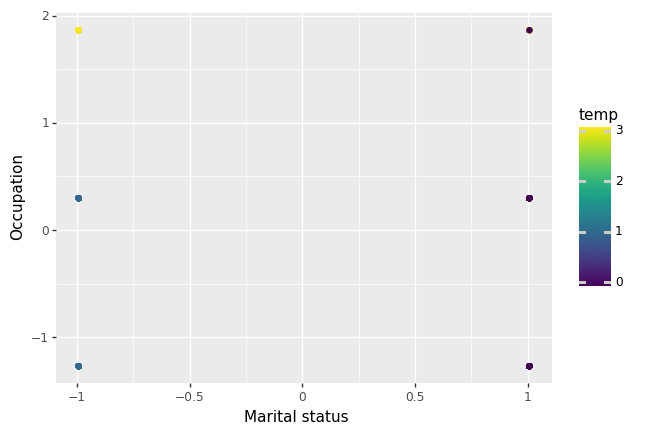

<ggplot: (8766039205257)>
CLuster4


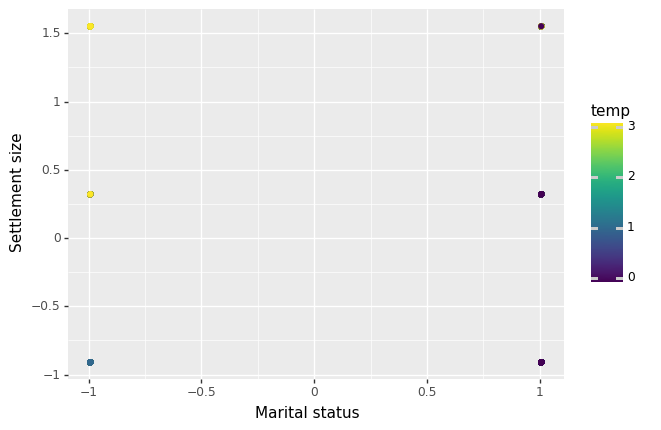

<ggplot: (8766034024777)>
CLuster4


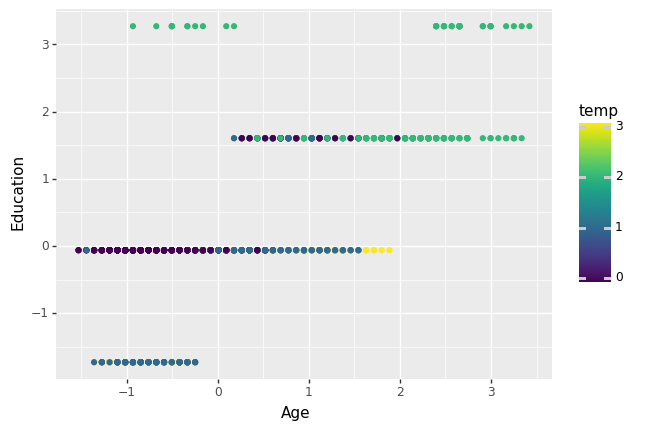

<ggplot: (8766039305969)>
CLuster4


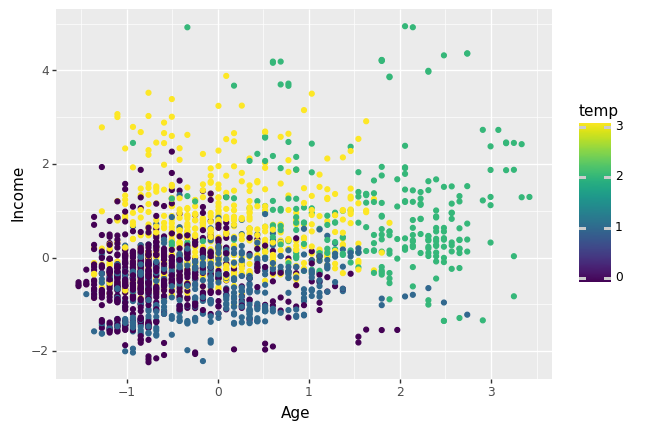

<ggplot: (8766039152645)>
CLuster4


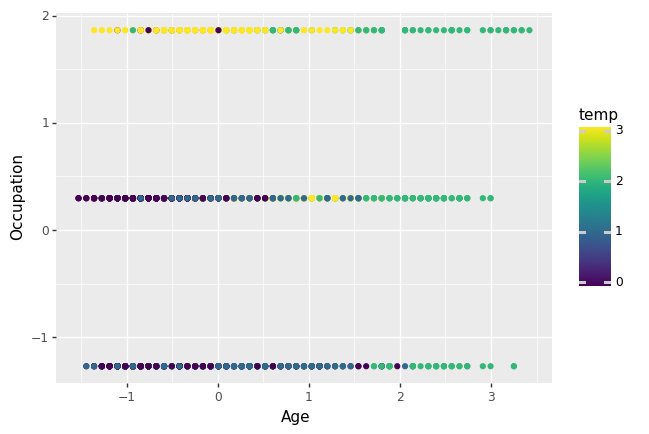

<ggplot: (8766034264181)>
CLuster4


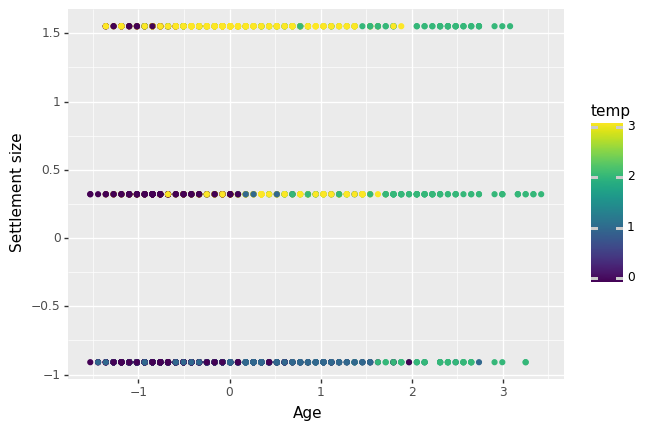

<ggplot: (8766037723665)>
CLuster4


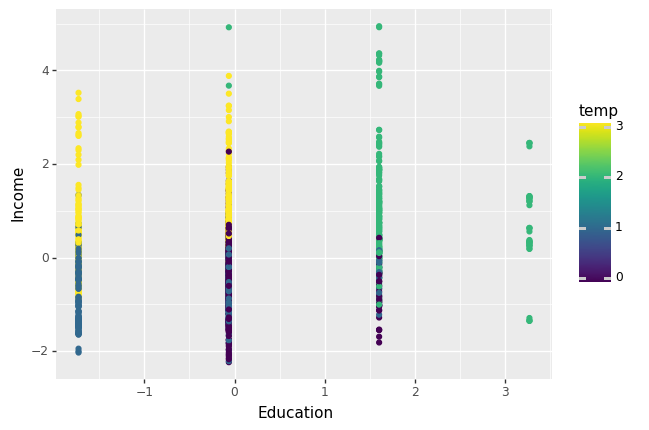

<ggplot: (8766033698733)>
CLuster4


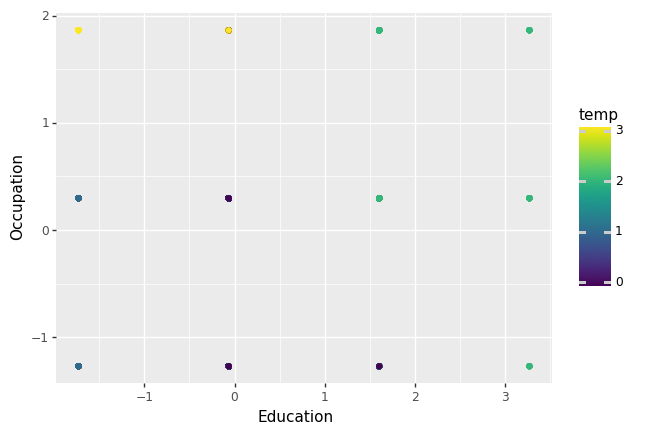

<ggplot: (8766033805361)>
CLuster4


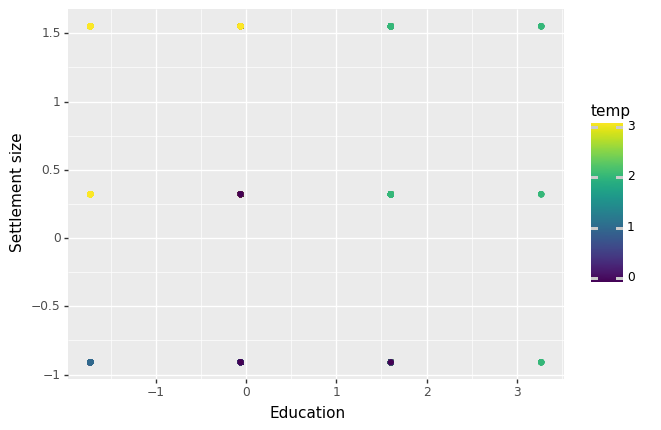

<ggplot: (8766034031357)>
CLuster4


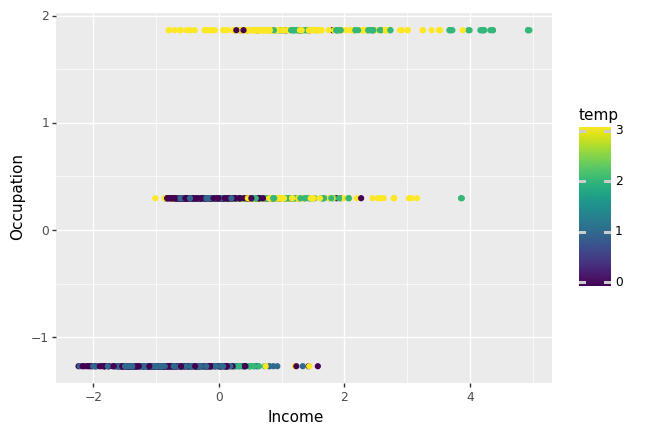

<ggplot: (8766034078037)>
CLuster4


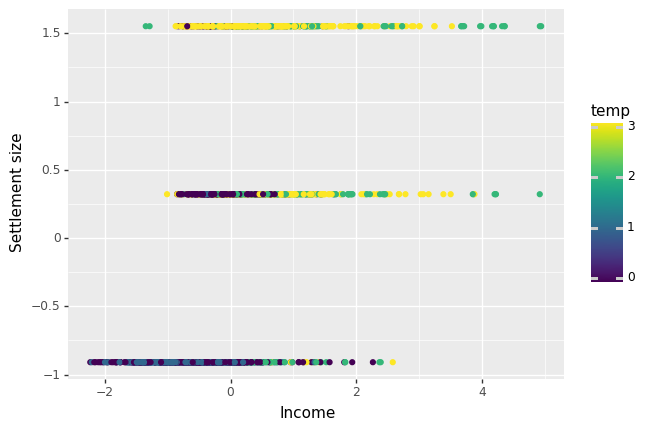

<ggplot: (8766037645069)>
CLuster4


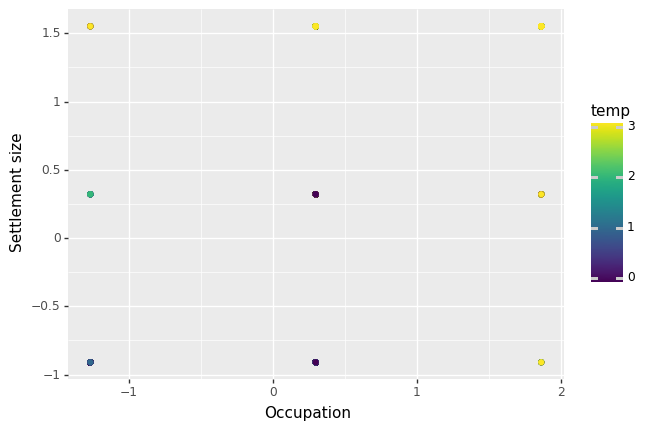

<ggplot: (8766034031357)>
CLuster5


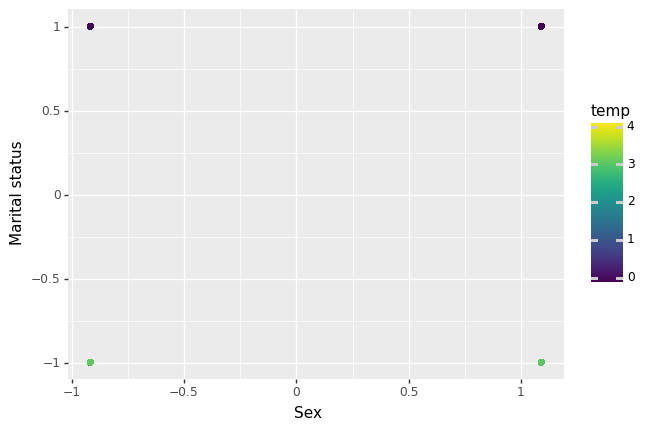

<ggplot: (8766034290901)>
CLuster5


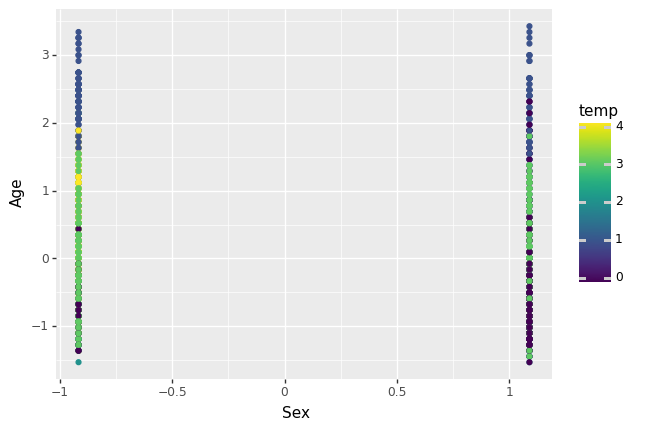

<ggplot: (8766039319353)>
CLuster5


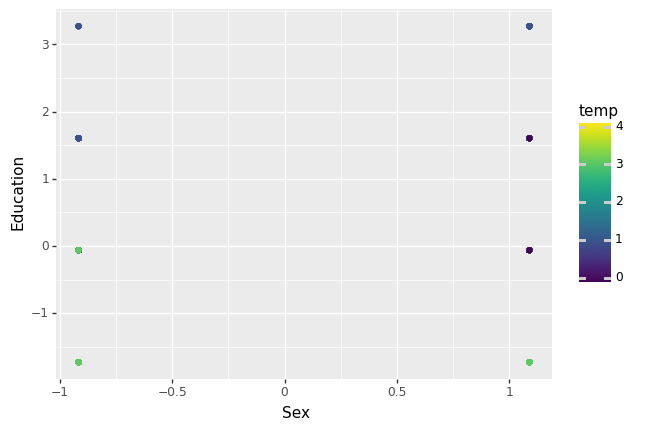

<ggplot: (8766034040037)>
CLuster5


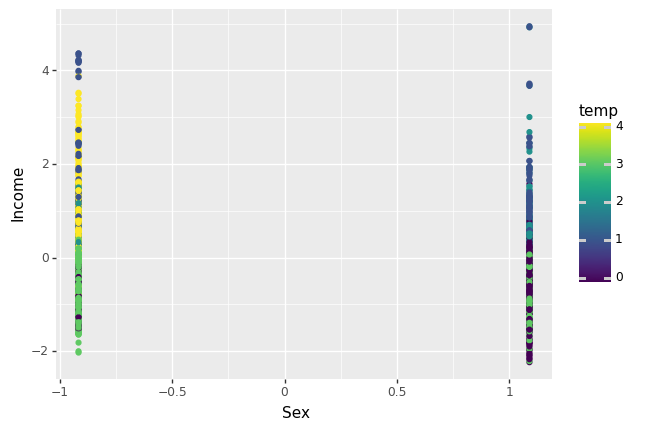

<ggplot: (8766039714669)>
CLuster5


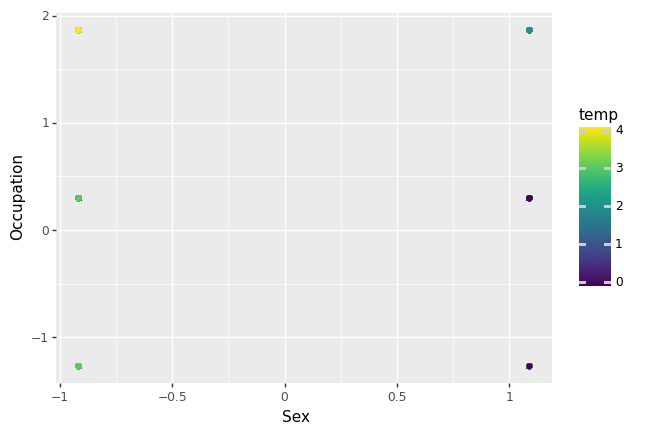

<ggplot: (8766037643641)>
CLuster5


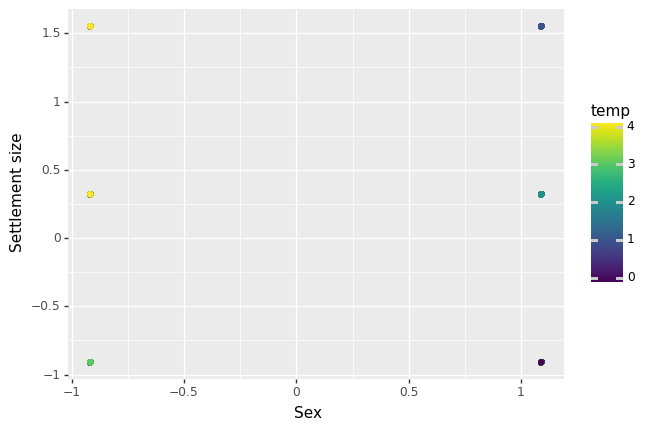

<ggplot: (8766034388393)>
CLuster5


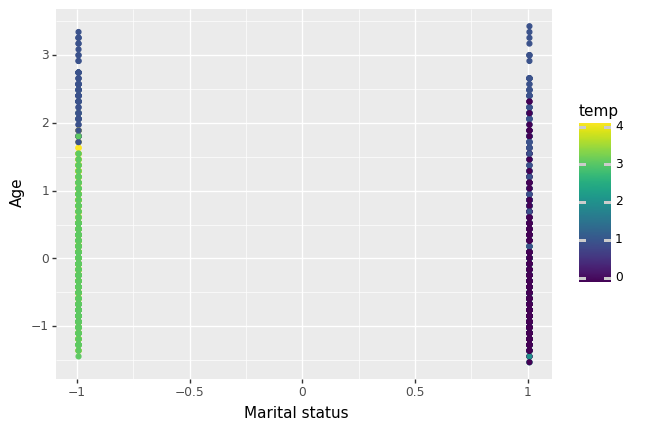

<ggplot: (8766039099413)>
CLuster5


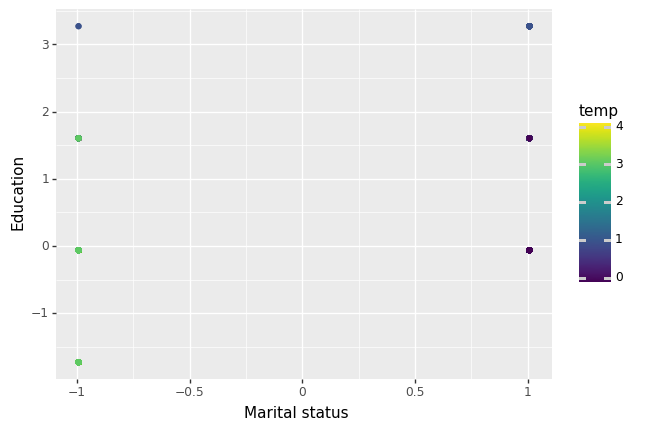

<ggplot: (8766033942801)>
CLuster5


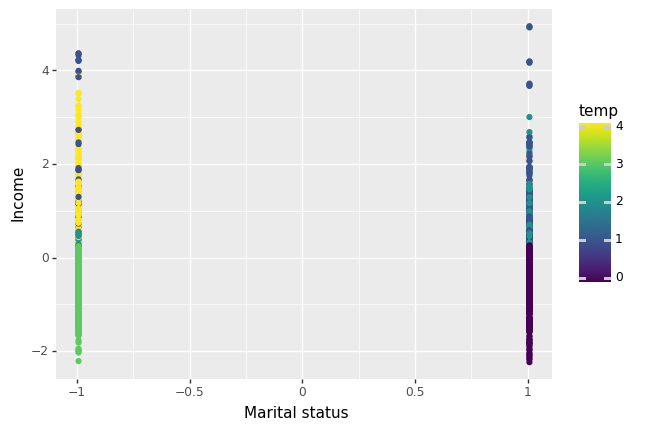

<ggplot: (8766034660409)>
CLuster5


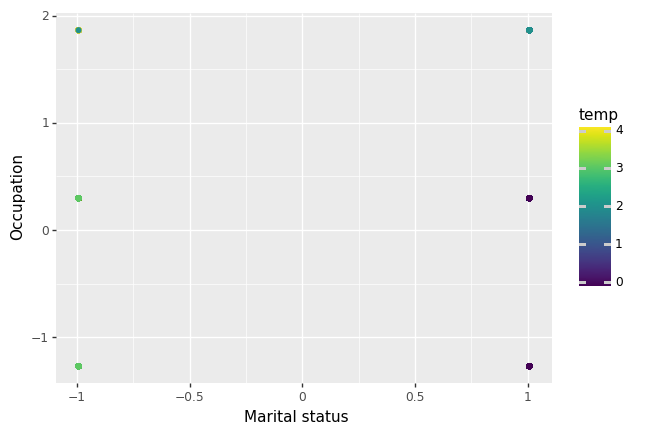

<ggplot: (8766034168273)>
CLuster5


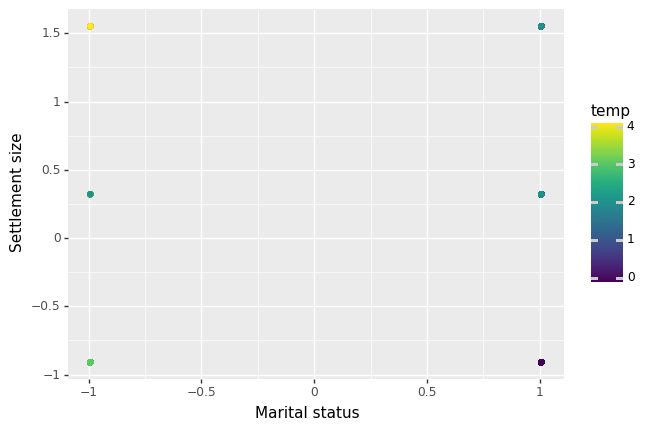

<ggplot: (8766033923829)>
CLuster5


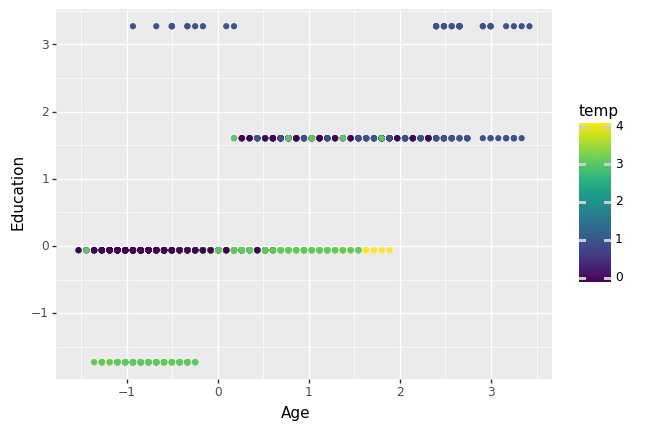

<ggplot: (8766034406585)>
CLuster5


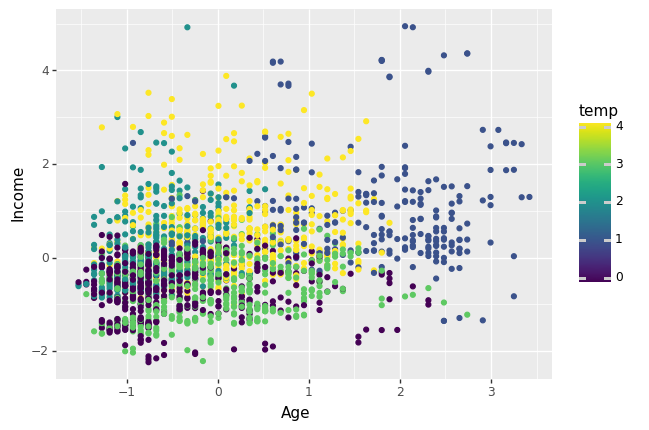

<ggplot: (8766034458517)>
CLuster5


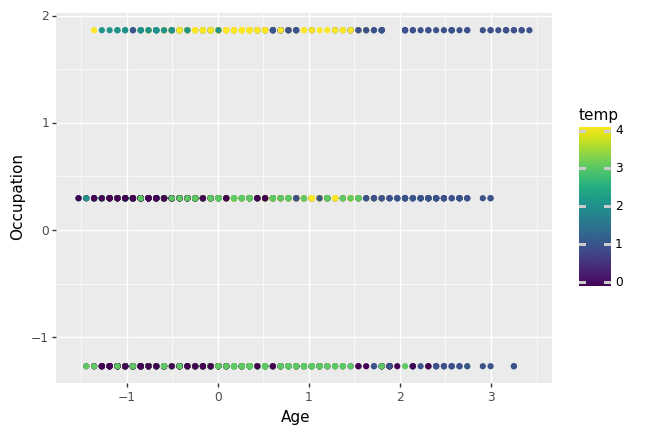

<ggplot: (8766038898273)>
CLuster5


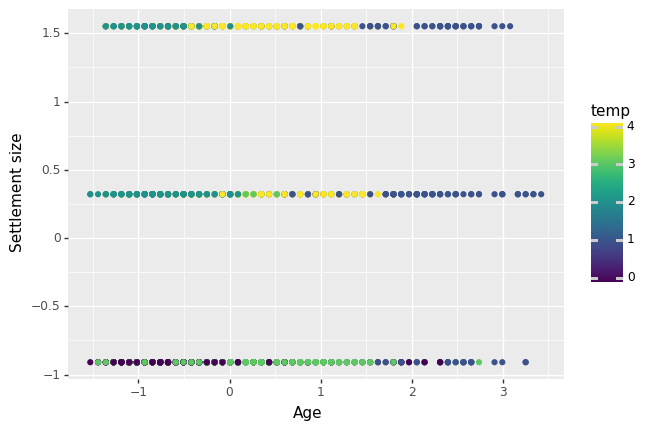

<ggplot: (8766033895801)>
CLuster5


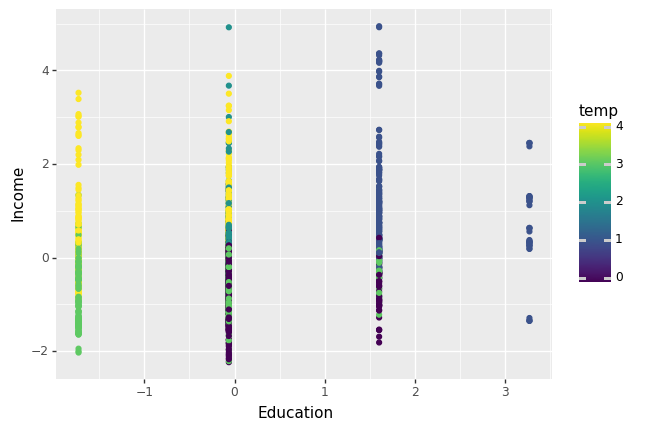

<ggplot: (8766033824565)>
CLuster5


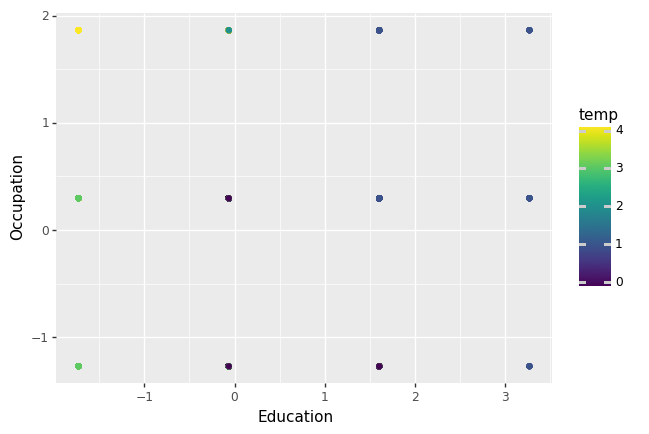

<ggplot: (8766034199489)>
CLuster5


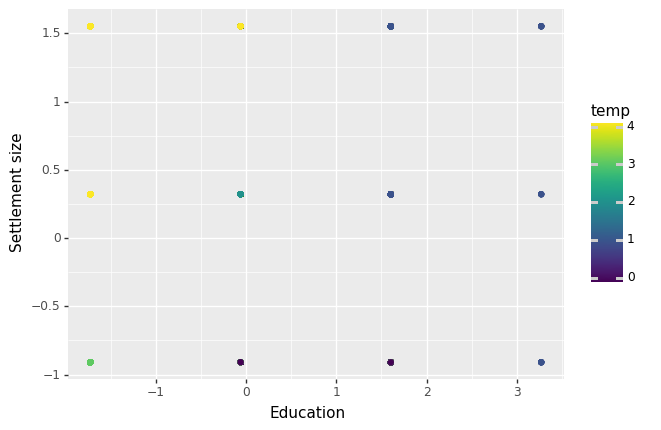

<ggplot: (8766039049733)>
CLuster5


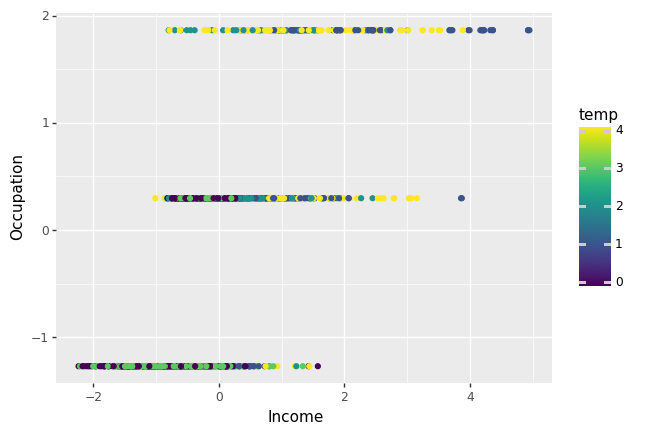

<ggplot: (8766039305885)>
CLuster5


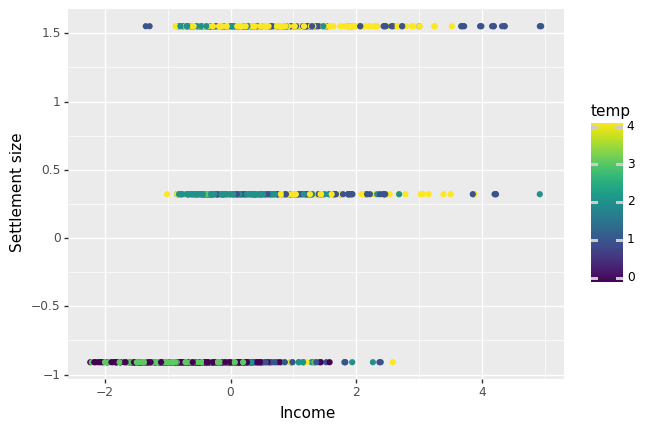

<ggplot: (8766039669905)>
CLuster5


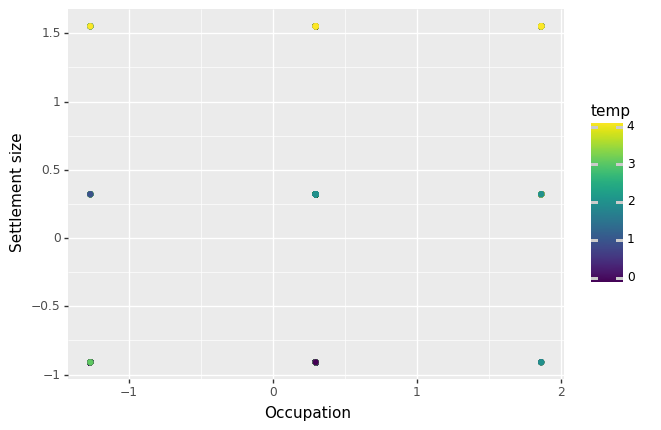

<ggplot: (8766038816053)>
CLuster6


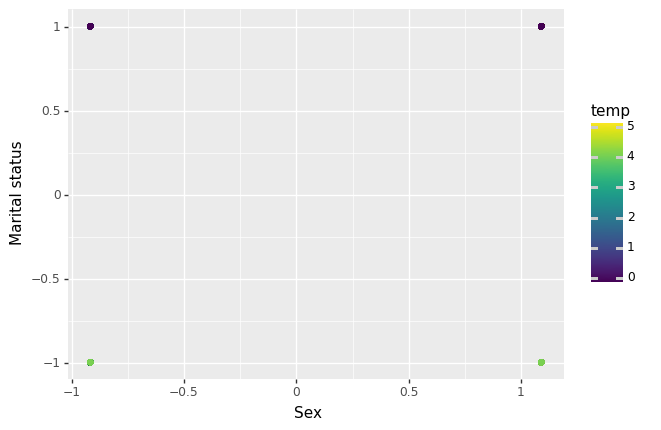

<ggplot: (8766033944317)>
CLuster6


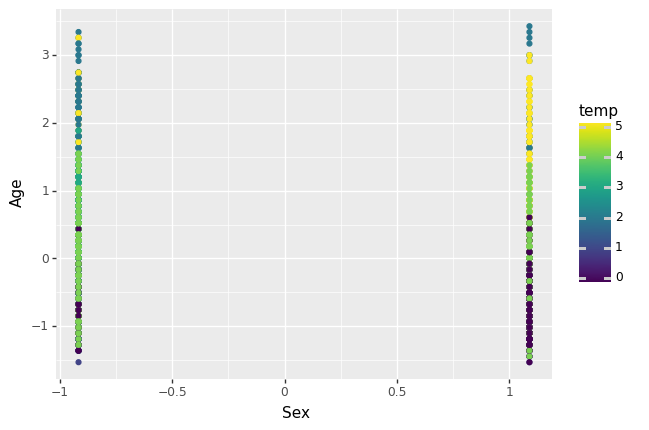

<ggplot: (8766034082421)>
CLuster6


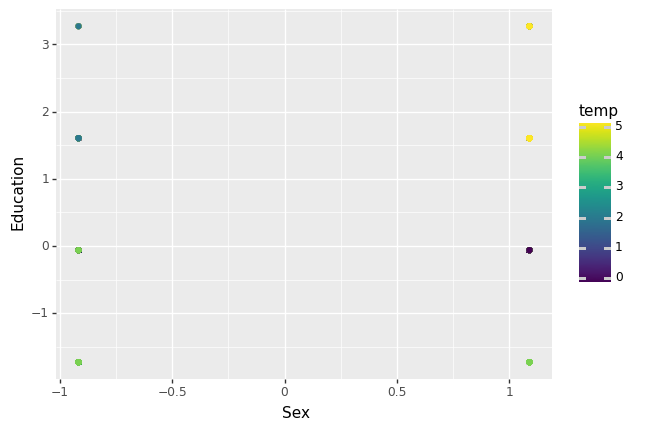

<ggplot: (8766034096321)>
CLuster6


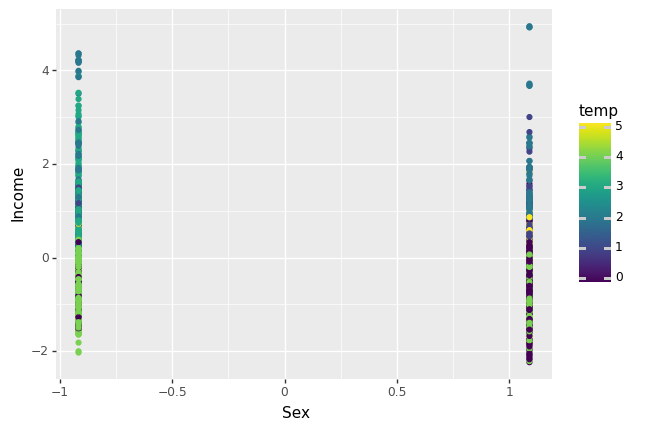

<ggplot: (8766033616945)>
CLuster6


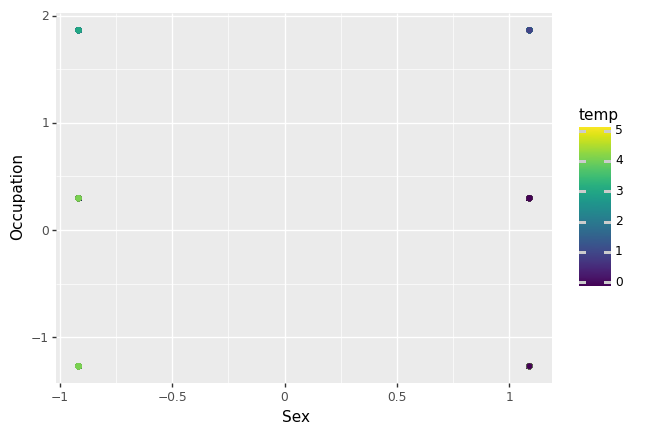

<ggplot: (8766037517029)>
CLuster6


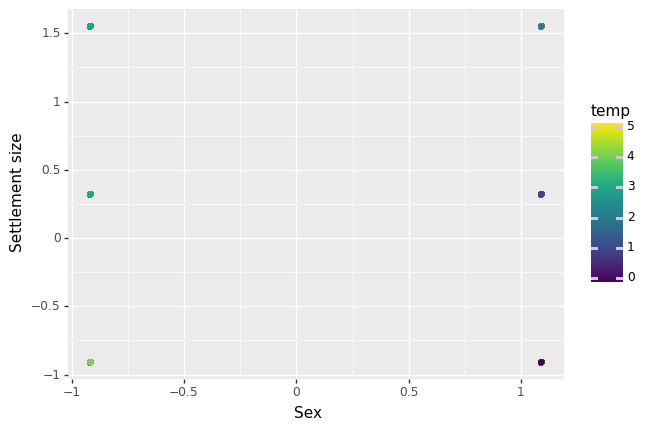

<ggplot: (8766038904561)>
CLuster6


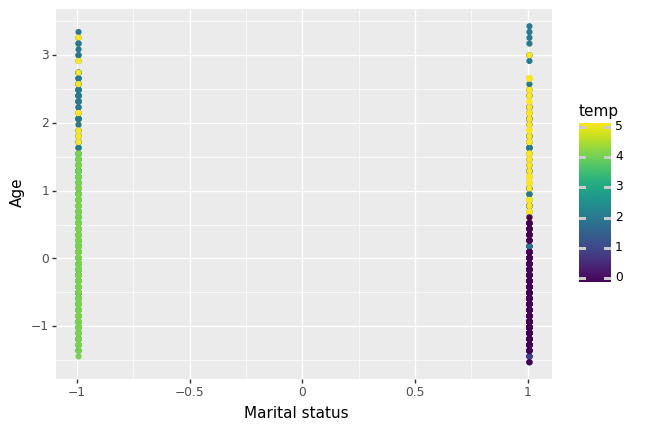

<ggplot: (8766034653861)>
CLuster6


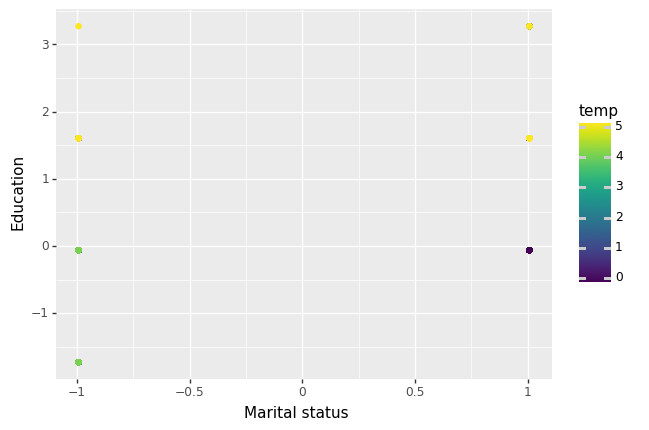

<ggplot: (8766039291781)>
CLuster6


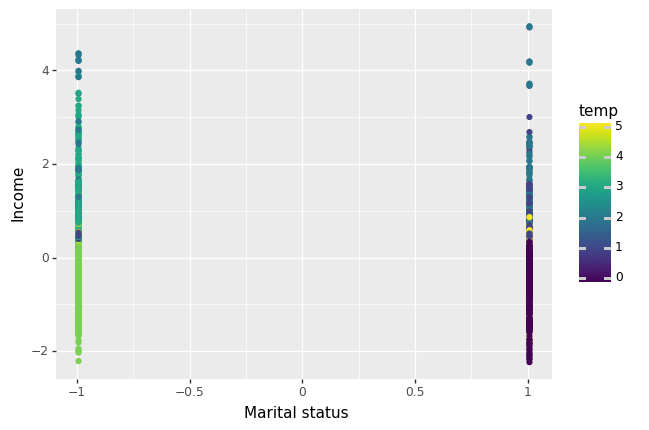

<ggplot: (8766038817285)>
CLuster6


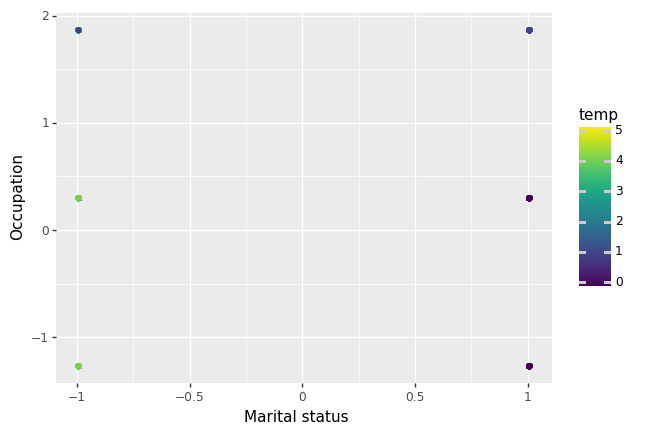

<ggplot: (8766039011349)>
CLuster6


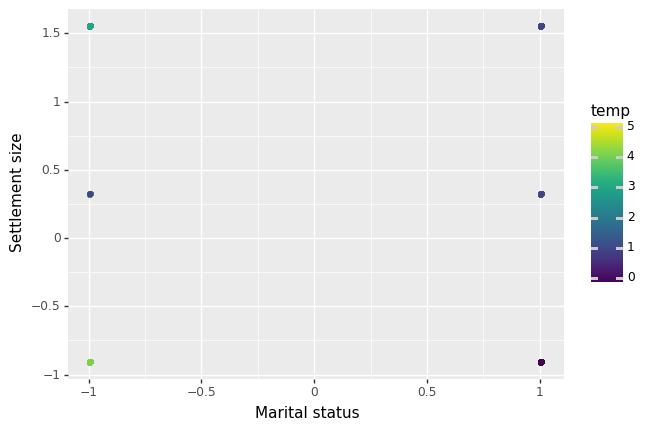

<ggplot: (8766034753133)>
CLuster6


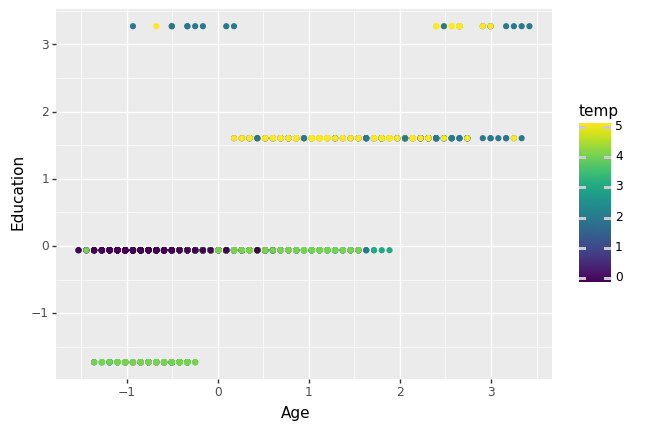

<ggplot: (8766034488897)>
CLuster6


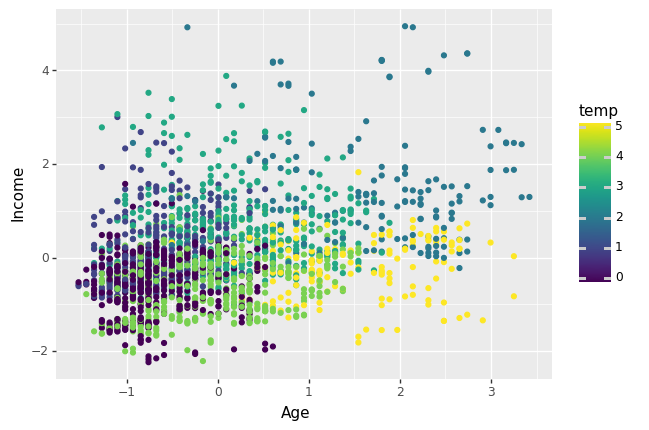

<ggplot: (8766037577009)>
CLuster6


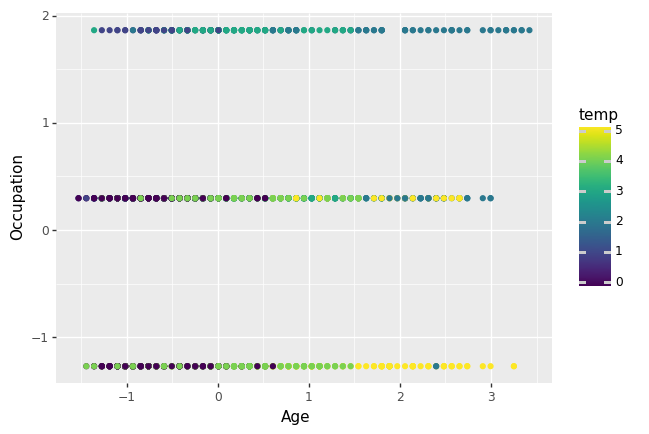

<ggplot: (8766034075737)>
CLuster6


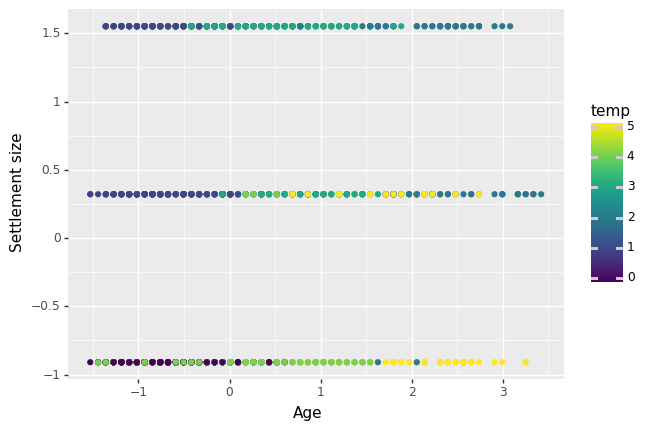

<ggplot: (8766039127637)>
CLuster6


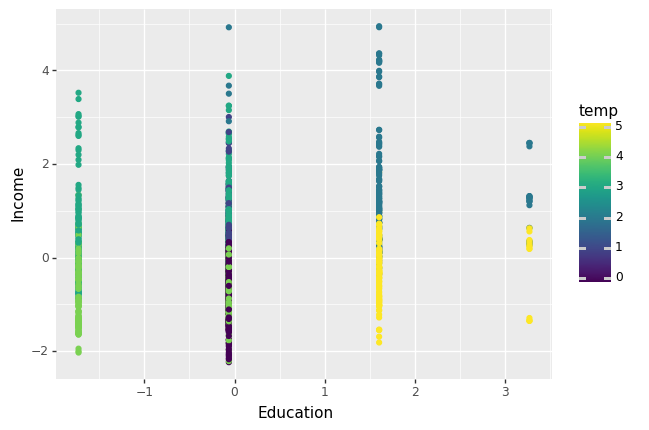

<ggplot: (8766033859545)>
CLuster6


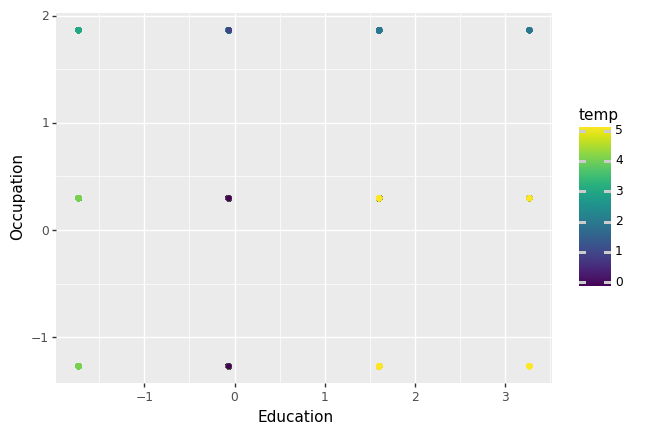

<ggplot: (8766039186505)>
CLuster6


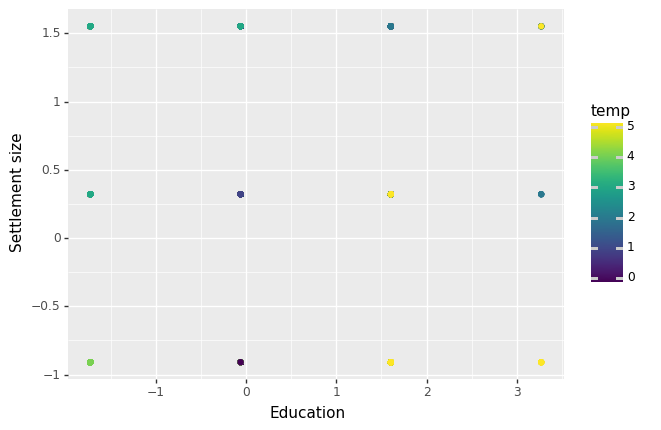

<ggplot: (8766037560393)>
CLuster6


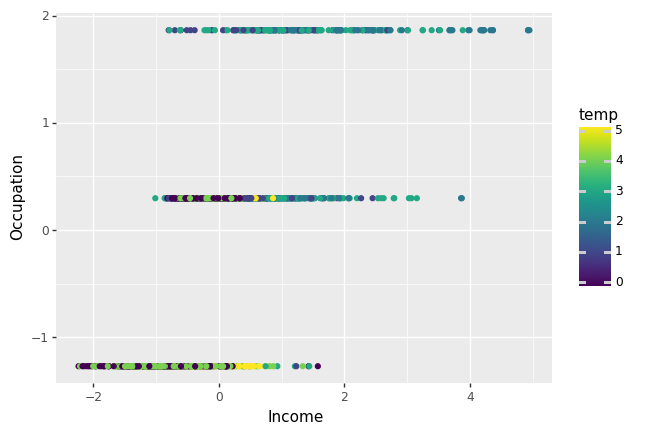

<ggplot: (8766034487709)>
CLuster6


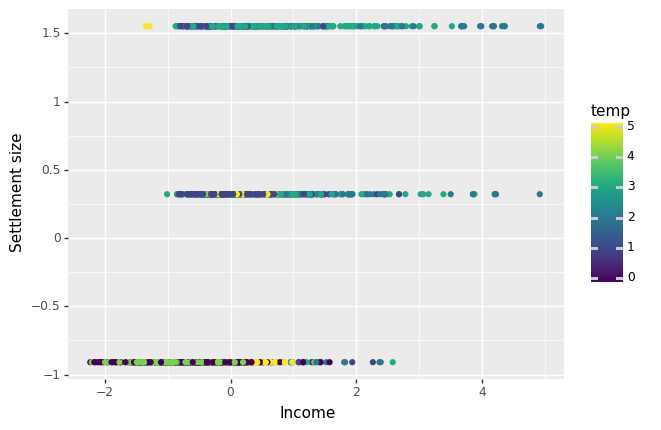

<ggplot: (8766034384269)>
CLuster6


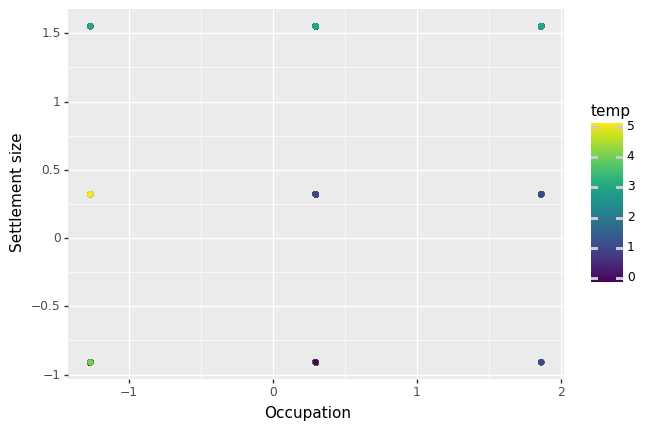

<ggplot: (8766034354485)>
CLuster7


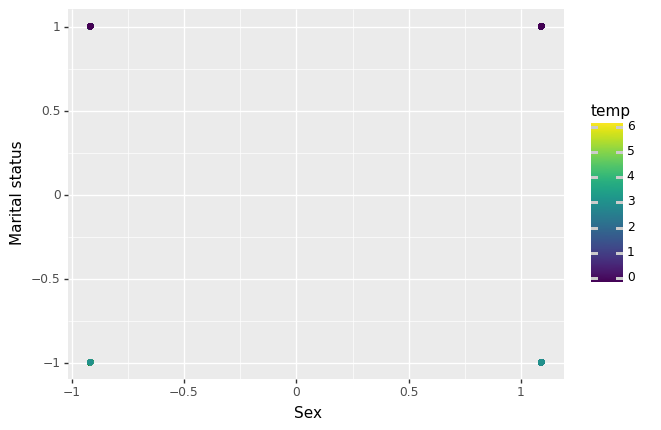

<ggplot: (8766034200037)>
CLuster7


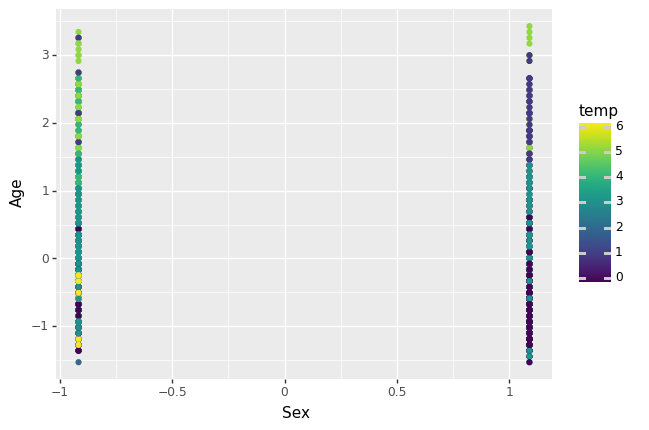

<ggplot: (8766034384269)>
CLuster7


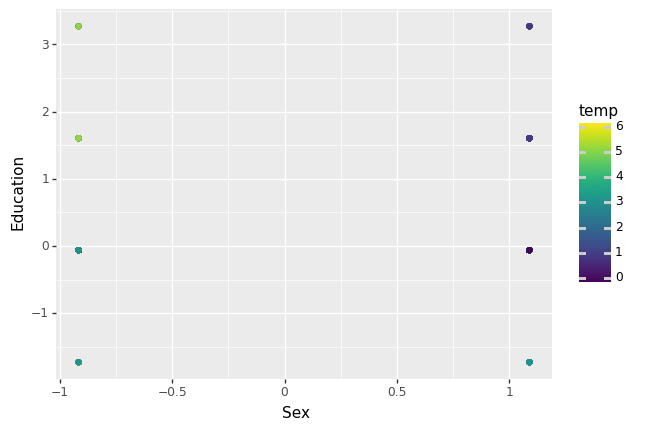

<ggplot: (8766034199905)>
CLuster7


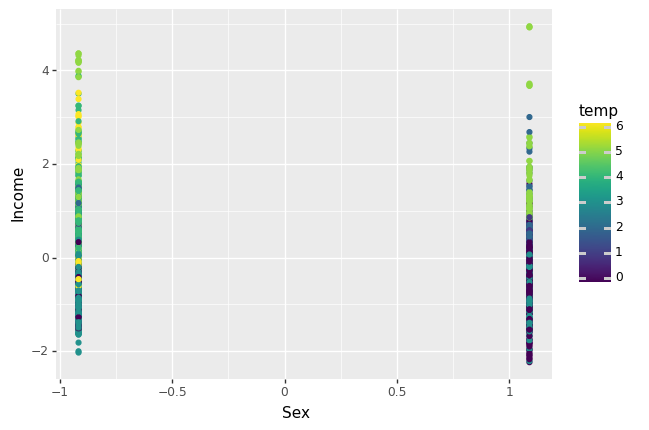

<ggplot: (8766033810821)>
CLuster7


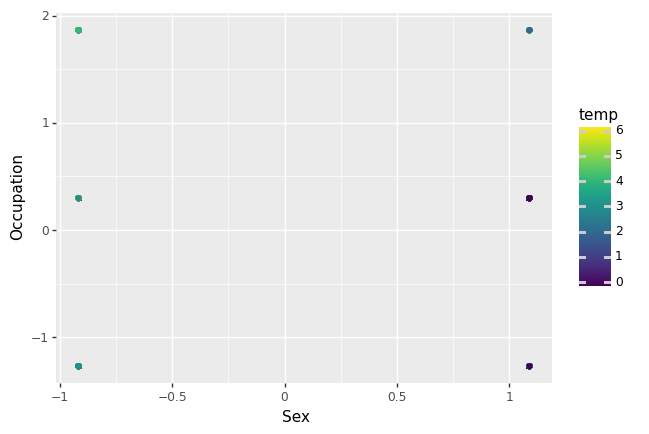

<ggplot: (8766039227341)>
CLuster7


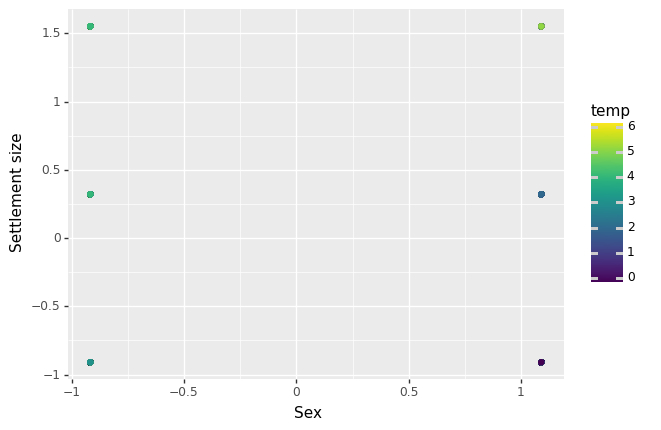

<ggplot: (8766034463393)>
CLuster7


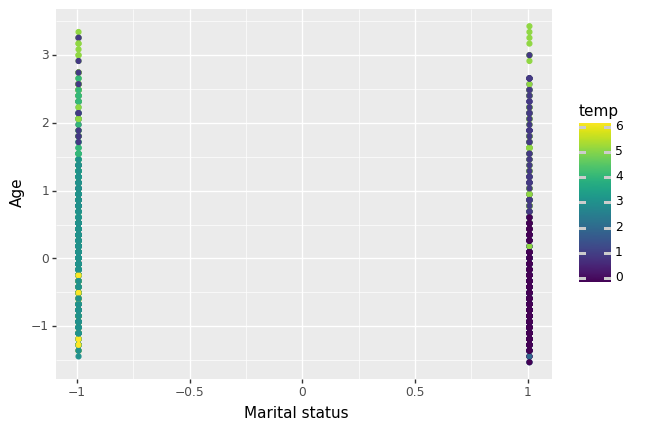

<ggplot: (8766039138453)>
CLuster7


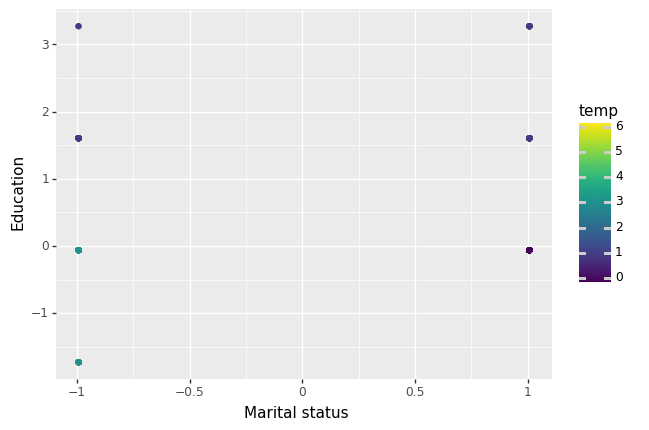

<ggplot: (8766037640305)>
CLuster7


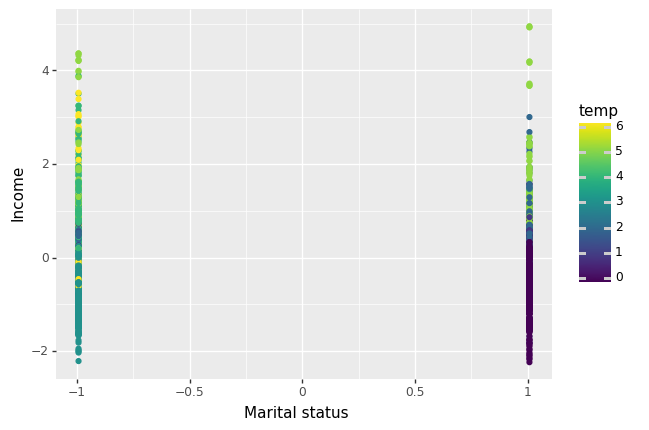

<ggplot: (8766033829733)>
CLuster7


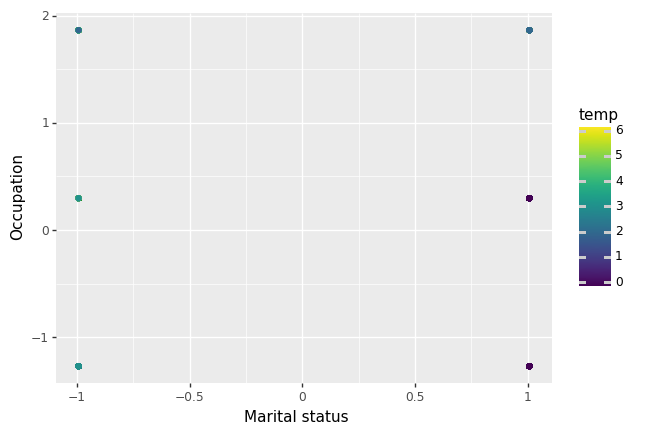

<ggplot: (8766039803389)>
CLuster7


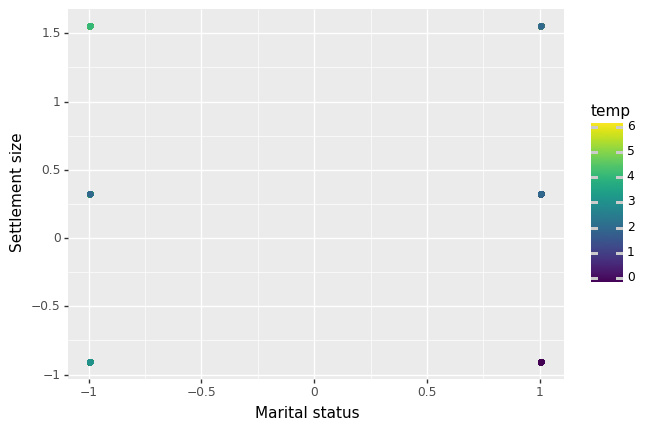

<ggplot: (8766037464557)>
CLuster7


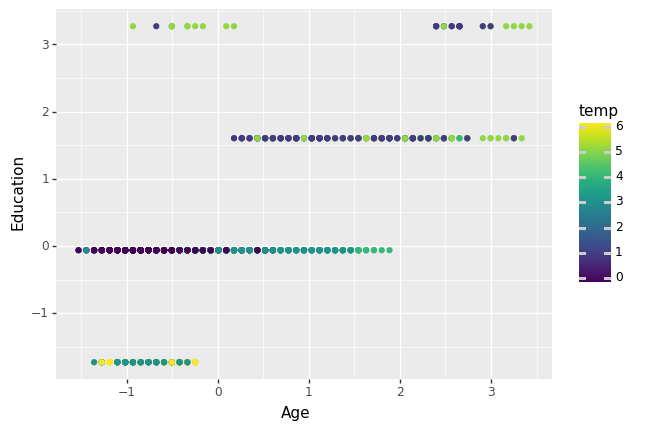

<ggplot: (8766034044037)>
CLuster7


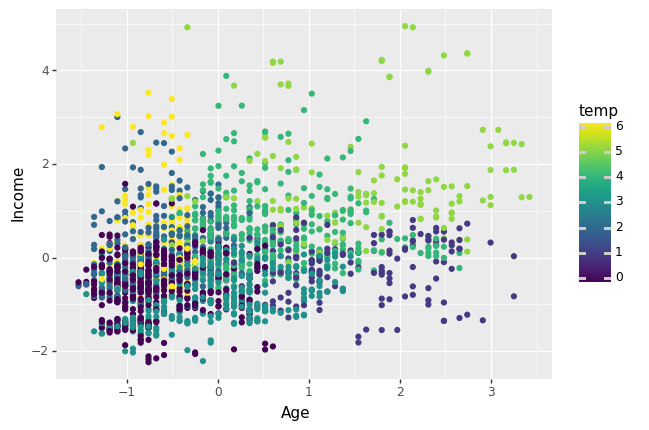

<ggplot: (8766039718245)>
CLuster7


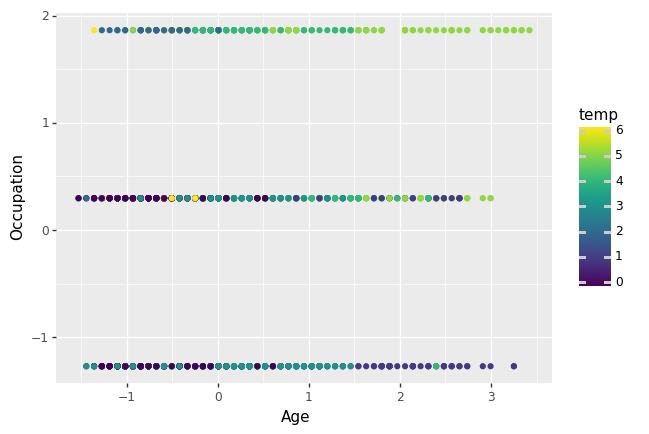

<ggplot: (8766033834853)>
CLuster7


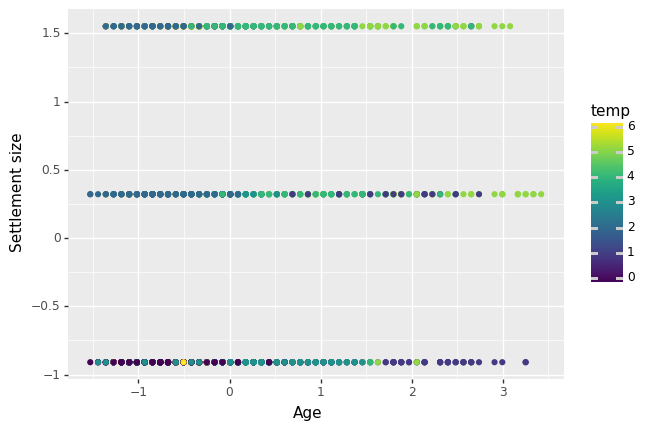

<ggplot: (8766037454209)>
CLuster7


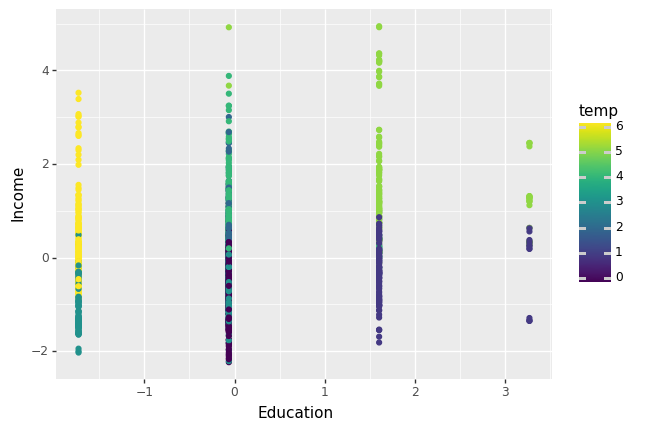

<ggplot: (8766034048317)>
CLuster7


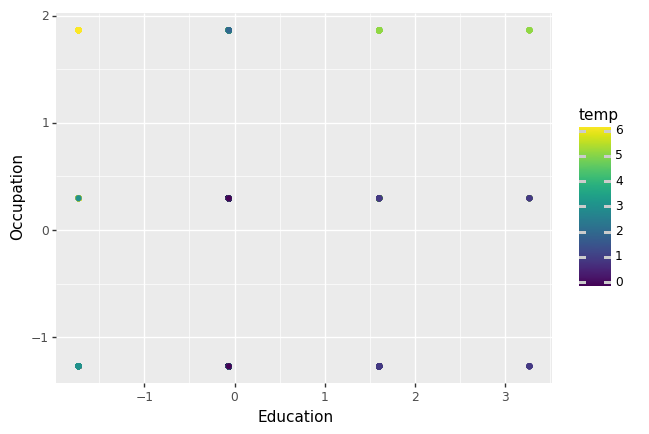

<ggplot: (8766033626465)>
CLuster7


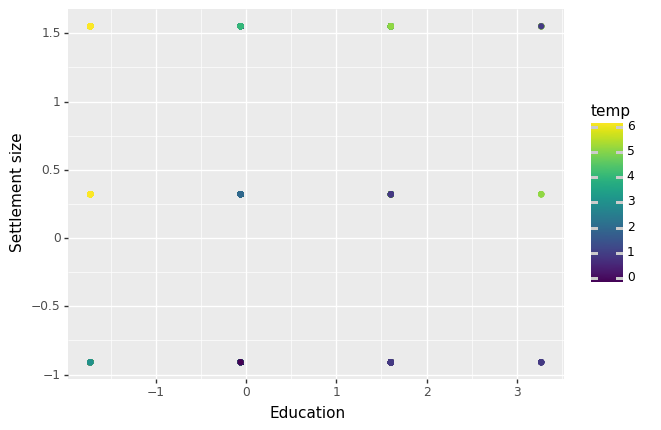

<ggplot: (8766034699017)>
CLuster7


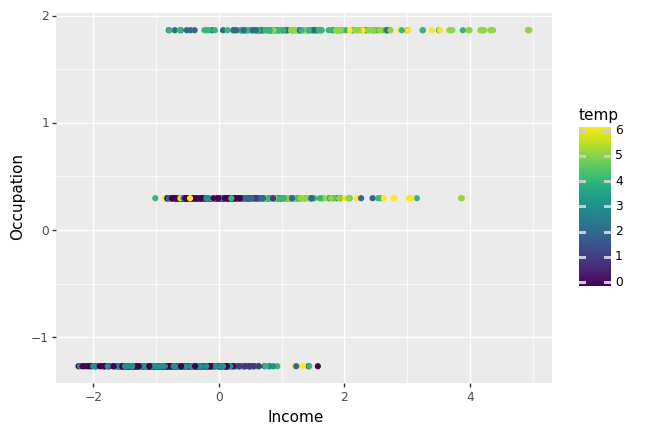

<ggplot: (8766033626465)>
CLuster7


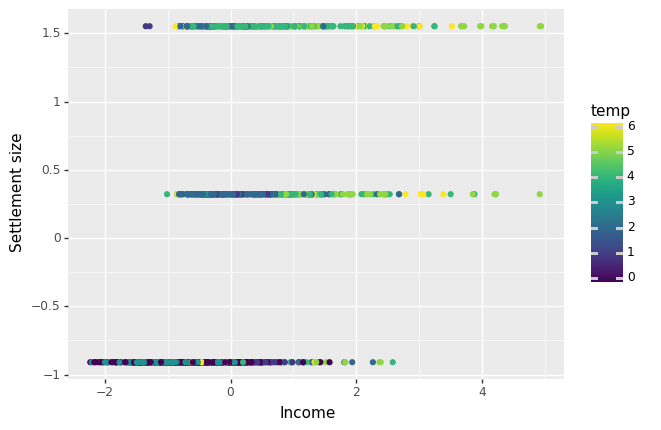

<ggplot: (8766038845757)>
CLuster7


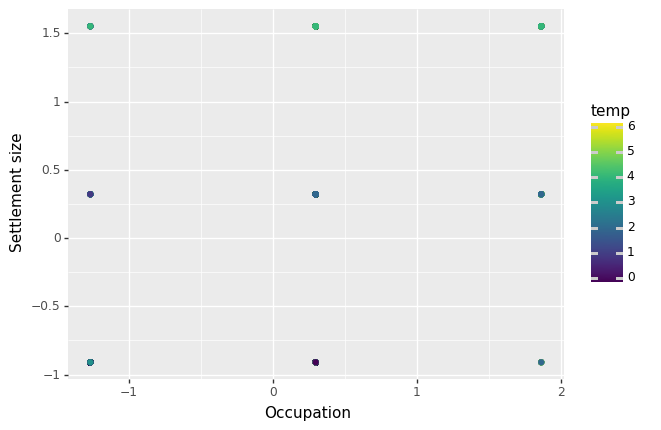

<ggplot: (8766034030385)>
CLuster8


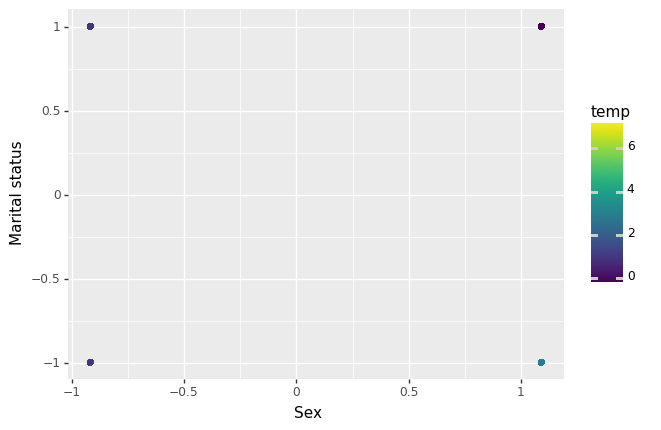

<ggplot: (8766038902297)>
CLuster8


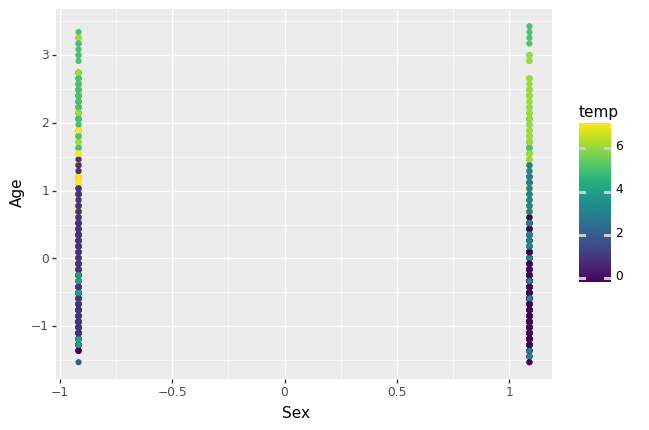

<ggplot: (8766037735997)>
CLuster8


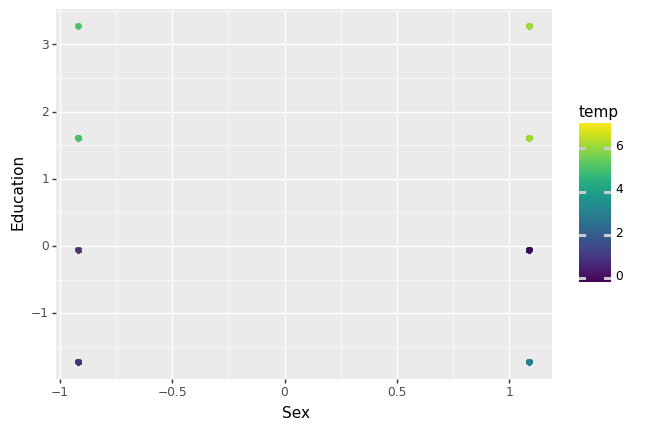

<ggplot: (8766038800089)>
CLuster8


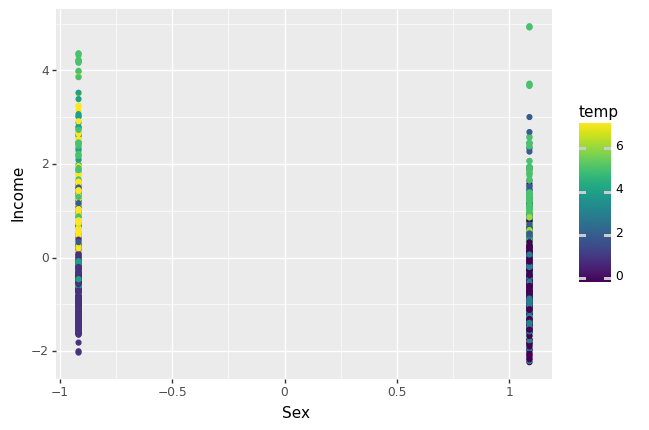

<ggplot: (8766033956653)>
CLuster8


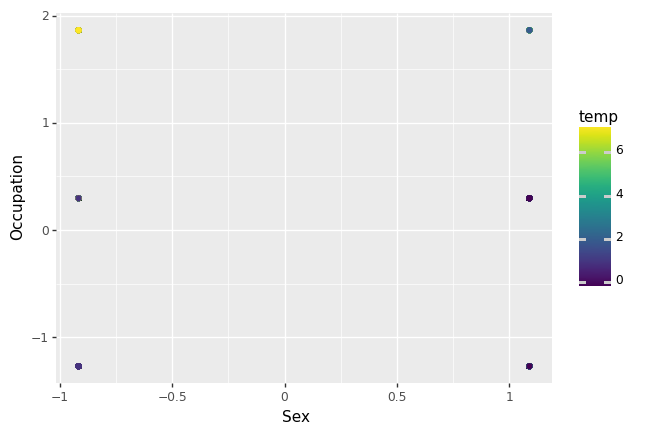

<ggplot: (8766039147321)>
CLuster8


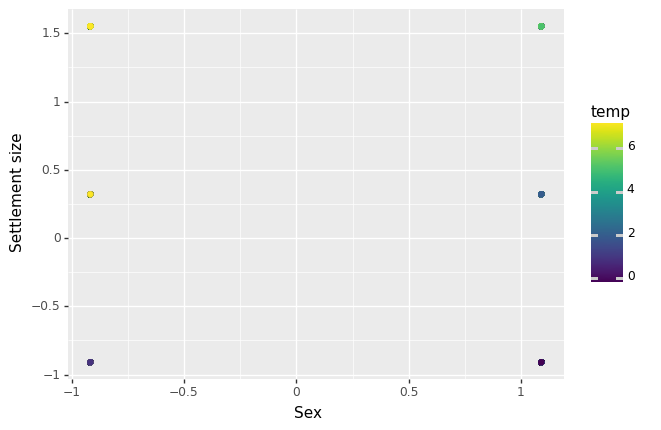

<ggplot: (8766034149297)>
CLuster8


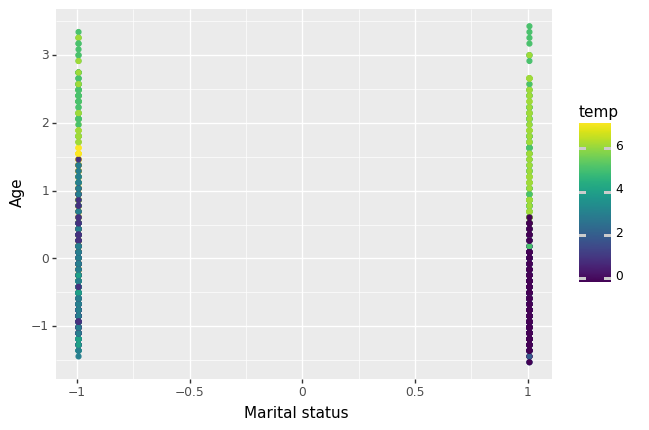

<ggplot: (8766038934261)>
CLuster8


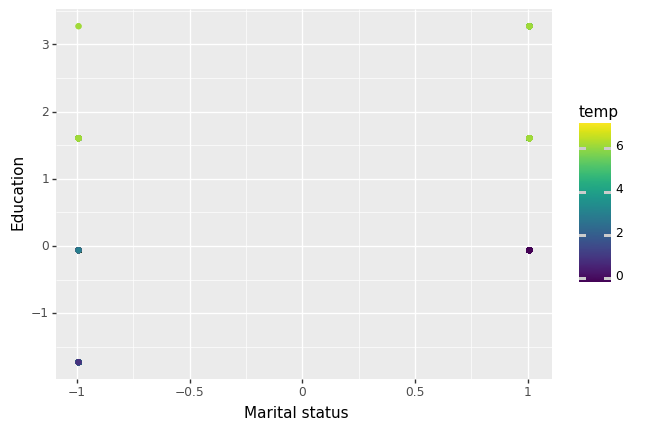

<ggplot: (8766034450525)>
CLuster8


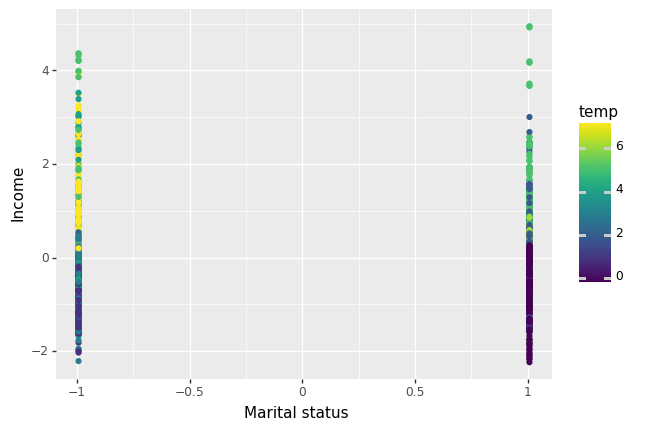

<ggplot: (8766039179745)>
CLuster8


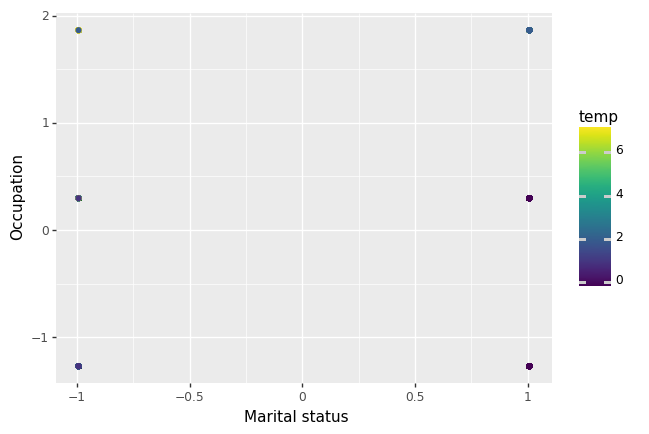

<ggplot: (8766038845889)>
CLuster8


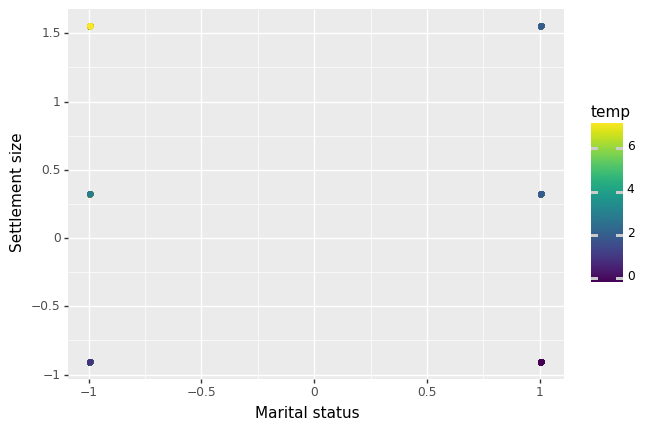

<ggplot: (8766034729557)>
CLuster8


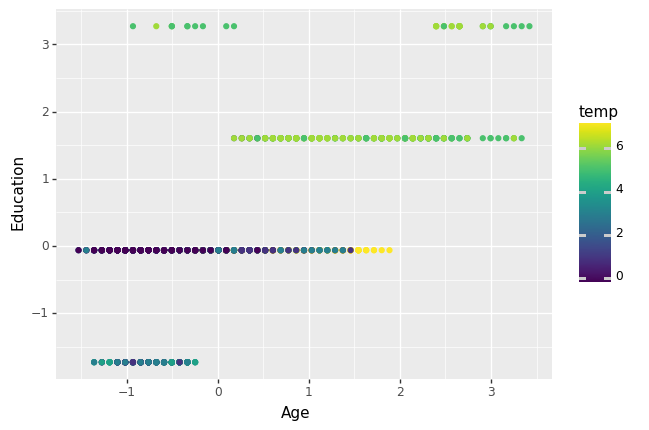

<ggplot: (8766034398093)>
CLuster8


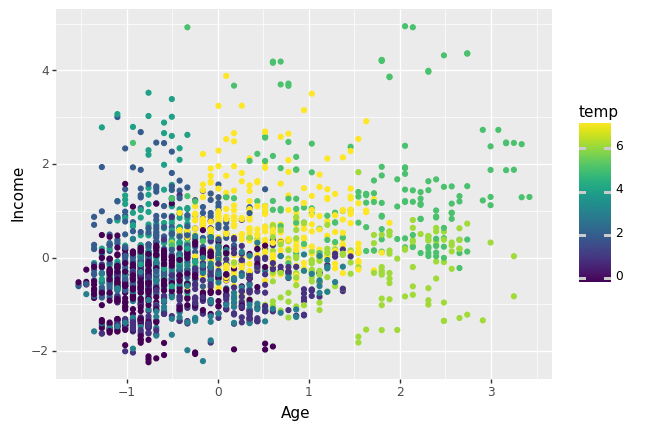

<ggplot: (8766037462937)>
CLuster8


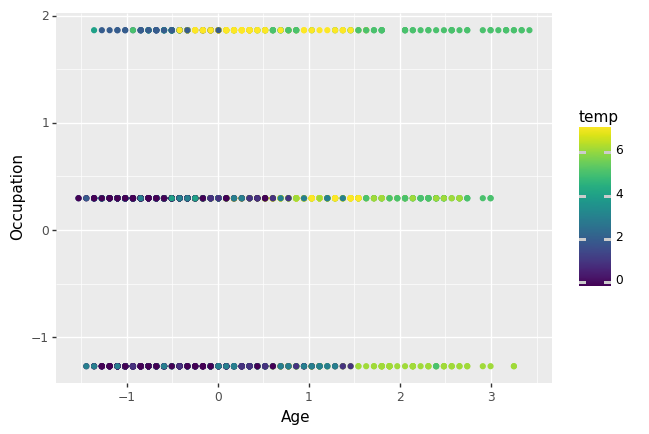

<ggplot: (8766037532829)>
CLuster8


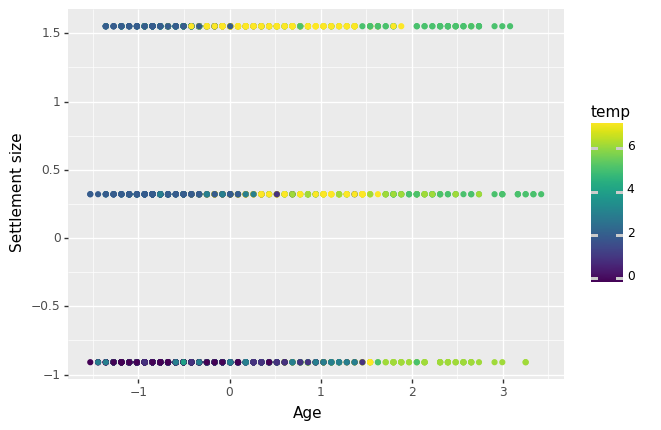

<ggplot: (8766038840781)>
CLuster8


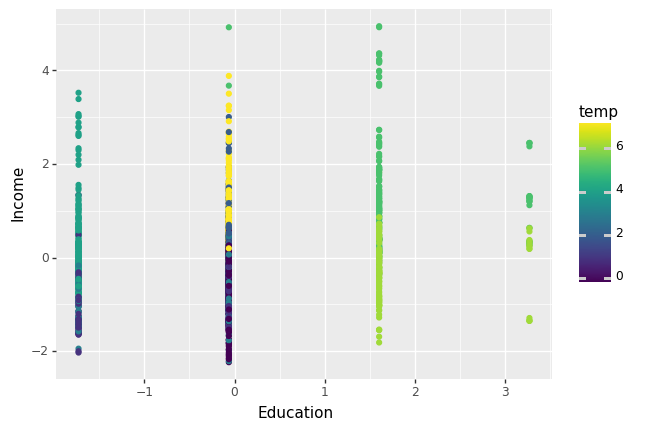

<ggplot: (8766039075533)>
CLuster8


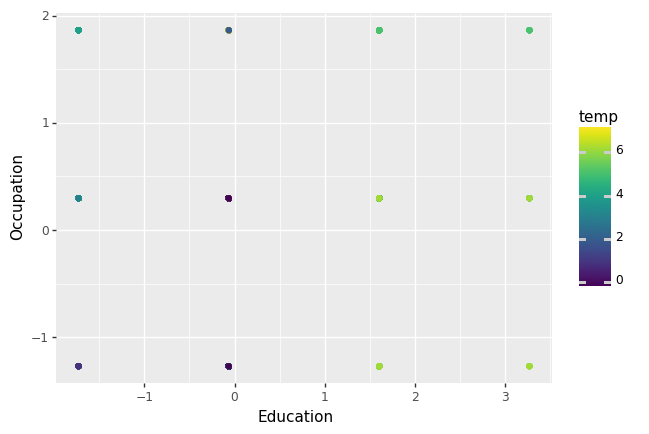

<ggplot: (8766039186133)>
CLuster8


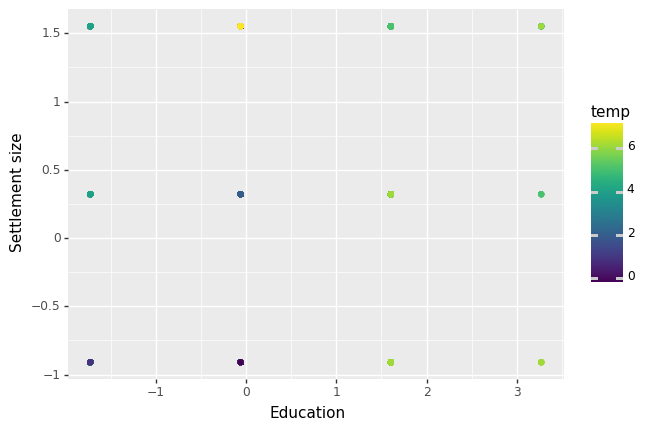

<ggplot: (8766037627689)>
CLuster8


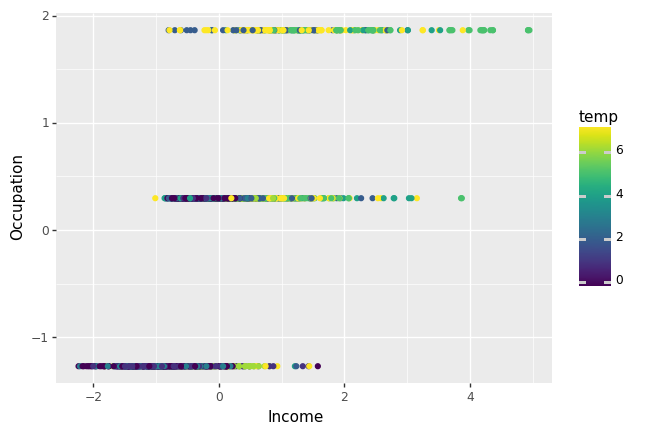

<ggplot: (8766038795581)>
CLuster8


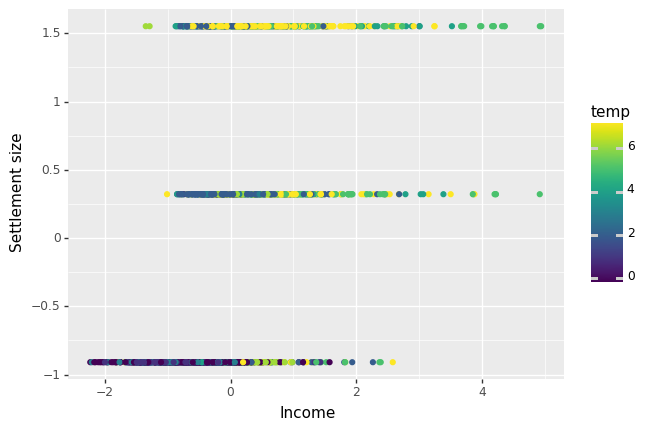

<ggplot: (8766033566081)>
CLuster8


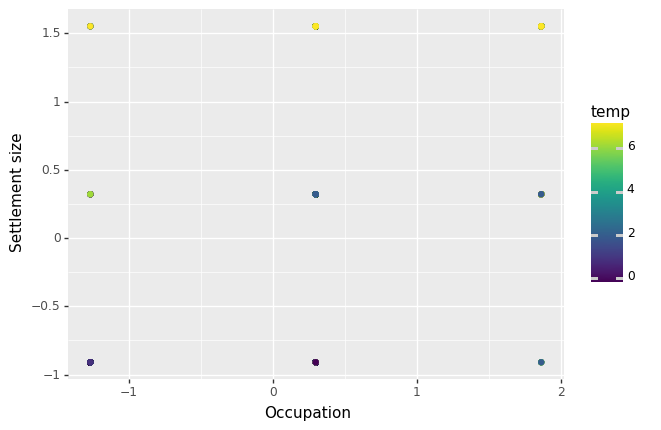

<ggplot: (8766034398593)>
CLuster9


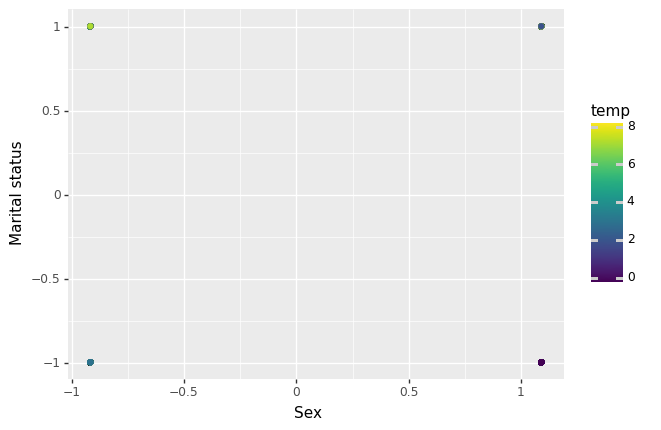

<ggplot: (8766034357329)>
CLuster9


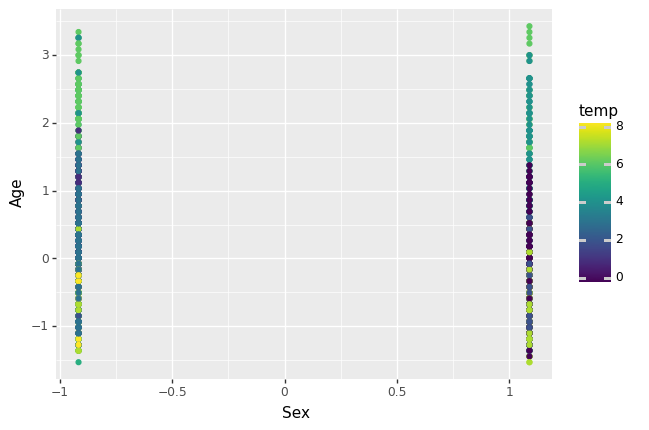

<ggplot: (8766038988209)>
CLuster9


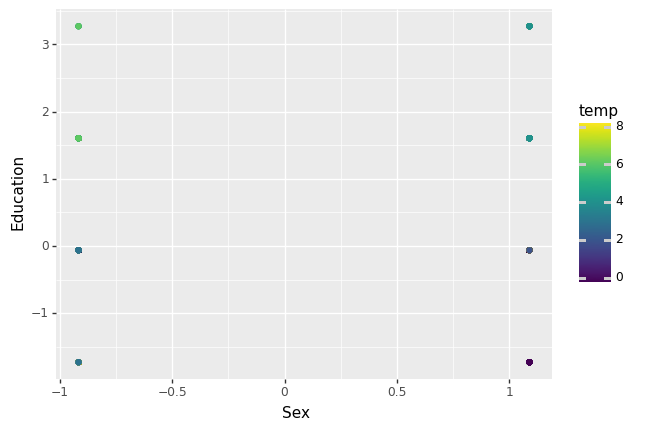

<ggplot: (8766033811525)>
CLuster9


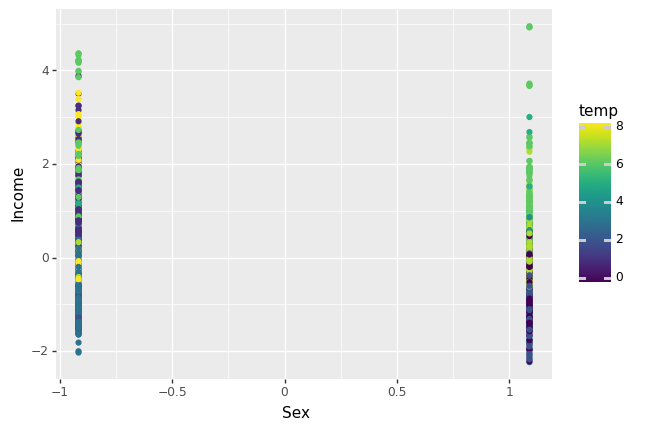

<ggplot: (8766037477673)>
CLuster9


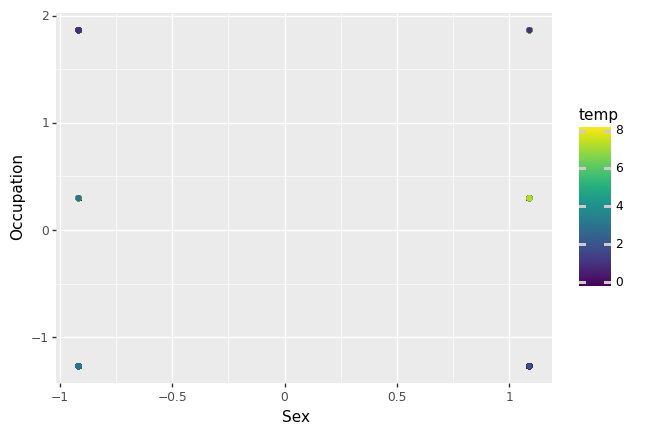

<ggplot: (8766034392445)>
CLuster9


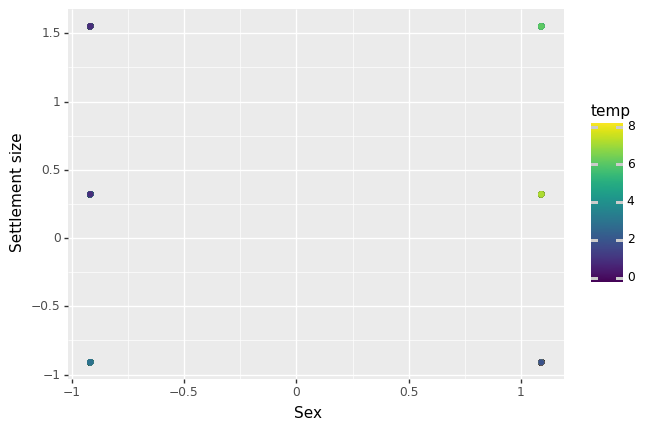

<ggplot: (8766033628881)>
CLuster9


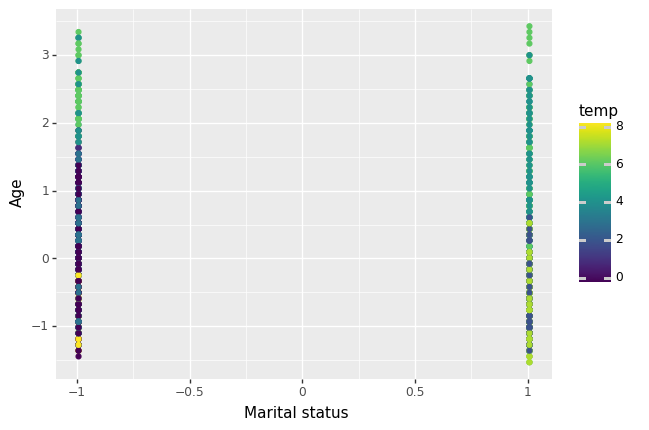

<ggplot: (8766039179745)>
CLuster9


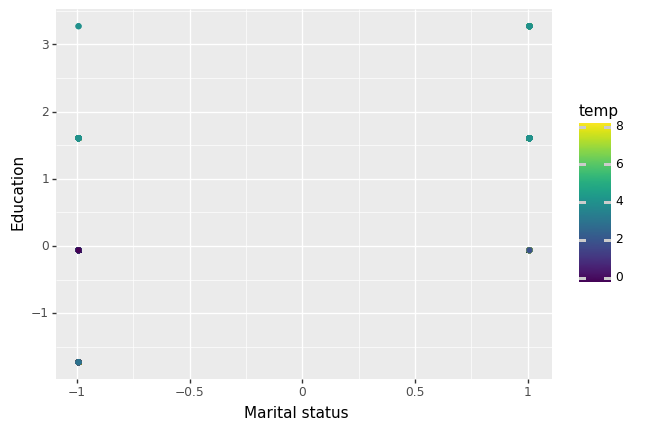

<ggplot: (8766081682301)>
CLuster9


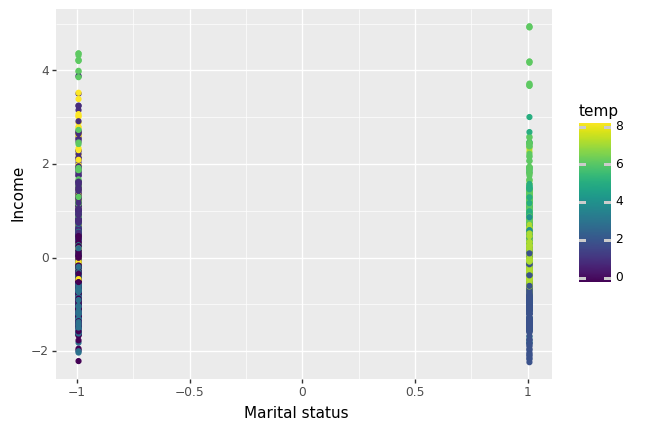

<ggplot: (8766037607125)>
CLuster9


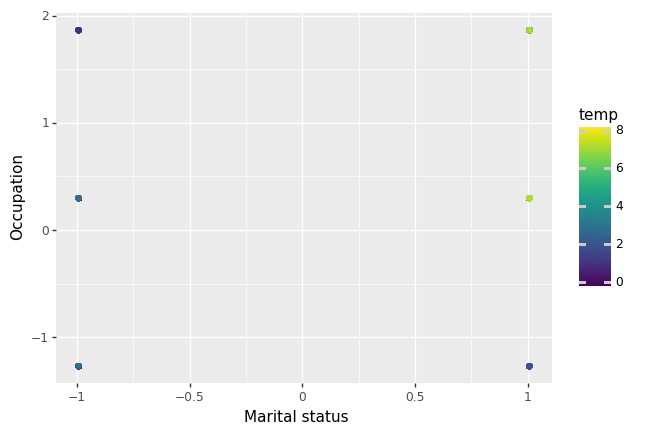

<ggplot: (8766039109309)>
CLuster9


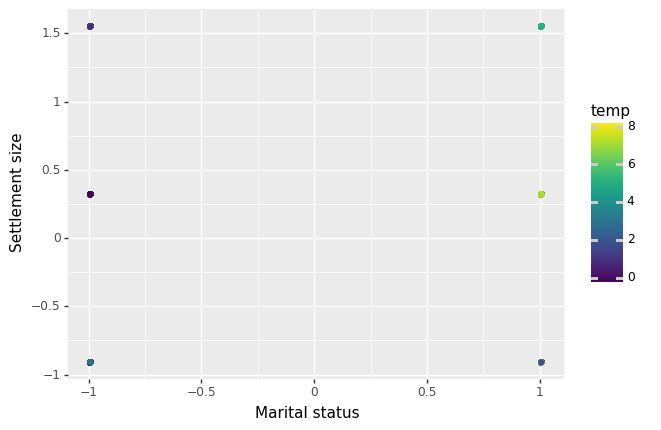

<ggplot: (8766037506017)>
CLuster9


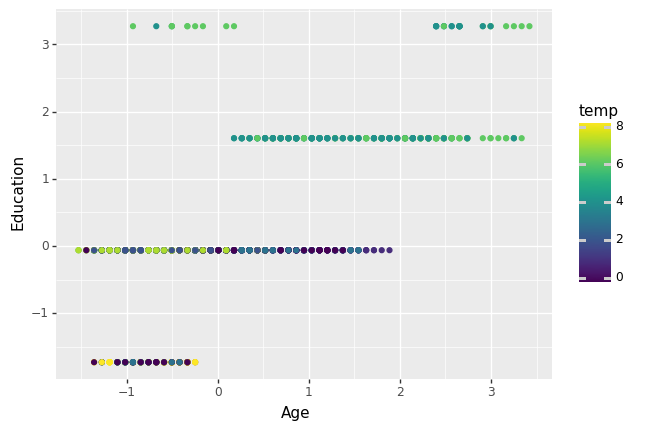

<ggplot: (8766037512897)>
CLuster9


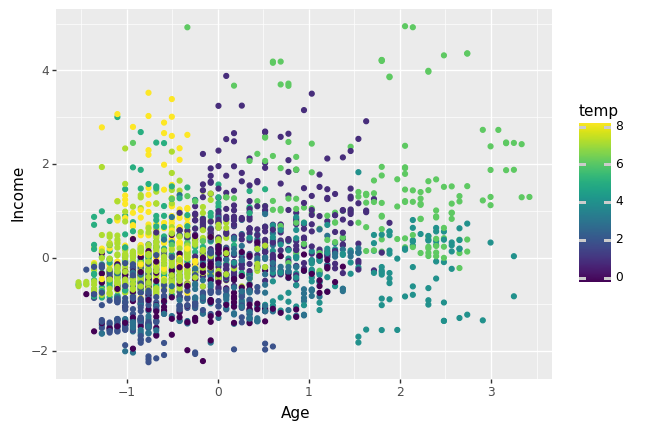

<ggplot: (8766039073889)>
CLuster9


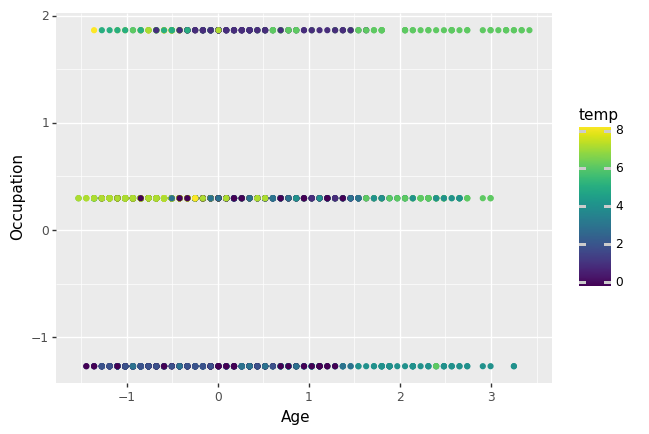

<ggplot: (8766039112413)>
CLuster9


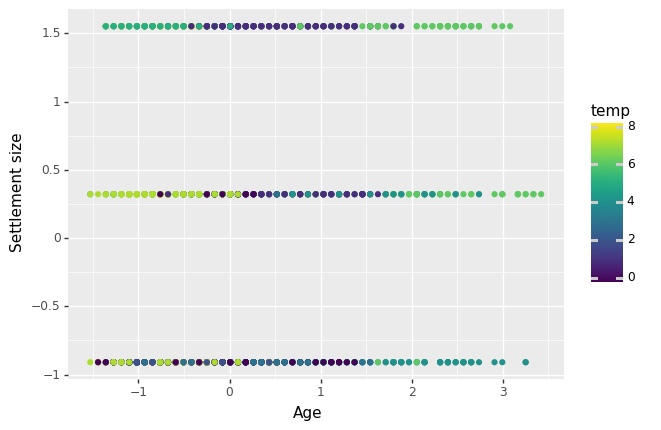

<ggplot: (8766034496033)>
CLuster9


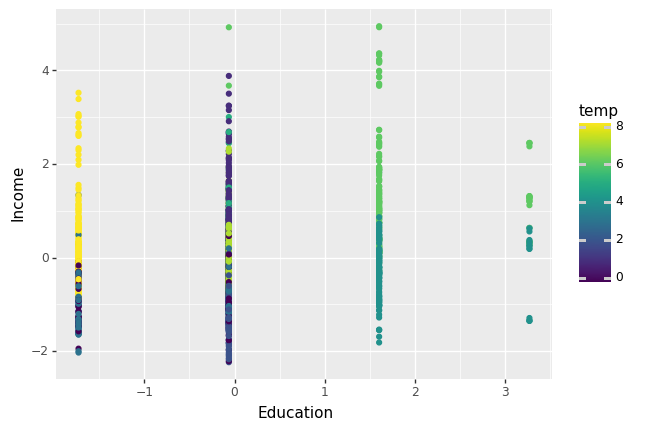

<ggplot: (8766039078597)>
CLuster9


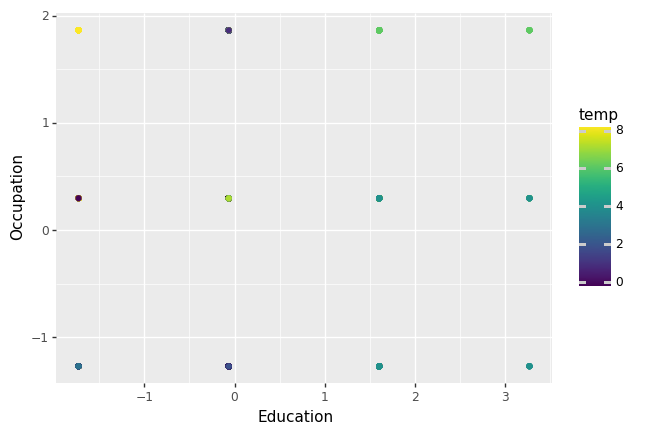

<ggplot: (8766033915869)>
CLuster9


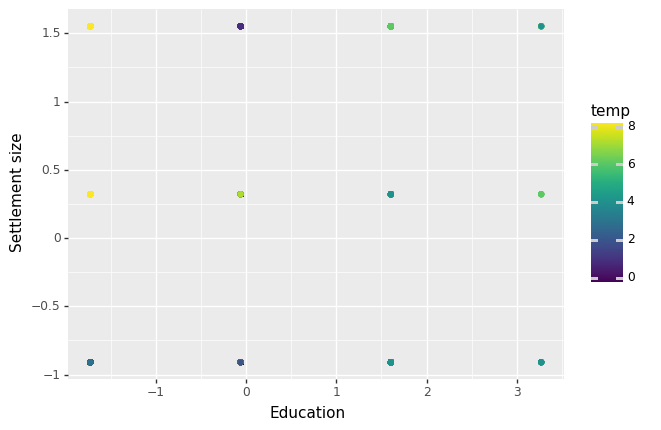

<ggplot: (8766034785433)>
CLuster9


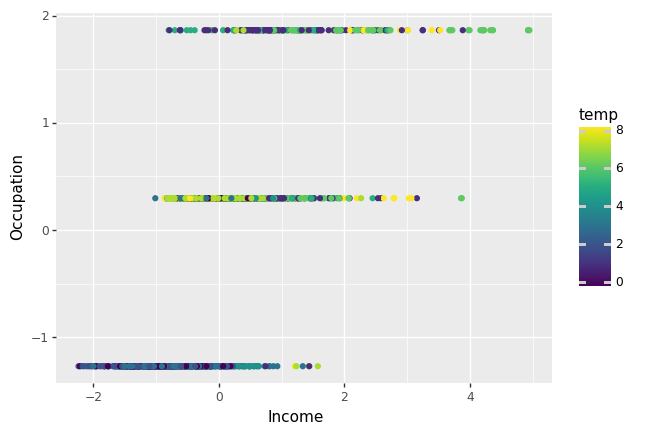

<ggplot: (8766034193361)>
CLuster9


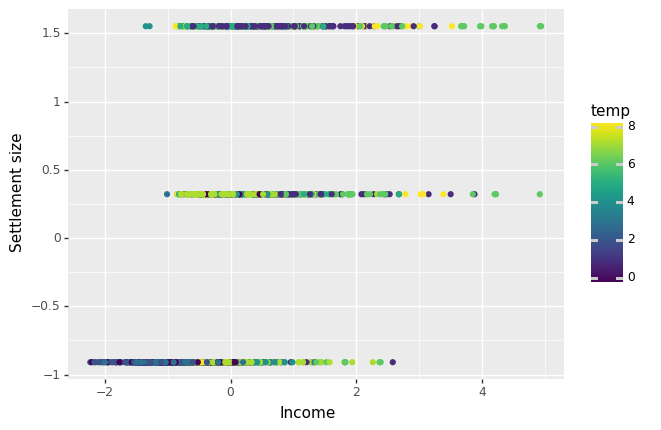

<ggplot: (8766034491813)>
CLuster9


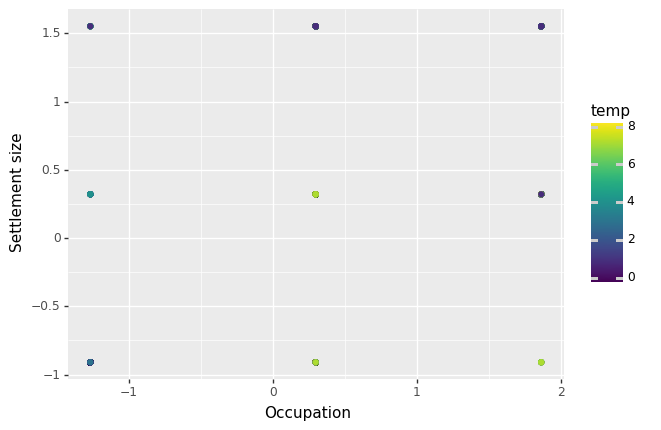

<ggplot: (8766034755173)>
CLuster10


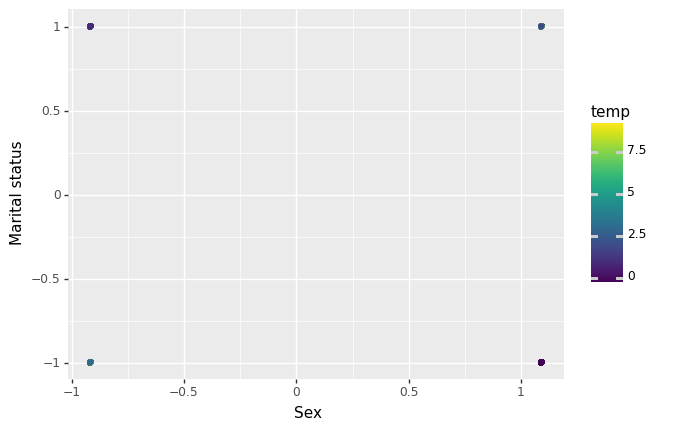

<ggplot: (8766034299233)>
CLuster10


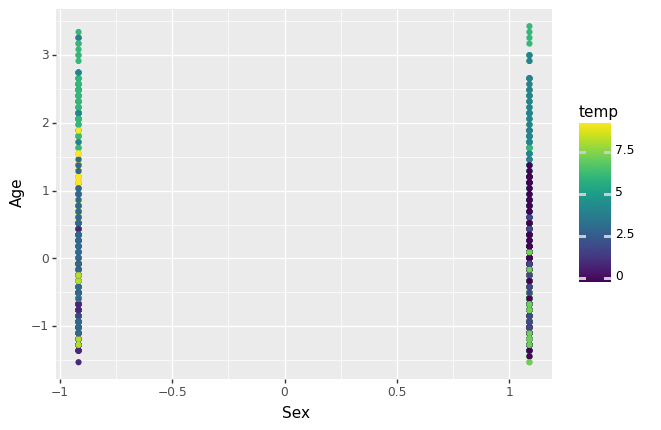

<ggplot: (8766038964021)>
CLuster10


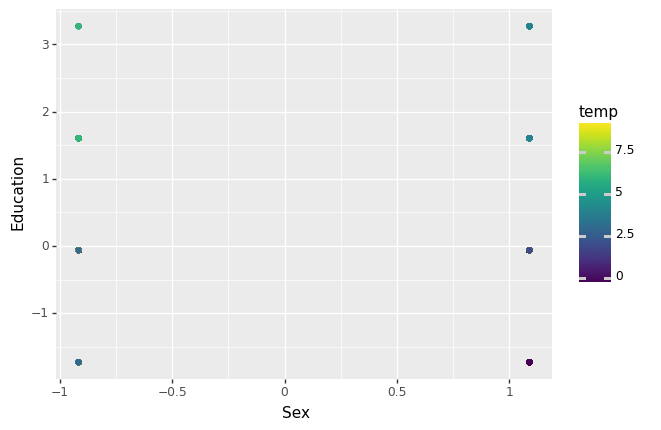

<ggplot: (8766039110897)>
CLuster10


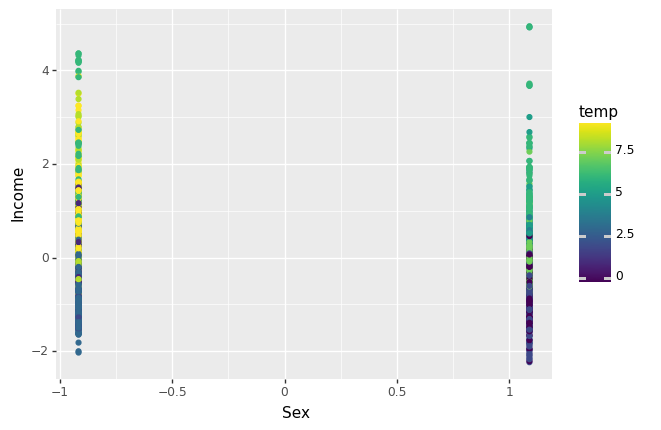

<ggplot: (8766034392361)>
CLuster10


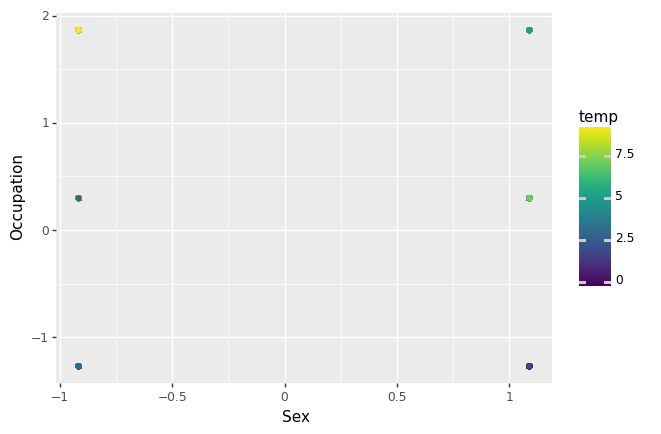

<ggplot: (8766038856413)>
CLuster10


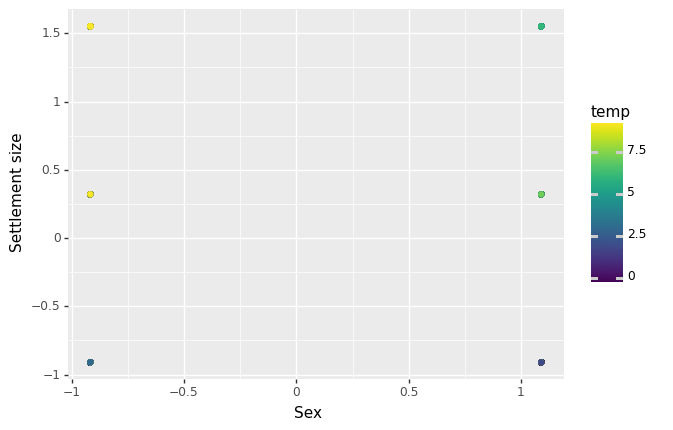

<ggplot: (8766034656033)>
CLuster10


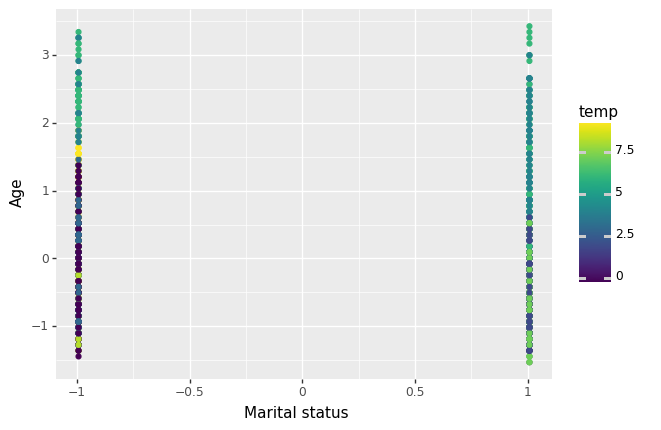

<ggplot: (8766037675881)>
CLuster10


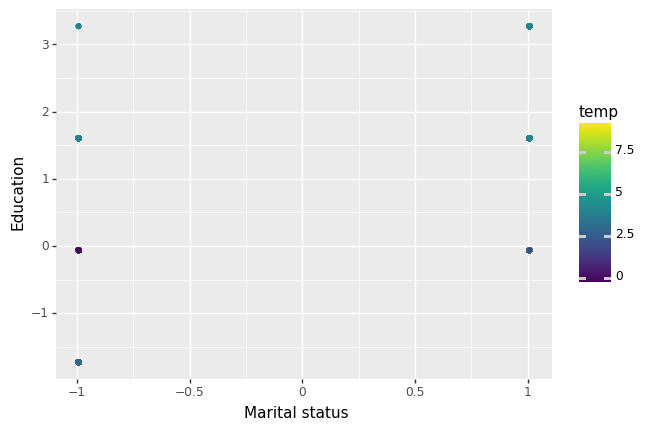

<ggplot: (8766038795581)>
CLuster10


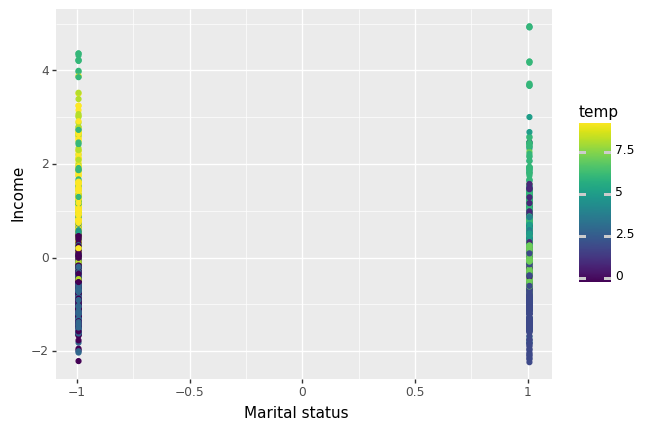

<ggplot: (8766033984453)>
CLuster10


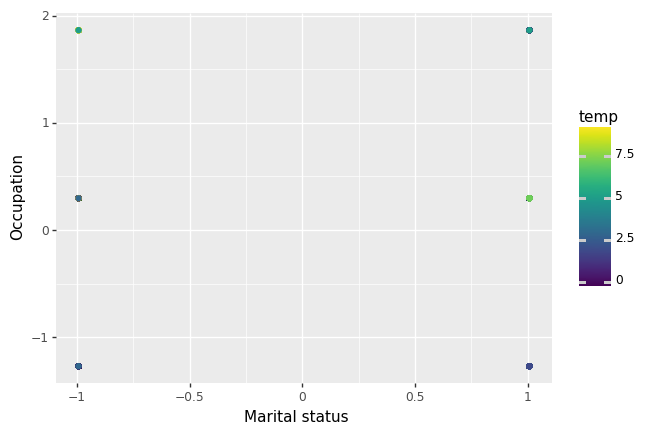

<ggplot: (8766038793885)>
CLuster10


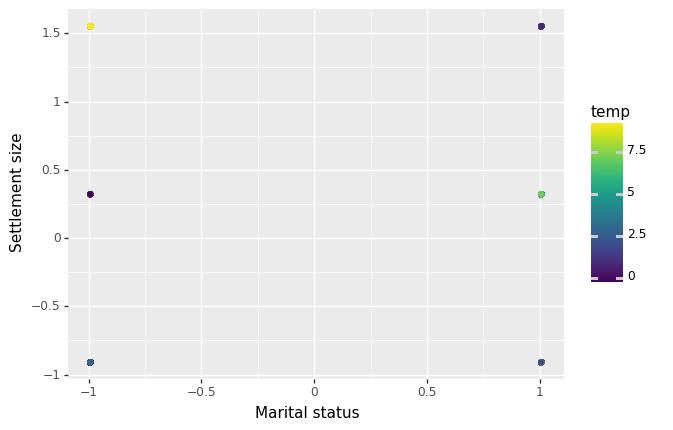

<ggplot: (8766034290201)>
CLuster10


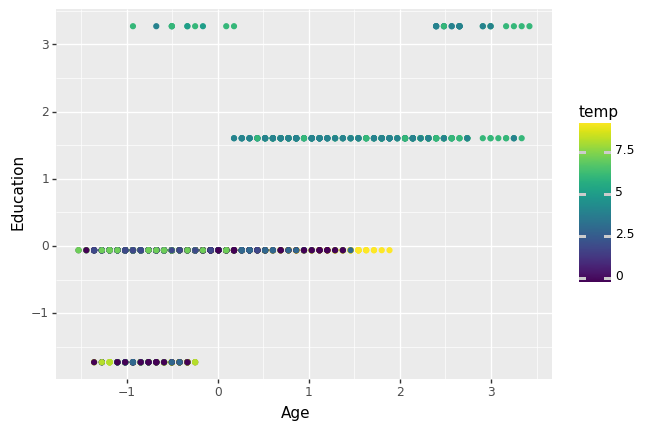

<ggplot: (8766038856413)>
CLuster10


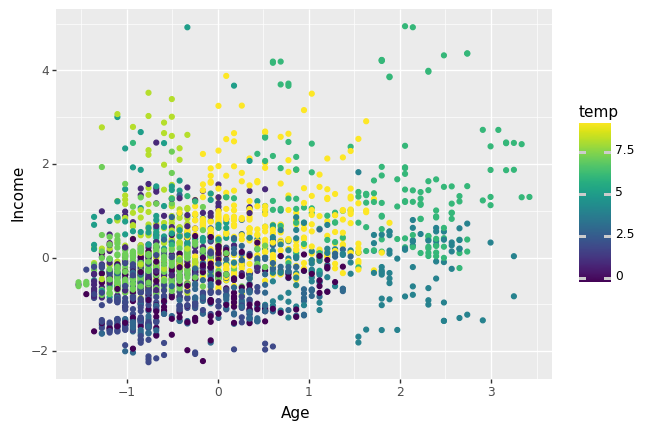

<ggplot: (8766034477833)>
CLuster10


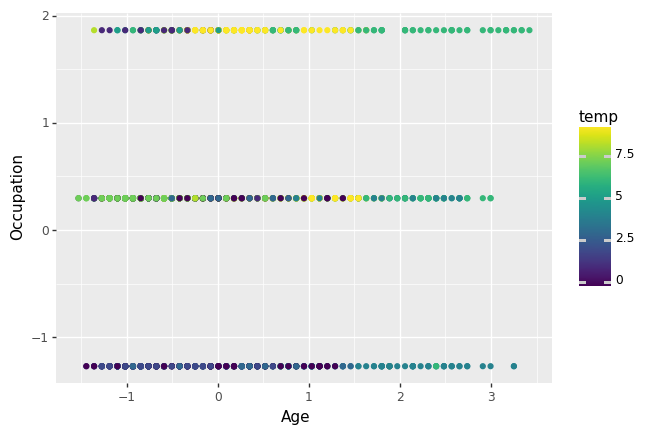

<ggplot: (8766033346061)>
CLuster10


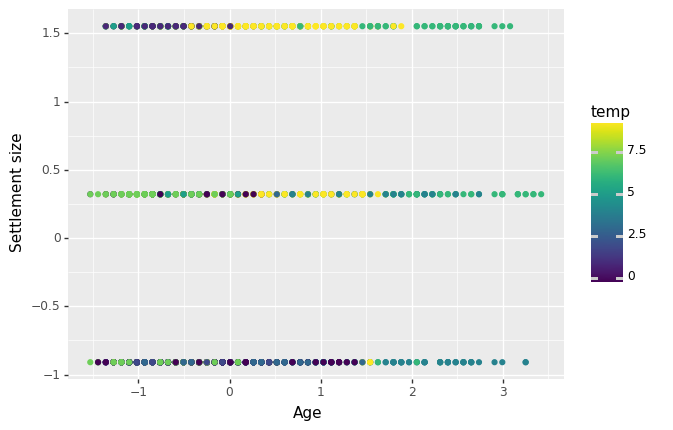

<ggplot: (8766039010041)>
CLuster10


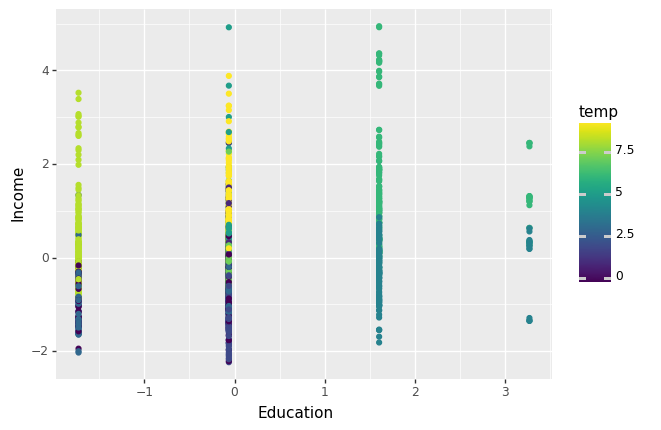

<ggplot: (8766034261413)>
CLuster10


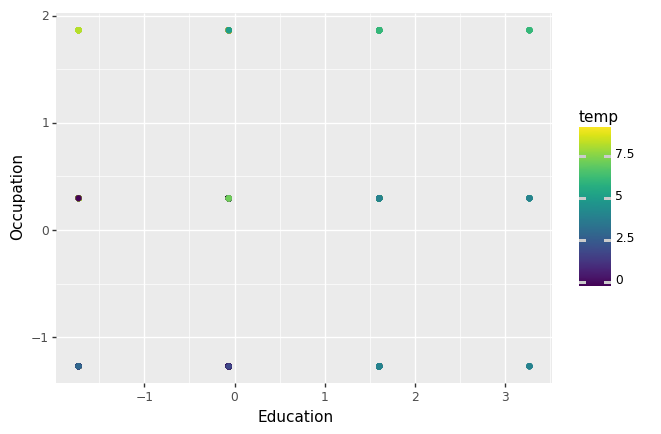

<ggplot: (8766039224281)>
CLuster10


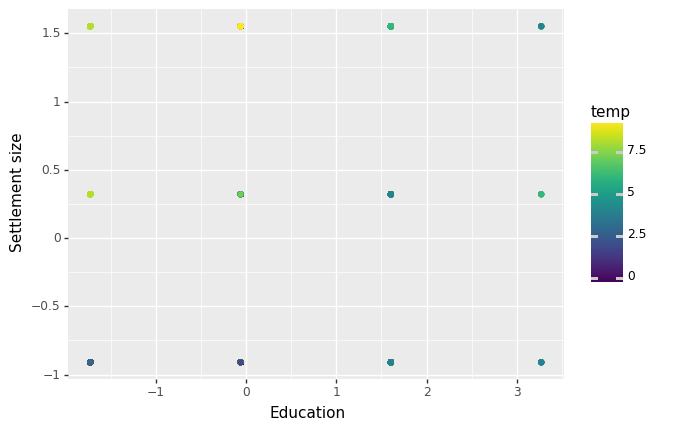

<ggplot: (8766034160349)>
CLuster10


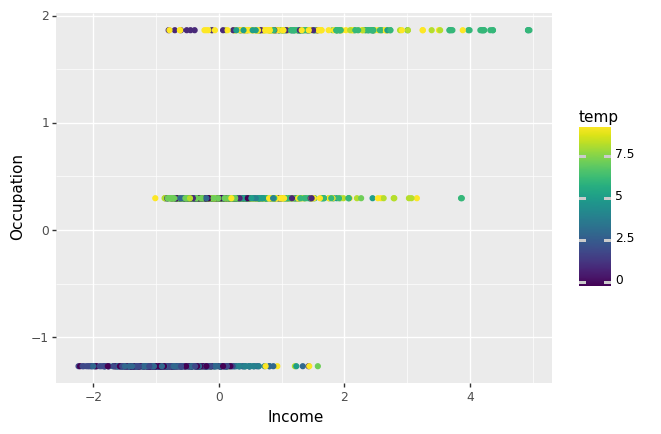

<ggplot: (8766039196849)>
CLuster10


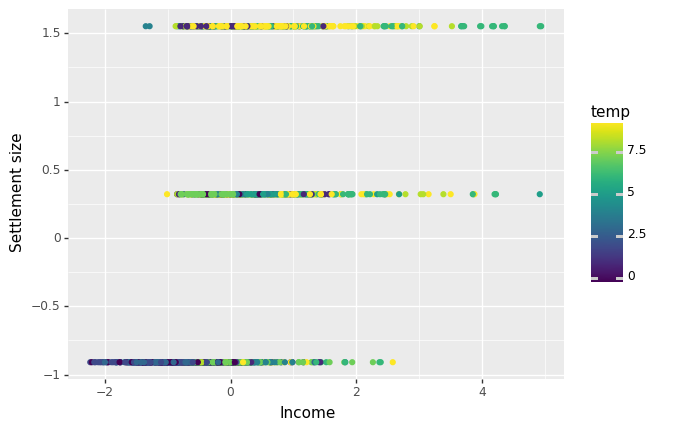

<ggplot: (8766039196733)>
CLuster10


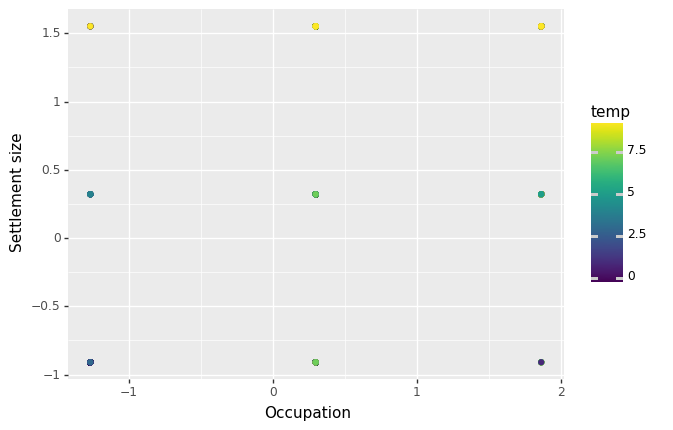

<ggplot: (8766038851629)>


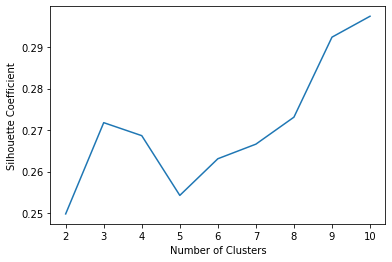

The best silhouette_coefficient is with 10 number of clusters
  


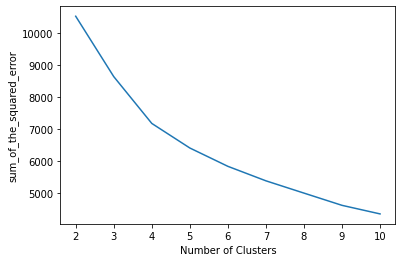

In [13]:
from plotnine import *
from plotnine.data import mpg
from plotnine import ggplot, aes, facet_grid, labs, geom_point, theme_dark

sum_of_the_squared_error = []
listofrange=len(range(2,12,1))
i = 2
while listofrange >= i :
 if 'temp' in df_customer_normalized.columns:
  df_customer_normalized.drop('temp', axis=1, inplace=True)
 Kmeans = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
 Kmeans.fit(df_customer_normalized)
 df_customer_normalized['temp']=Kmeans.labels_
 sum_of_the_squared_error.append(Kmeans.inertia_)
 df_customer_normalized_col=len(range(len(df_customer_normalized.columns)-1))
 c=len(df_customer_normalized.columns)-1
 rangeofinnerloop=range(c-1)
 j=0
 while df_customer_normalized_col >j:
    for u in range(c-1):
      u+=1
      u+=j
      print("CLuster" + str(i))
      print(ggplot(df_customer_normalized,aes(x=df_customer_normalized.columns[j],y=df_customer_normalized.columns[u],color='temp'))+geom_point())
    c-=1
    j+=1
 i+=1

silhouette_coefficients2=[]
i=2
while listofrange >= i :
  if 'temp' in df_customer_normalized.columns:
   df_customer_normalized.drop('temp', axis=1, inplace=True)
  Kmeans2 = KMeans( n_clusters=i, **{"init": "random","n_init": 10,"max_iter": 300,"random_state": 42} )
  Kmeans2.fit(df_customer_normalized)
  silhouette_coefficients2.append(silhouette_score(df_customer_normalized, Kmeans2.labels_))
  i+=1


x2range=range(2,11,1)
plt.xticks(x2range)
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.plot(x2range, silhouette_coefficients2)
plt.show()
print("The best silhouette_coefficient is with", (silhouette_coefficients2.index(max(silhouette_coefficients2)))+2 , "number of clusters")
print('  ')
xrange=range(2,11,1)
plt.plot(xrange, sum_of_the_squared_error)
plt.xticks(xrange)
plt.xlabel("Number of Clusters")
plt.ylabel("sum_of_the_squared_error")
plt.show()



#DBSCAN Customer dataset

invalid eps 2.5000000000000004 with range 5
invalid eps 2.6 with range 5
invalid eps 2.7 with range 5
invalid eps 2.8000000000000003 with range 5
invalid eps 2.9000000000000004 with range 5
invalid eps 3.0000000000000004 with range 5


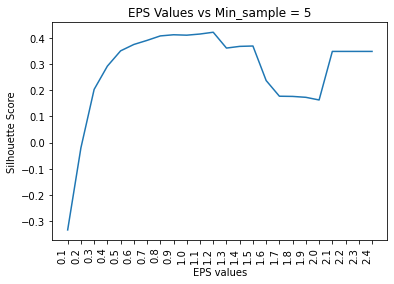

invalid eps 2.5000000000000004 with range 6
invalid eps 2.6 with range 6
invalid eps 2.7 with range 6
invalid eps 2.8000000000000003 with range 6
invalid eps 2.9000000000000004 with range 6
invalid eps 3.0000000000000004 with range 6


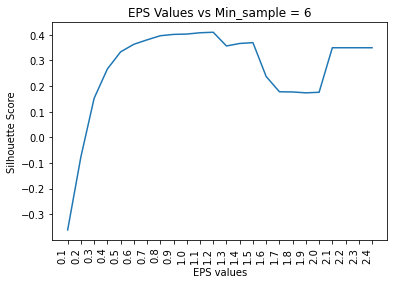

invalid eps 2.5000000000000004 with range 7
invalid eps 2.6 with range 7
invalid eps 2.7 with range 7
invalid eps 2.8000000000000003 with range 7
invalid eps 2.9000000000000004 with range 7
invalid eps 3.0000000000000004 with range 7


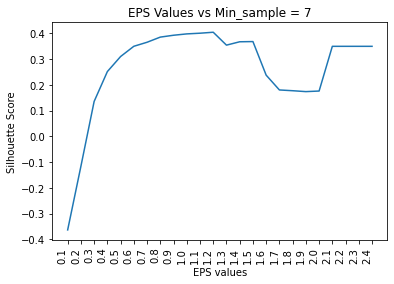

invalid eps 2.5000000000000004 with range 8
invalid eps 2.6 with range 8
invalid eps 2.7 with range 8
invalid eps 2.8000000000000003 with range 8
invalid eps 2.9000000000000004 with range 8
invalid eps 3.0000000000000004 with range 8


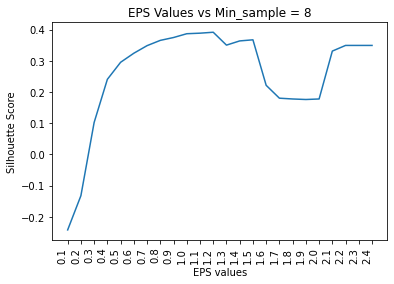

invalid eps 2.5000000000000004 with range 9
invalid eps 2.6 with range 9
invalid eps 2.7 with range 9
invalid eps 2.8000000000000003 with range 9
invalid eps 2.9000000000000004 with range 9
invalid eps 3.0000000000000004 with range 9


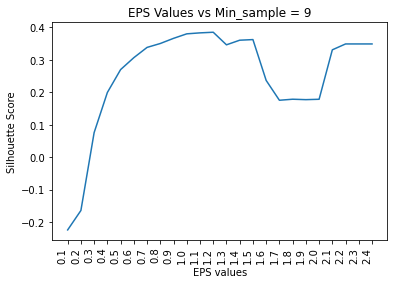

invalid eps 2.5000000000000004 with range 10
invalid eps 2.6 with range 10
invalid eps 2.7 with range 10
invalid eps 2.8000000000000003 with range 10
invalid eps 2.9000000000000004 with range 10
invalid eps 3.0000000000000004 with range 10


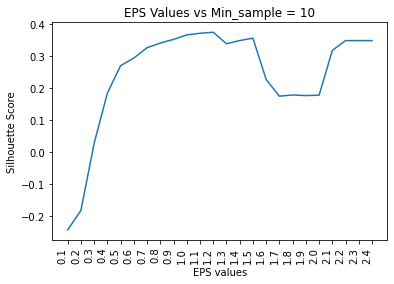

invalid eps 0.1 with range 11
invalid eps 2.5000000000000004 with range 11
invalid eps 2.6 with range 11
invalid eps 2.7 with range 11
invalid eps 2.8000000000000003 with range 11
invalid eps 2.9000000000000004 with range 11
invalid eps 3.0000000000000004 with range 11


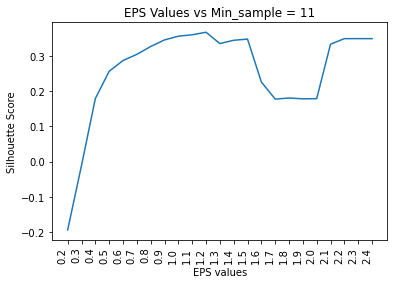

invalid eps 0.1 with range 12
invalid eps 2.5000000000000004 with range 12
invalid eps 2.6 with range 12
invalid eps 2.7 with range 12
invalid eps 2.8000000000000003 with range 12
invalid eps 2.9000000000000004 with range 12
invalid eps 3.0000000000000004 with range 12


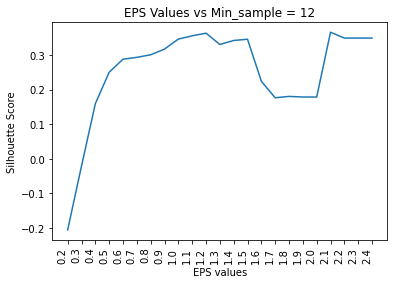

invalid eps 0.1 with range 13
invalid eps 2.5000000000000004 with range 13
invalid eps 2.6 with range 13
invalid eps 2.7 with range 13
invalid eps 2.8000000000000003 with range 13
invalid eps 2.9000000000000004 with range 13
invalid eps 3.0000000000000004 with range 13


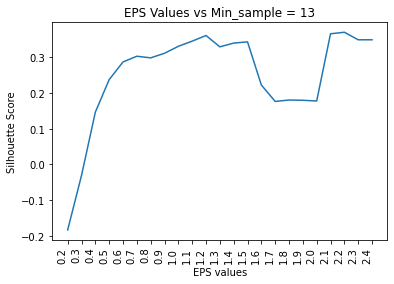

invalid eps 0.1 with range 14
invalid eps 2.5000000000000004 with range 14
invalid eps 2.6 with range 14
invalid eps 2.7 with range 14
invalid eps 2.8000000000000003 with range 14
invalid eps 2.9000000000000004 with range 14
invalid eps 3.0000000000000004 with range 14


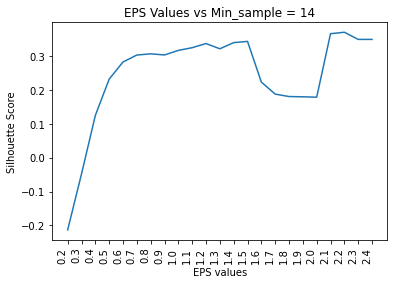

invalid eps 0.1 with range 15
invalid eps 2.5000000000000004 with range 15
invalid eps 2.6 with range 15
invalid eps 2.7 with range 15
invalid eps 2.8000000000000003 with range 15
invalid eps 2.9000000000000004 with range 15
invalid eps 3.0000000000000004 with range 15


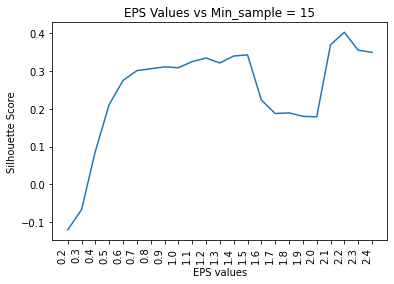

invalid eps 0.1 with range 16
invalid eps 2.5000000000000004 with range 16
invalid eps 2.6 with range 16
invalid eps 2.7 with range 16
invalid eps 2.8000000000000003 with range 16
invalid eps 2.9000000000000004 with range 16
invalid eps 3.0000000000000004 with range 16


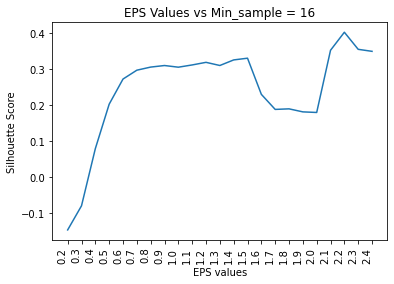

invalid eps 0.1 with range 17
invalid eps 2.5000000000000004 with range 17
invalid eps 2.6 with range 17
invalid eps 2.7 with range 17
invalid eps 2.8000000000000003 with range 17
invalid eps 2.9000000000000004 with range 17
invalid eps 3.0000000000000004 with range 17


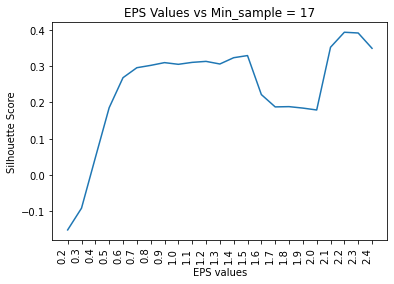

invalid eps 0.1 with range 18
invalid eps 2.5000000000000004 with range 18
invalid eps 2.6 with range 18
invalid eps 2.7 with range 18
invalid eps 2.8000000000000003 with range 18
invalid eps 2.9000000000000004 with range 18
invalid eps 3.0000000000000004 with range 18


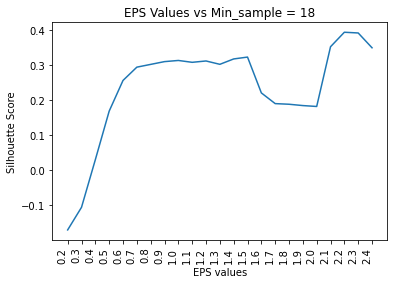

invalid eps 0.1 with range 19
invalid eps 2.5000000000000004 with range 19
invalid eps 2.6 with range 19
invalid eps 2.7 with range 19
invalid eps 2.8000000000000003 with range 19
invalid eps 2.9000000000000004 with range 19
invalid eps 3.0000000000000004 with range 19


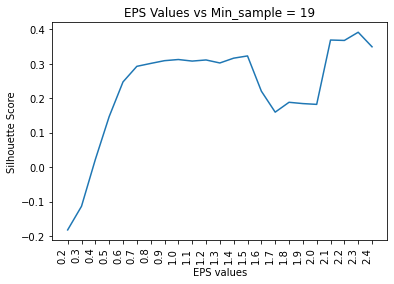

invalid eps 0.1 with range 20
invalid eps 2.5000000000000004 with range 20
invalid eps 2.6 with range 20
invalid eps 2.7 with range 20
invalid eps 2.8000000000000003 with range 20
invalid eps 2.9000000000000004 with range 20
invalid eps 3.0000000000000004 with range 20


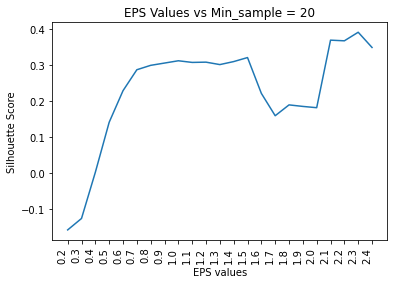

invalid eps 0.1 with range 21
invalid eps 2.5000000000000004 with range 21
invalid eps 2.6 with range 21
invalid eps 2.7 with range 21
invalid eps 2.8000000000000003 with range 21
invalid eps 2.9000000000000004 with range 21
invalid eps 3.0000000000000004 with range 21


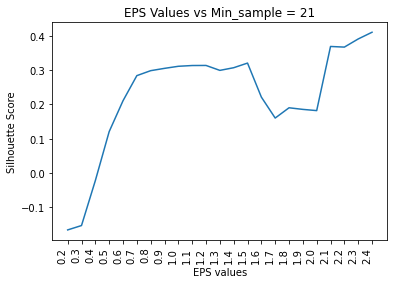

invalid eps 0.1 with range 22
invalid eps 2.5000000000000004 with range 22
invalid eps 2.6 with range 22
invalid eps 2.7 with range 22
invalid eps 2.8000000000000003 with range 22
invalid eps 2.9000000000000004 with range 22
invalid eps 3.0000000000000004 with range 22


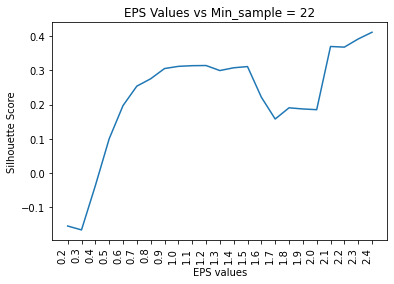

invalid eps 0.1 with range 23
invalid eps 2.5000000000000004 with range 23
invalid eps 2.6 with range 23
invalid eps 2.7 with range 23
invalid eps 2.8000000000000003 with range 23
invalid eps 2.9000000000000004 with range 23
invalid eps 3.0000000000000004 with range 23


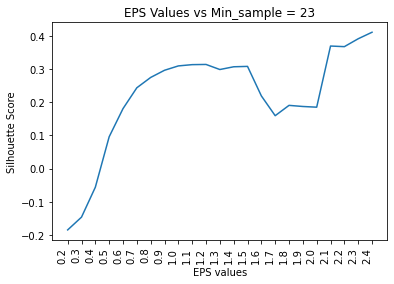

invalid eps 0.1 with range 24
invalid eps 2.5000000000000004 with range 24
invalid eps 2.6 with range 24
invalid eps 2.7 with range 24
invalid eps 2.8000000000000003 with range 24
invalid eps 2.9000000000000004 with range 24
invalid eps 3.0000000000000004 with range 24


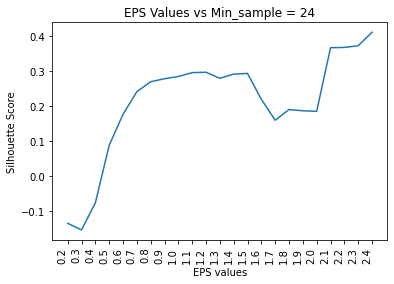

invalid eps 0.1 with range 25
invalid eps 2.5000000000000004 with range 25
invalid eps 2.6 with range 25
invalid eps 2.7 with range 25
invalid eps 2.8000000000000003 with range 25
invalid eps 2.9000000000000004 with range 25
invalid eps 3.0000000000000004 with range 25


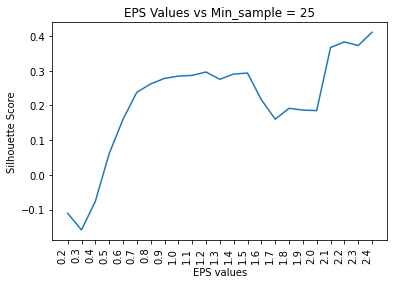

The max Silhouette Score is 0.42256068326179 with eps equal to (1.2000000000000002,) and min_samples equal to 5


In [14]:
min_samples_list=range(5,26,1)
min_samples_range= len(range(5,26,1))
epsss=np.arange(0.1, 3.1, 0.1)
eps_range=len(np.arange(0.1, 3.1, 0.1))
best_silhouette_score =0
best_ep=0
best_min_sample=0



if 'temp' in df_customer_normalized.columns:
 df_customer_normalized.drop('temp', axis=1, inplace=True)
i=0



while min_samples_range - 1 >= i:

  silhouette_scores = []
  valid_eps=[]
  
  j=0
  while eps_range - 1 >= j: 
    dbscan = DBSCAN(eps=epsss[j], min_samples=min_samples_list[i])
    dbscan.fit(df_customer_normalized)

    if (len(np.unique(dbscan.labels_)) <= 1):
      print("invalid eps",epsss[j],"with range",min_samples_list[i])
      j+=1
      continue

    valid_eps.append(epsss[j])
    sil_dbscan = silhouette_score(df_customer_normalized, dbscan.labels_)
    silhouette_scores.append(sil_dbscan)

    if (best_silhouette_score <= sil_dbscan): 
     best_silhouette_score =sil_dbscan
     best_min_sample=min_samples_list[i]
     best_ep=epsss[j],
    j+=1
 
  plt.plot(valid_eps, silhouette_scores)
  plt.xticks(valid_eps)
  graph_helper= plt.subplot()   
  plt.setp(graph_helper.get_xticklabels(), rotation=90, ha='right')
  plt.title("EPS Values vs Min_sample = " + str(min_samples_list[i]))
  plt.xlabel("EPS values")
  plt.ylabel("Silhouette Score")
  plt.show() 
  i+=1

      

print("The max Silhouette Score is", best_silhouette_score ,"with eps equal to" , best_ep , "and min_samples equal to", best_min_sample )

        

##HIRI Coustomer Data

cityblock
average
0.3
['0.7931911831579896', 'cityblock', 'average', '0.3']


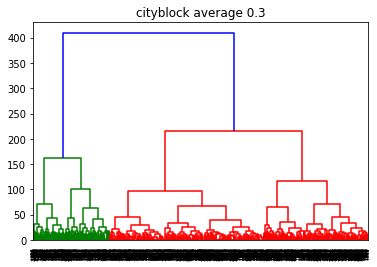

CLuster21


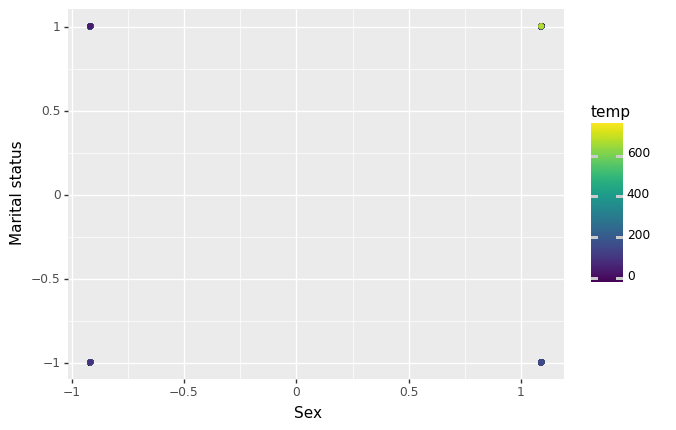

<ggplot: (8766034340613)>
CLuster21


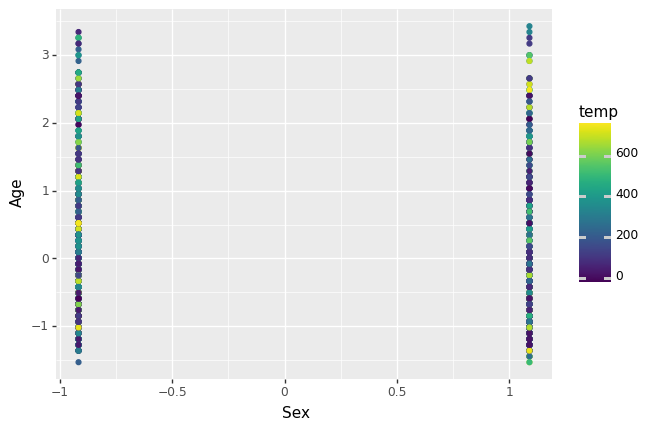

<ggplot: (8766034109553)>
CLuster21


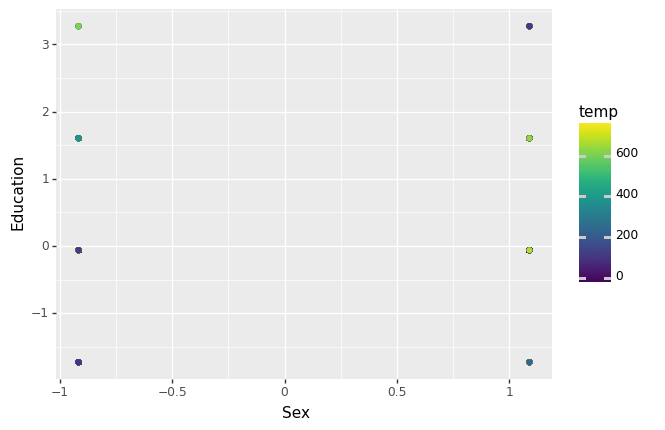

<ggplot: (8766034773809)>
CLuster21


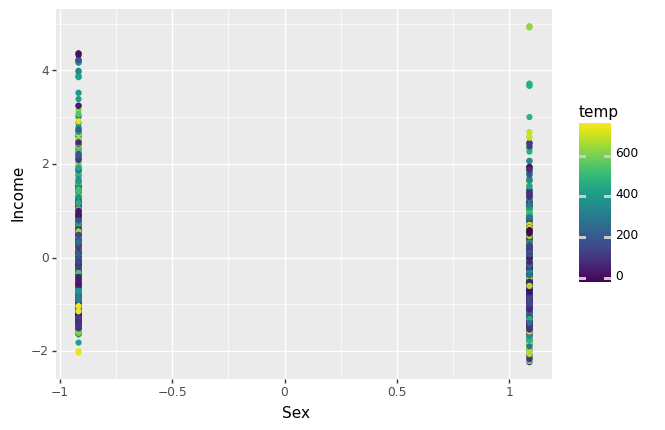

<ggplot: (8766034632997)>
CLuster21


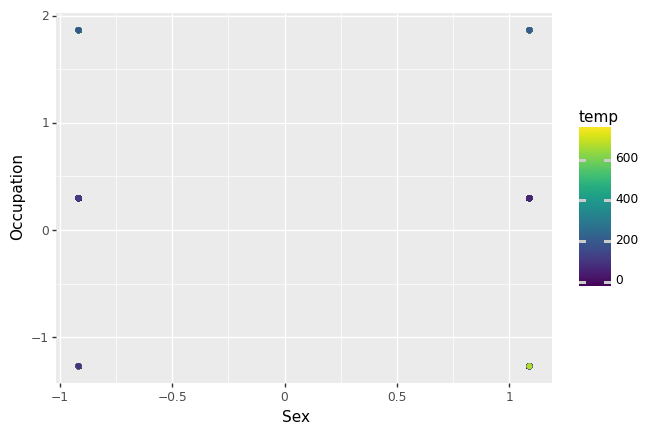

<ggplot: (8766033300489)>
CLuster21


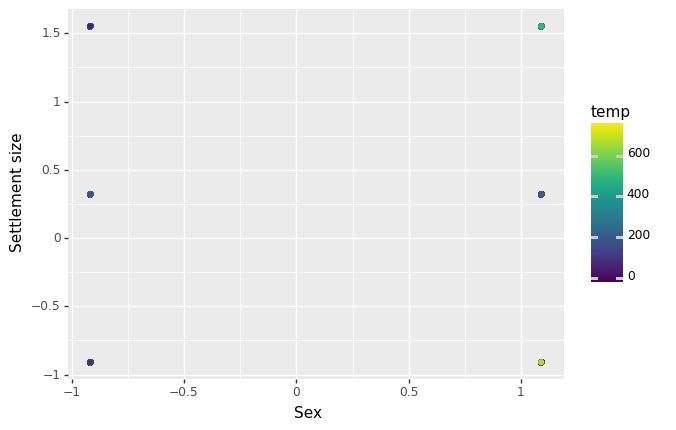

<ggplot: (8766033688457)>
CLuster21


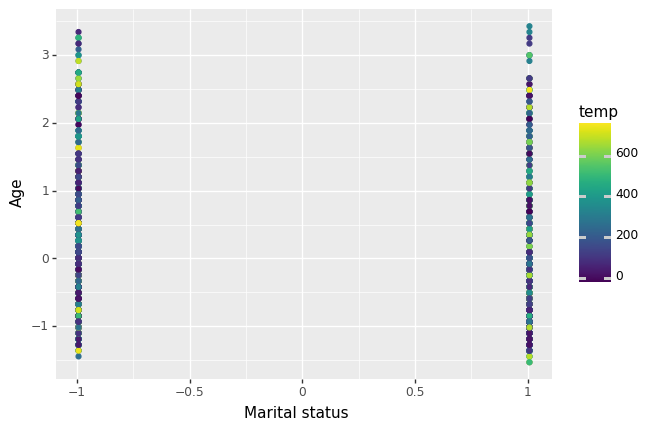

<ggplot: (8766033970961)>
CLuster21


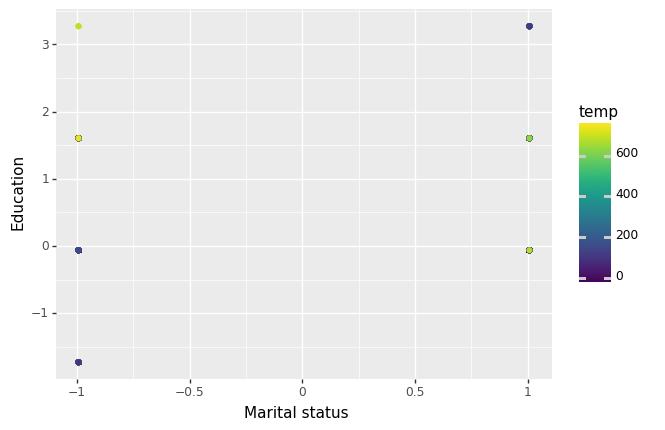

<ggplot: (8766034638781)>
CLuster21


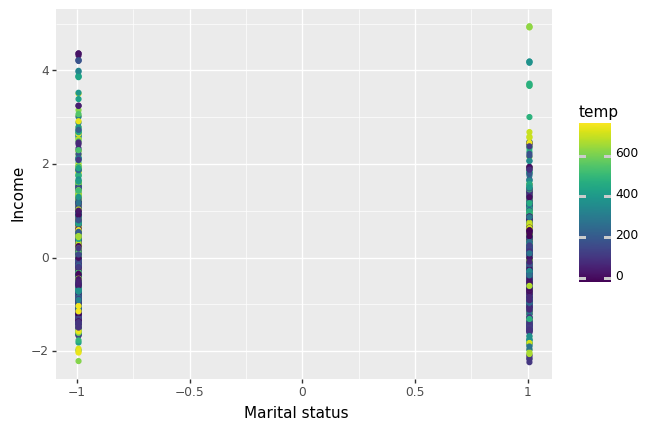

<ggplot: (8766033731793)>
CLuster21


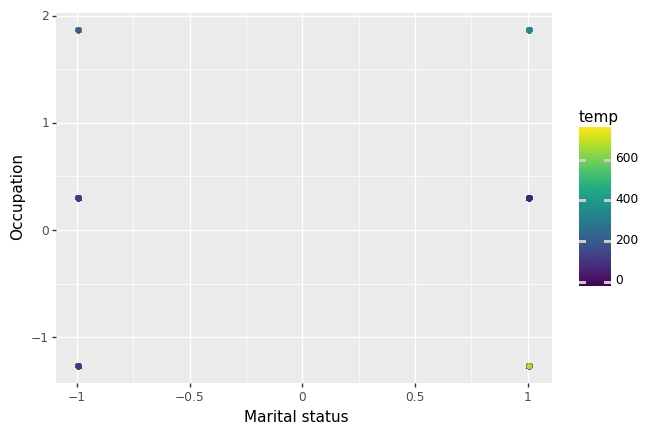

<ggplot: (8766033673869)>
CLuster21


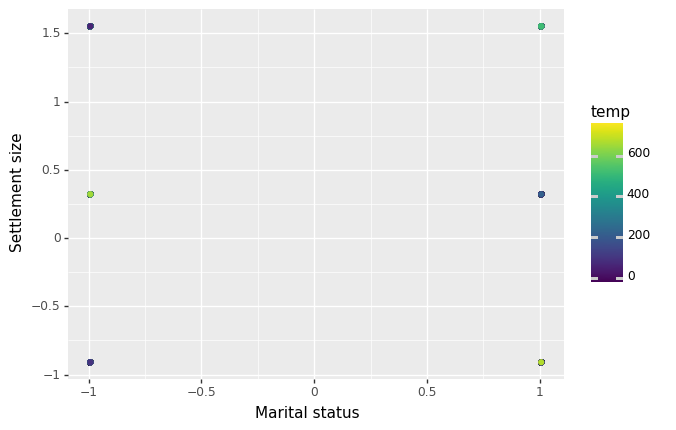

<ggplot: (8766034316657)>
CLuster21


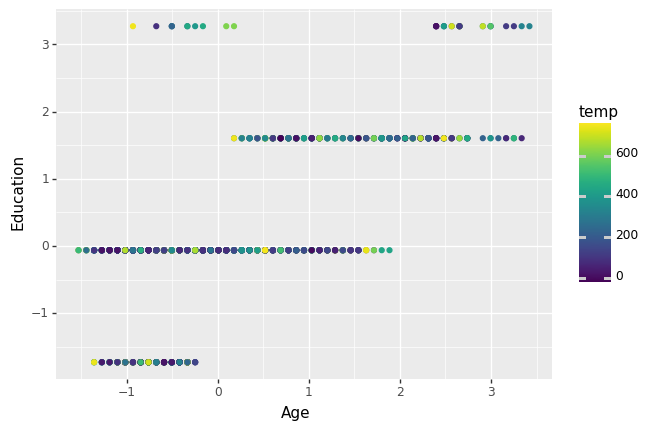

<ggplot: (8766033460545)>
CLuster21


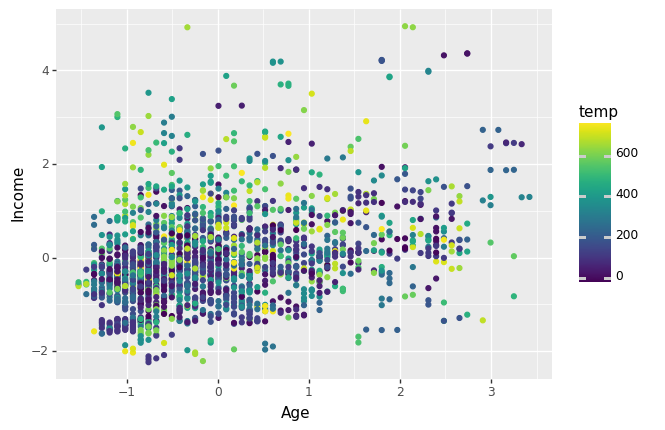

<ggplot: (8766033517525)>
CLuster21


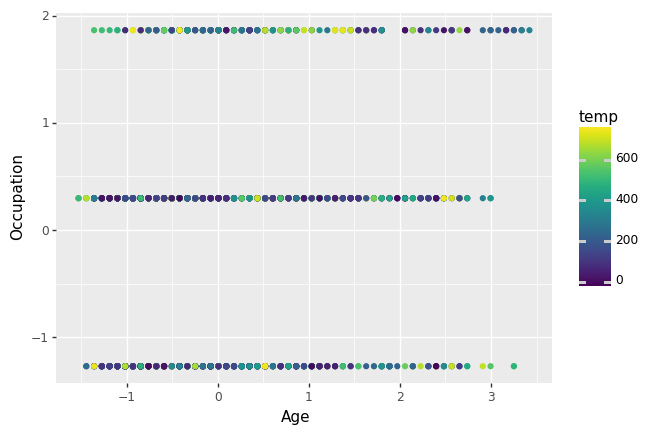

<ggplot: (8766033453965)>
CLuster21


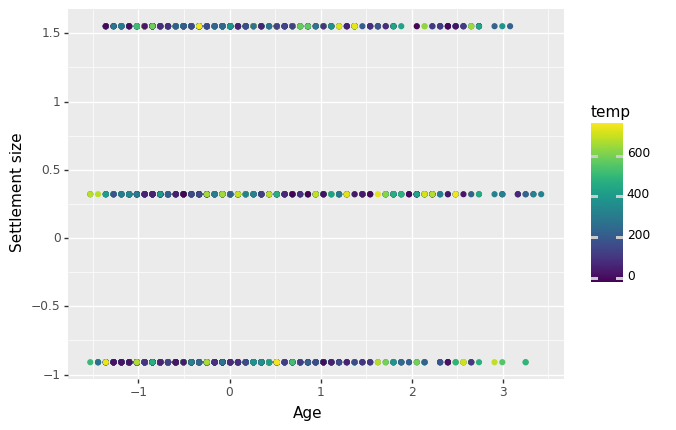

<ggplot: (8766033261745)>
CLuster21


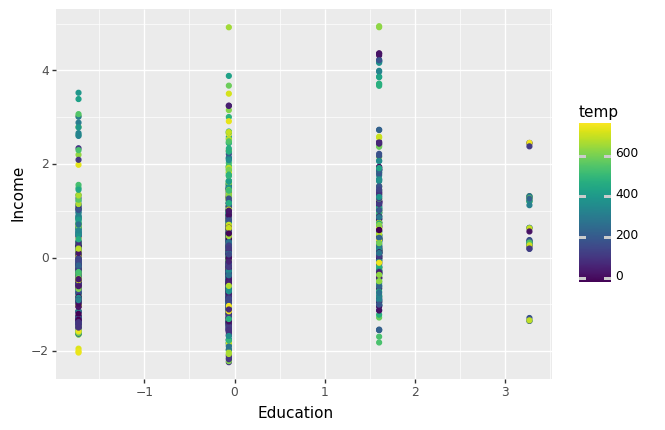

<ggplot: (8766033085161)>
CLuster21


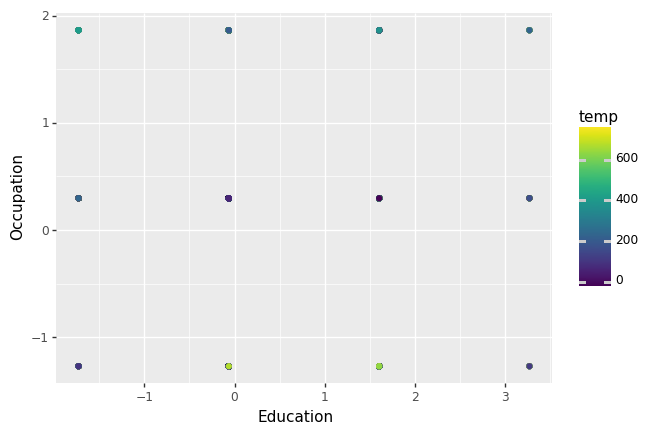

<ggplot: (8766033415737)>
CLuster21


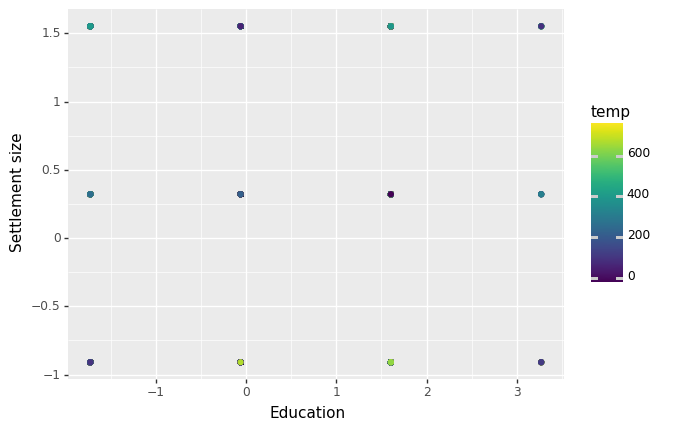

<ggplot: (8766033731793)>
CLuster21


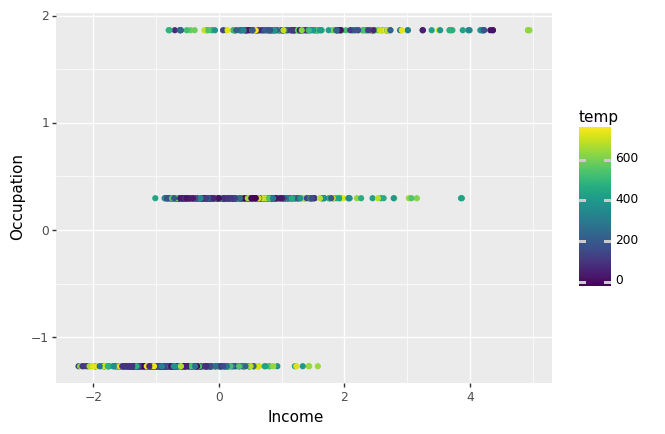

<ggplot: (8766033007417)>
CLuster21


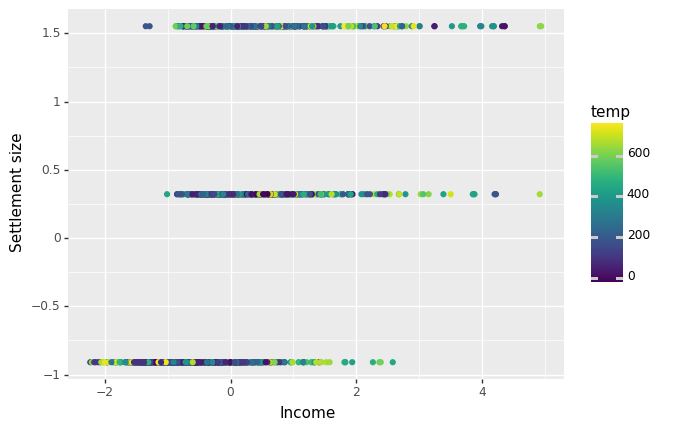

<ggplot: (8766039199621)>
CLuster21


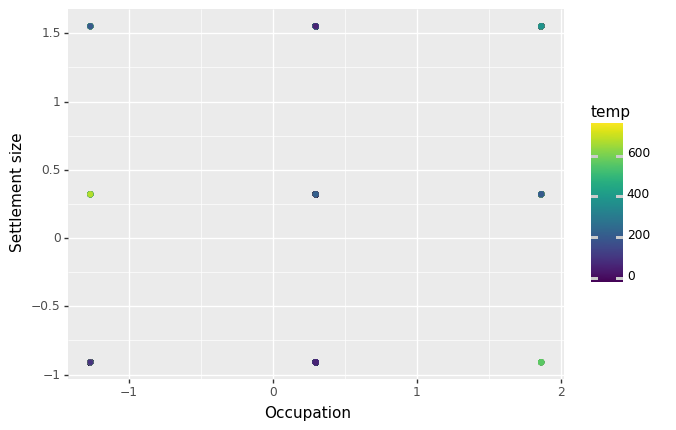

<ggplot: (8766033691053)>
0.5
['0.8444201554088079', 'cityblock', 'average', '0.5']


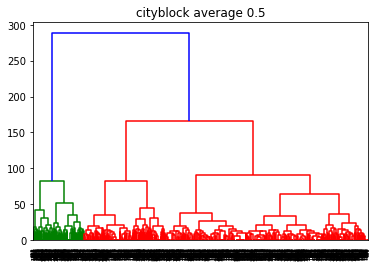

CLuster21


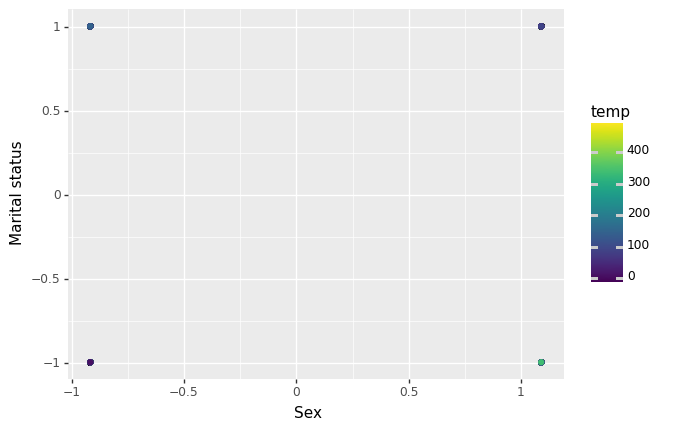

<ggplot: (8766034755165)>
CLuster21


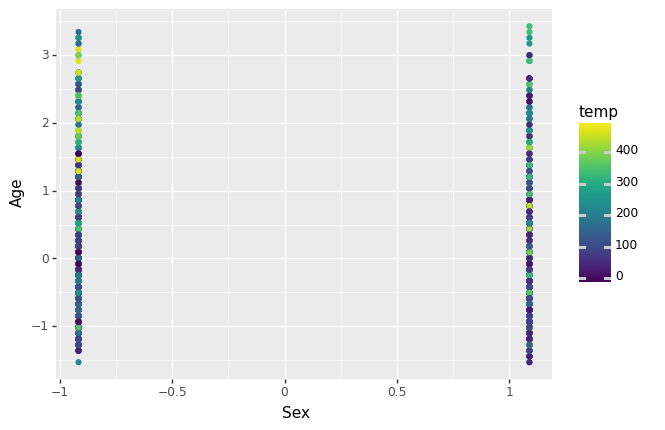

<ggplot: (8766033689277)>
CLuster21


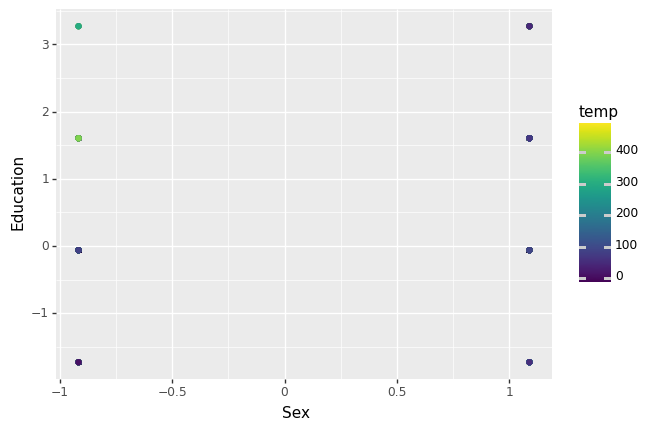

<ggplot: (8766034689317)>
CLuster21


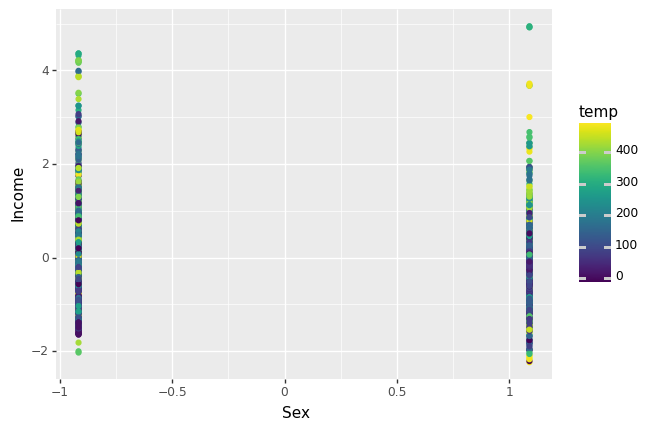

<ggplot: (8766032916237)>
CLuster21


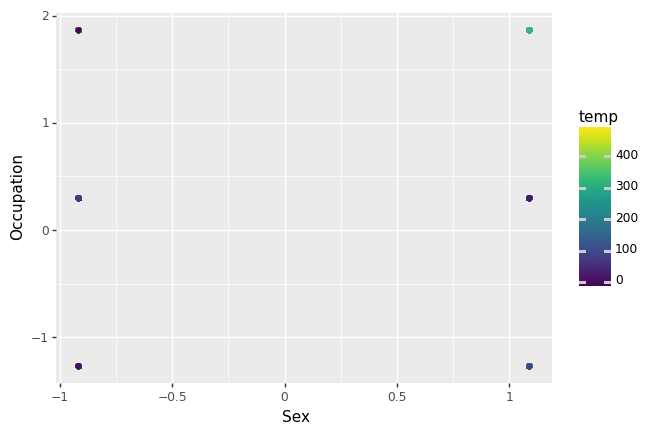

<ggplot: (8766037701829)>
CLuster21


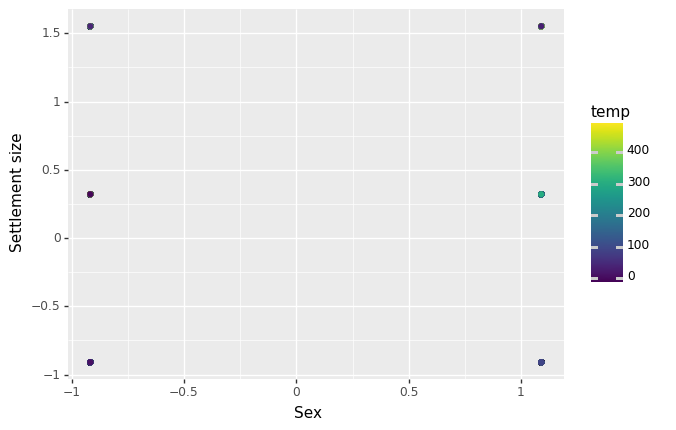

<ggplot: (8766033001721)>
CLuster21


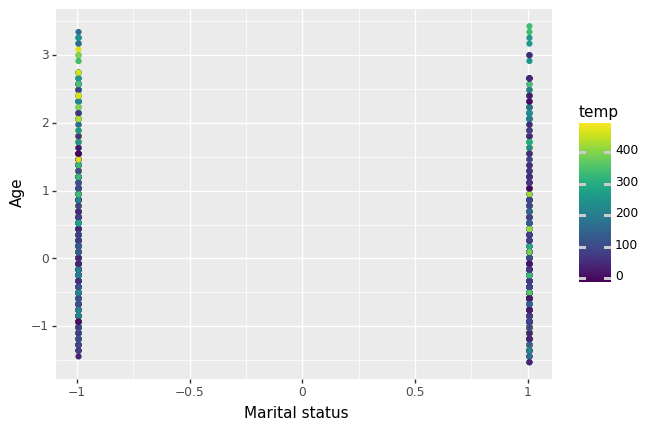

<ggplot: (8766034177821)>
CLuster21


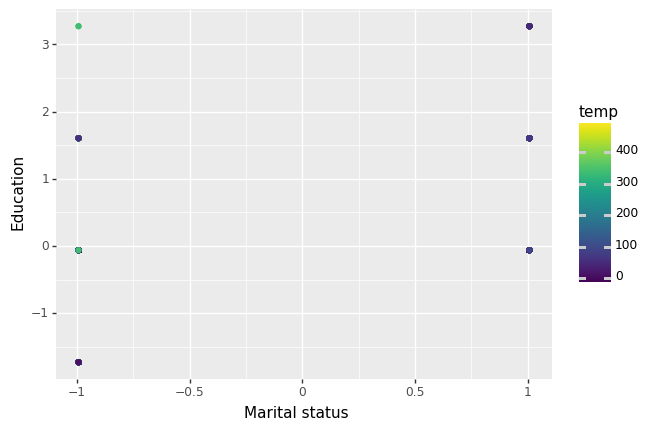

<ggplot: (8766033976465)>
CLuster21


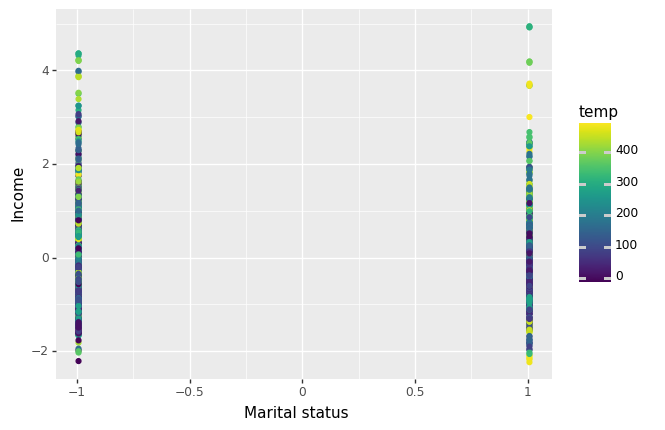

<ggplot: (8766034177817)>
CLuster21


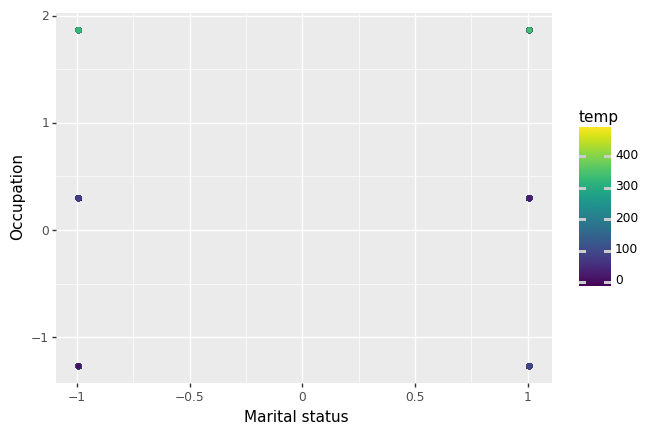

<ggplot: (8766037498913)>
CLuster21


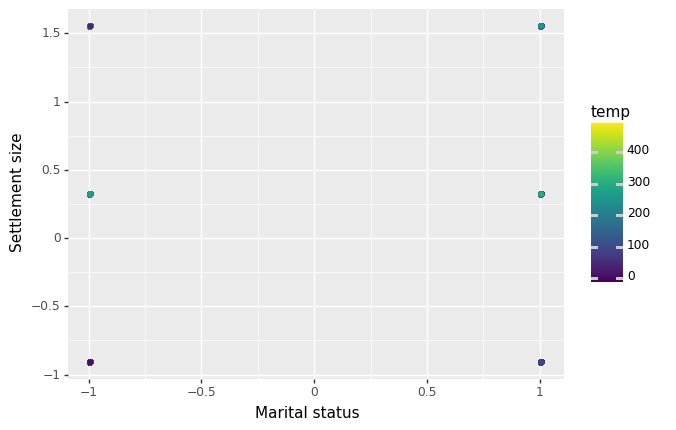

<ggplot: (8766034400437)>
CLuster21


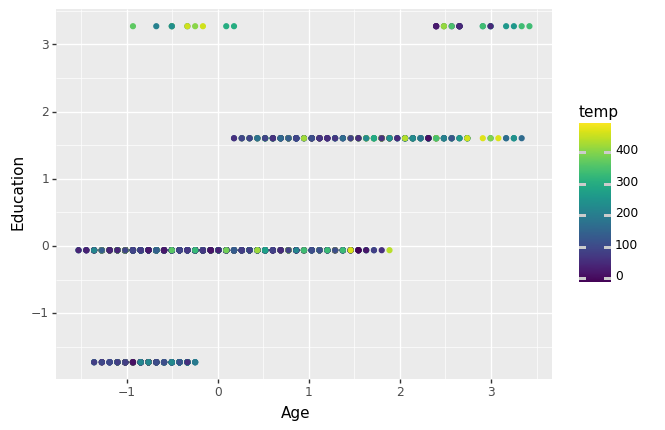

<ggplot: (8766034566797)>
CLuster21


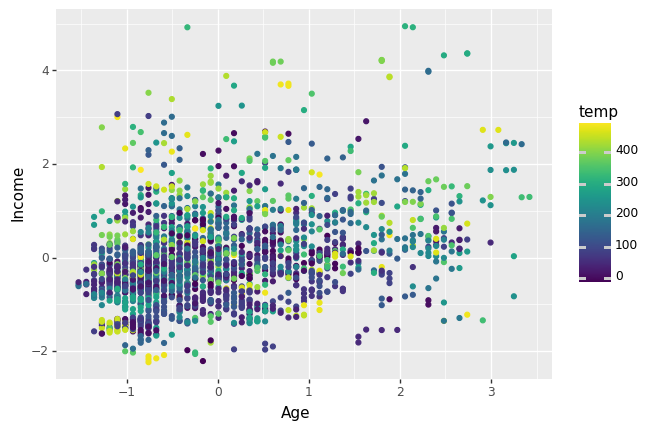

<ggplot: (8766037498913)>
CLuster21


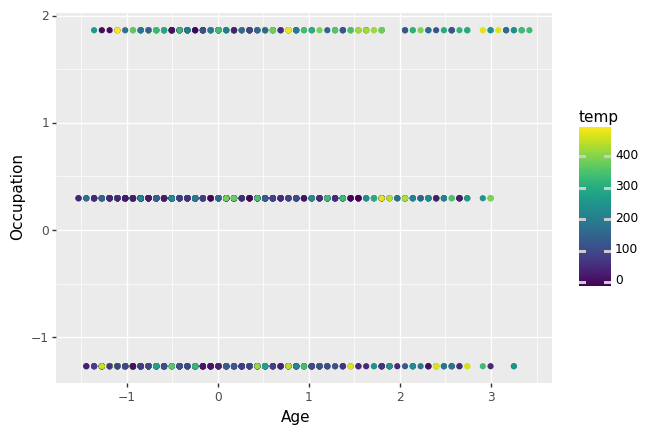

<ggplot: (8766033978813)>
CLuster21


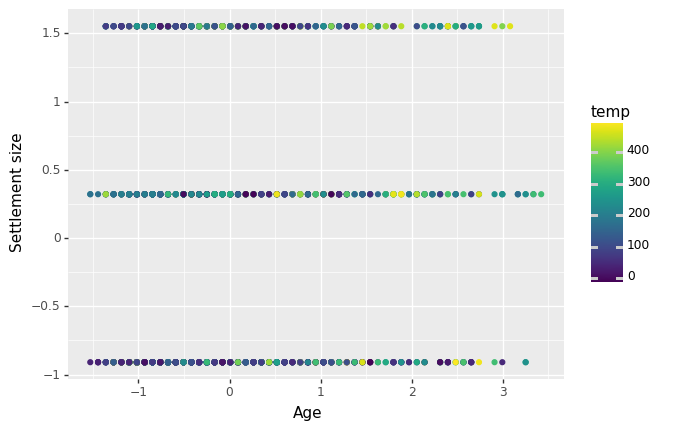

<ggplot: (8766034656173)>
CLuster21


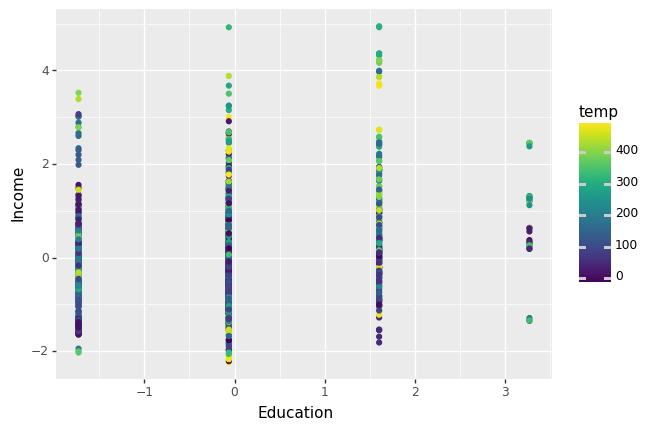

<ggplot: (8766034166985)>
CLuster21


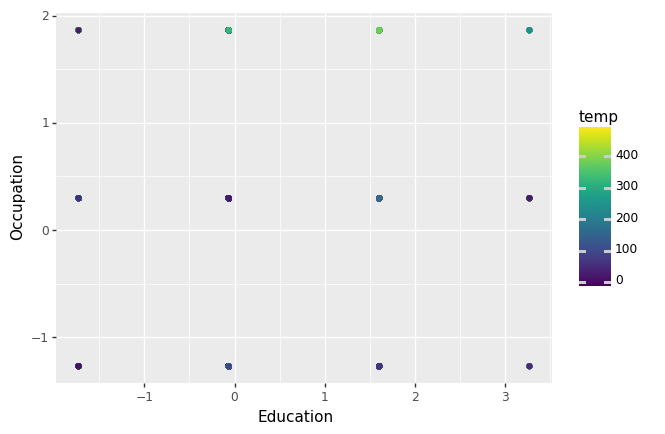

<ggplot: (8766039077853)>
CLuster21


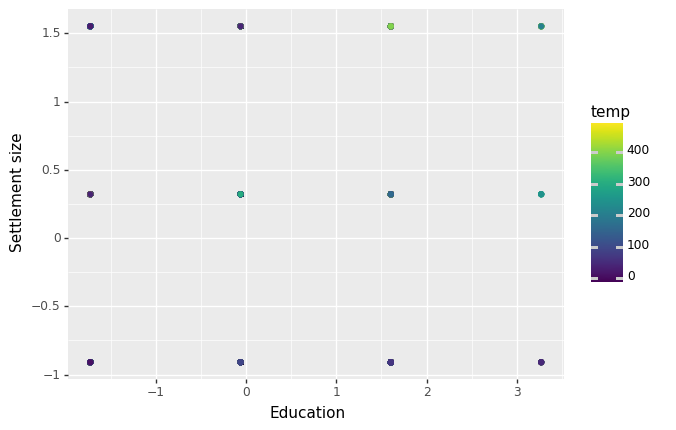

<ggplot: (8766034446553)>
CLuster21


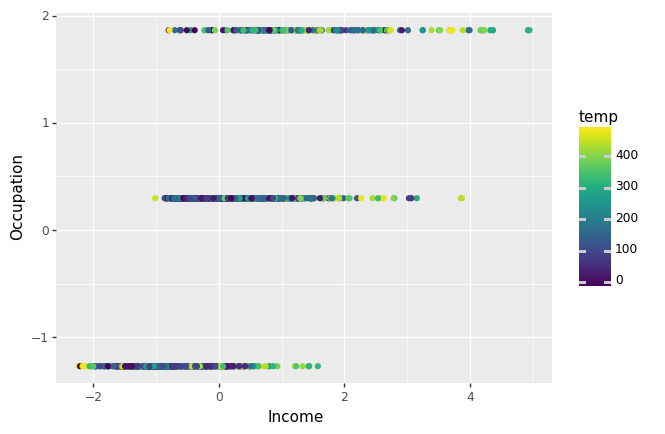

<ggplot: (8766034682529)>
CLuster21


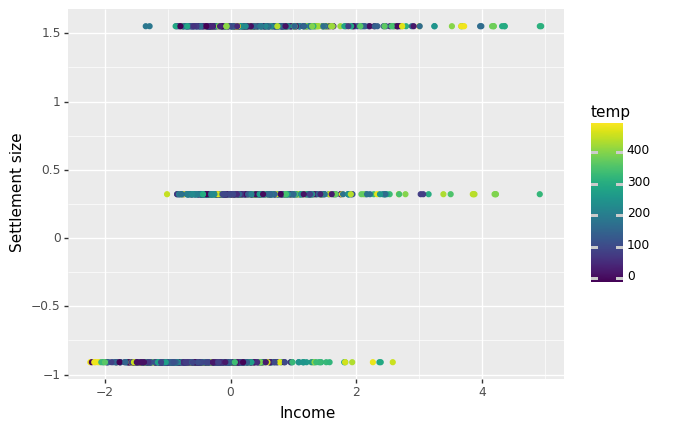

<ggplot: (8766038817473)>
CLuster21


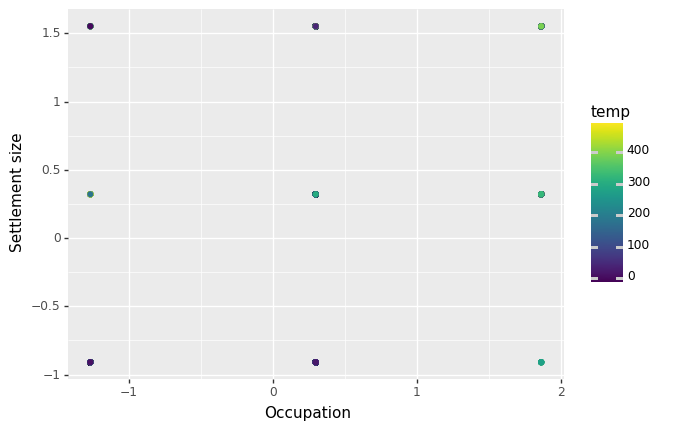

<ggplot: (8766034460497)>
0.7
['0.8493586595387294', 'cityblock', 'average', '0.7']


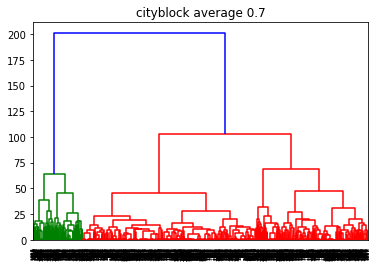

CLuster21


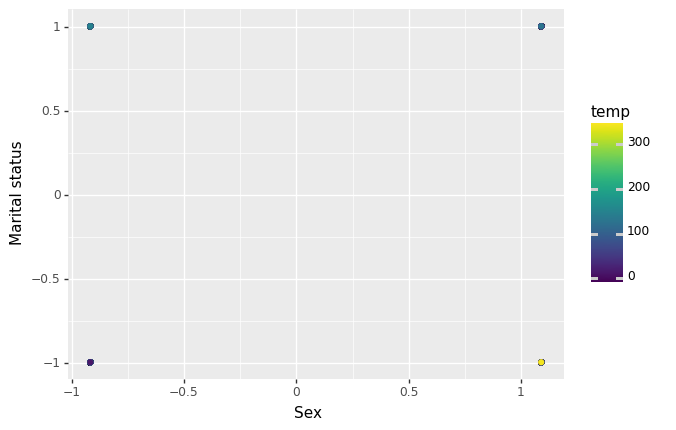

<ggplot: (8766034079237)>
CLuster21


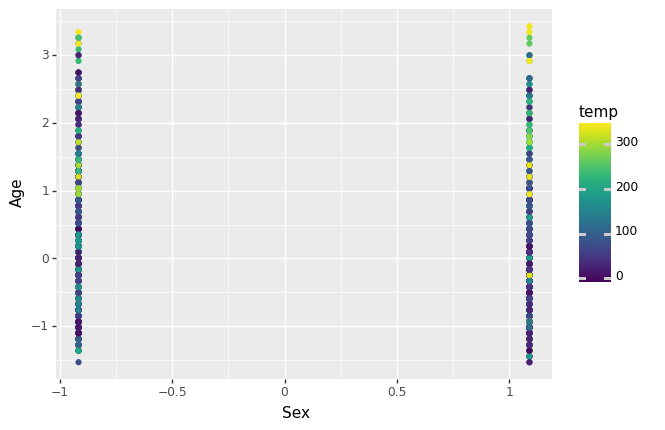

<ggplot: (8766033923909)>
CLuster21


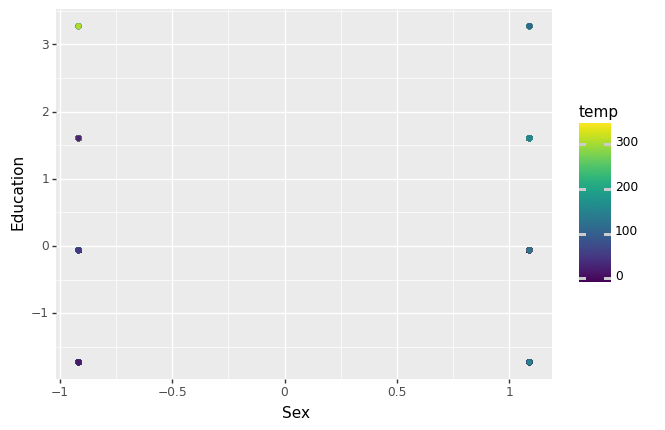

<ggplot: (8766033166793)>
CLuster21


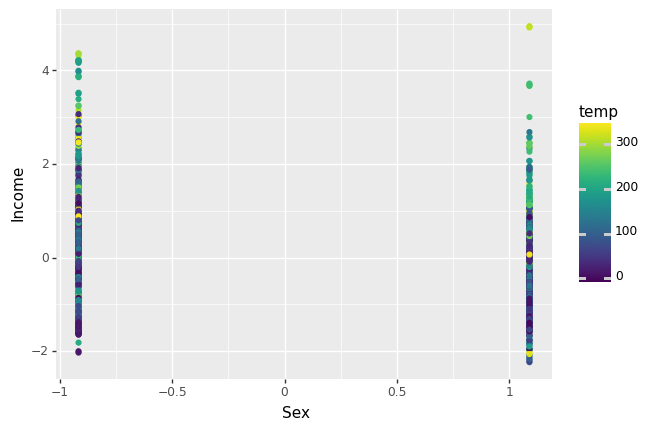

<ggplot: (8766033171205)>
CLuster21


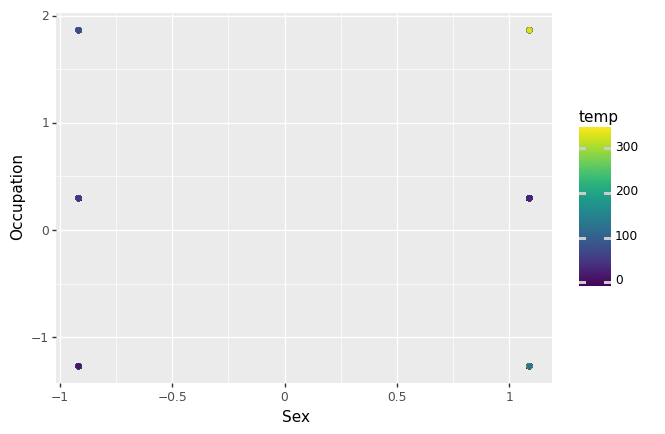

<ggplot: (8766033166773)>
CLuster21


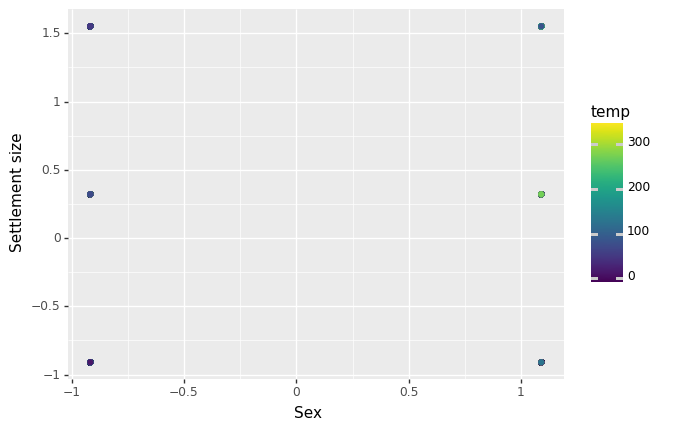

<ggplot: (8766034091481)>
CLuster21


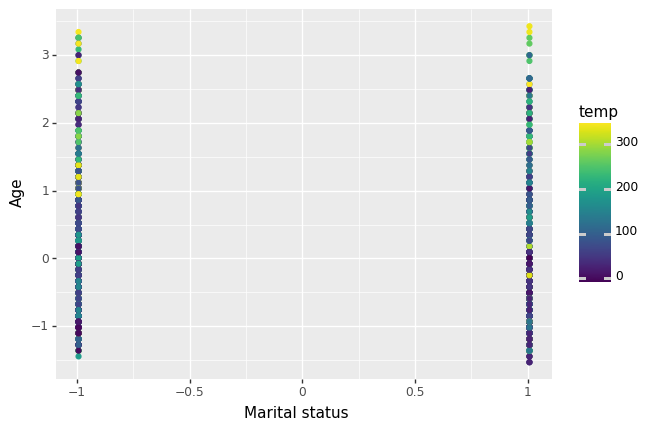

<ggplot: (8766034103765)>
CLuster21


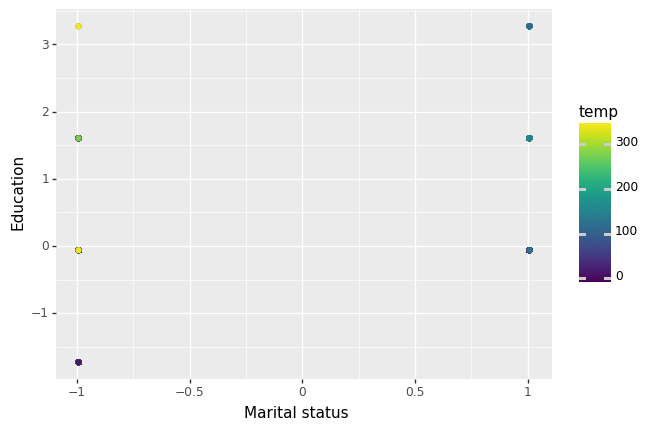

<ggplot: (8766033198589)>
CLuster21


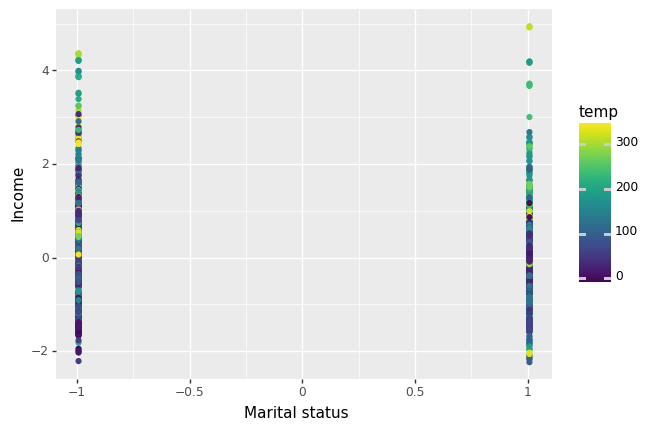

<ggplot: (8766033630081)>
CLuster21


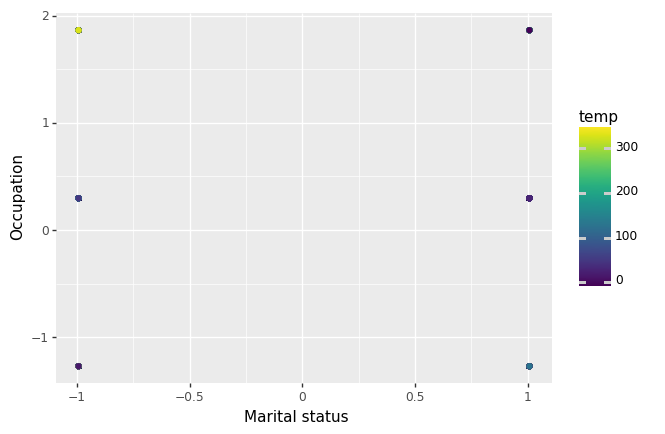

<ggplot: (8766033923909)>
CLuster21


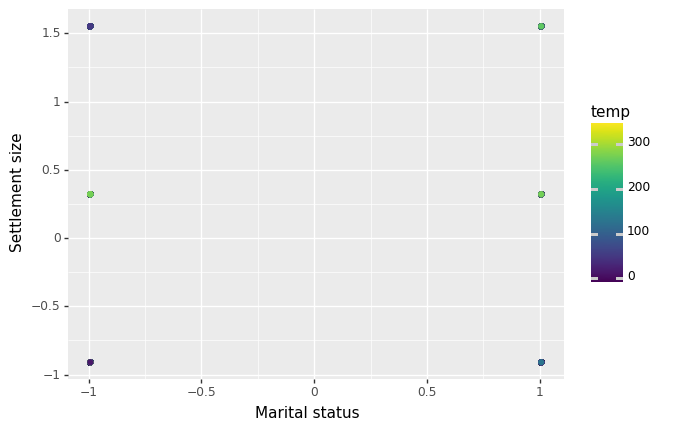

<ggplot: (8766034305029)>
CLuster21


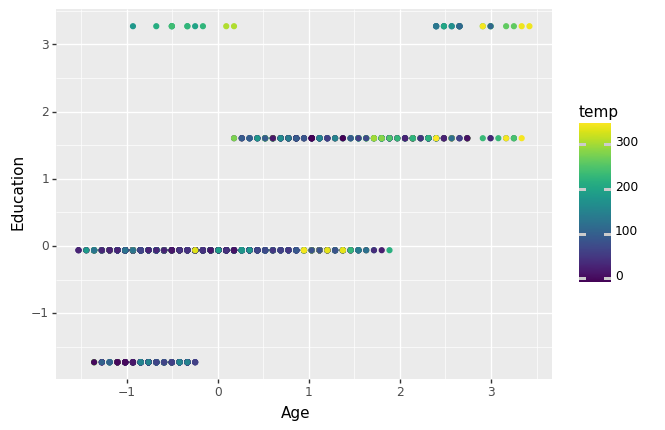

<ggplot: (8766033602769)>
CLuster21


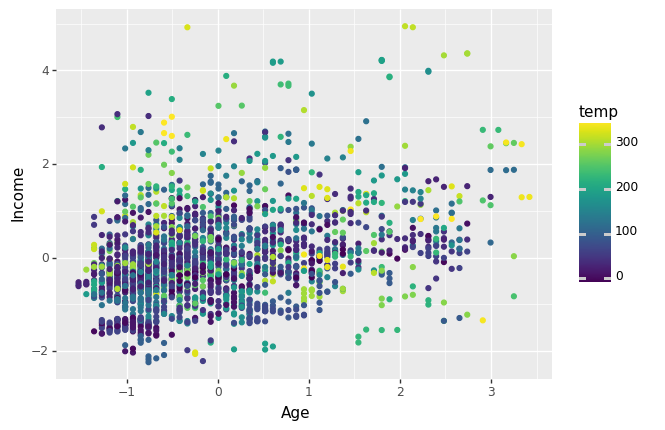

<ggplot: (8766033291477)>
CLuster21


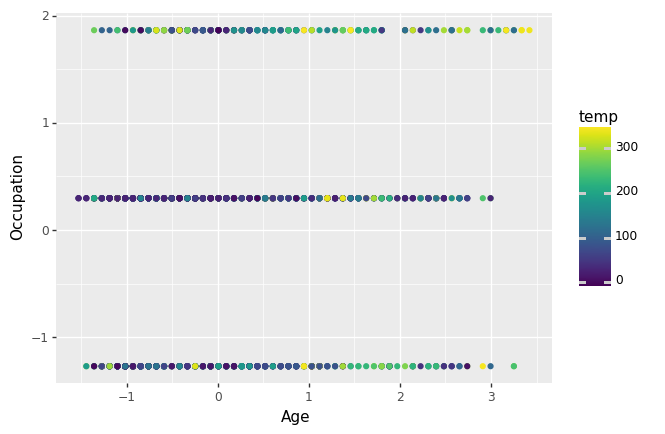

<ggplot: (8766032936313)>
CLuster21


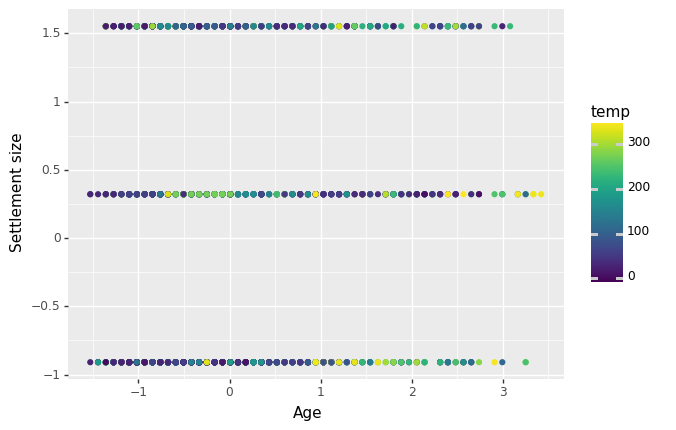

<ggplot: (8766034330485)>
CLuster21


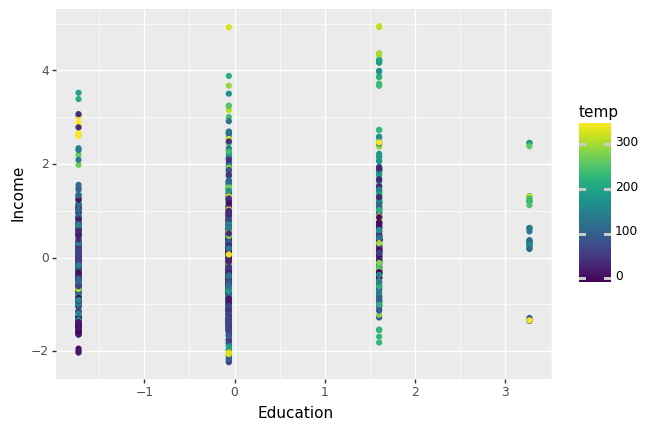

<ggplot: (8766033963205)>
CLuster21


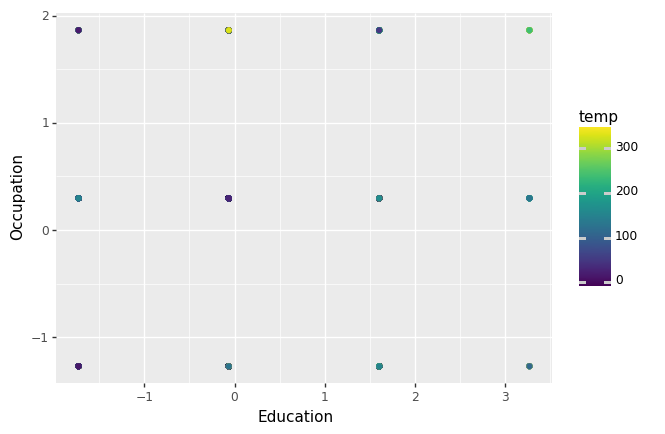

<ggplot: (8766034473781)>
CLuster21


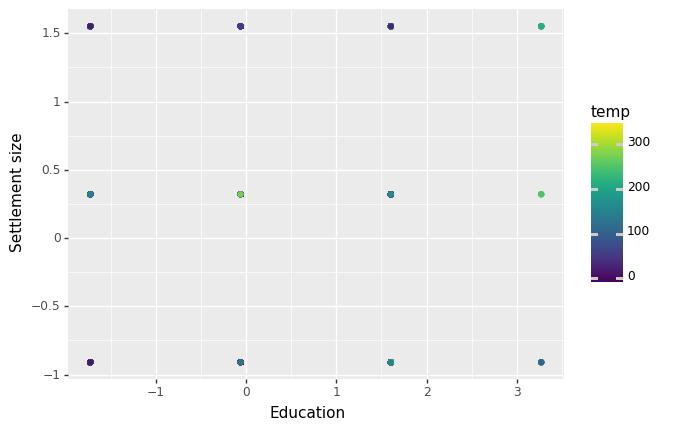

<ggplot: (8766037515297)>
CLuster21


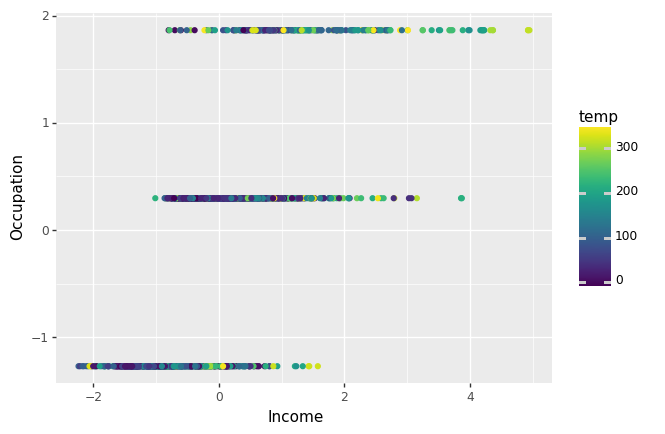

<ggplot: (8766034376597)>
CLuster21


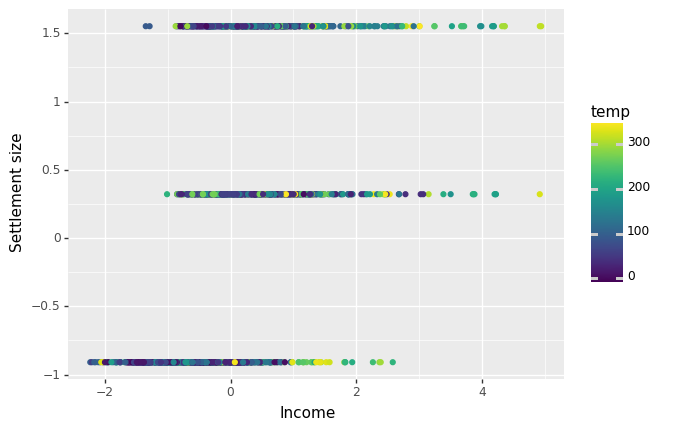

<ggplot: (8766037743781)>
CLuster21


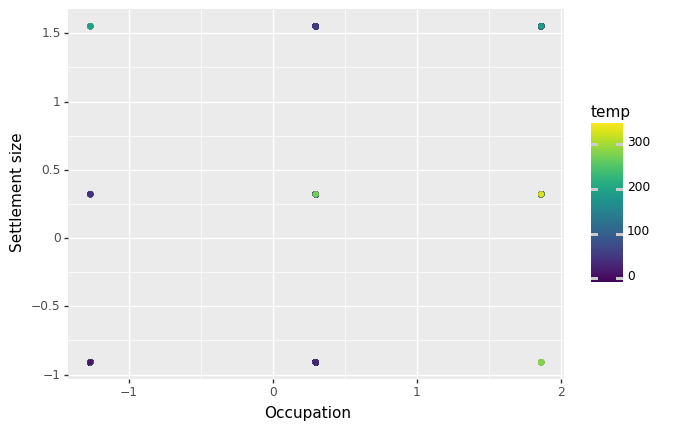

<ggplot: (8766037538701)>
0.9000000000000001


KeyboardInterrupt: ignored

In [15]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering


def display_hierarchal_cluster(X,km=[],num_clusters=0):
    alpha = 0.5  
    s = 20
    P=list(range(0,num_clusters+1))
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = 'r',alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[:,0],X[:,1],c =km.labels_,alpha = alpha,s=s)
        plt.show()

Affinity_list=['cityblock','euclidean','cosine']
Linkage_list=['average','single']
distance_range=np.arange(0.3, 2, 0.2)
best_silote_trails=['0.0','0.0','0.0','0.0']

a=0
while len(Affinity_list) -1 >= a :
  print(Affinity_list[a])
  l=0

  while len(Linkage_list) -1 >= l :
    print(Linkage_list[l])
    d=0

    while len(distance_range) -1 >= d :
      print(distance_range[d])
      if 'temp' in df_customer_normalized.columns:
        df_customer_normalized.drop('temp', axis=1, inplace=True)
      HIC = AgglomerativeClustering(distance_threshold=distance_range[d], n_clusters=None,affinity=Affinity_list[a],linkage=Linkage_list[l])
      HIC.fit(df_customer_normalized)
      df_customer_normalized['temp']=HIC.labels_
      temp=len(np.unique(HIC.labels_))
      if(temp!=1 and len(np.unique(HIC.labels_))!=len(df_customer_normalized)):
        single_iteration=silhouette_score(df_customer_normalized, HIC.labels_)
        if(float(best_silote_trails[0])<single_iteration):
          best_silote_trails=[str(single_iteration),Affinity_list[a],Linkage_list[l],str(distance_range[d].round(2))]
          print(best_silote_trails)
        linkage_type = linkage(df_customer_normalized, Linkage_list[l],metric=Affinity_list[a])
        plt.title(Affinity_list[a] +" "+Linkage_list[l]+" "+str(distance_range[d]))
        displaycl = dendrogram(linkage_type,truncate_mode='level')
        plt.show()
        df_customer_normalized_col=len(range(len(df_customer_normalized.columns)-1))
        c=len(df_customer_normalized.columns)-1
        j=0
        while df_customer_normalized_col >j:
          for u in range(c-1):
            u+=1
            u+=j
            print("CLuster" + str(i))
            print(ggplot(df_customer_normalized,aes(x=df_customer_normalized.columns[j],y=df_customer_normalized.columns[u],color='temp')) + geom_point() )
          c-=1
          j+=1
      d+=1
    l+=1
  a+=1
 
print("The max Silhouette Score is" + best_silote_trails[0] + "with affinity equal to"  + best_silote_trails[1] +  "and linkage equal to" + best_silote_trails[2] + "with distance_threshold"+ best_silote_trails[3] )


##GAUSSIAN

In [16]:
types_of_covar=['tied','diag','full']
i=0
while len(types_of_covar) > i :
  EM=GaussianMixture(n_components =3,covariance_type=types_of_covar[i])
  EM.fit(df_customer_normalized)
  print("Type",str(i))
  print(EM.predict_proba(df_customer_normalized))
  i+=1


Type 0
[[9.87571535e-01 2.12728159e-12 1.24284652e-02]
 [6.19168072e-03 4.65634378e-05 9.93761756e-01]
 [9.99993442e-01 2.24223954e-19 6.55765606e-06]
 ...
 [9.91056758e-01 1.82609821e-12 8.94324157e-03]
 [9.99583229e-01 3.15519397e-15 4.16770591e-04]
 [9.93840299e-01 4.71269728e-13 6.15970078e-03]]
Type 1
[[6.95423527e-04 0.00000000e+00 9.99304576e-01]
 [3.17345791e-05 0.00000000e+00 9.99968265e-01]
 [1.29841088e-07 9.99999870e-01 0.00000000e+00]
 ...
 [5.96849622e-08 9.99999940e-01 0.00000000e+00]
 [2.04481904e-09 9.99999998e-01 0.00000000e+00]
 [4.34701997e-08 9.99999957e-01 0.00000000e+00]]
Type 2
[[8.77273981e-12 2.03780453e-07 9.99999796e-01]
 [1.19658758e-18 2.63185176e-08 9.99999974e-01]
 [9.99950483e-01 4.95171913e-05 0.00000000e+00]
 ...
 [9.99987641e-01 1.23594792e-05 0.00000000e+00]
 [9.99996636e-01 3.36425373e-06 0.00000000e+00]
 [9.99992140e-01 7.86042444e-06 0.00000000e+00]]
